In [1]:
import numpy as np
import os
import pandas as pd
import geopandas as gpd

In [2]:
from sklearn.linear_model import LinearRegression
from scipy.interpolate import griddata
import branca
import matplotlib.pyplot as plt
import geojsoncontour
import json
import xarray as xr
import datetime as dt
from matplotlib.cm import ScalarMappable
from matplotlib.figure import Figure
from scipy.spatial.distance import cdist

In [3]:
from sklearn.neighbors import NearestNeighbors
from geopandas import GeoDataFrame
from geovoronoi.plotting import subplot_for_map, plot_voronoi_polys_with_points_in_area
from geovoronoi import voronoi_regions_from_coords, points_to_coords
from shapely.geometry import Point

In [4]:
from shapely.ops import cascaded_union

In [149]:
from matplotlib.cm import ScalarMappable
import matplotlib as mpl

In [5]:
def find_nth(string, substring, n):
   if (n == 1):
       return string.find(substring)
   else:
       return string.find(substring, find_nth(string, substring, n - 1) + 1)
def find_sourceid(run):
    return run[find_nth(run,"_",2)+1:find_nth(run,"_",3)]
def find_variableid(run):
    return run[:find_nth(run,"_",1)]
def find_experimentid(run):
    return run[find_nth(run,"_",3)+1:find_nth(run,"_",4)]

In [8]:
def palau_eez(df):
    in_palau = []
    longlat = df[['longitude','latitude']].values.tolist()
    for x in longlat:
        point = Point(x[0],x[1])
        if eez.contains(point) or point.within(eez):
            in_palau.append((x[0],x[1]))
    return df[df[['longitude', 'latitude']].apply(tuple, axis=1).isin(in_palau)]

In [238]:
boundary = gpd.read_file('palauEEZ.geojson')
boundary = boundary.explode()
boundary = boundary.set_crs(crs="EPSG:3395", allow_override=True)
boundary_shape = cascaded_union(boundary.geometry)

df_eez = gpd.read_file('palauEEZ.geojson')
eez = df_eez['geometry'].values[0]

def getGridGeoJSON(time,df):
    df = palau_eez(df)
    df_slice = df[df['year'] == time]


    coordinates = df_slice[['latitude','longitude','tos']]
    coordinates = coordinates.drop_duplicates()

    colors = ["#990000","#cc0000","#ff0000","#ff3500","#ff6a00","#ff9f00",
         "#ffd400","#f7fb02","#d0ec0d","#aadd19","#83cd25","#5cbe30",
         "#36ae3c","#0f9f47","#098b63","#1a758a","#2b5fb1","#3b49d8",
         "#4c33ff","#8c19ff","#cc00ff"]
    colors.reverse()
    levels = len(colors)
    vmin   = min(df.tos.tolist())
    vmax   = max(df.tos.tolist())
    tiers = np.linspace(vmin,vmax,levels+1).tolist()

    
    df_slice = df_slice.sort_values(by=['longitude','latitude'], ascending=[False,True])
    df_slice['new_col'] = list(zip(df_slice.latitude, df_slice.longitude))#         coordinates = coordinates.drop_duplicates()
    coordinates = []

        
    for c in df_slice['new_col']:
        coordinates.append([c[0],c[1]])
    points = []
    for x in coordinates:
        points.append(Point(x[1],x[0]))
        
    points_gdf = GeoDataFrame(crs="EPSG:3395", geometry=points)
    in_palau = []
    for point in points_gdf.geometry:
        if eez.contains(point) or point.within(eez):
            in_palau.append(point)
    points_gdf = GeoDataFrame(crs="EPSG:3395", geometry=in_palau)
    
    gdf_proj = points_gdf.to_crs(boundary.crs)

    coords = points_to_coords(gdf_proj.geometry)
    poly_shapes, pts = voronoi_regions_from_coords(coords, boundary_shape)
    voronoi_poly = GeoDataFrame(crs="EPSG:3395", geometry=list(poly_shapes.values()))
    
    longitude = []
    latitude = []
    for pt in pts:
        longitude.append(coords[pt][0])
        latitude.append(coords[pt][1])
    voronoi_poly["longitude"] = longitude
    voronoi_poly["latitude"] = latitude

    
    df_slice = df_slice.drop(['new_col'], axis=1)
    

    df_slice['geometry'] = voronoi_poly.sort_values(by=['longitude','latitude'], ascending=[False,True])['geometry'].tolist()
    df_slice = df_slice.reset_index()
    df_slice = df_slice.drop('index',axis=1)
    values = df_slice['tos'].tolist()
    
    df_colors = []
    
    for v in values:
        for i in range(len(tiers)):
            if tiers[i] > v:
                df_colors.append(colors[i-1])
                break
            if tiers[-1] <= v:
                df_colors.append(colors[-1])
                break

    
    df_slice['fill'] = df_colors
    
    voronoi_color = GeoDataFrame(df_slice[['geometry','fill']],crs="EPSG:3395")
    
#     #Plotting voronoi
#     fig, ax = plt.subplots(figsize=(12, 10))
#     boundary.plot(ax=ax, color="gray")
#     voronoi_color.plot(ax=ax, color=voronoi_color["fill"])
#     points_gdf.plot(ax=ax, markersize=1, color="black")
#     ax.axis("off")
#     plt.axis('equal')
#     plt.show()
    
    #Plotting colorbar
#     cmap = mpl.colors.ListedColormap(colors)
#     bounds = [round(x,2) for x in tiers]
#     norm = mpl.colors.BoundaryNorm(bounds, ncolors=len(colors))
#     cfig, ax = plt.subplots(figsize=(8,1))
#     cfig.subplots_adjust(bottom=0.5)
#     cfig.colorbar(ScalarMappable(norm=norm, cmap=cmap),cax = ax, orientation='horizontal', spacing='proportional',label="Sea Surface Temperature °C")
    
#     cfig.savefig("example.png")
    
    #Convert color to RGB

    R,G,B = [], [],[]
    for color in df_slice['fill'].tolist():
        r,g,b = [int(str(color[1:])[i:i+2], 16) for i in (0, 2, 4)]
        R.append(r)
        G.append(g)
        B.append(b)
    df_slice['R'] = R
    df_slice['G'] = G
    df_slice['B'] = B
    
    json_gdf = GeoDataFrame(df_slice,crs="EPSG:3395")
    
    palau_land = gpd.read_file('palau.geojson')
    palau_land = palau_land.drop(['type','id','tags','meta'],axis = 1)
    palau_land = palau_land[palau_land.geometry.type != 'LineString']
    trimmed = gpd.overlay(json_gdf,palau_land, how='difference')
    
    #Plotting voronoi
    fig, ax = plt.subplots(figsize=(12, 10))
    boundary.plot(ax=ax, color="gray")
    trimmed.plot(ax=ax, color=trimmed["fill"])
    points_gdf.plot(ax=ax, markersize=1, color="black")
    ax.axis("off")
    plt.axis('equal')
    plt.show()
    
    
    json_gdf = trimmed.to_json()
    
    
    return json.loads(json_gdf)

/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:2: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  boundary = boundary.explode()
/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:4: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  boundary_shape = cascaded_union(boundary.geometry)


In [231]:
def colorbar_mpl(df, full_directory):
    df = palau_eez(df)
#     df_slice = df[df['year'] == time]


    coordinates = df[['latitude','longitude','tos']]
    coordinates = coordinates.drop_duplicates()

    colors = ["#990000","#cc0000","#ff0000","#ff3500","#ff6a00","#ff9f00",
         "#ffd400","#f7fb02","#d0ec0d","#aadd19","#83cd25","#5cbe30",
         "#36ae3c","#0f9f47","#098b63","#1a758a","#2b5fb1","#3b49d8",
         "#4c33ff","#8c19ff","#cc00ff"]
    colors.reverse()
    levels = len(colors)
    vmin   = min(coordinates.tos.tolist())
    vmax   = max(coordinates.tos.tolist())
    cmap = mpl.colors.ListedColormap(colors)
    tiers = np.linspace(vmin,vmax,levels+1).tolist()
    
    
    bounds = [round(x,2) for x in tiers]

    norm = mpl.colors.BoundaryNorm(bounds, ncolors=len(colors))
    
    cfig, ax = plt.subplots(figsize=(8,1))
    cfig.subplots_adjust(bottom=0.5)
    cfig.colorbar(ScalarMappable(norm=norm, cmap=cmap),cax = ax, orientation='horizontal', spacing='proportional',label="Sea Surface Temperature °C")
    
    cfig.savefig(full_directory)
#     return cfig

In [ ]:
#Used to validate that pts corresponds to coordinate index
# points = []
#     coordinates = coords[pts[1]]
#     for x in coordinates:
#         points.append(Point(x[0],x[1]))
        
#     points_gdf = GeoDataFrame(crs="EPSG:3395", geometry=points)
#     voronoi_poly = GeoDataFrame(crs="EPSG:3395", geometry=[list(poly_shapes.values())[1]])
#     fig, ax = plt.subplots(figsize=(12, 10))
#     boundary.plot(ax=ax, color="gray")
#     voronoi_poly.plot(ax=ax, color="blue", edgecolor="black")
#     points_gdf.plot(ax=ax, markersize=10, color="black")
#     ax.axis("off")
#     plt.axis('equal')
#     plt.show()

In [6]:
folder = os.getcwd() + '/latlon/'

sources = {}

experiment_dict = {}
for file in os.listdir(folder):
    filename = file[file.find('_')+1:]
    source = find_sourceid(filename)
    
    experiment = find_experimentid(filename)
    variable = find_variableid(filename)
    if source in sources:
        sources[source].append((variable,experiment,file))
        
        if experiment not in experiment_dict[source]:
            experiment_dict[source].append(experiment)
    else:
        sources[source] = [(variable,experiment,file)]
        
        experiment_dict[source] = [experiment]
        

CanESM5 ssp534-over
latlon_tos_Omon_CanESM5_ssp534-over_r3i1p1f1_.pkl
Created: 2040-2100_colorbar_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.png


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


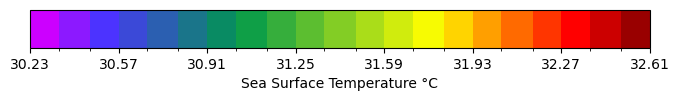

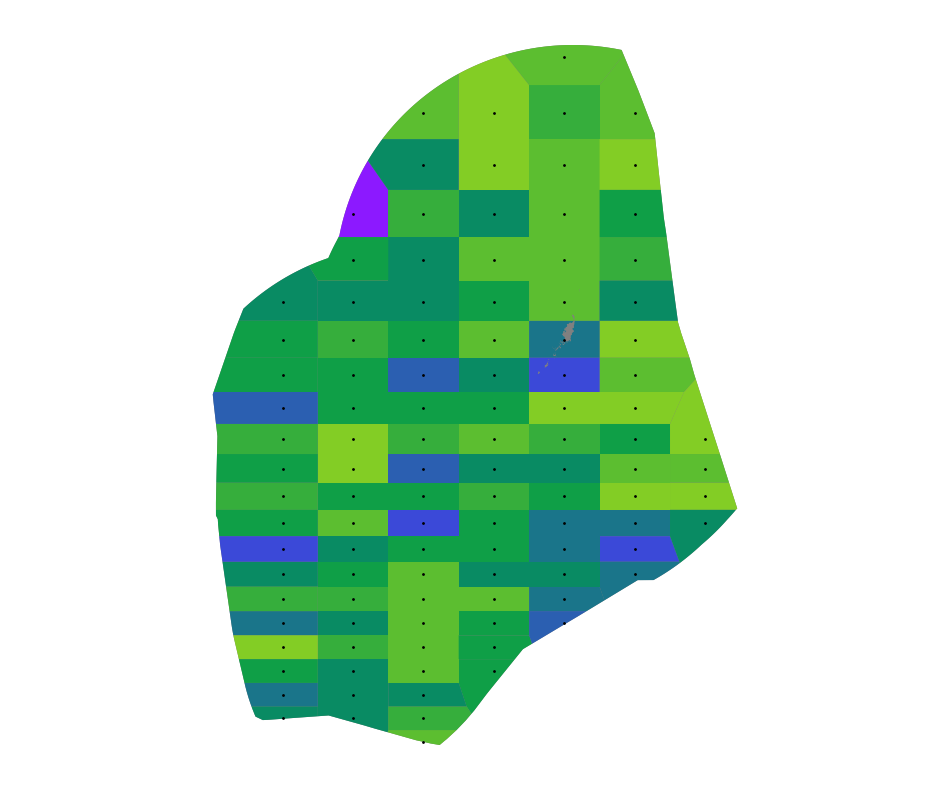

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2040_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


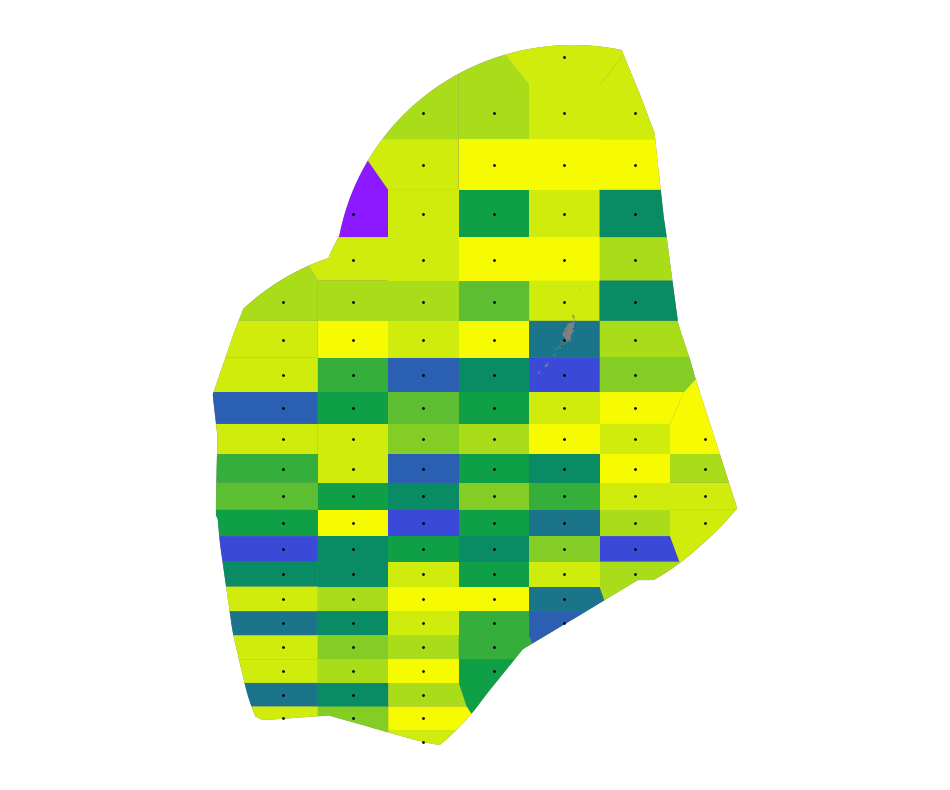

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2041_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


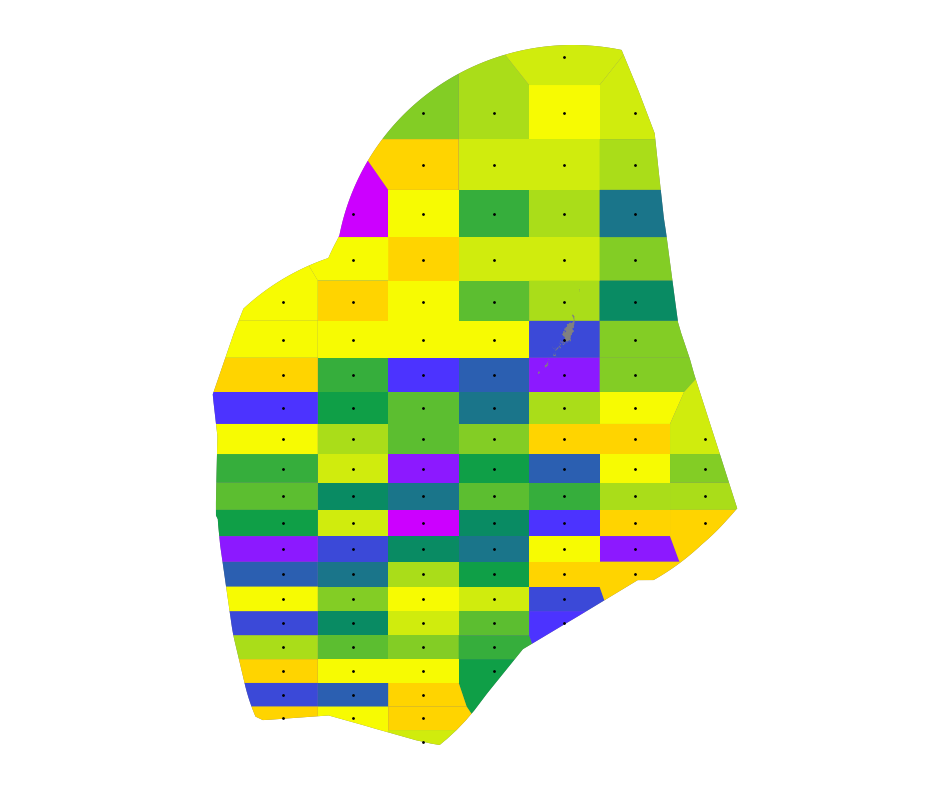

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2042_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


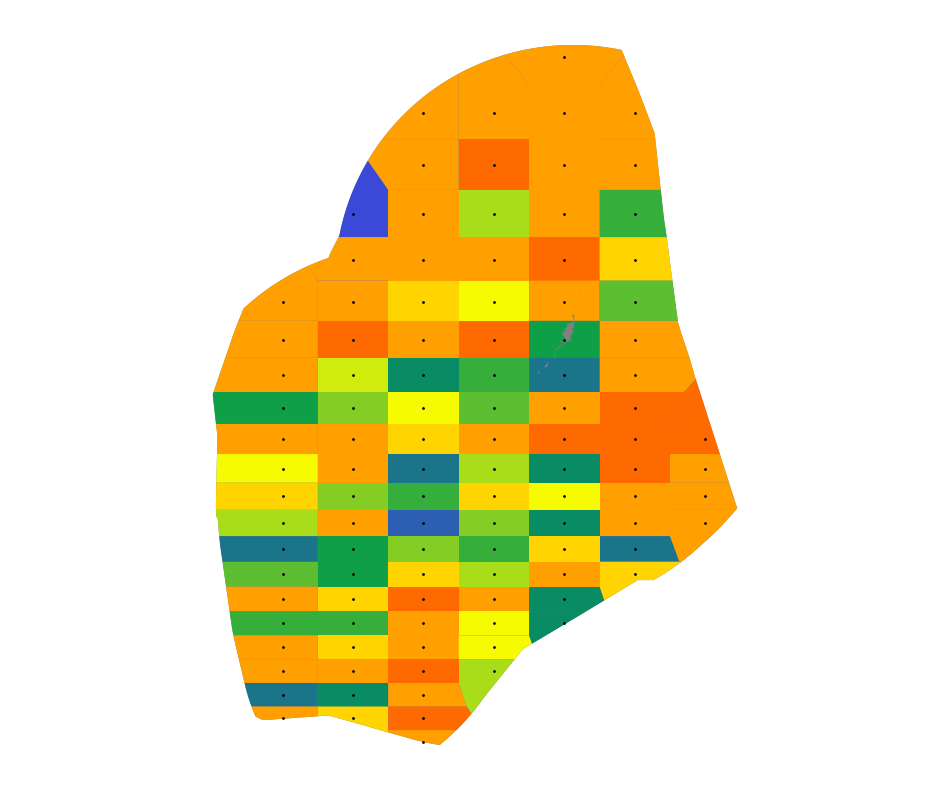

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2043_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


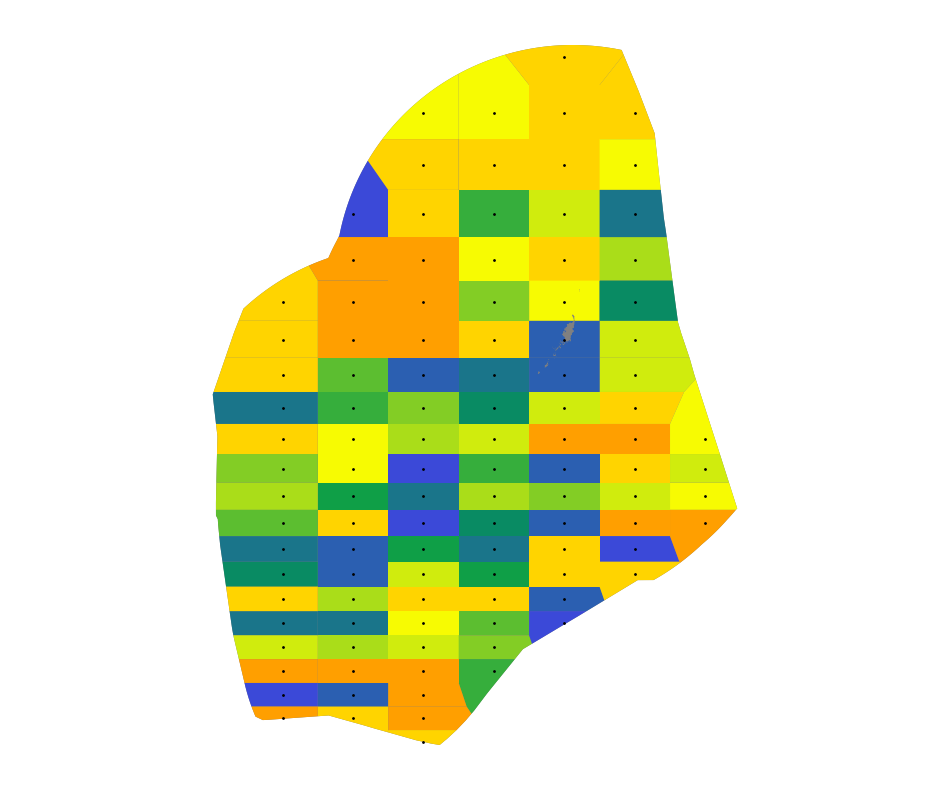

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2044_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


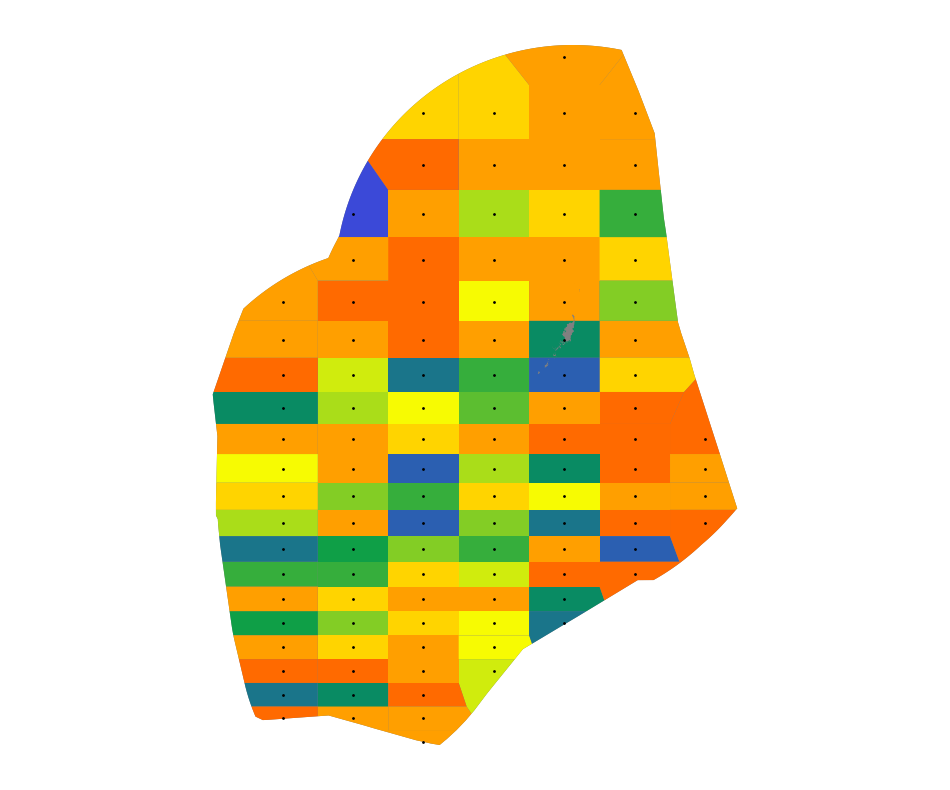

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2045_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


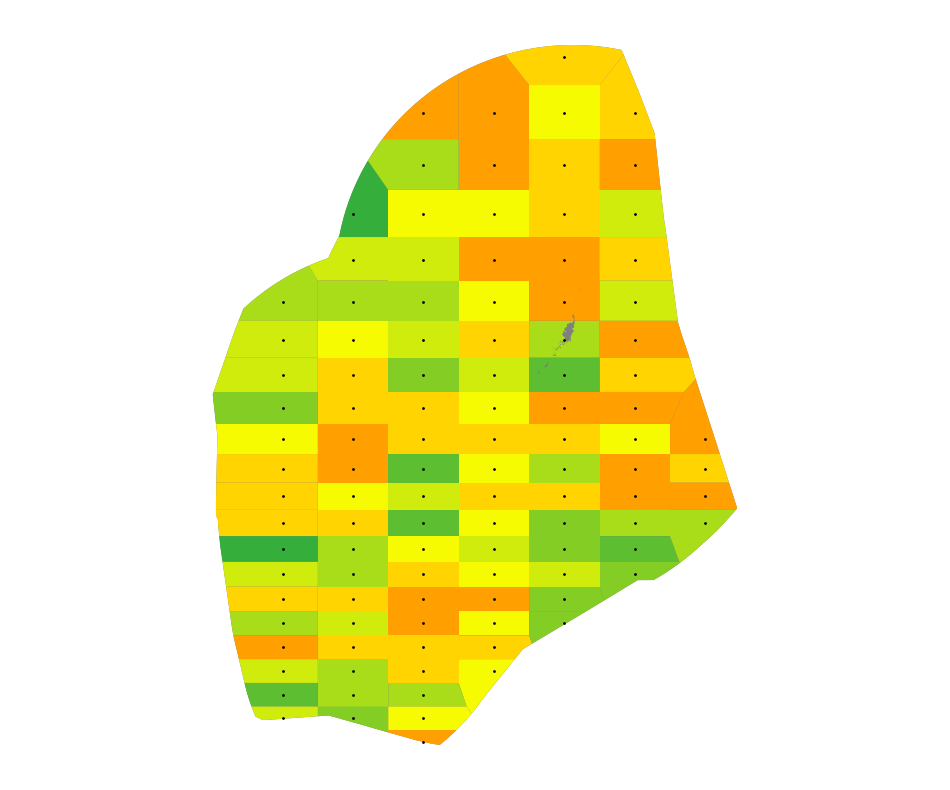

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2046_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


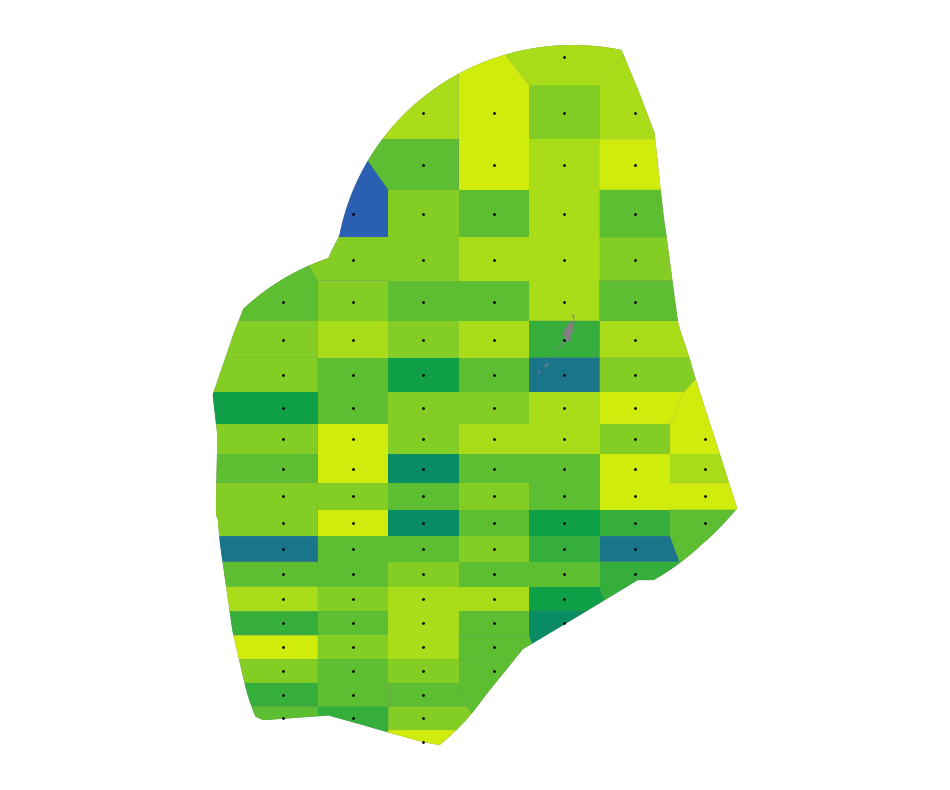

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2047_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


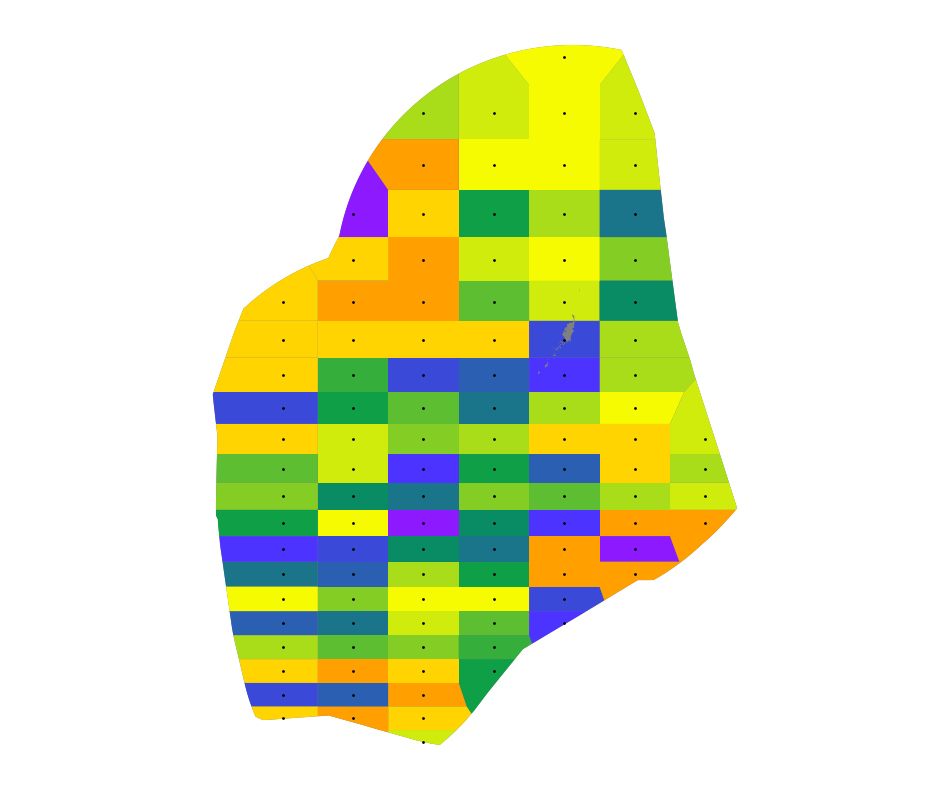

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2048_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


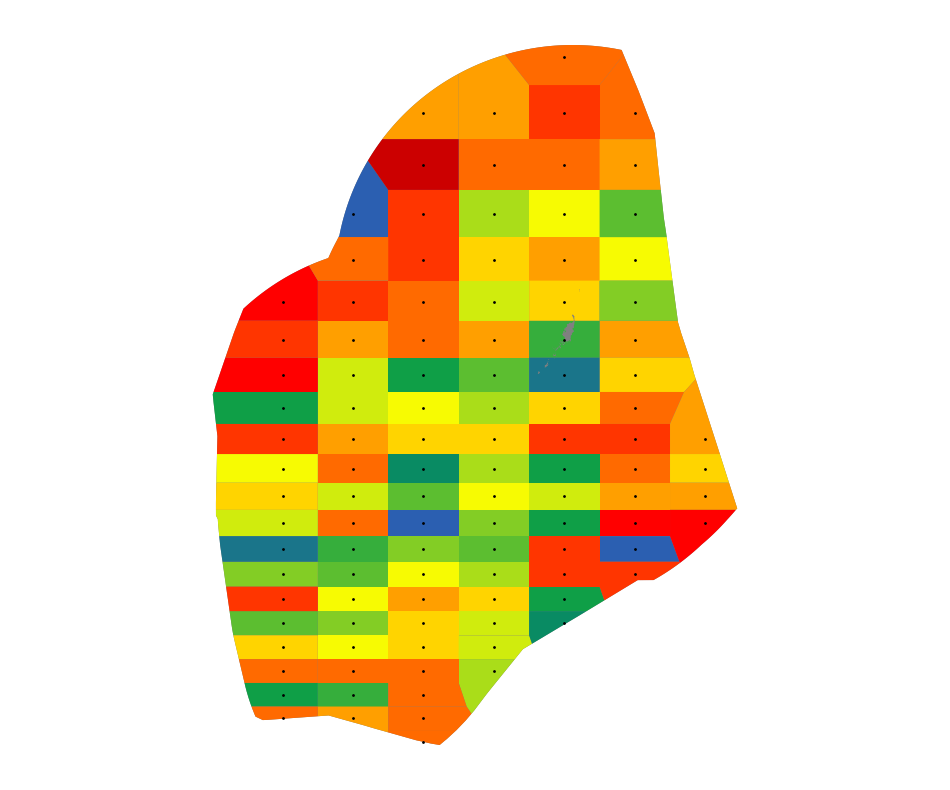

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2049_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


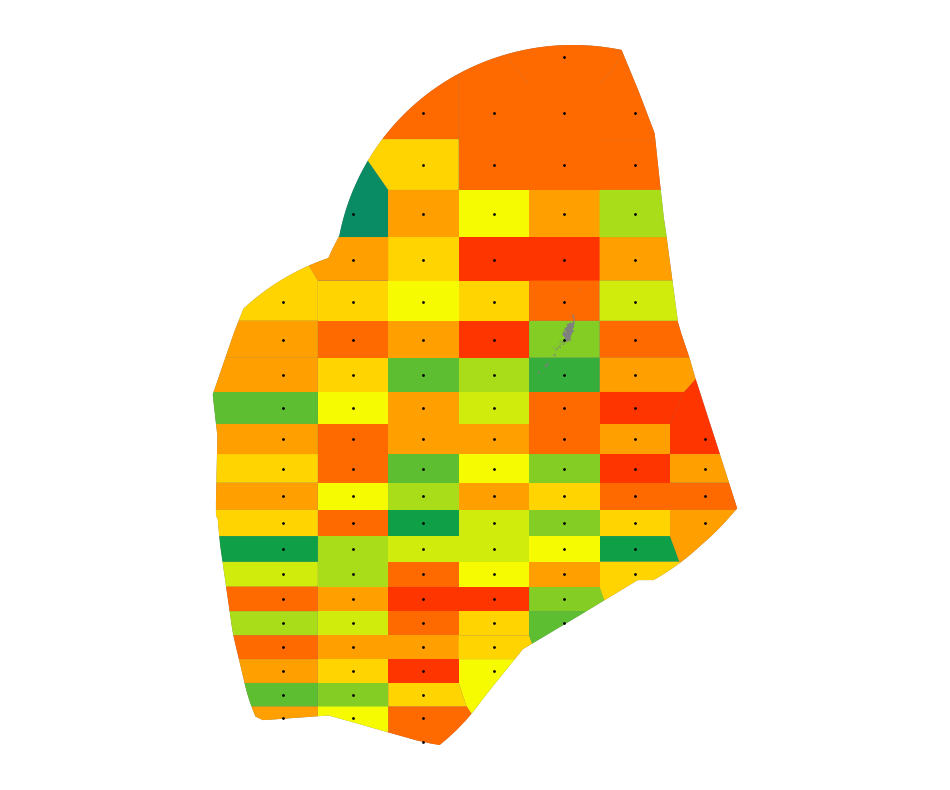

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2050_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


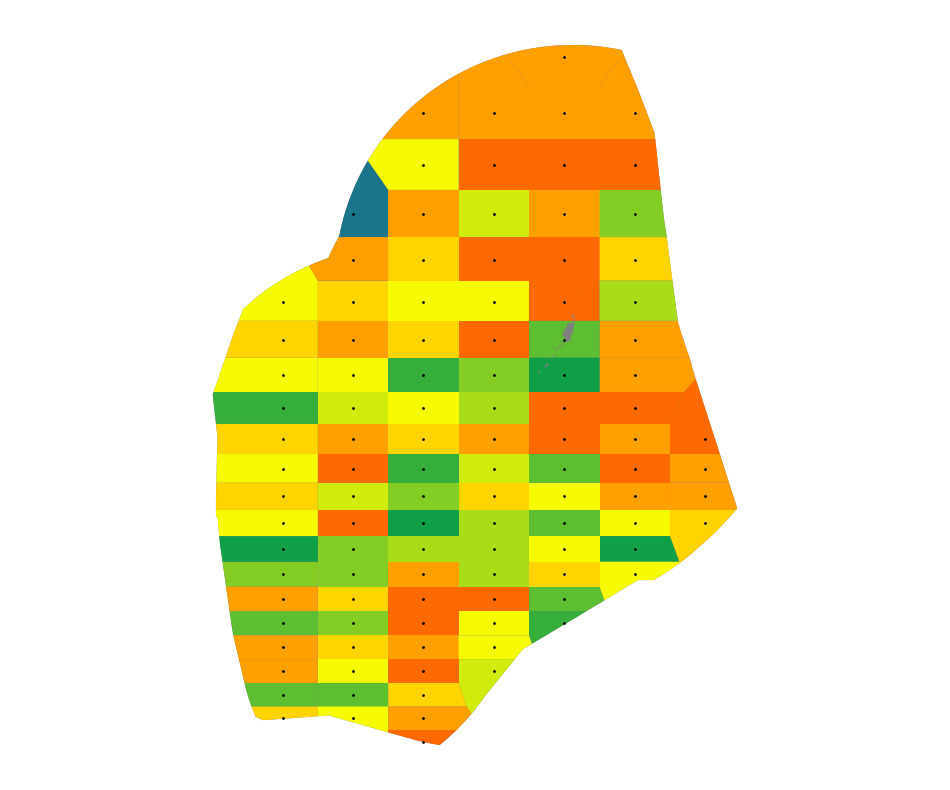

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2051_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


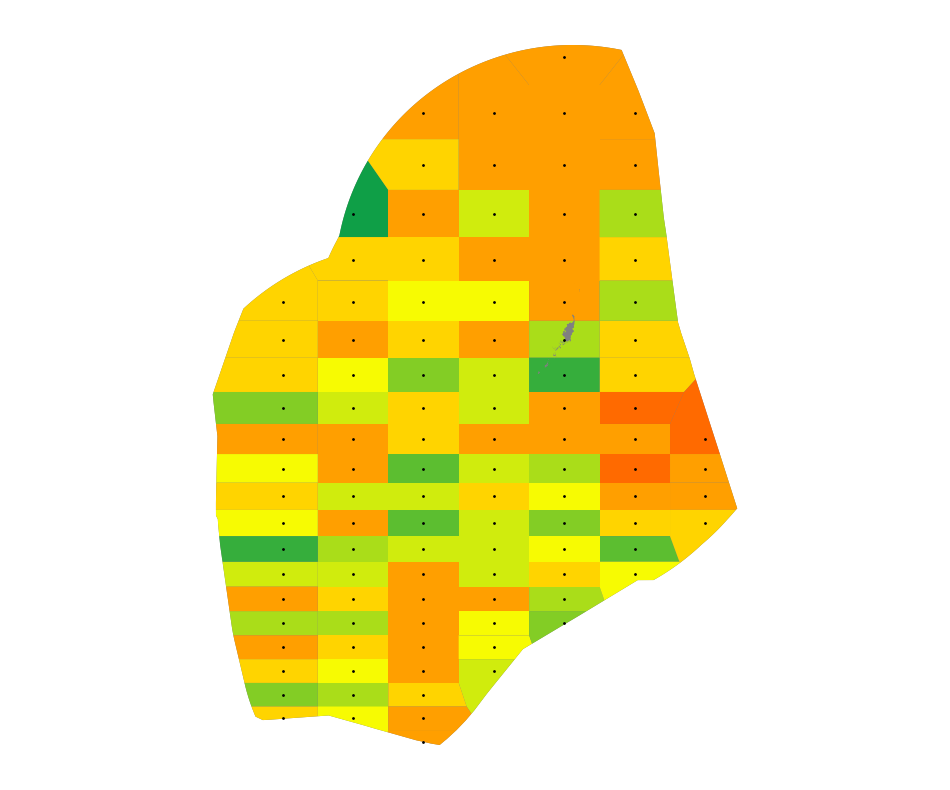

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2052_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


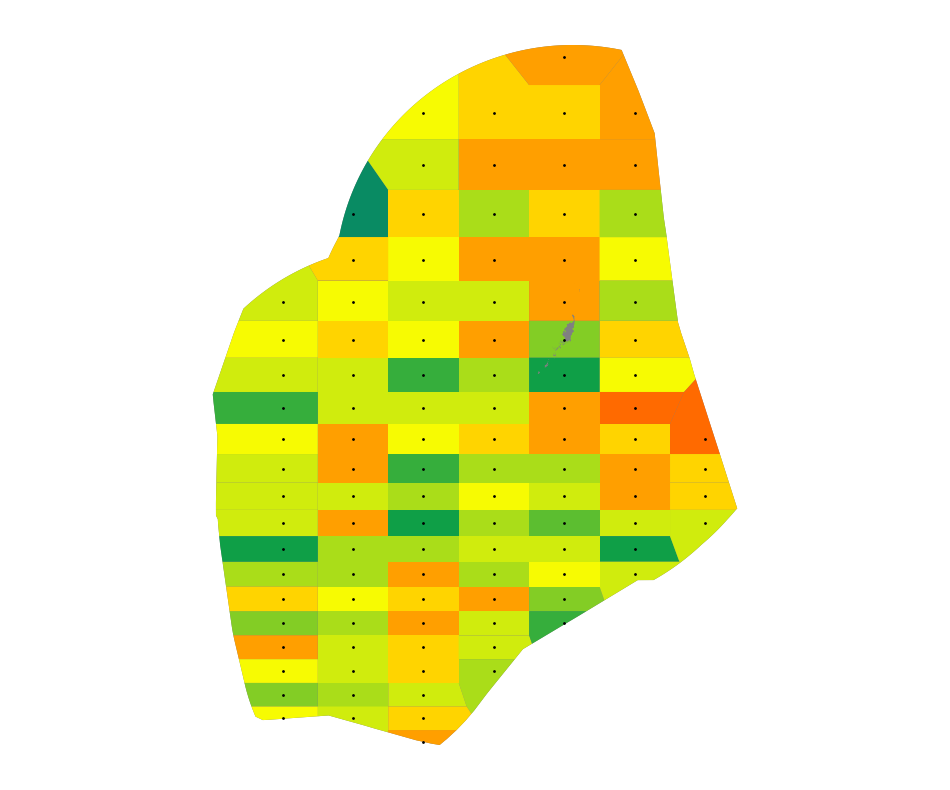

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2053_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


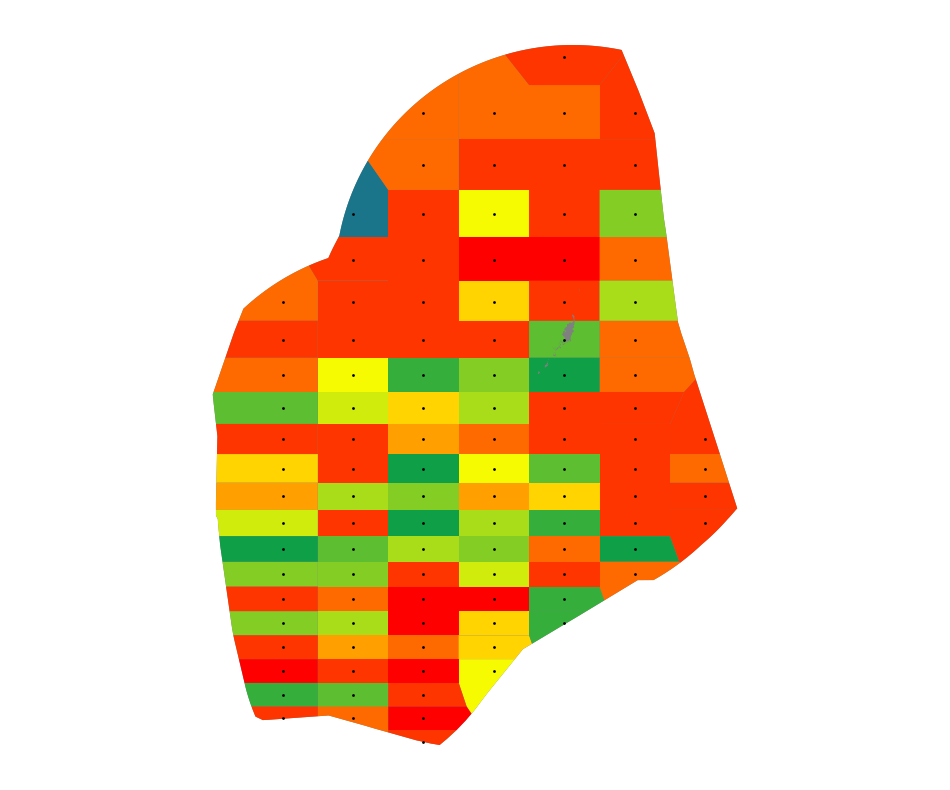

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2054_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


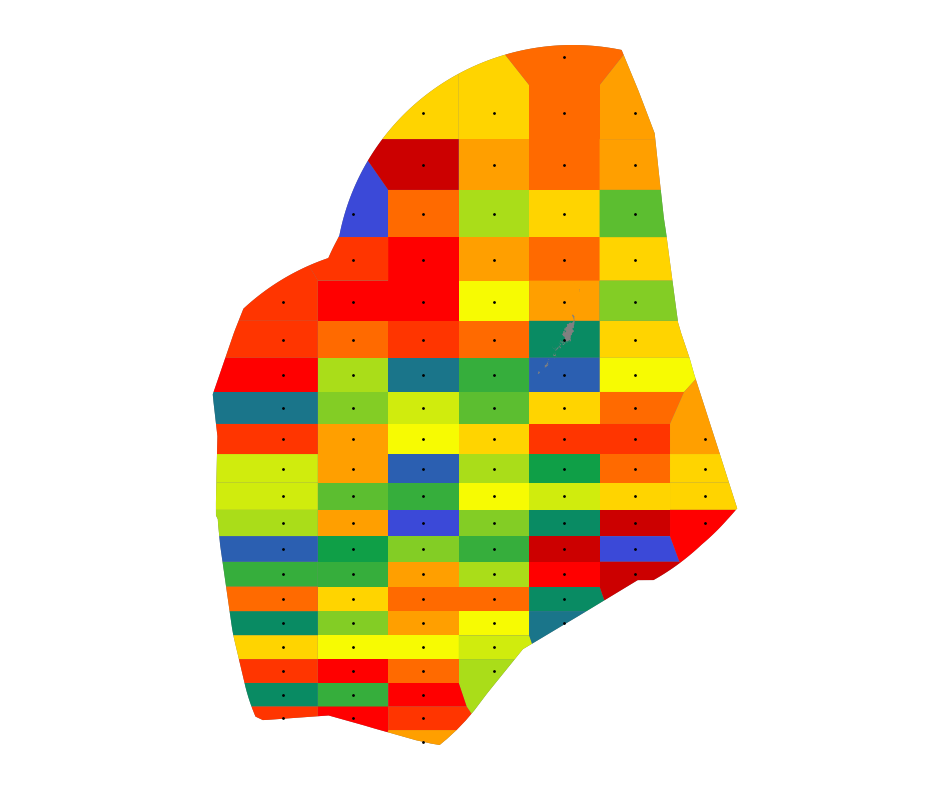

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2055_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


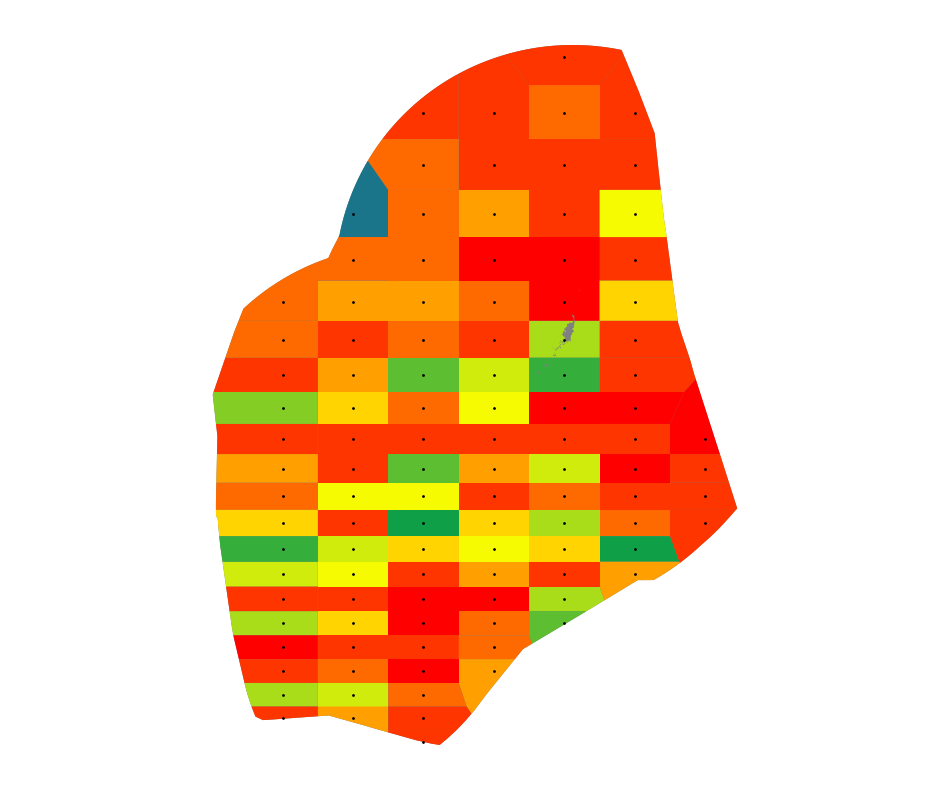

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2056_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


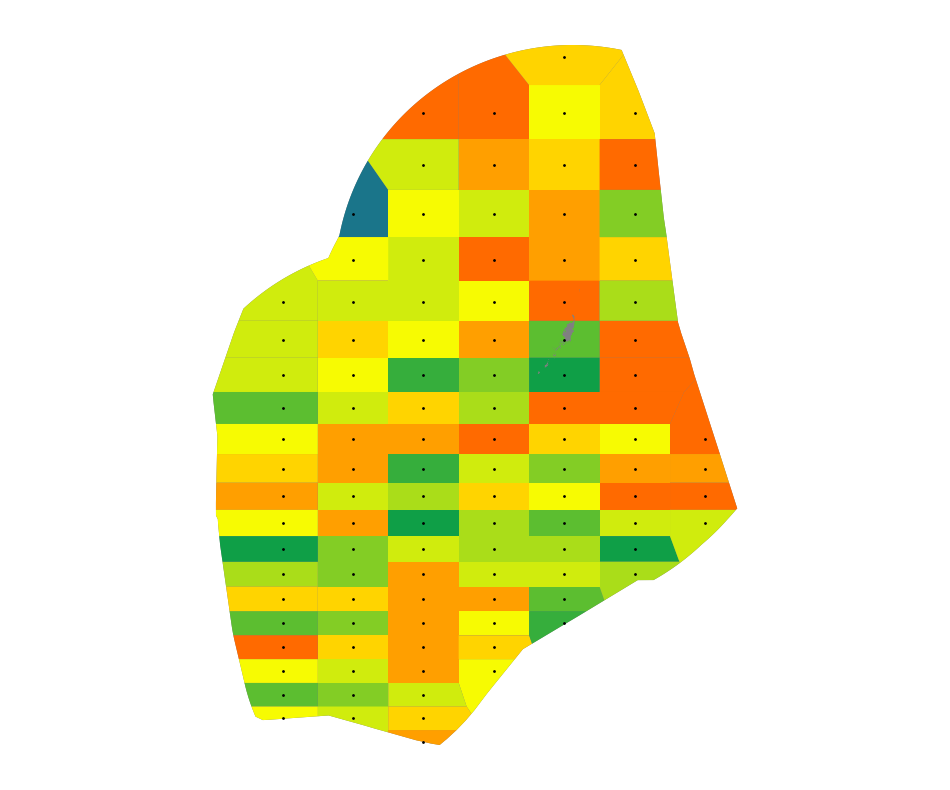

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2057_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


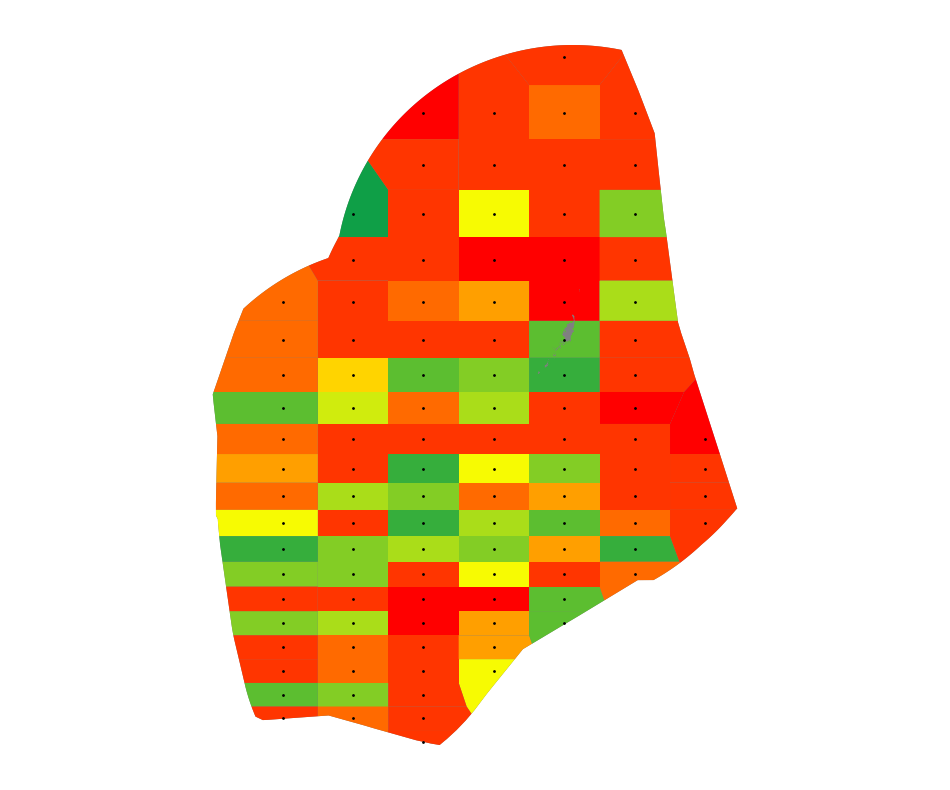

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2058_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


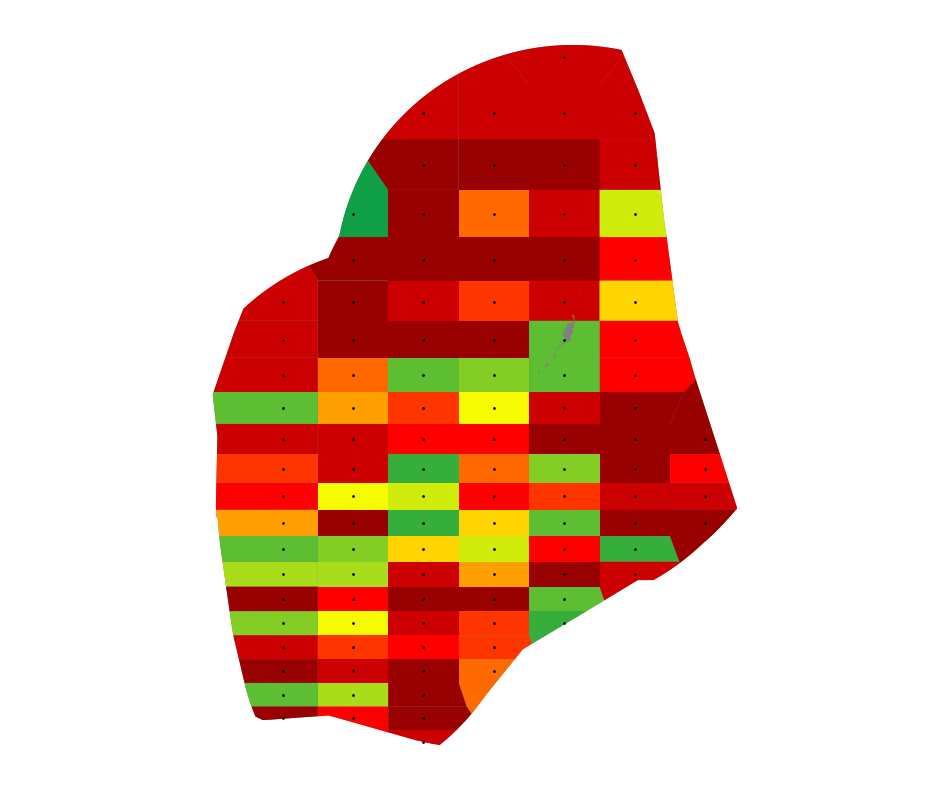

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2059_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


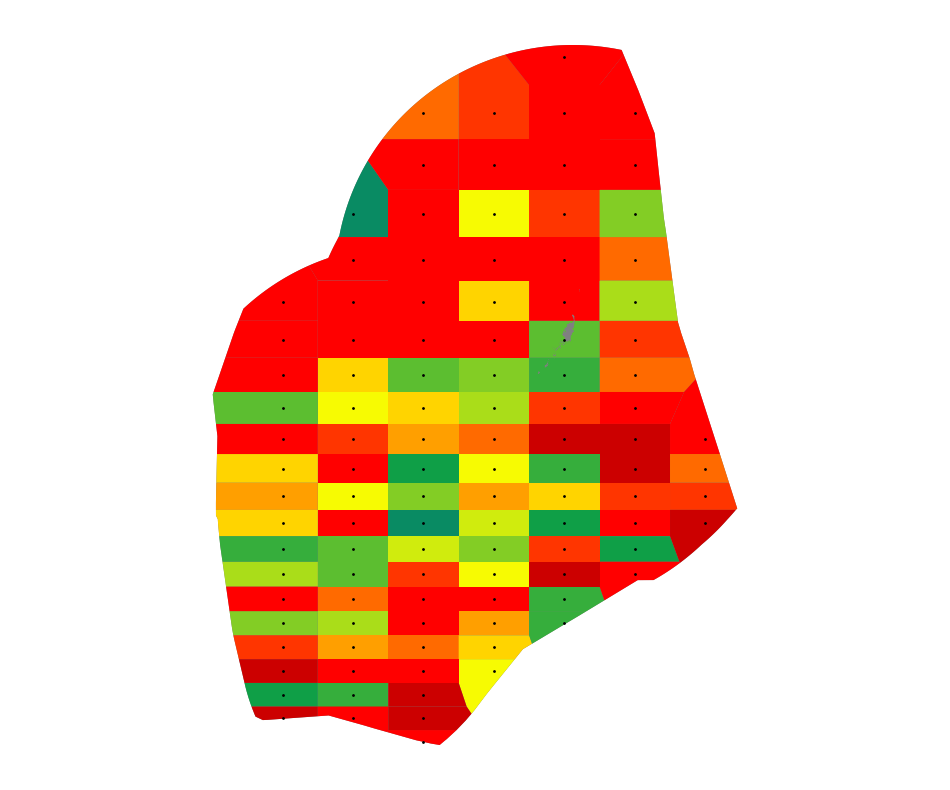

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2060_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


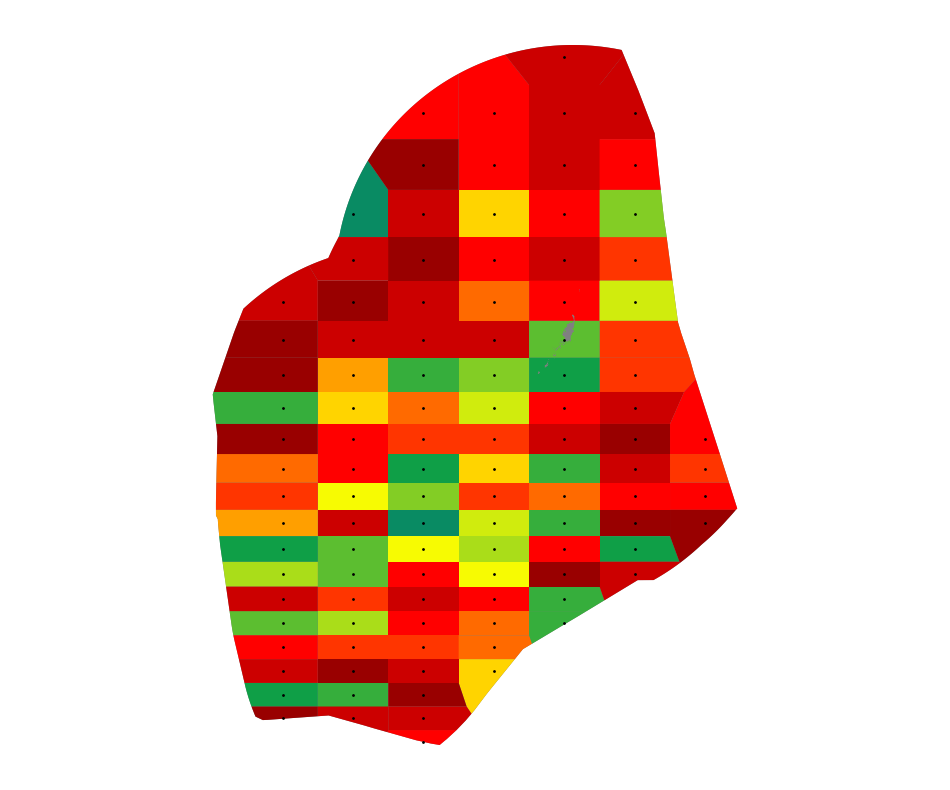

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2061_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


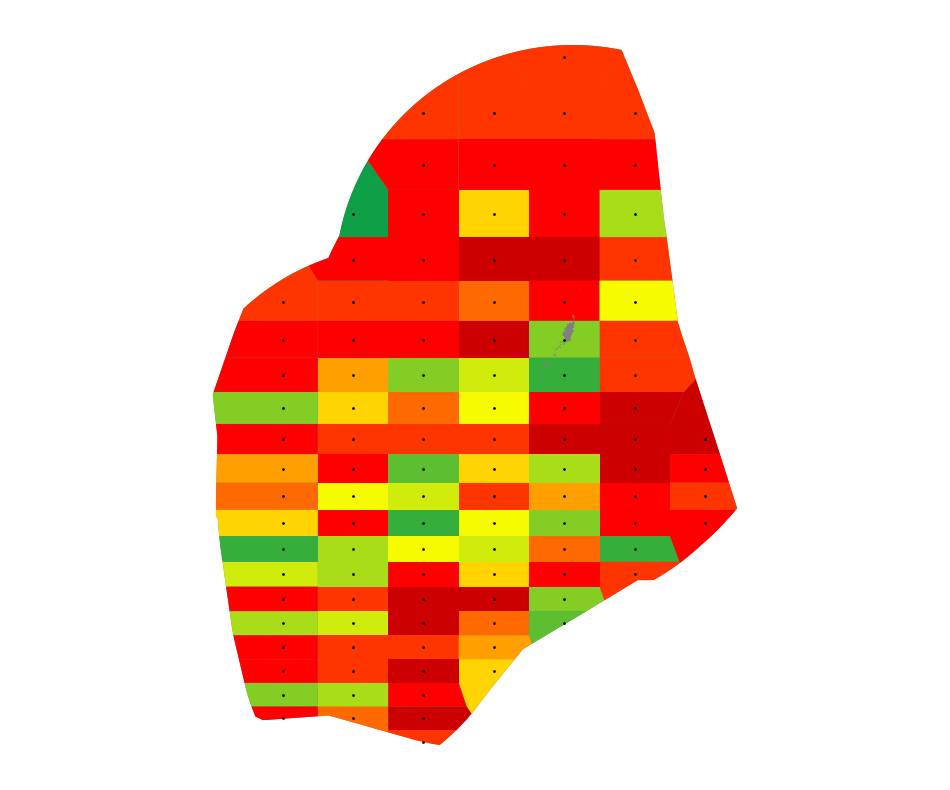

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2062_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


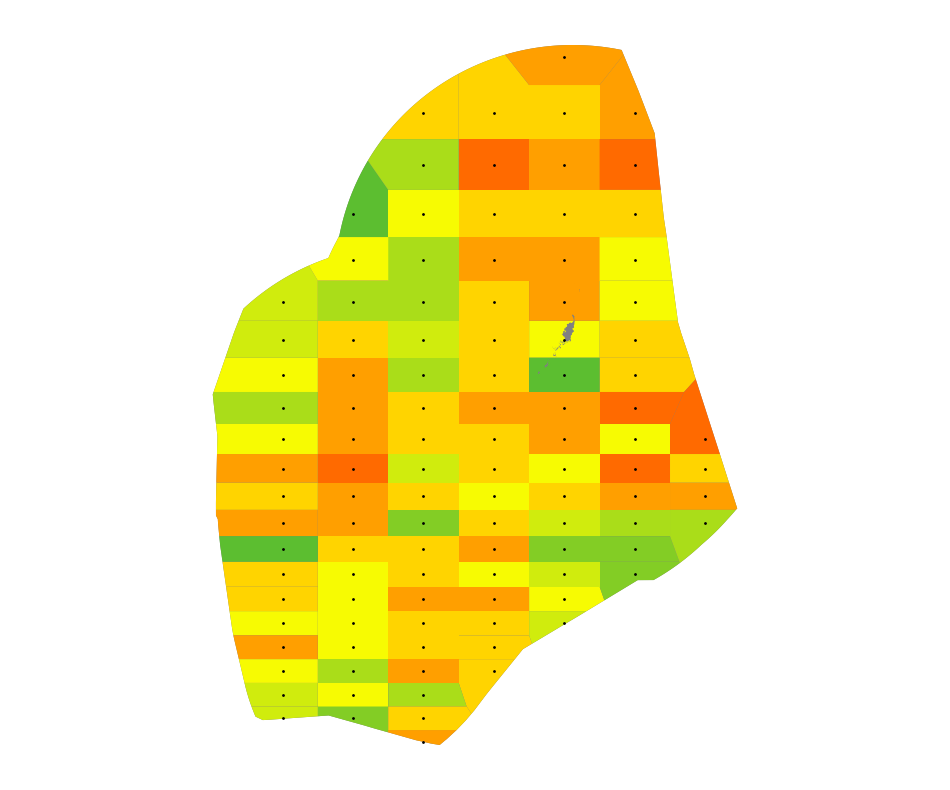

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2063_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


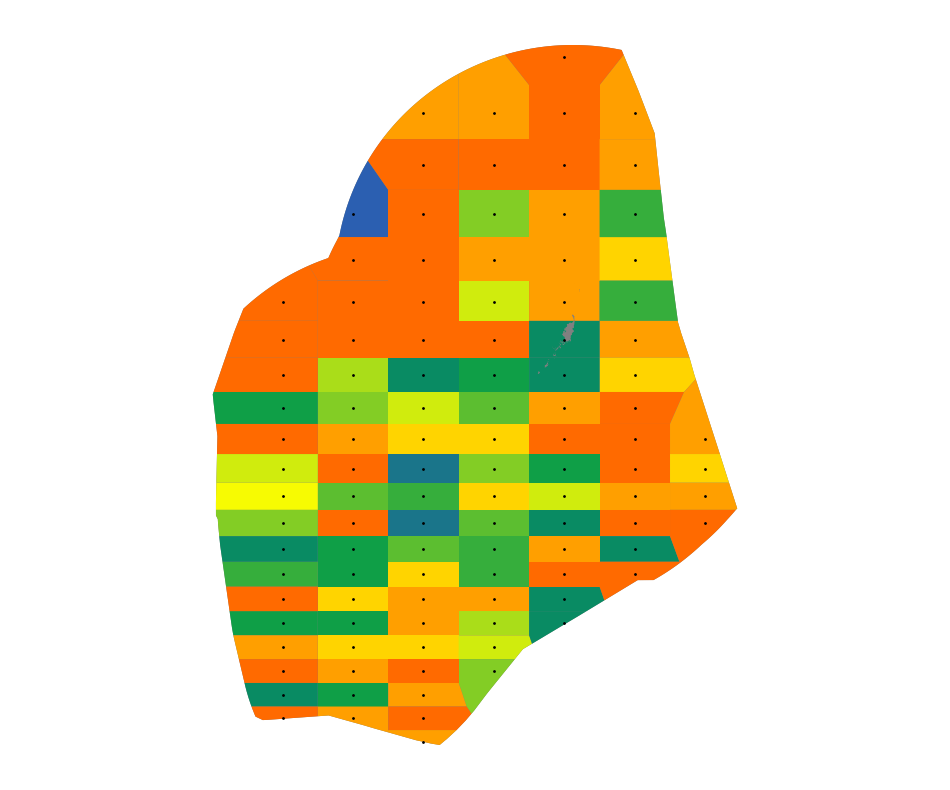

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2064_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


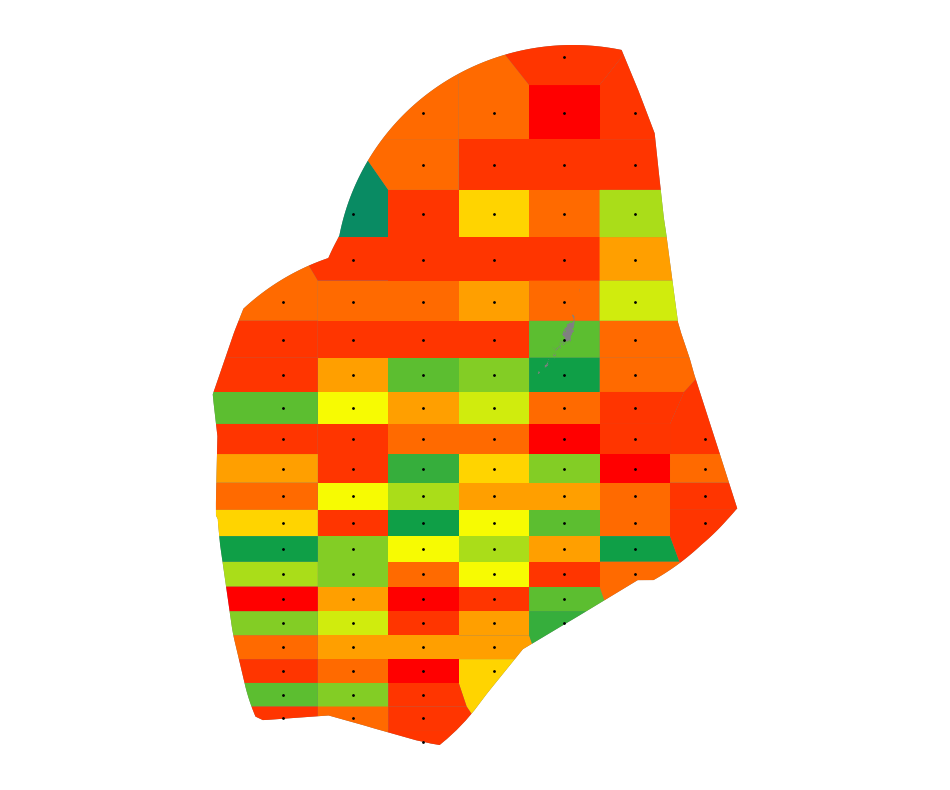

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2065_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


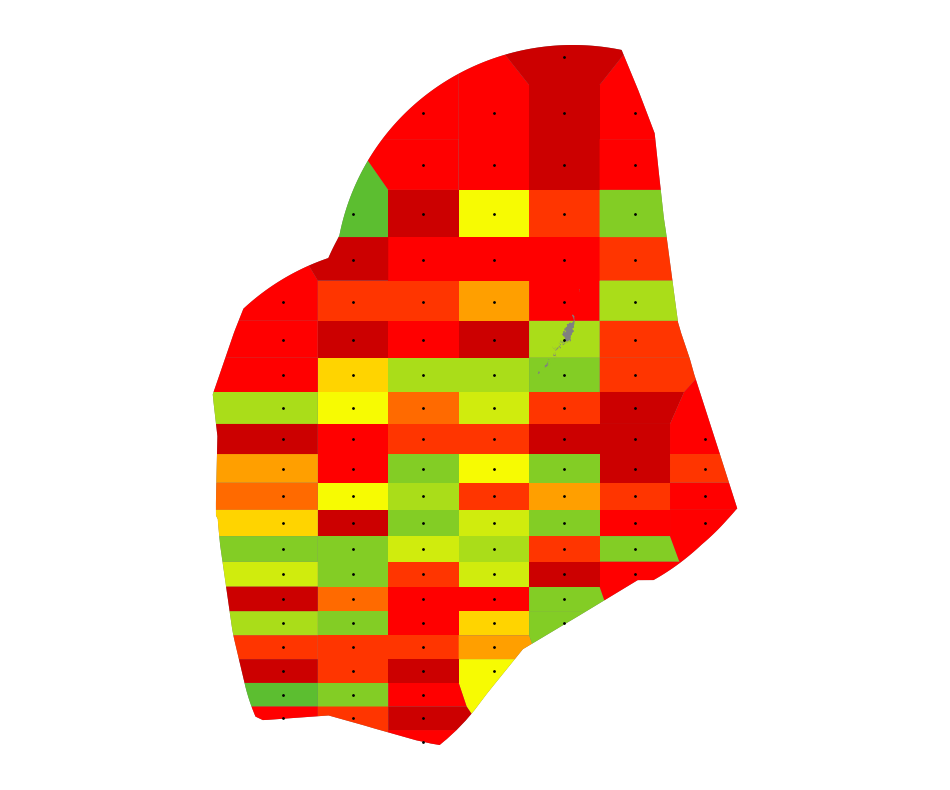

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2066_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


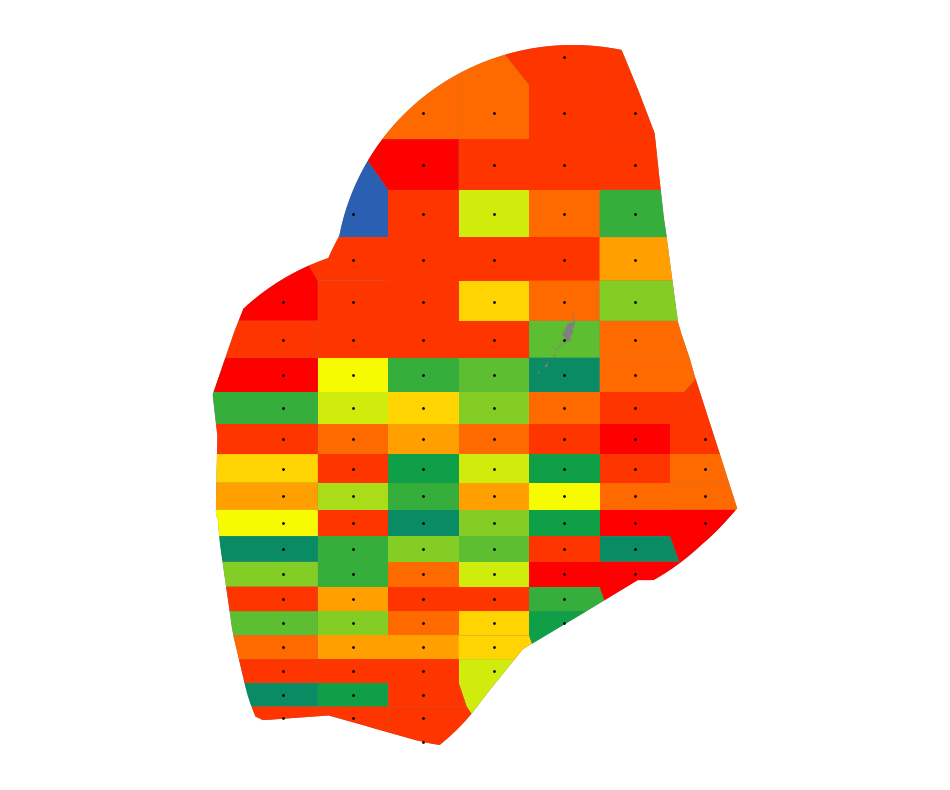

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2067_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


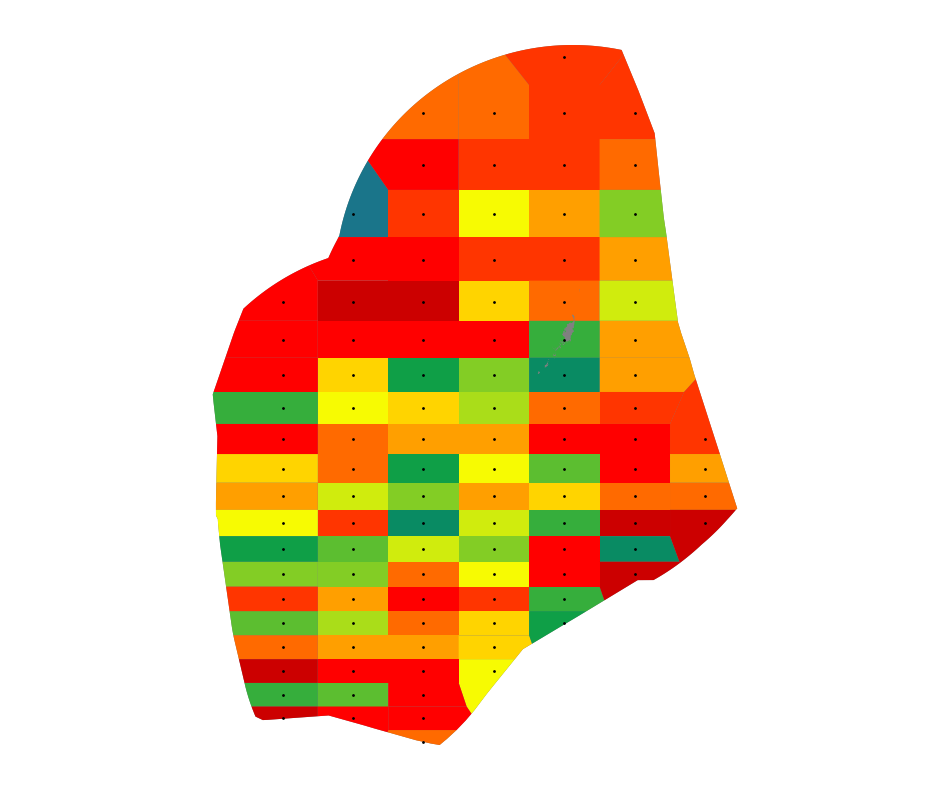

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2068_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


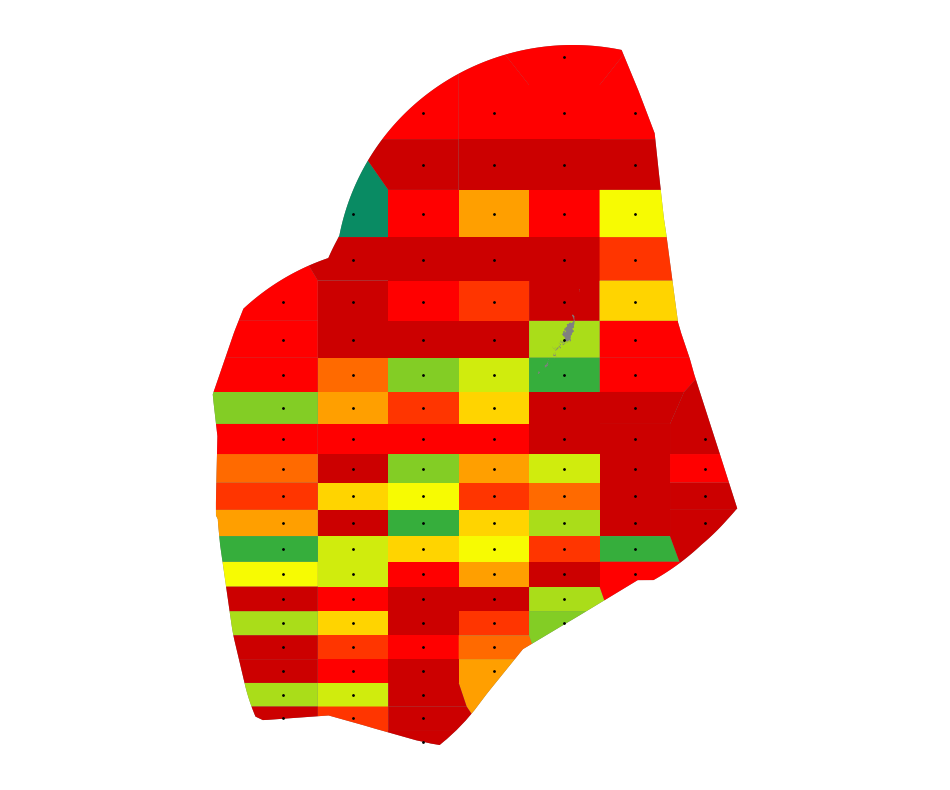

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2069_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


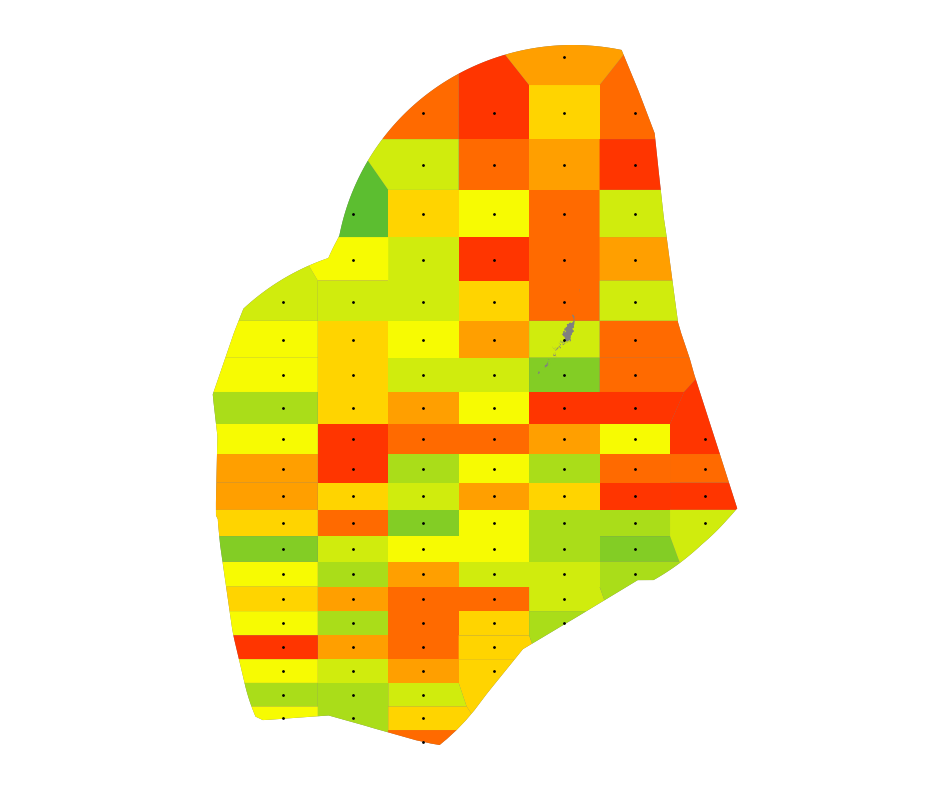

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2070_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


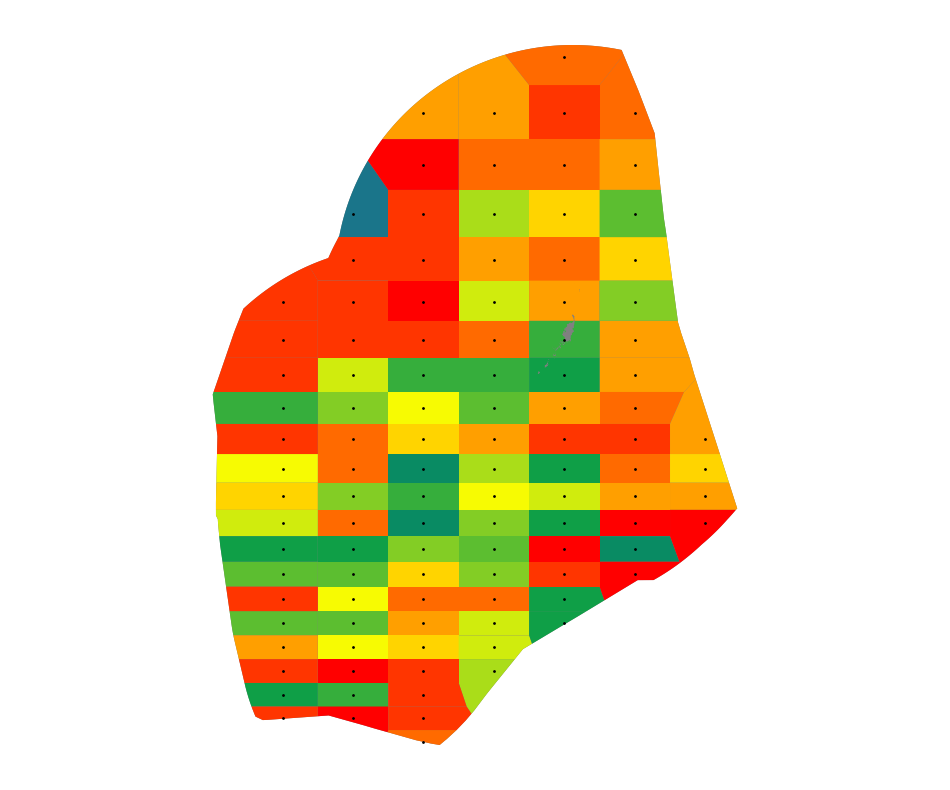

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2071_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


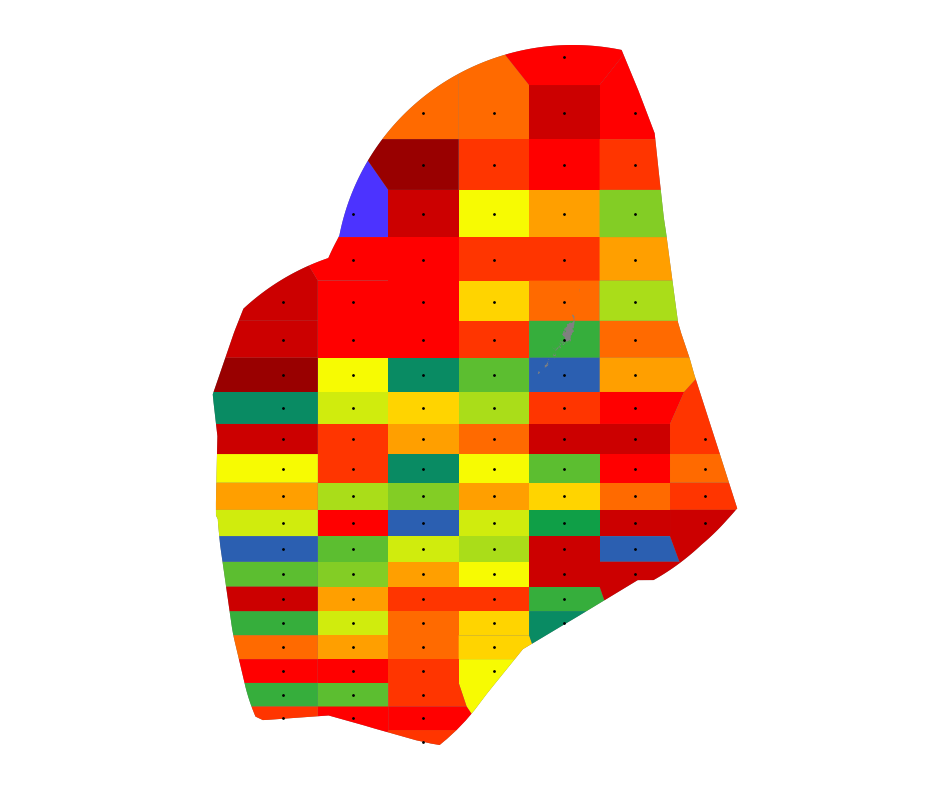

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2072_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


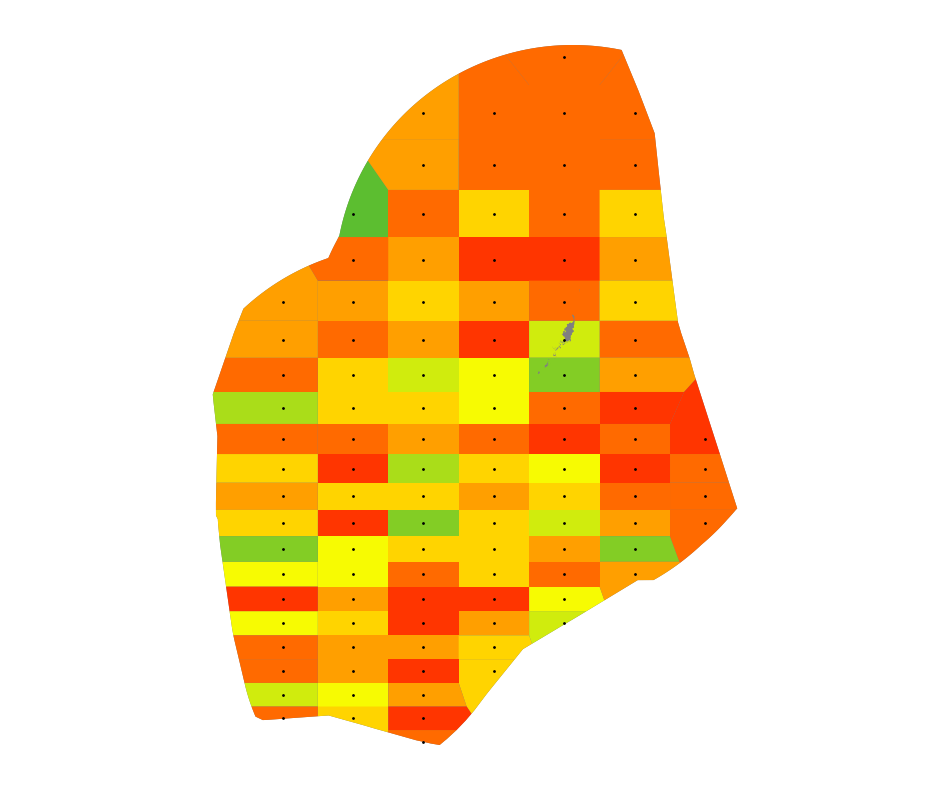

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2073_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


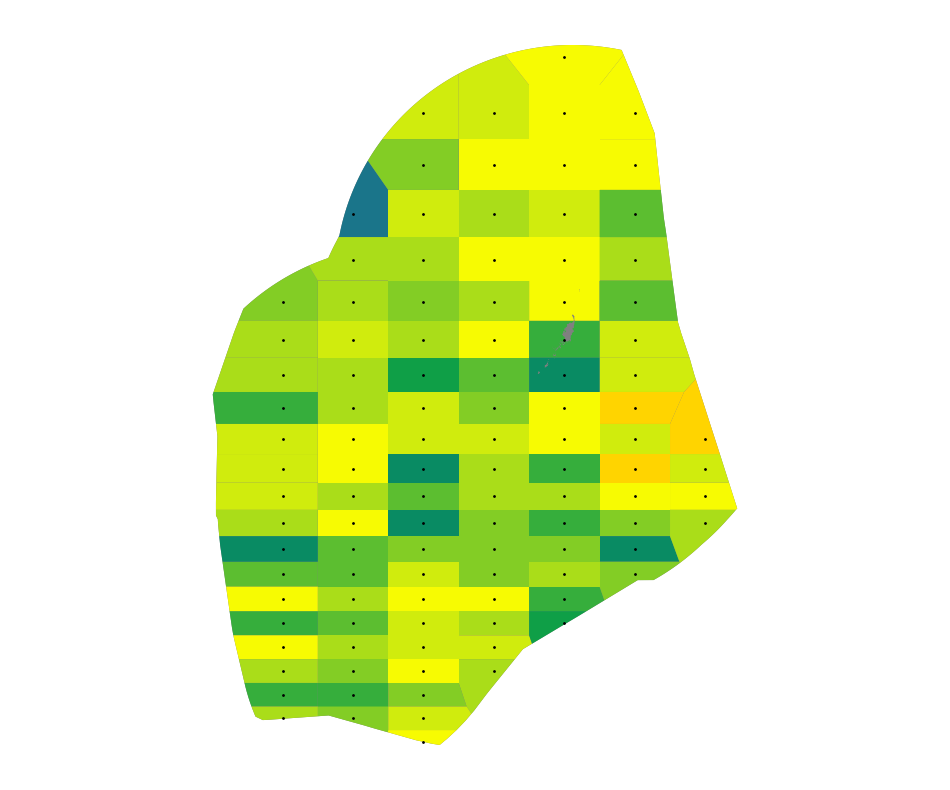

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2074_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


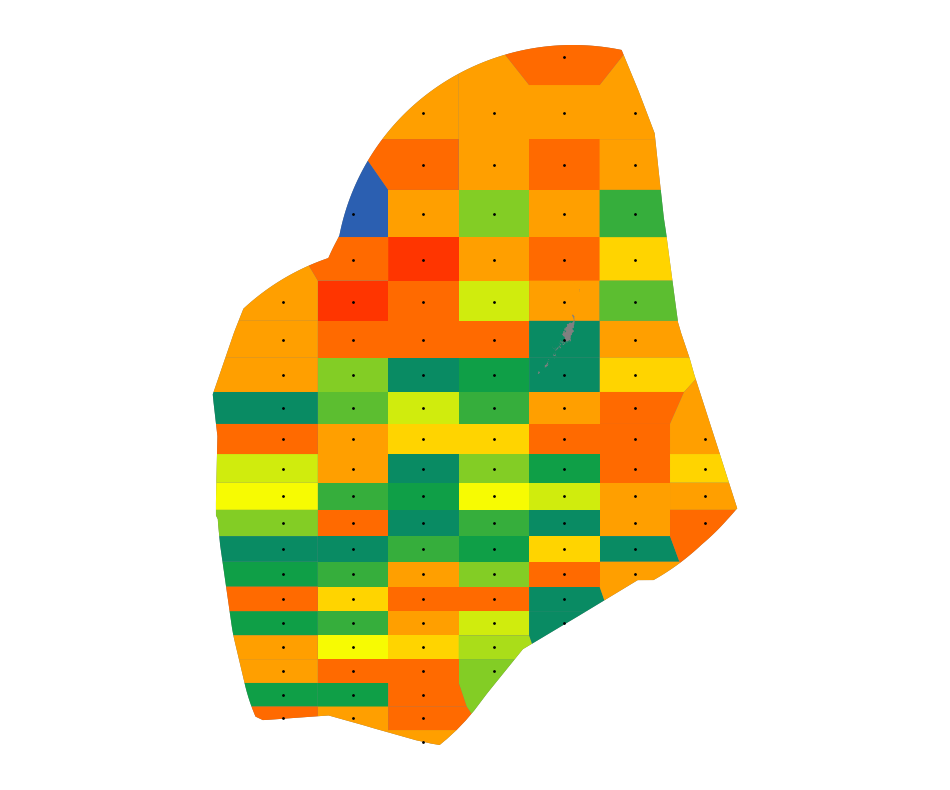

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2075_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


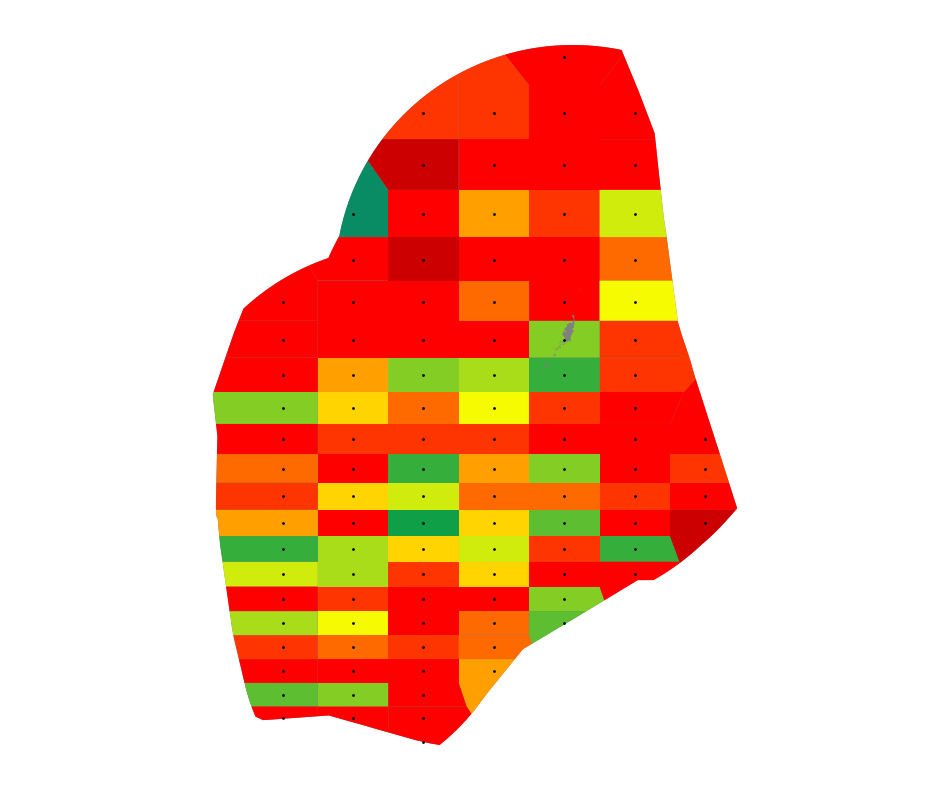

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2076_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


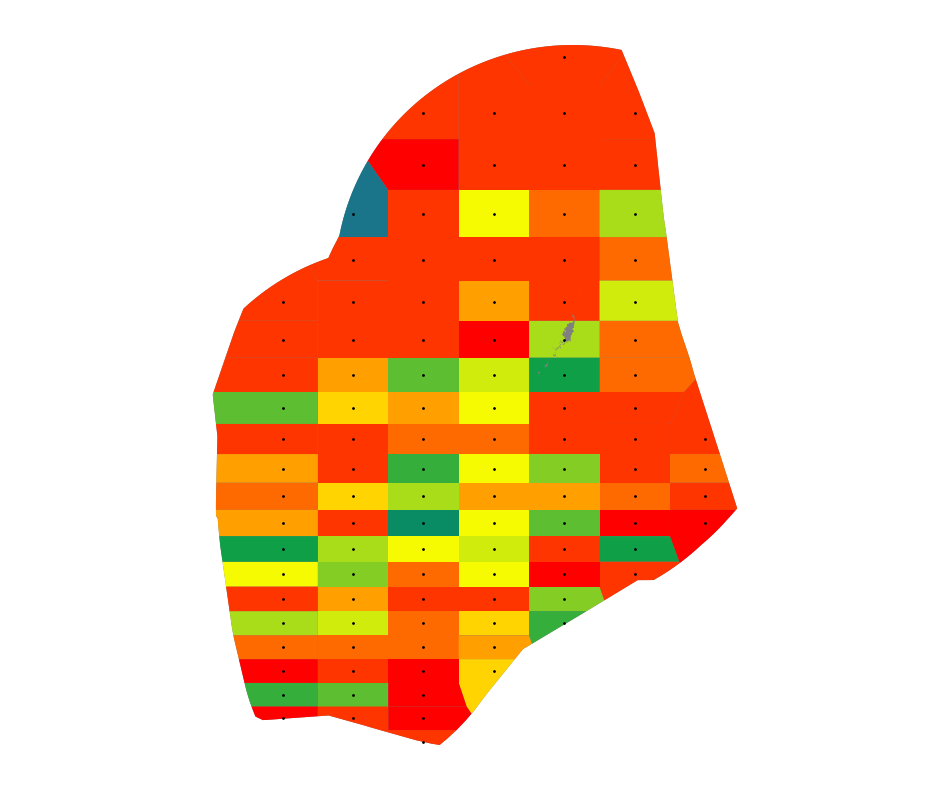

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2077_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


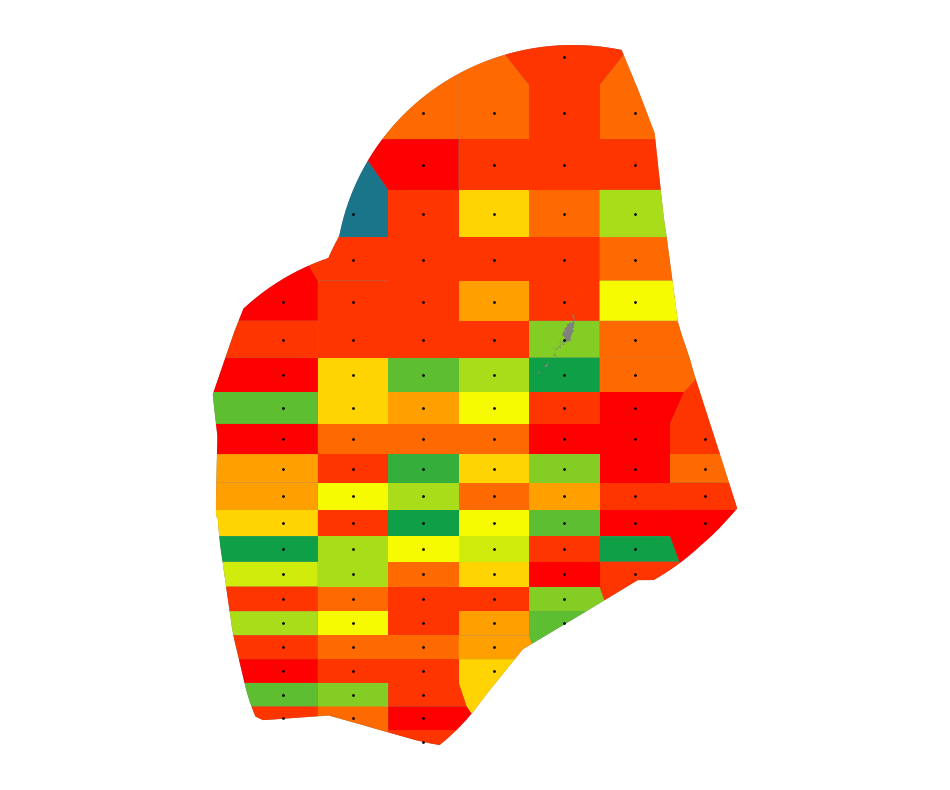

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2078_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


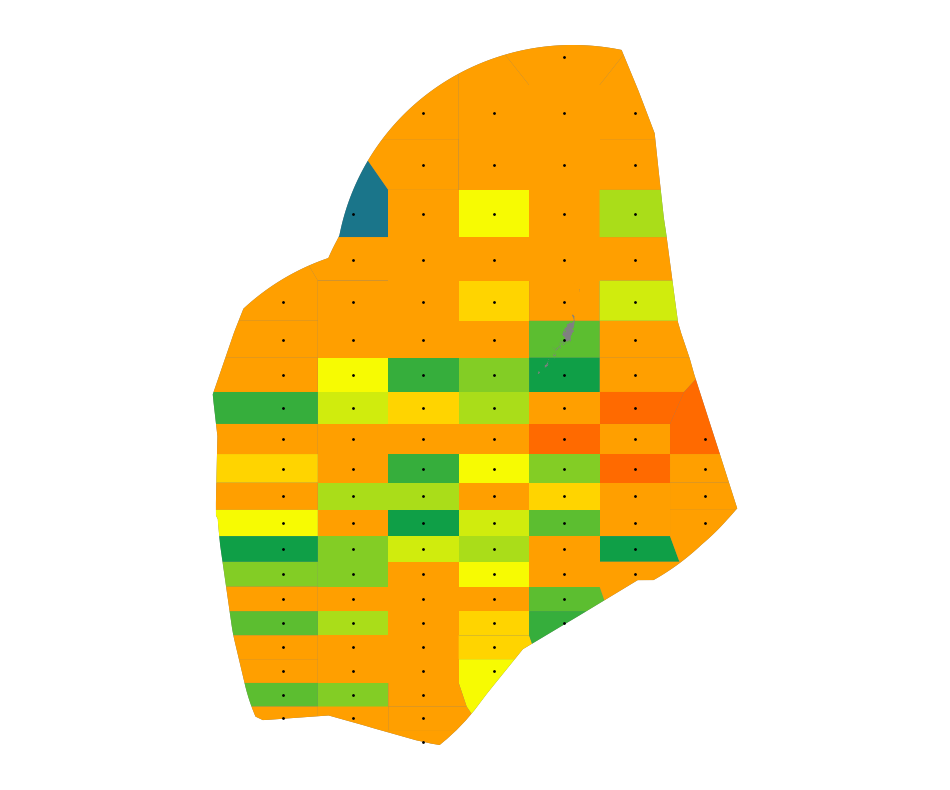

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2079_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


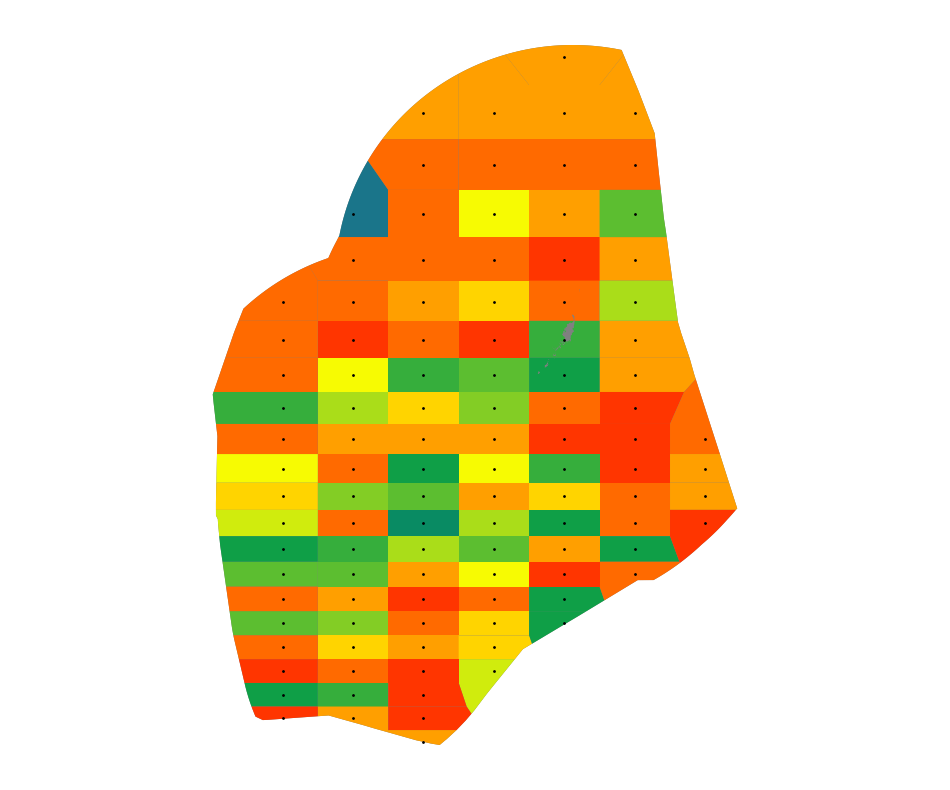

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2080_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


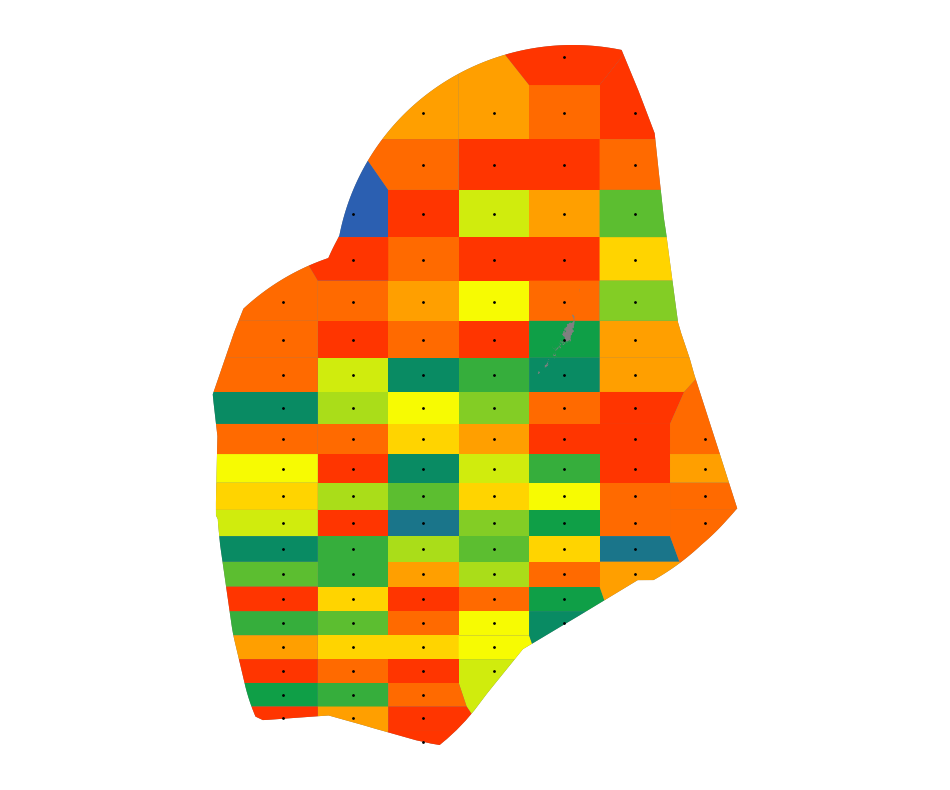

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2081_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


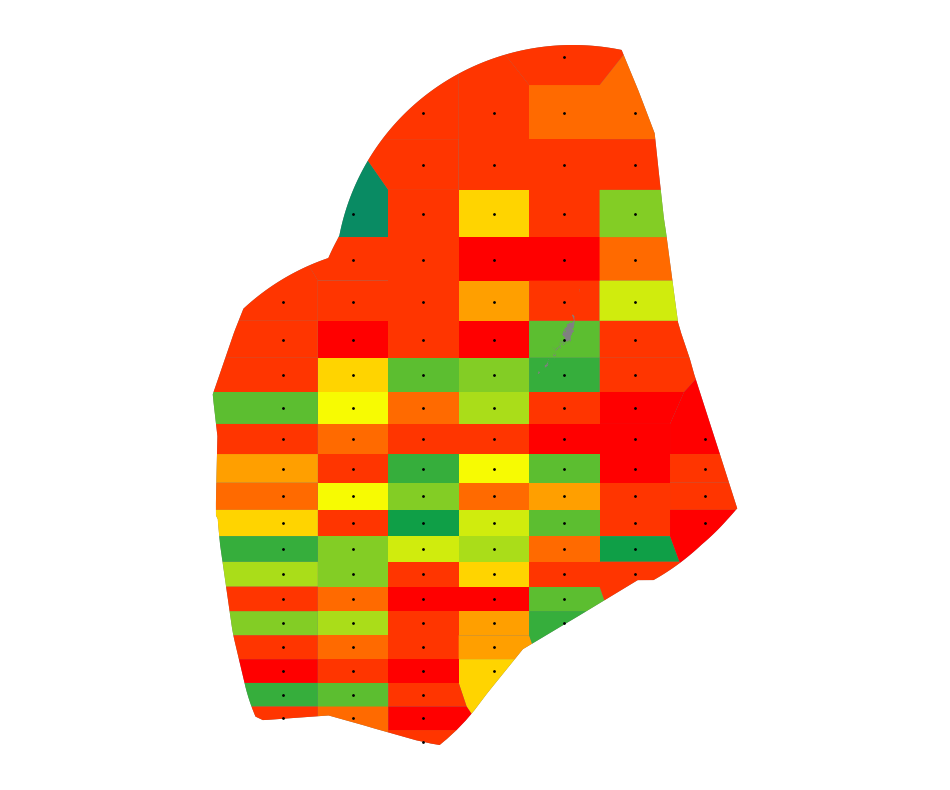

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2082_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


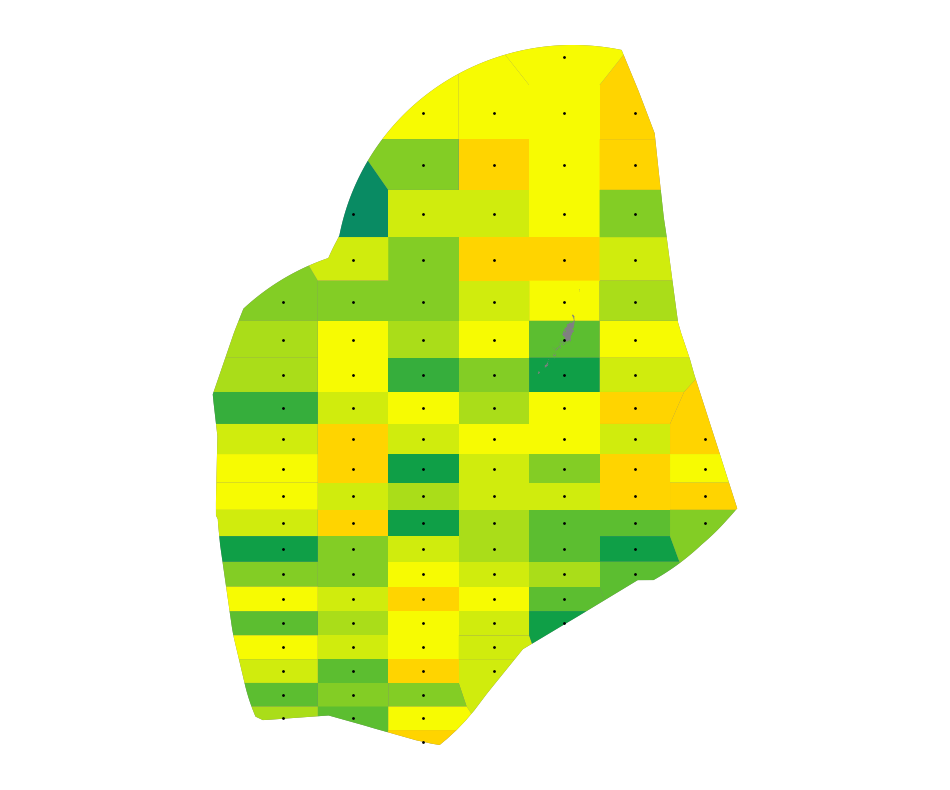

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2083_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


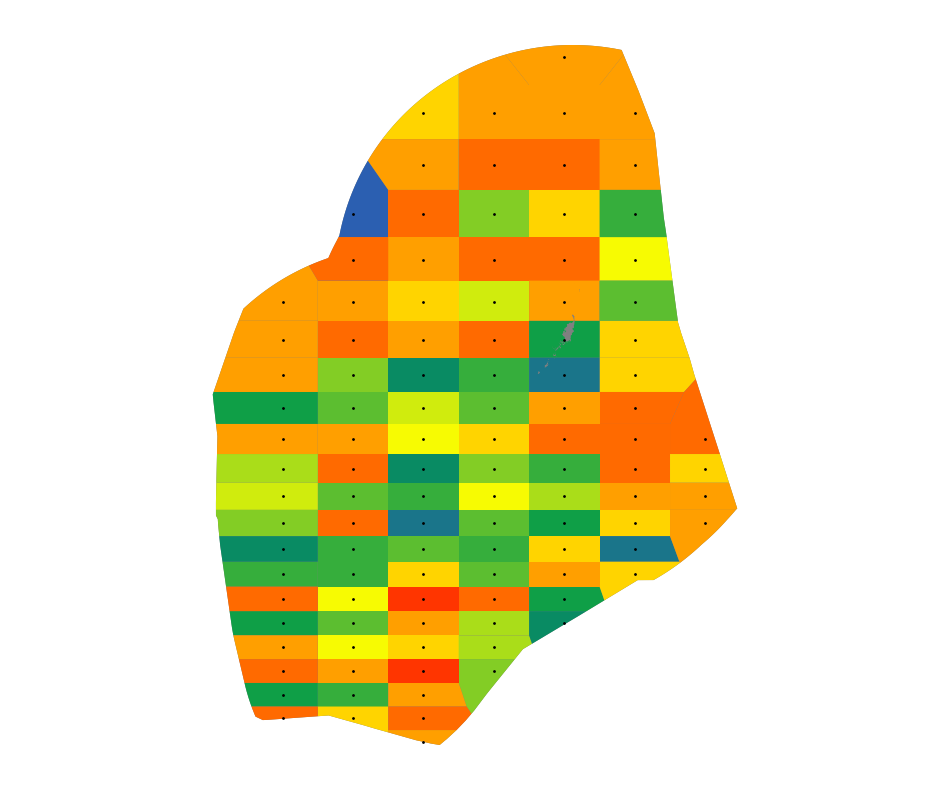

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2084_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


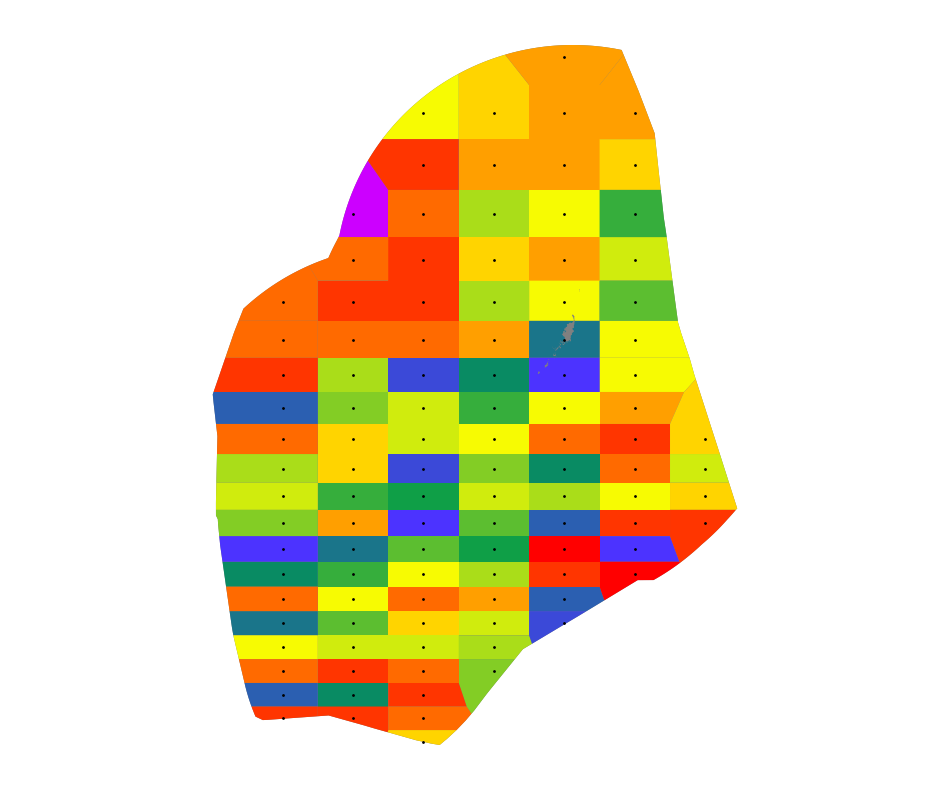

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2085_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


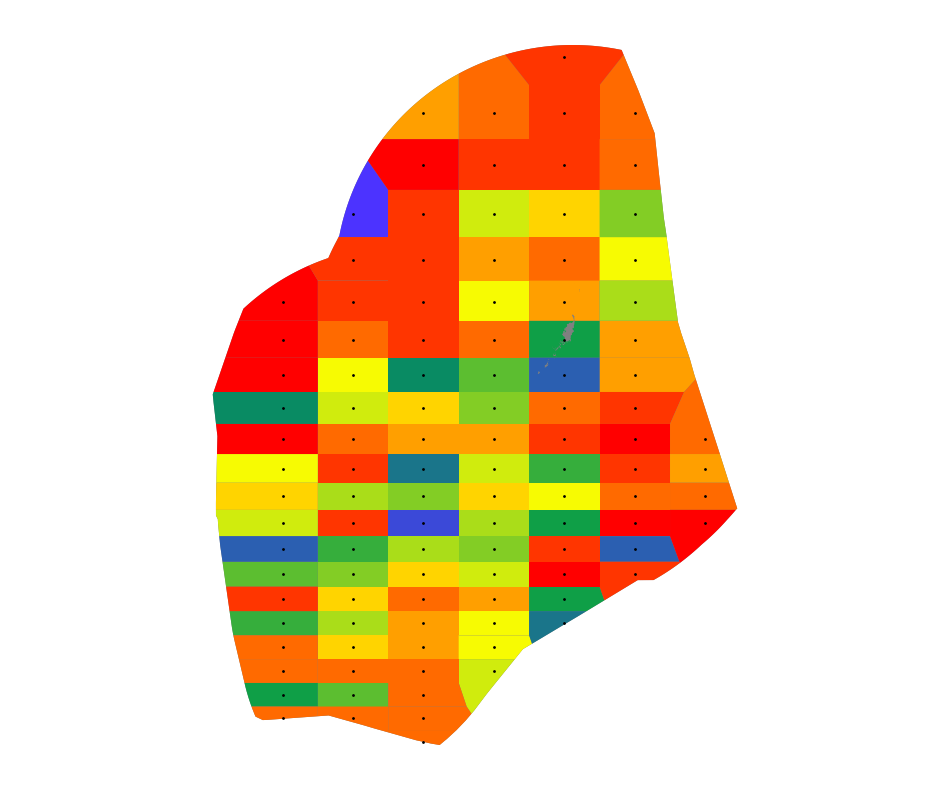

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2086_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


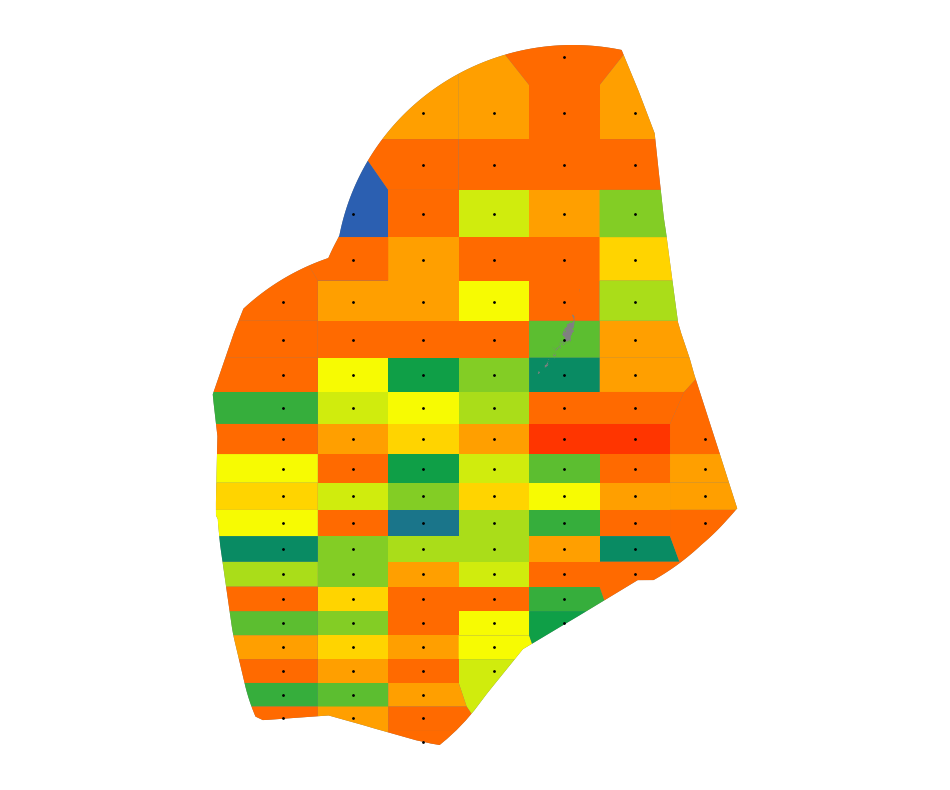

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2087_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


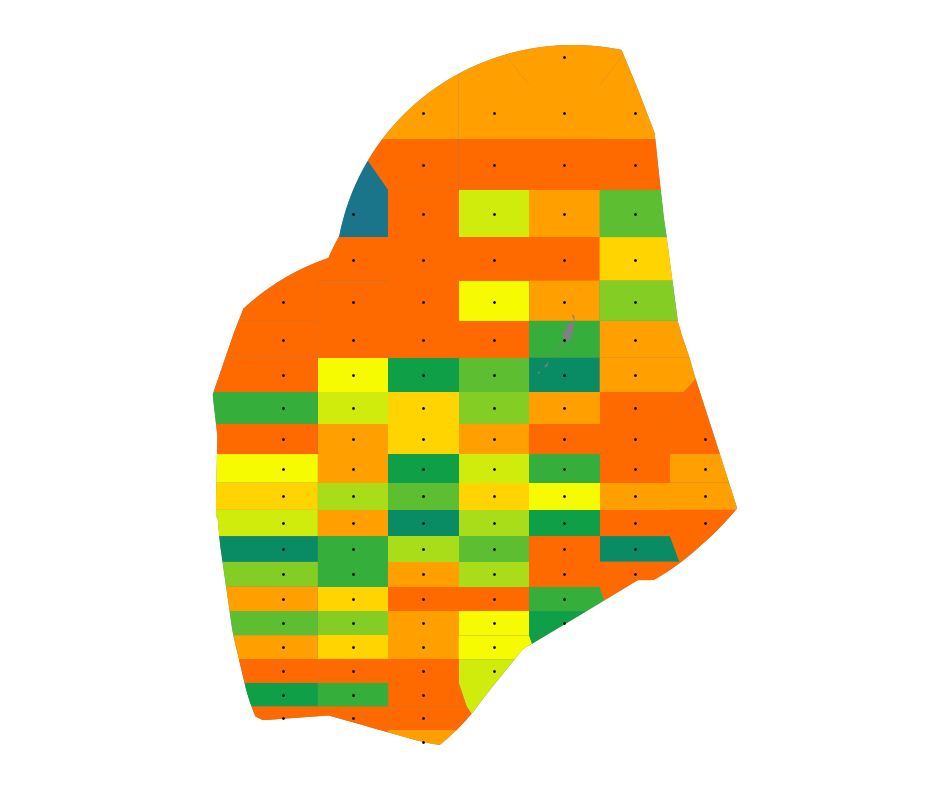

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2088_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


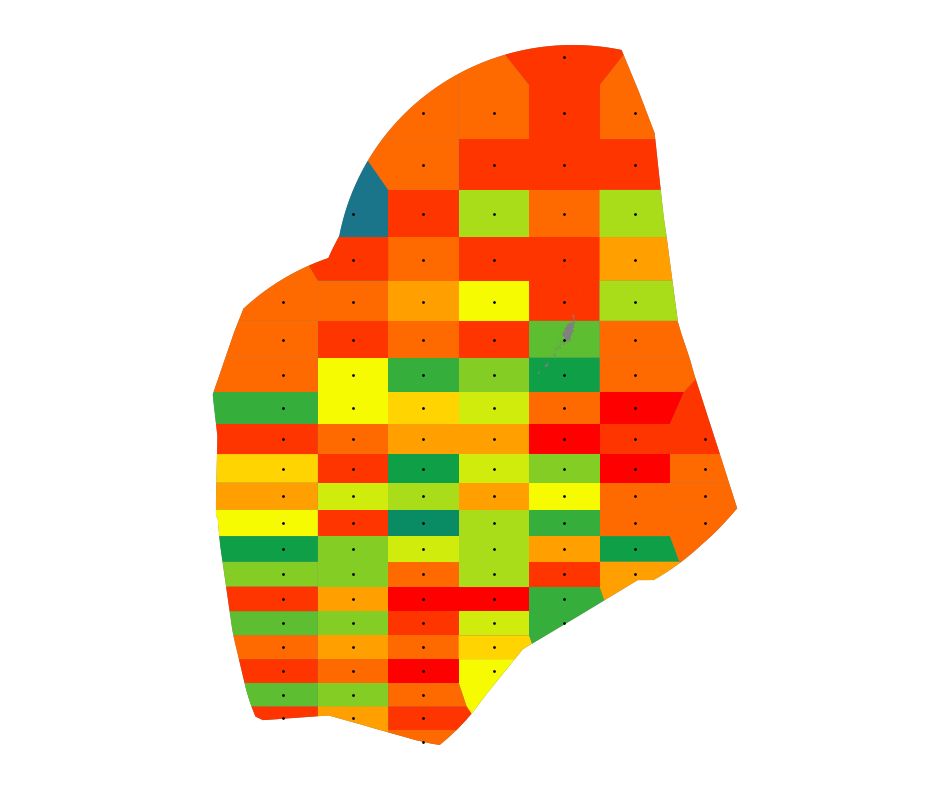

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2089_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


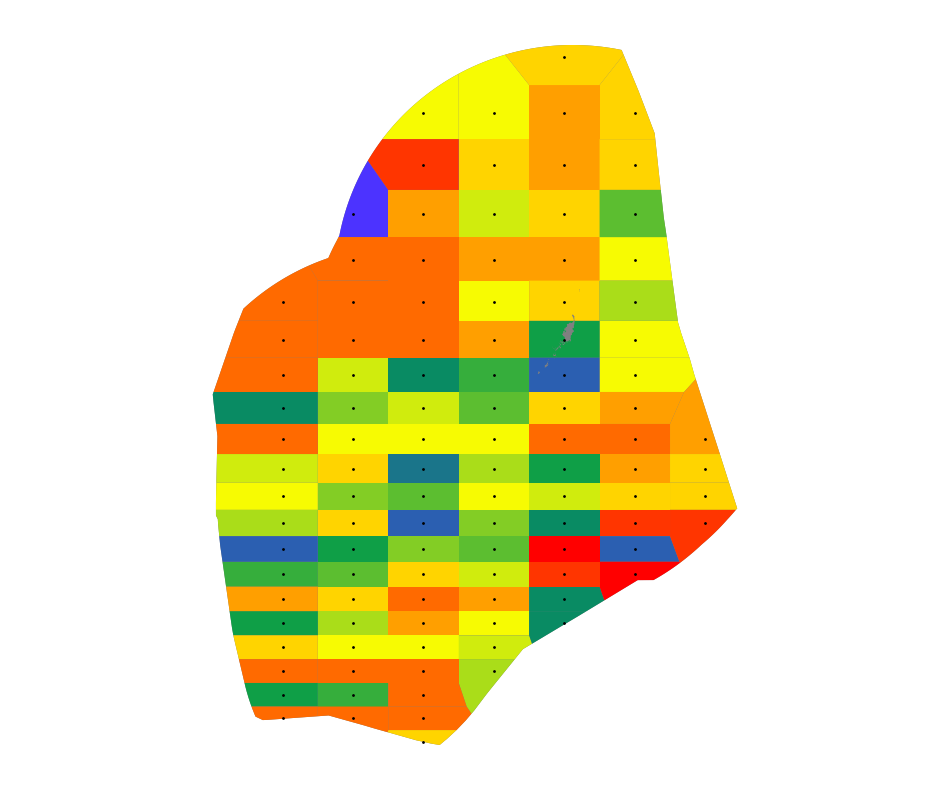

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2090_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


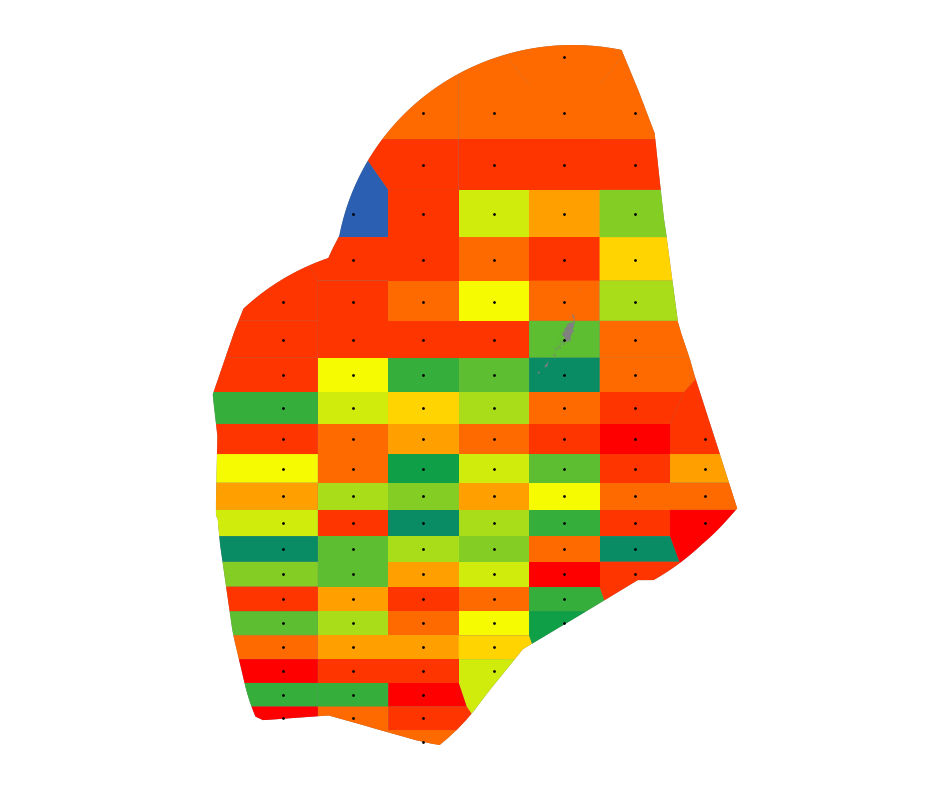

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2091_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


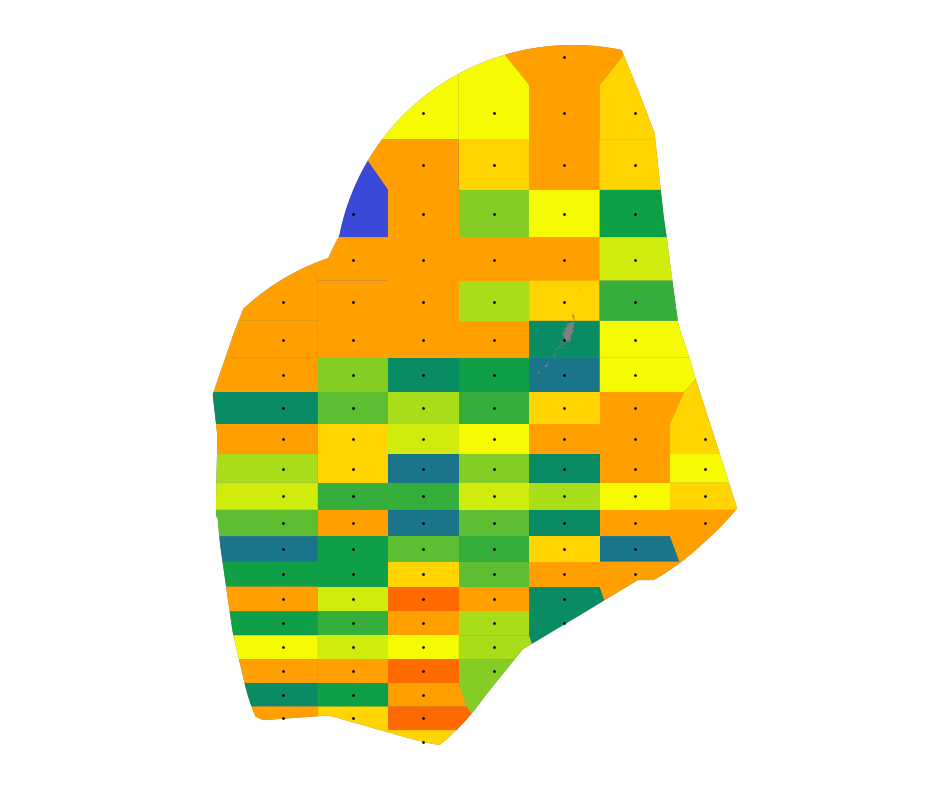

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2092_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


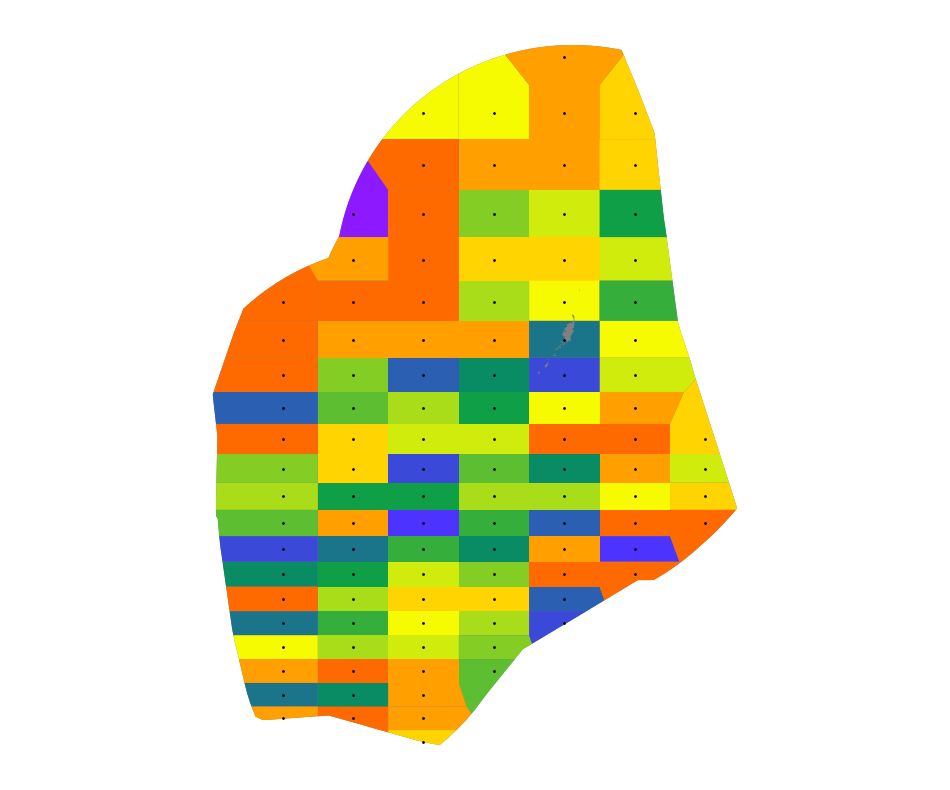

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2093_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


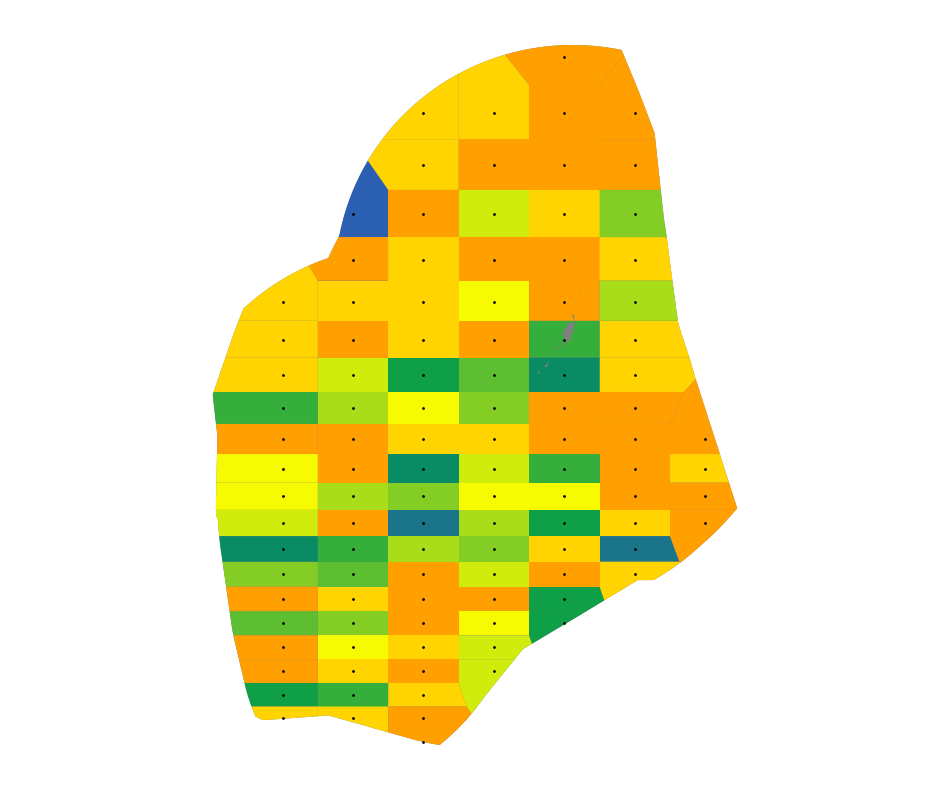

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2094_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


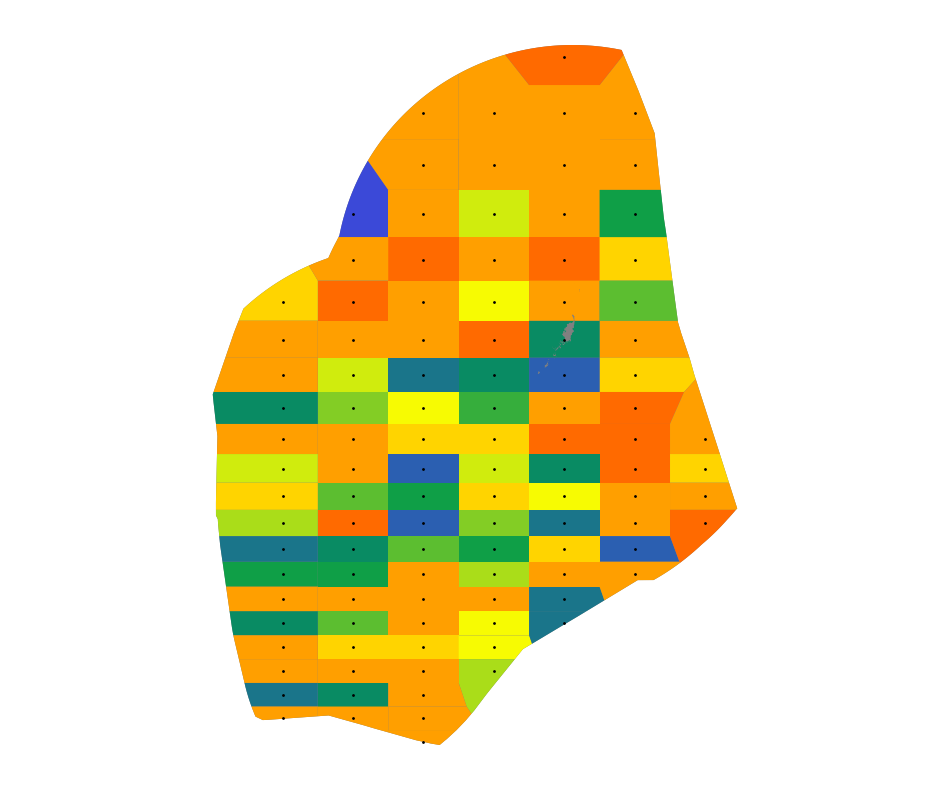

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2095_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


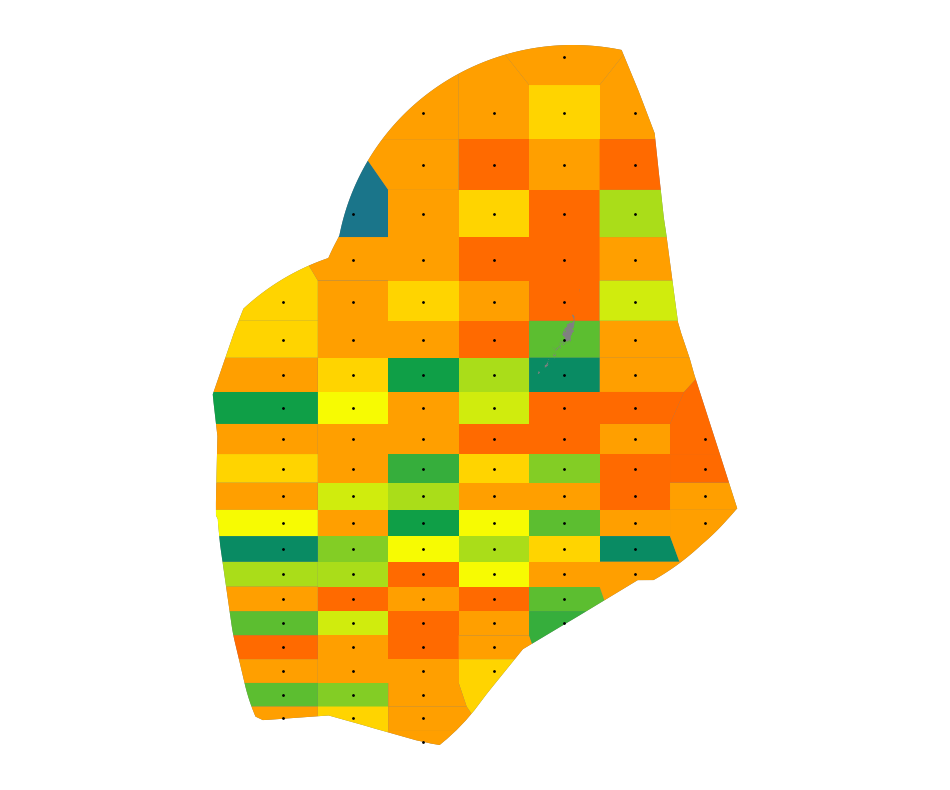

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2096_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


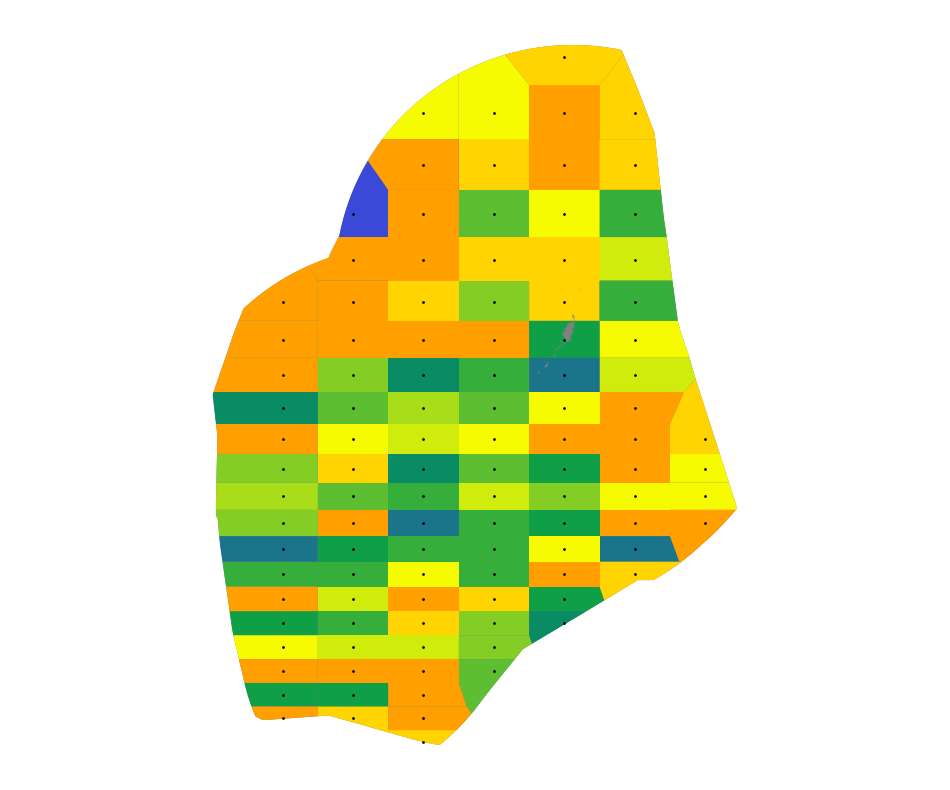

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2097_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


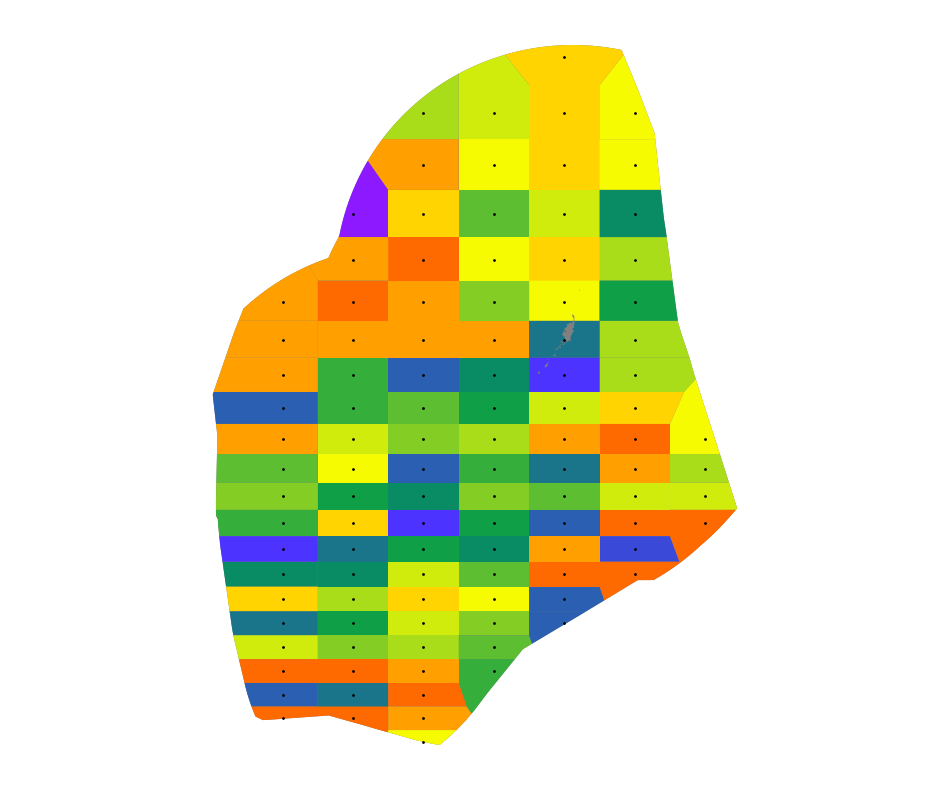

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2098_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


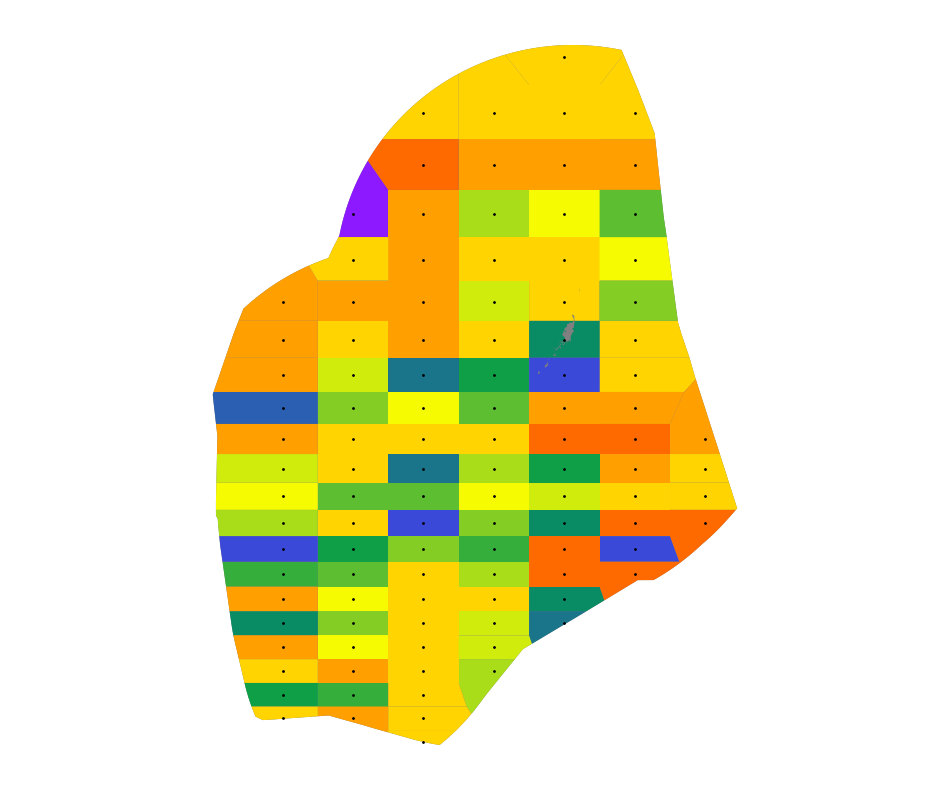

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2099_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


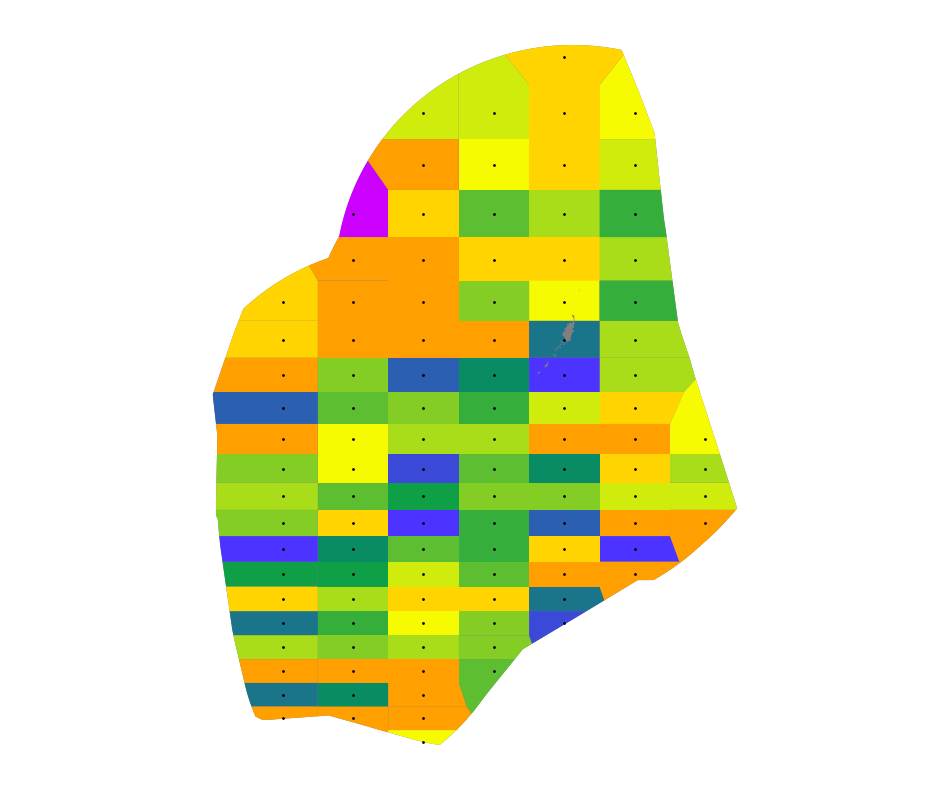

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp534-over_r3i1p1f1/2100_tos_Omon_CanESM5_ssp534-over_r3i1p1f1.json
CanESM5 ssp434
latlon_tos_Omon_CanESM5_ssp434_r3i1p1f1_.pkl
Created: 2015-2100_colorbar_tos_Omon_CanESM5_ssp434_r3i1p1f1.png


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


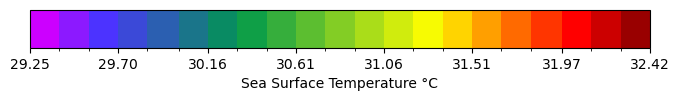

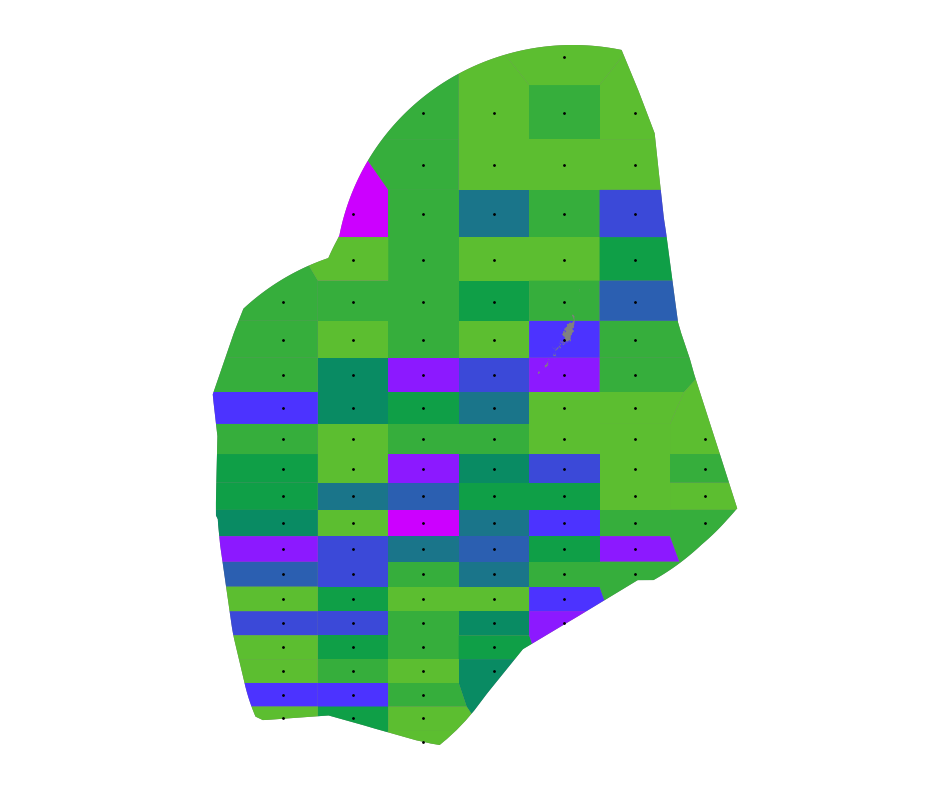

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2015_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


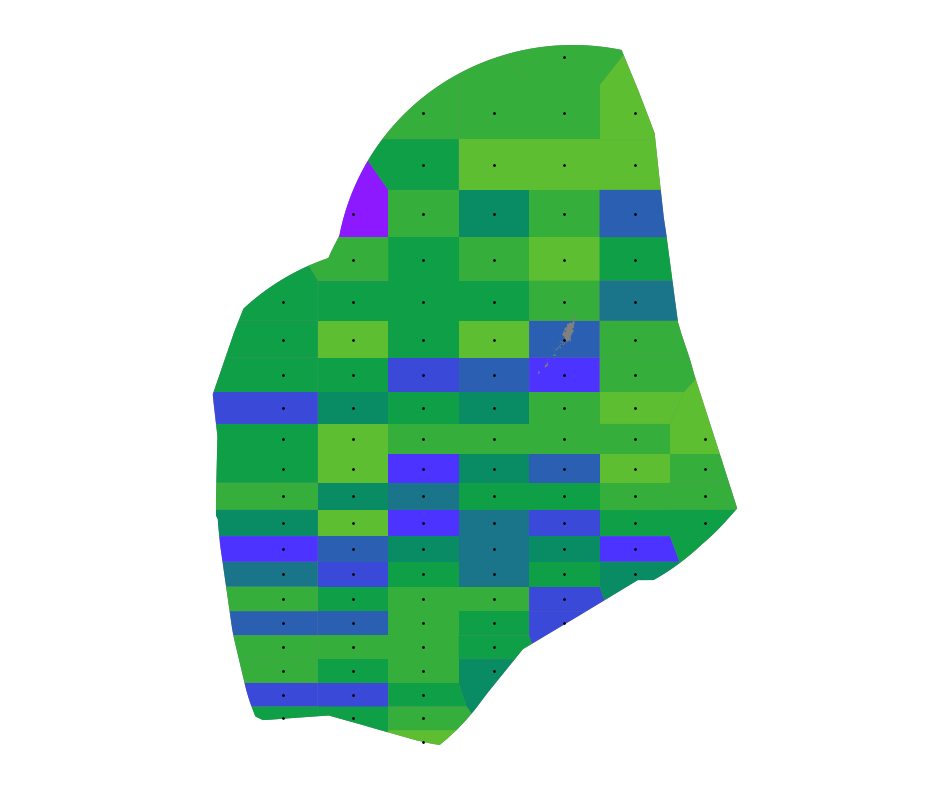

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2016_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


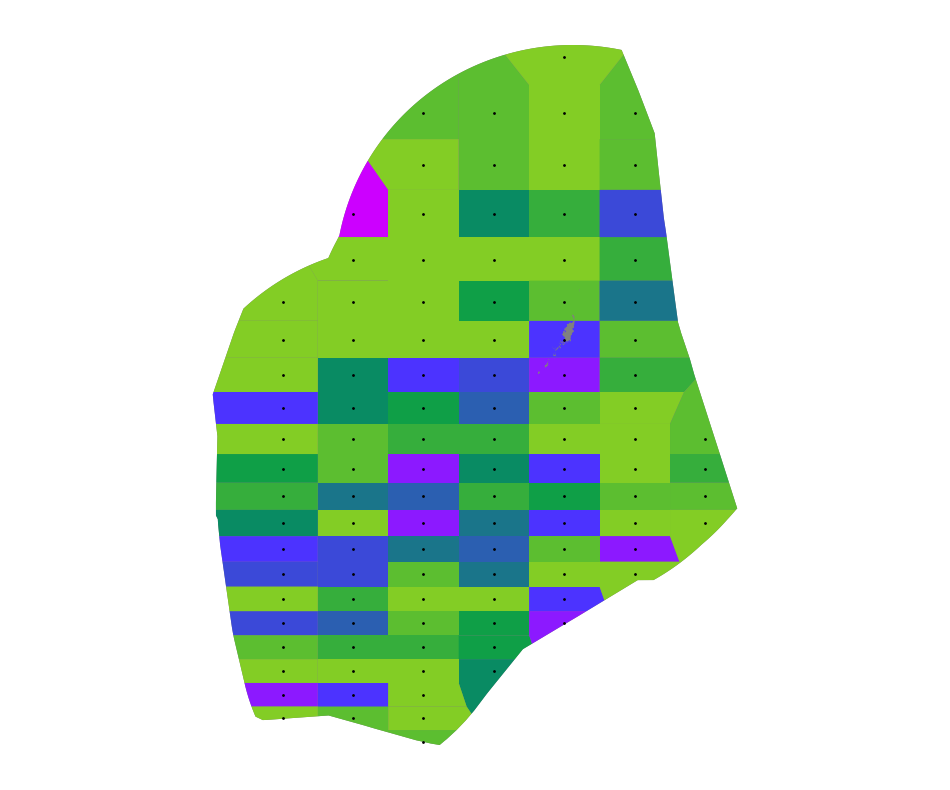

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2017_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


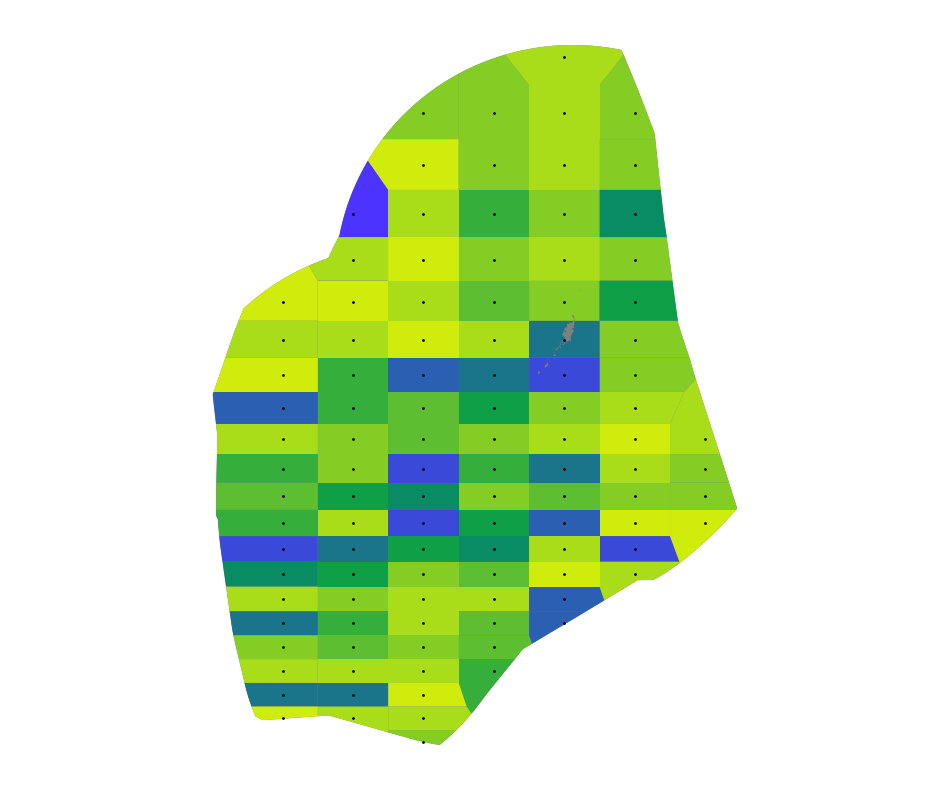

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2018_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


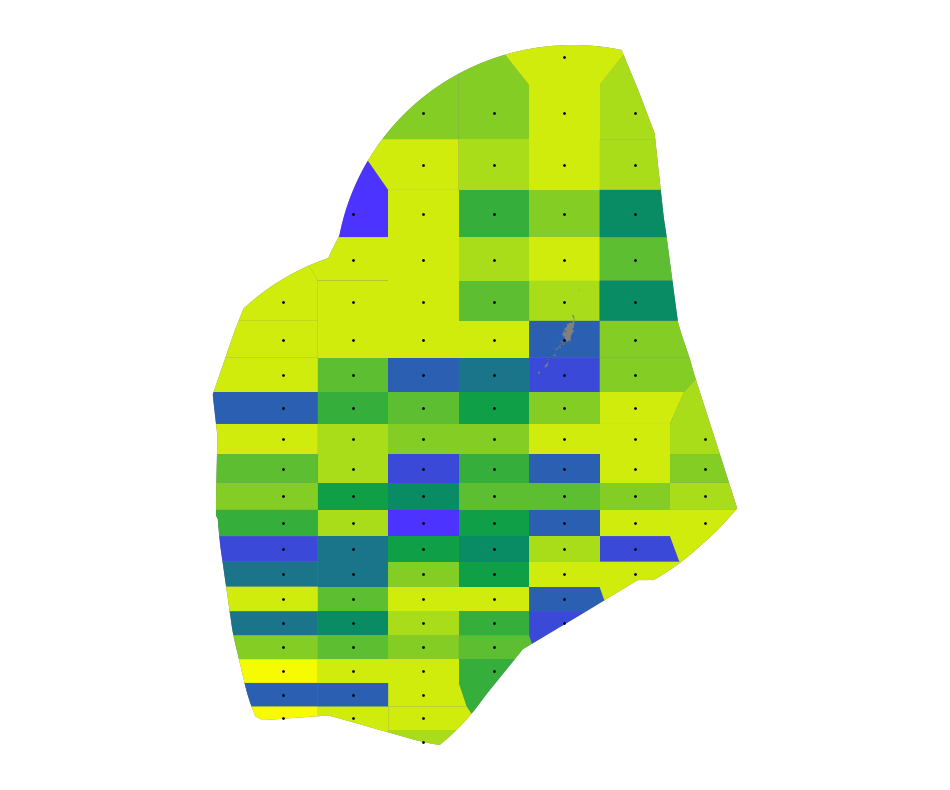

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2019_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


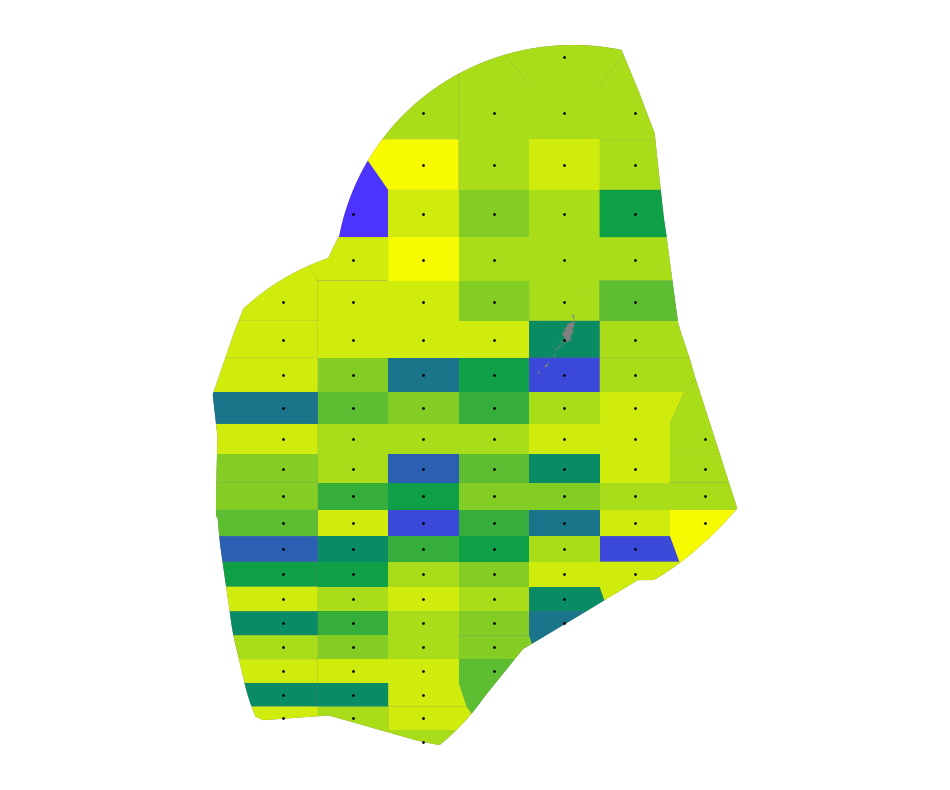

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2020_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


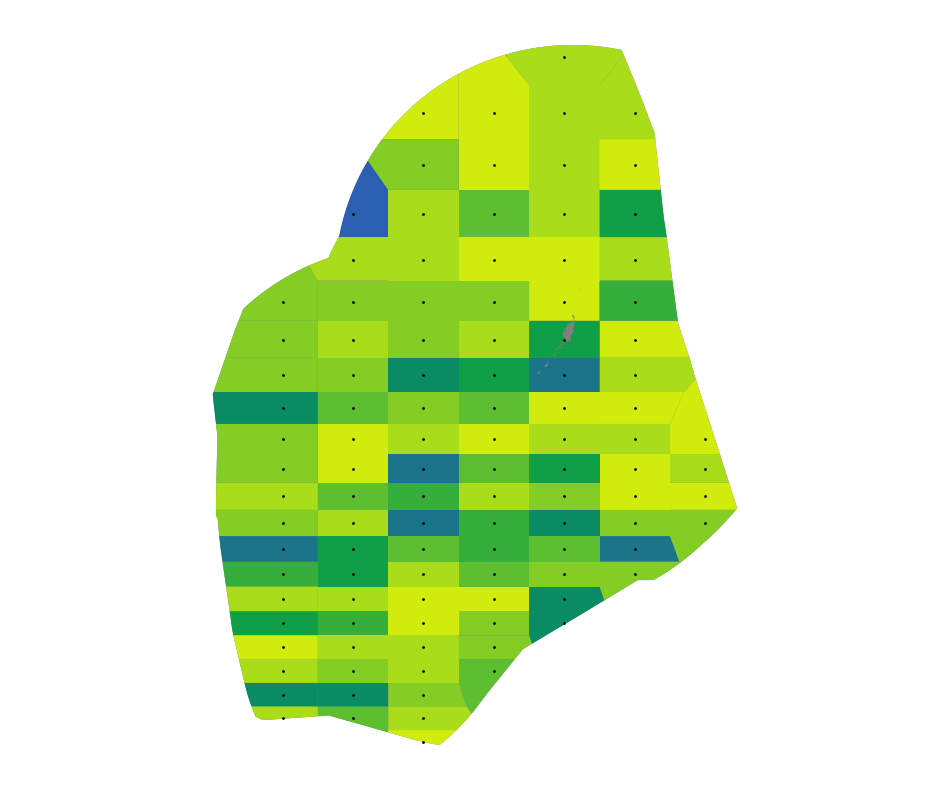

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2021_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


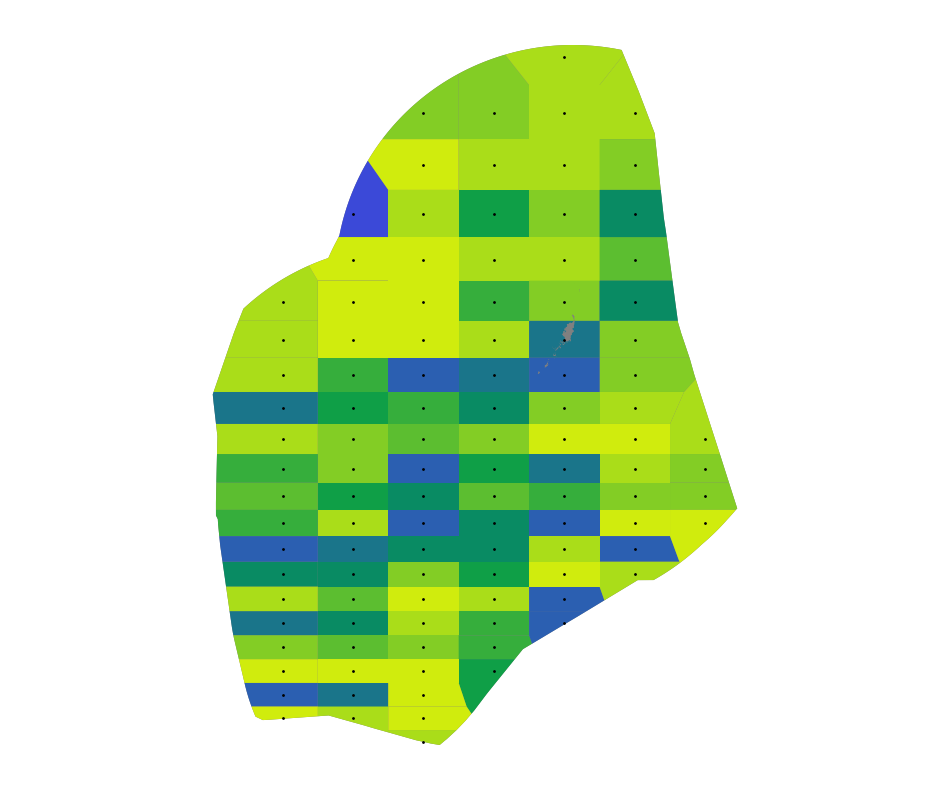

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2022_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


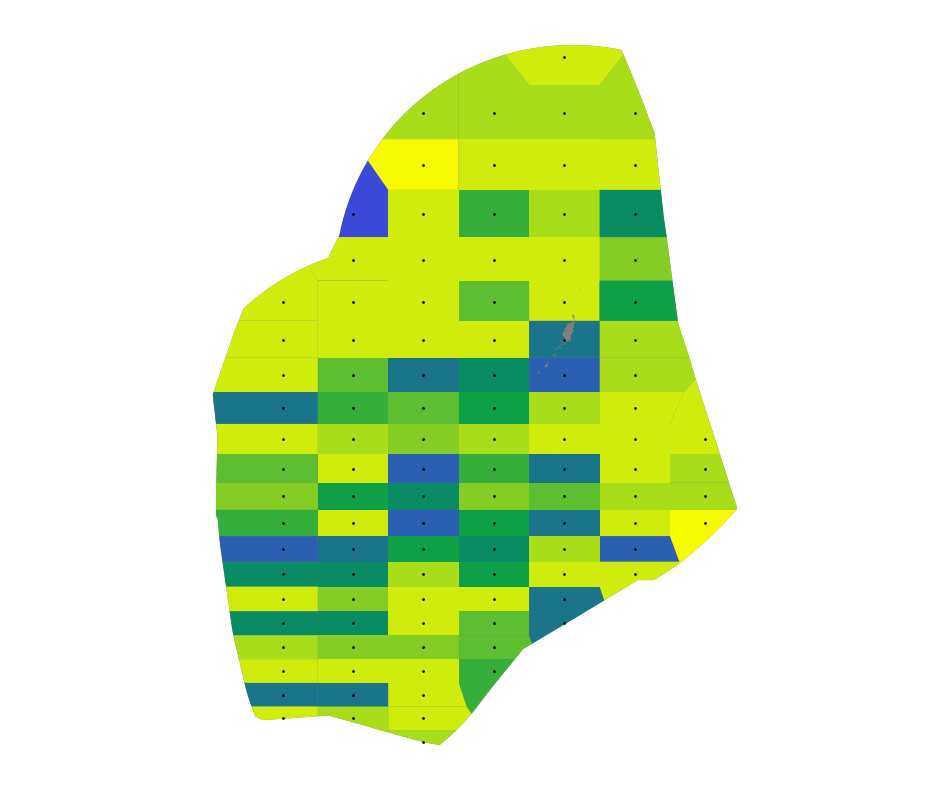

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2023_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


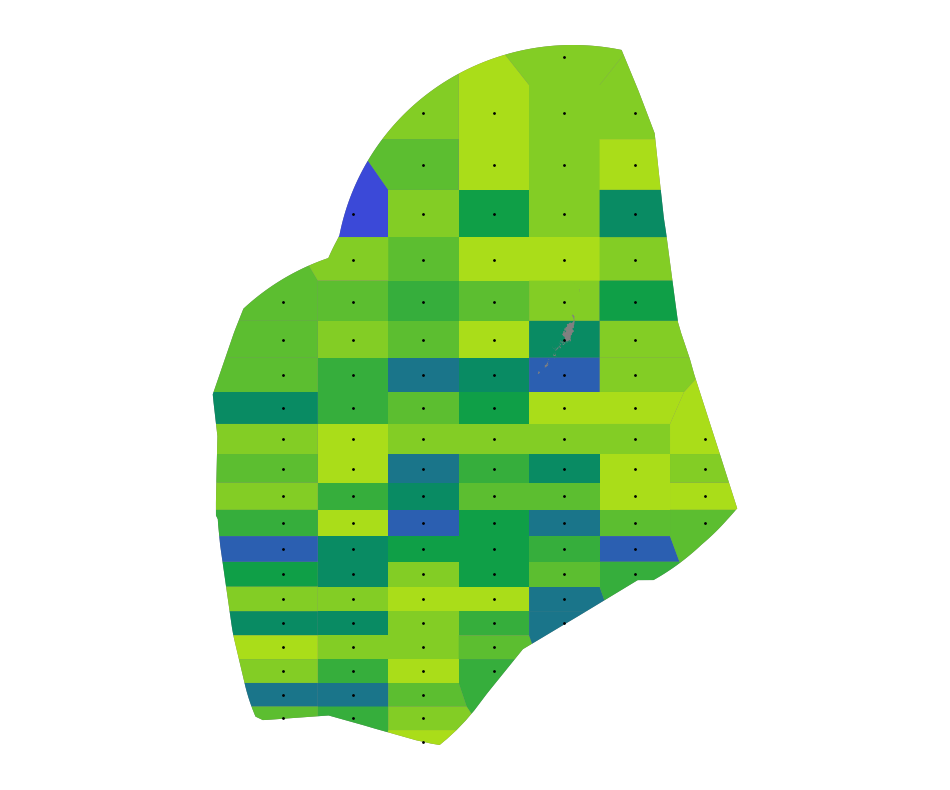

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2024_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


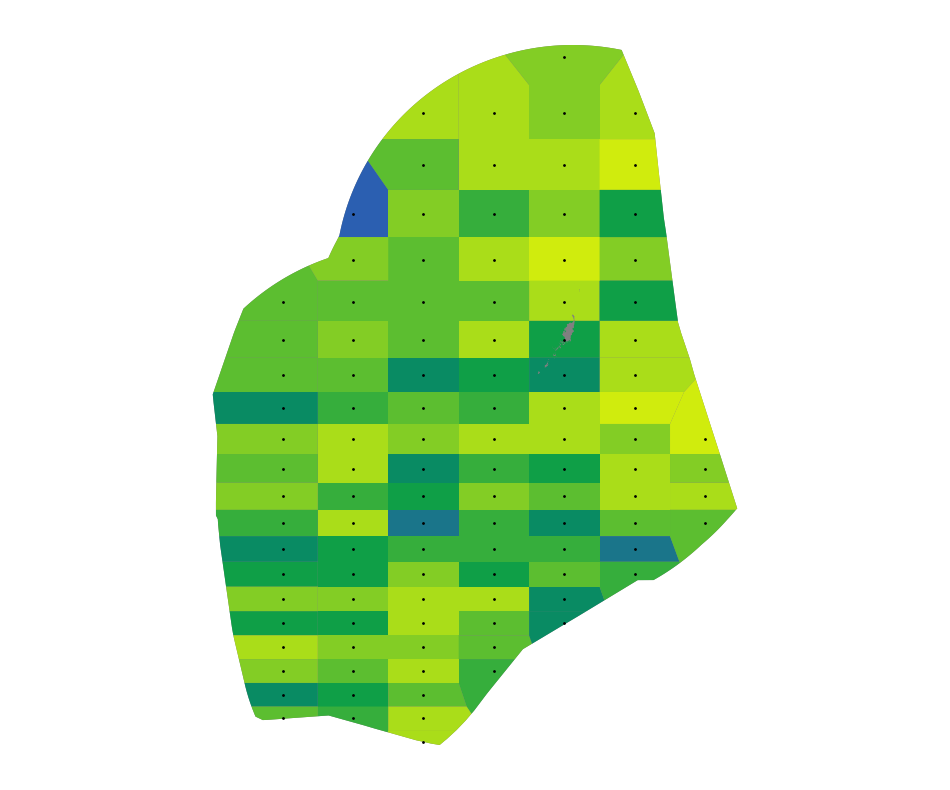

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2025_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


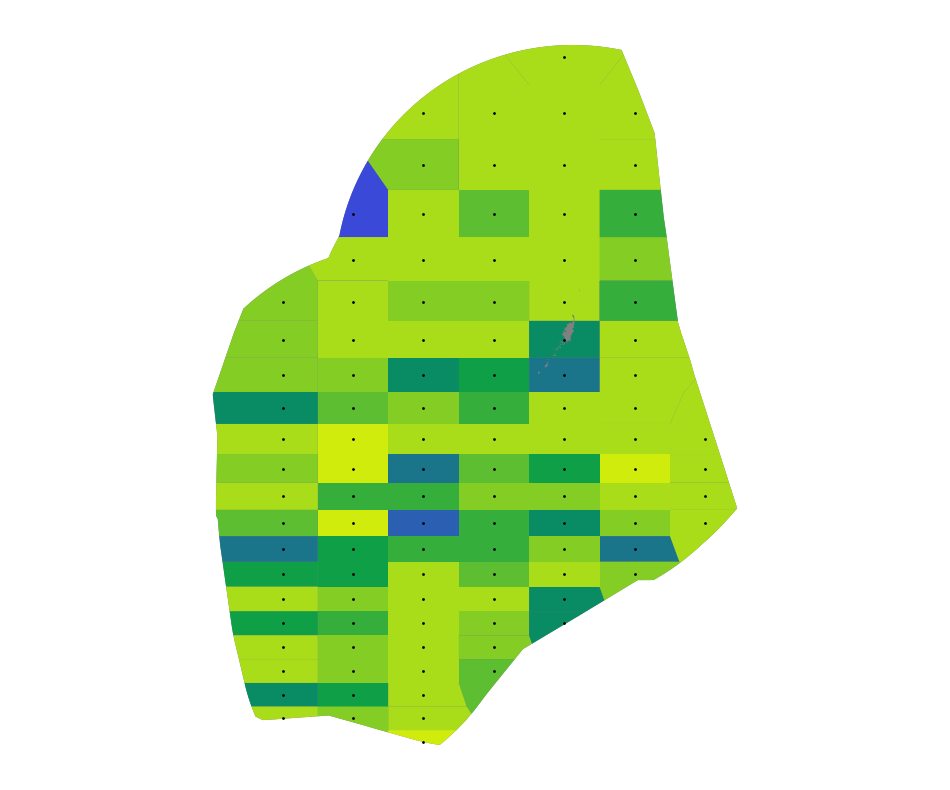

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2026_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


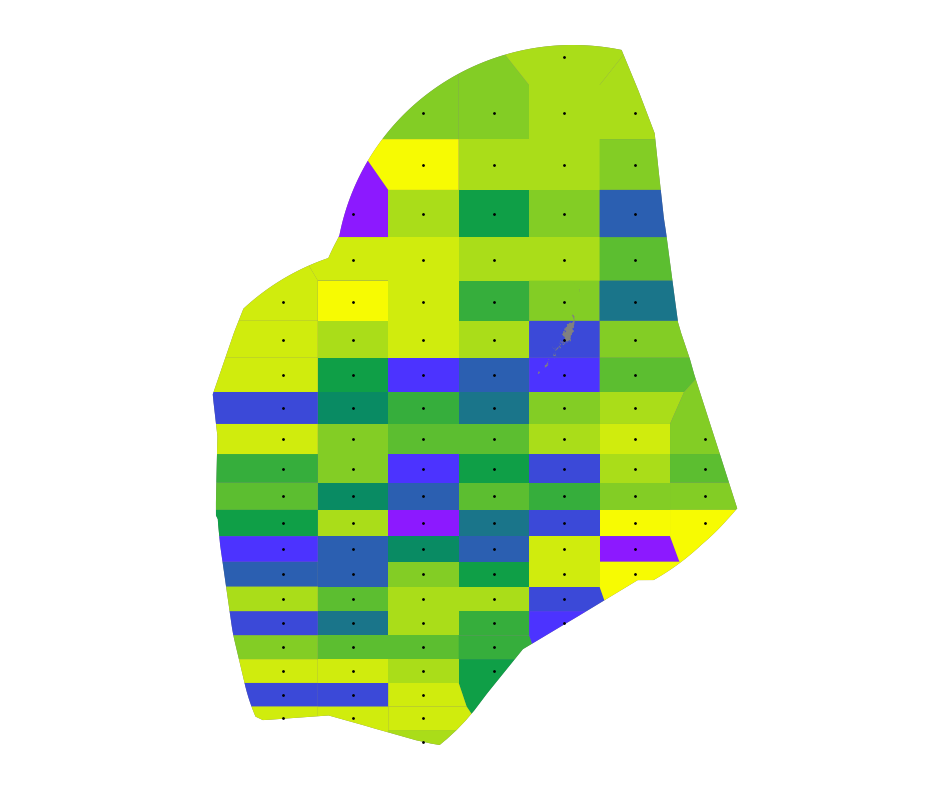

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2027_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


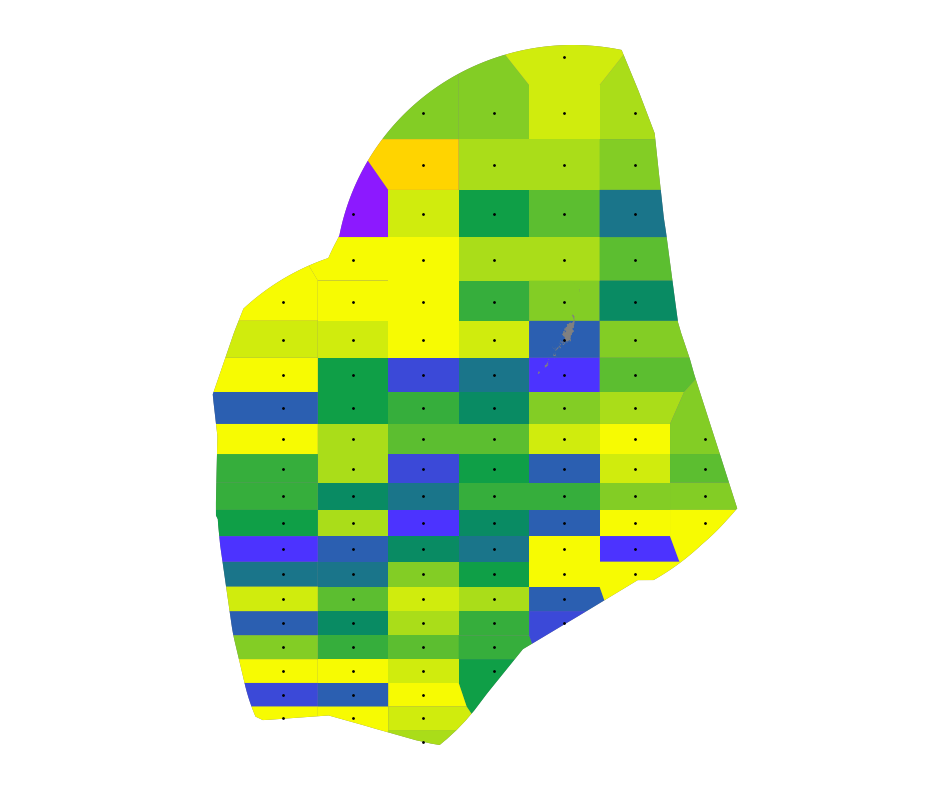

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2028_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


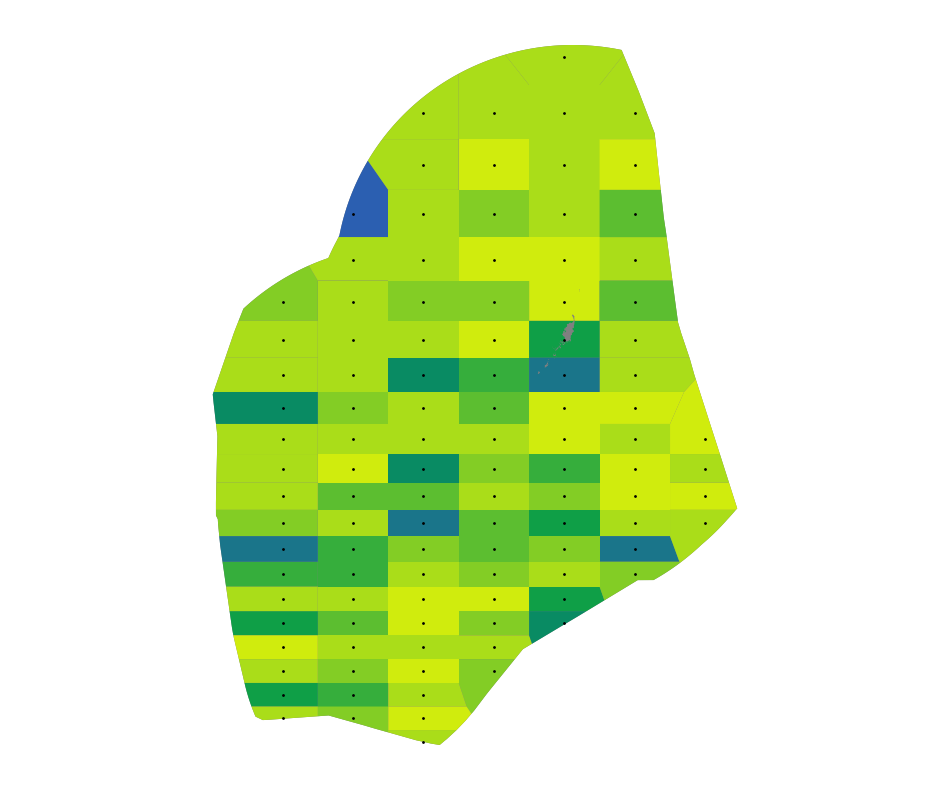

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2029_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


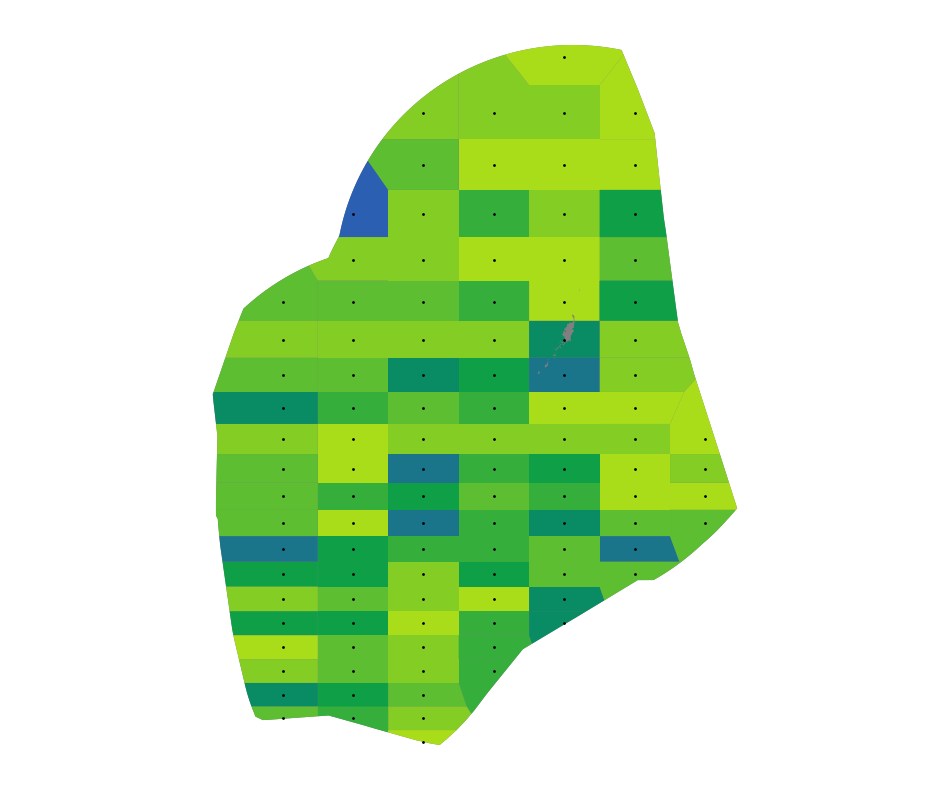

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2030_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


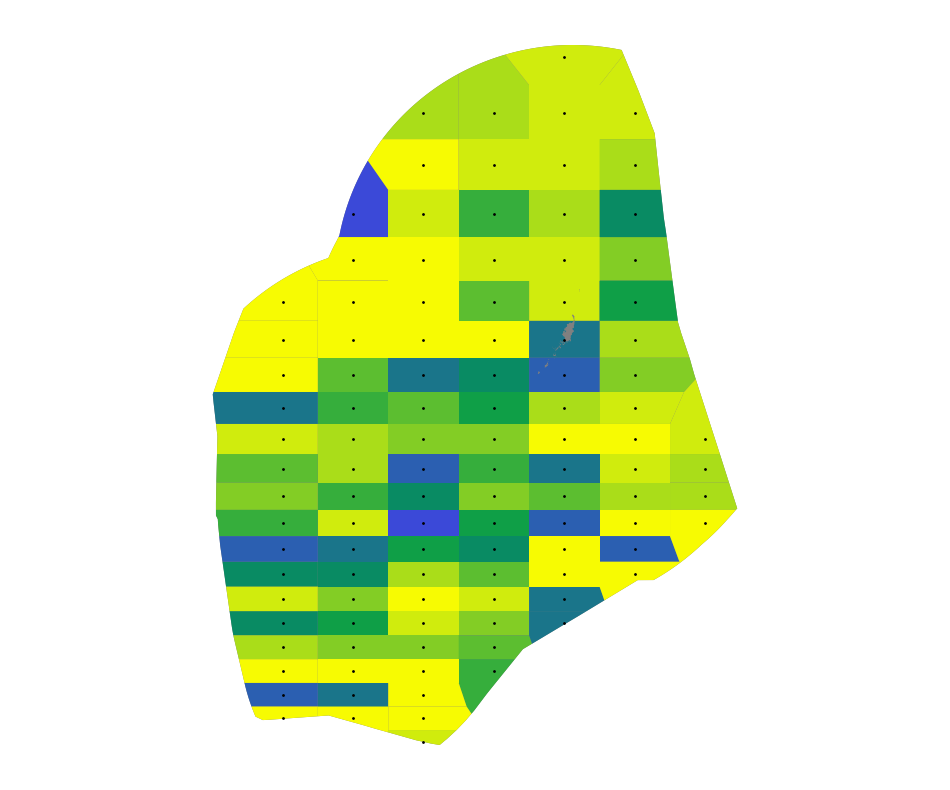

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2031_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


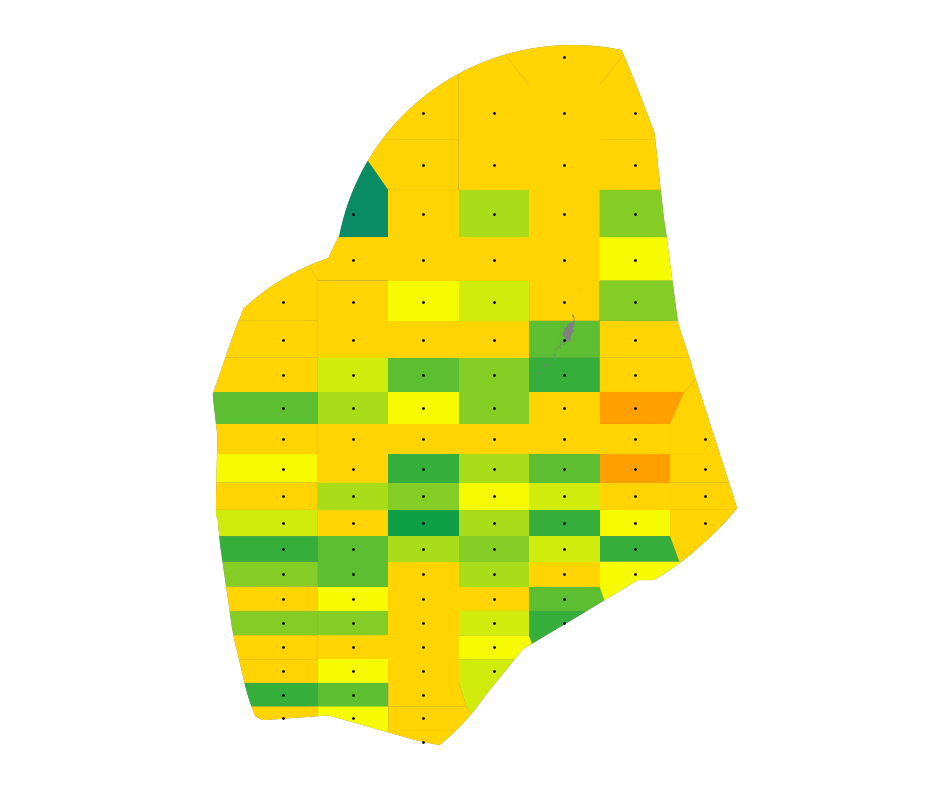

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2032_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


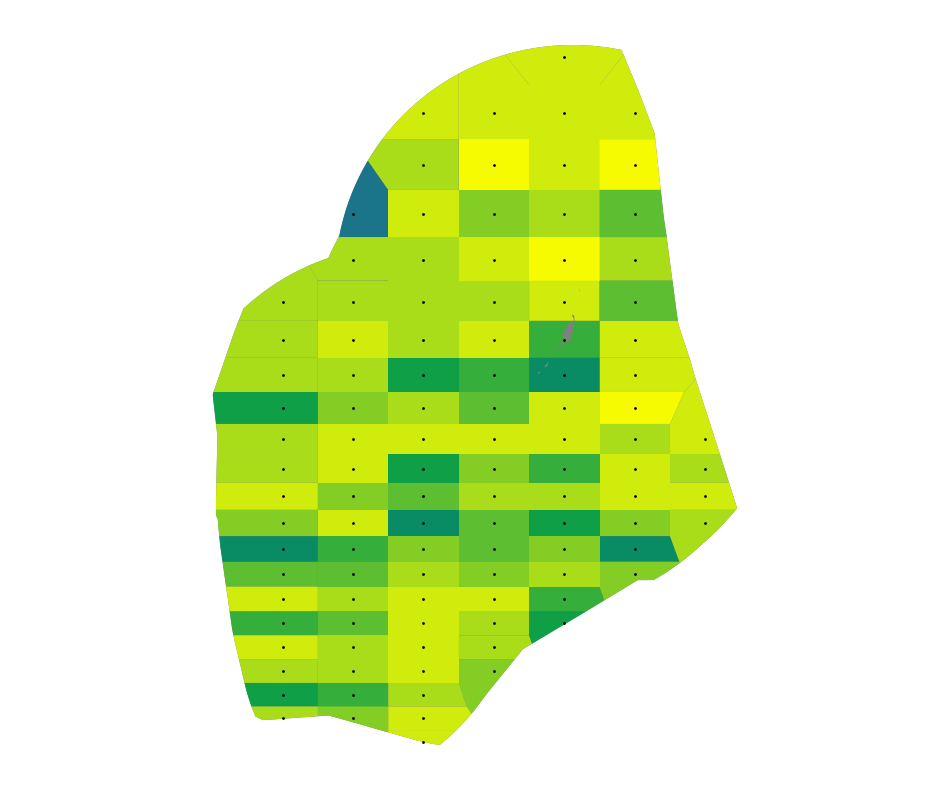

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2033_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


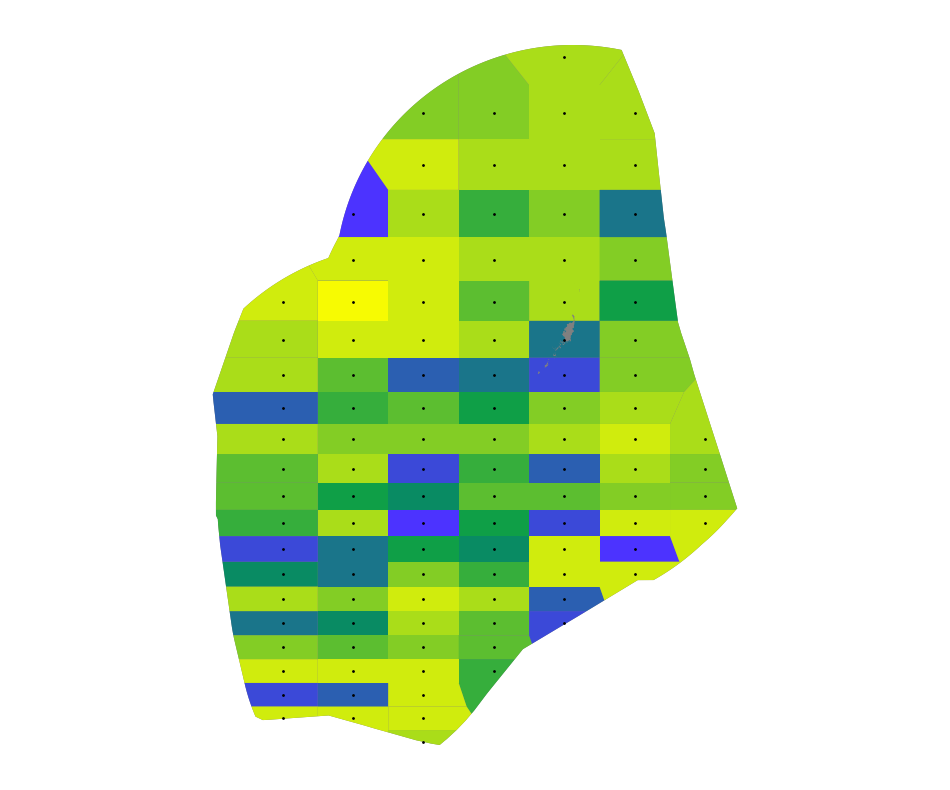

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2034_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


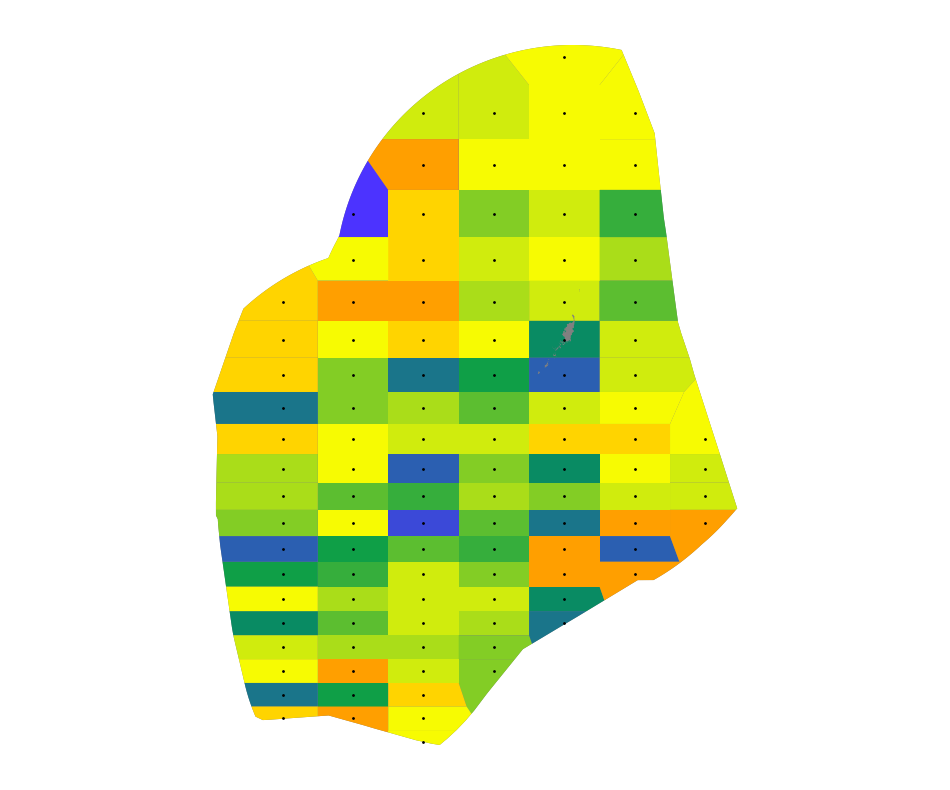

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2035_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


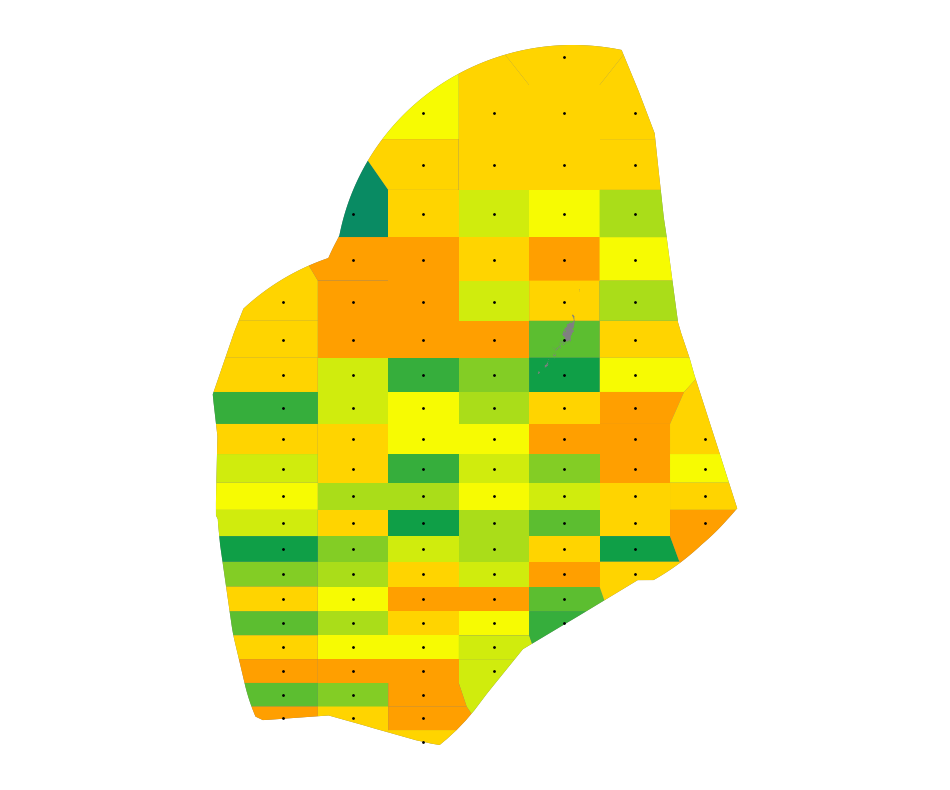

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2036_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


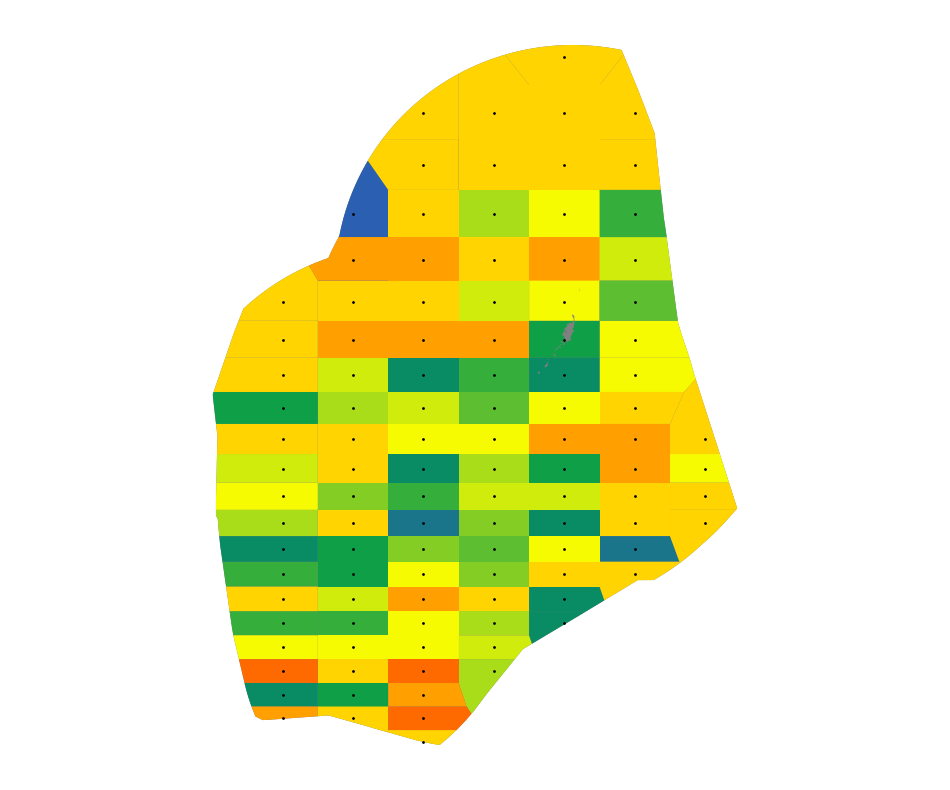

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2037_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


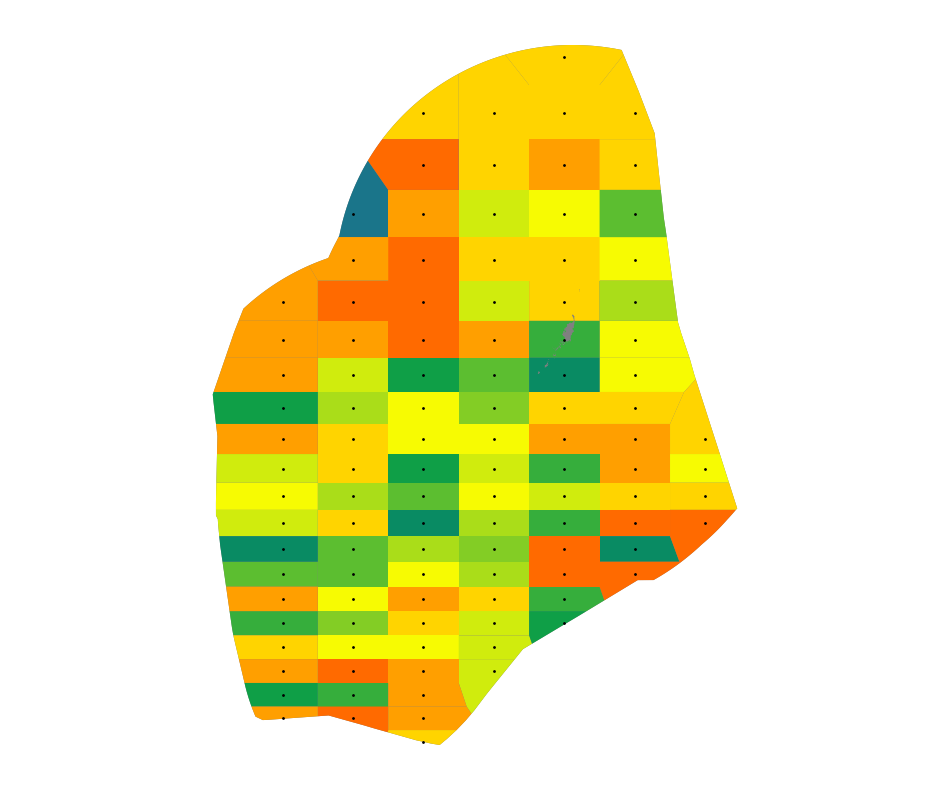

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2038_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


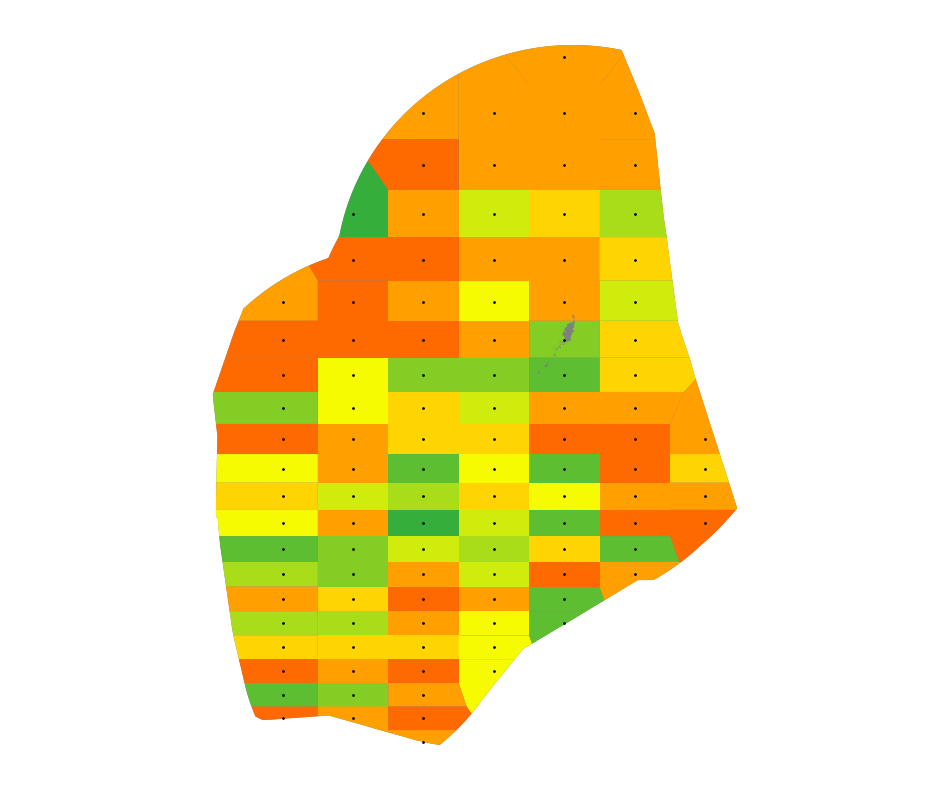

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2039_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


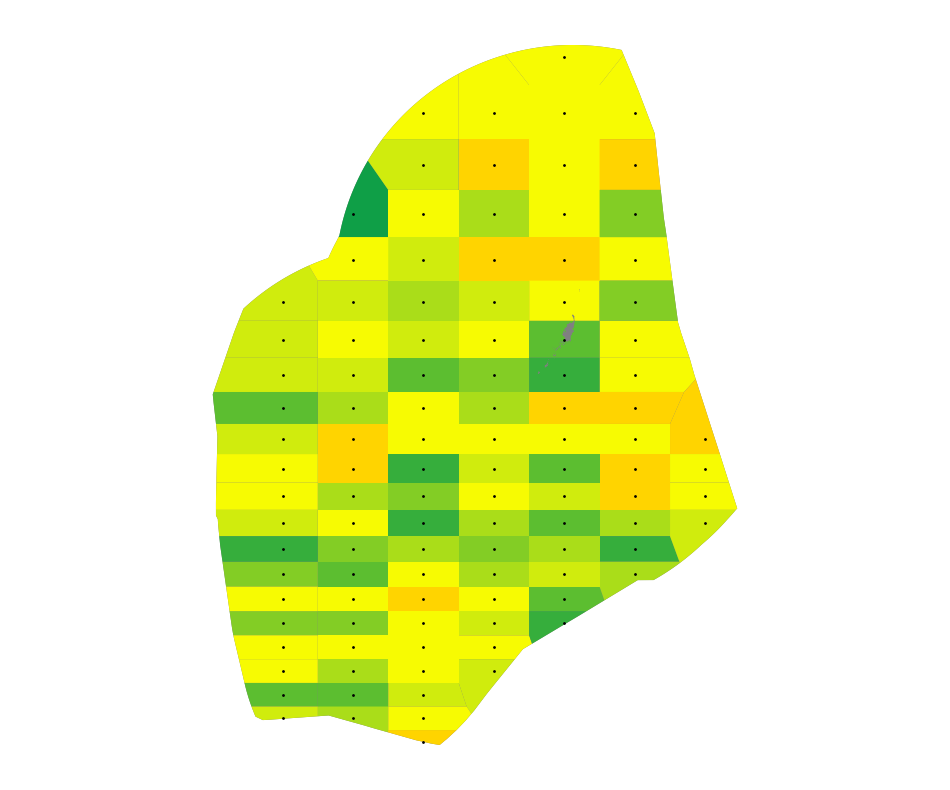

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2040_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


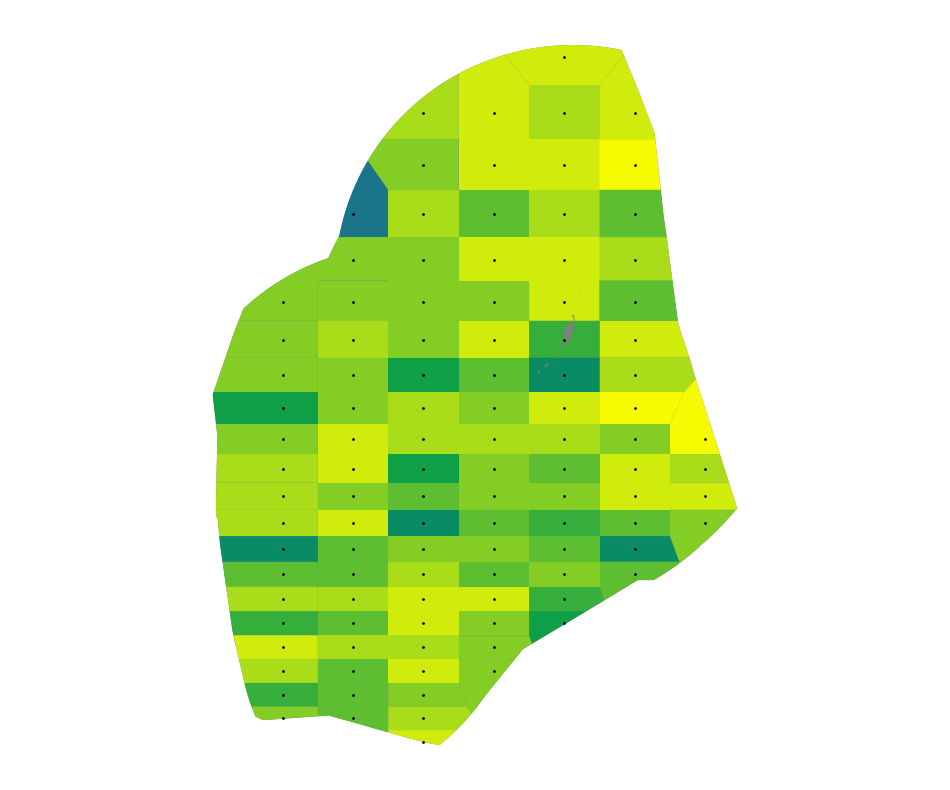

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2041_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


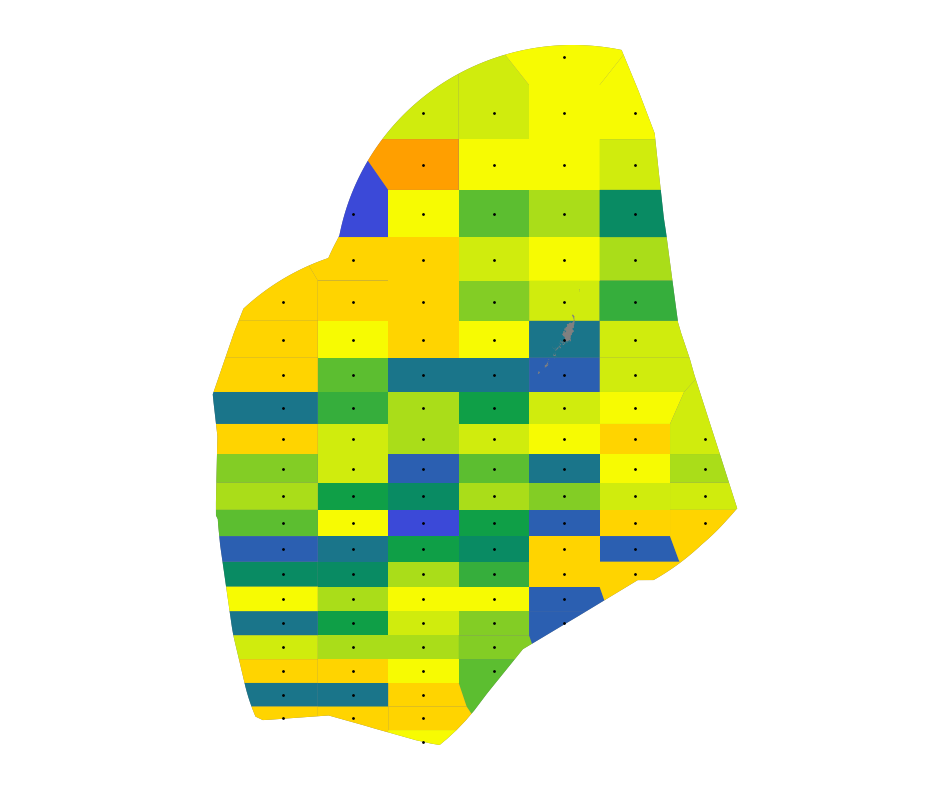

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2042_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


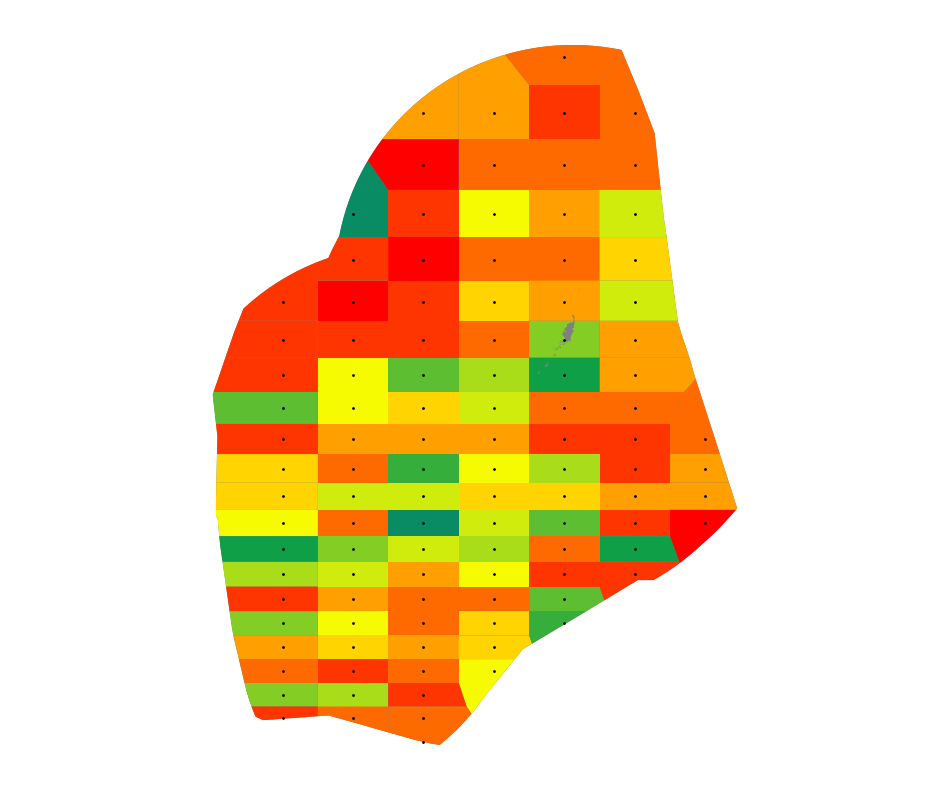

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2043_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


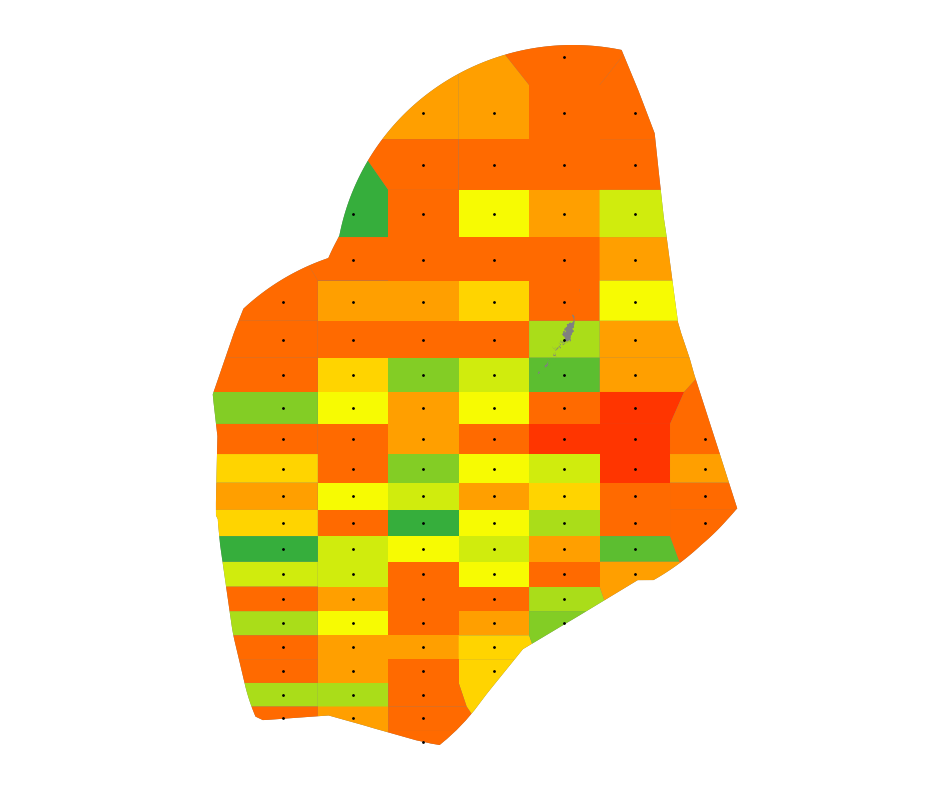

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2044_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


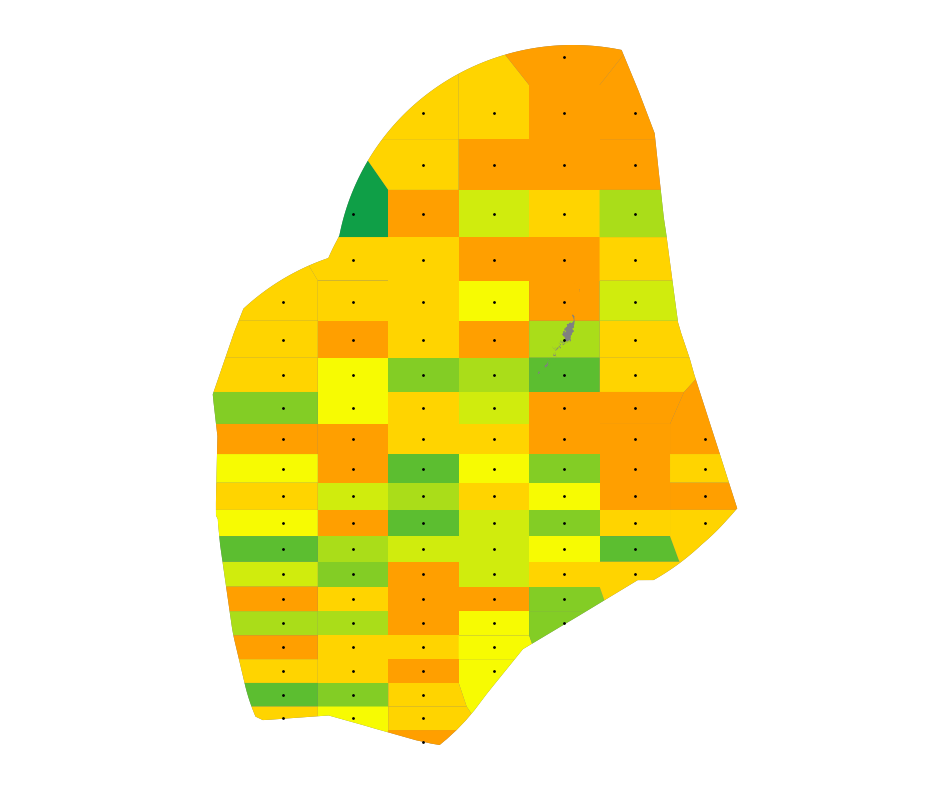

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2045_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


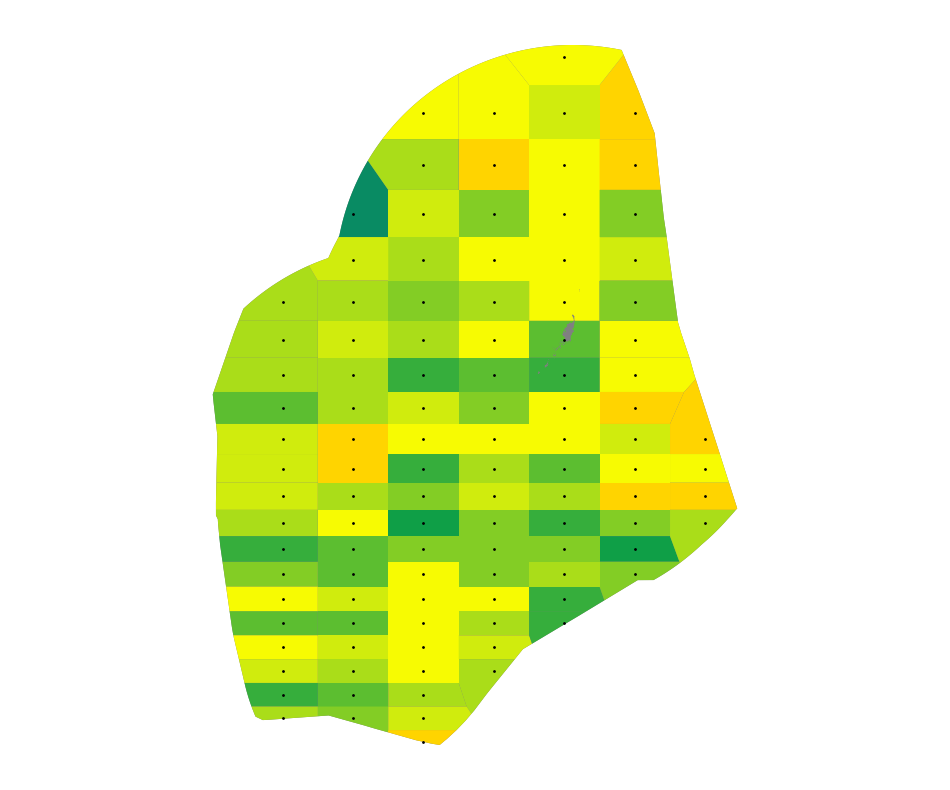

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2046_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


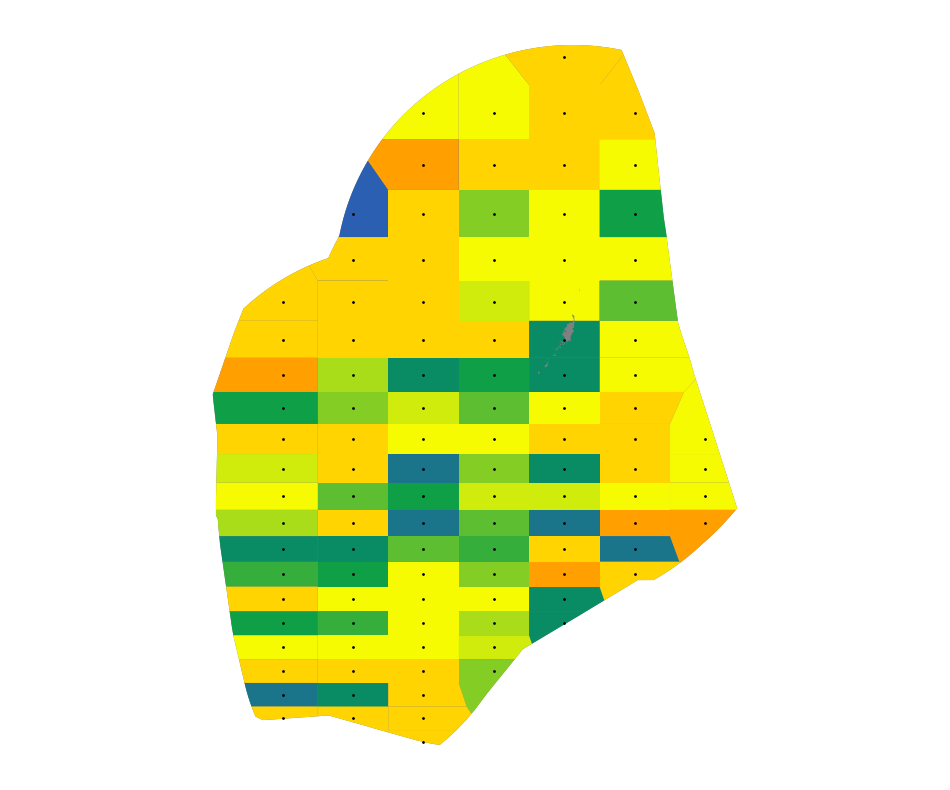

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2047_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


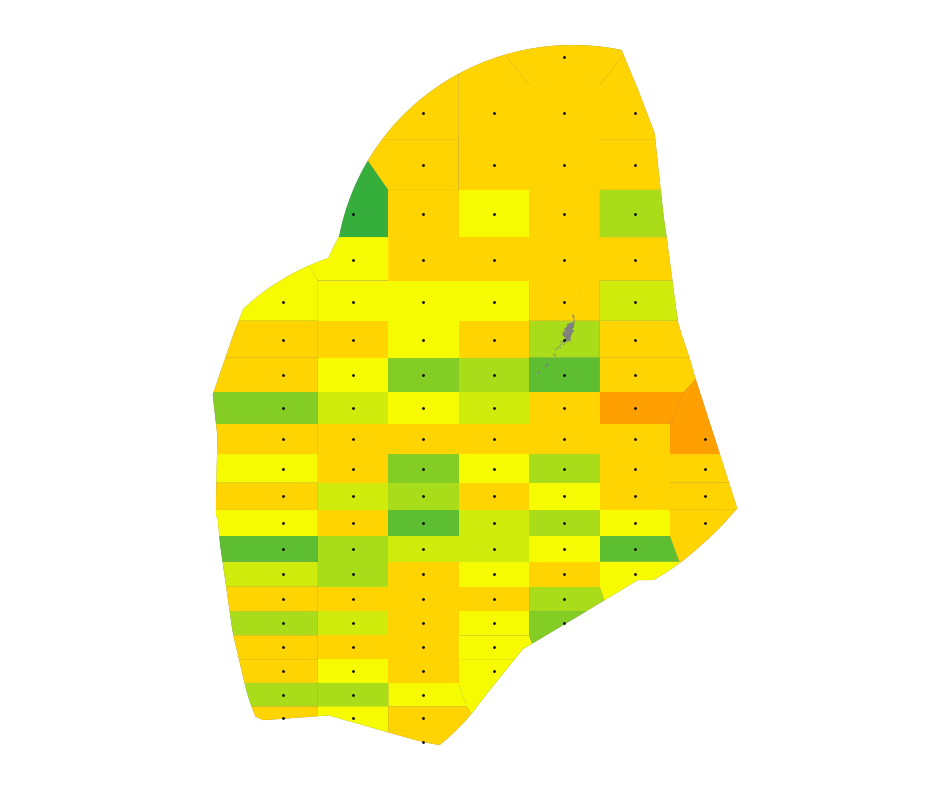

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2048_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


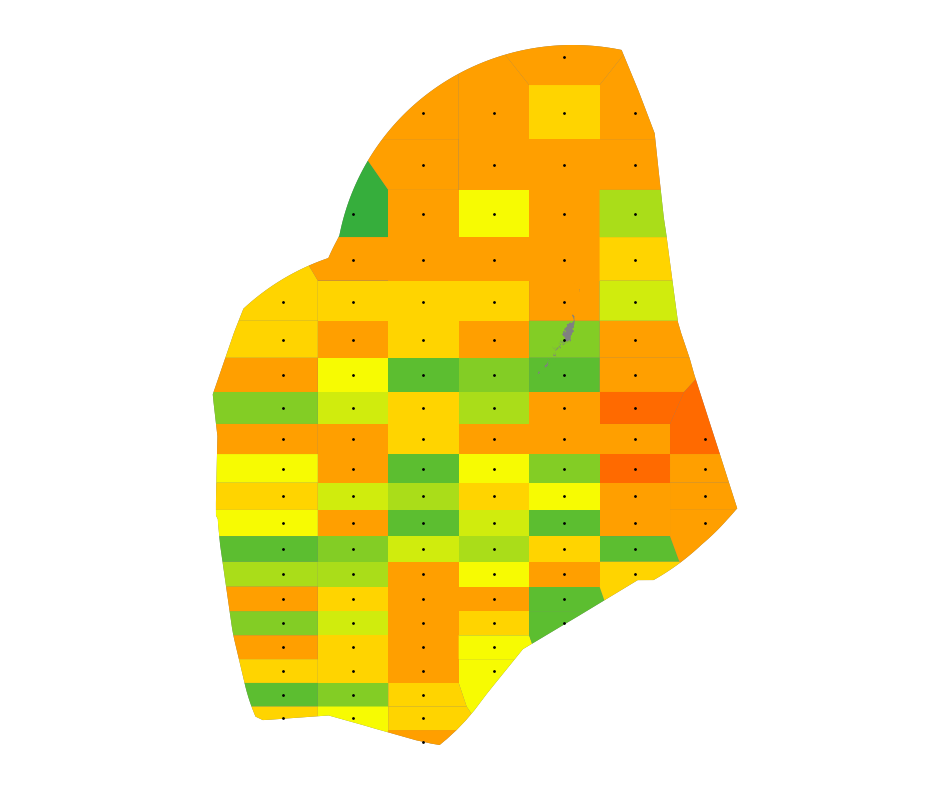

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2049_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


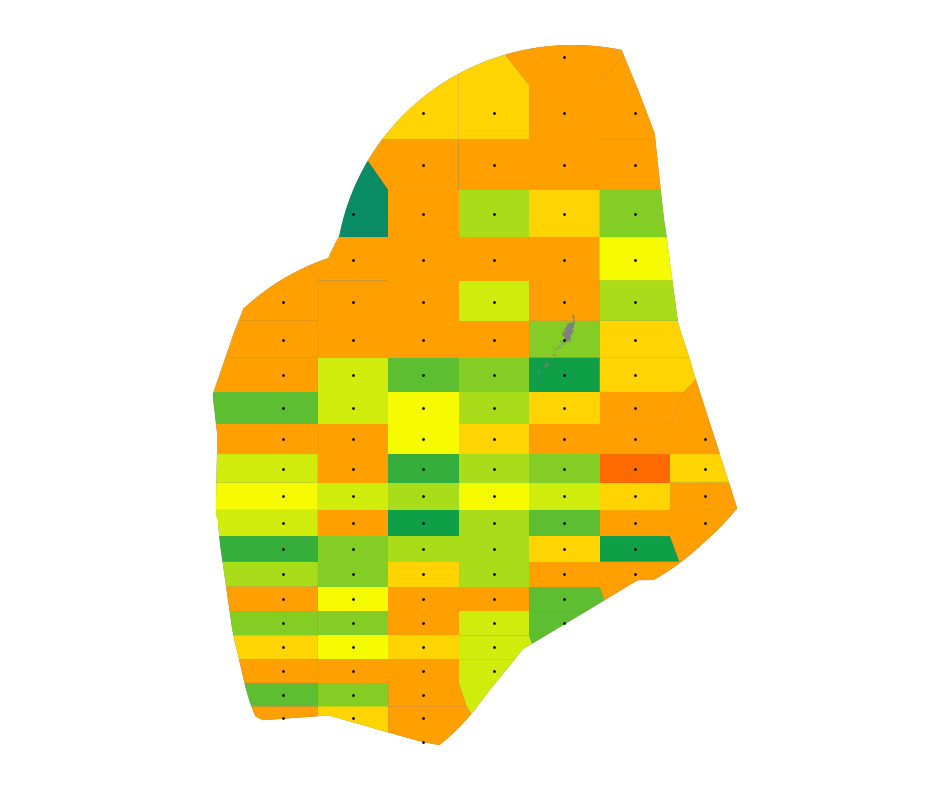

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2050_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


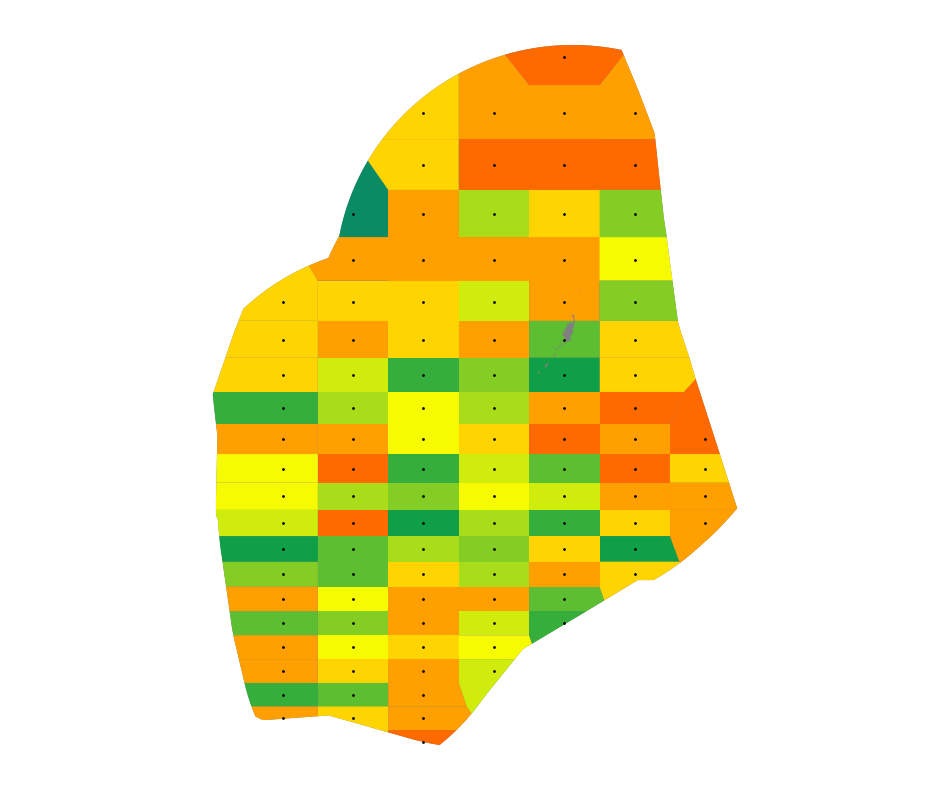

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2051_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


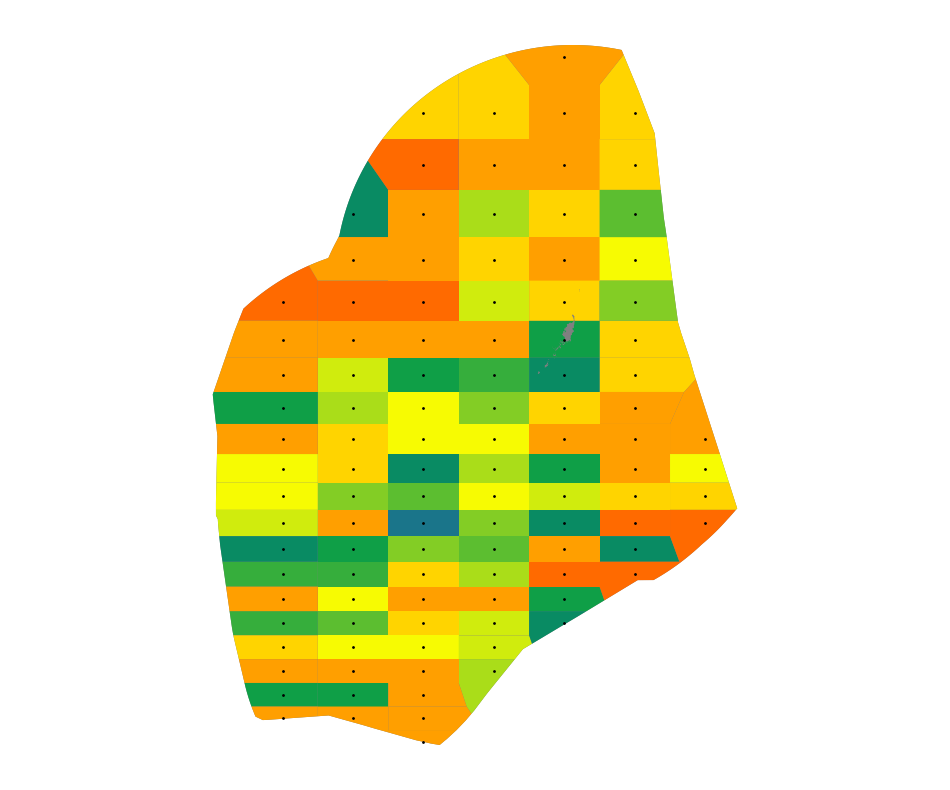

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2052_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


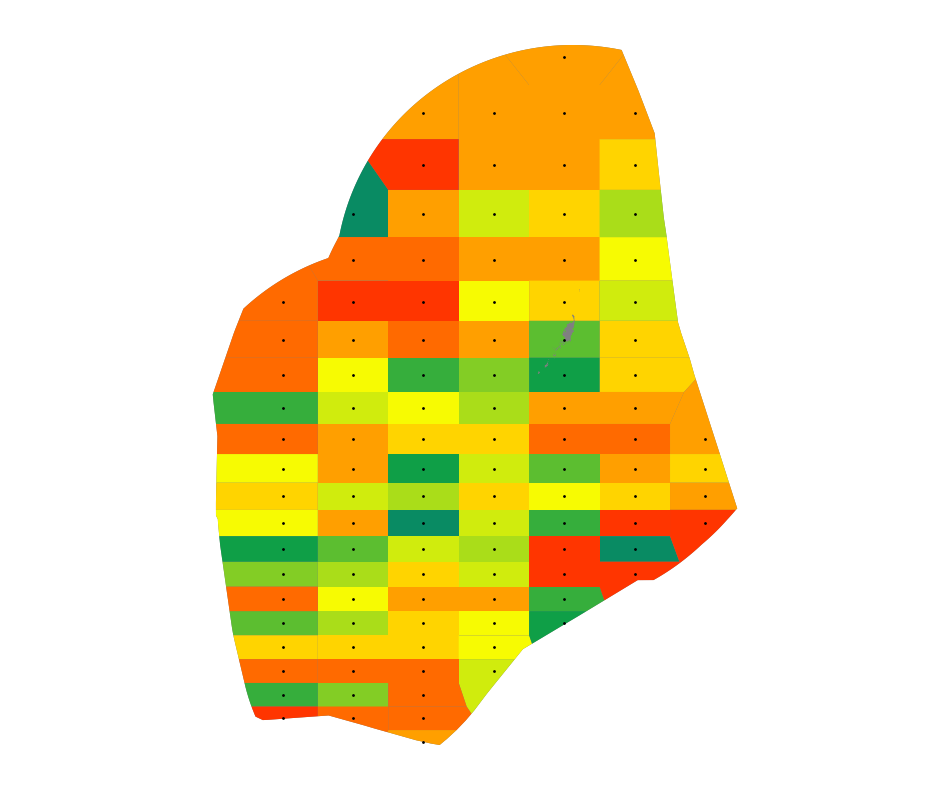

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2053_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


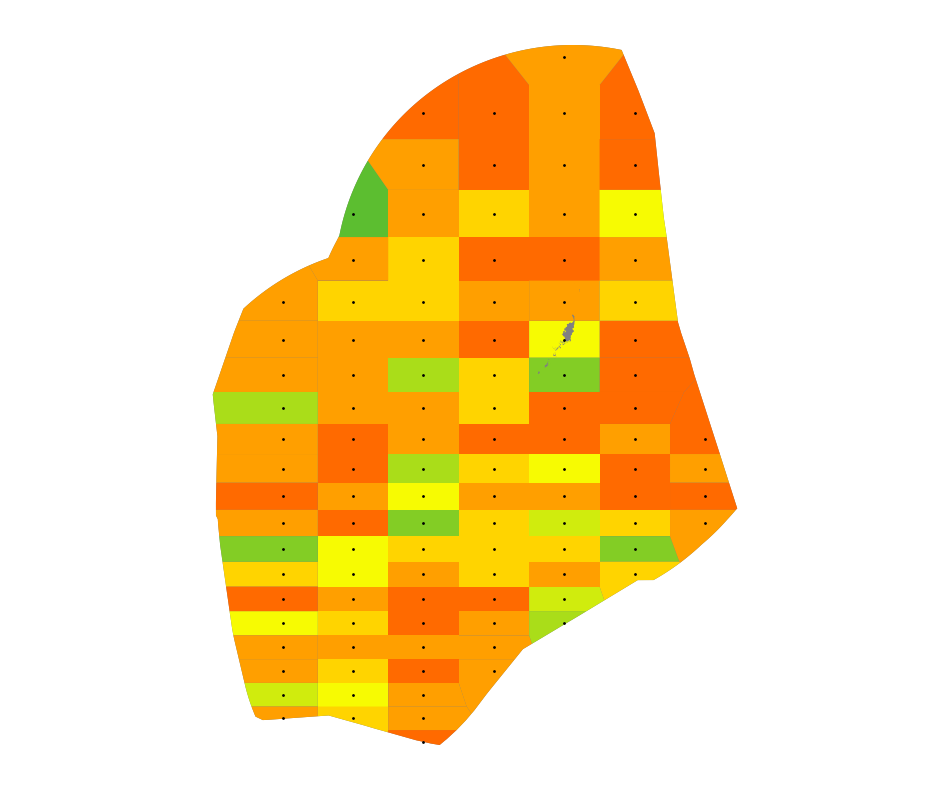

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2054_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


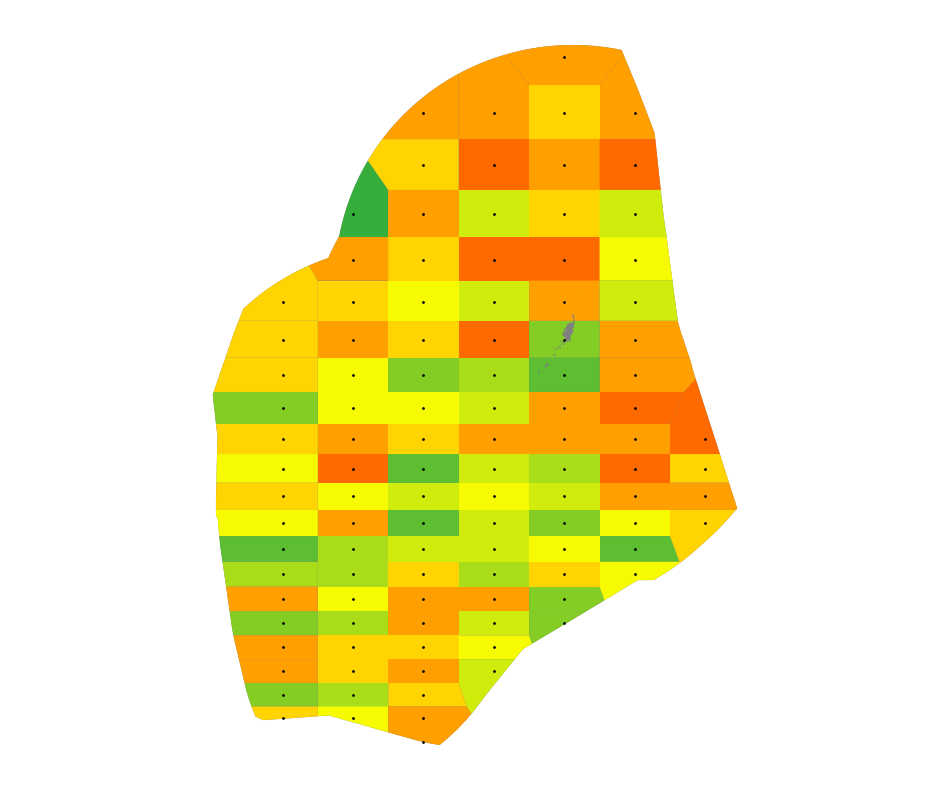

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2055_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


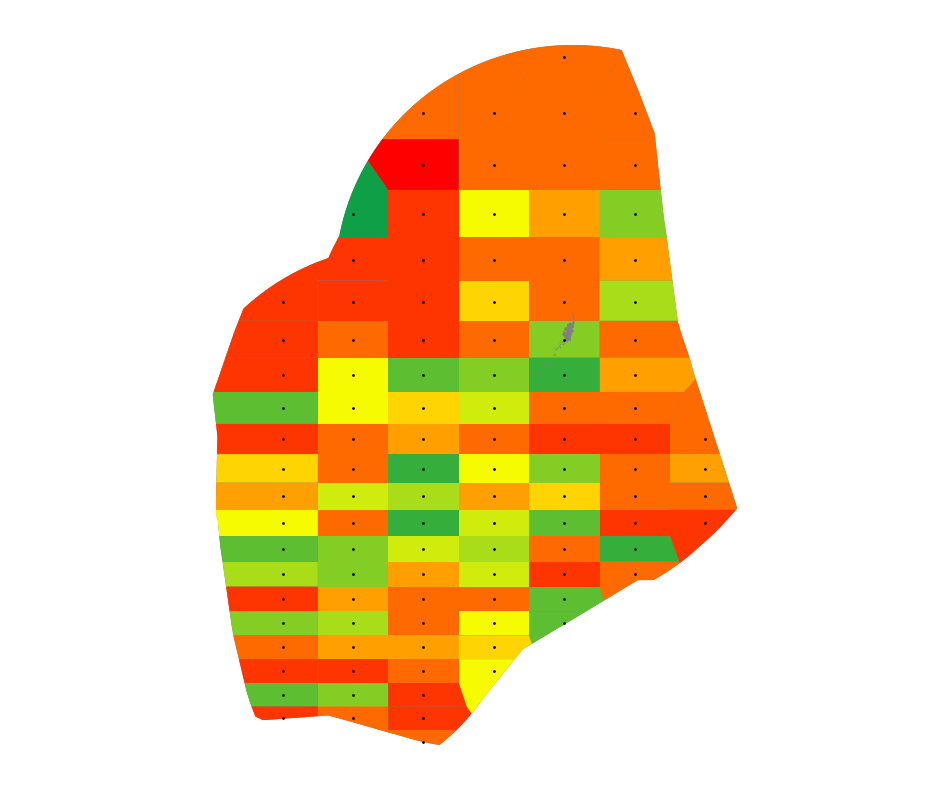

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2056_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


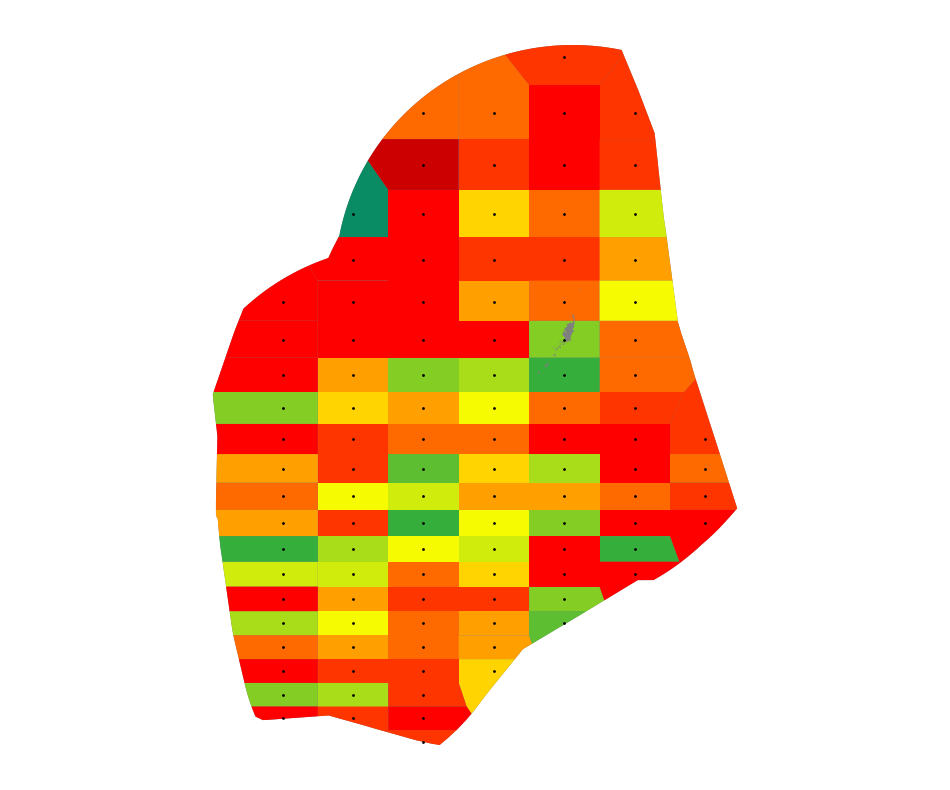

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2057_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


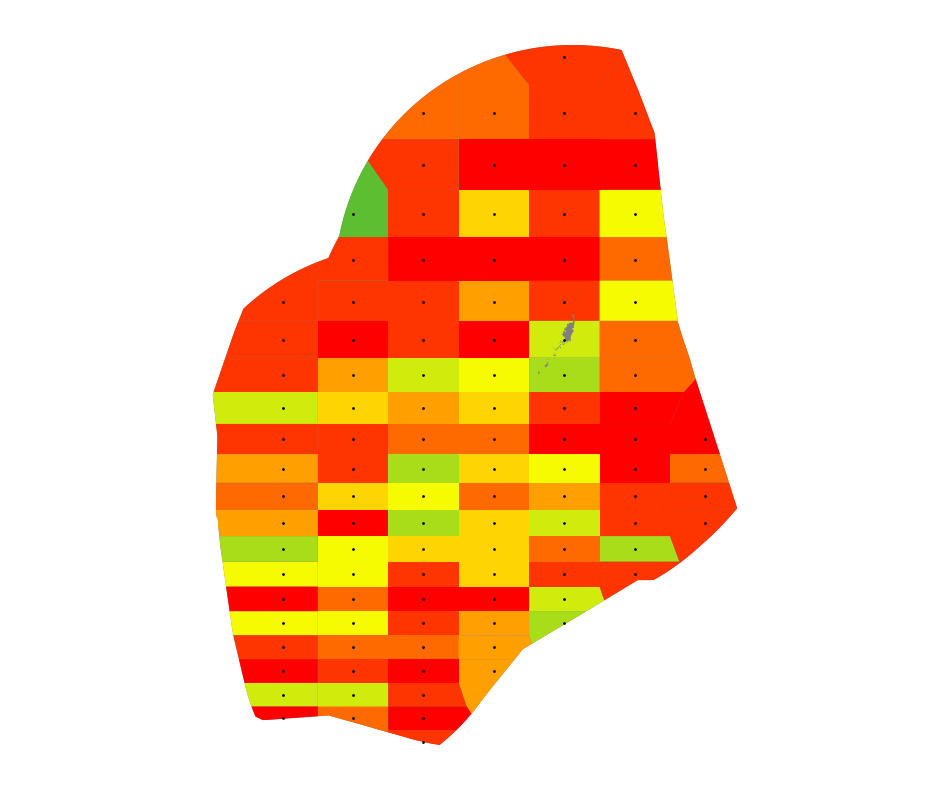

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2058_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


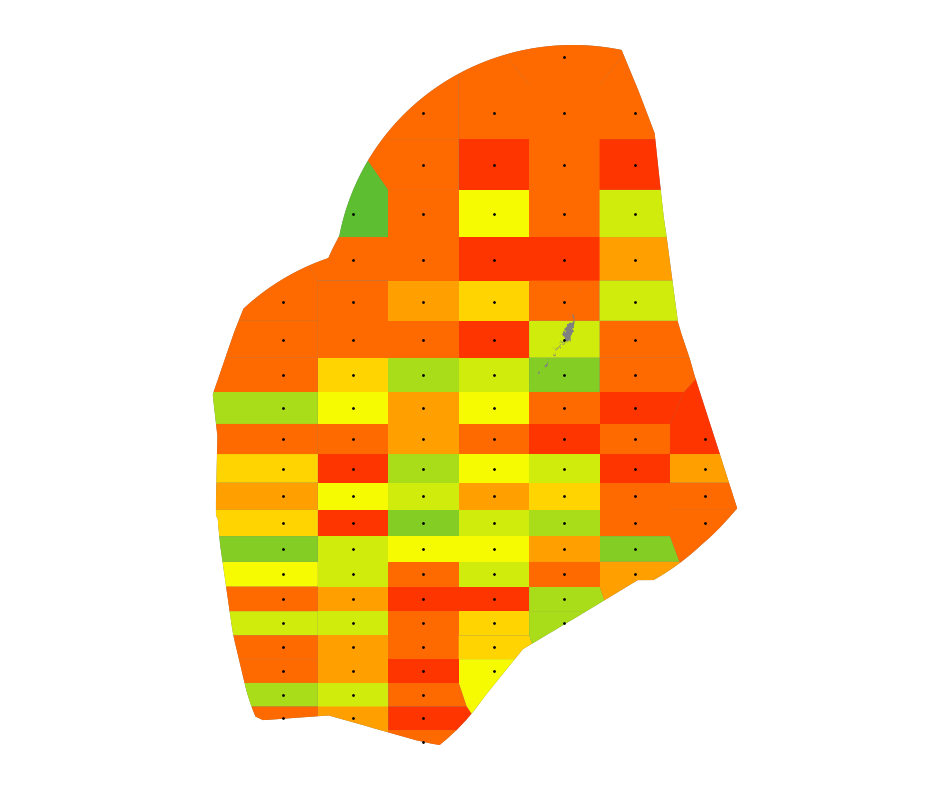

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2059_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


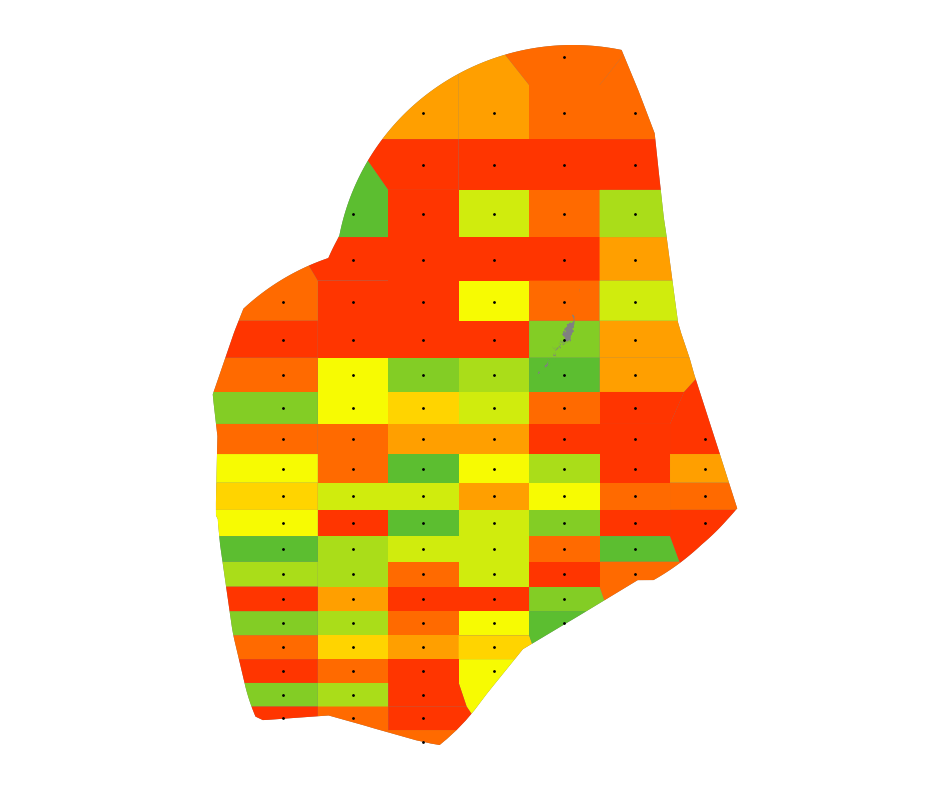

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2060_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


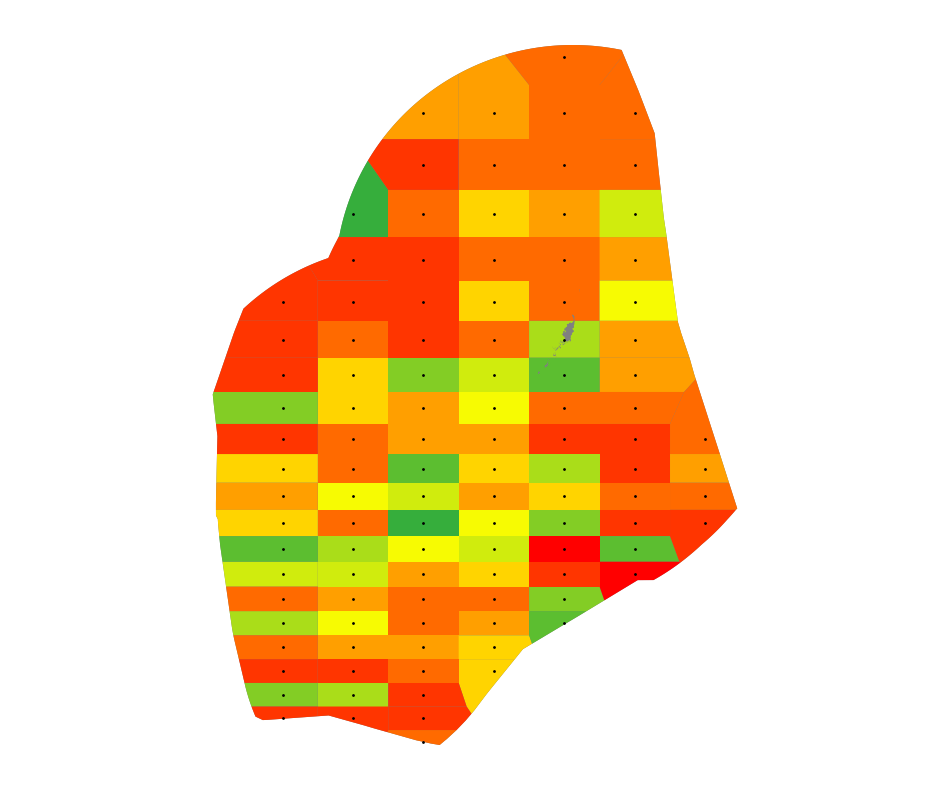

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2061_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


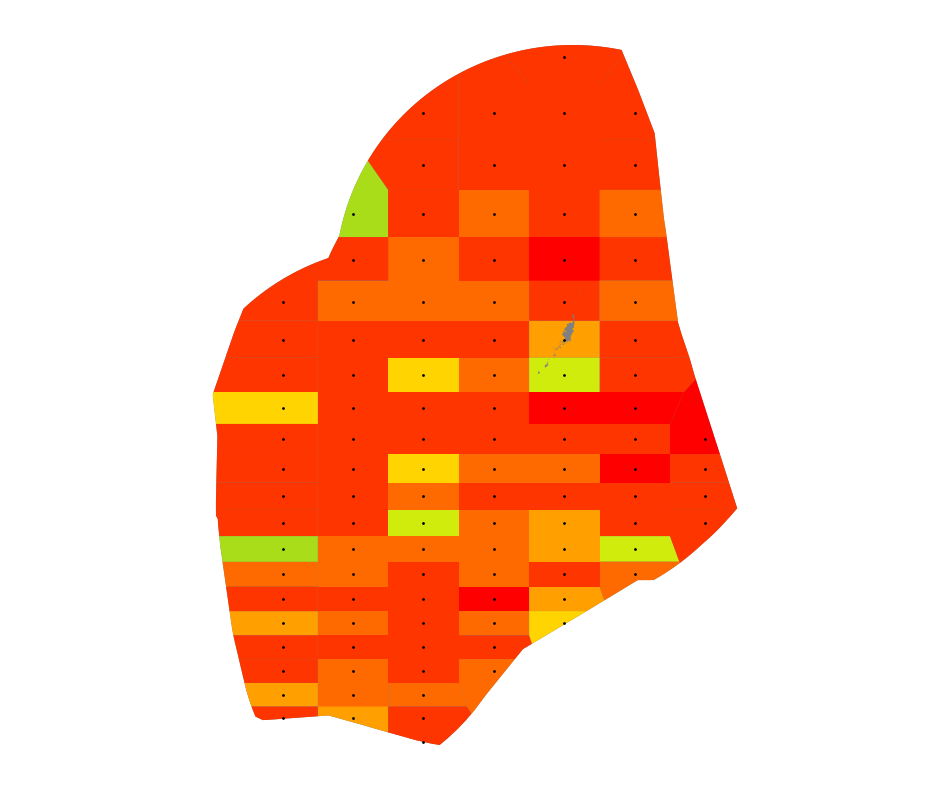

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2062_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


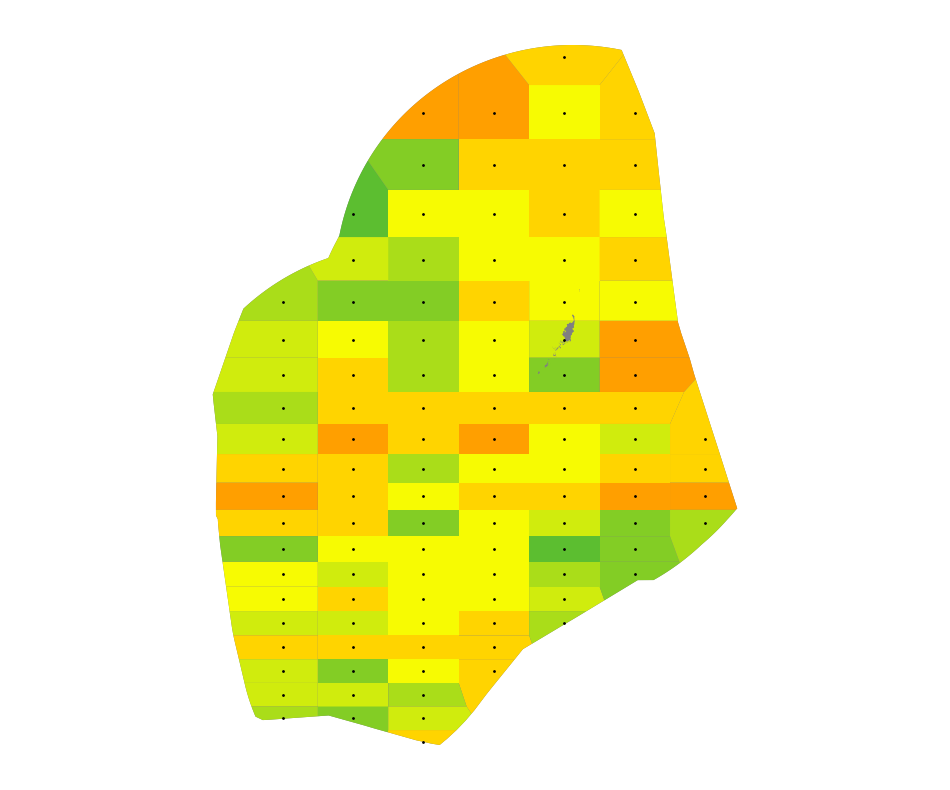

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2063_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


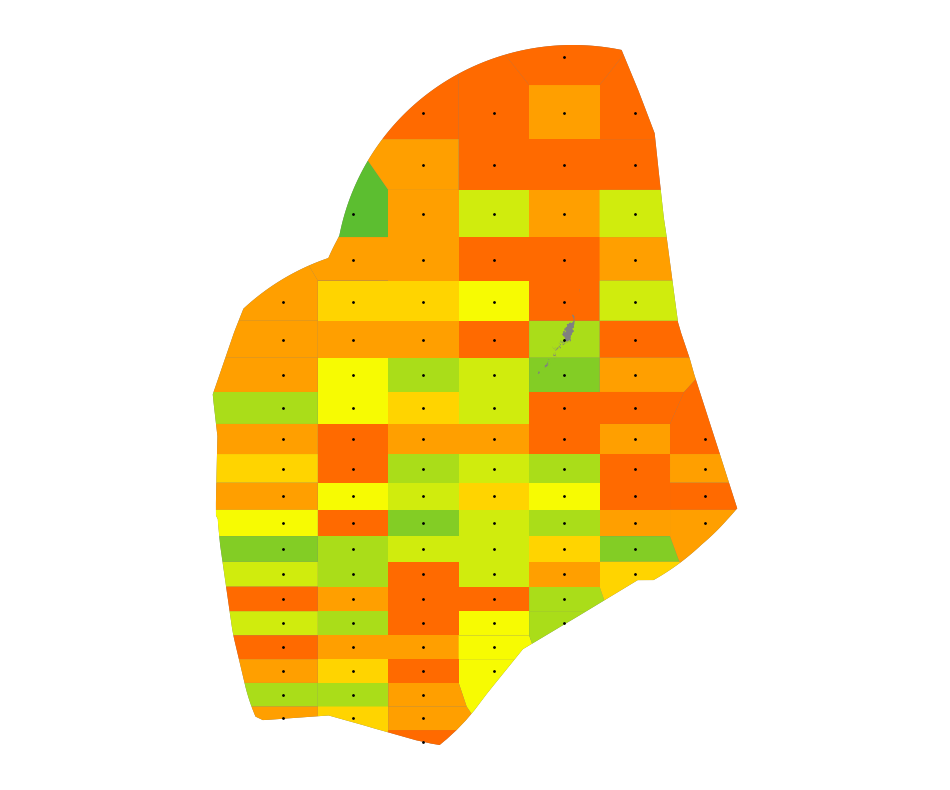

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2064_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


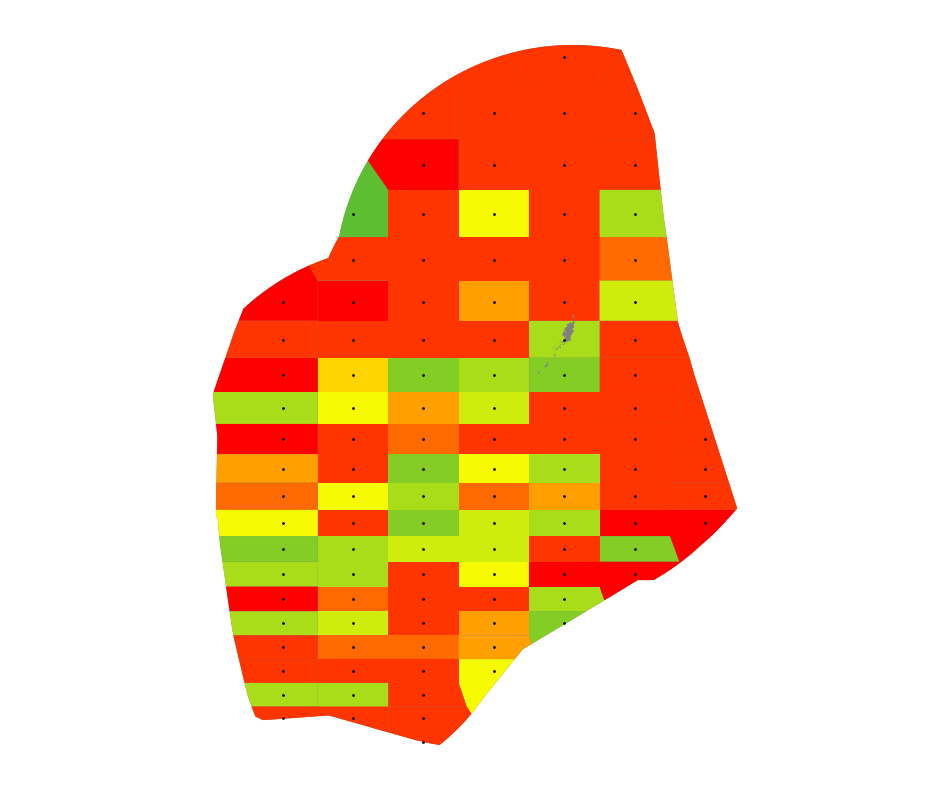

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2065_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


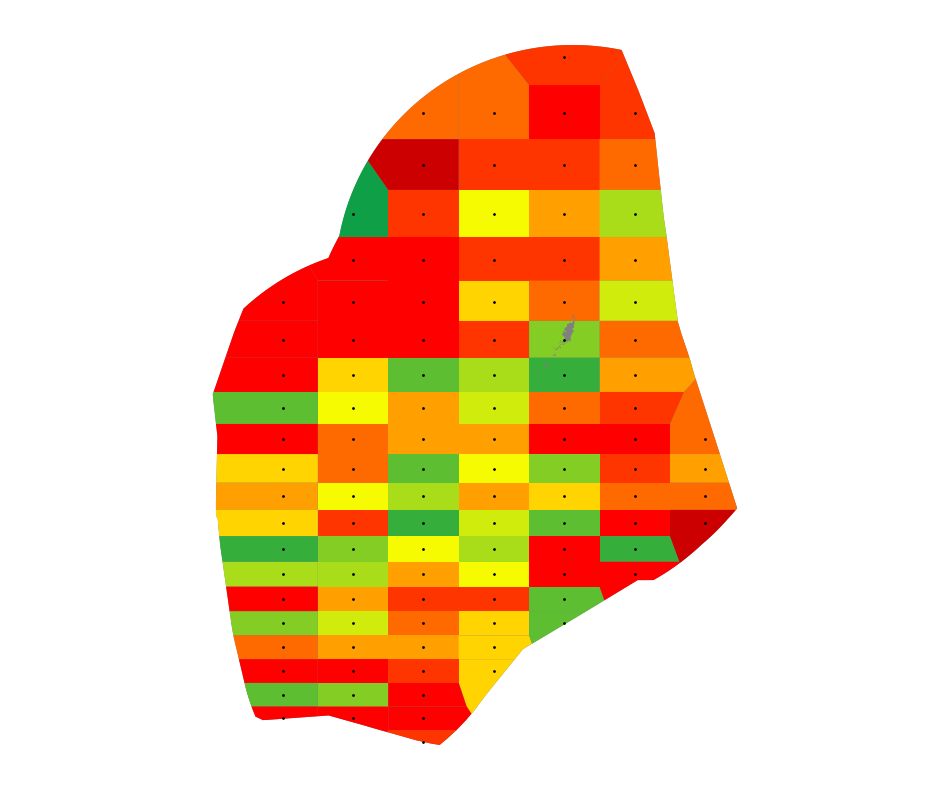

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2066_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


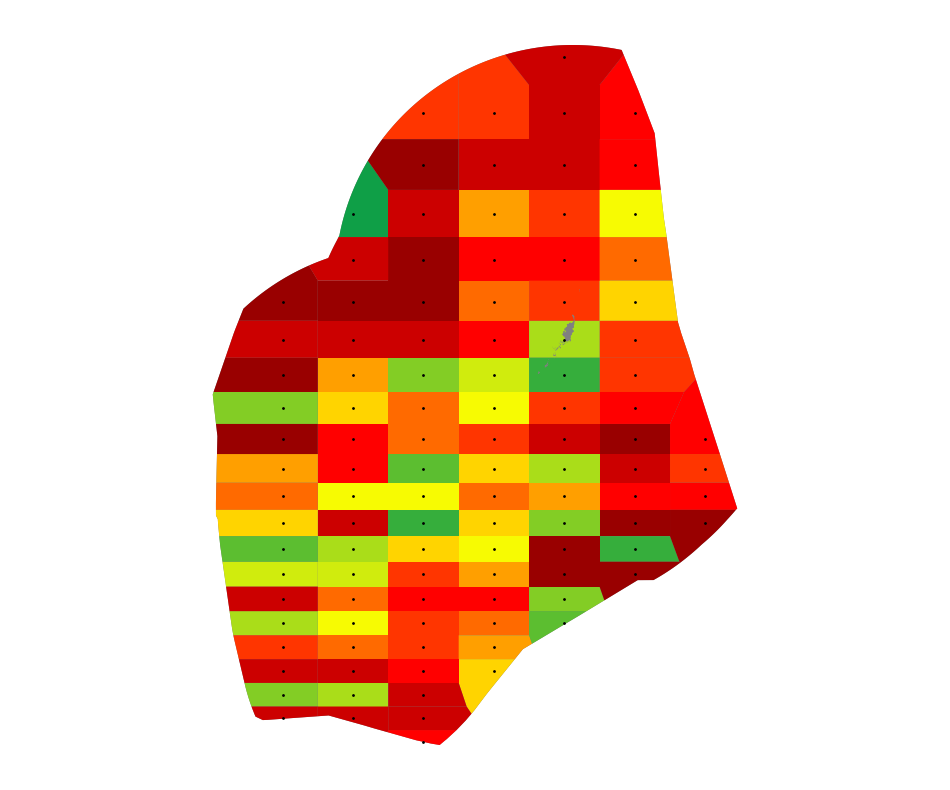

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2067_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


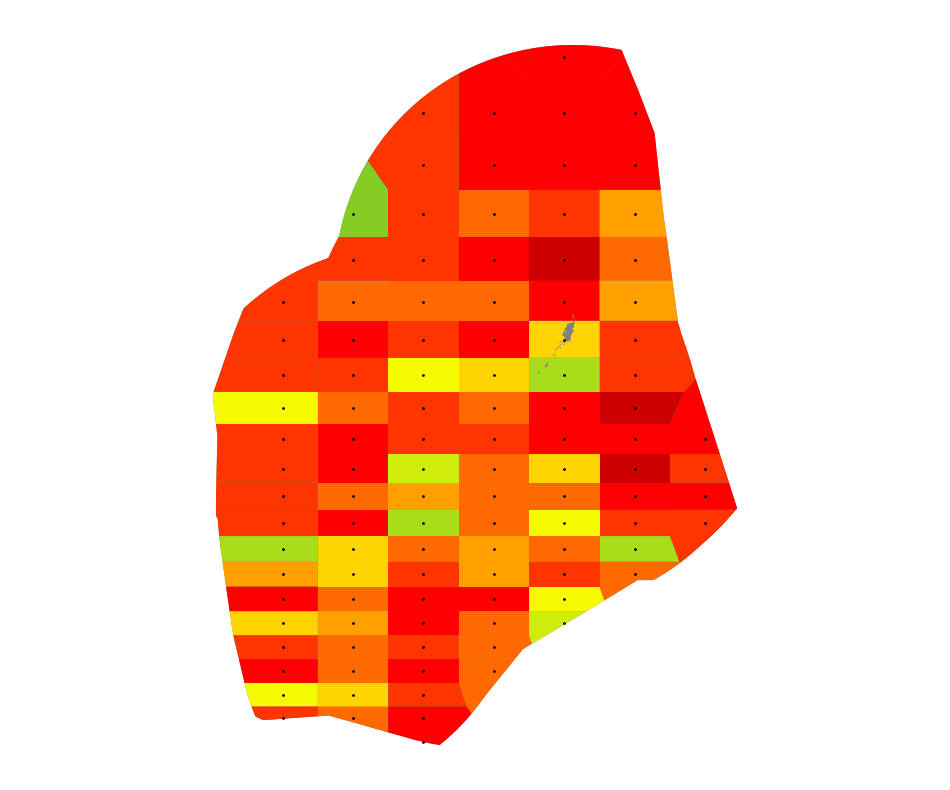

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2068_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


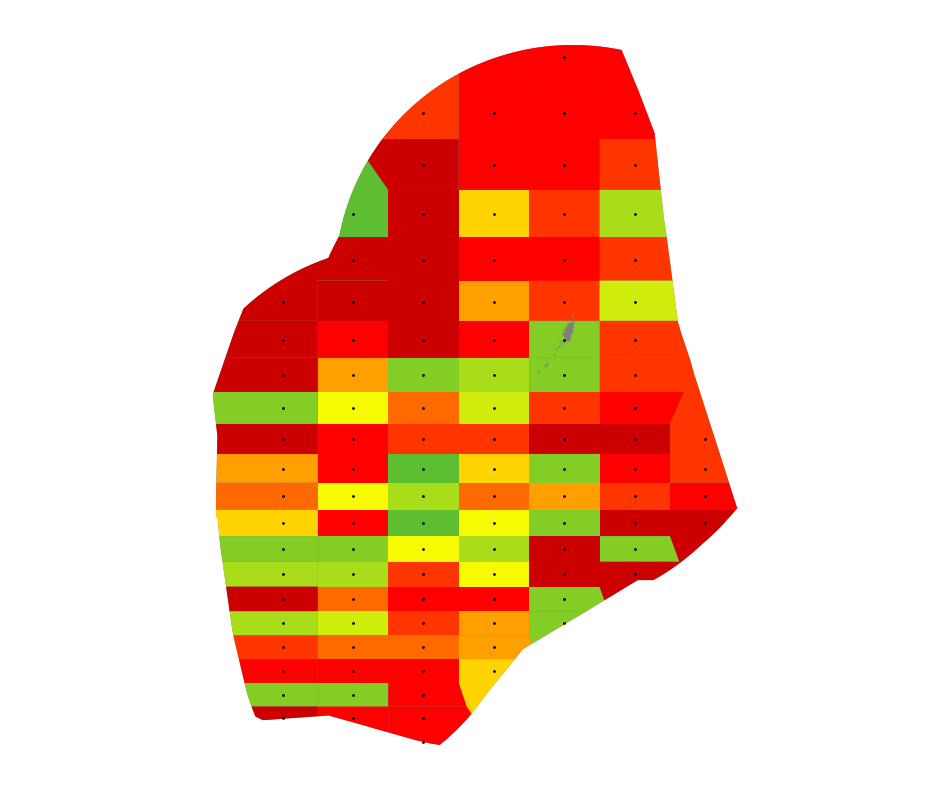

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2069_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


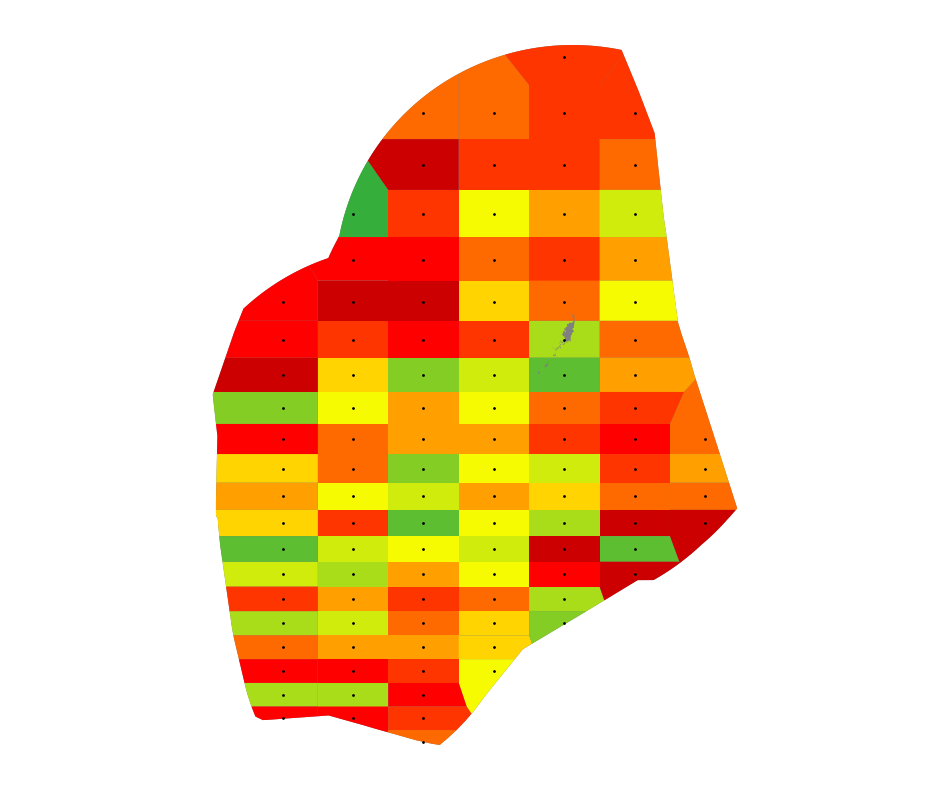

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2070_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


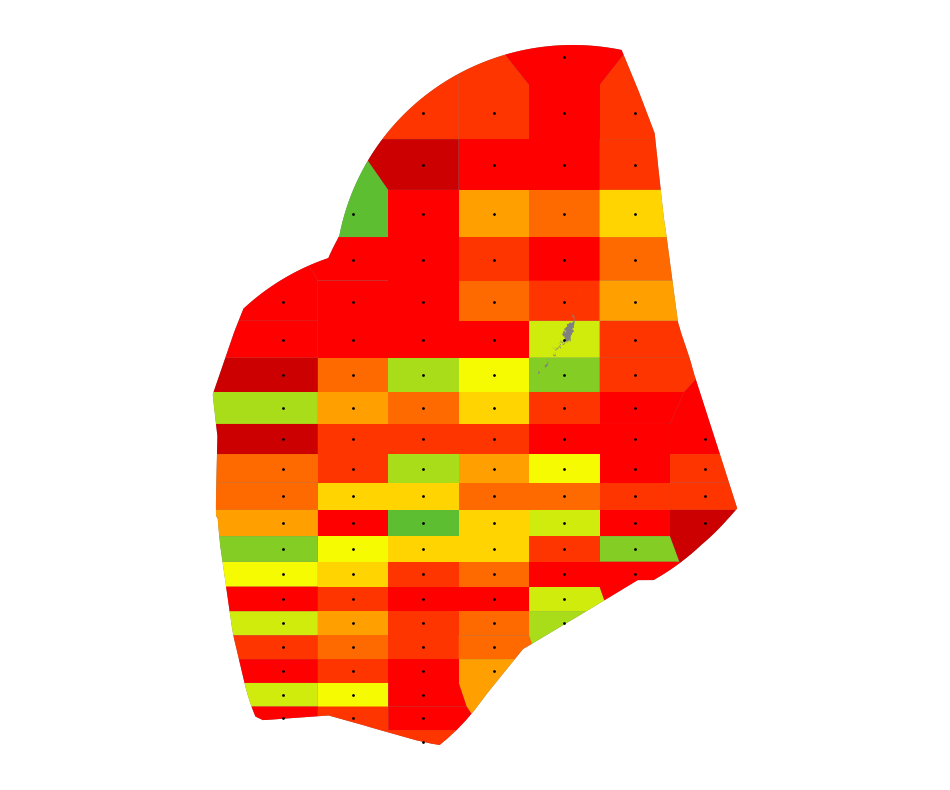

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2071_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


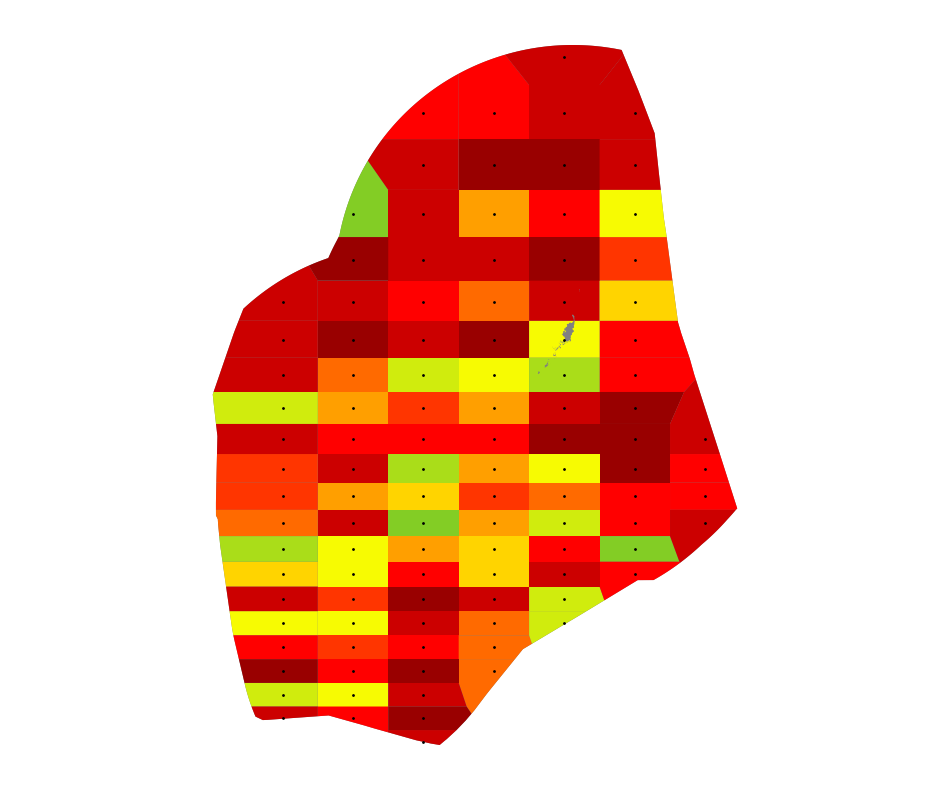

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2072_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


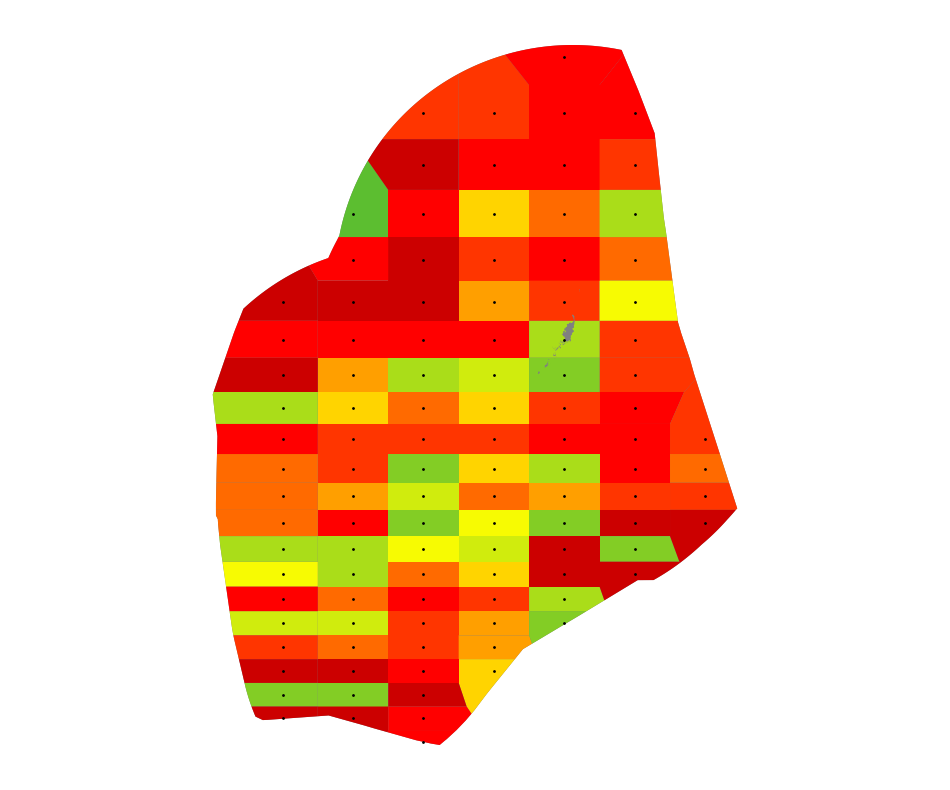

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2073_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


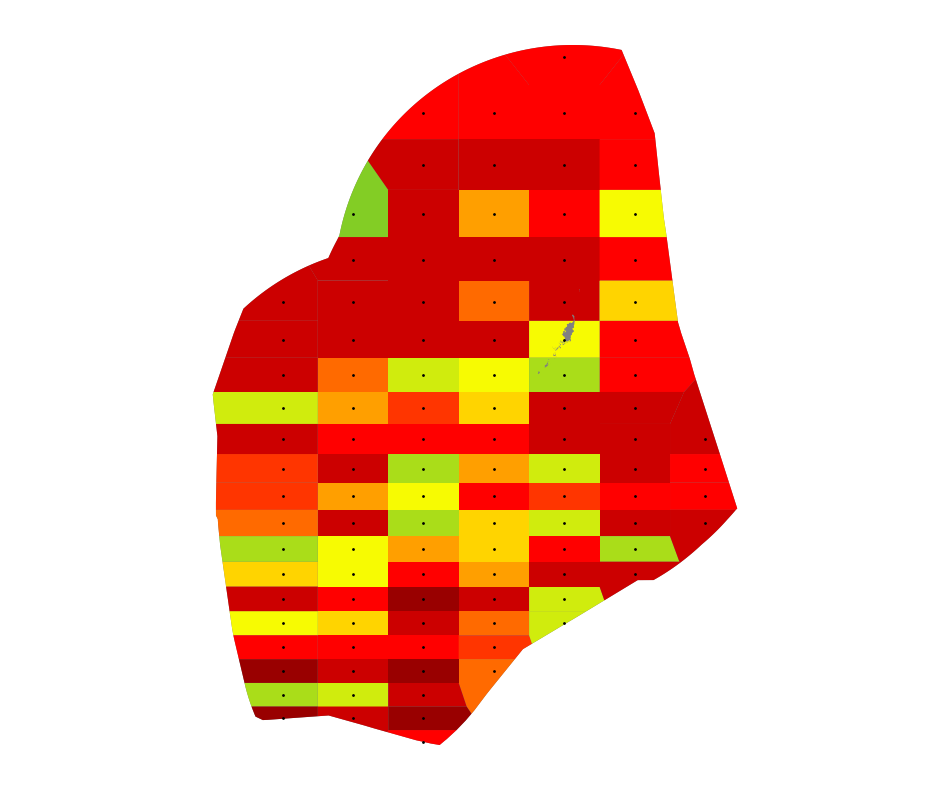

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2074_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


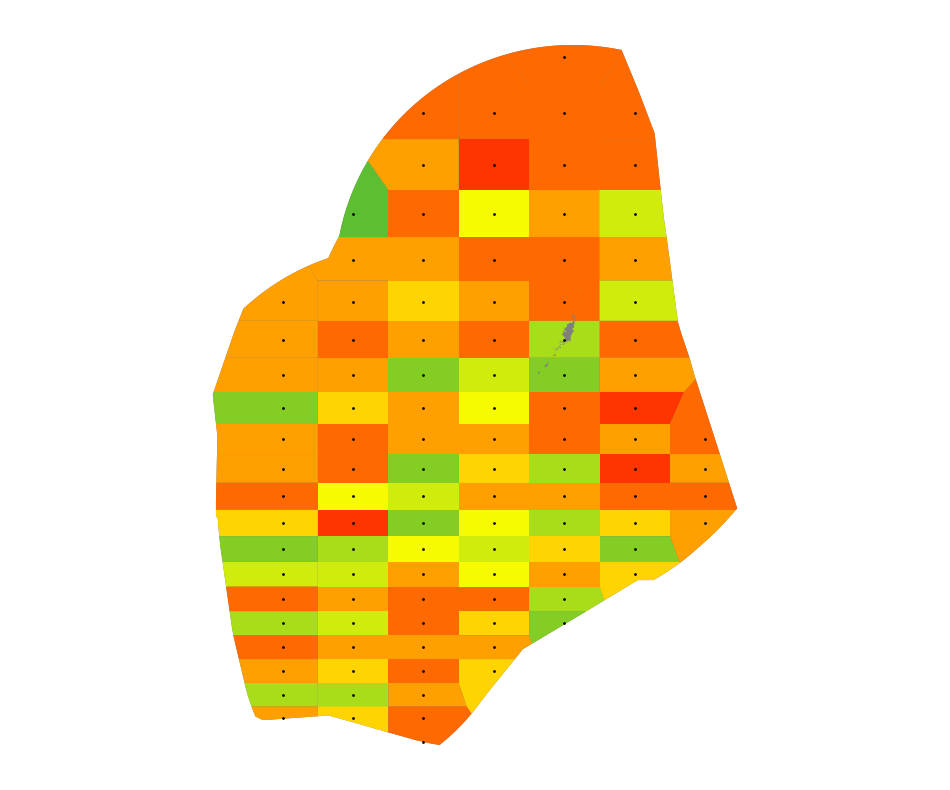

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2075_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


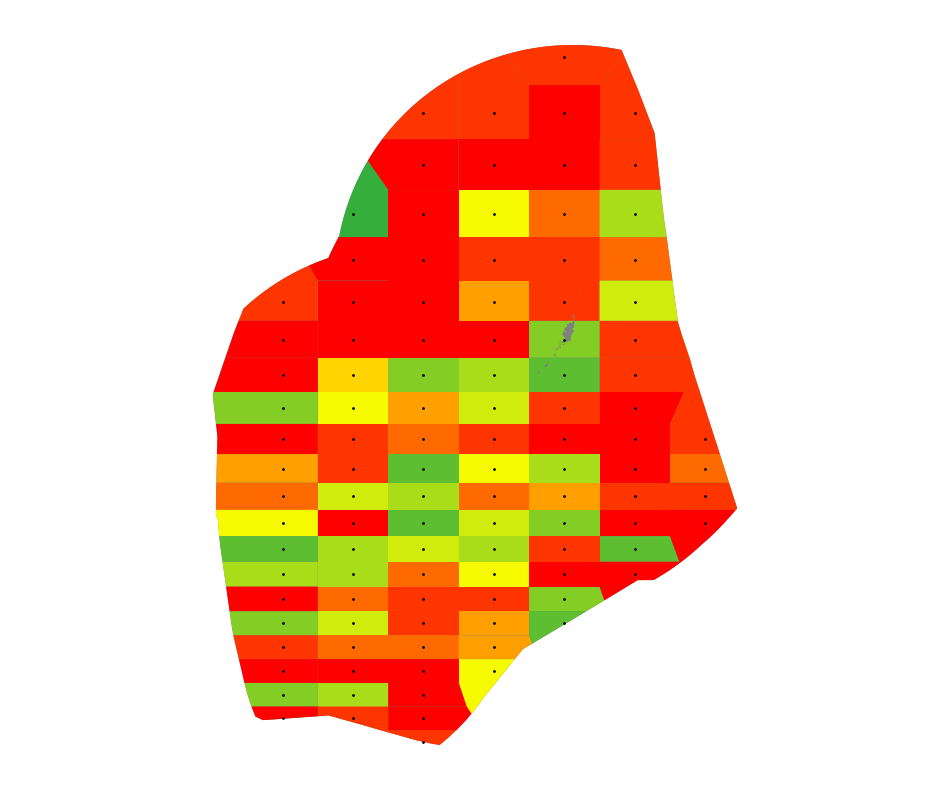

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2076_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


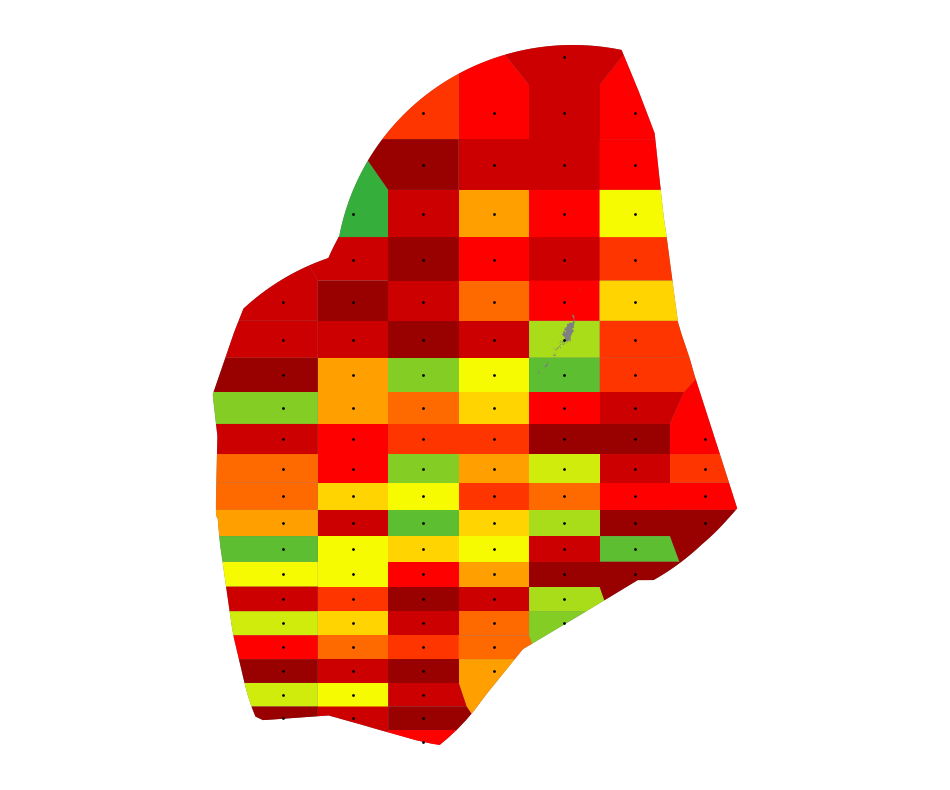

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2077_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


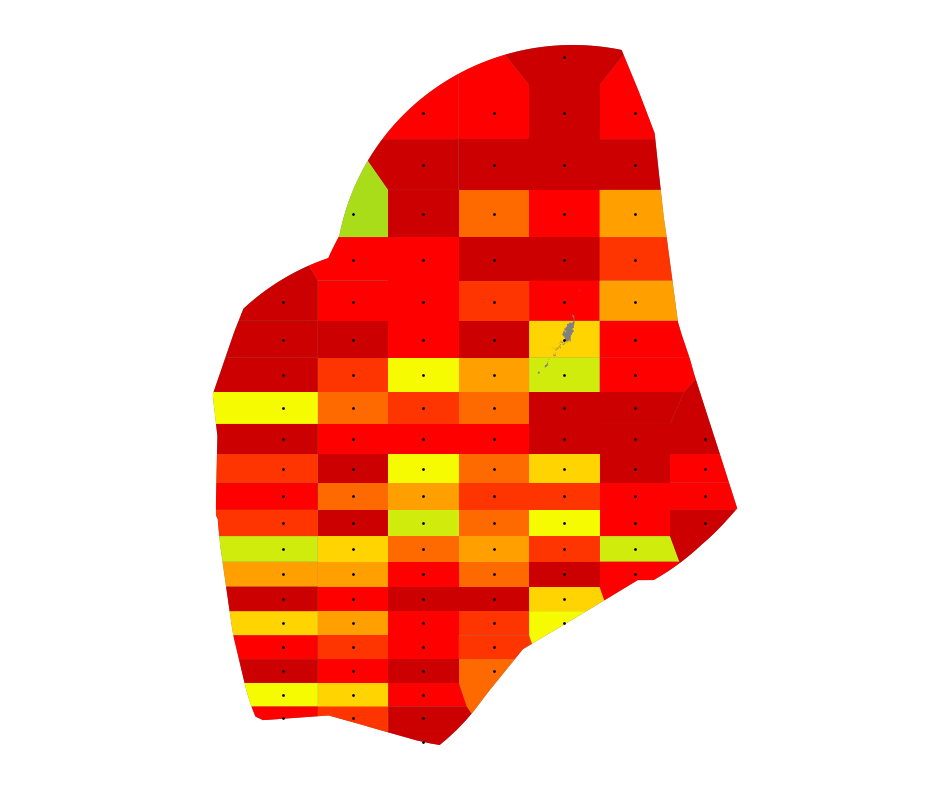

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2078_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


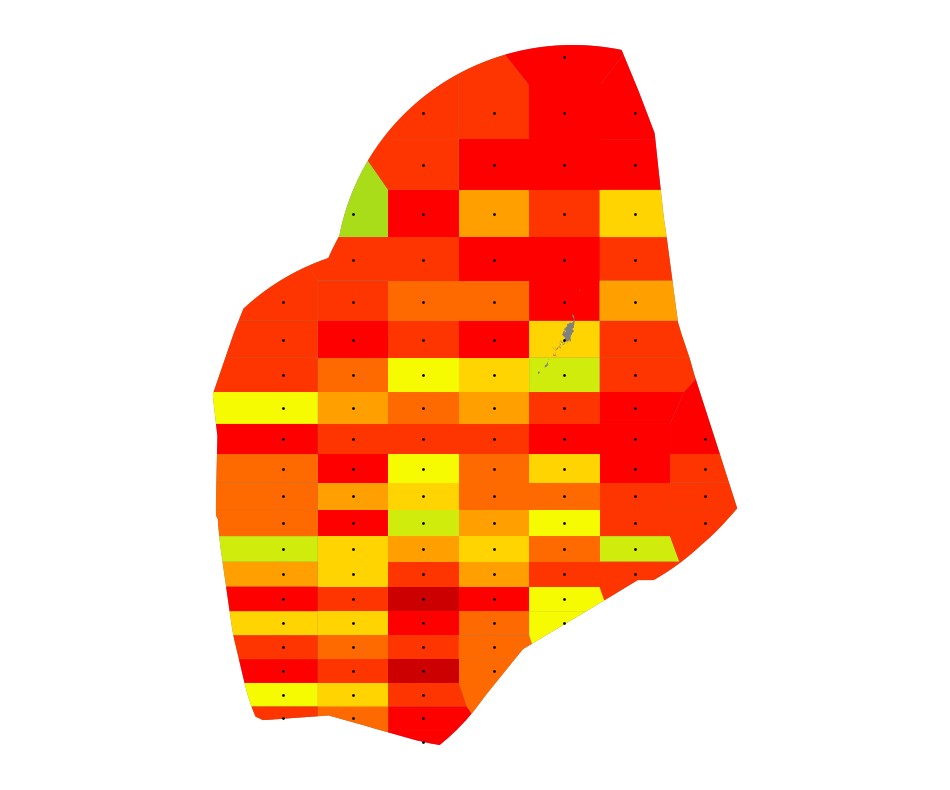

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2079_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


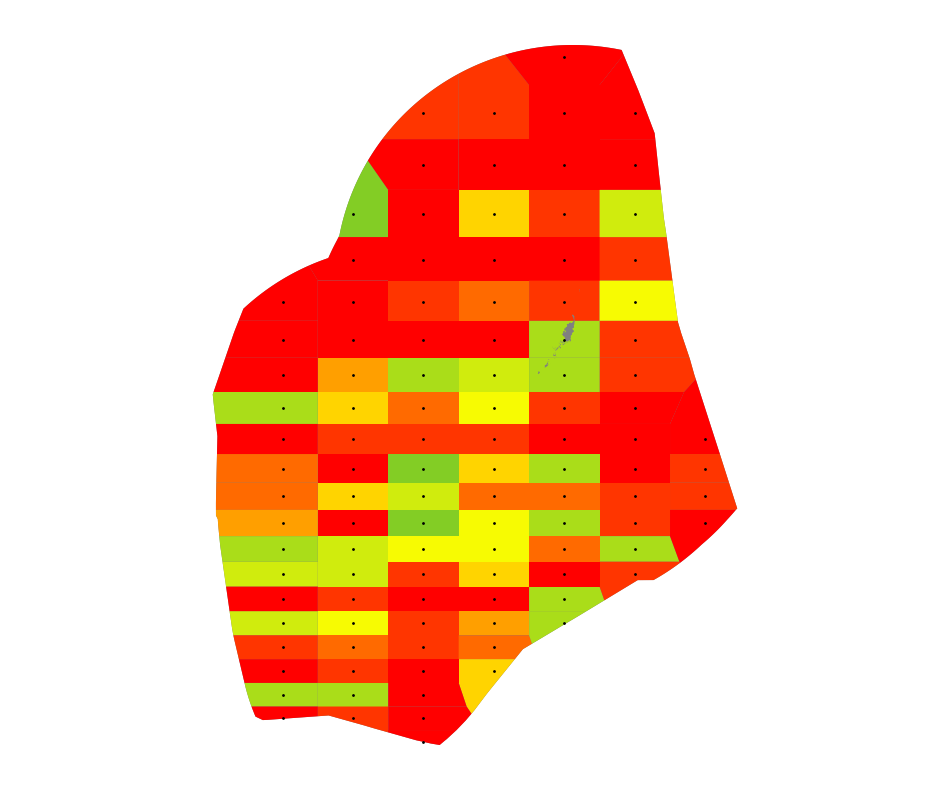

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2080_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


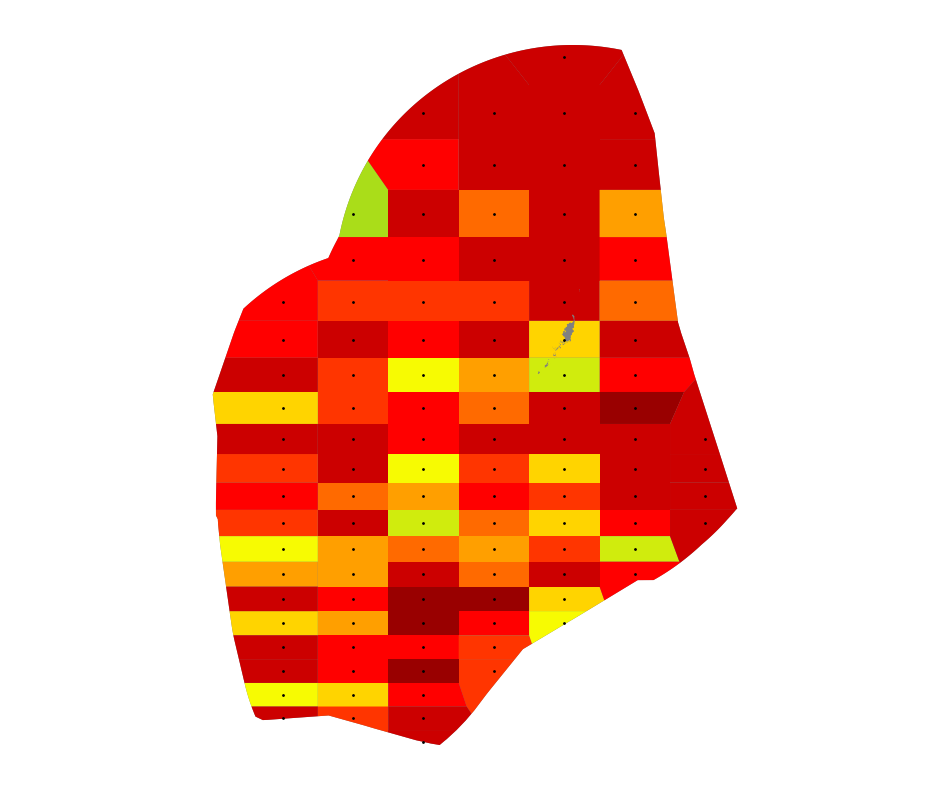

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2081_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


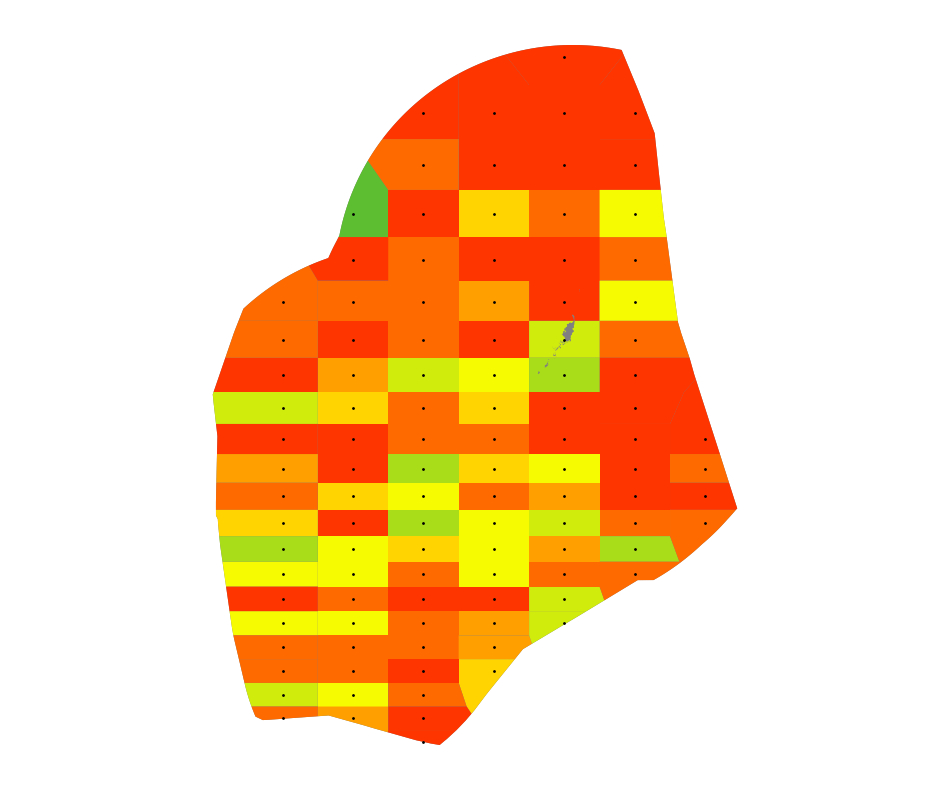

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2082_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


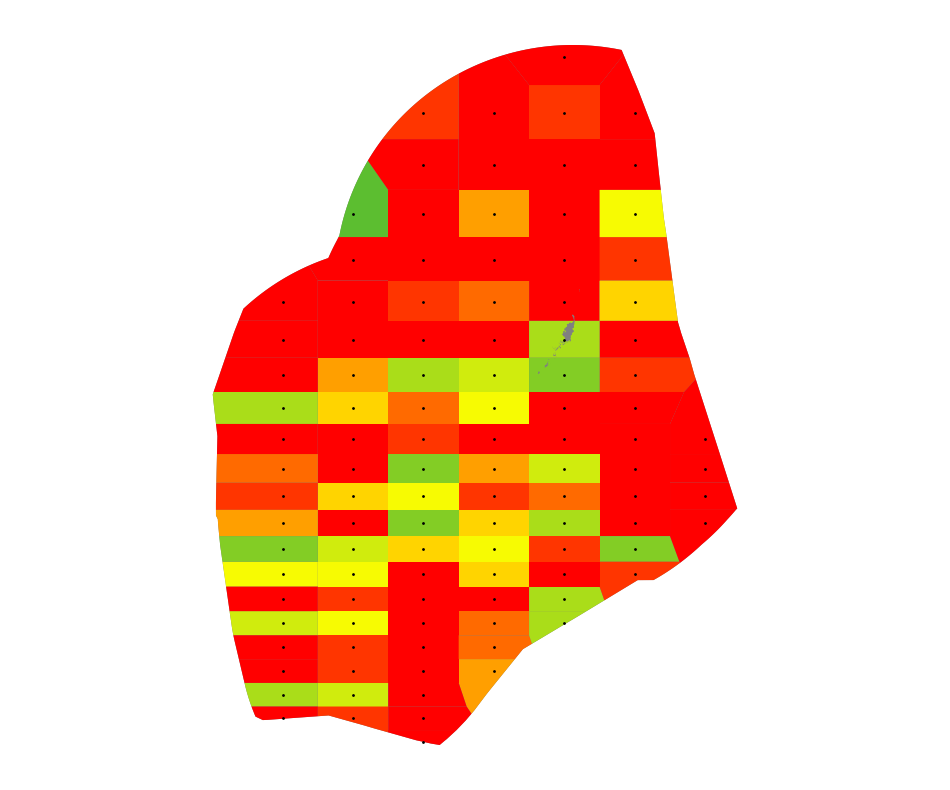

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2083_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


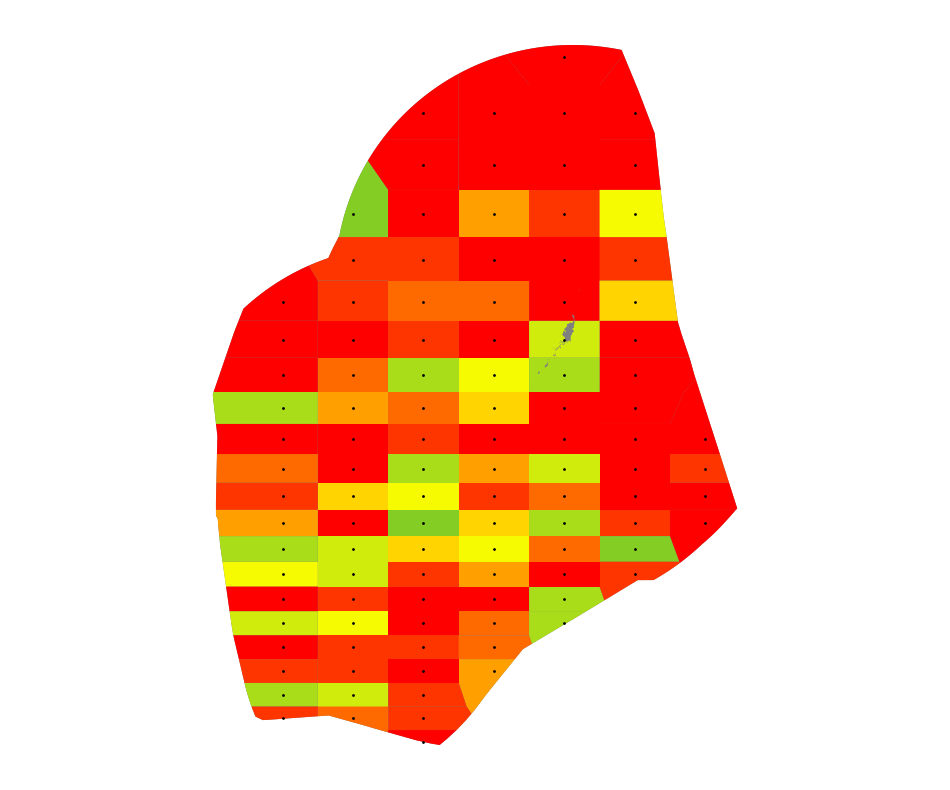

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2084_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


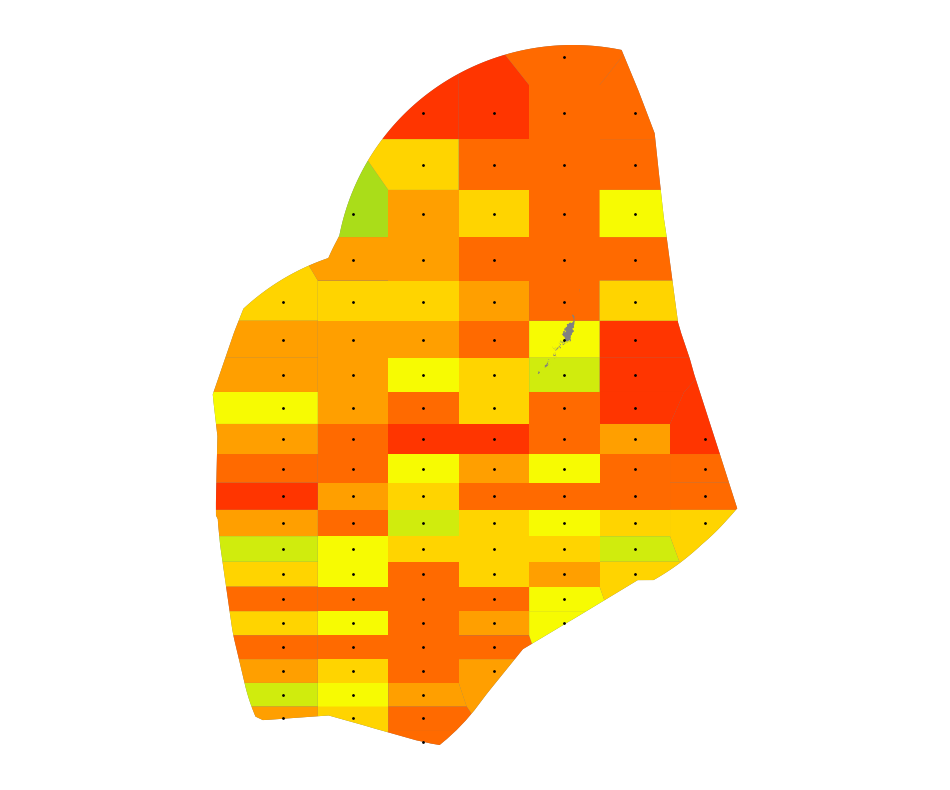

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2085_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


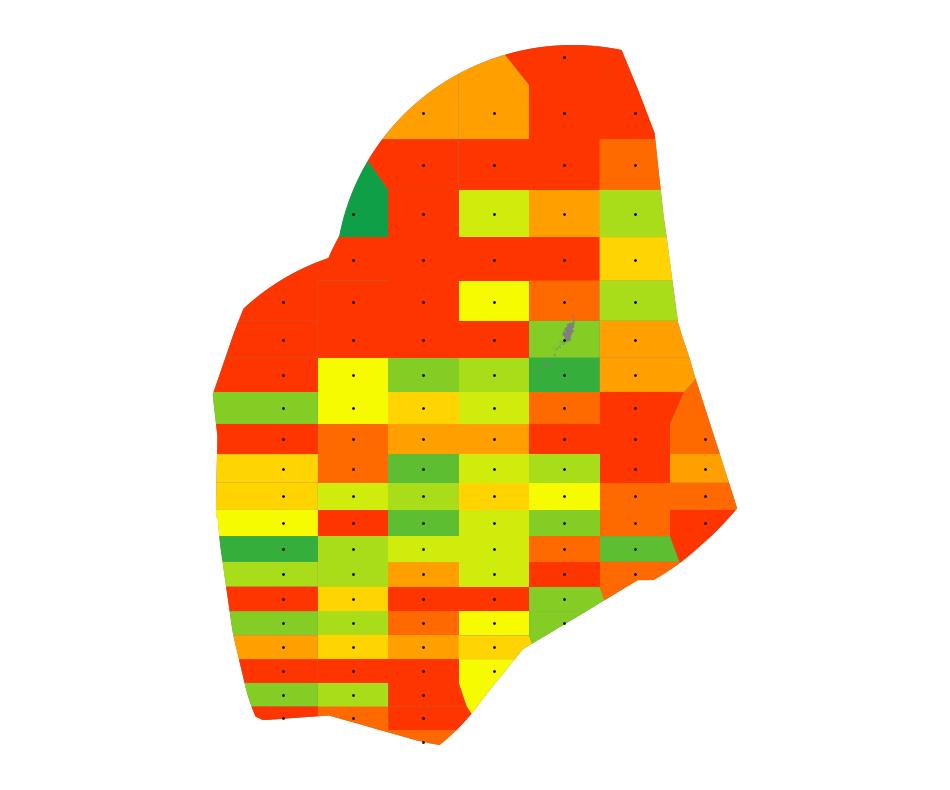

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2086_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


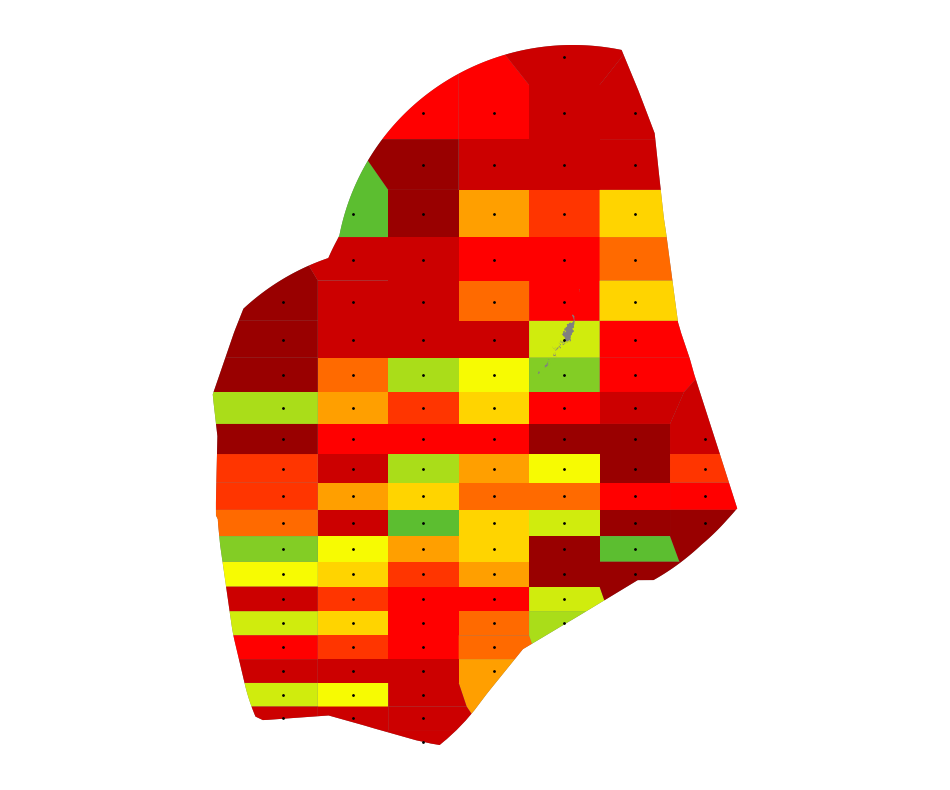

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2087_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


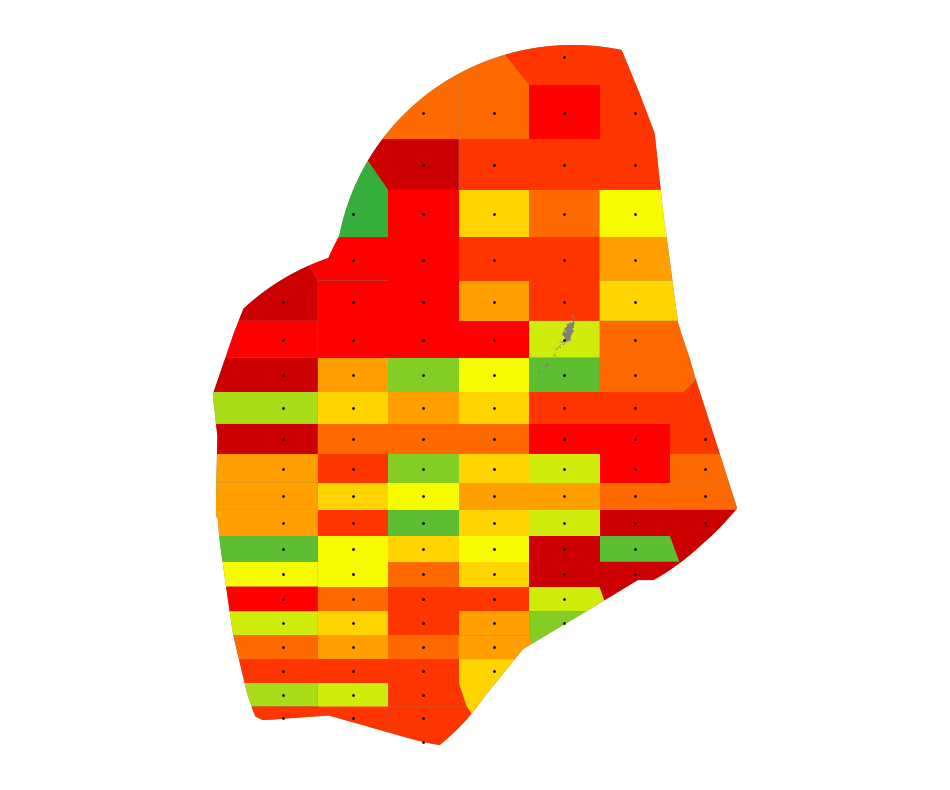

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2088_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


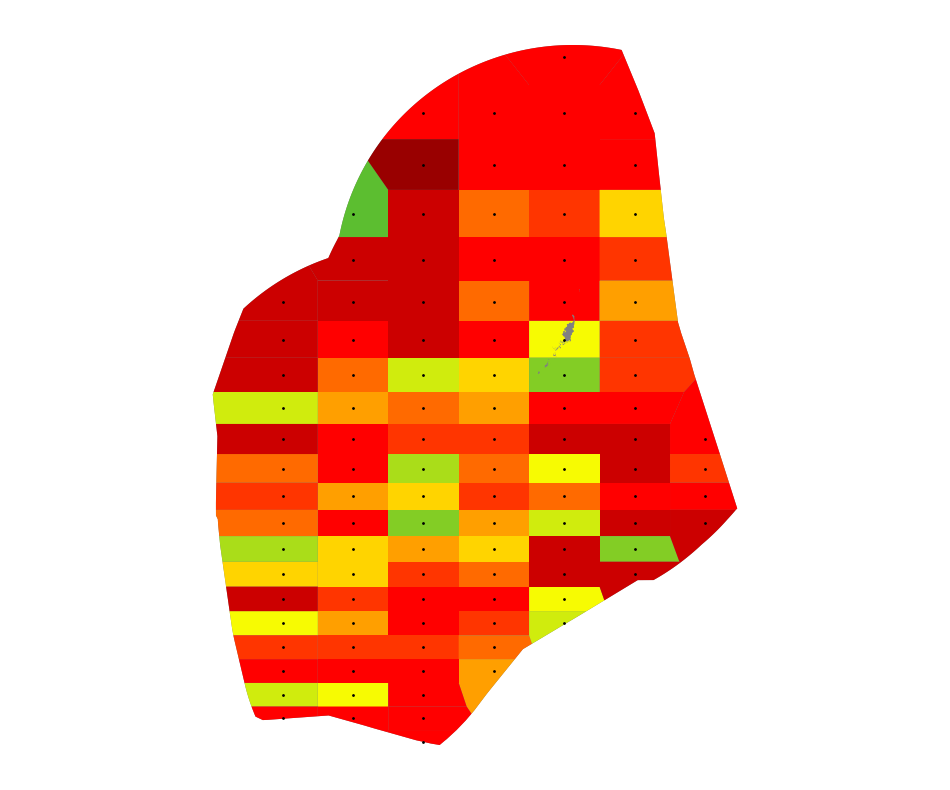

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2089_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


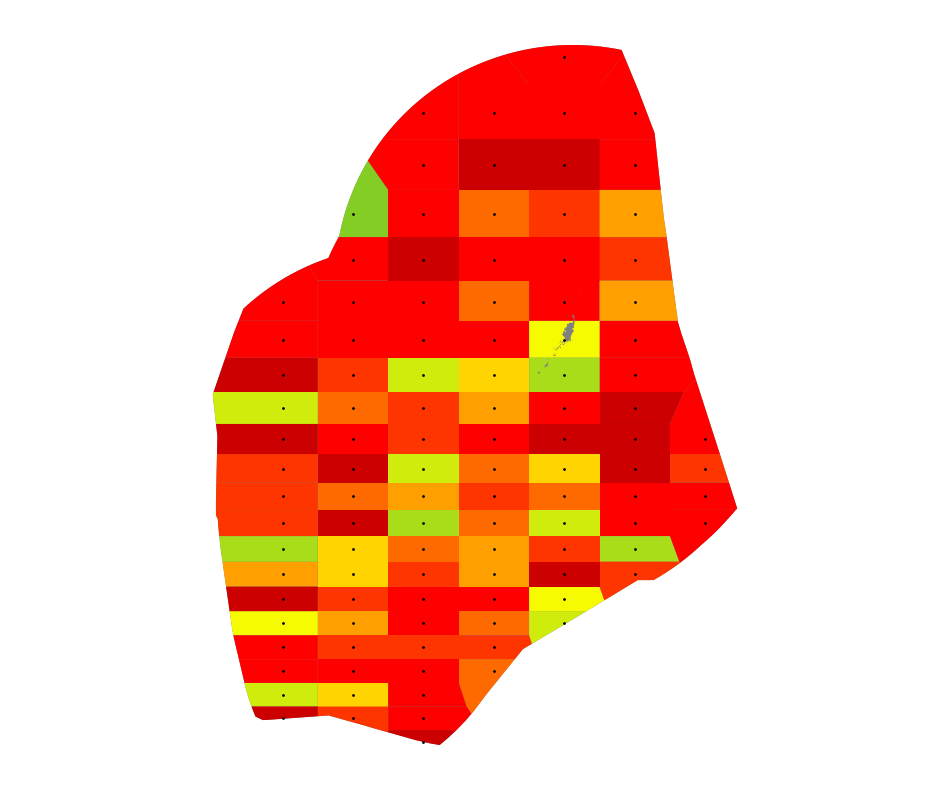

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2090_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


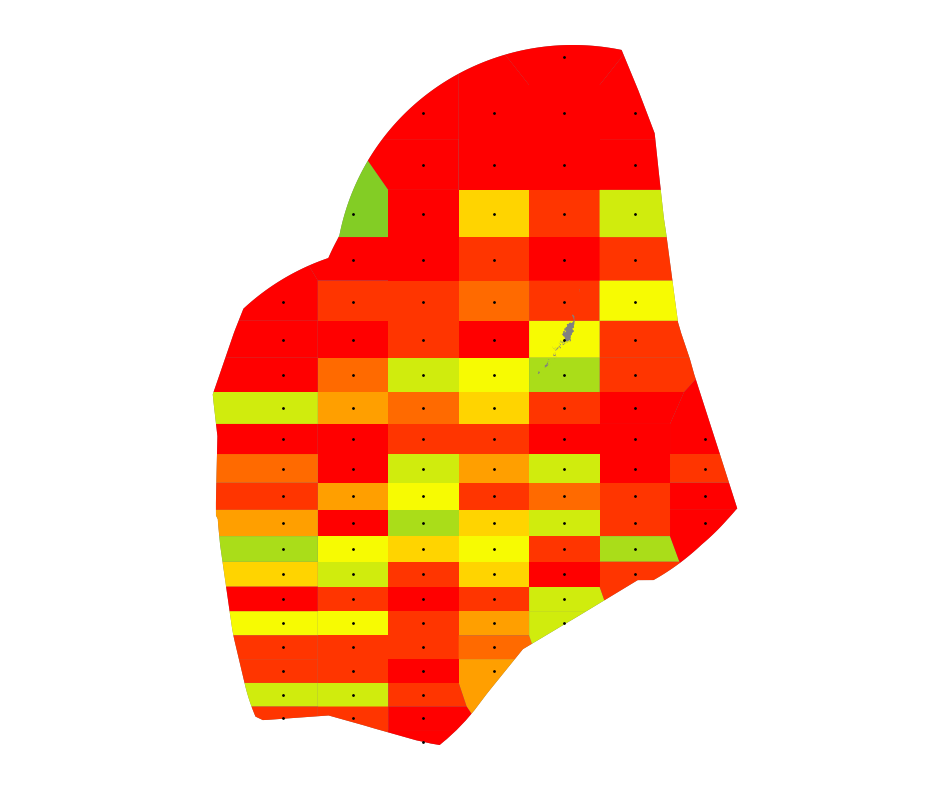

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2091_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


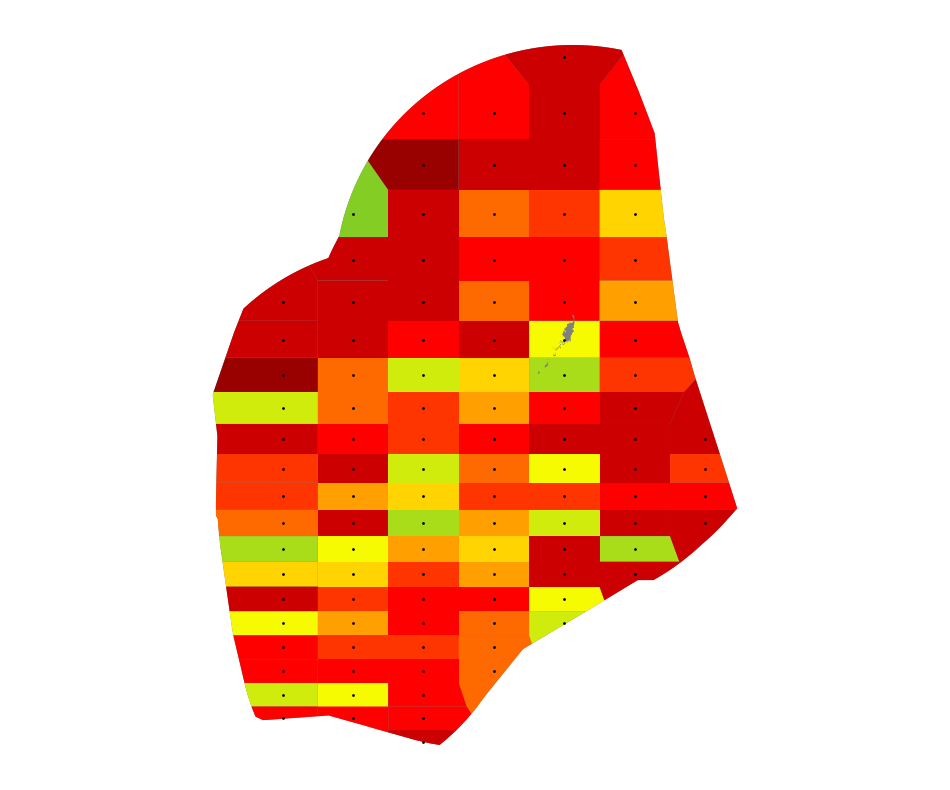

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2092_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


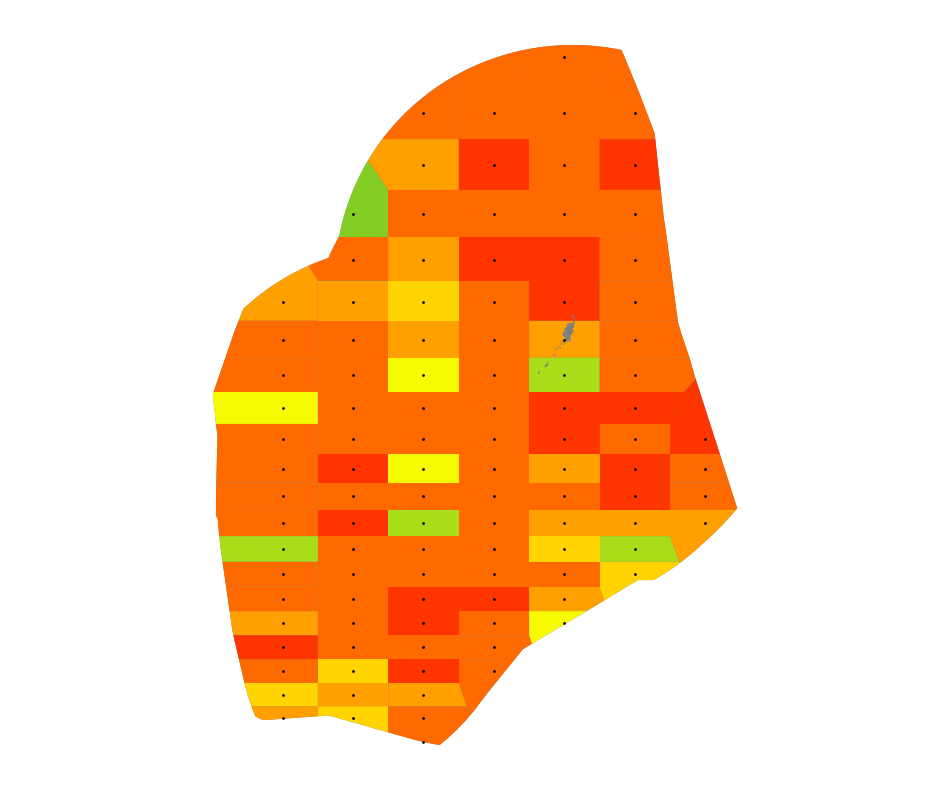

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2093_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


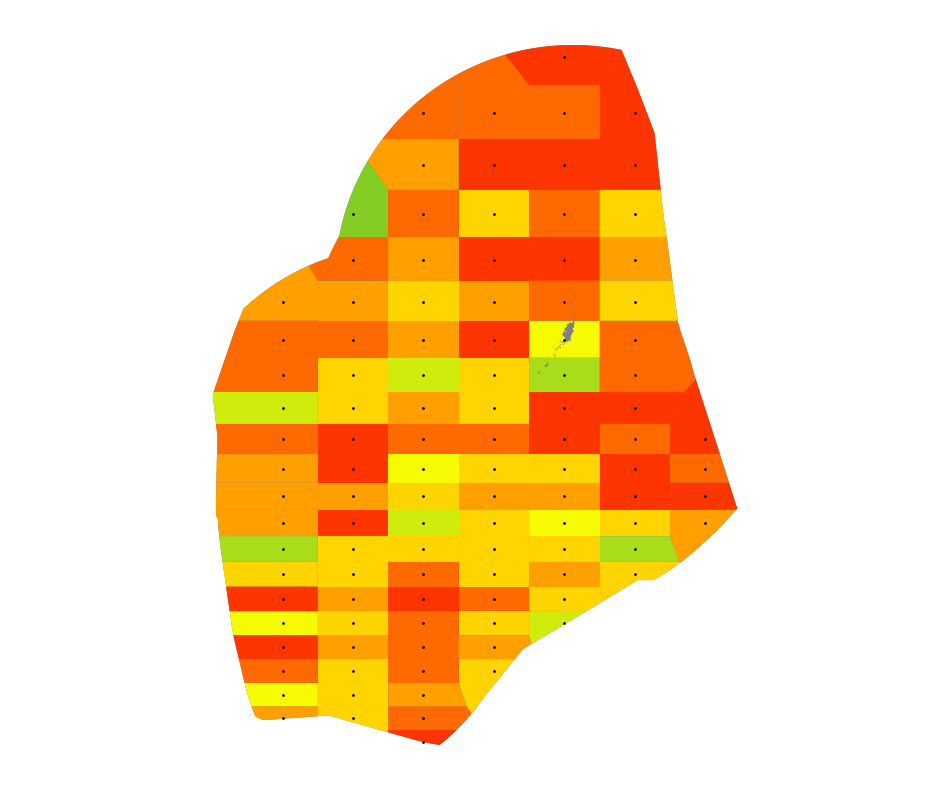

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2094_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


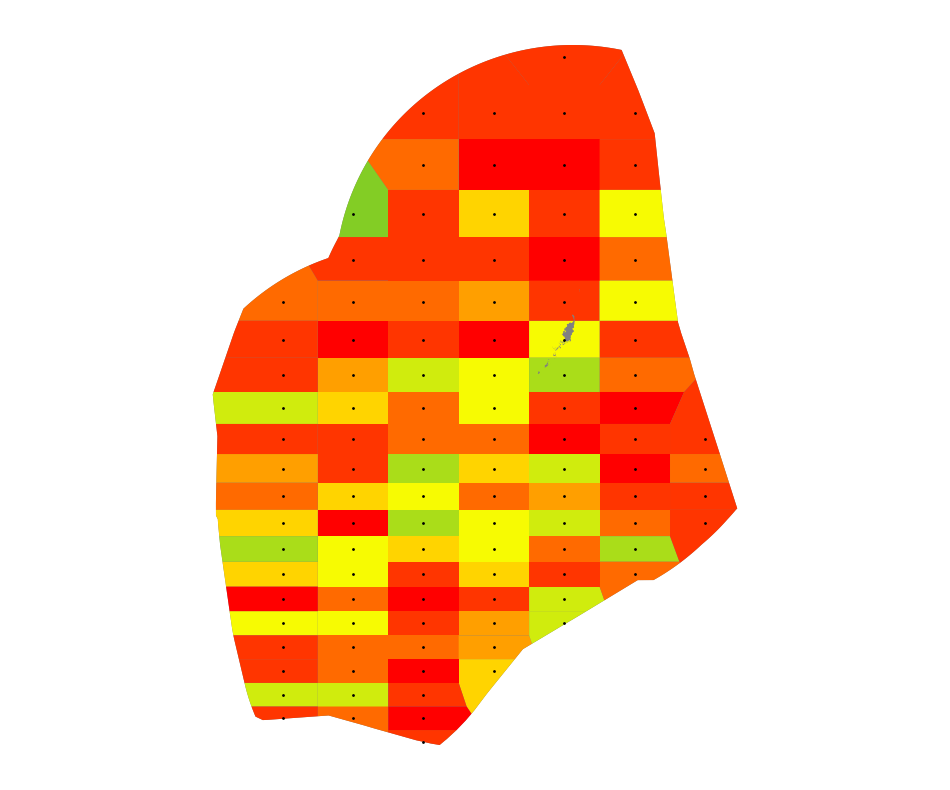

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2095_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


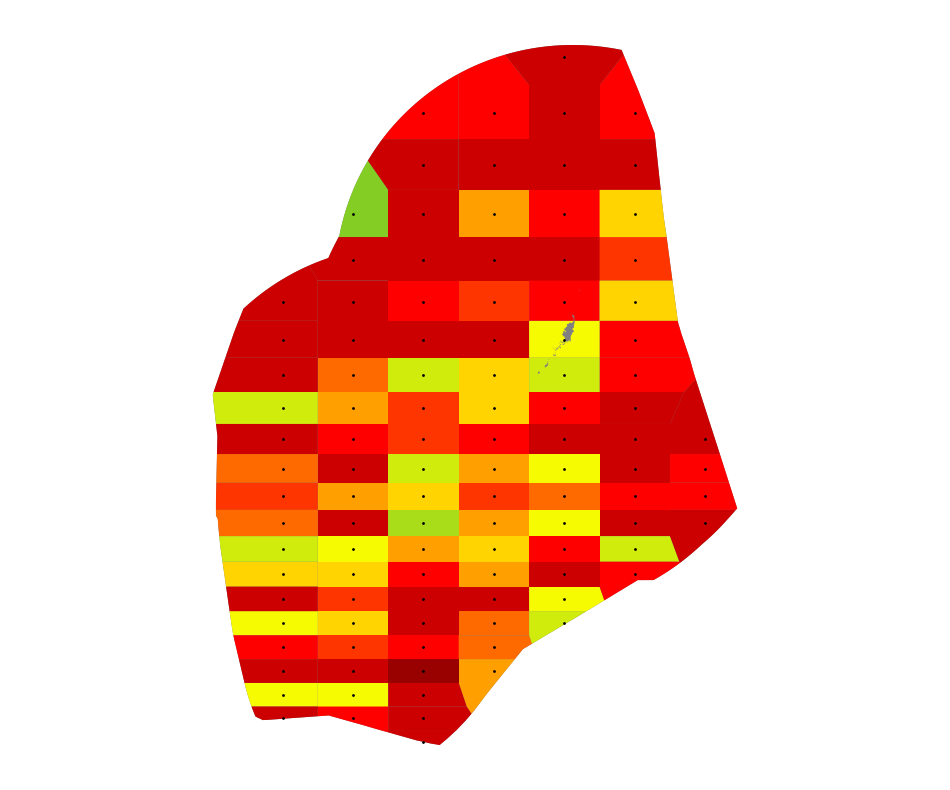

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2096_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


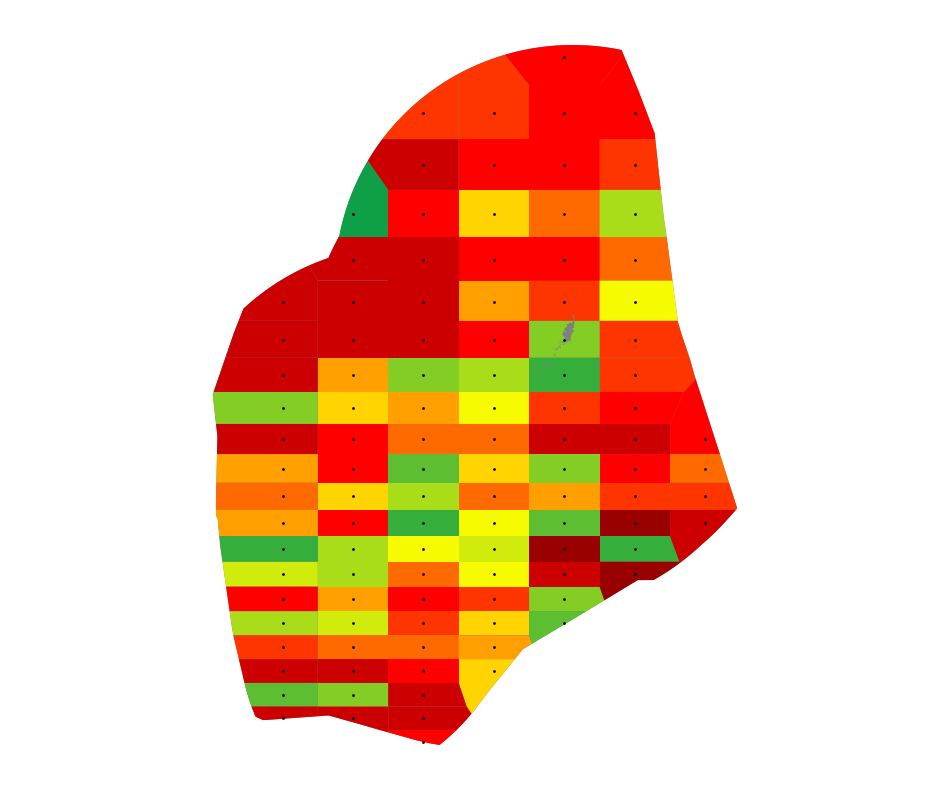

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2097_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


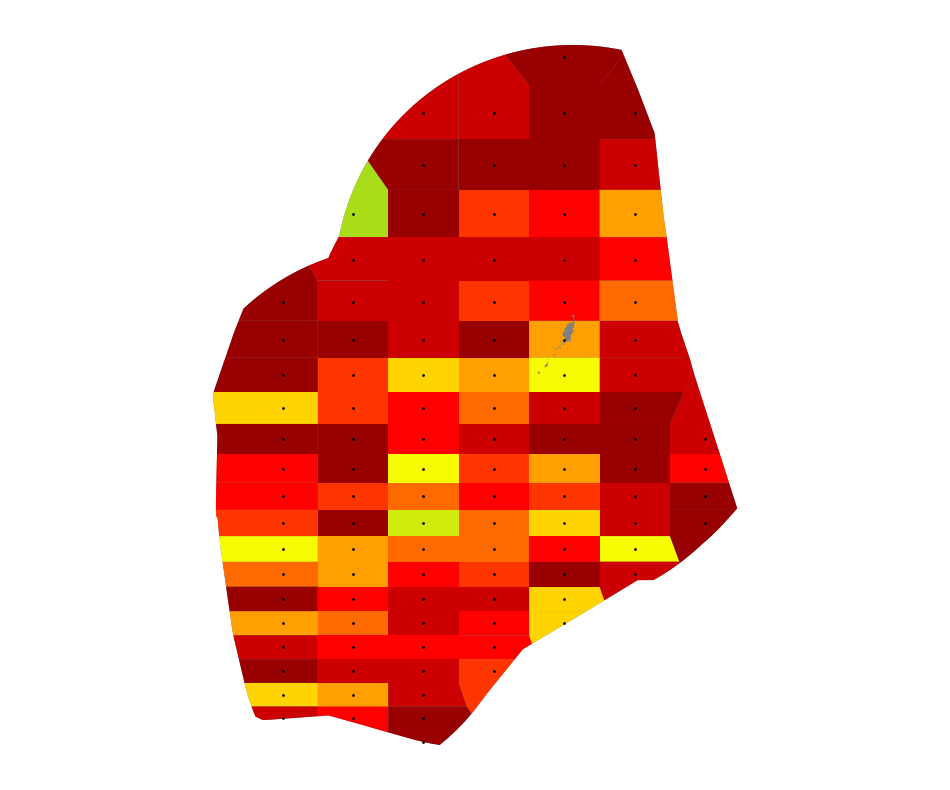

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2098_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


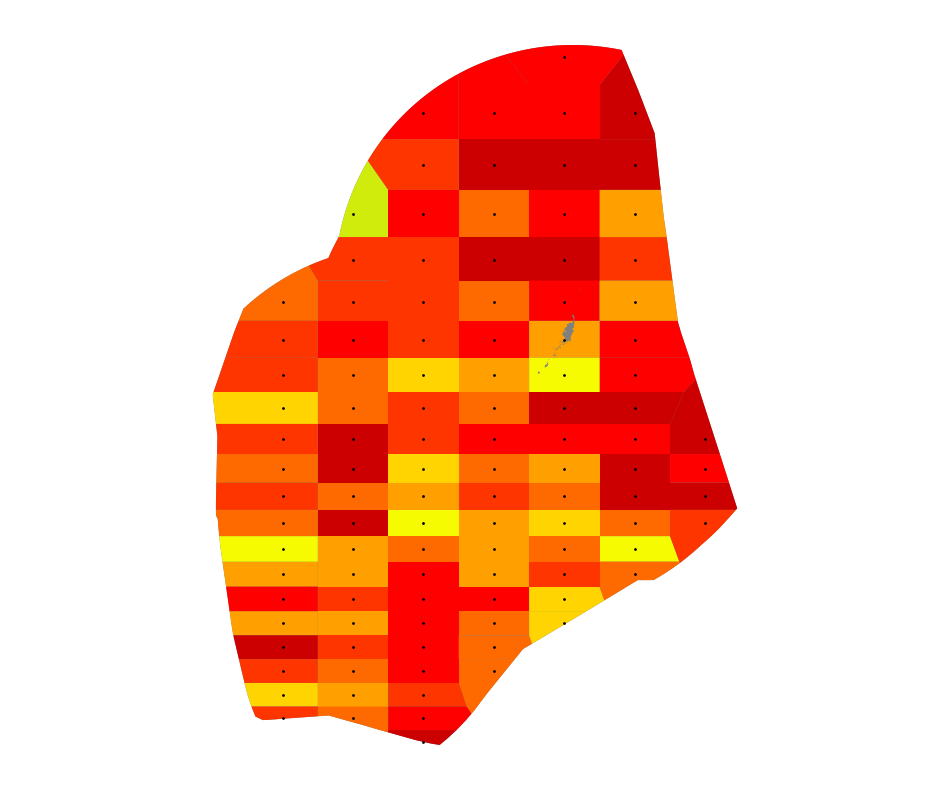

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2099_tos_Omon_CanESM5_ssp434_r3i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


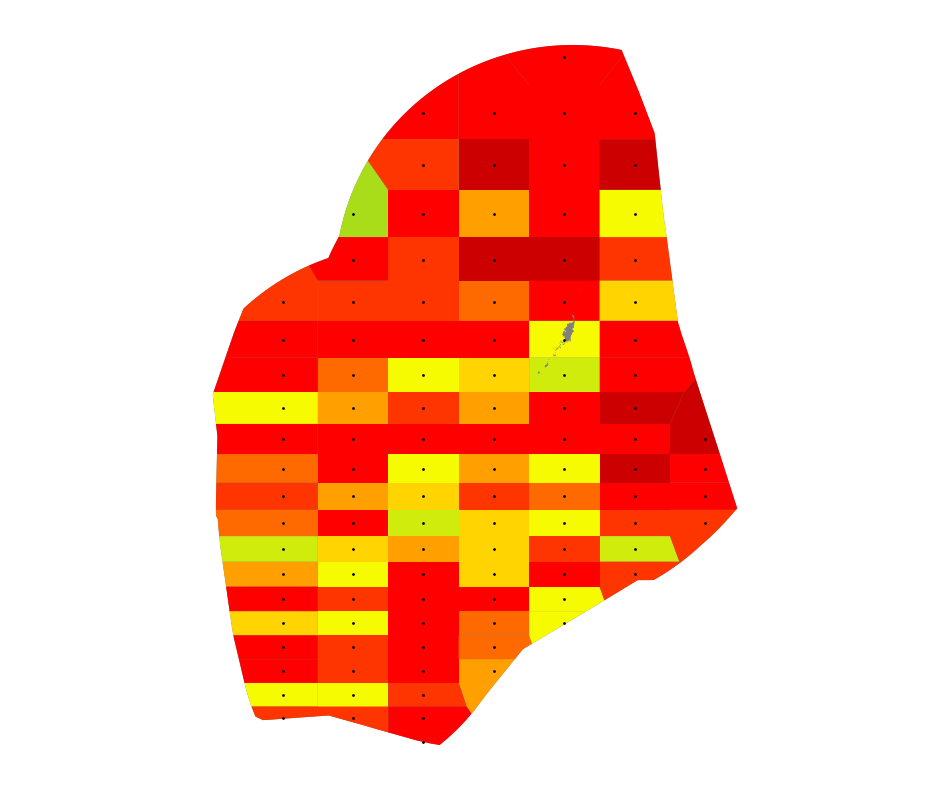

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp434_r3i1p1f1/2100_tos_Omon_CanESM5_ssp434_r3i1p1f1.json
CanESM5 ssp460
latlon_tos_Omon_CanESM5_ssp460_r4i1p1f1_.pkl
Created: 2015-2100_colorbar_tos_Omon_CanESM5_ssp460_r4i1p1f1.png


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


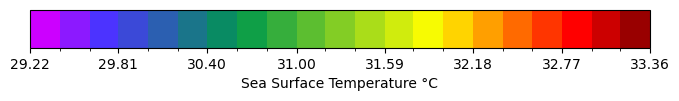

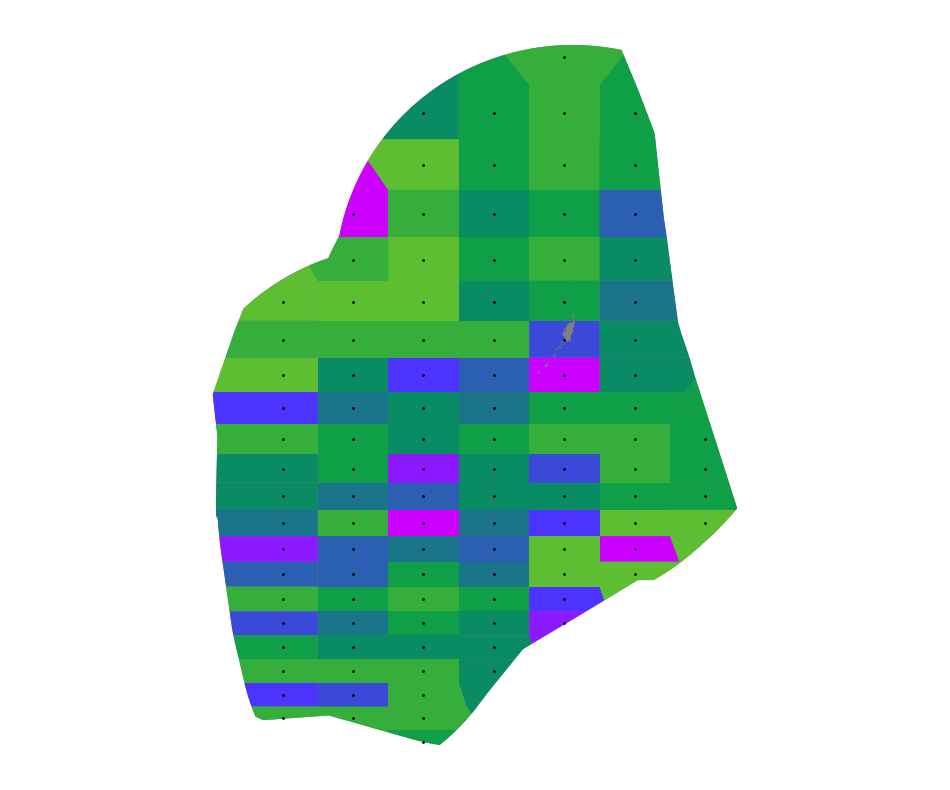

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2015_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


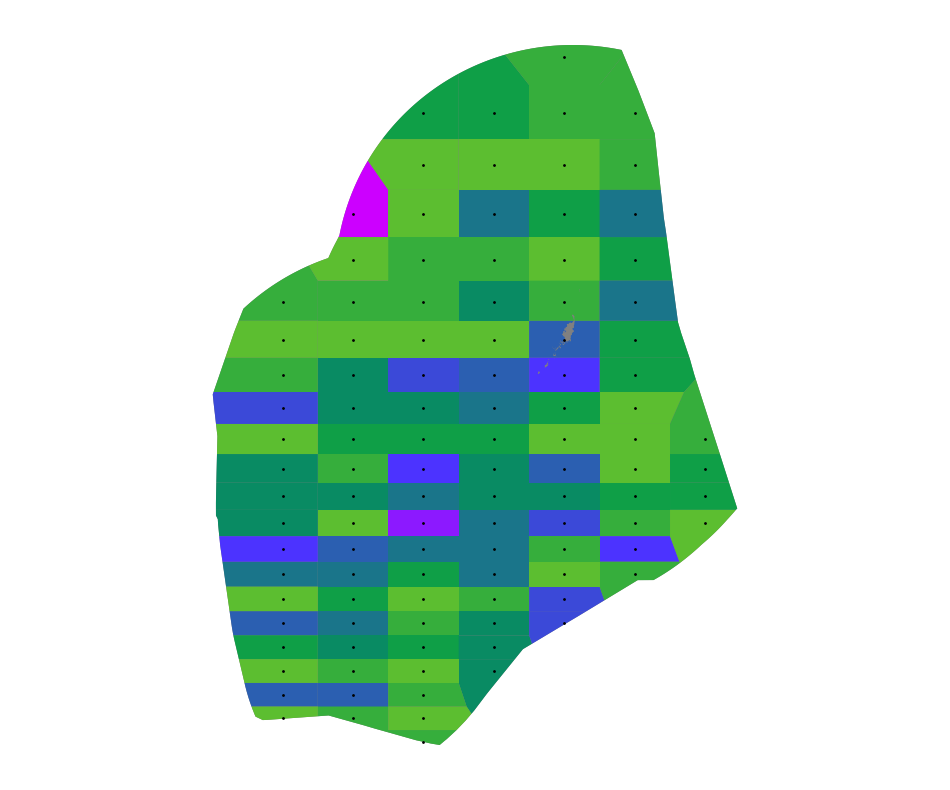

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2016_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


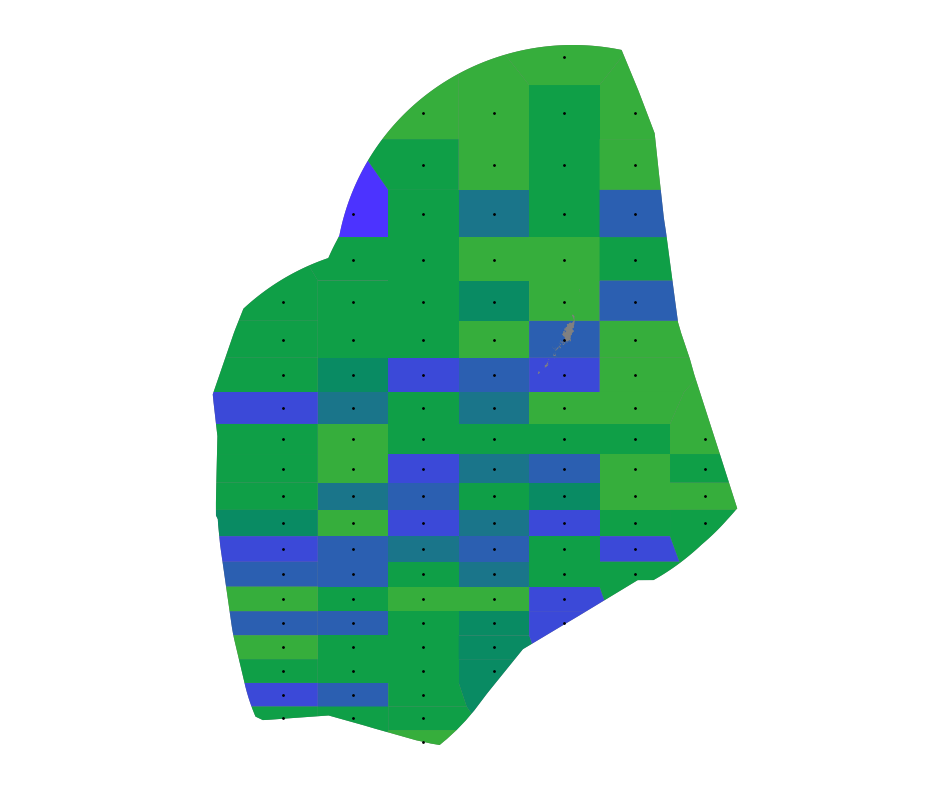

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2017_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


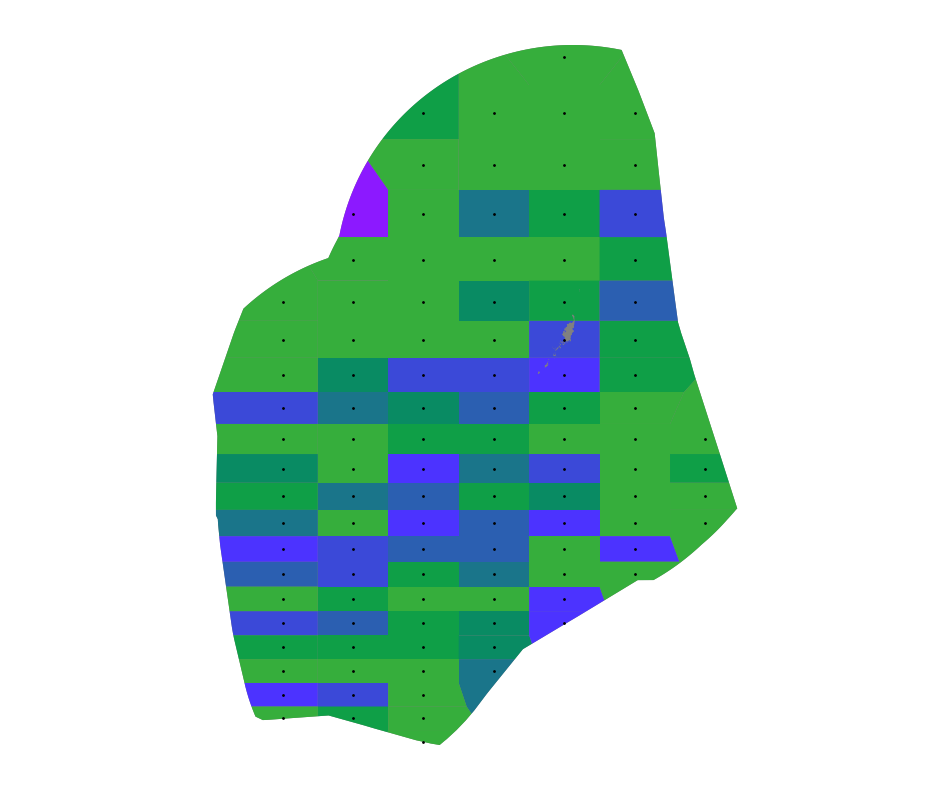

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2018_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


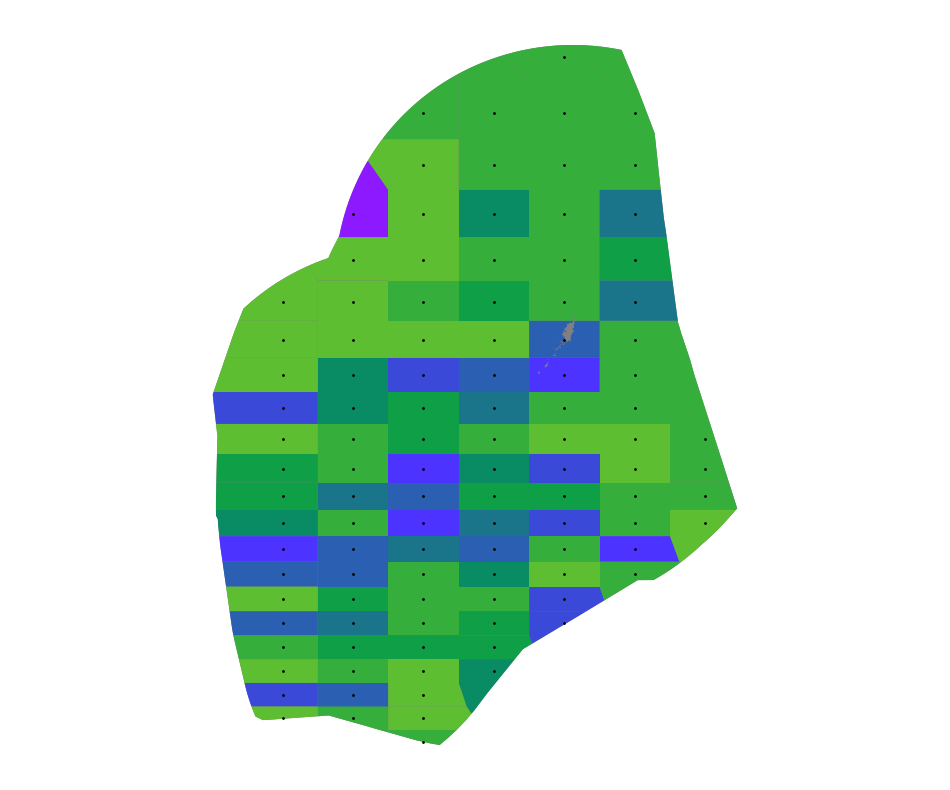

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2019_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


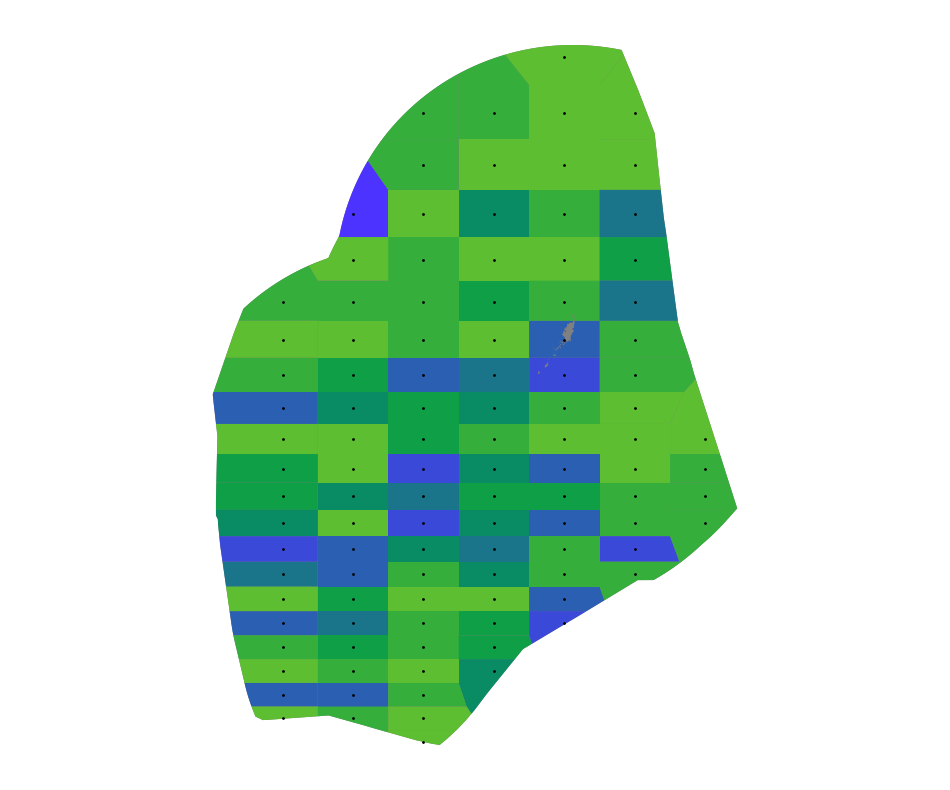

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2020_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


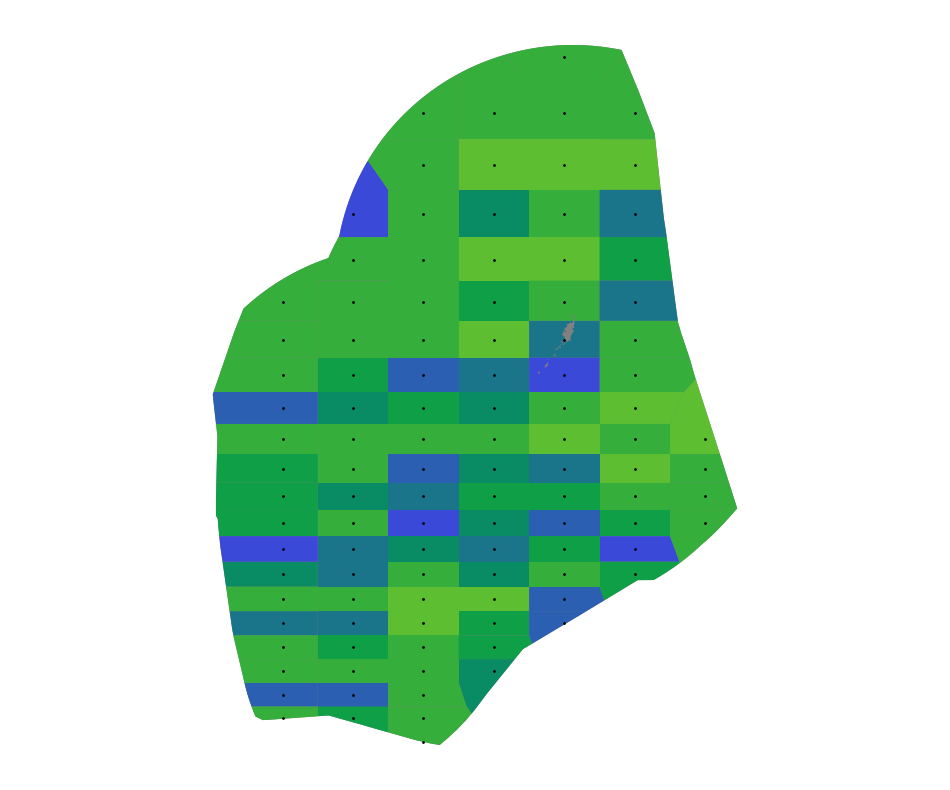

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2021_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


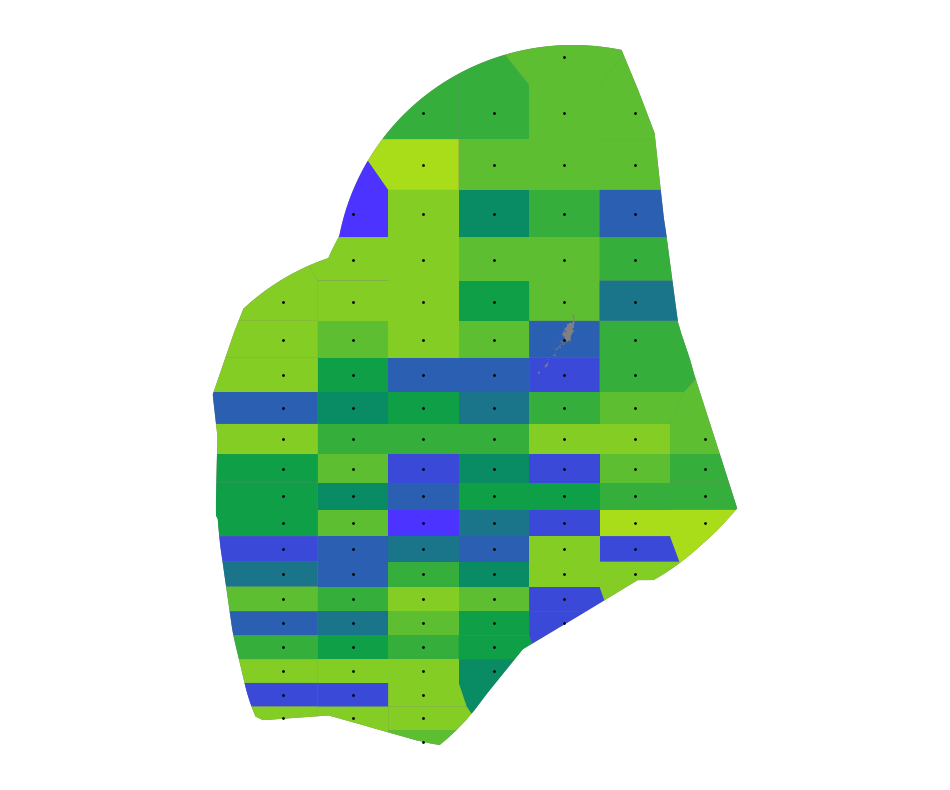

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2022_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


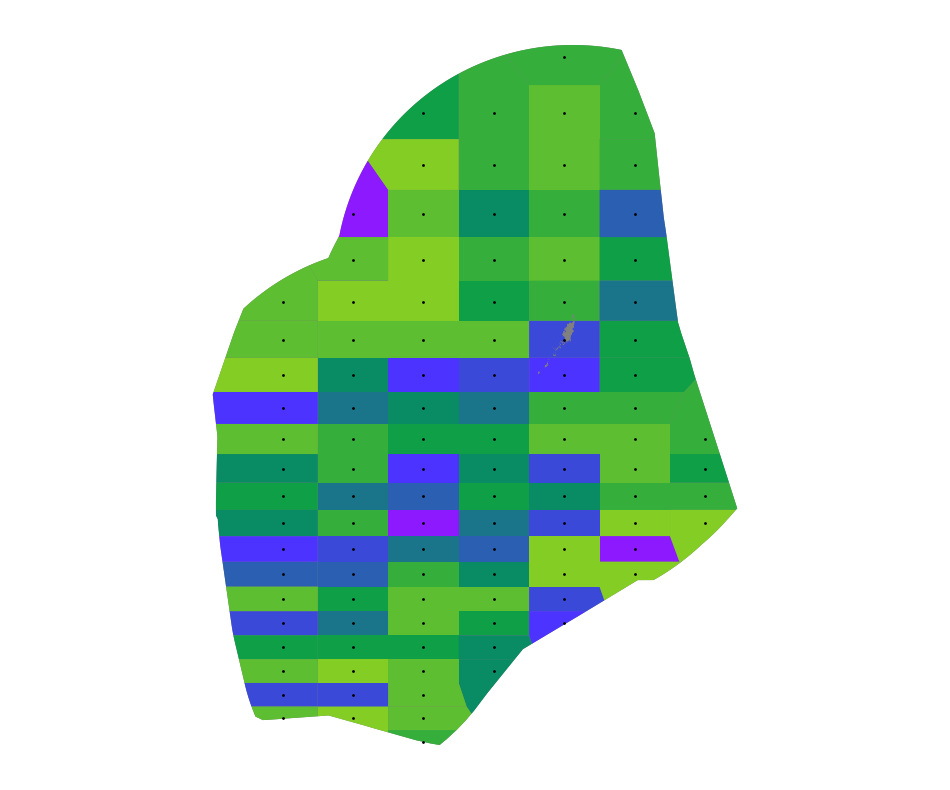

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2023_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


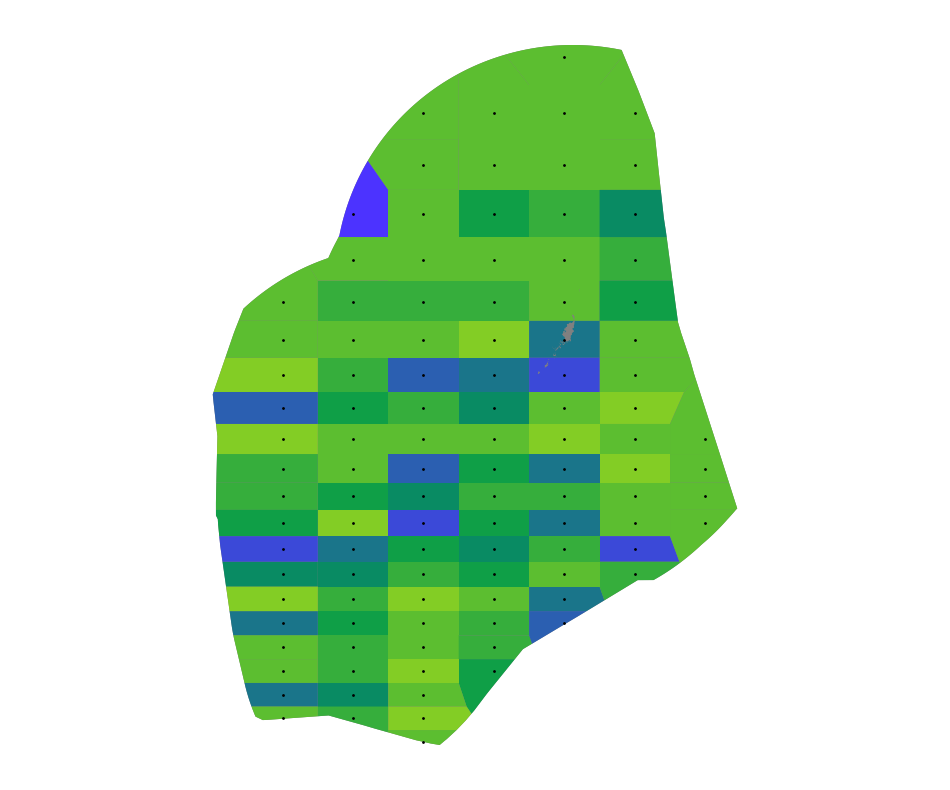

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2024_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


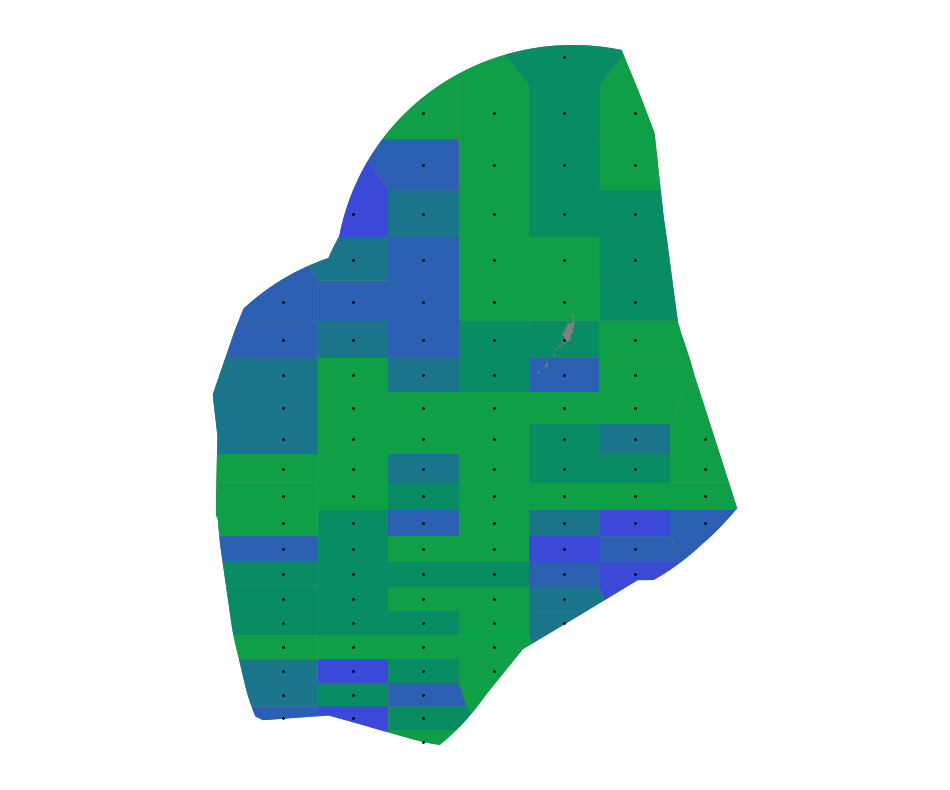

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2025_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


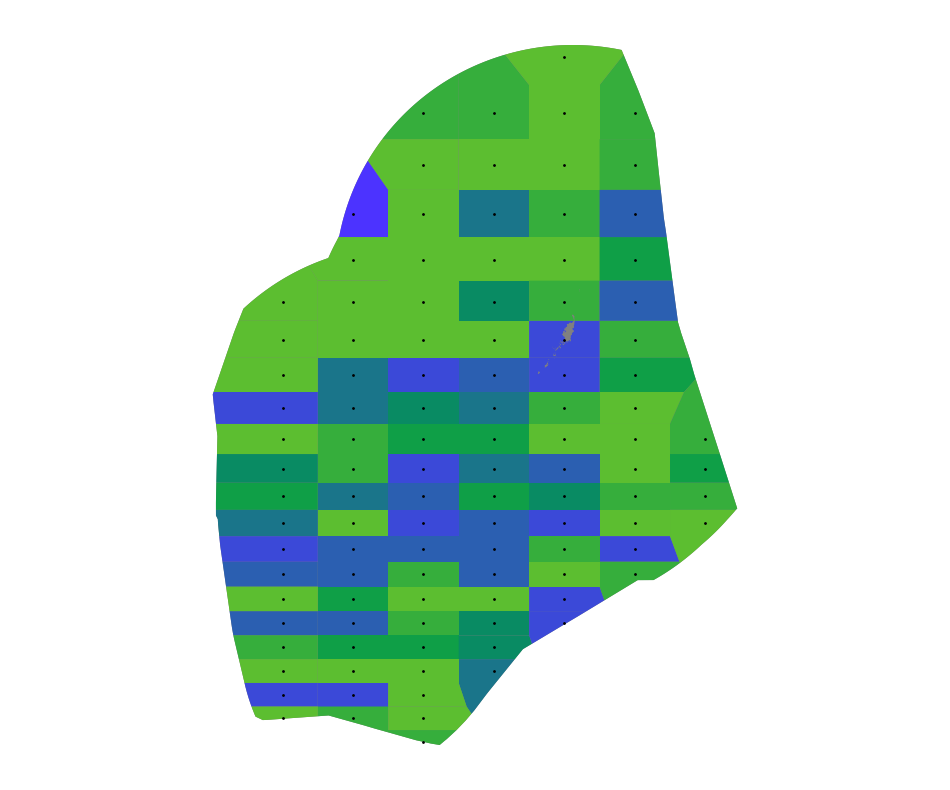

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2026_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


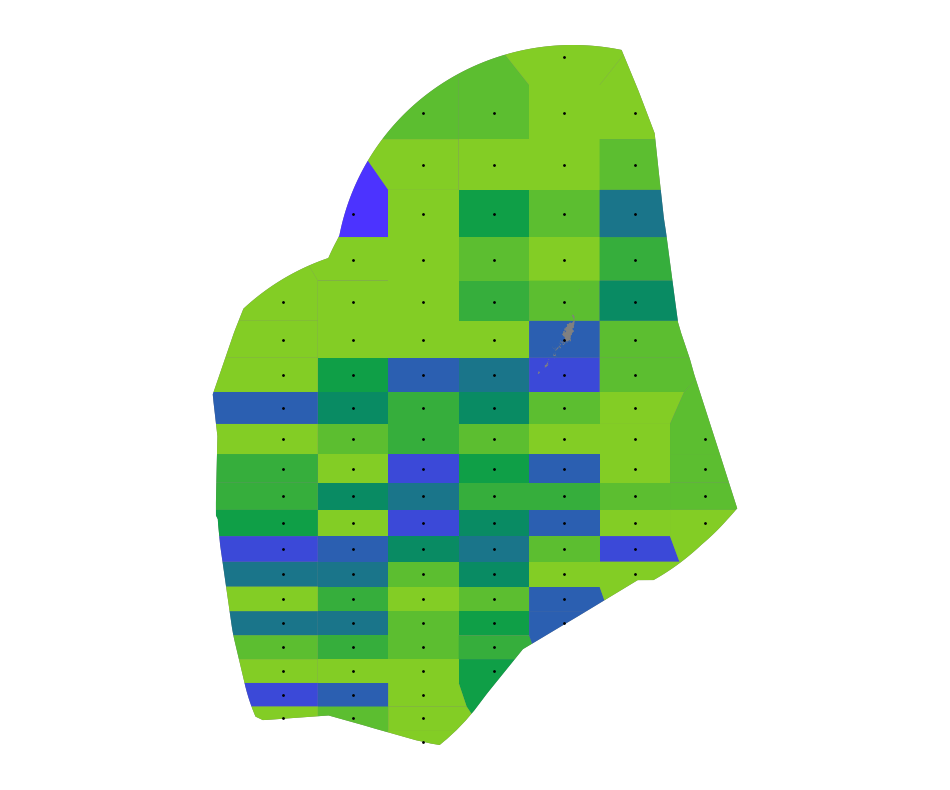

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2027_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


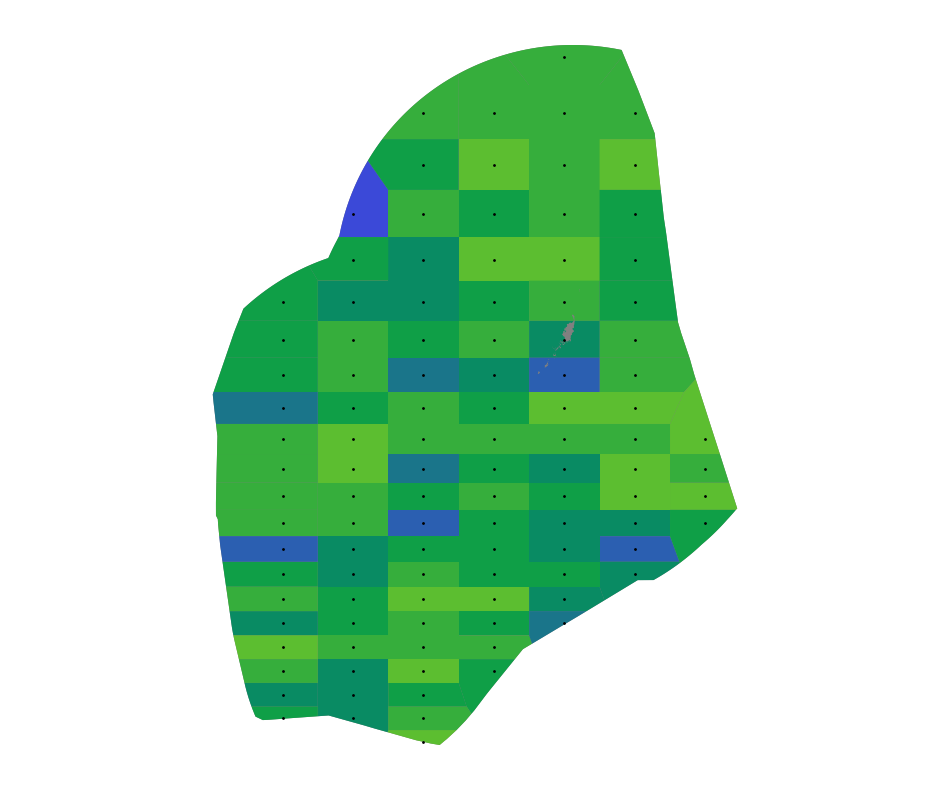

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2028_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


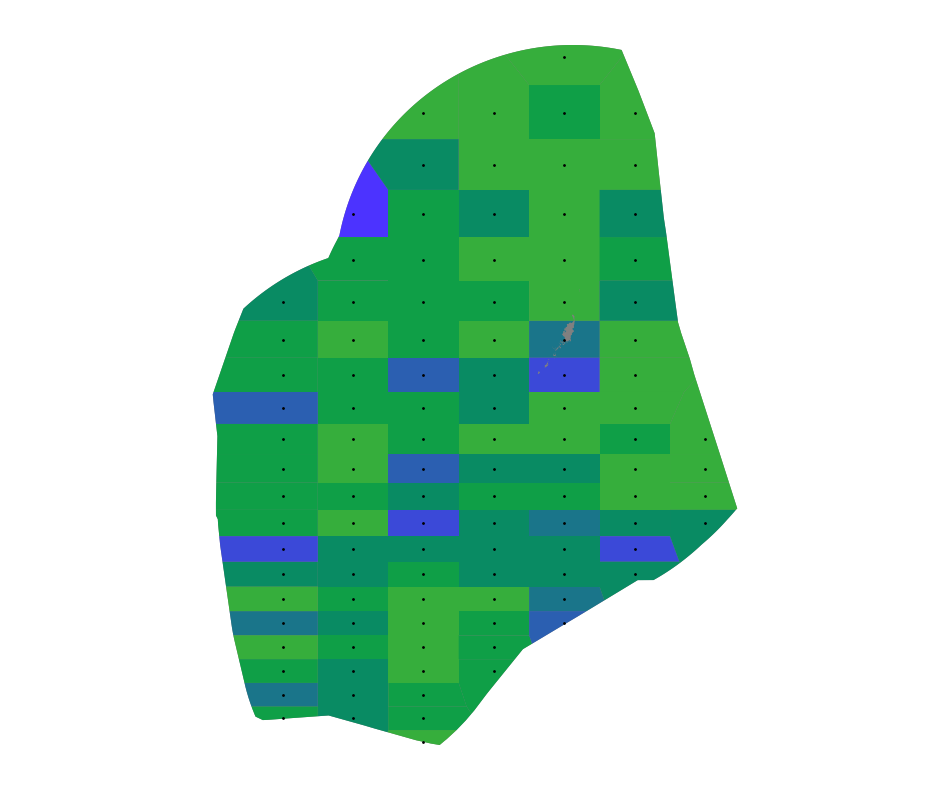

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2029_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


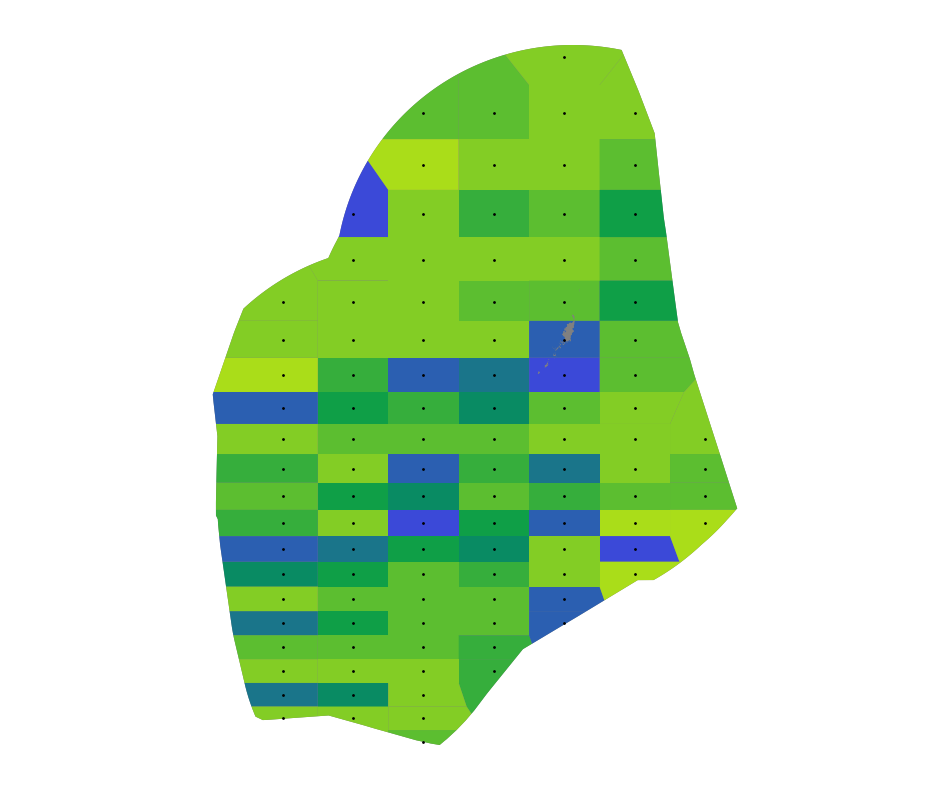

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2030_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


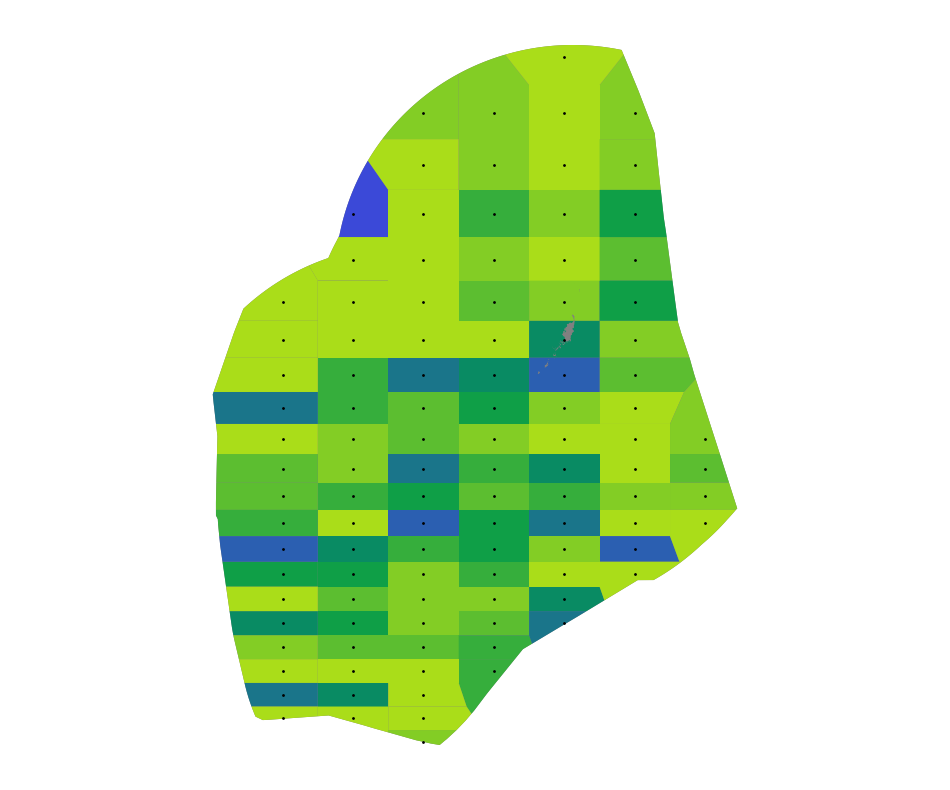

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2031_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


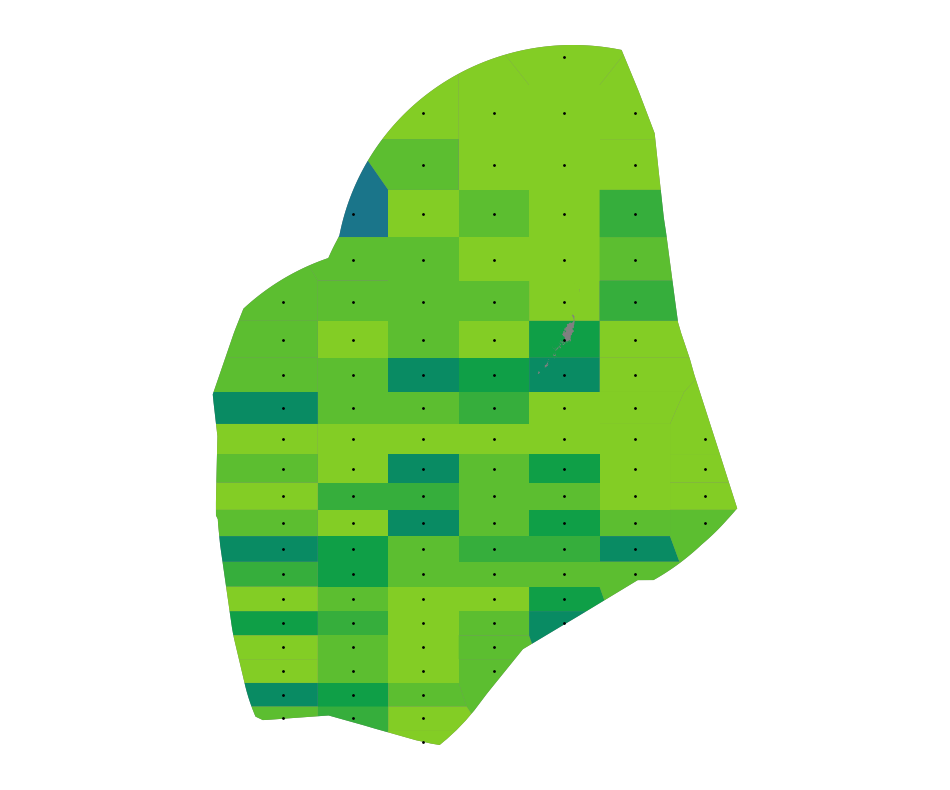

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2032_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


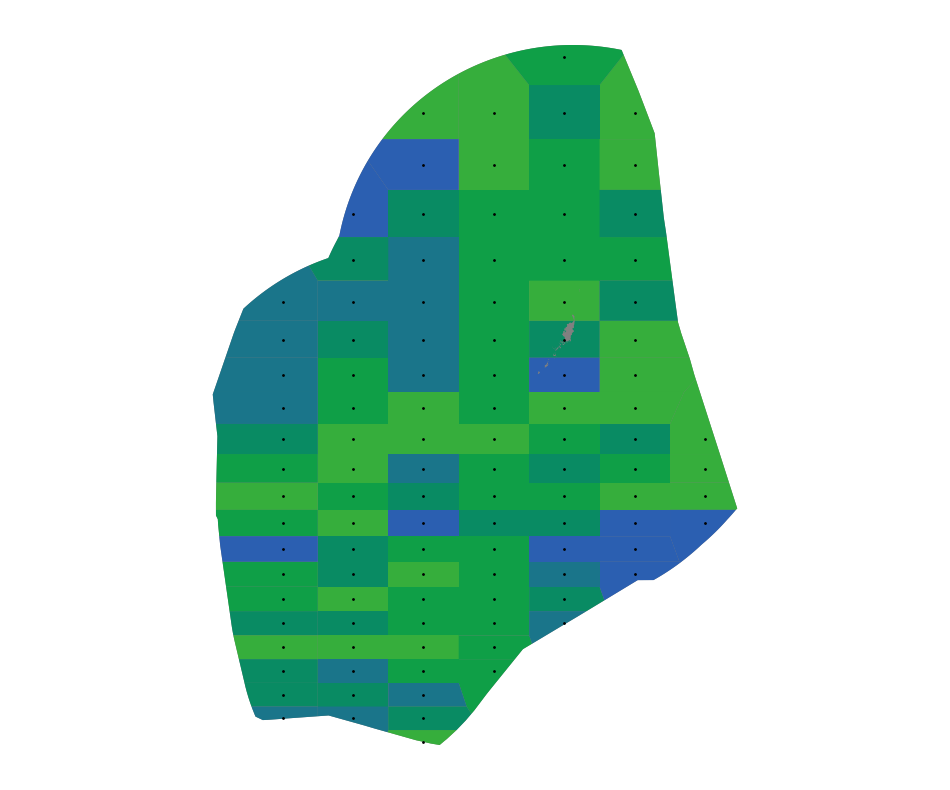

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2033_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


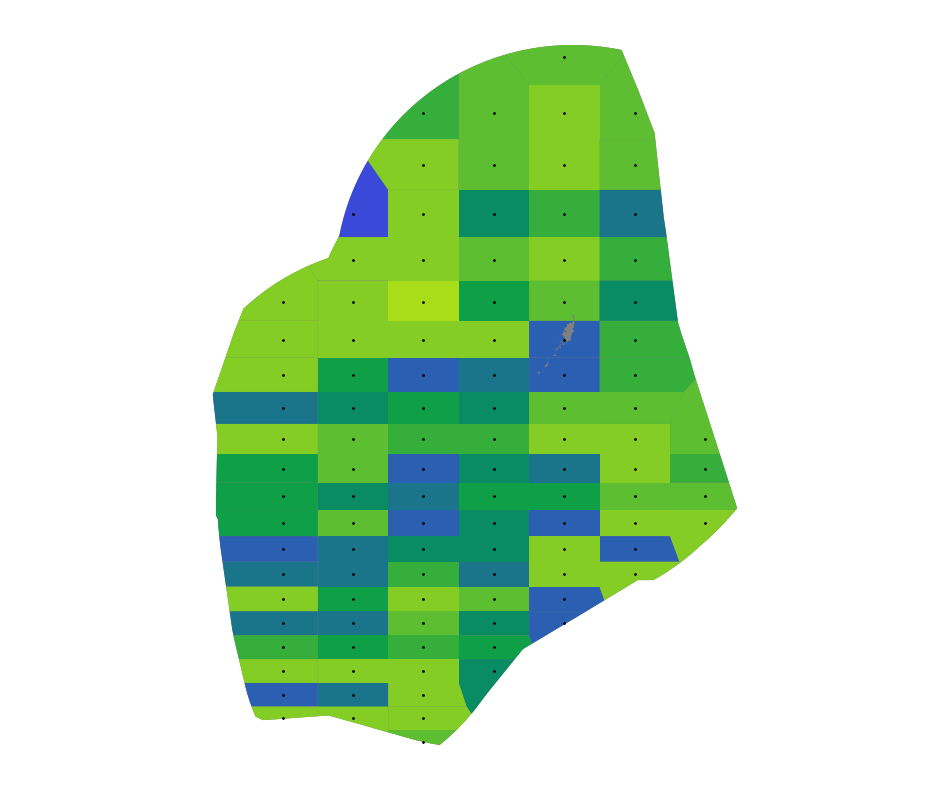

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2034_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


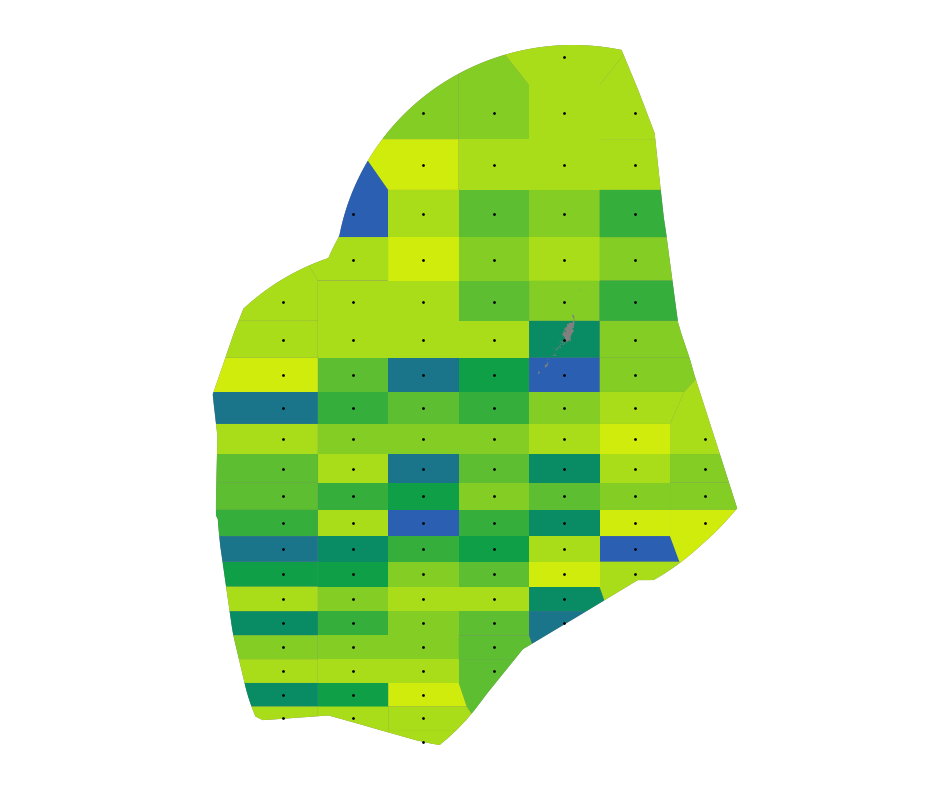

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2035_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


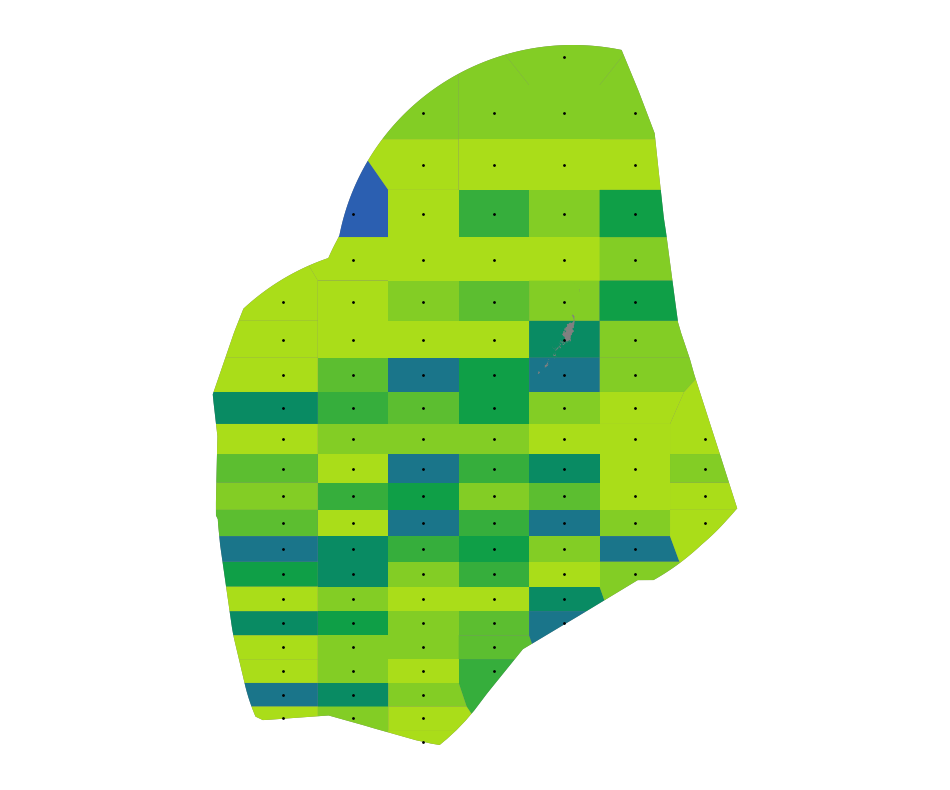

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2036_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


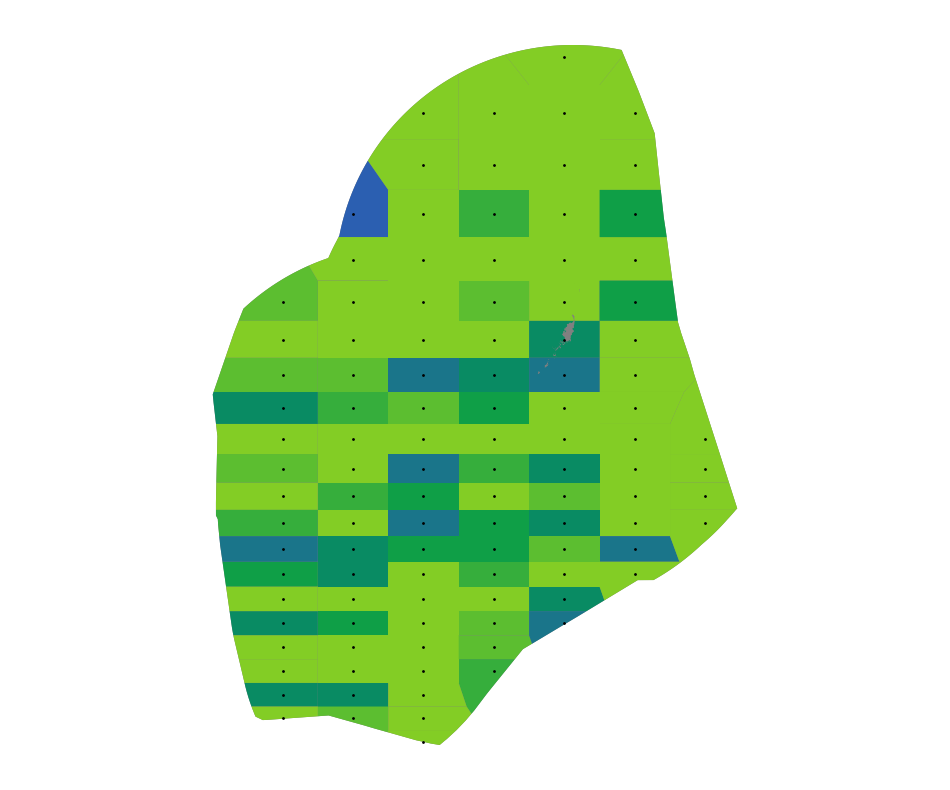

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2037_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


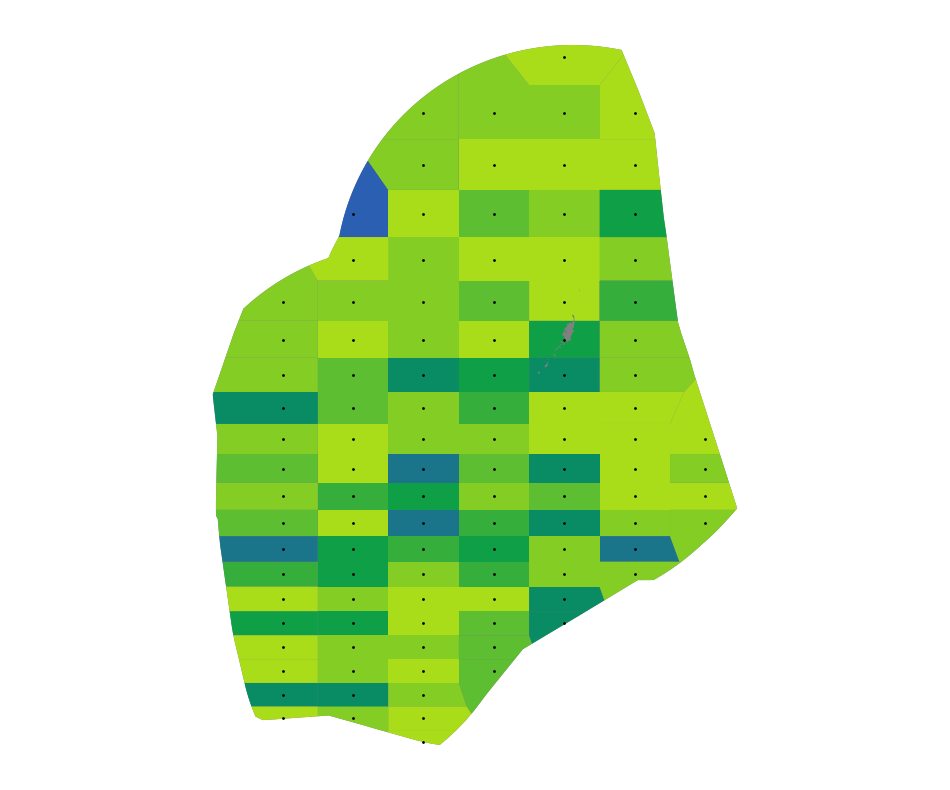

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2038_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


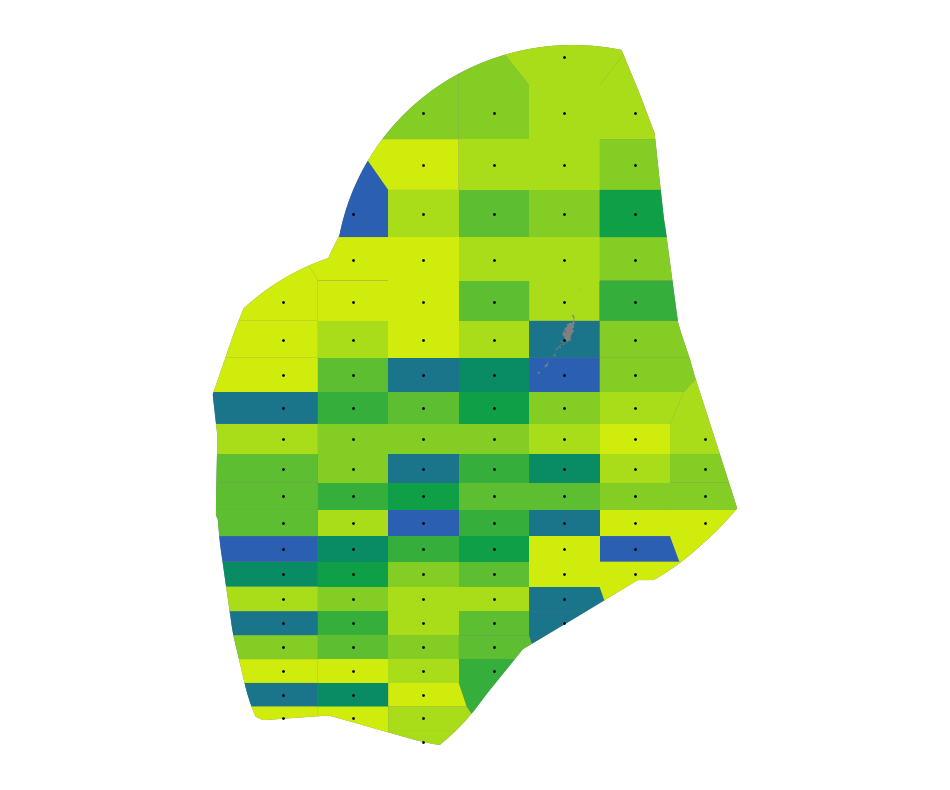

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2039_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


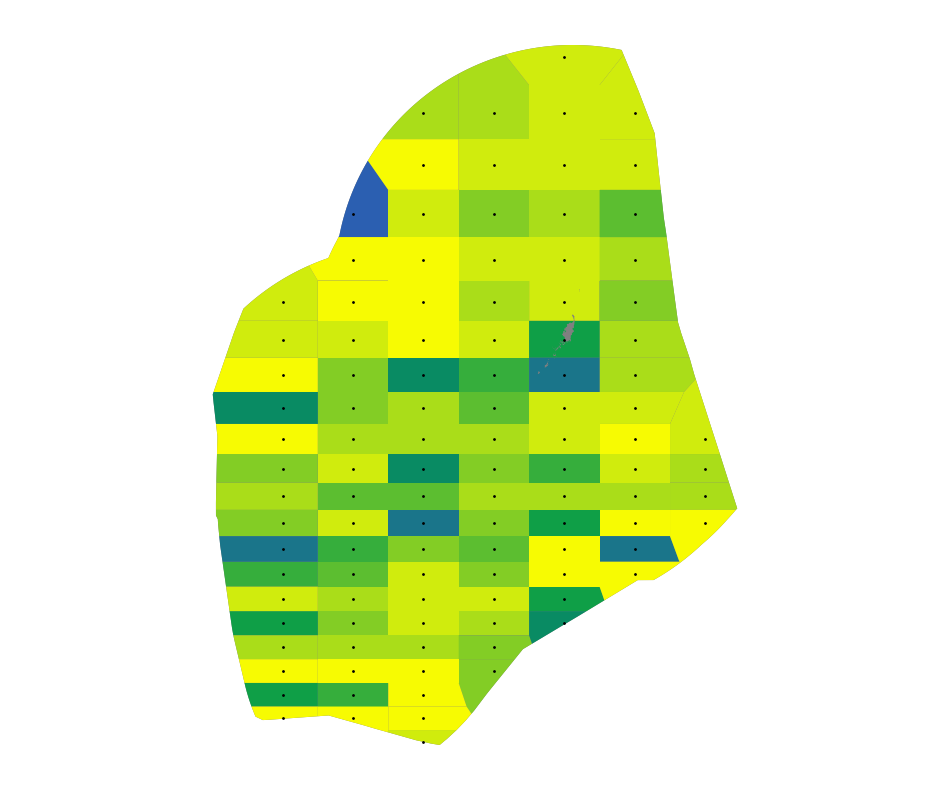

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2040_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


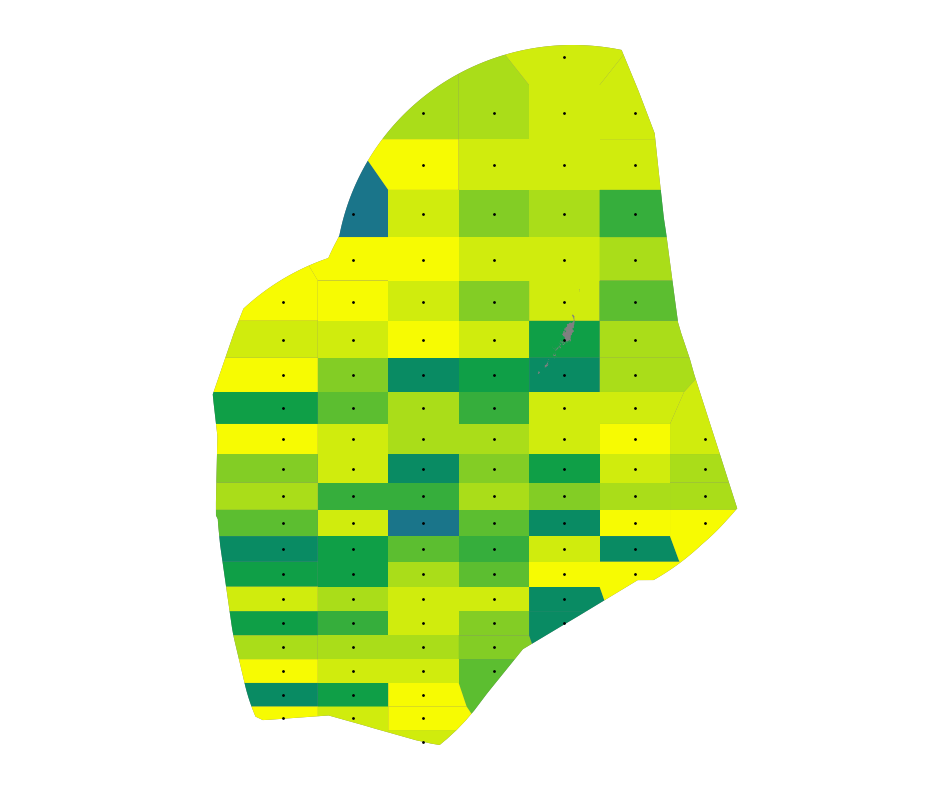

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2041_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


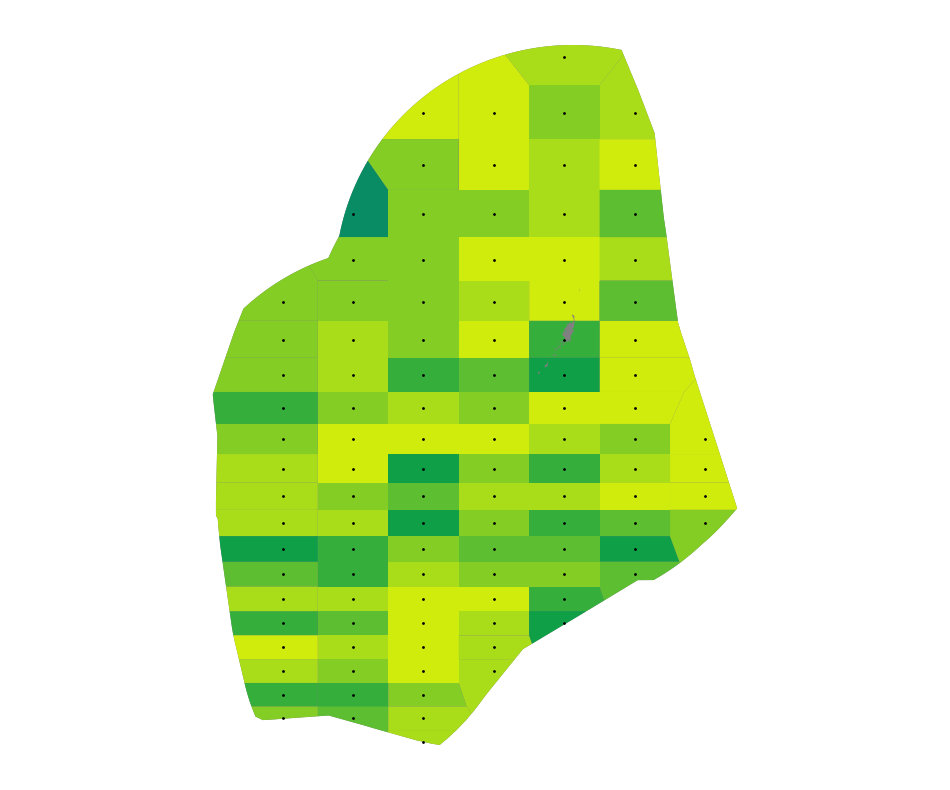

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2042_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


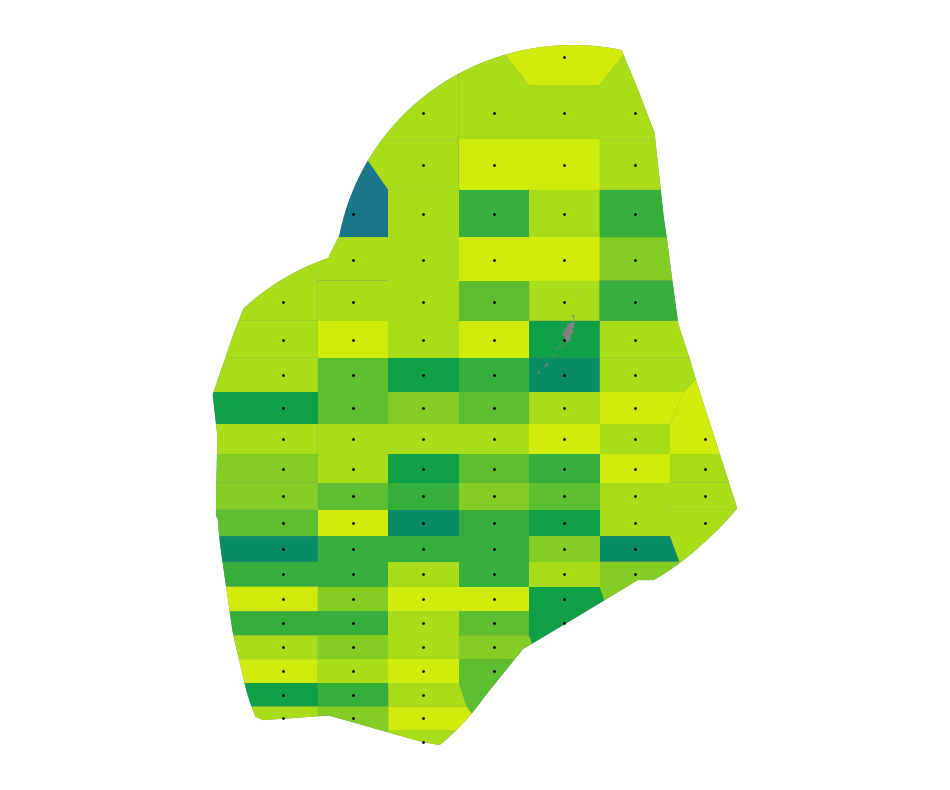

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2043_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


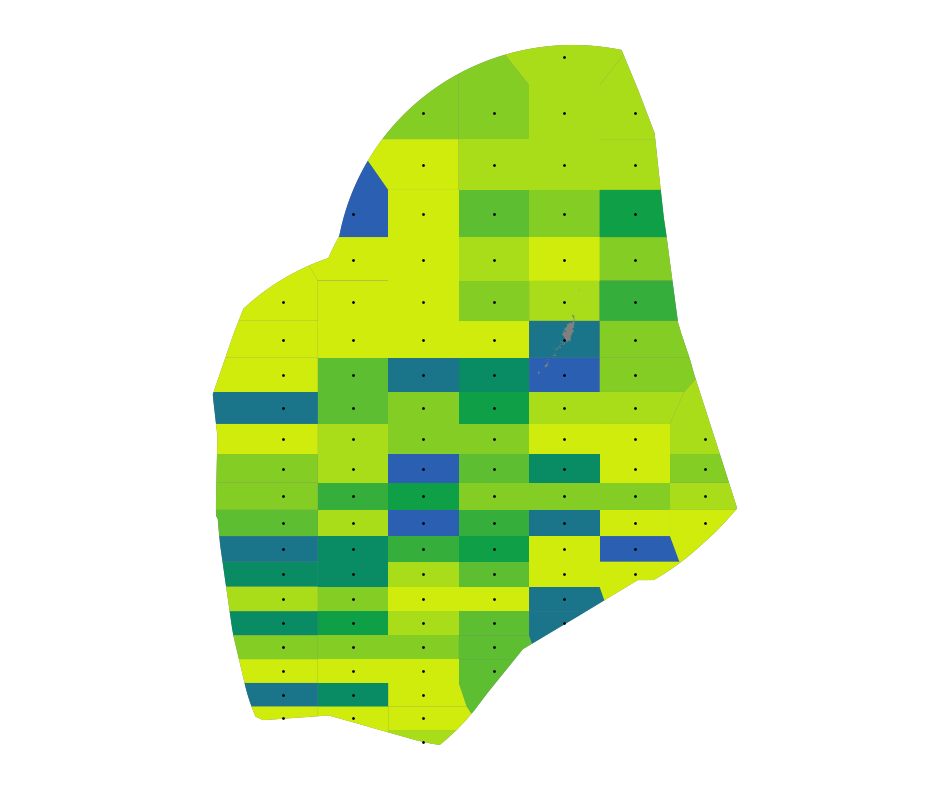

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2044_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


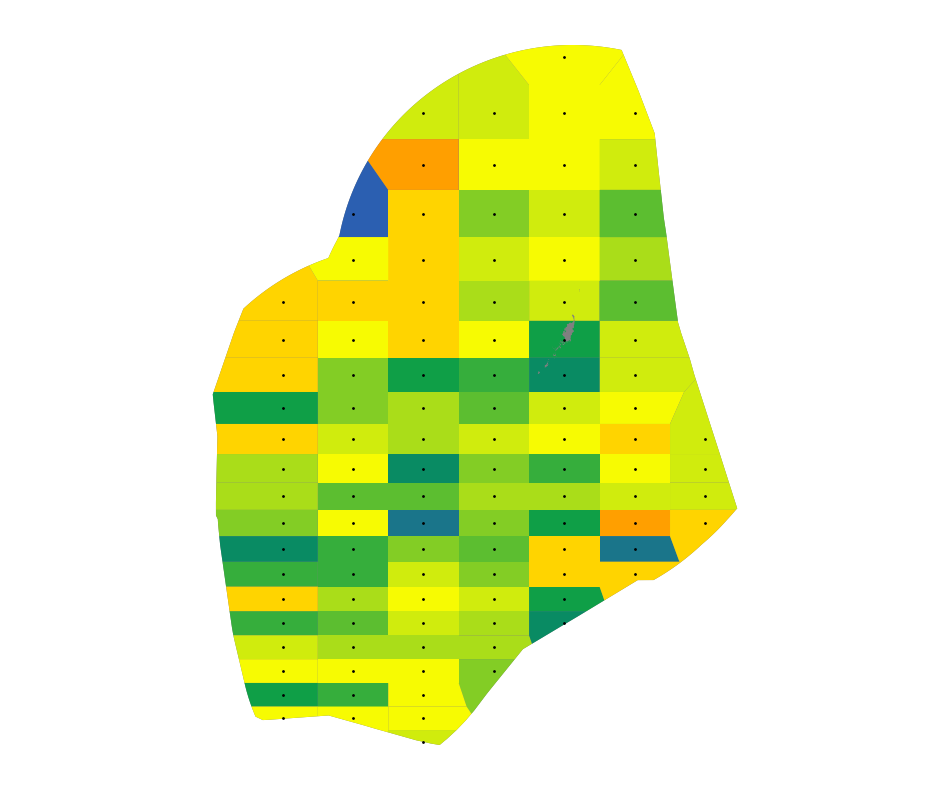

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2045_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


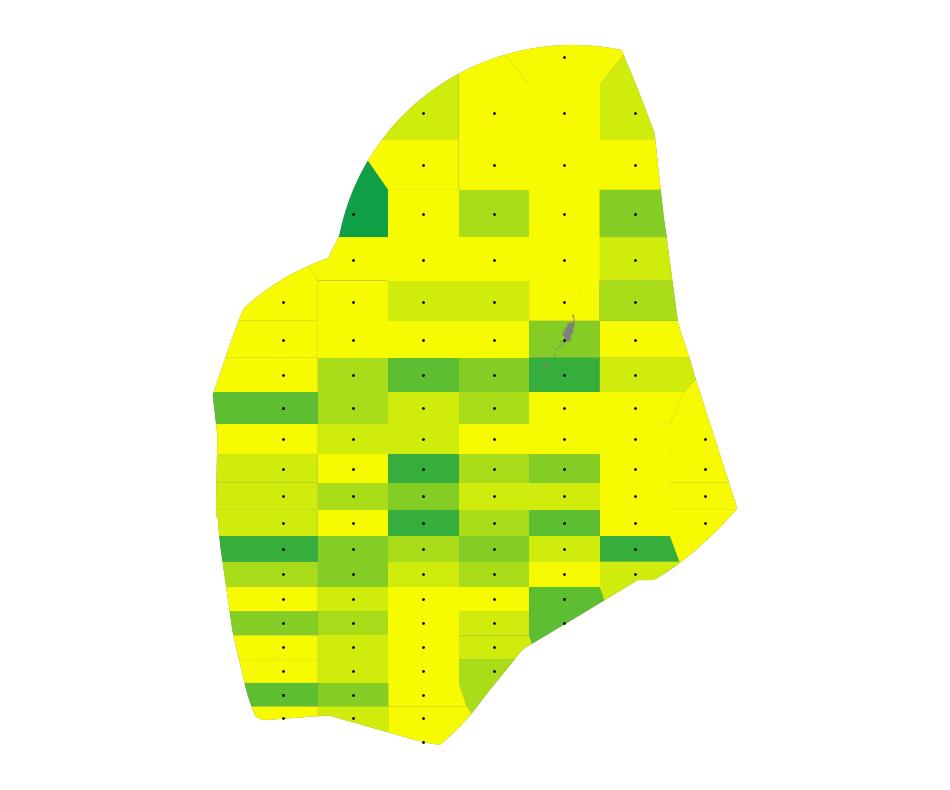

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2046_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


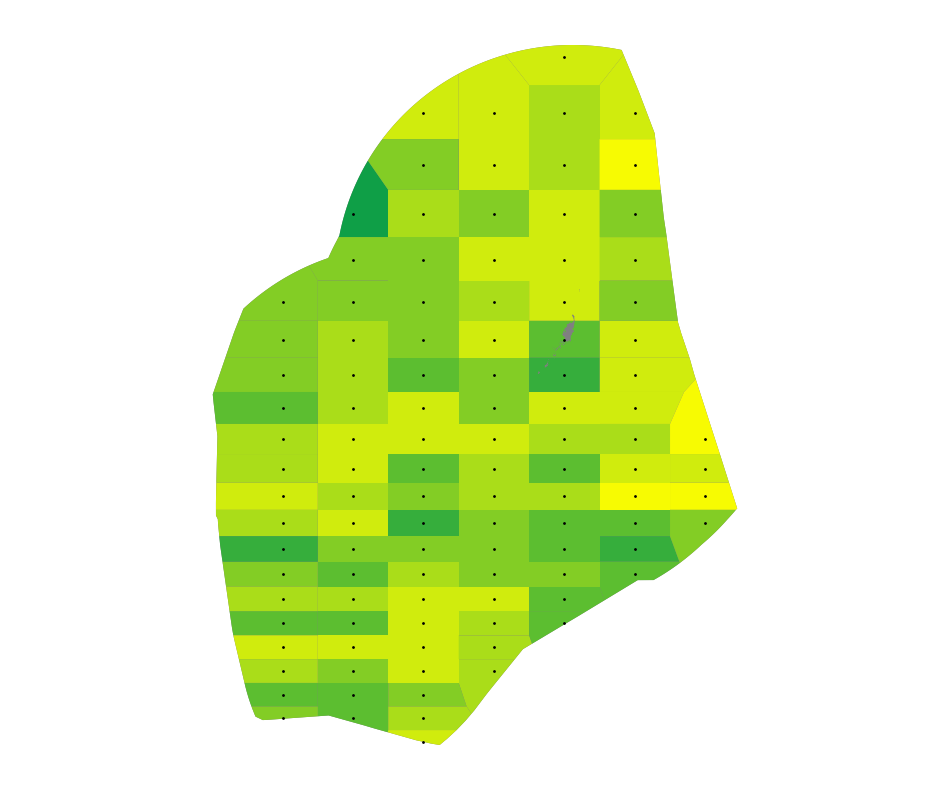

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2047_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


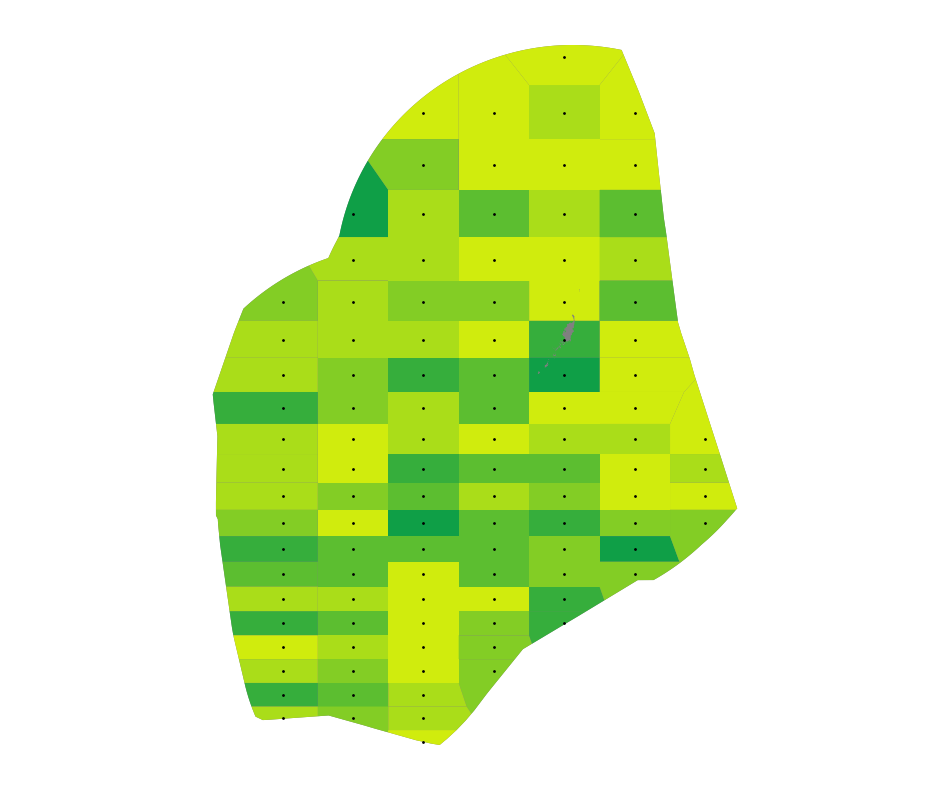

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2048_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


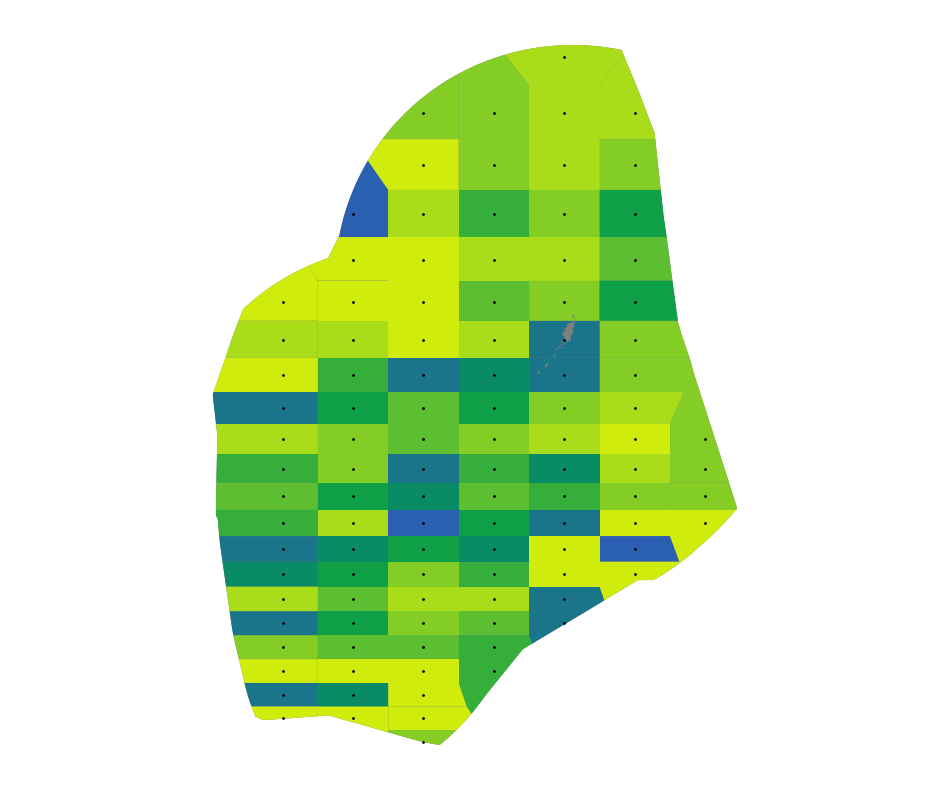

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2049_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


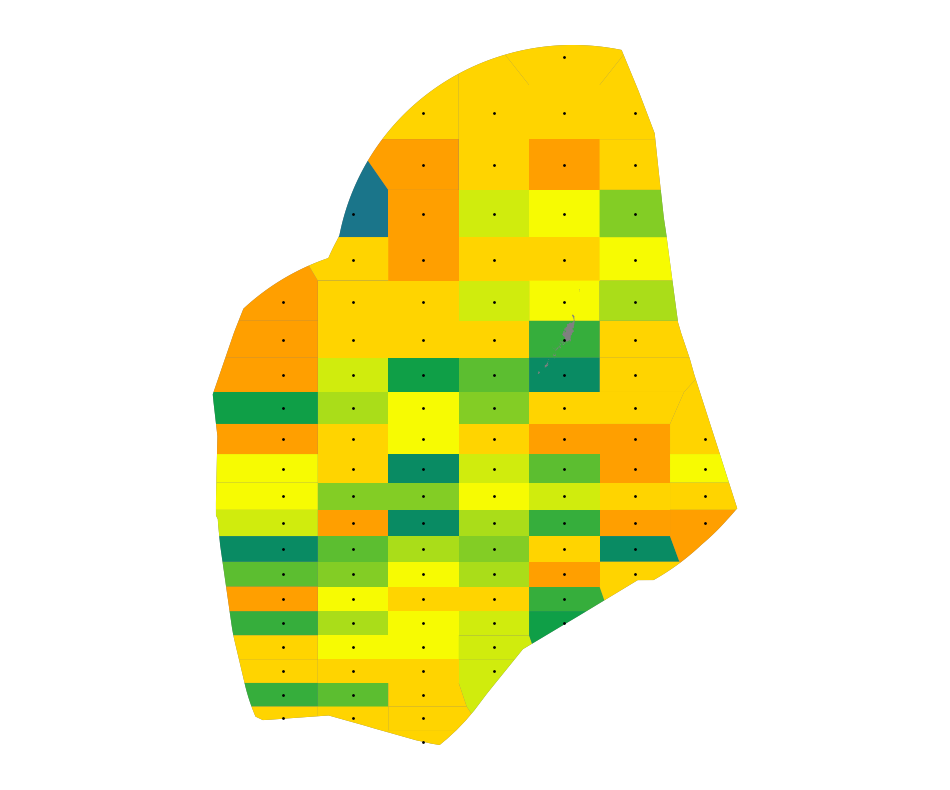

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2050_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


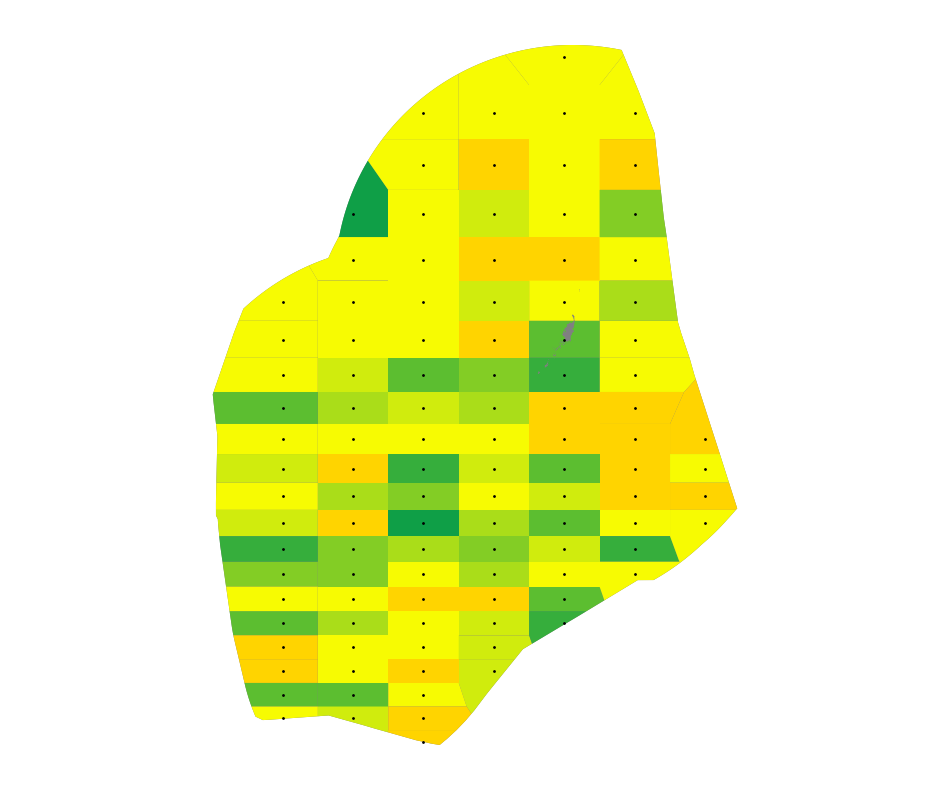

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2051_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


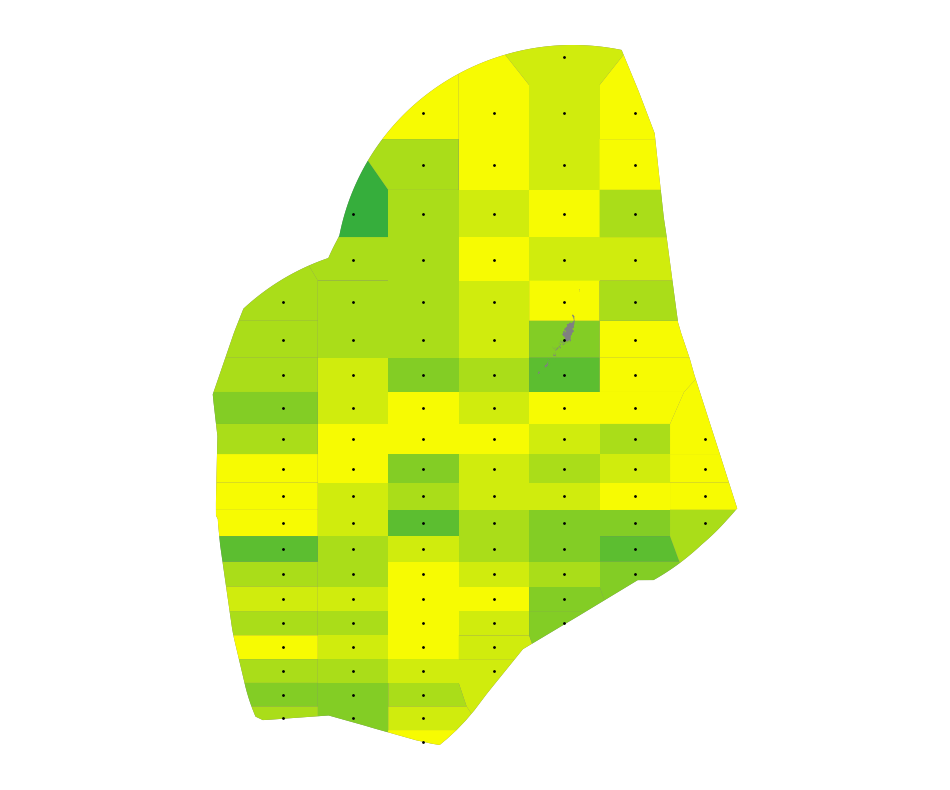

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2052_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


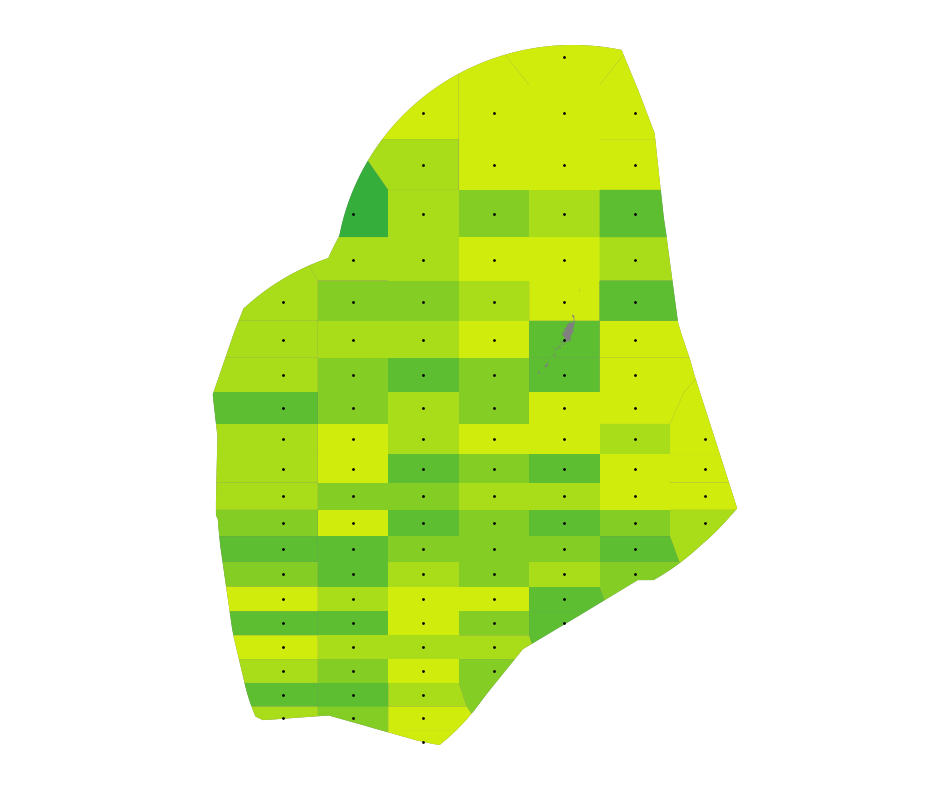

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2053_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


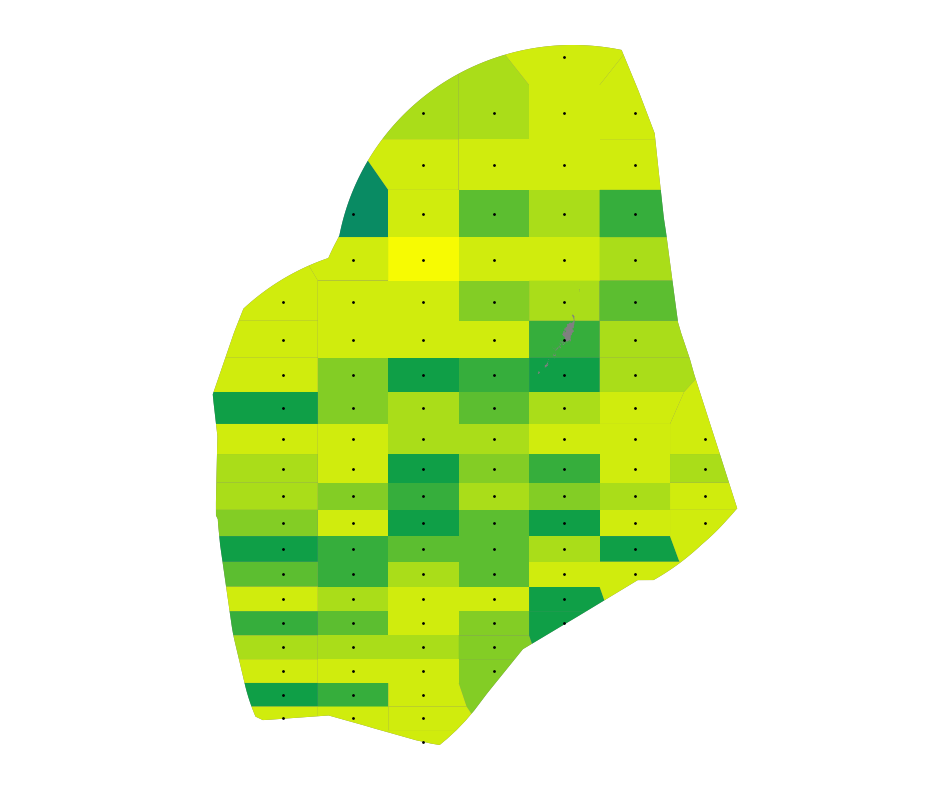

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2054_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


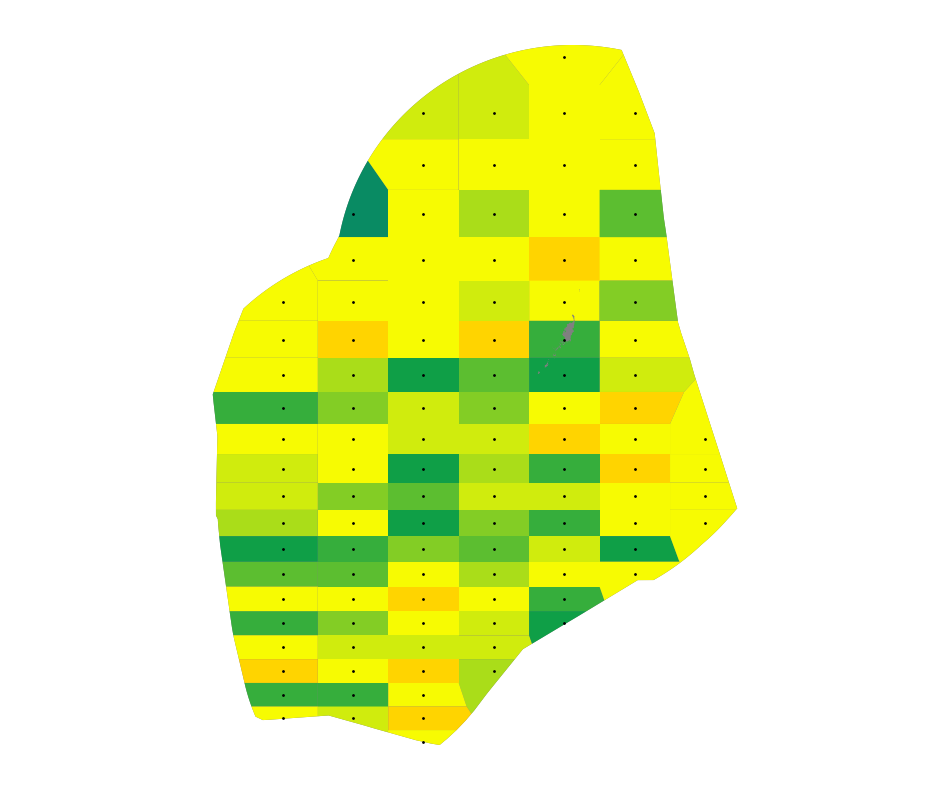

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2055_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


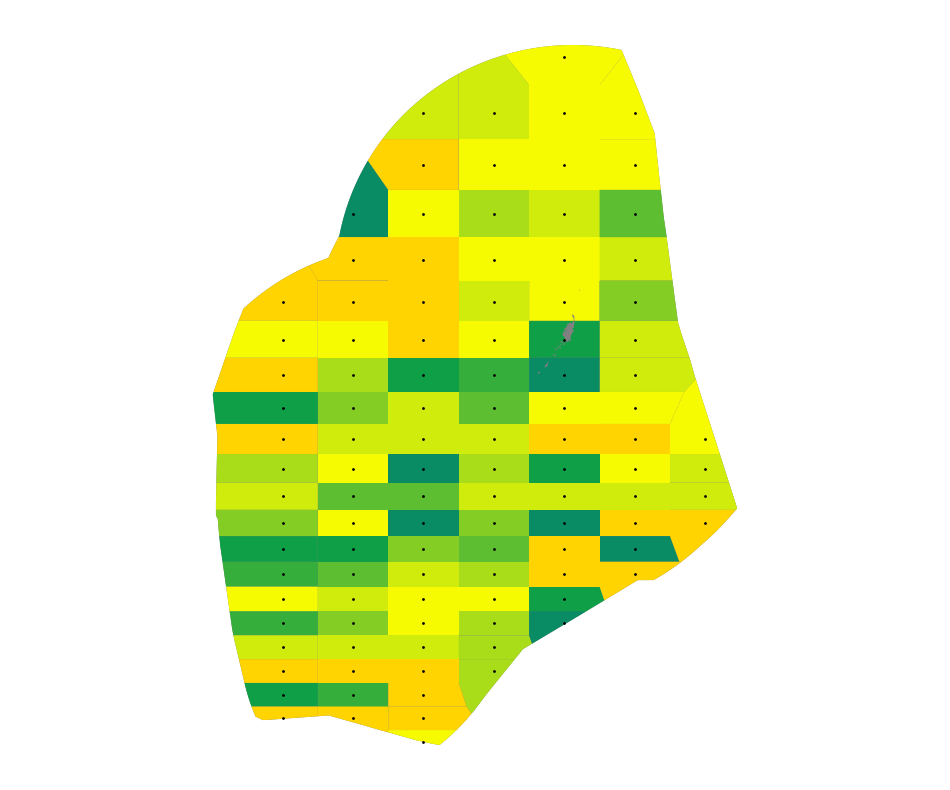

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2056_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


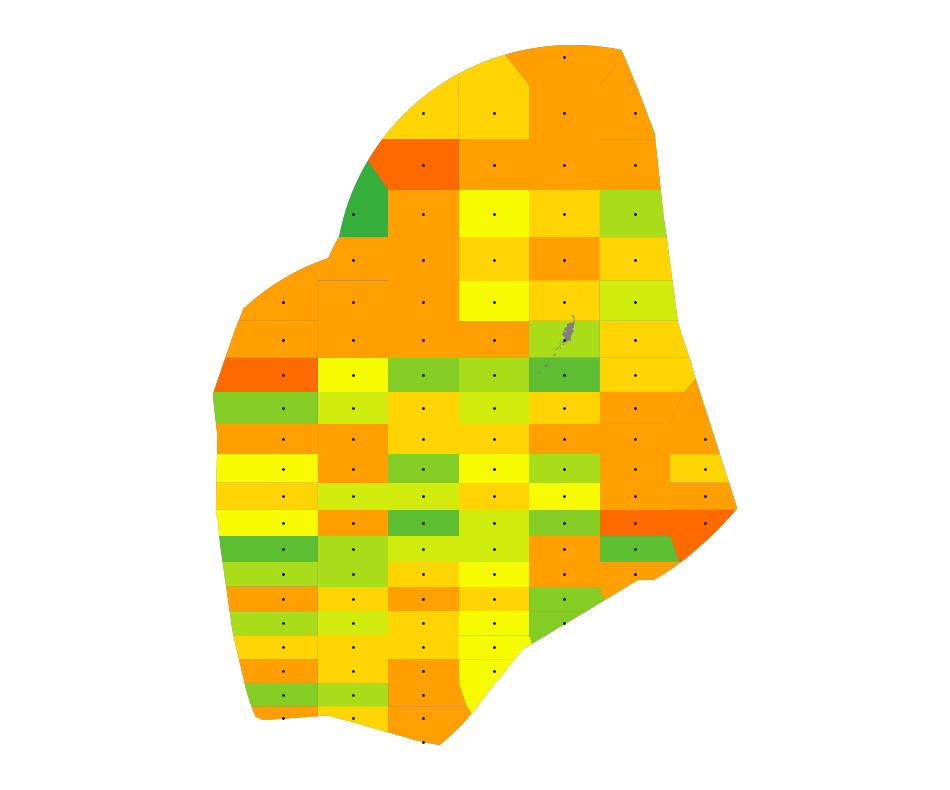

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2057_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


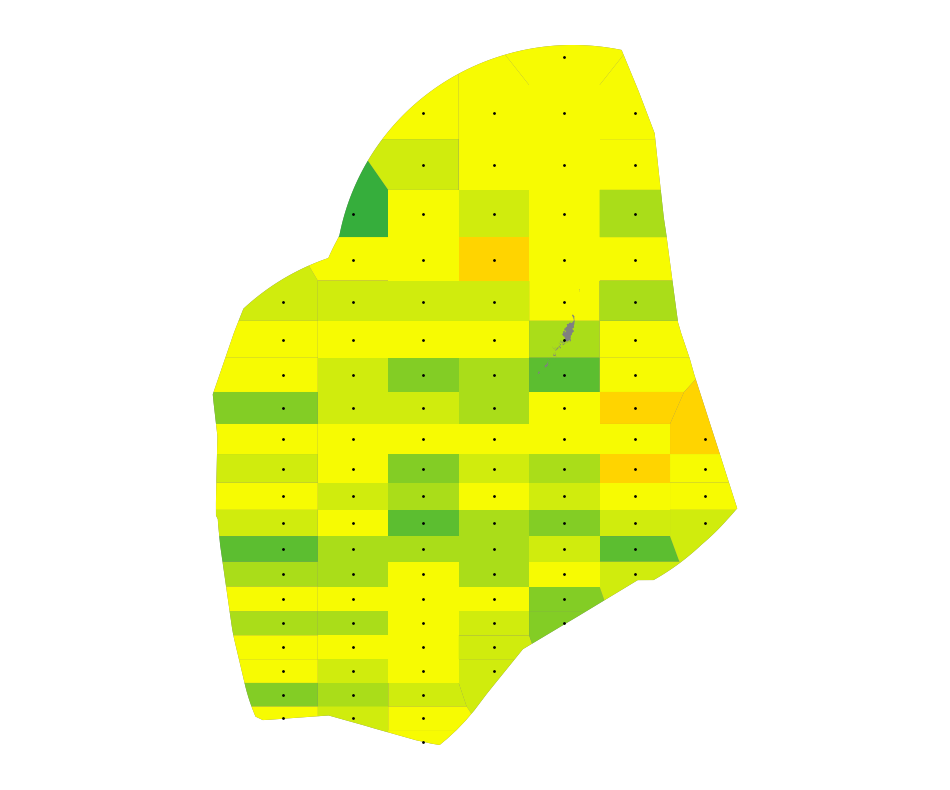

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2058_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


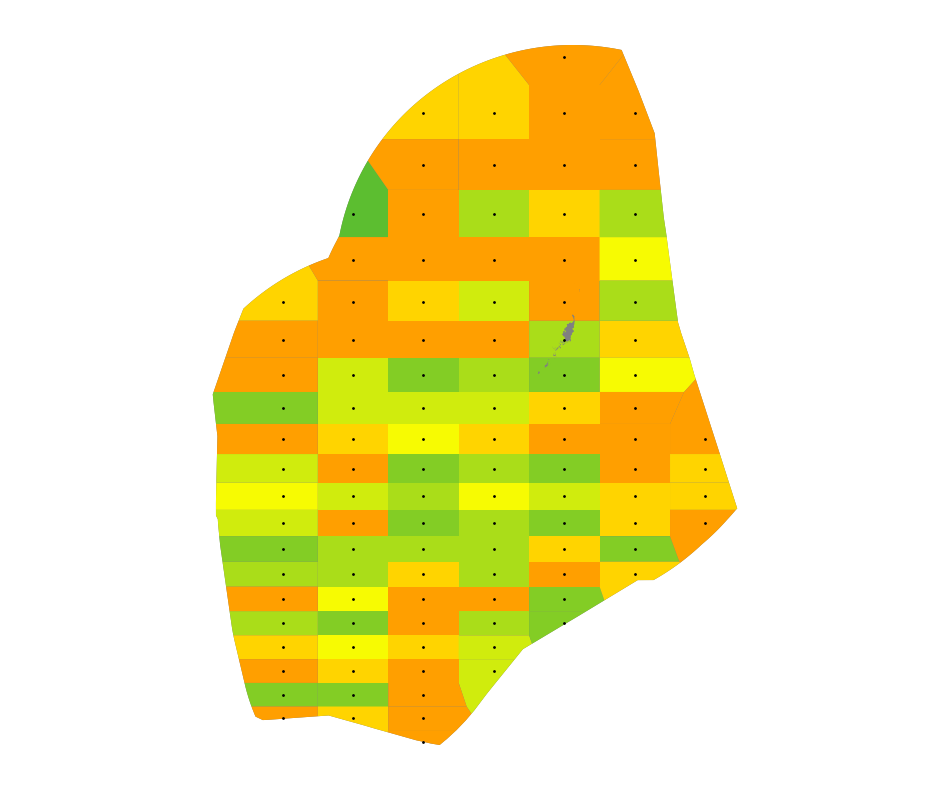

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2059_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


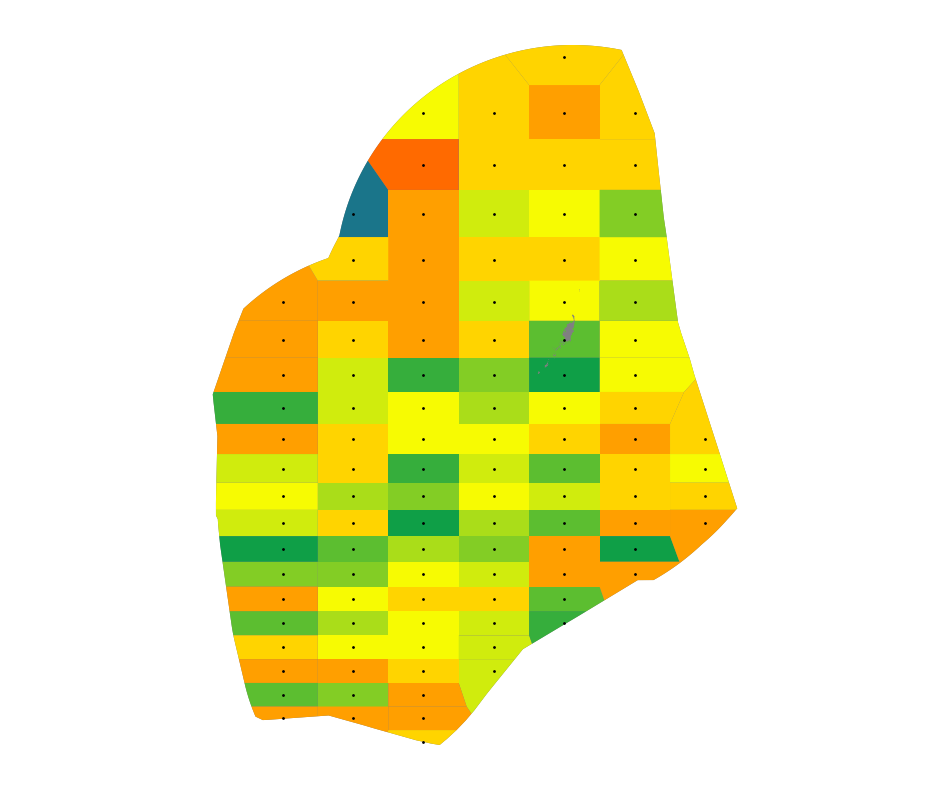

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2060_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


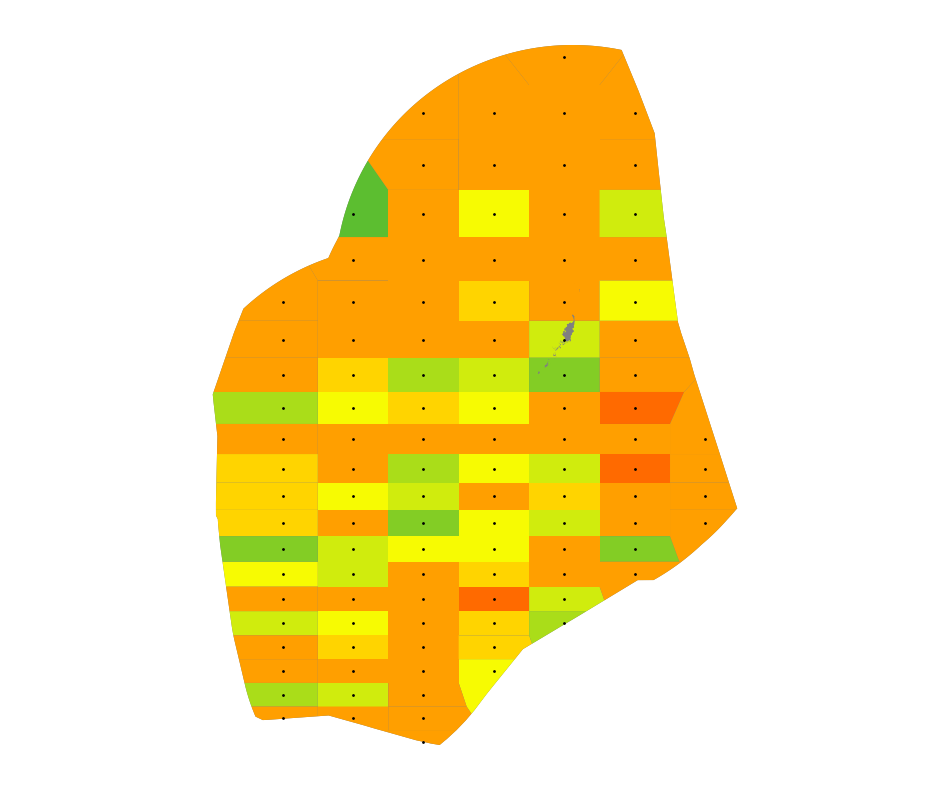

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2061_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


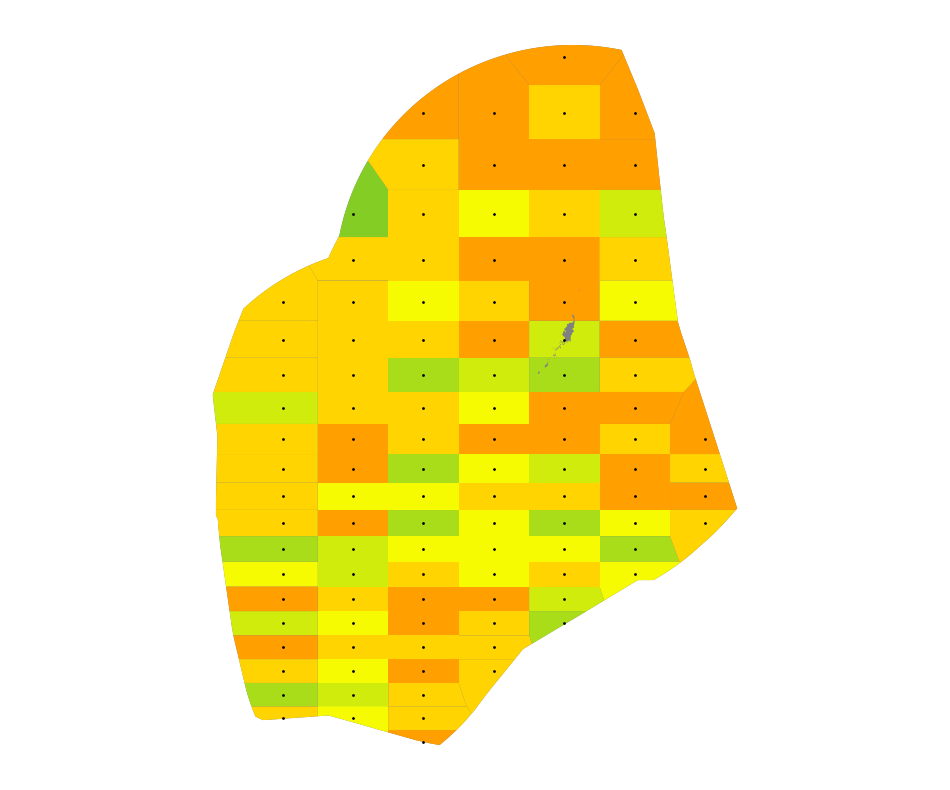

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2062_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


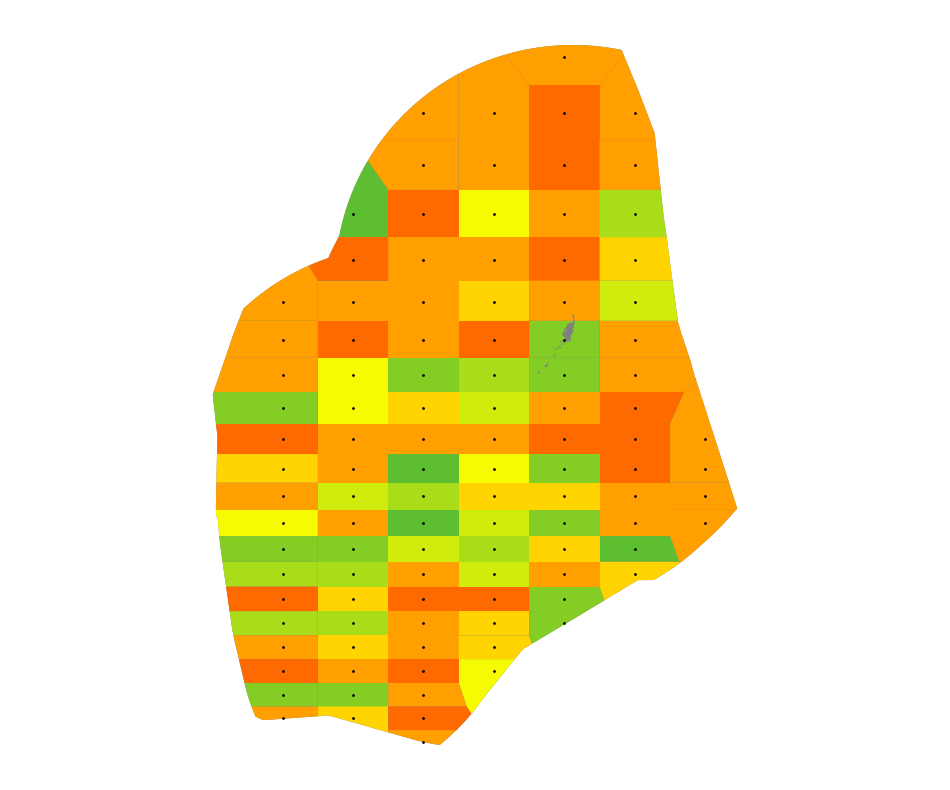

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2063_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


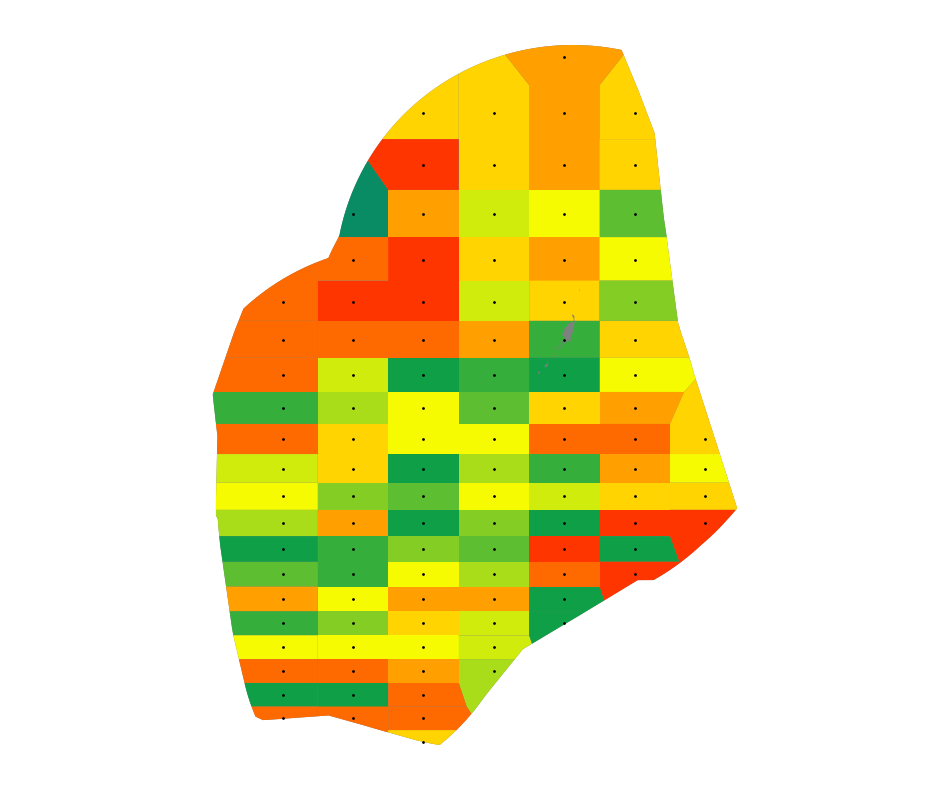

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2064_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


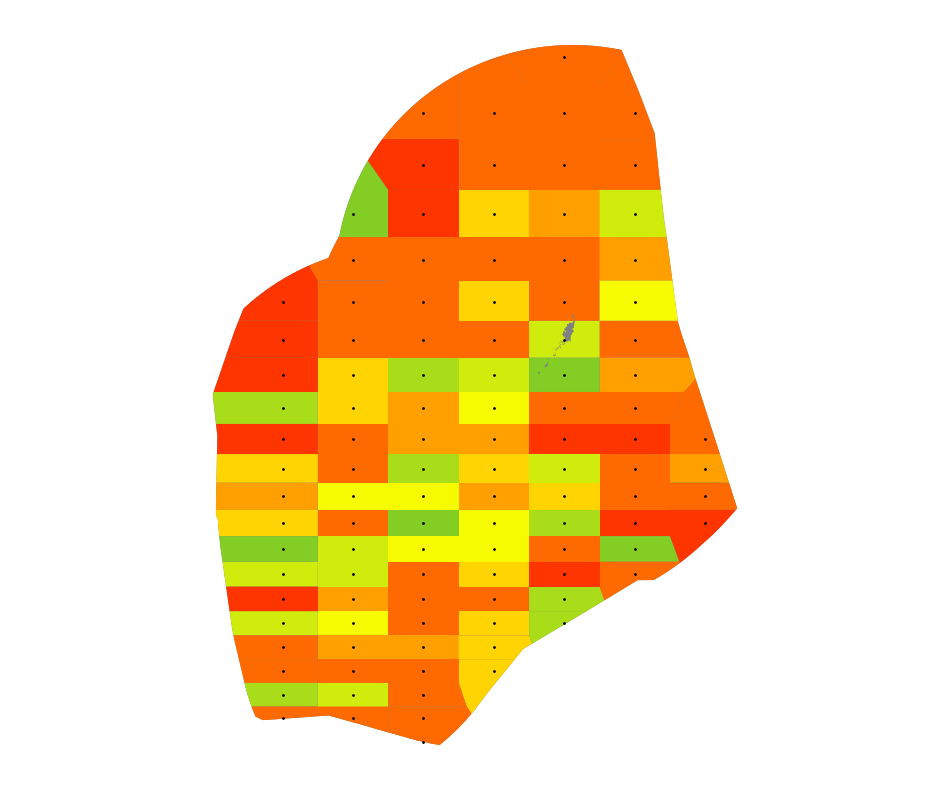

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2065_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


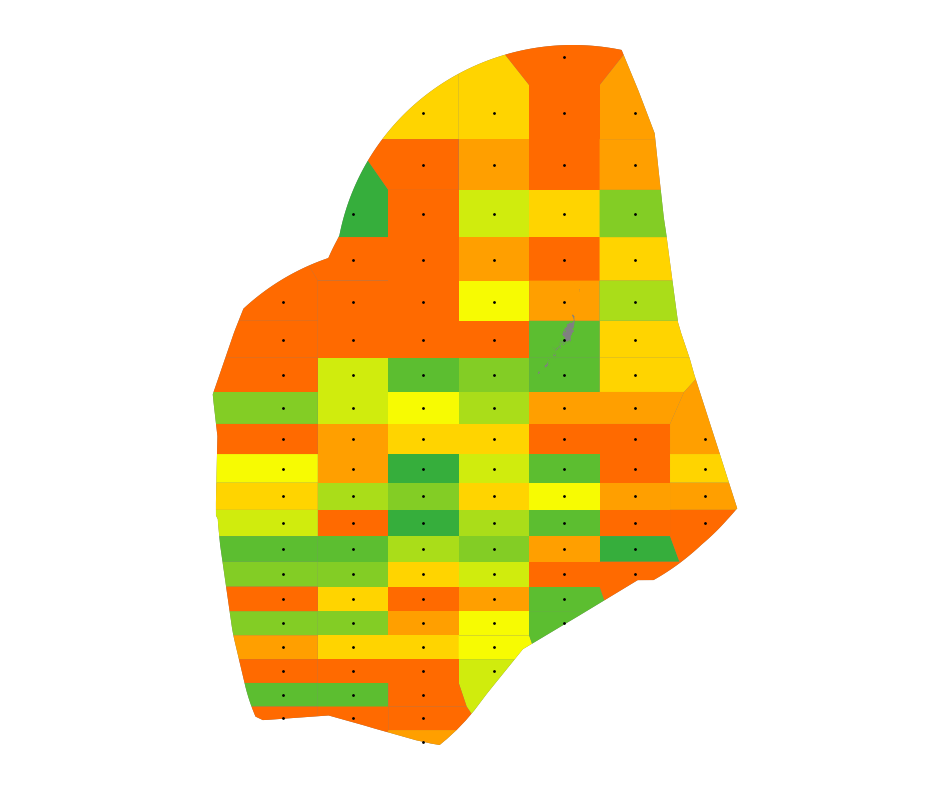

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2066_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


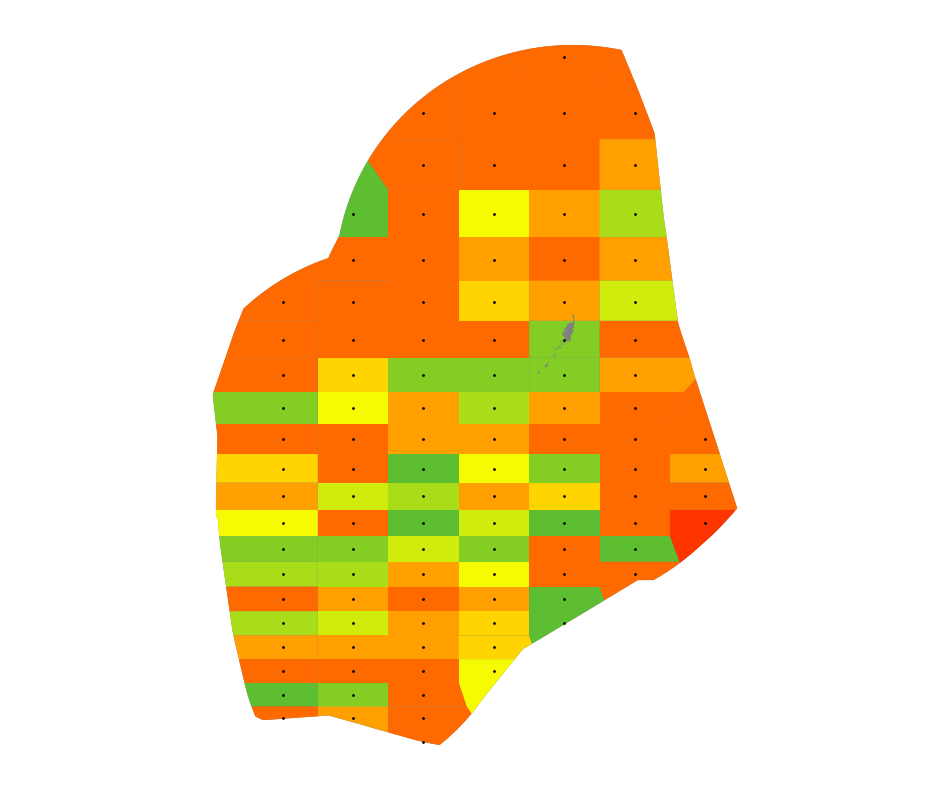

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2067_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


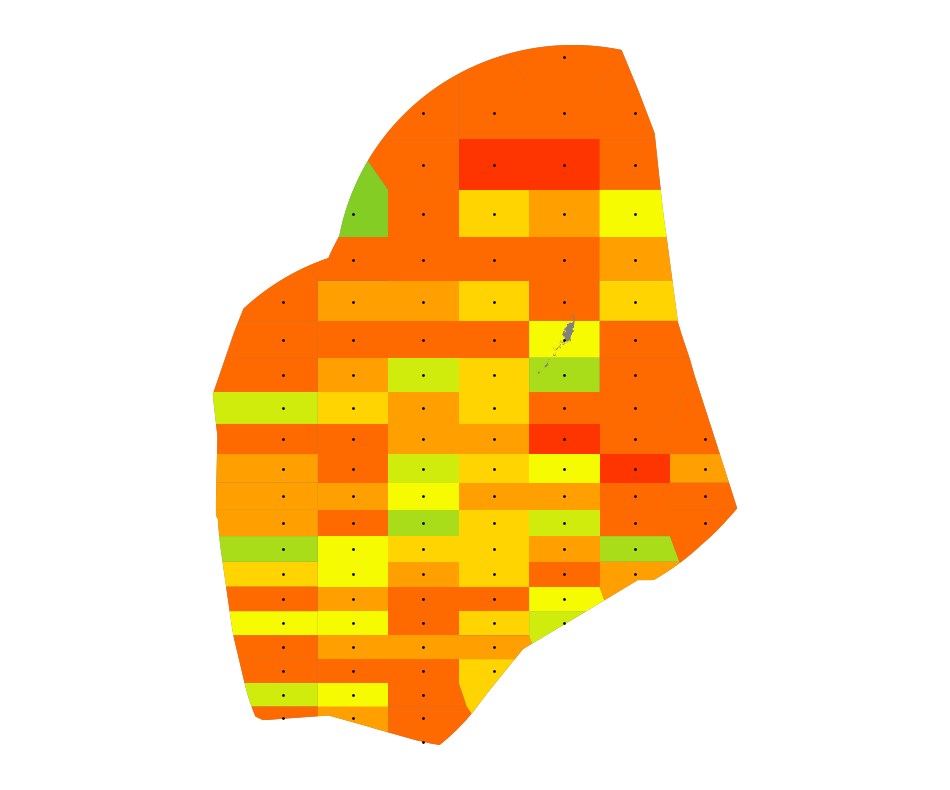

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2068_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


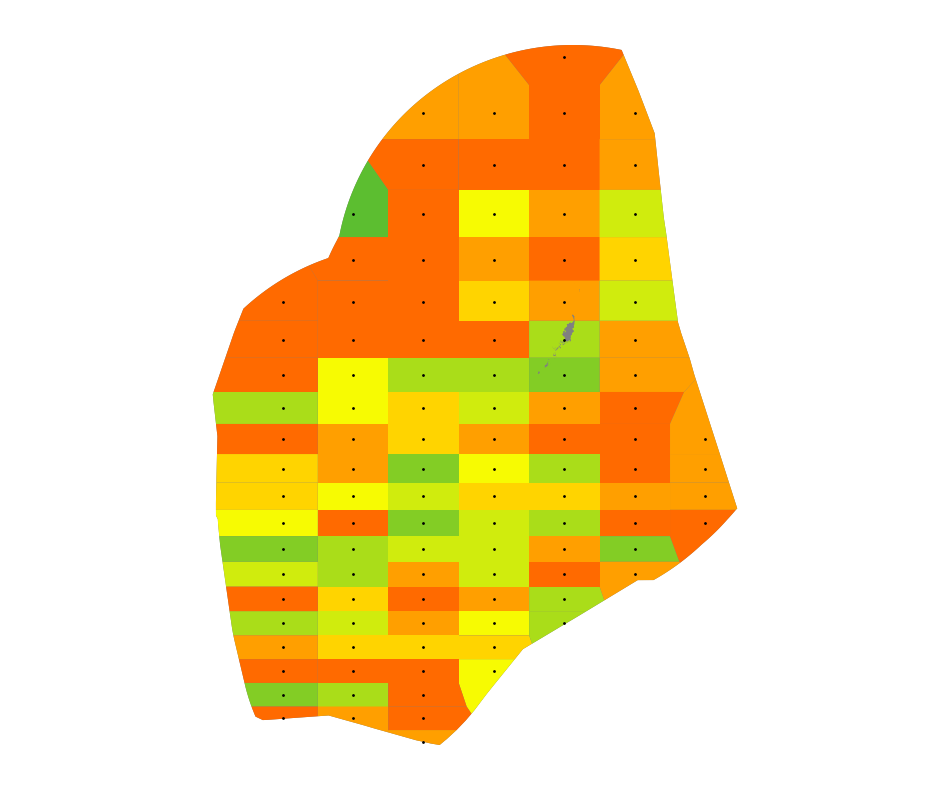

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2069_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


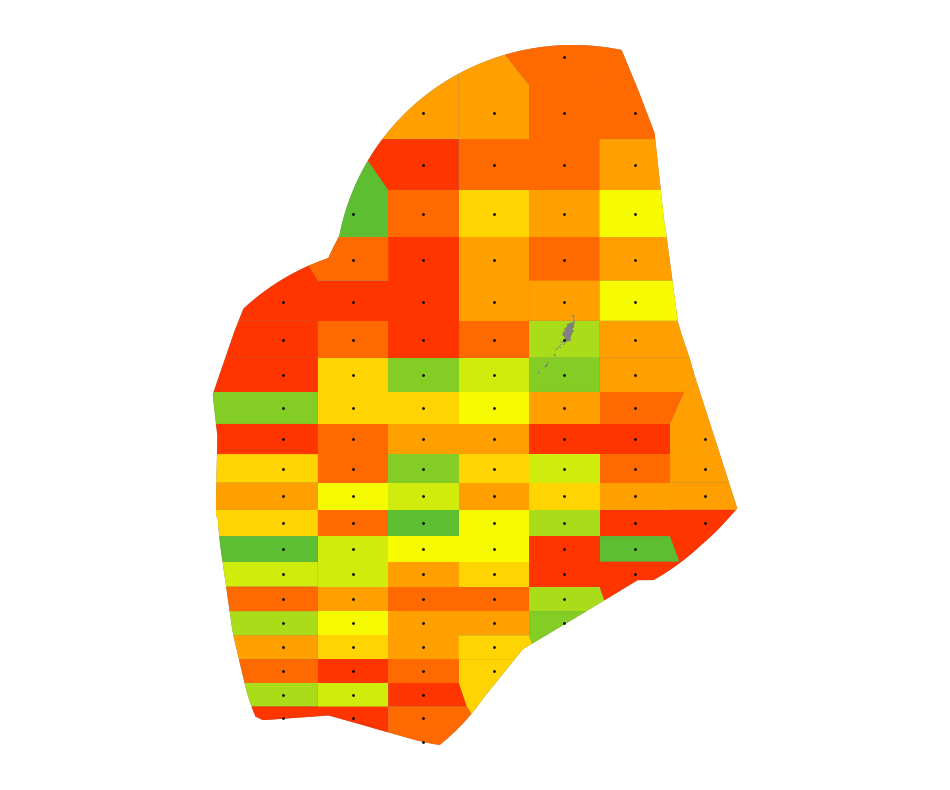

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2070_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


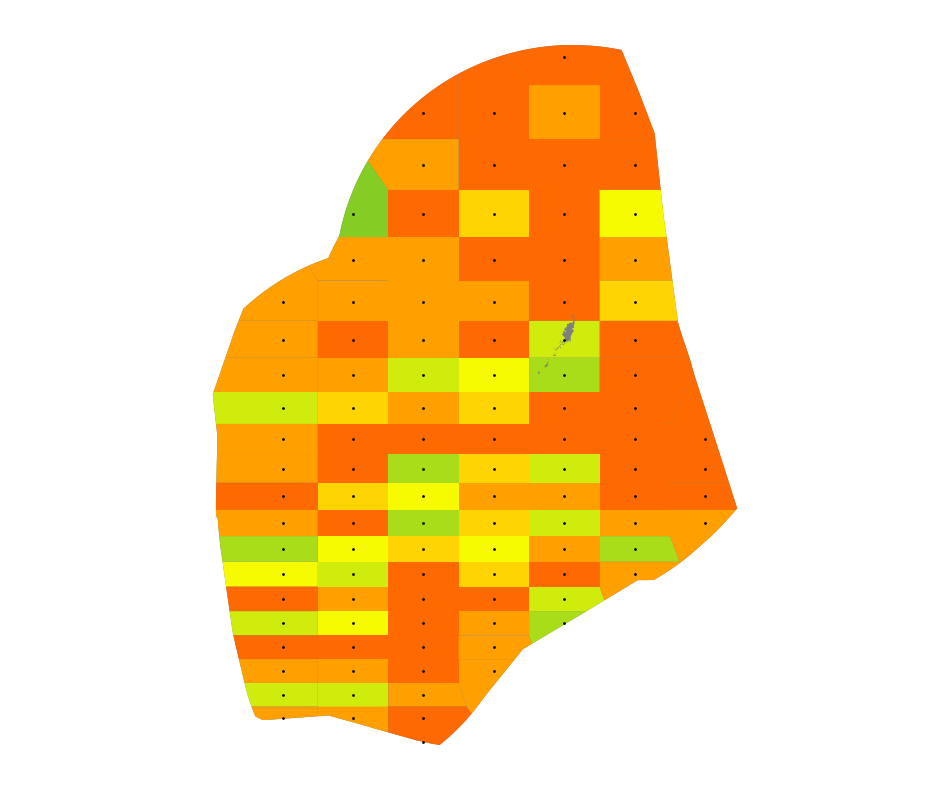

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2071_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


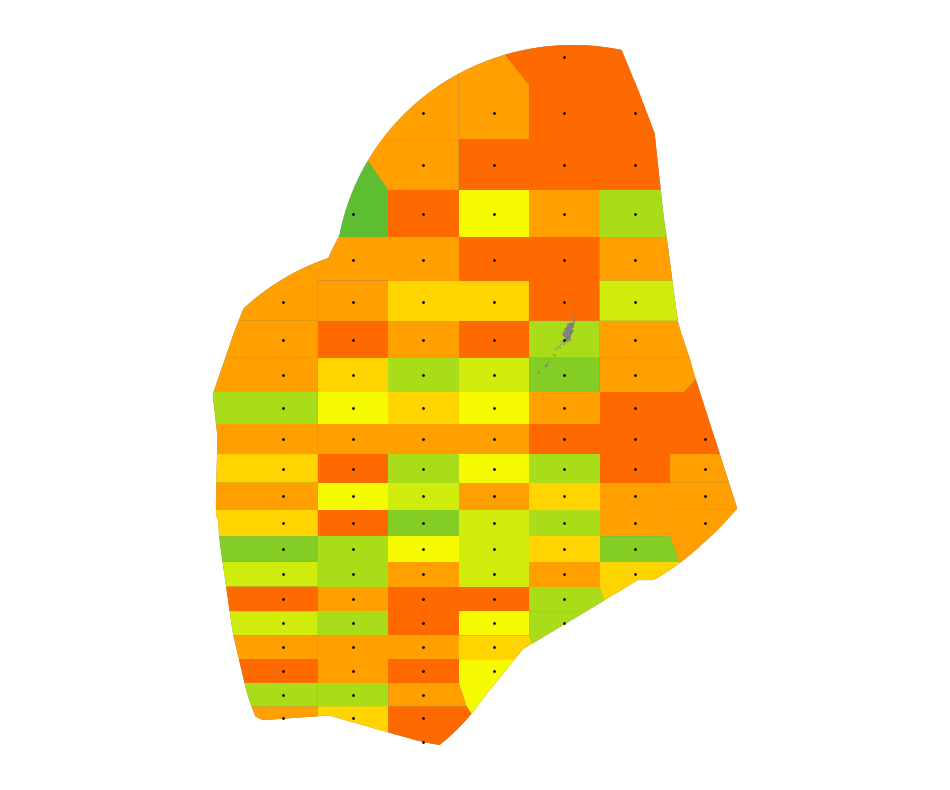

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2072_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


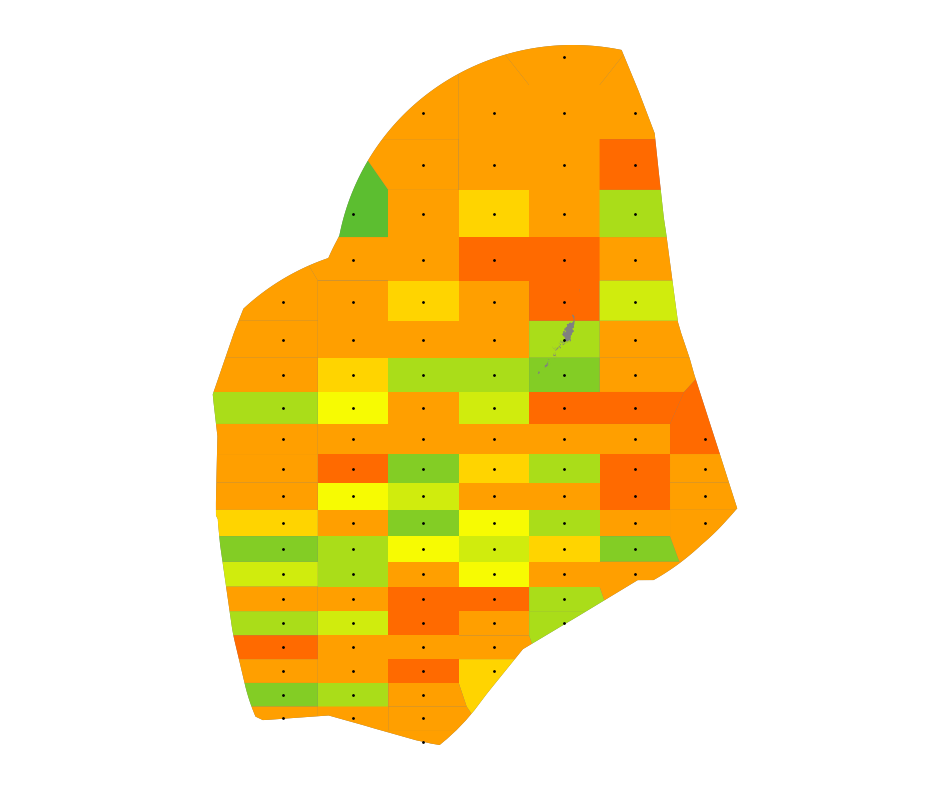

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2073_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


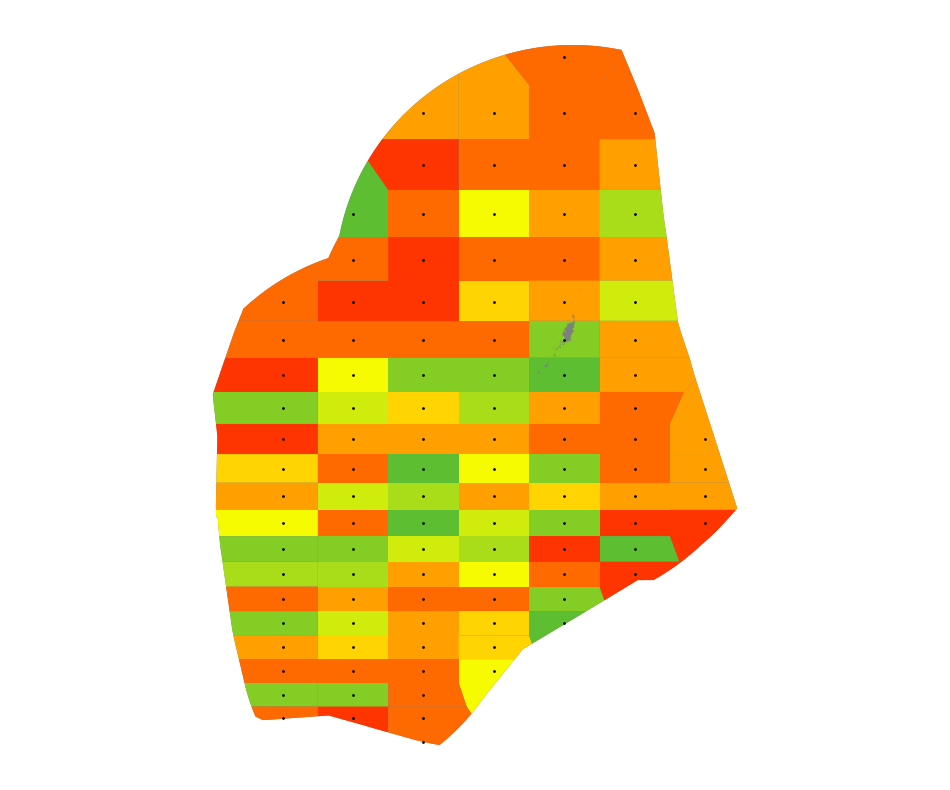

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2074_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


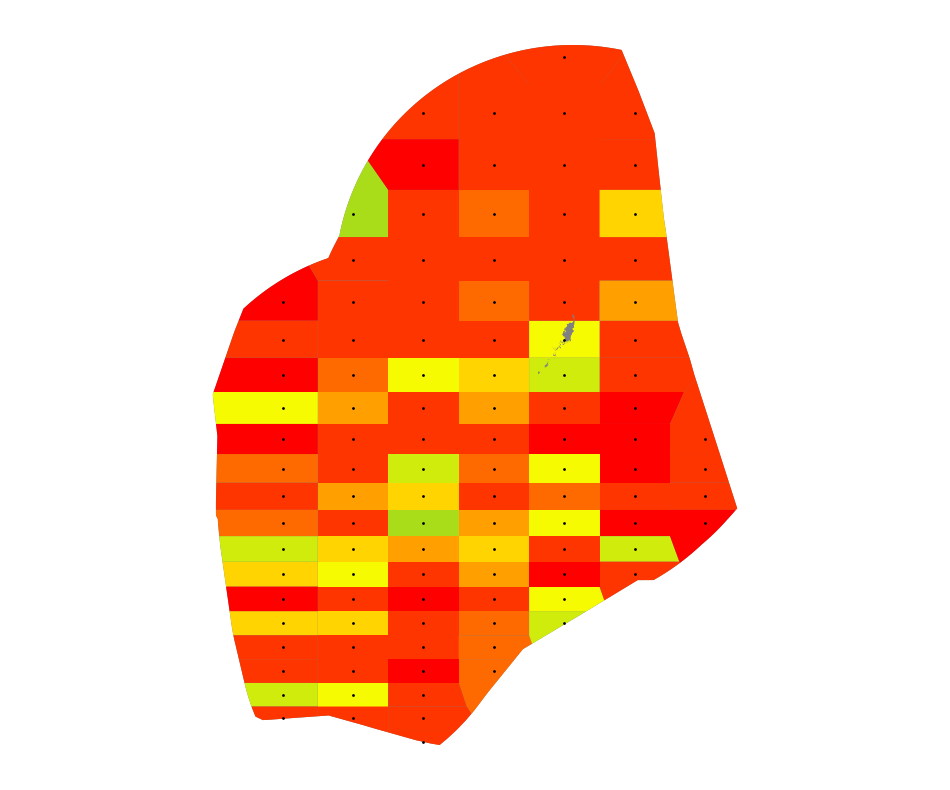

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2075_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


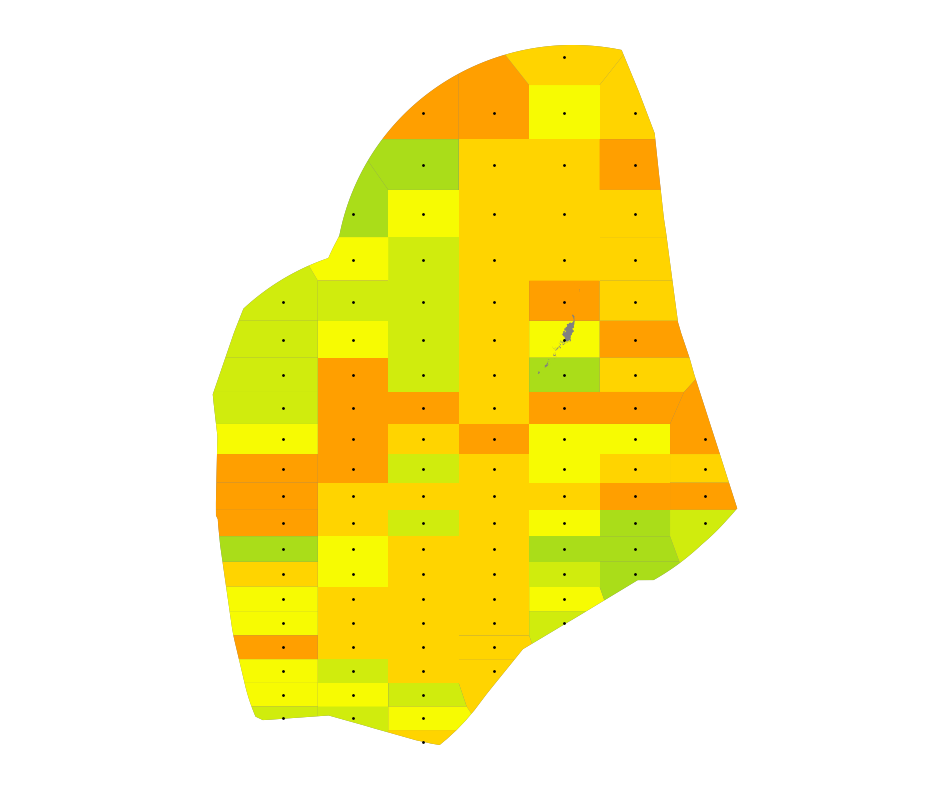

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2076_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


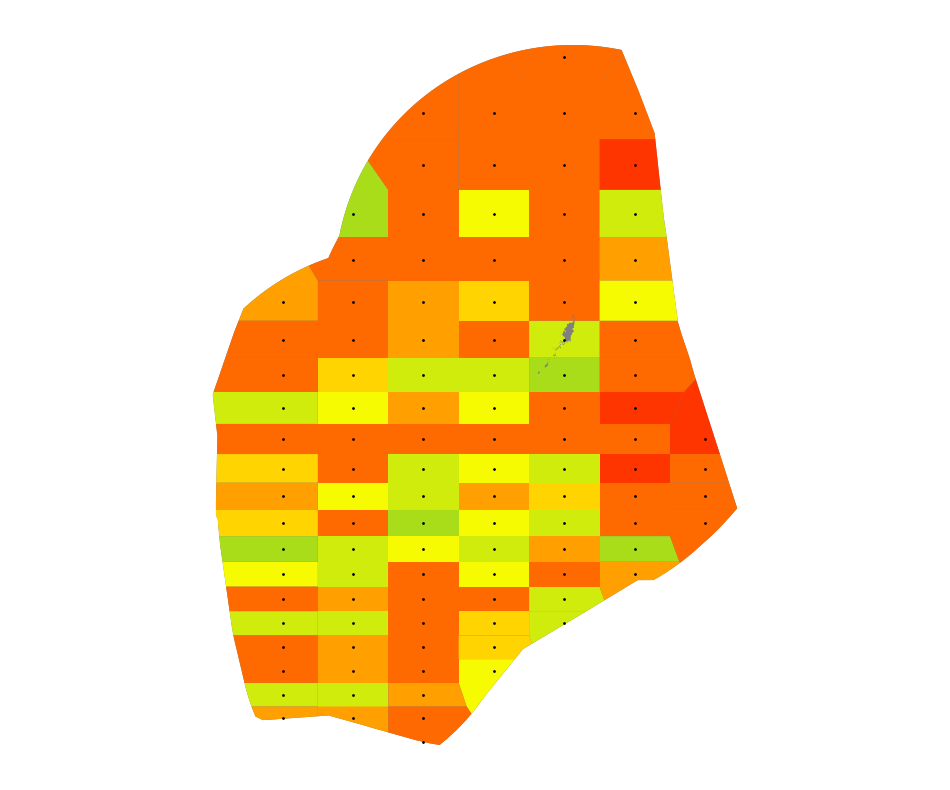

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2077_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


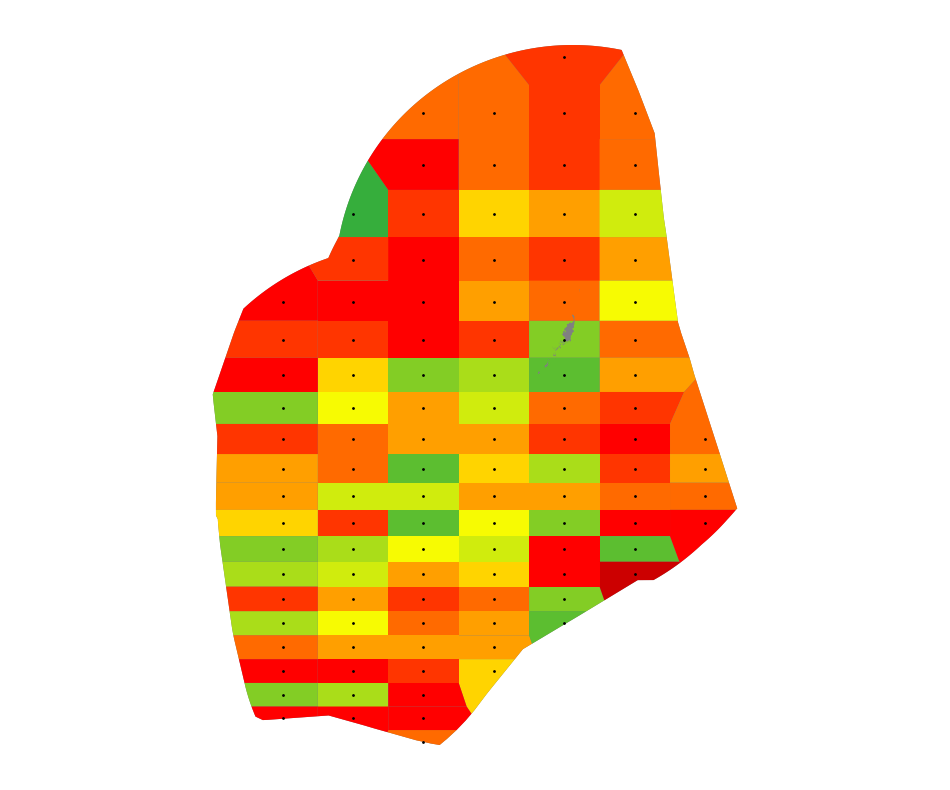

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2078_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


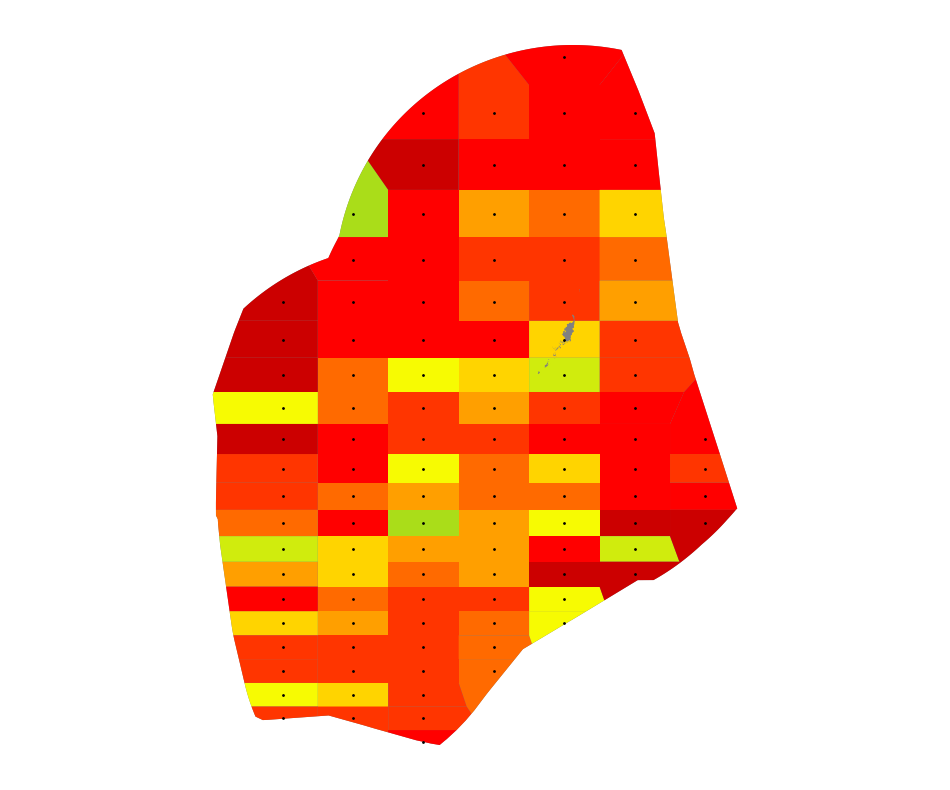

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2079_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


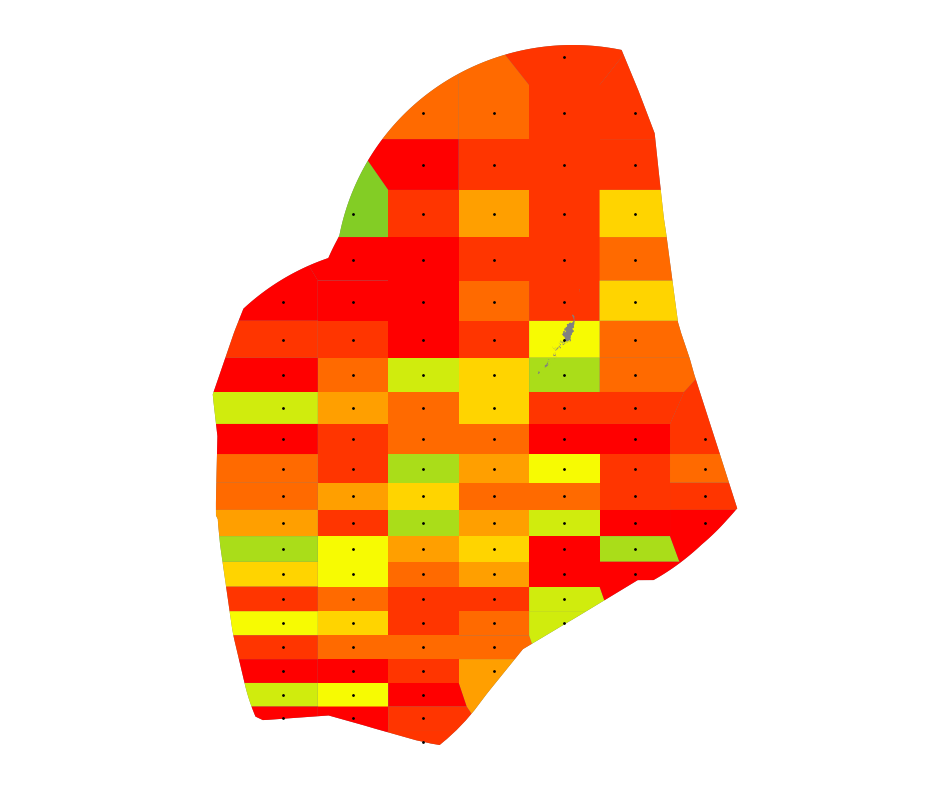

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2080_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


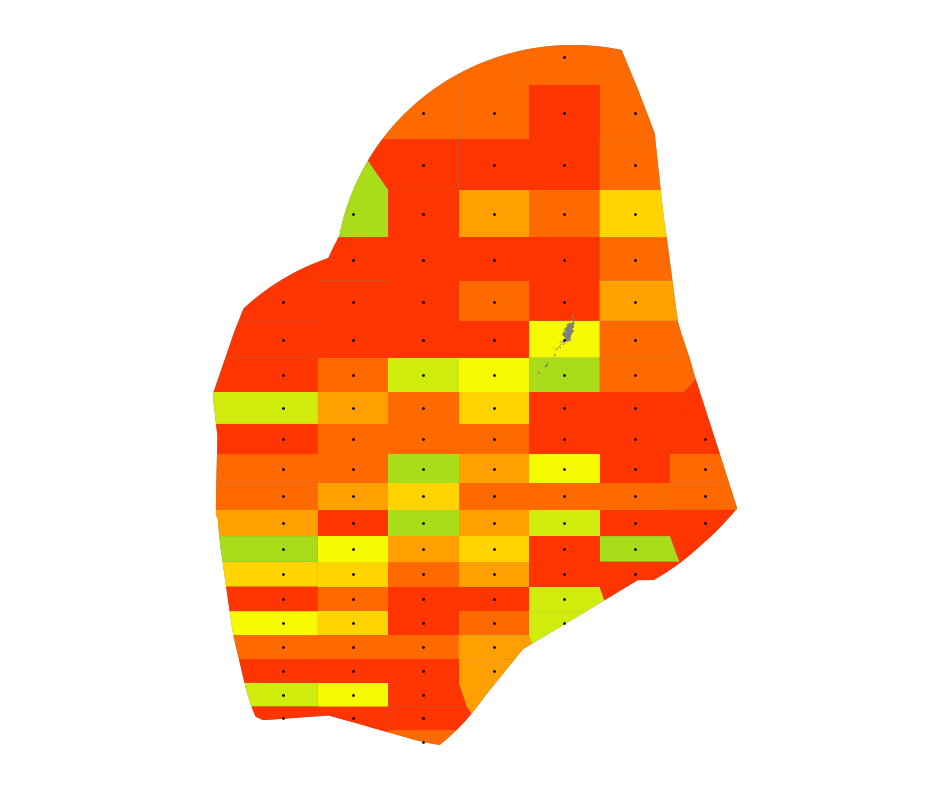

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2081_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


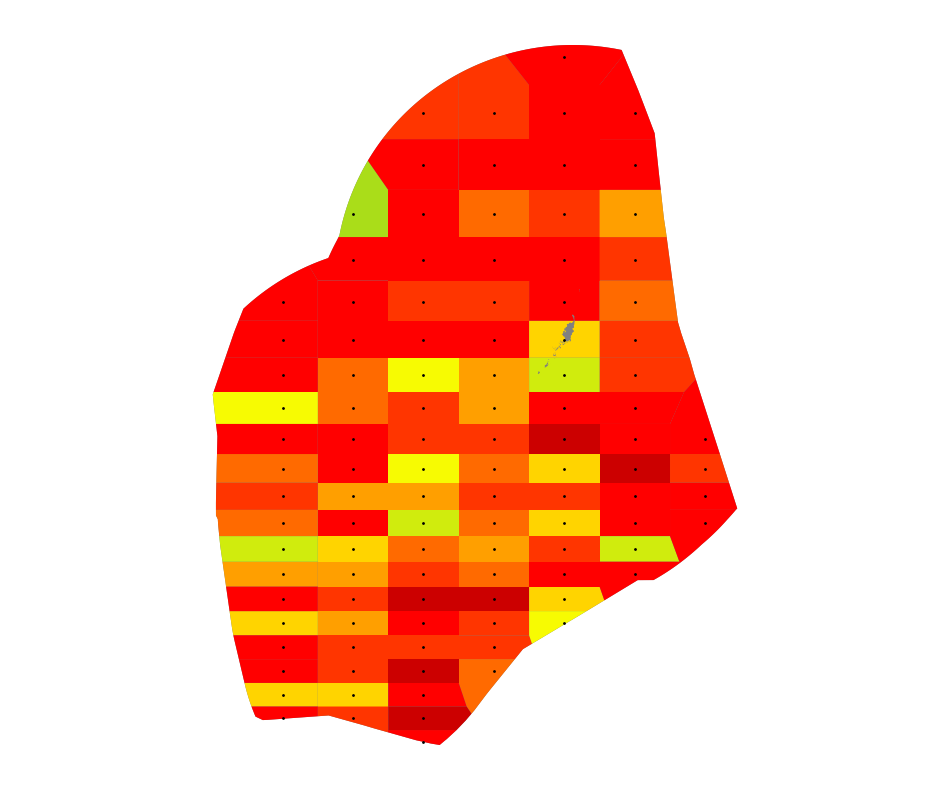

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2082_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


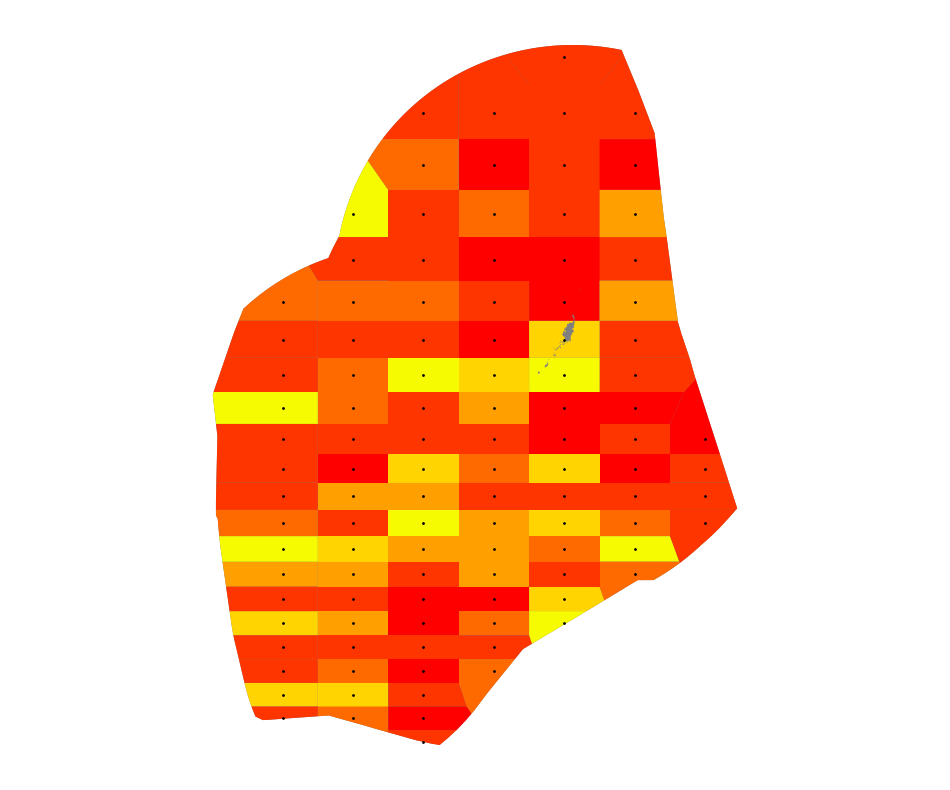

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2083_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


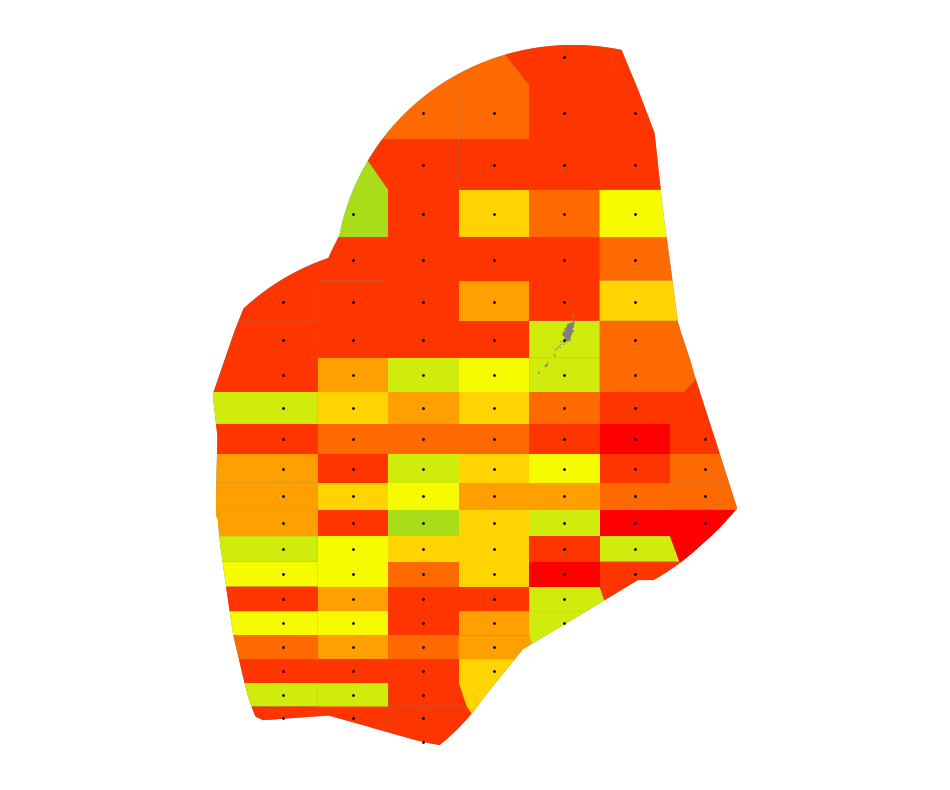

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2084_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


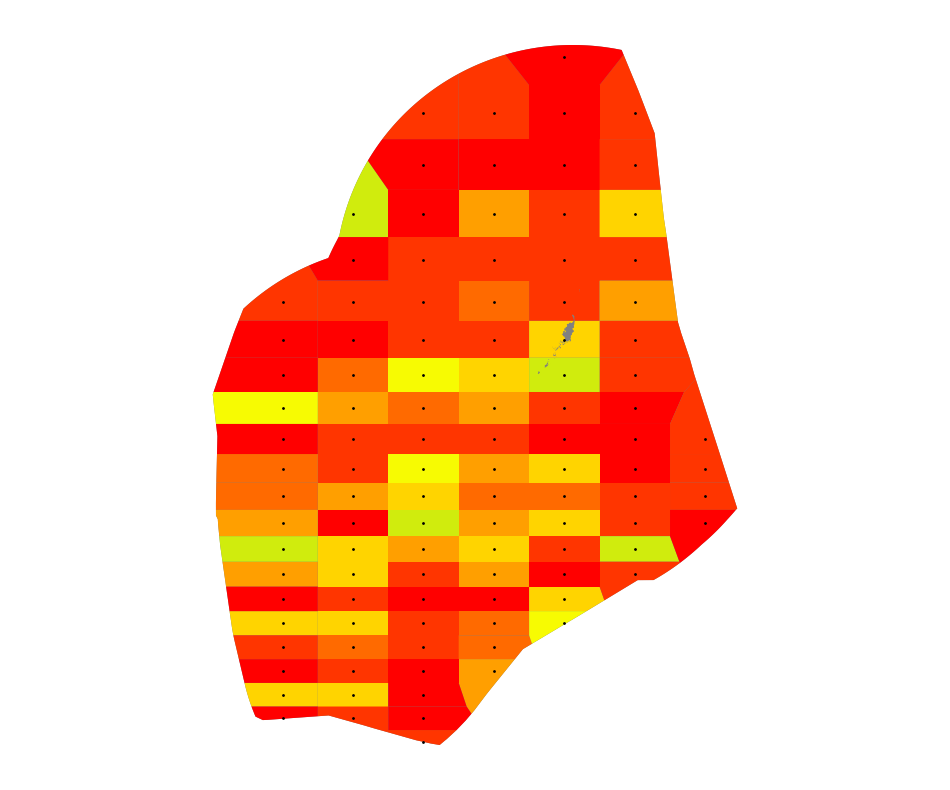

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2085_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


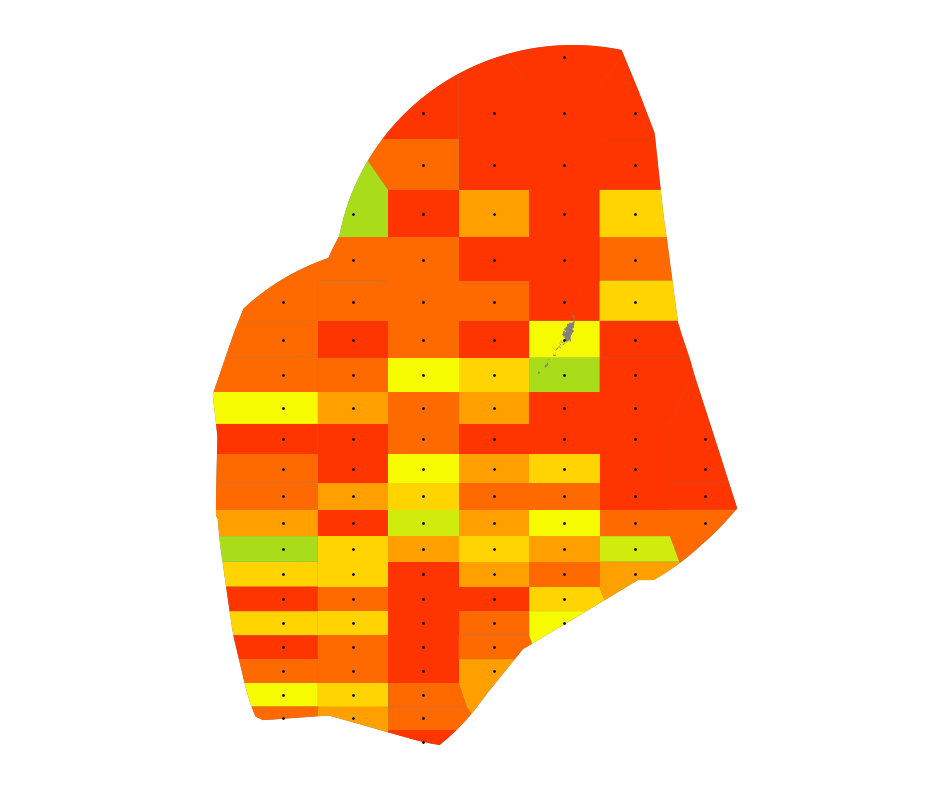

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2086_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


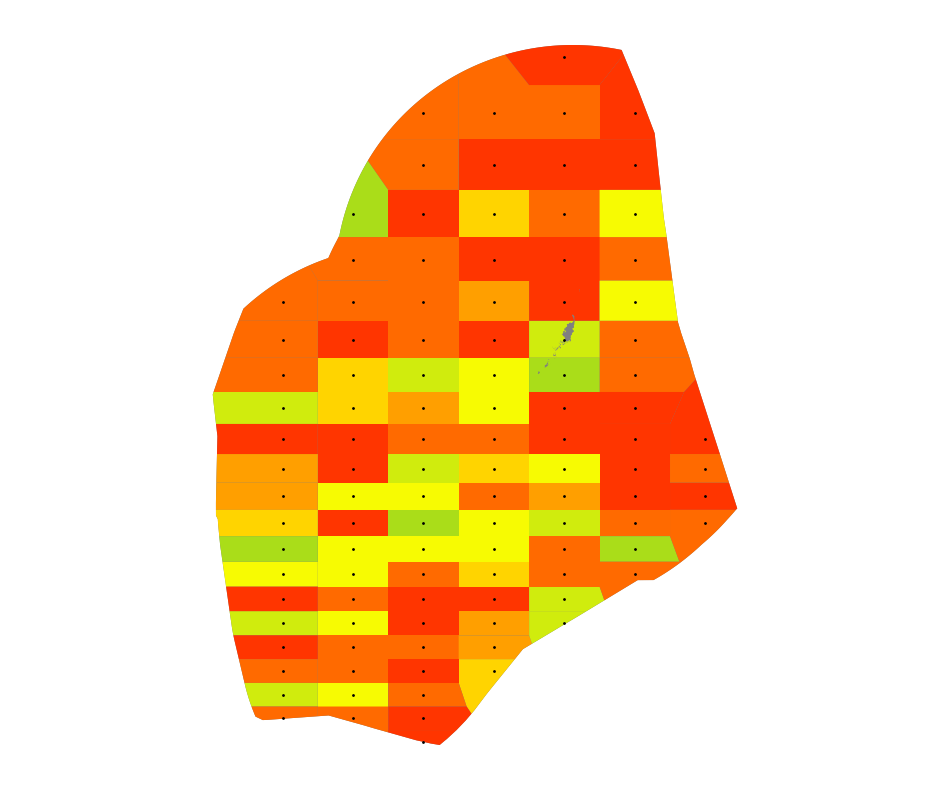

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2087_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


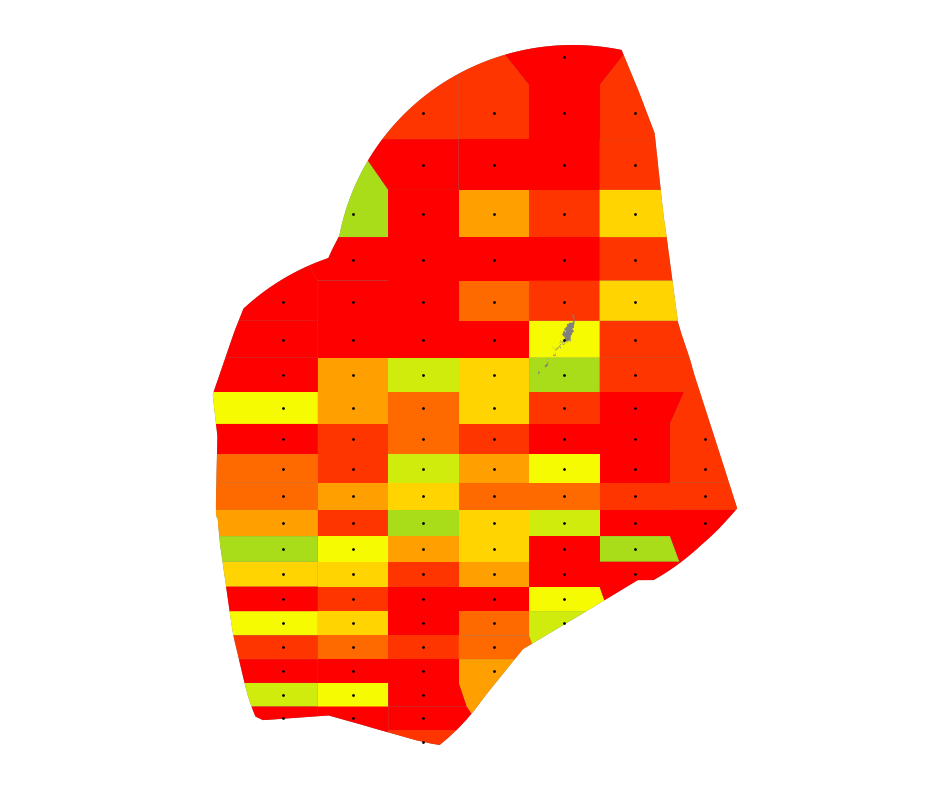

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2088_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


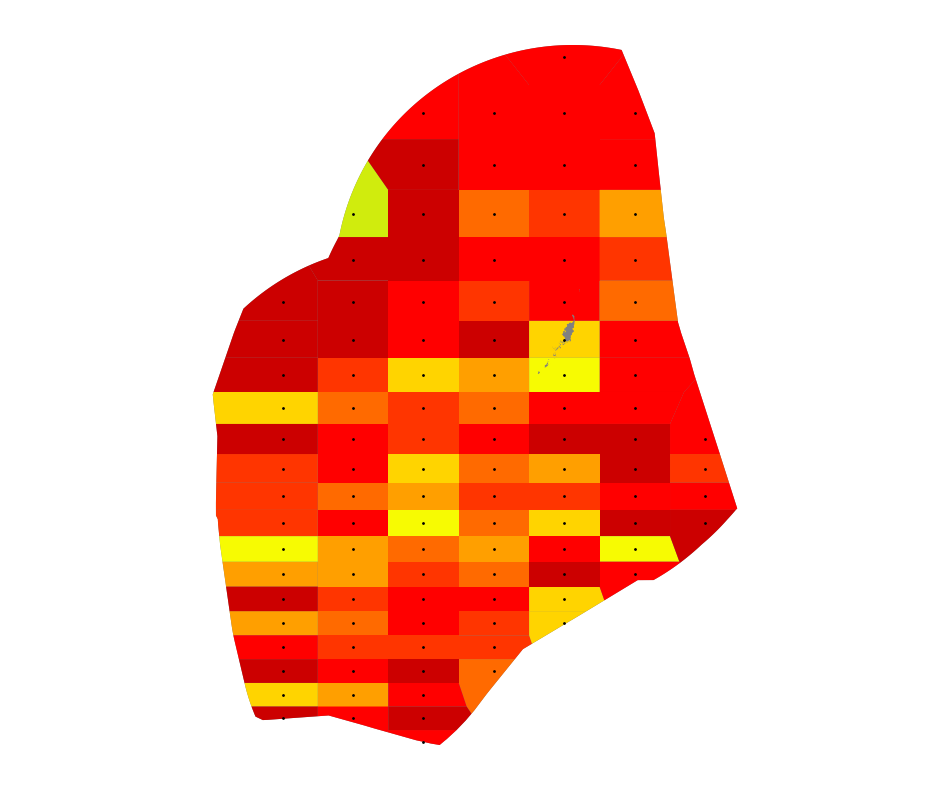

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2089_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


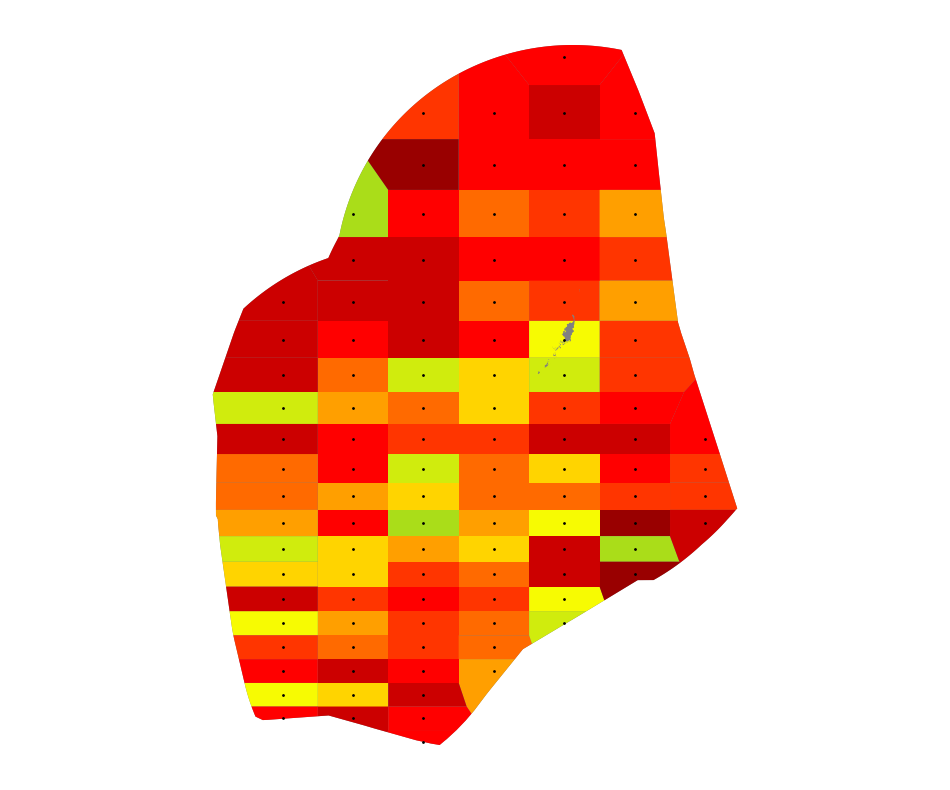

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2090_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


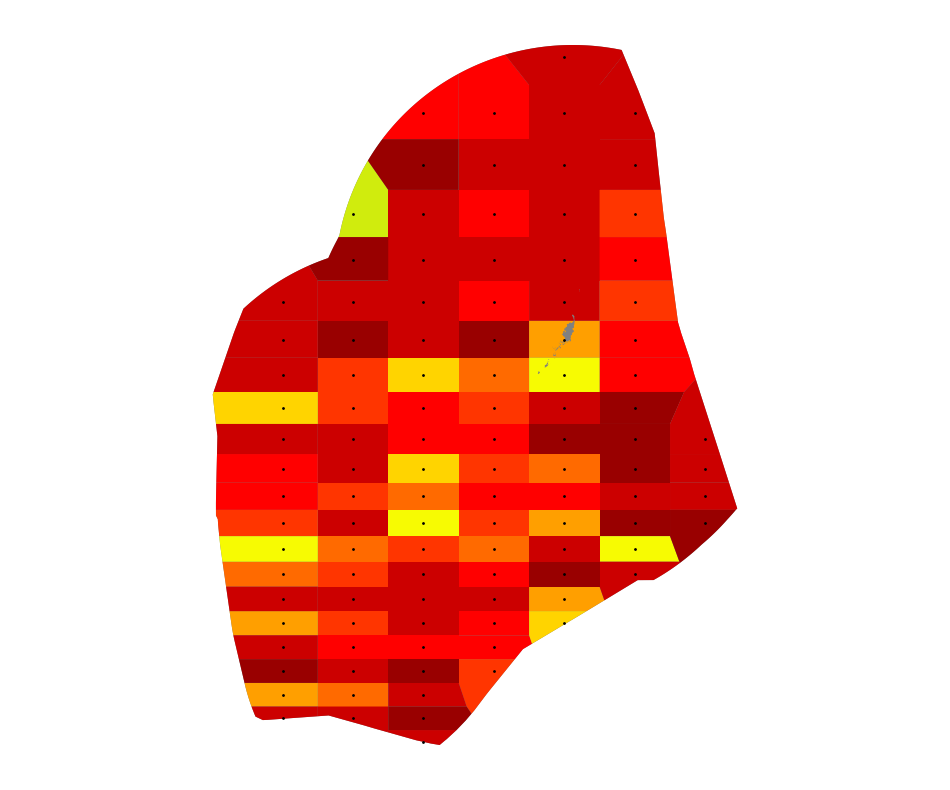

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2091_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


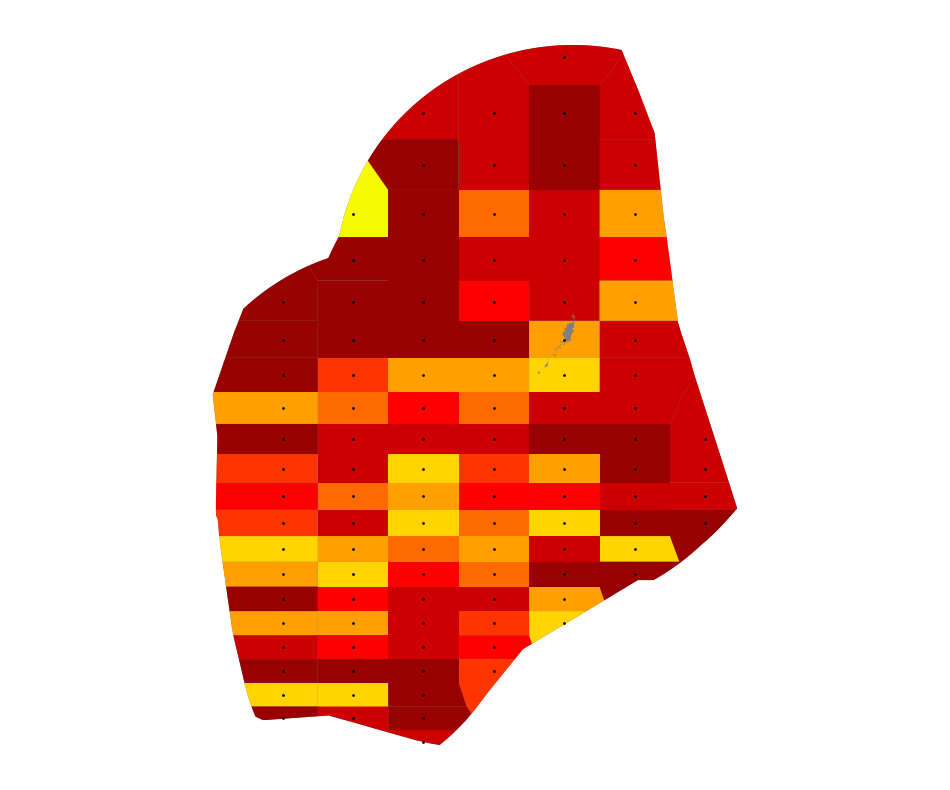

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2092_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


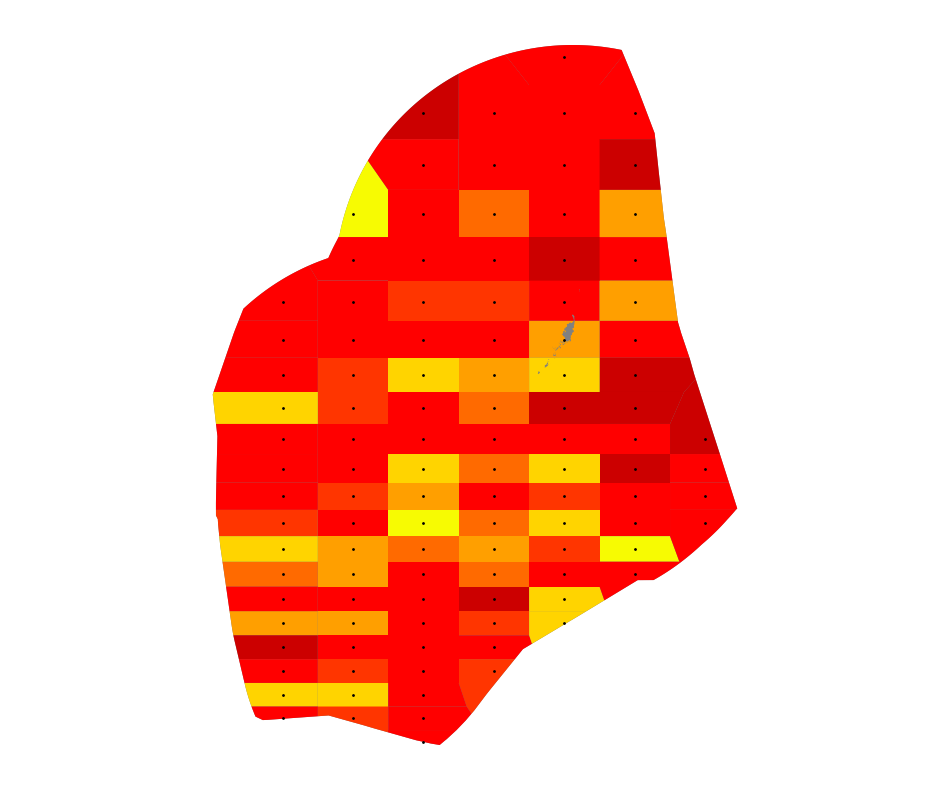

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2093_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


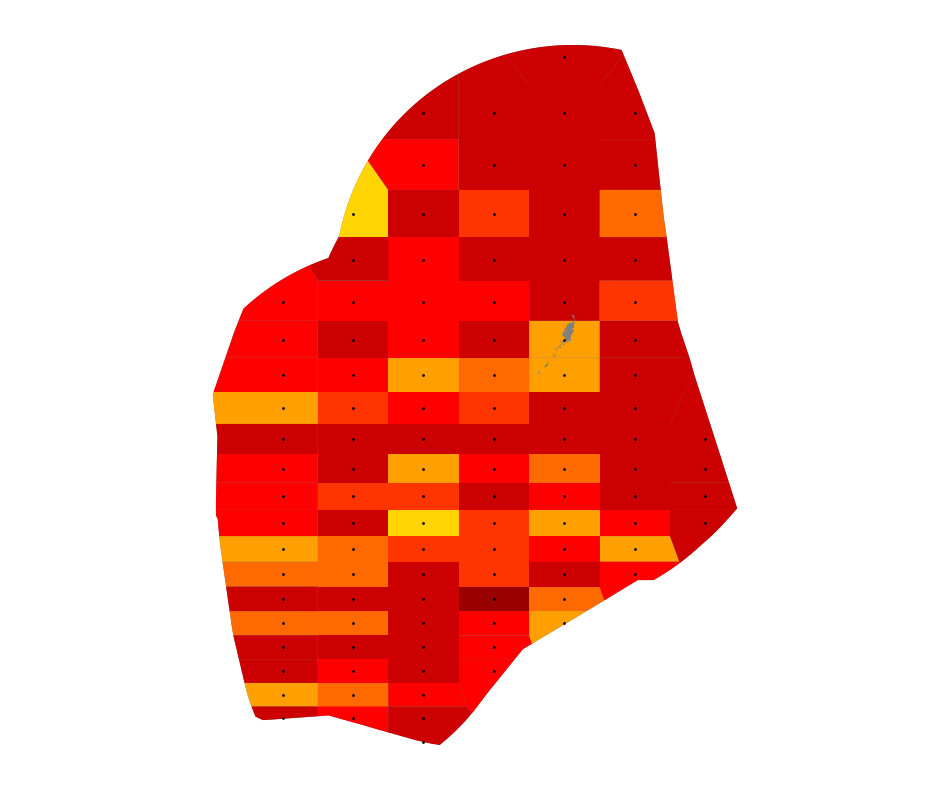

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2094_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


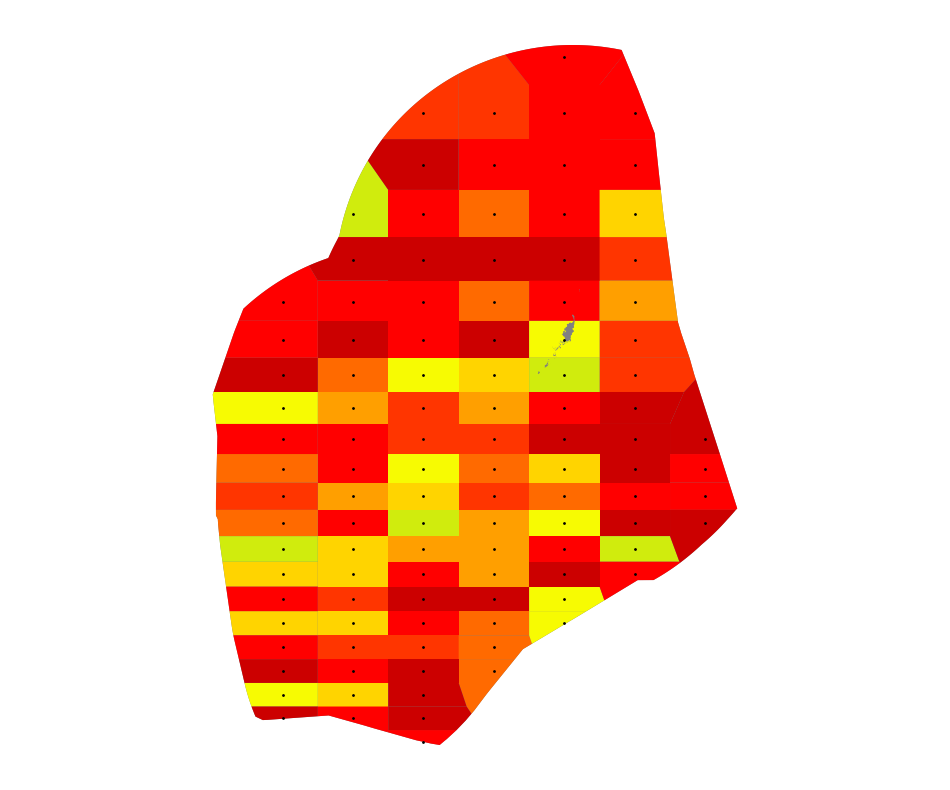

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2095_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


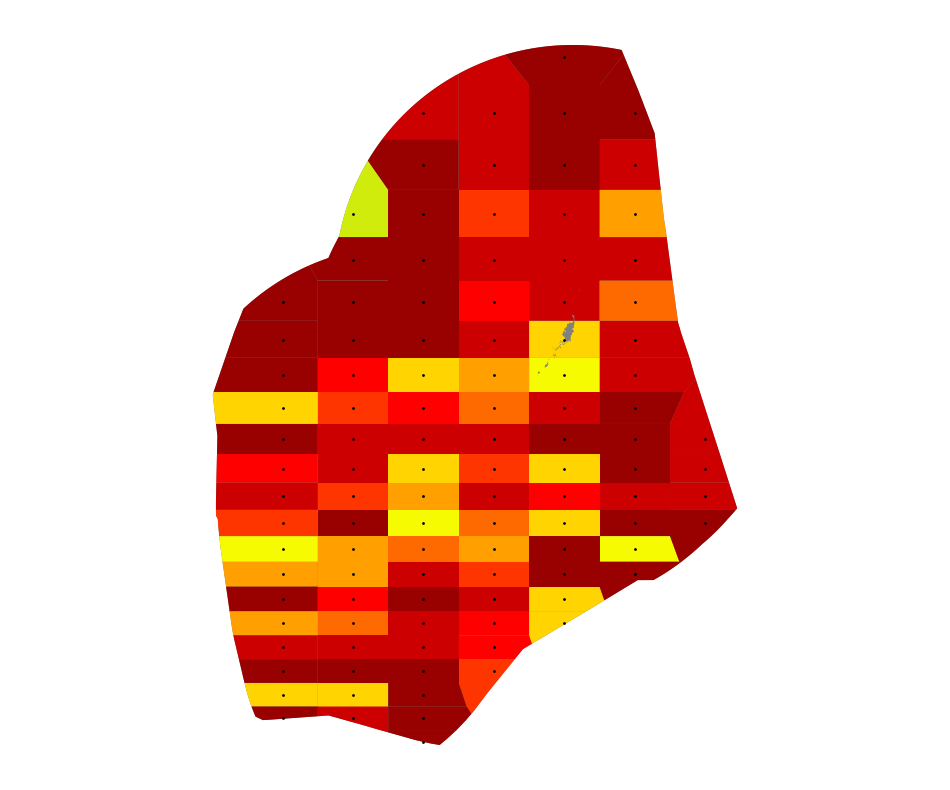

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2096_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


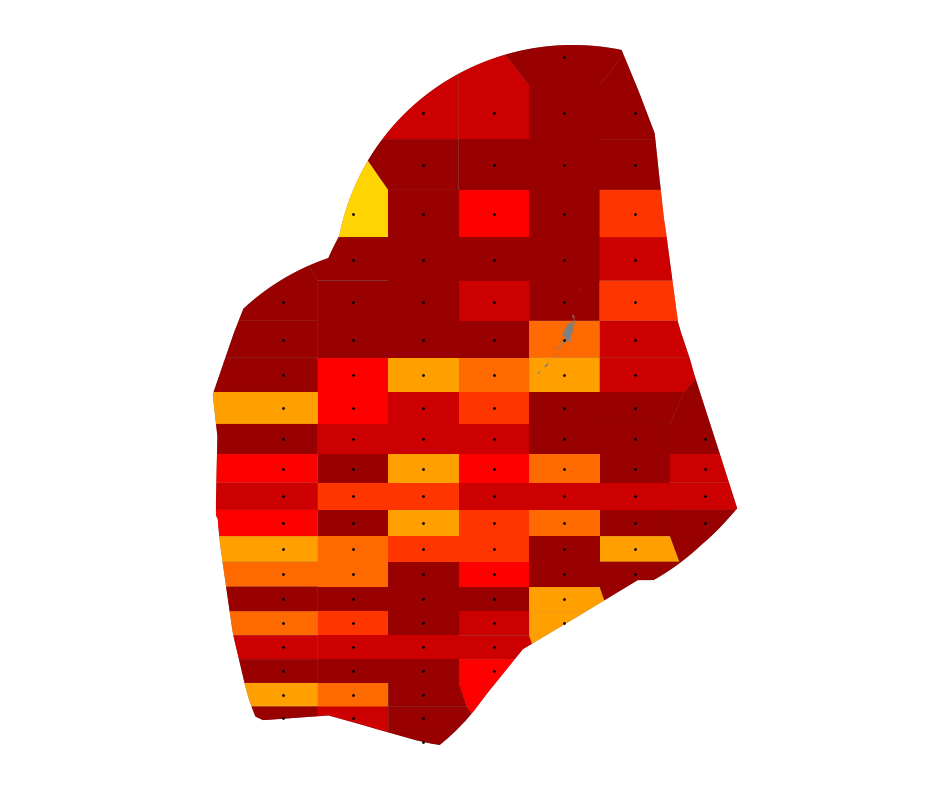

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2097_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


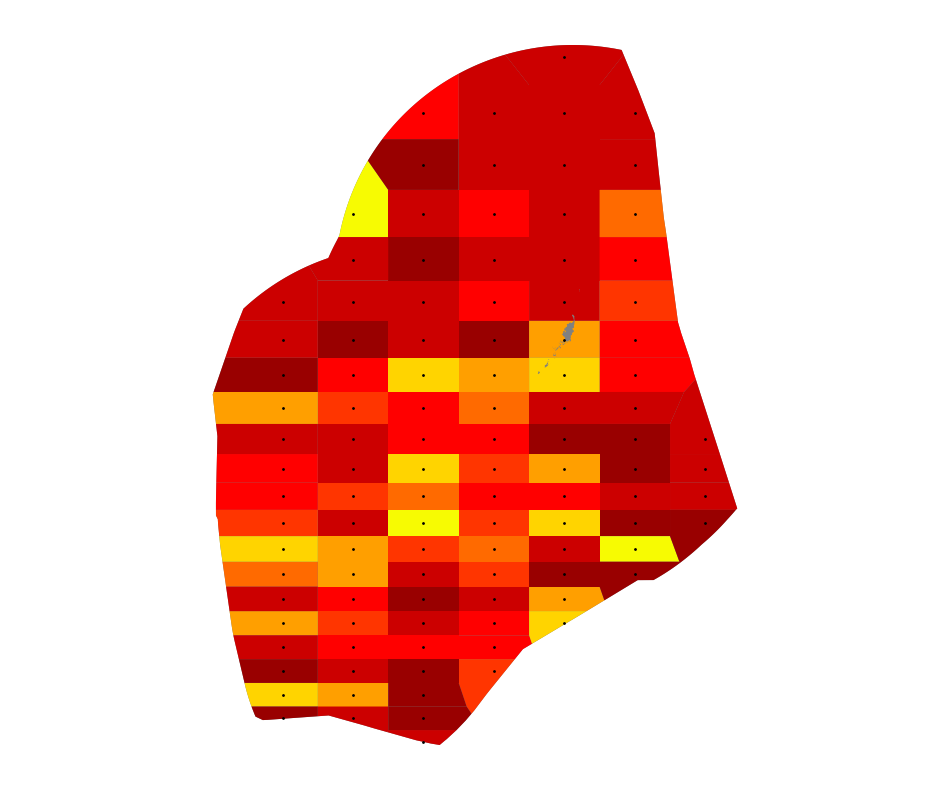

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2098_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


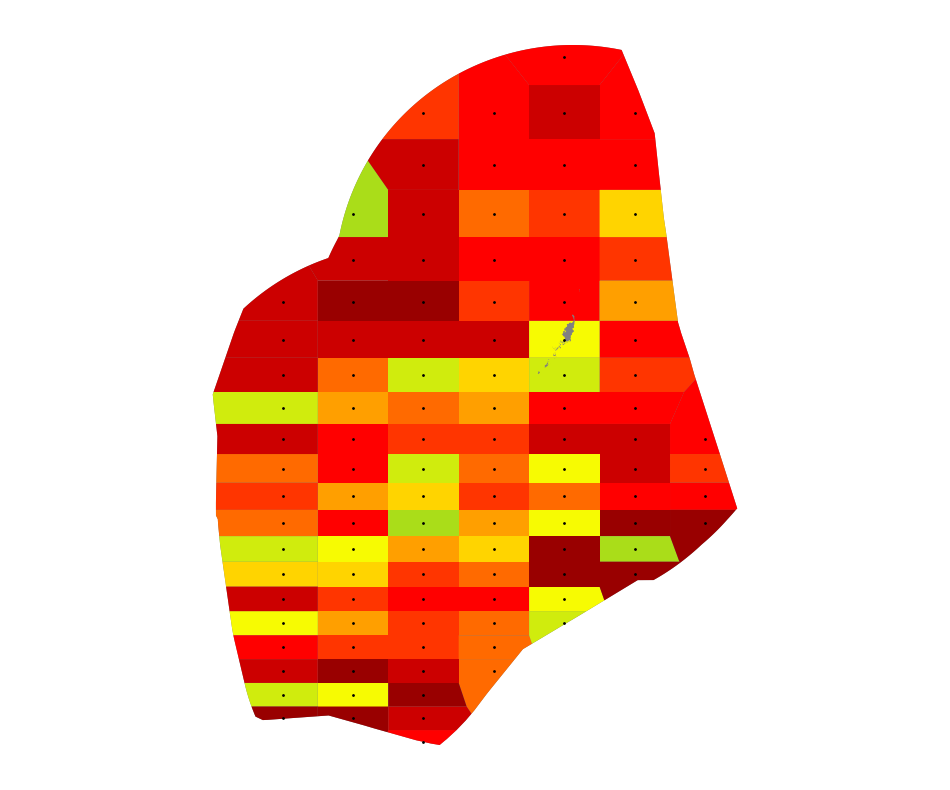

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2099_tos_Omon_CanESM5_ssp460_r4i1p1f1.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


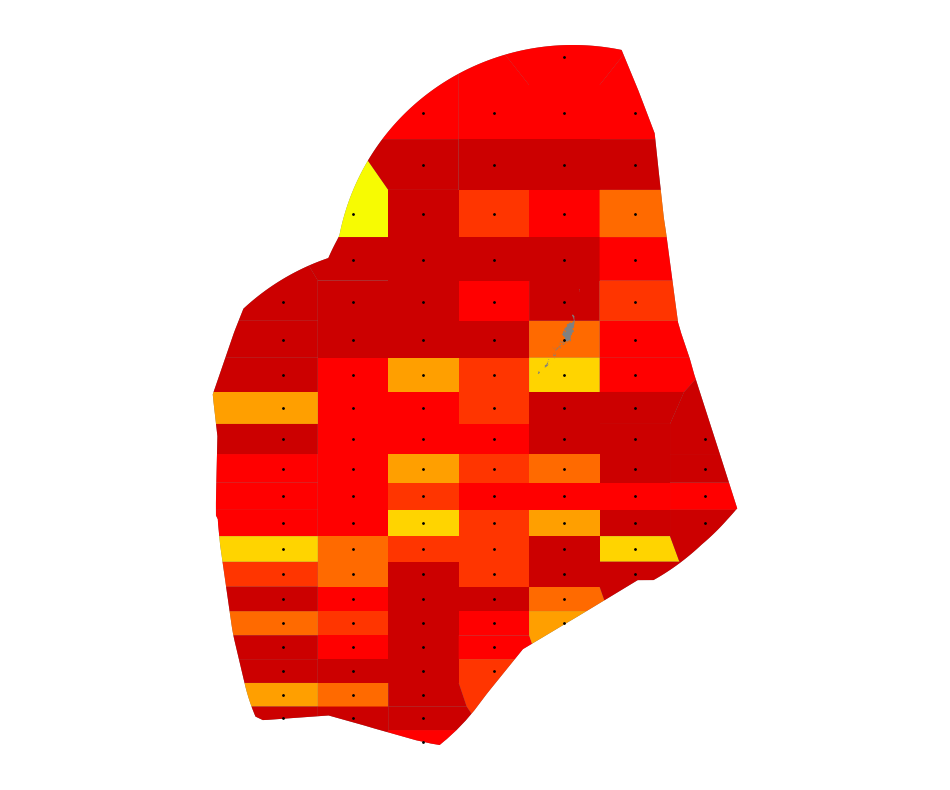

/Users/one/Documents/tosgeojson//tos_Omon_CanESM5_ssp460_r4i1p1f1/2100_tos_Omon_CanESM5_ssp460_r4i1p1f1.json
HadGEM3-GC31-MM ssp585
latlon_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3_.pkl
Created: 2015-2100_colorbar_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.png


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


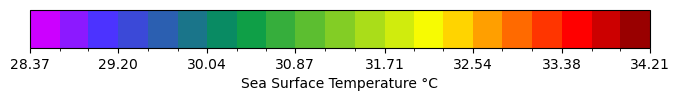

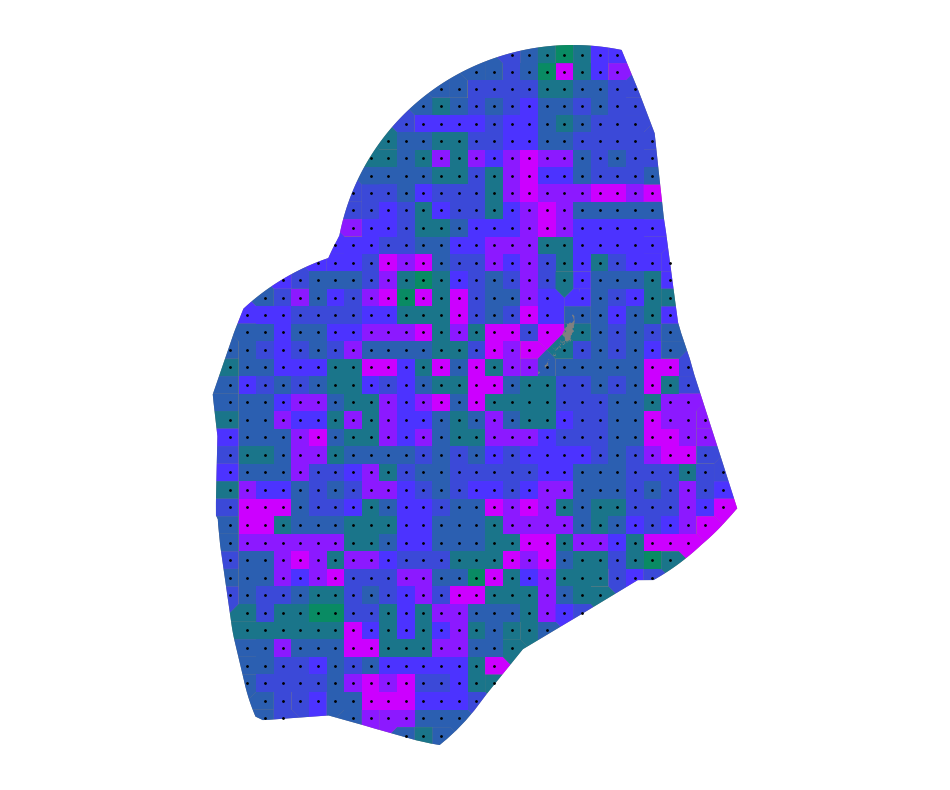

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2015_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


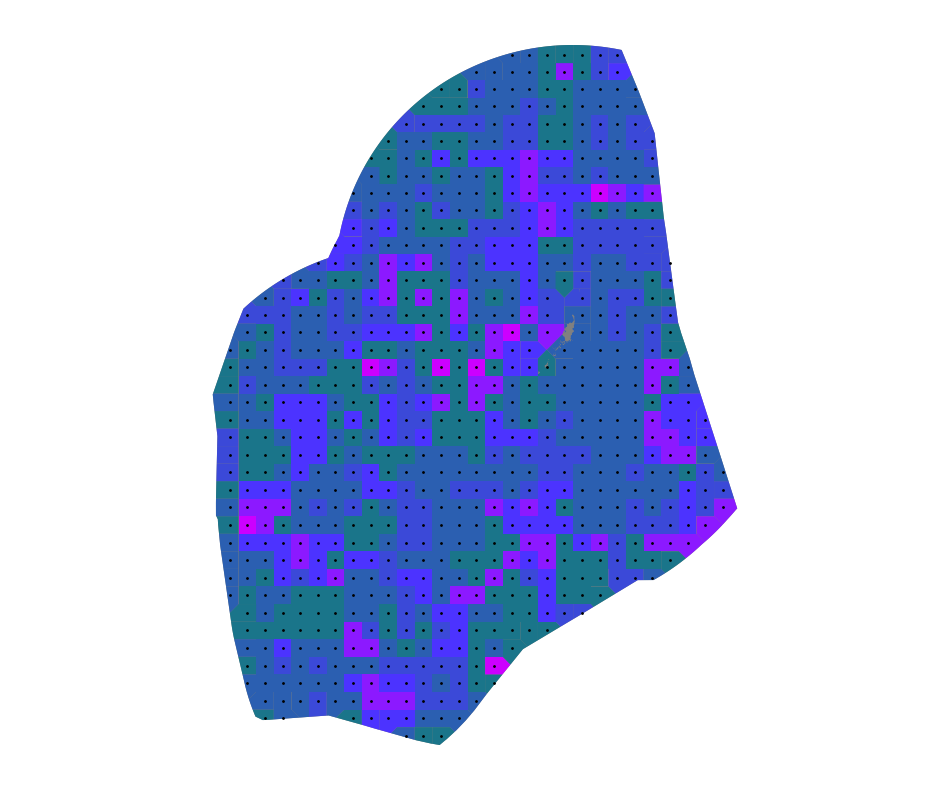

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2016_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


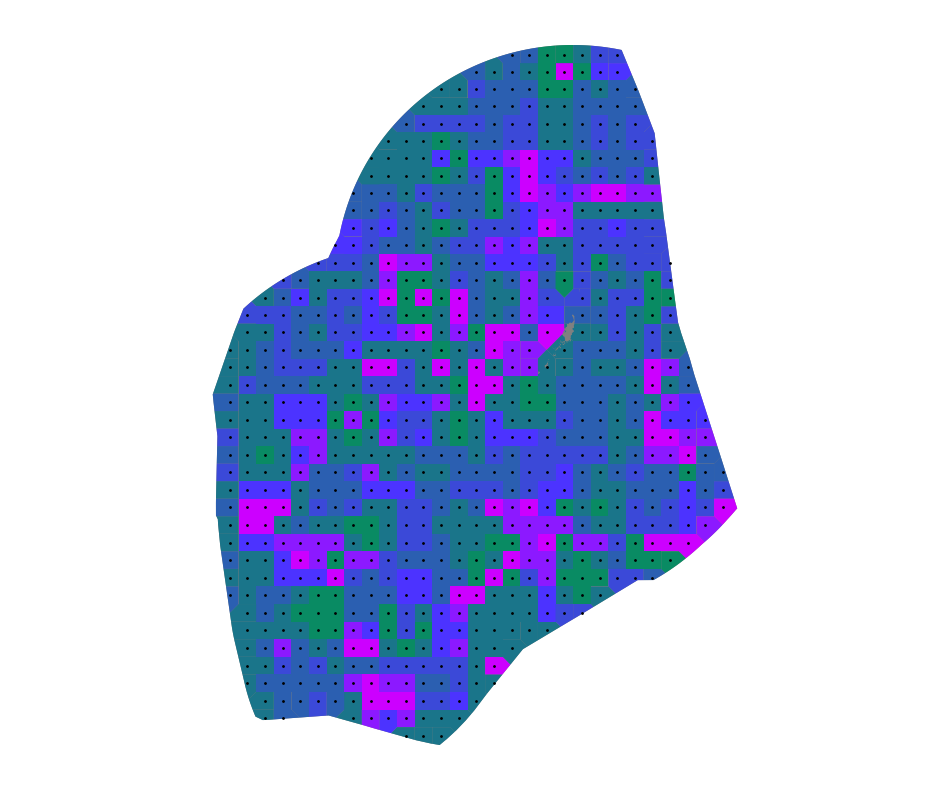

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2017_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


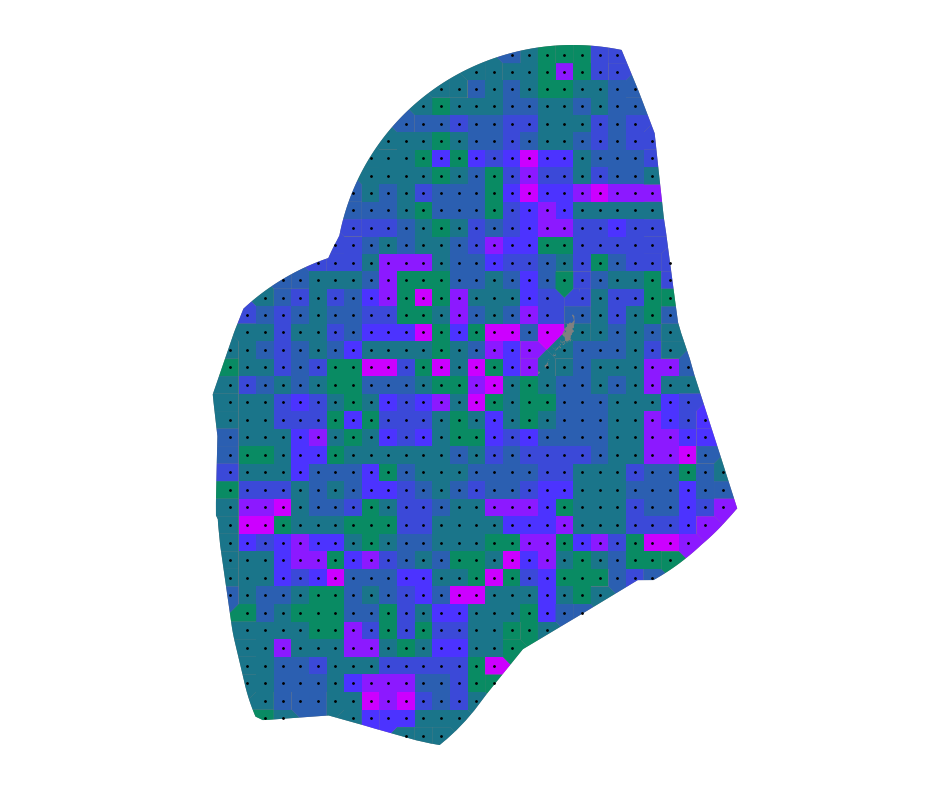

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2018_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


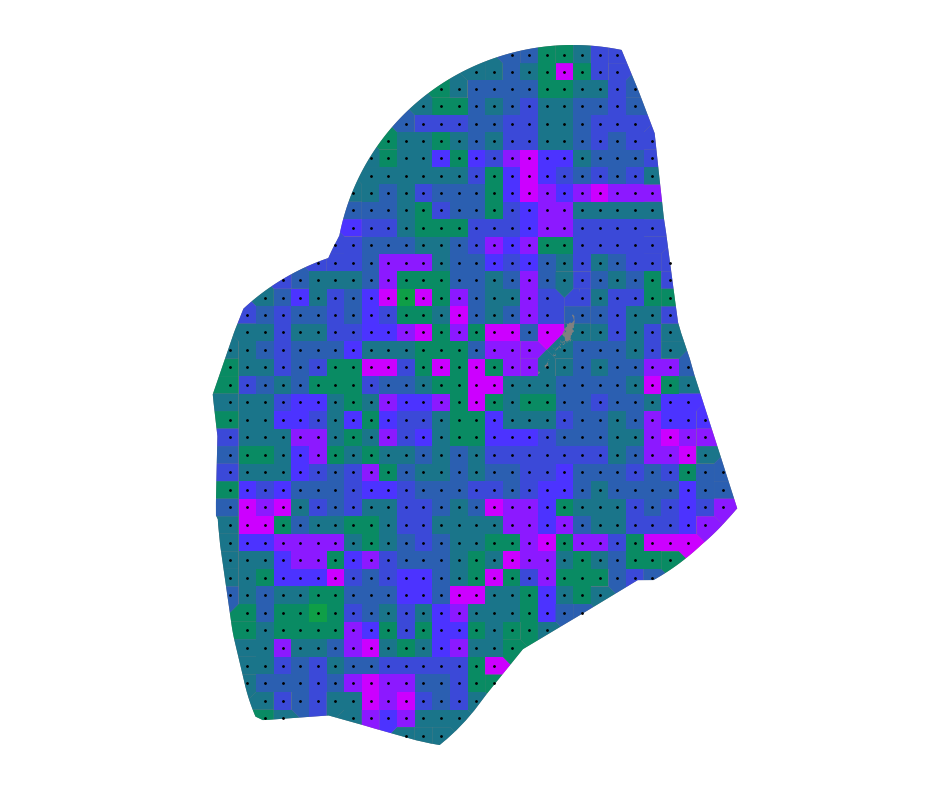

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2019_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


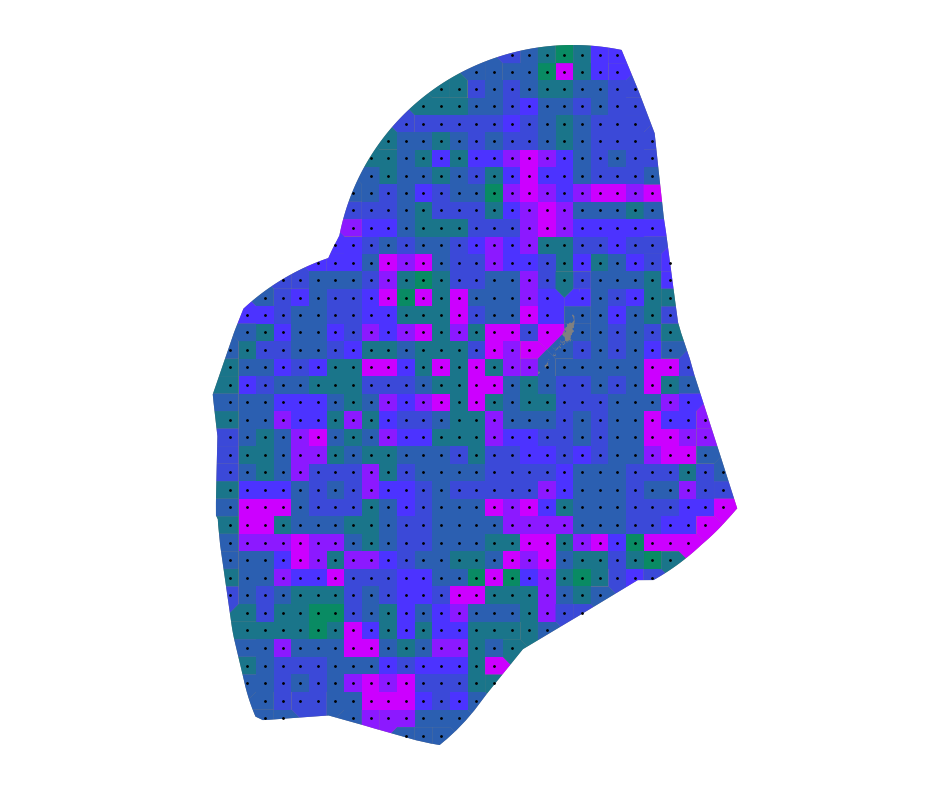

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2020_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


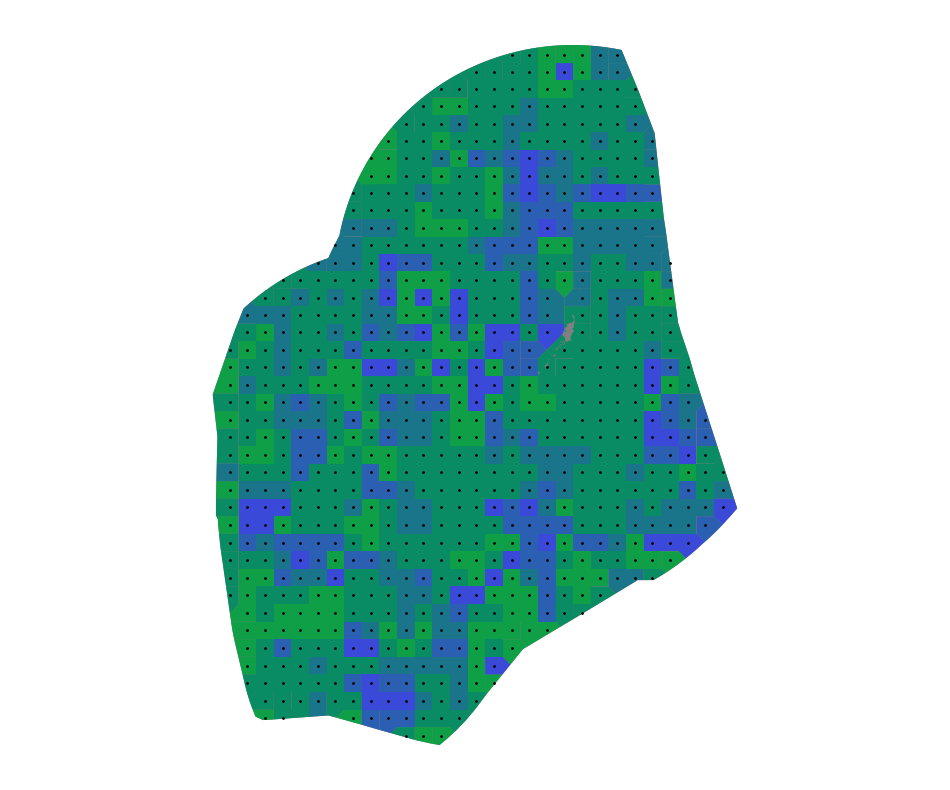

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2021_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


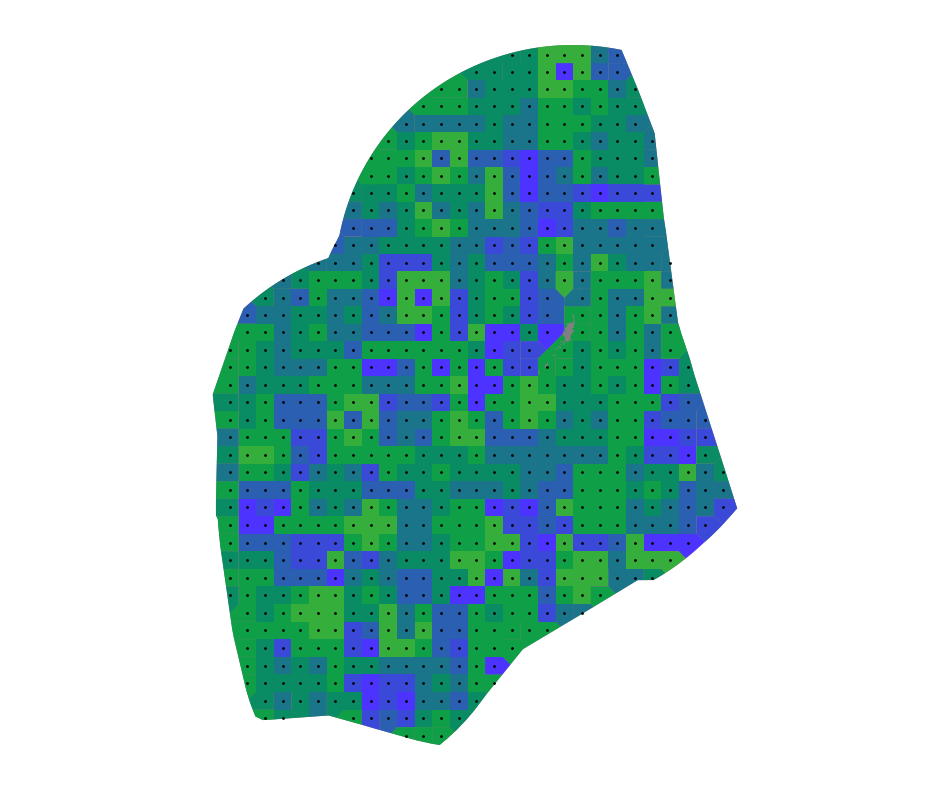

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2022_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


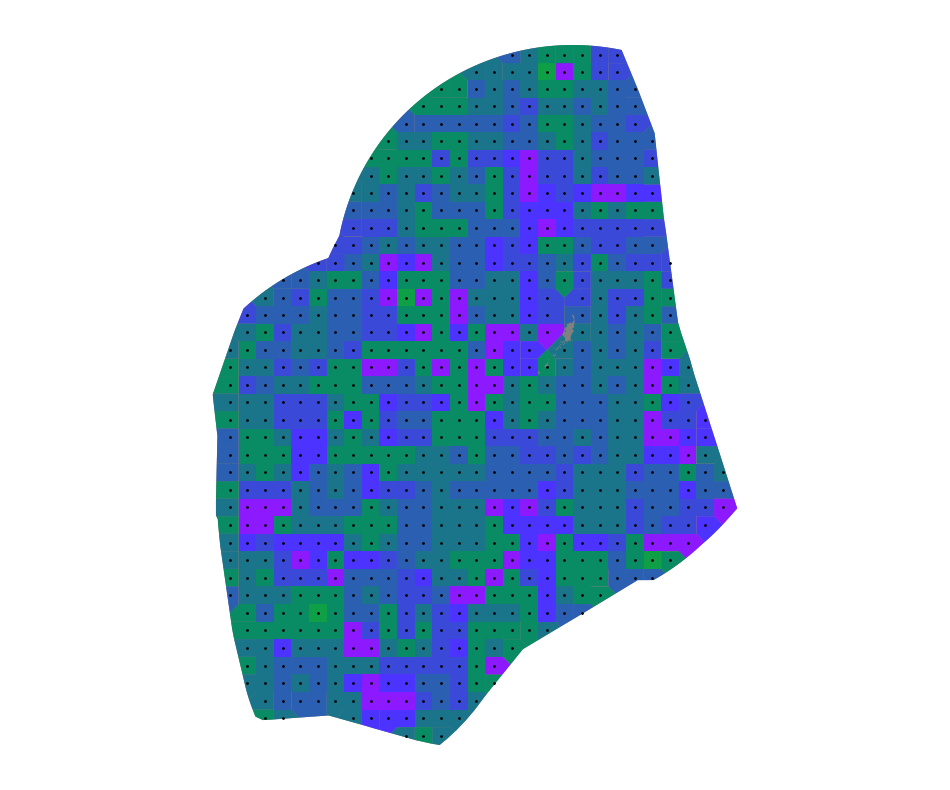

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2023_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


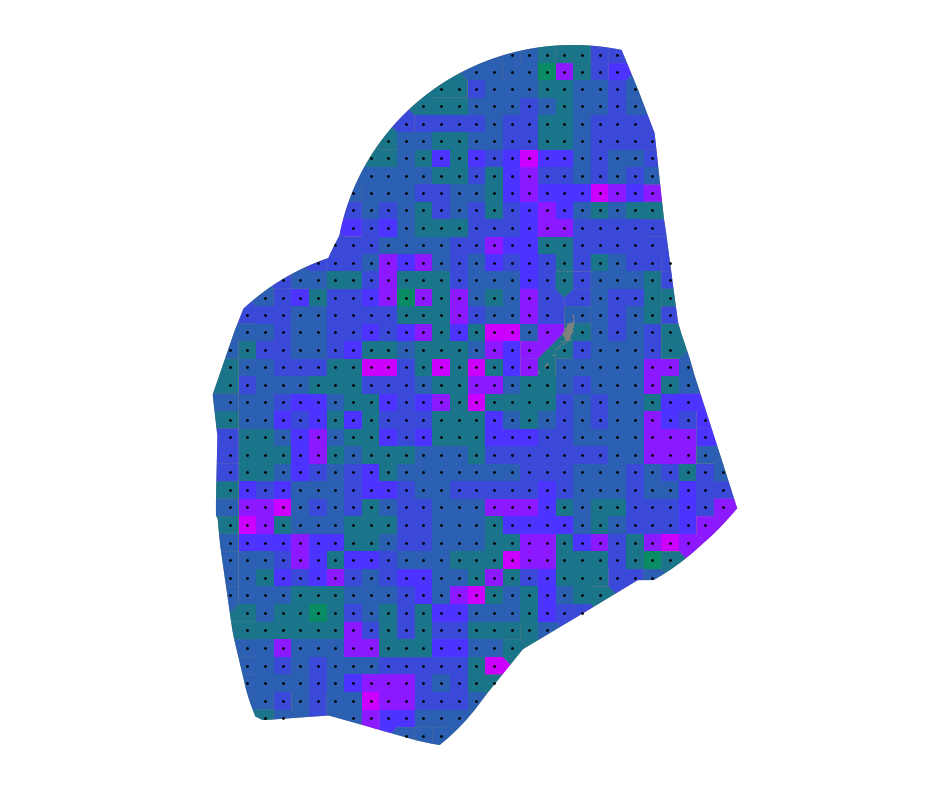

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2024_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


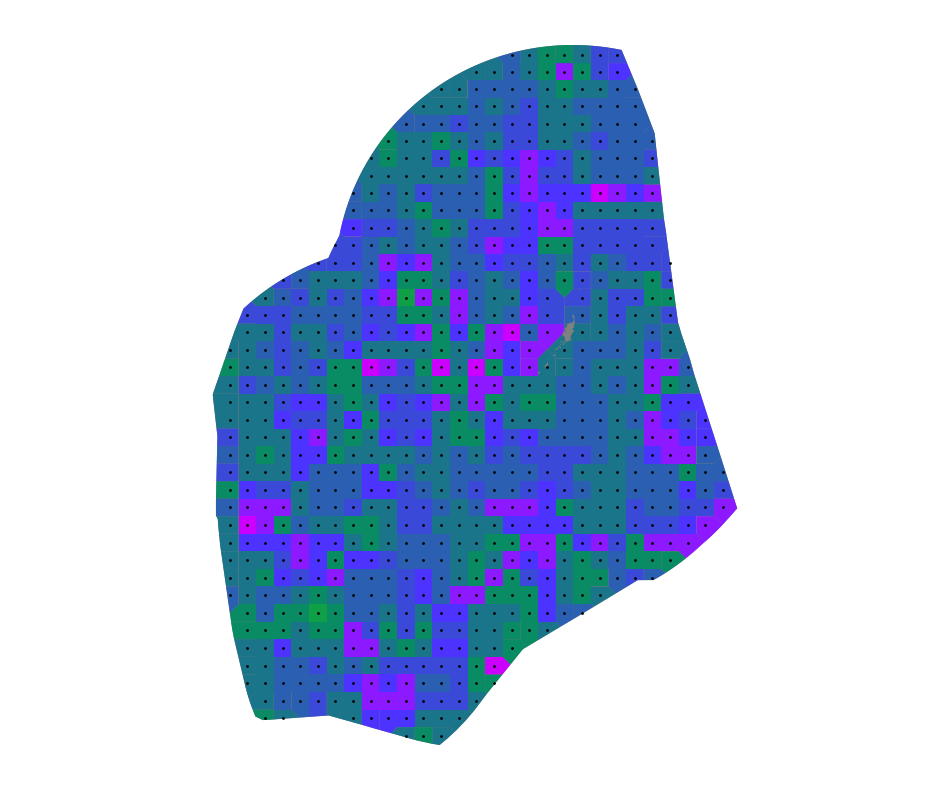

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2025_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


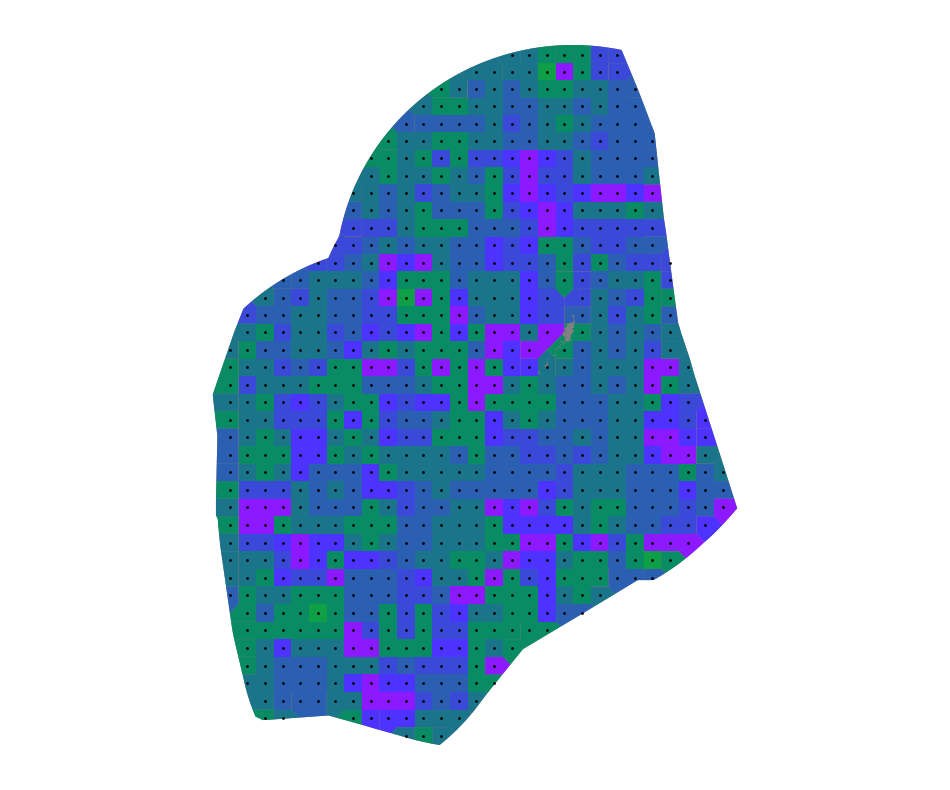

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2026_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


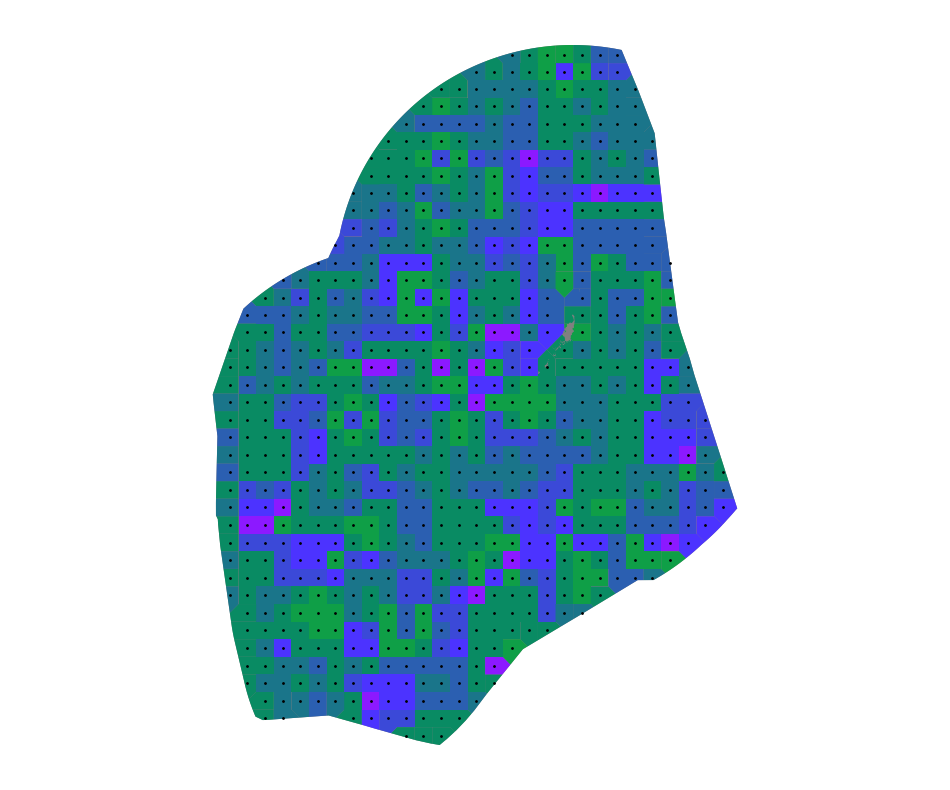

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2027_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


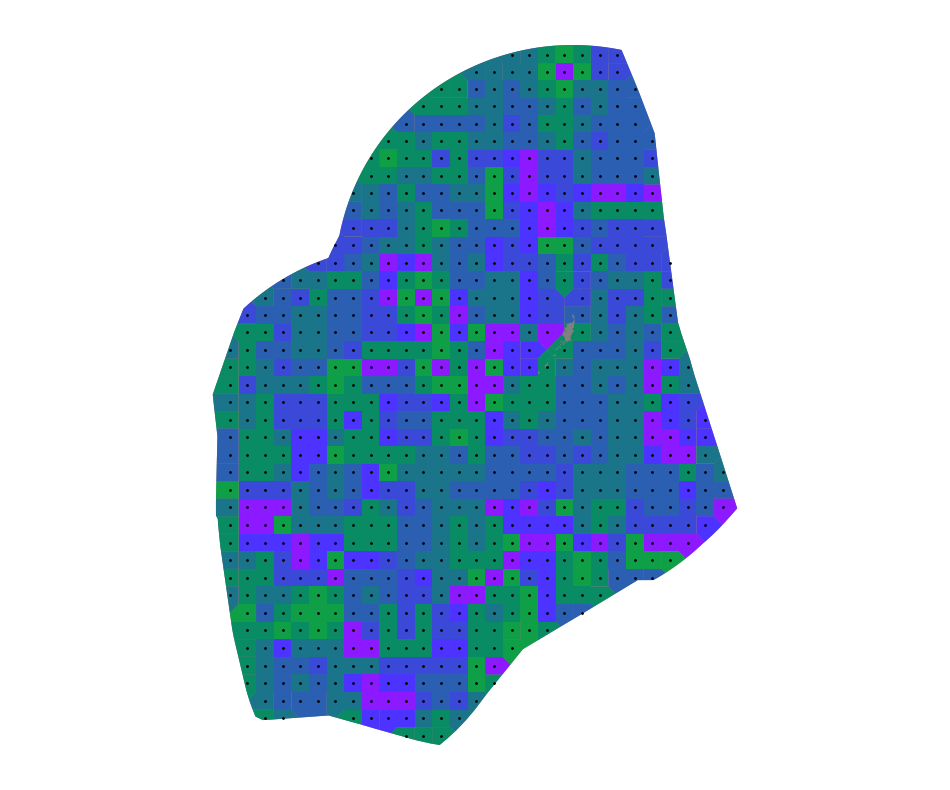

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2028_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


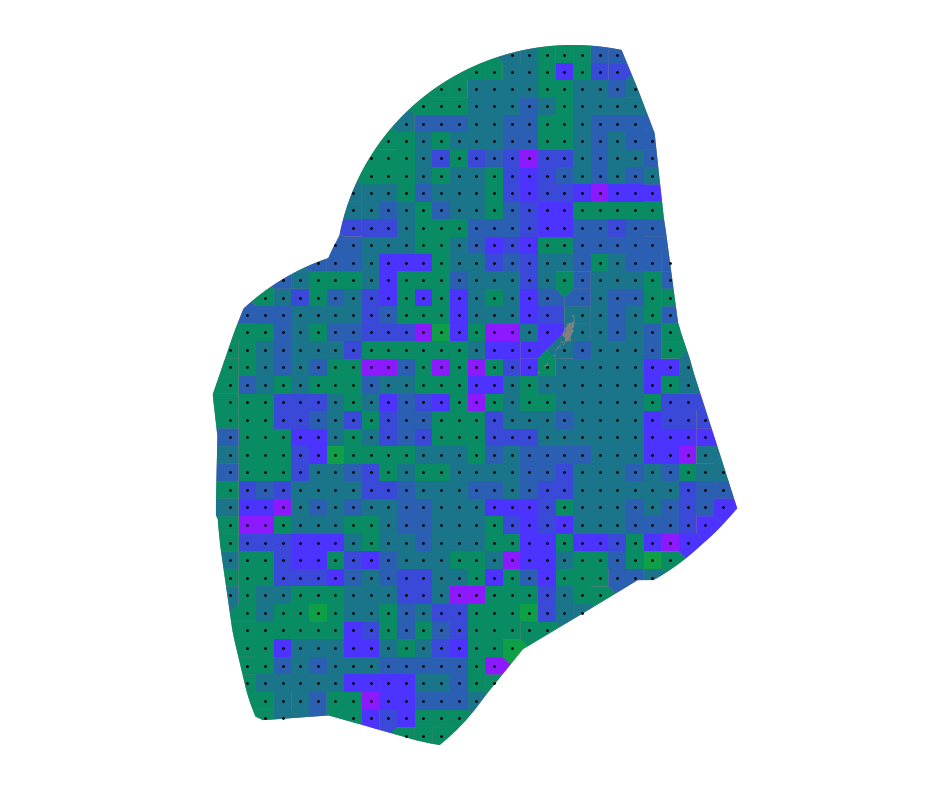

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2029_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


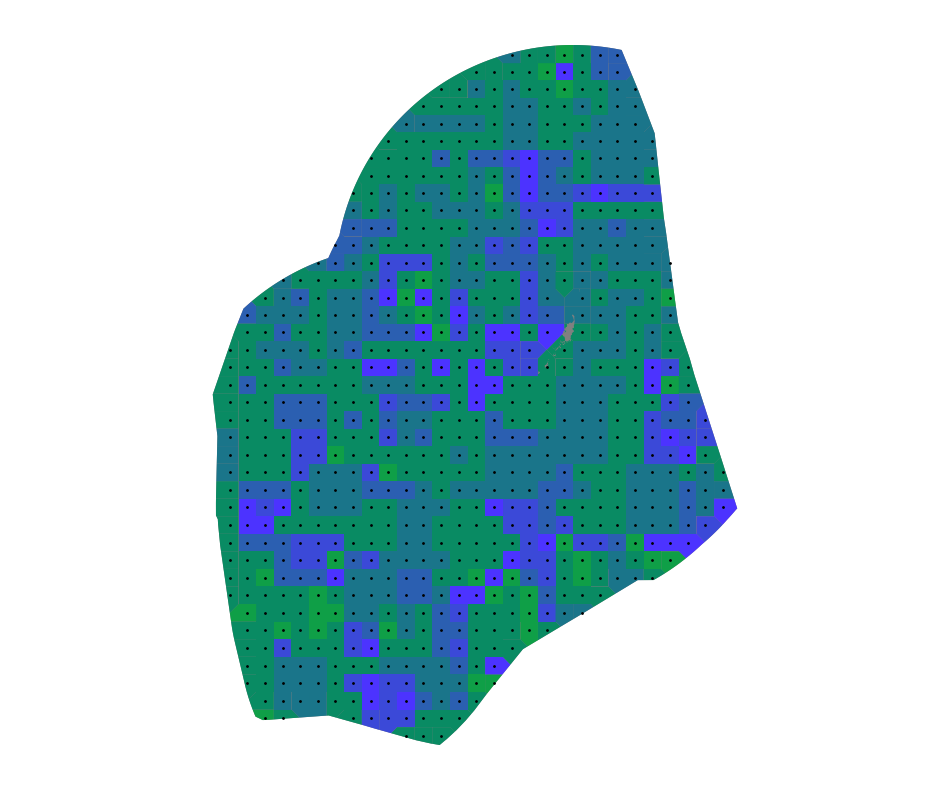

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2030_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


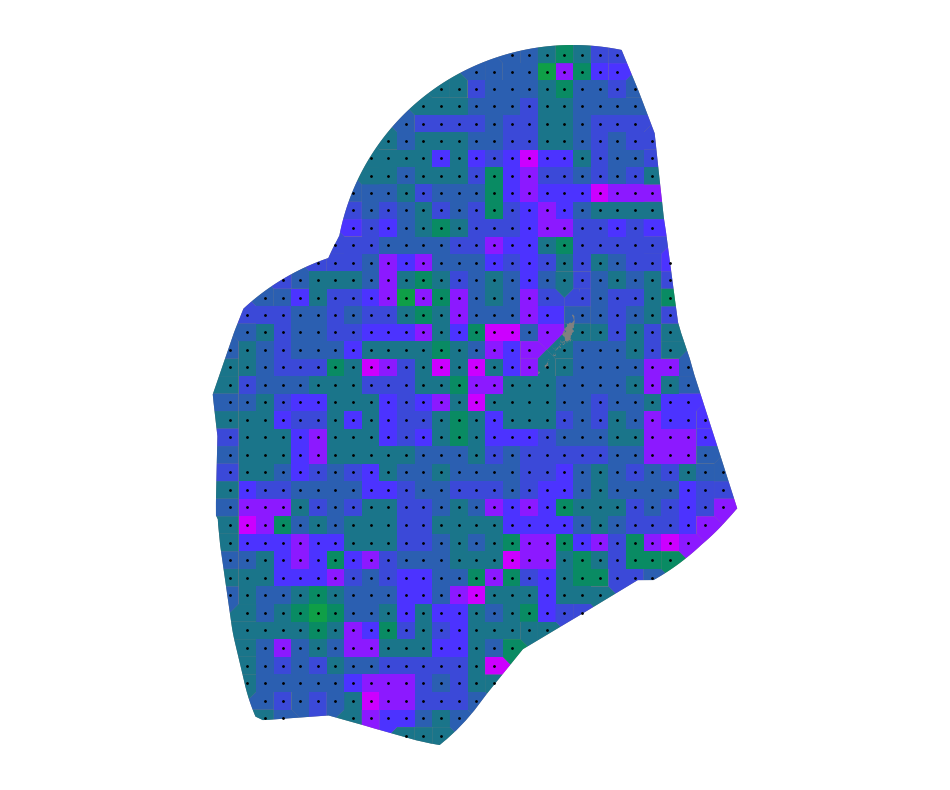

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2031_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


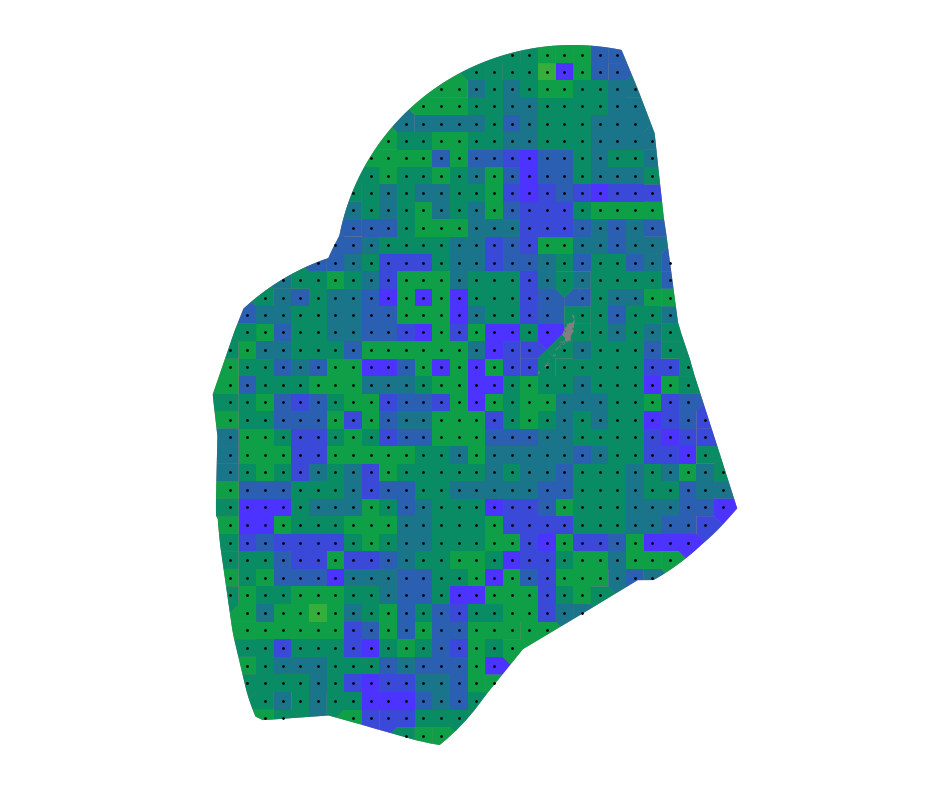

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2032_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


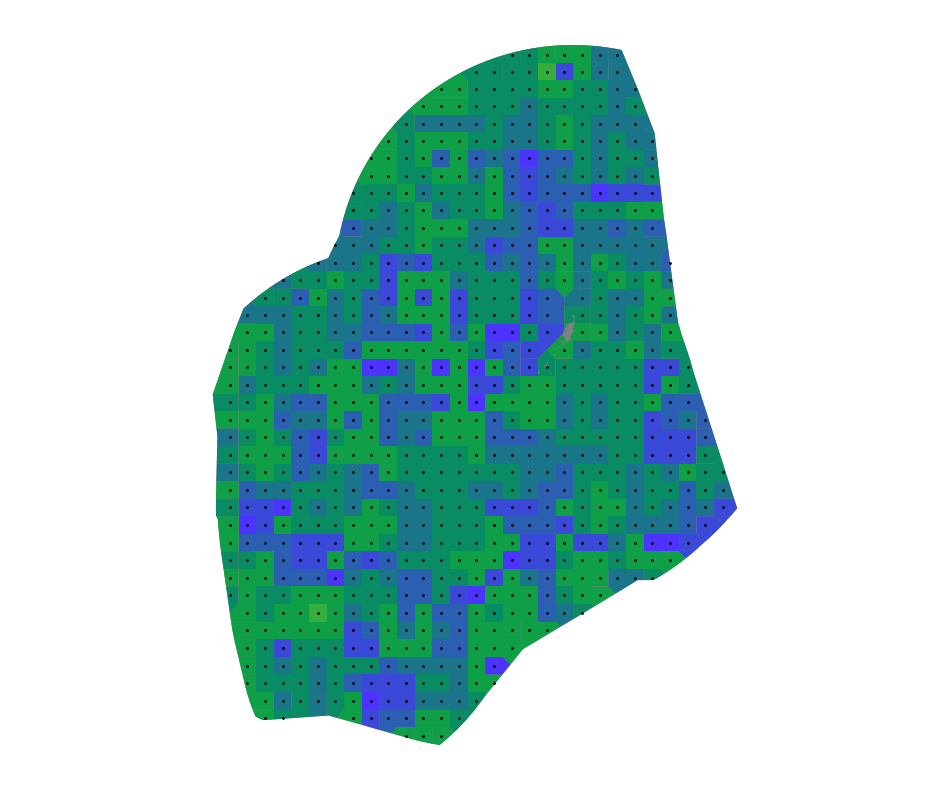

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2033_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


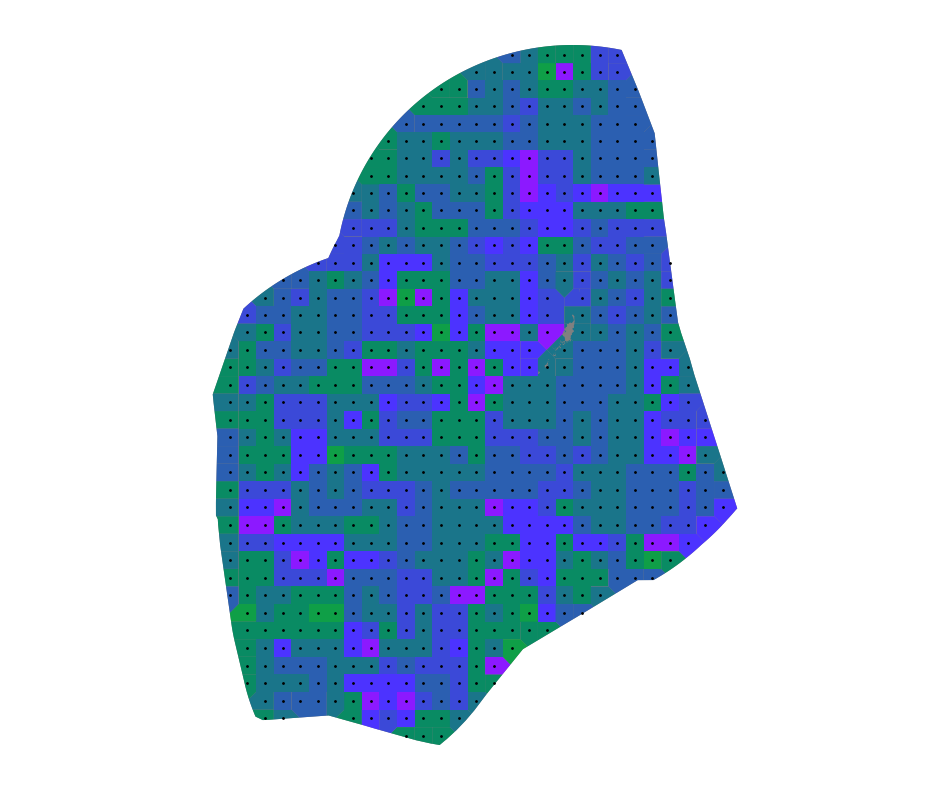

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2034_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


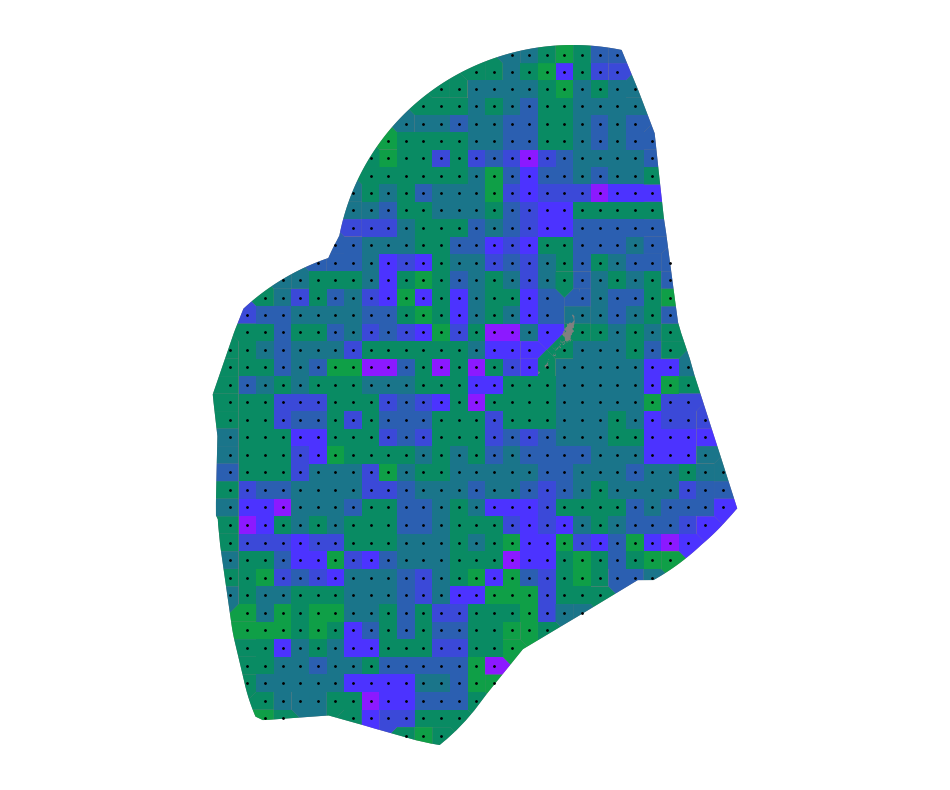

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2035_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


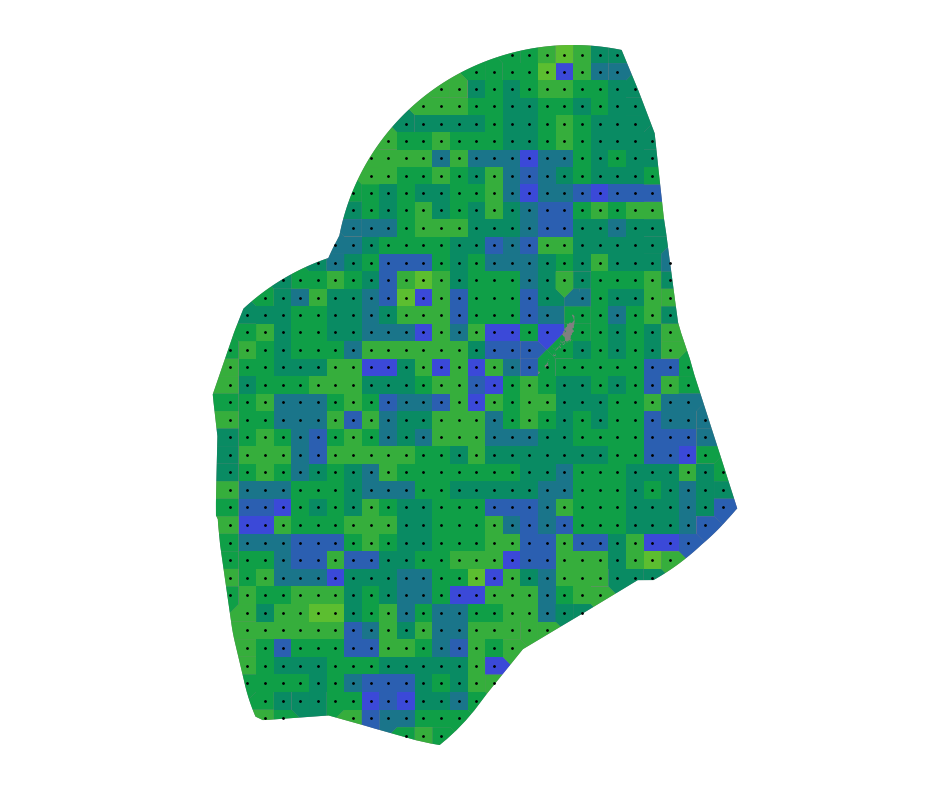

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2036_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


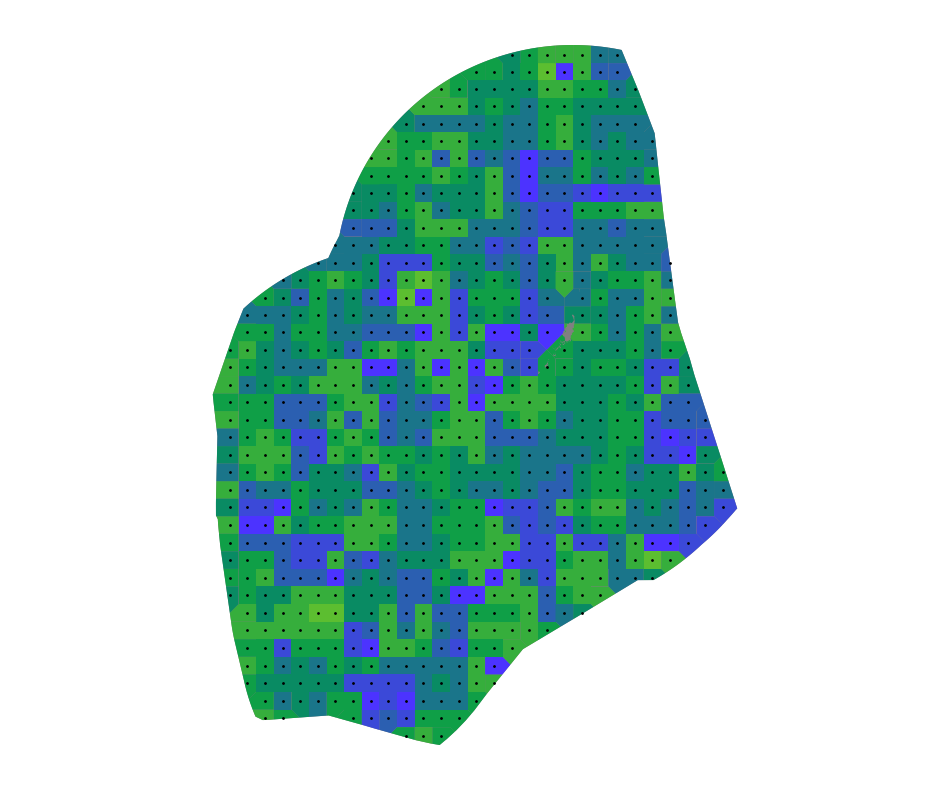

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2037_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


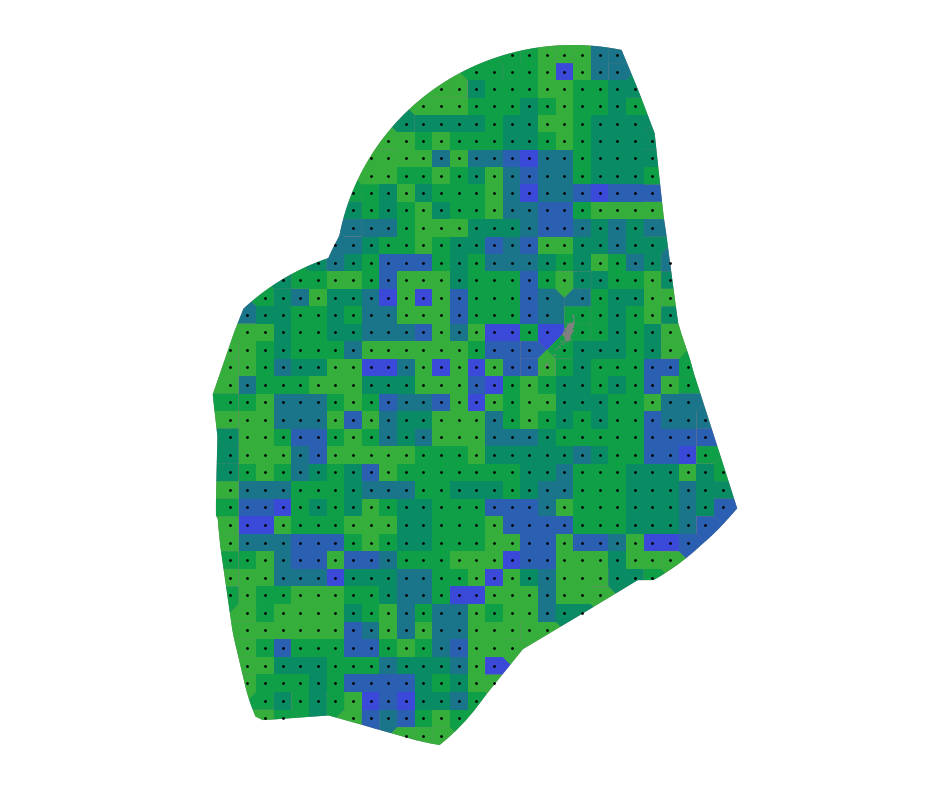

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2038_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


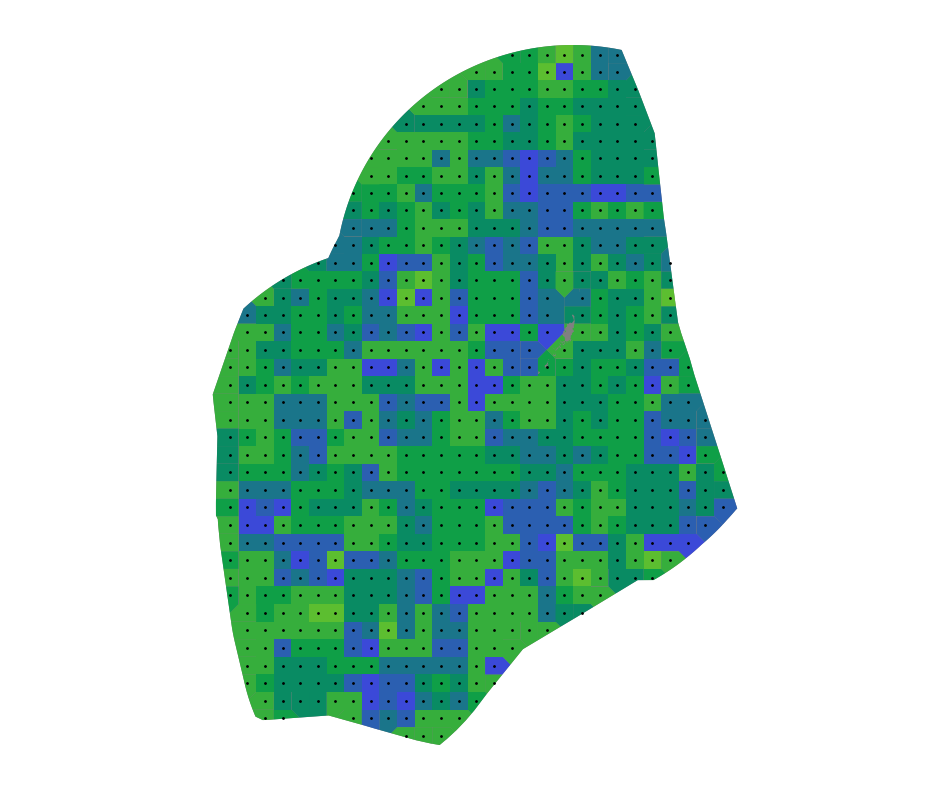

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2039_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


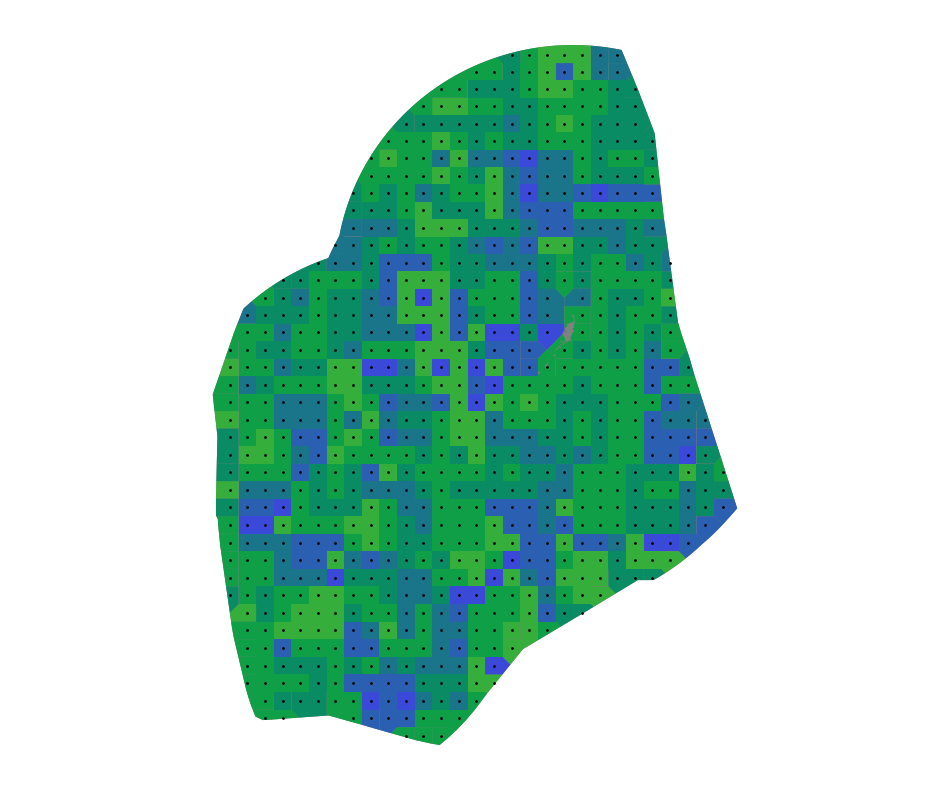

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2040_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


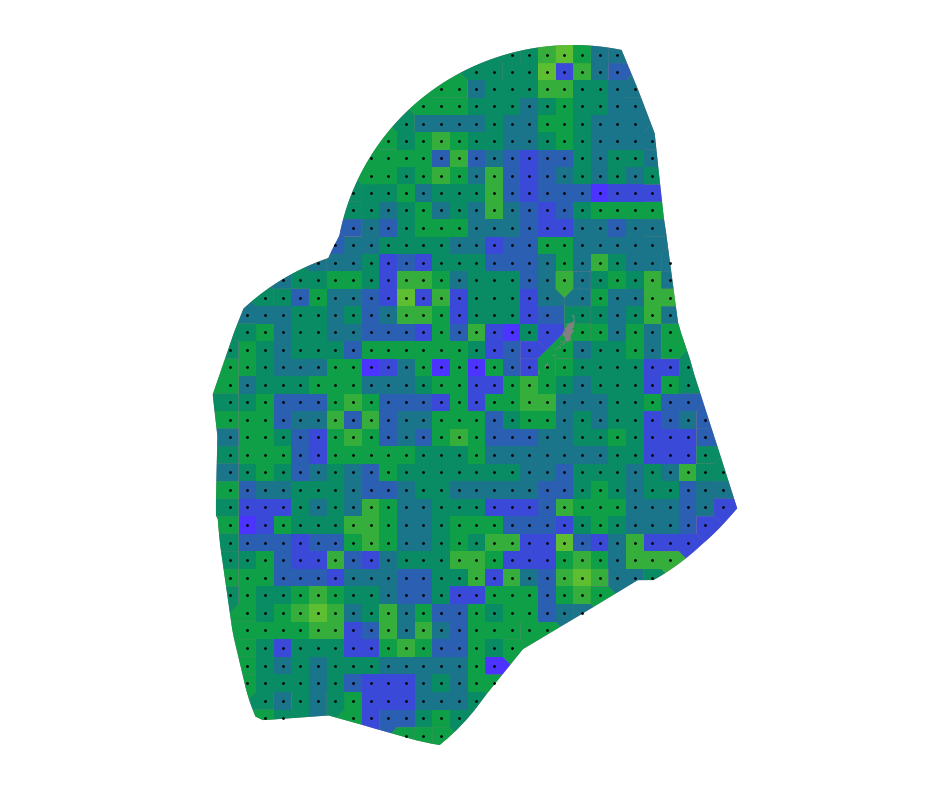

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2041_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


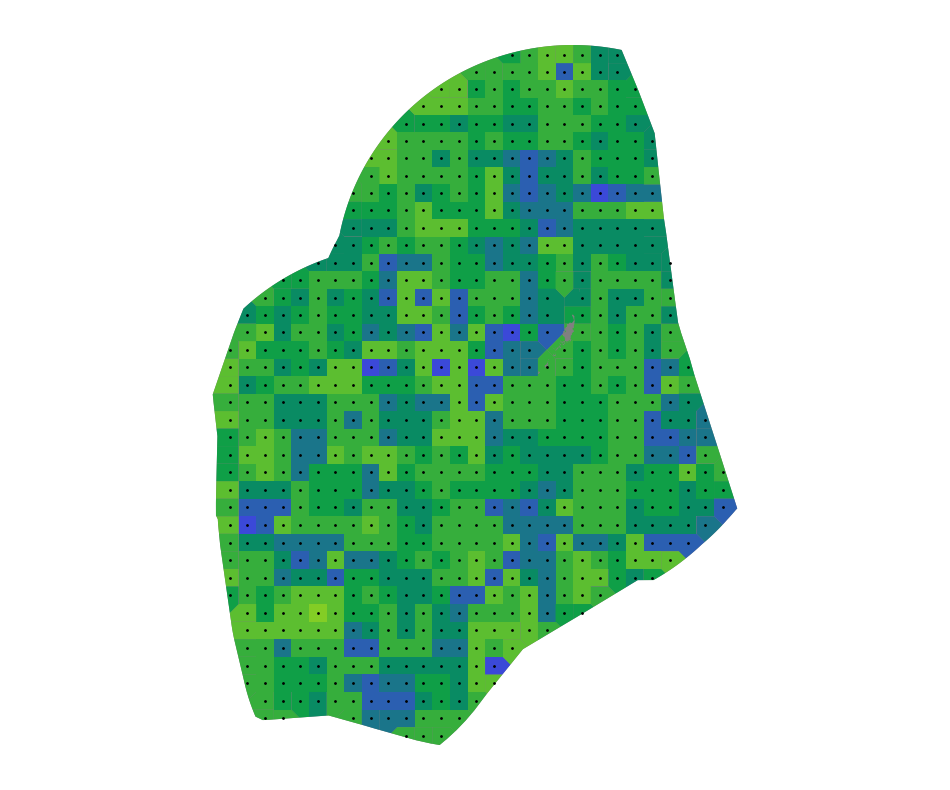

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2042_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


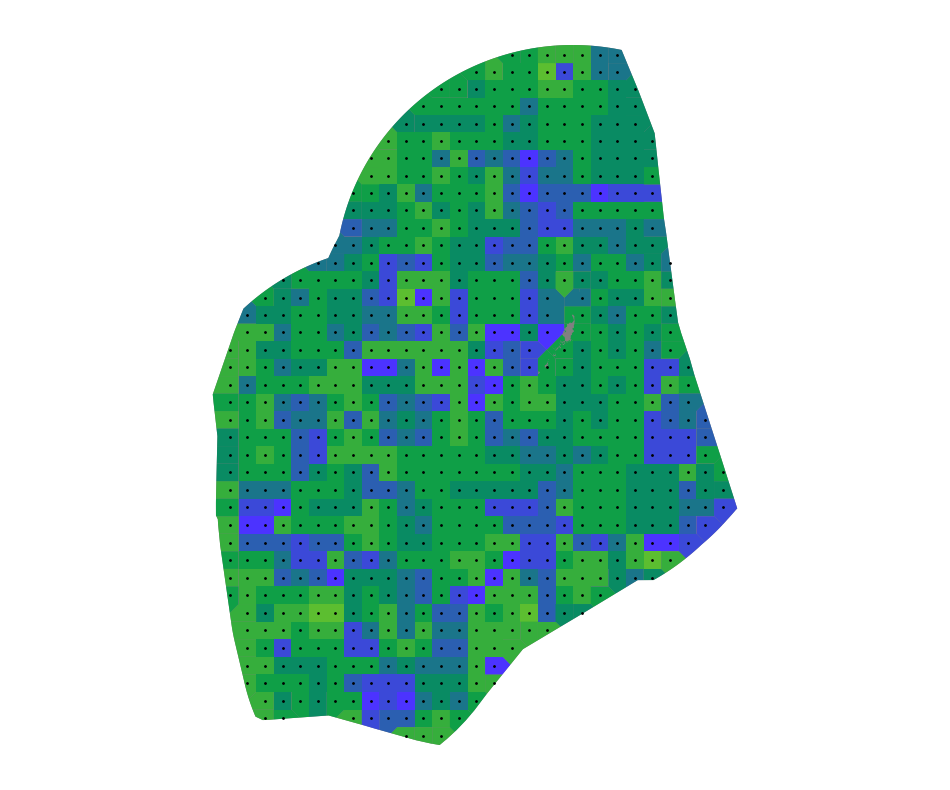

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2043_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


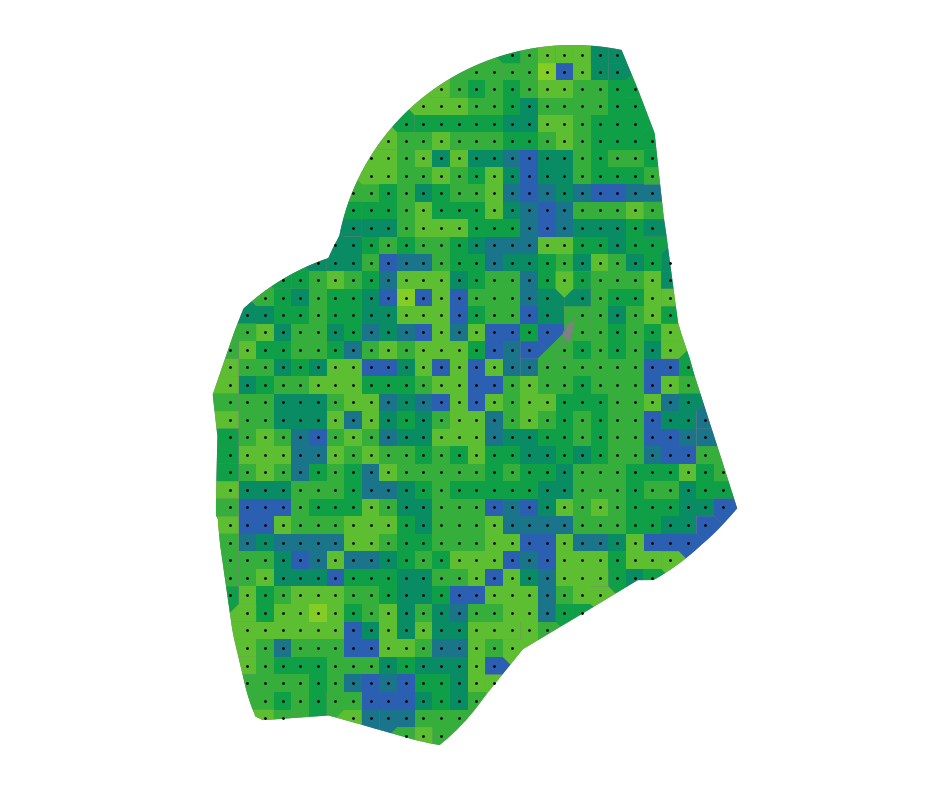

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2044_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


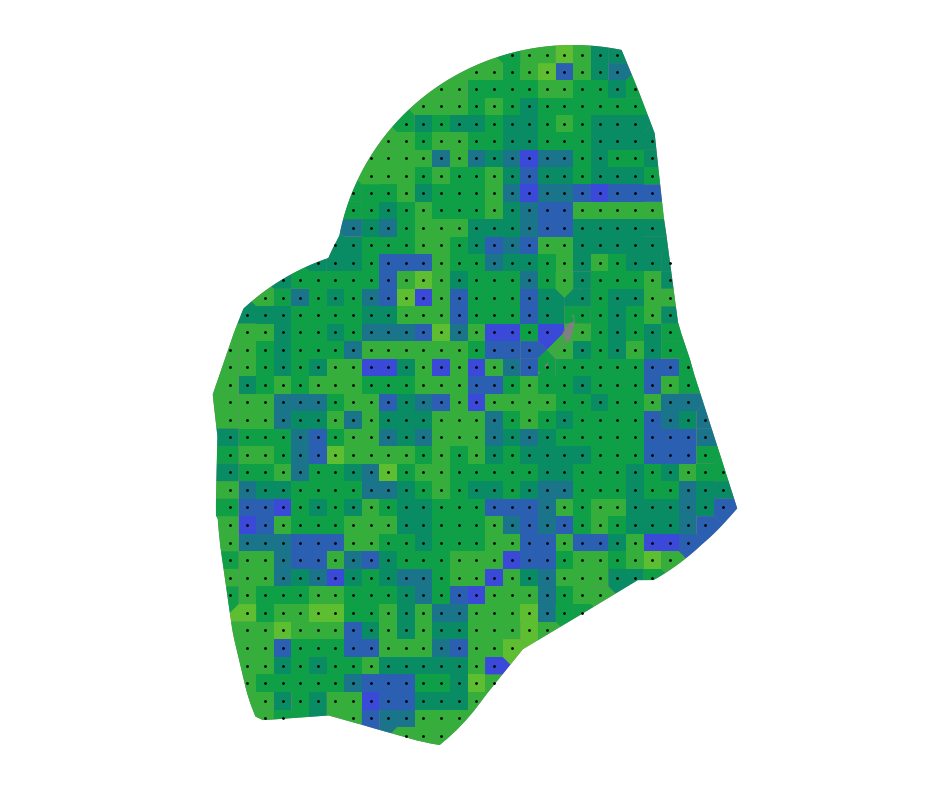

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2045_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


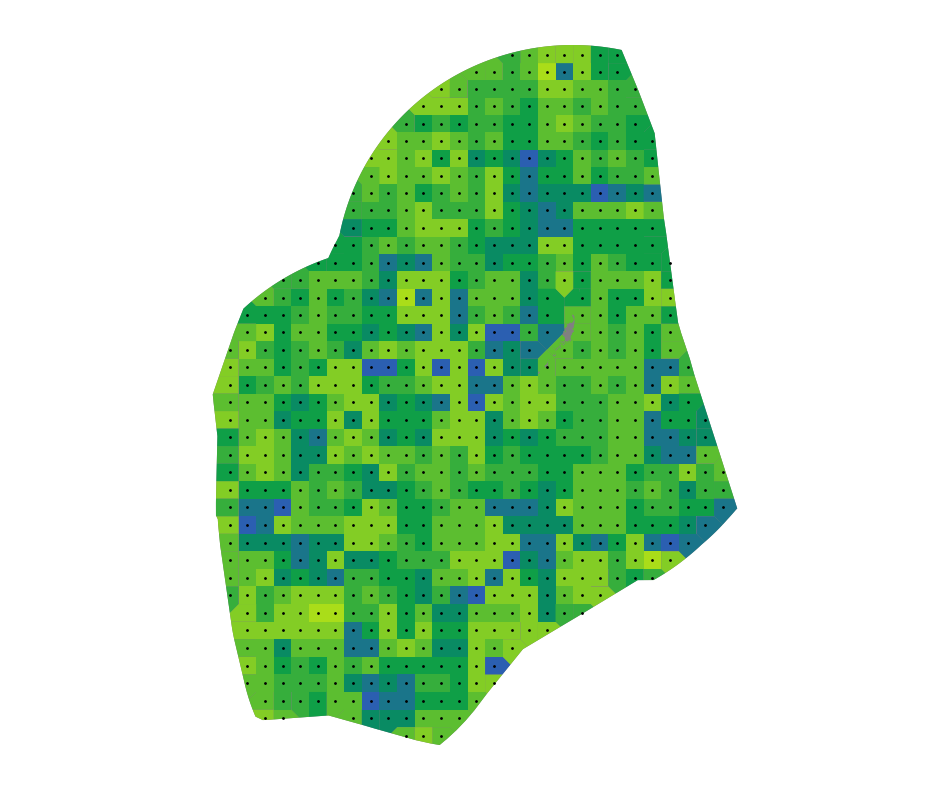

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2046_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


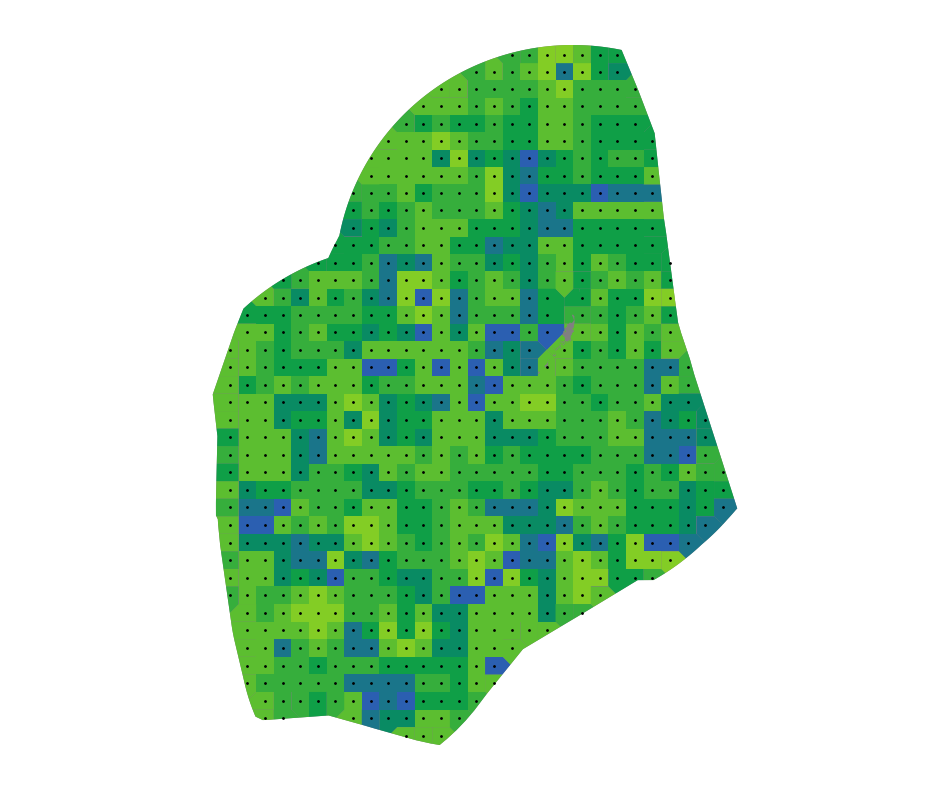

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2047_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


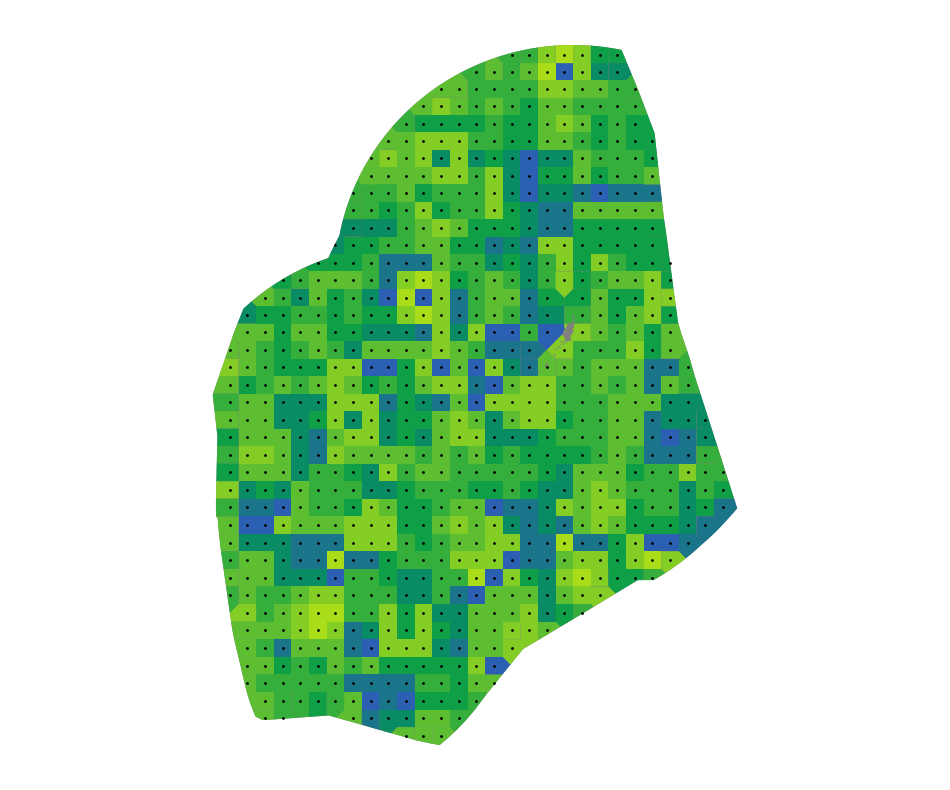

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2048_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


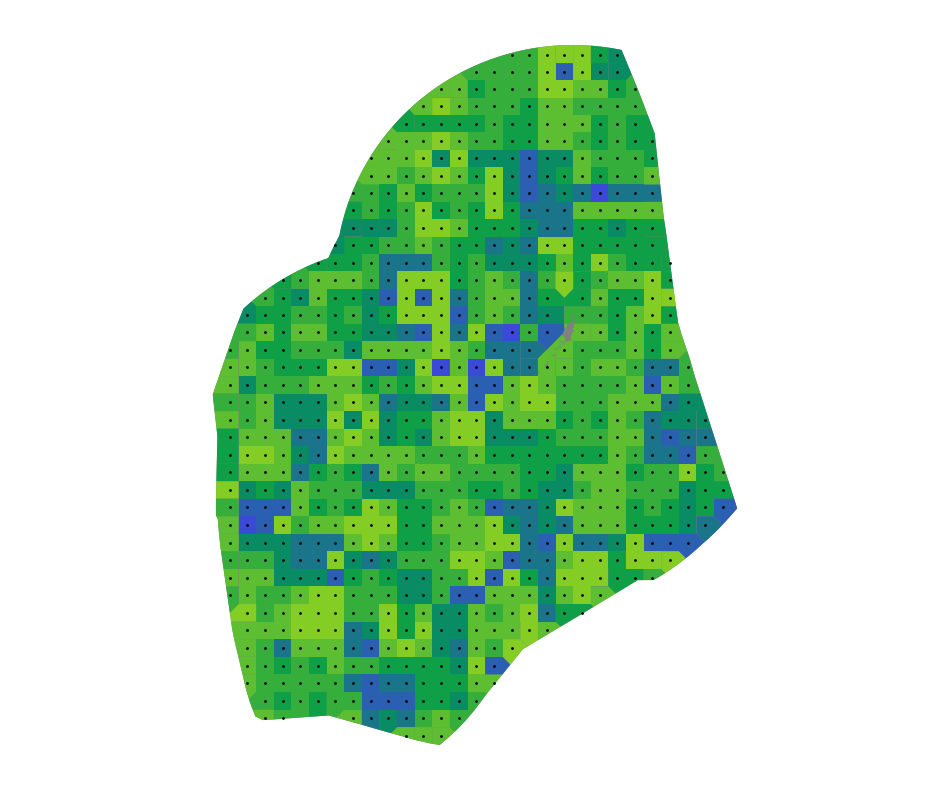

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2049_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


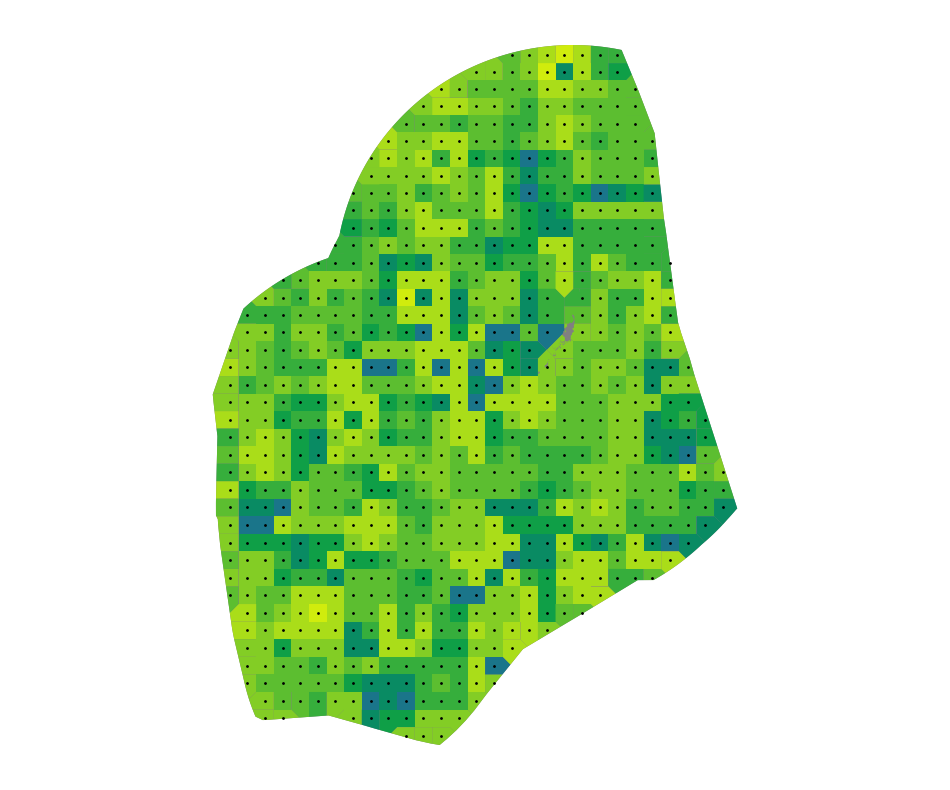

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2050_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


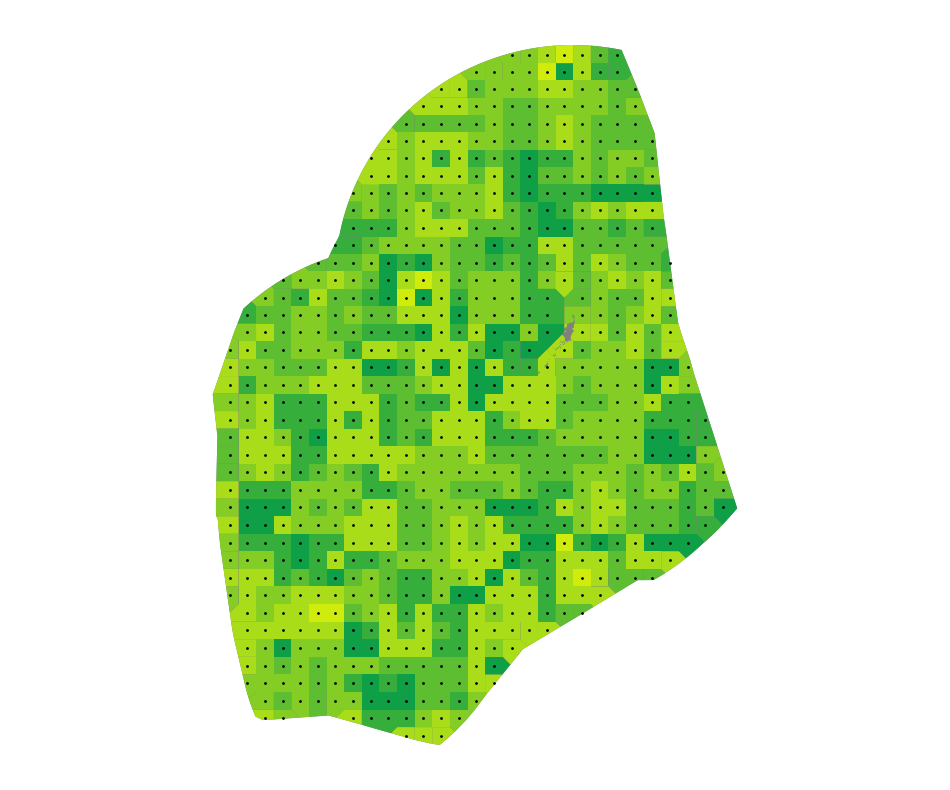

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2051_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


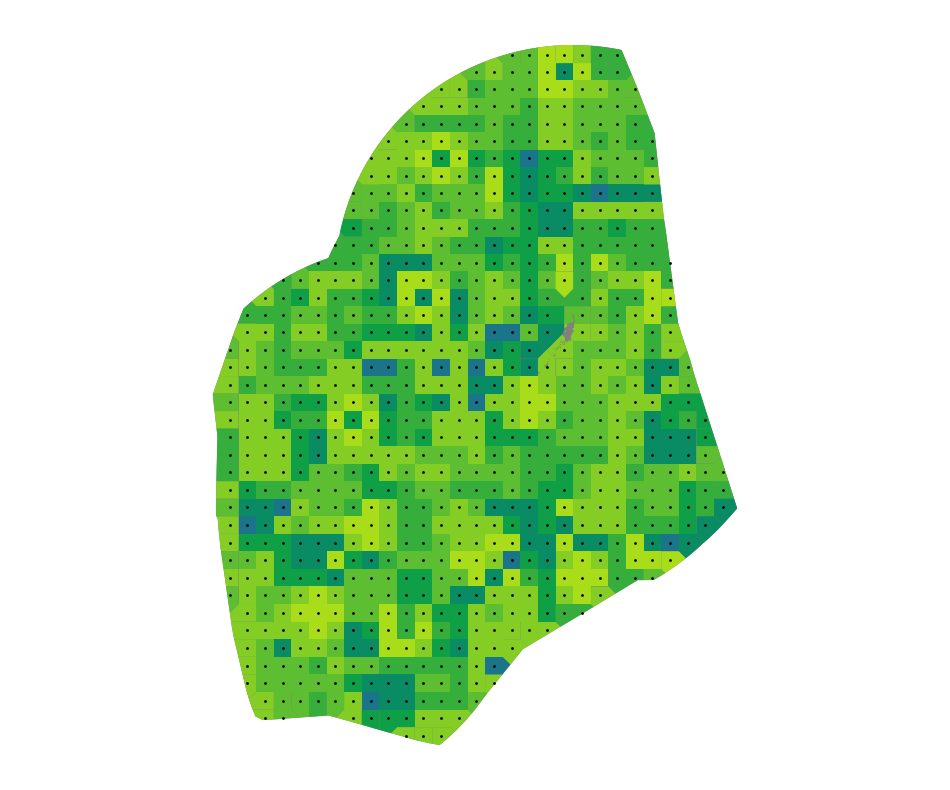

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2052_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


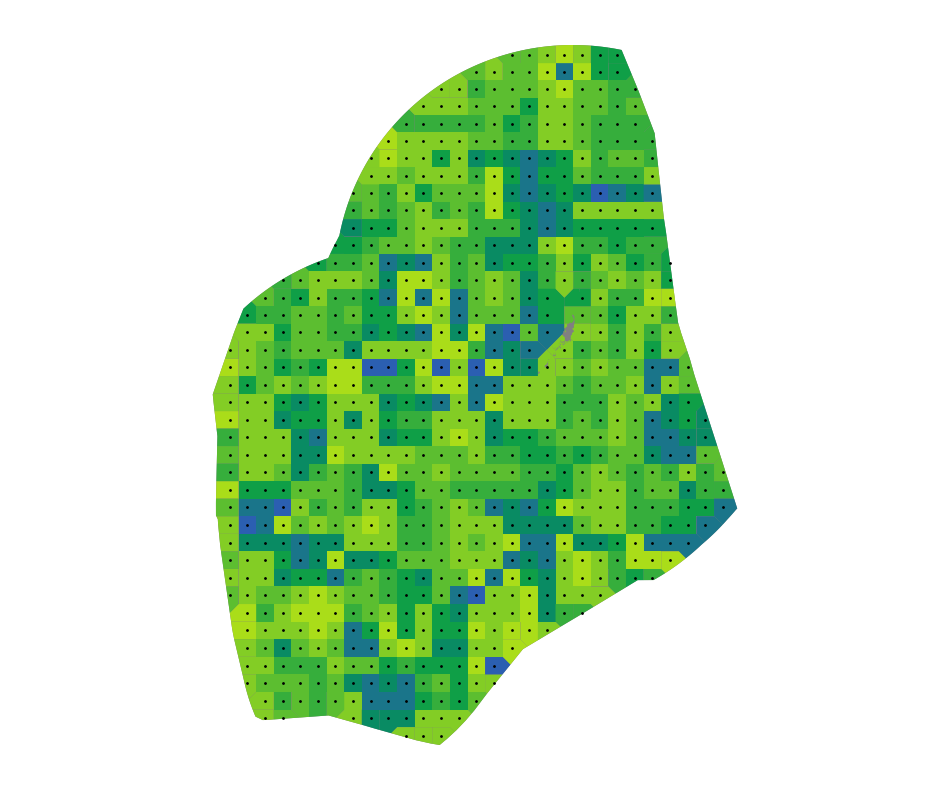

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2053_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


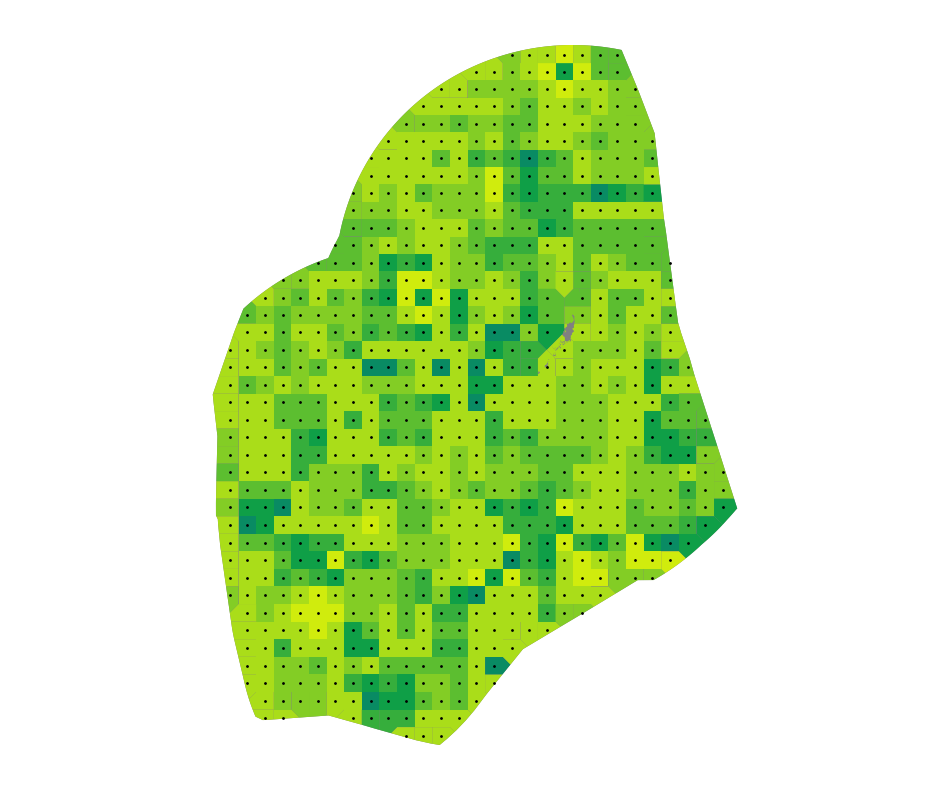

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2054_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


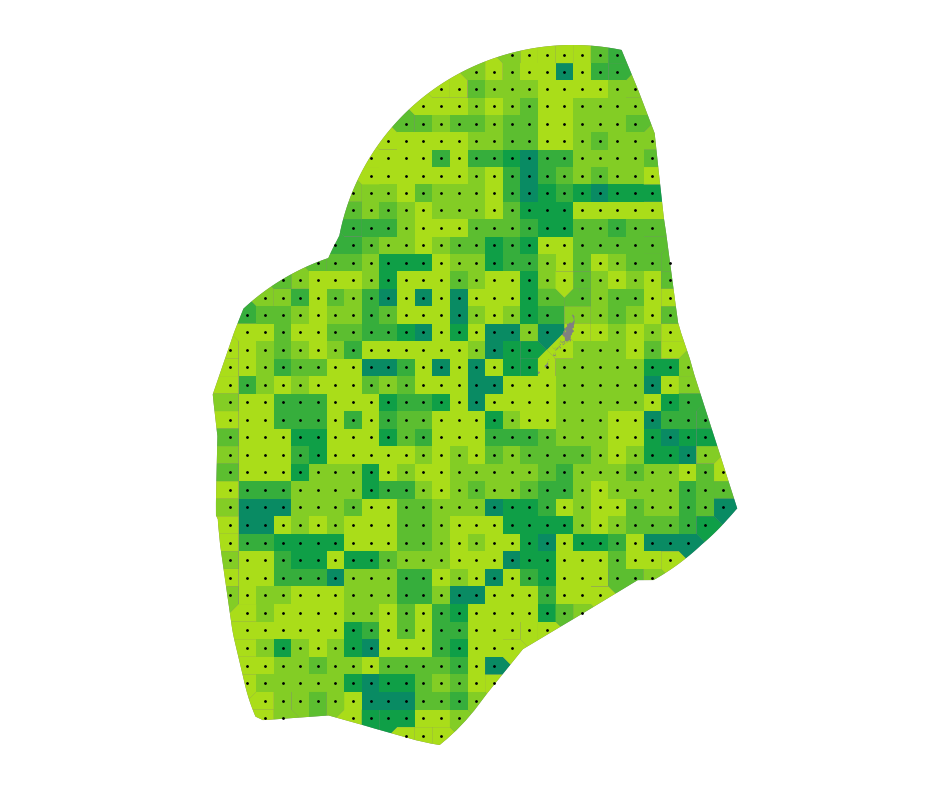

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2055_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


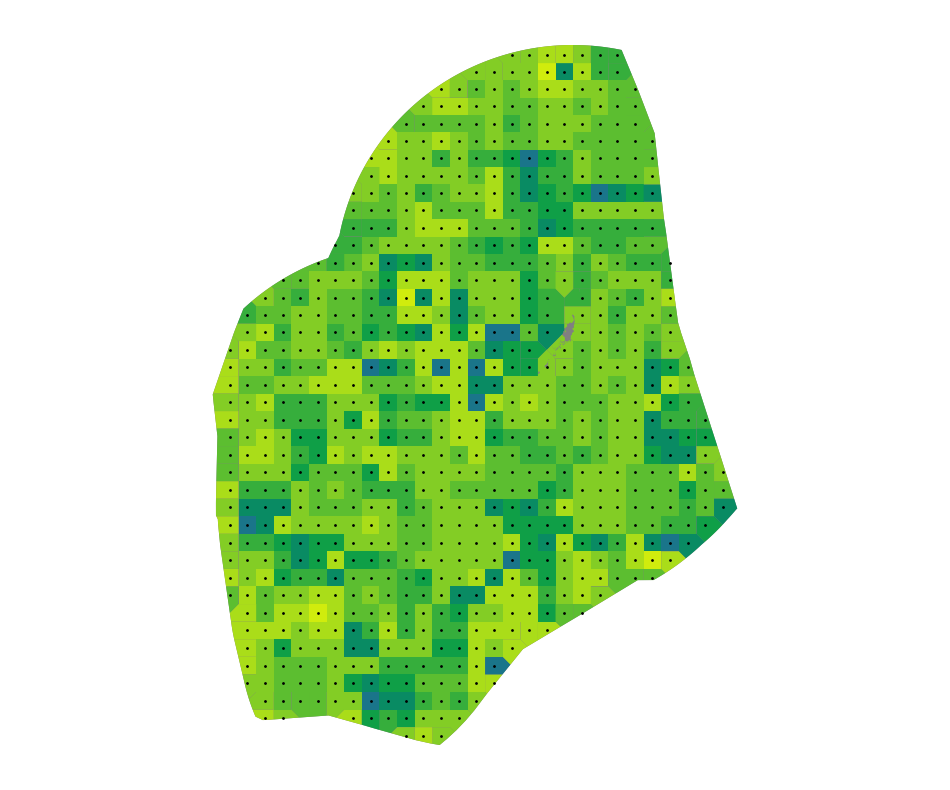

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2056_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


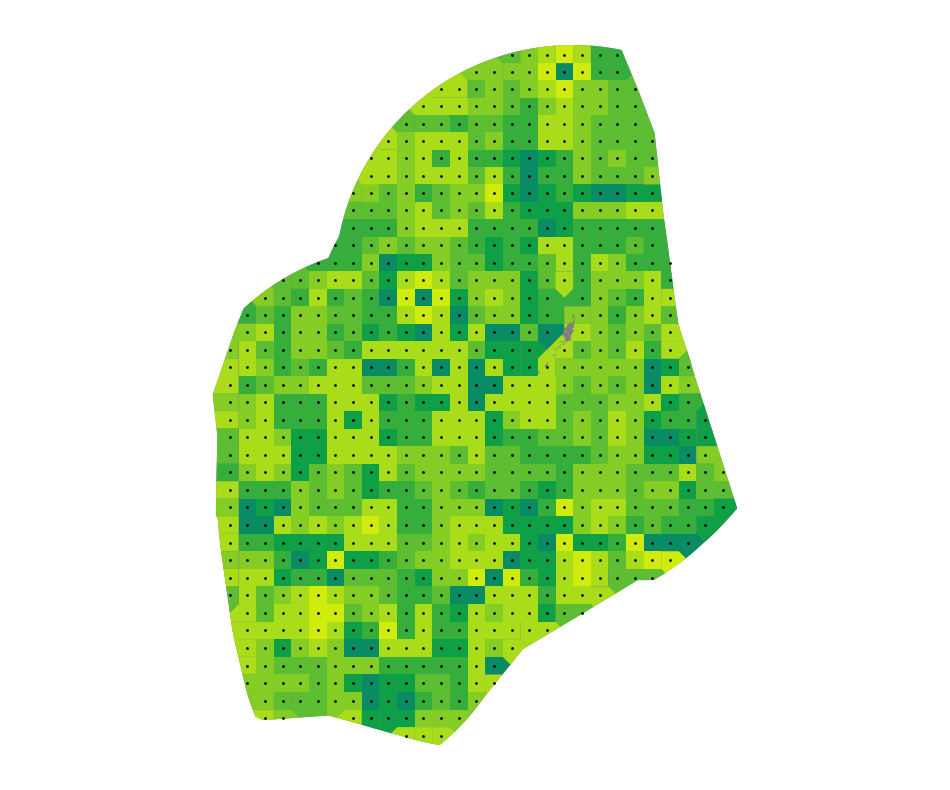

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2057_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


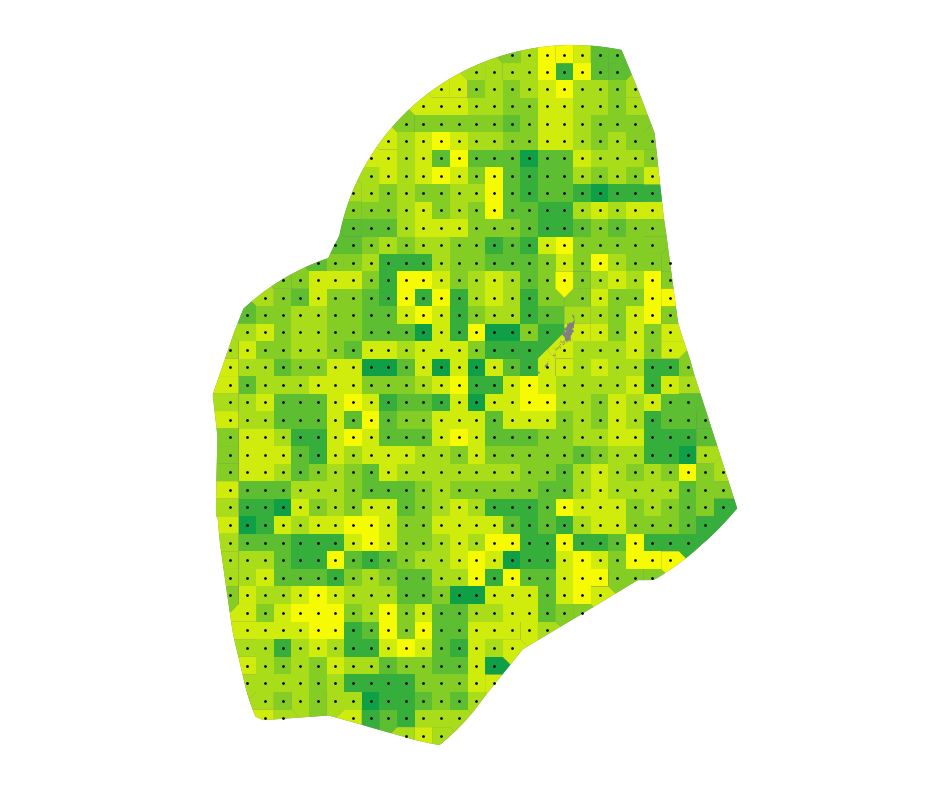

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2058_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


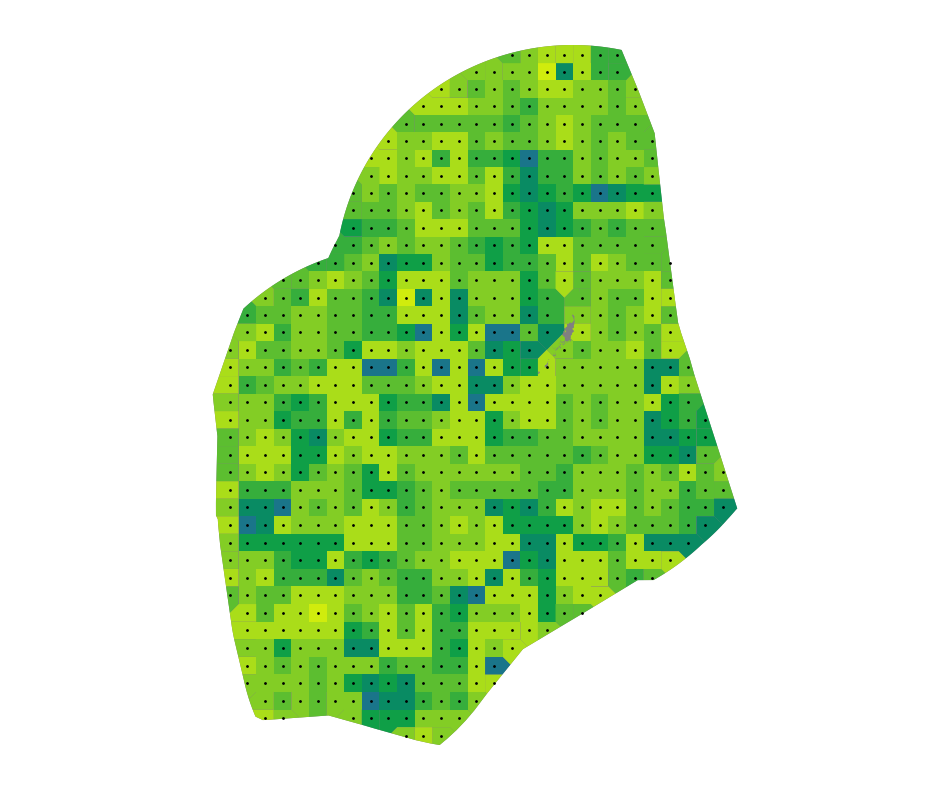

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2059_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


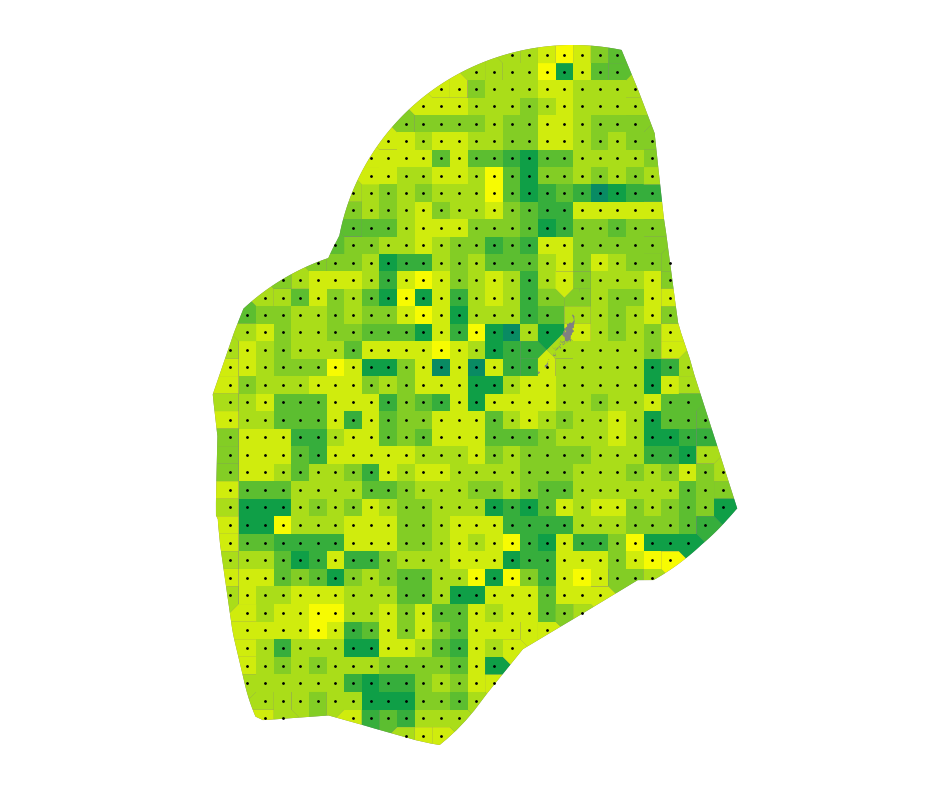

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2060_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


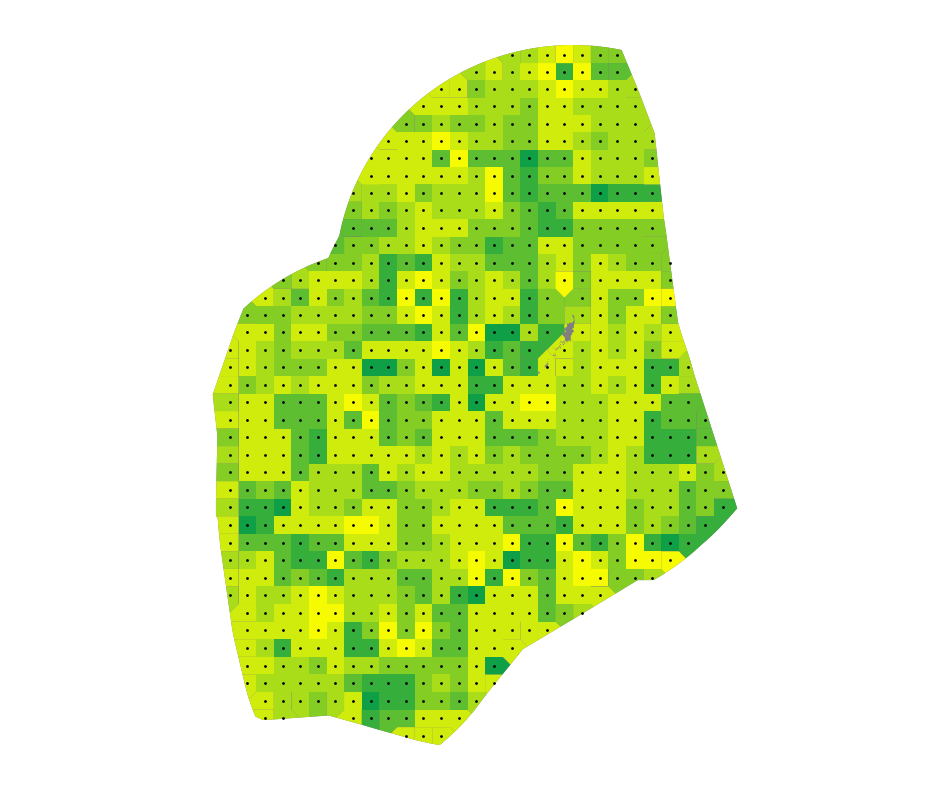

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2061_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


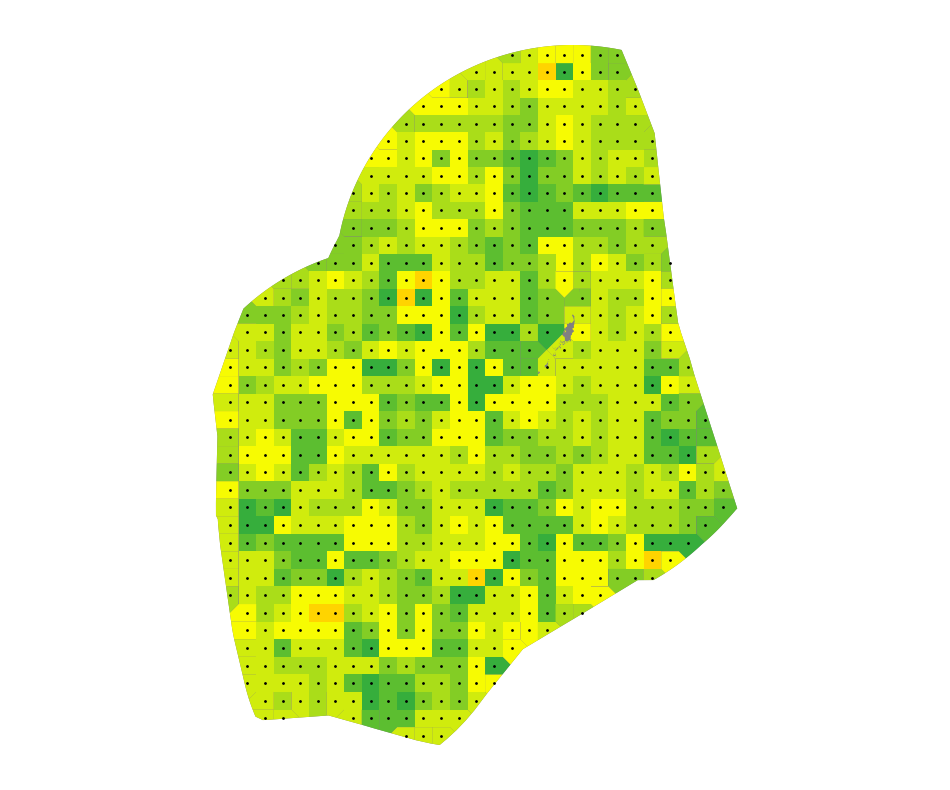

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2062_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


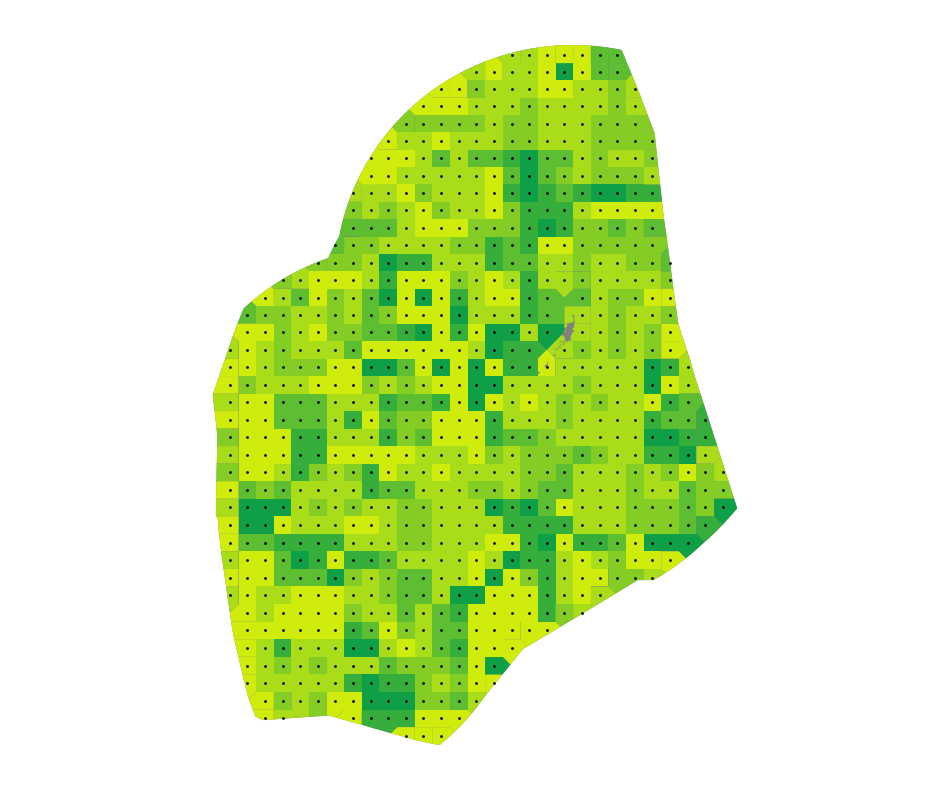

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2063_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


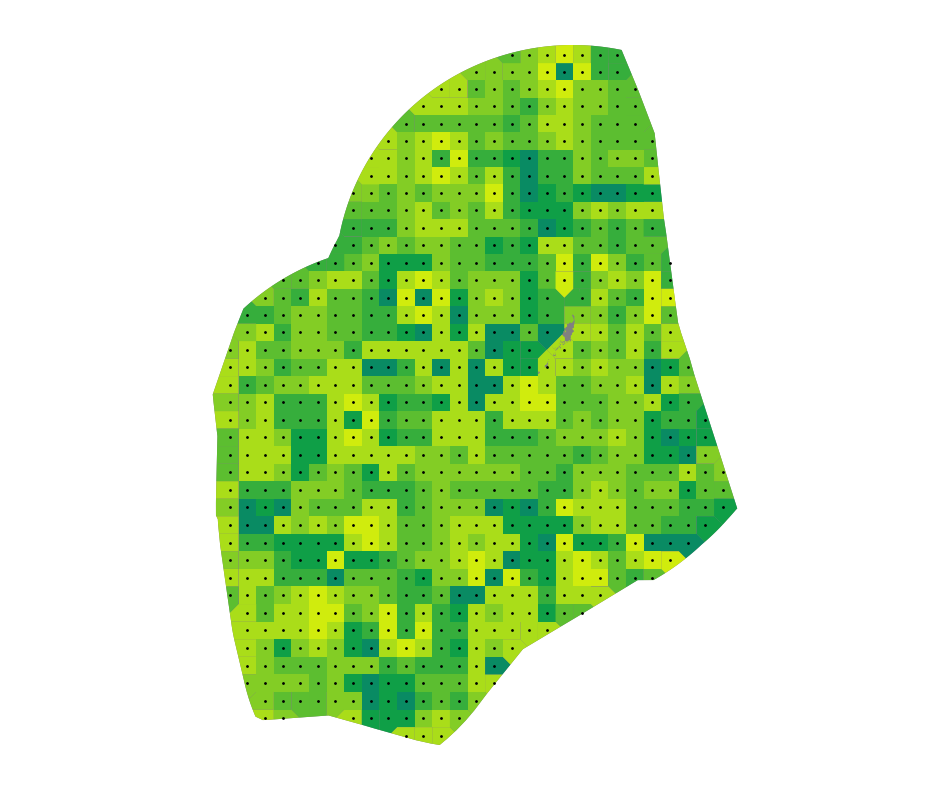

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2064_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


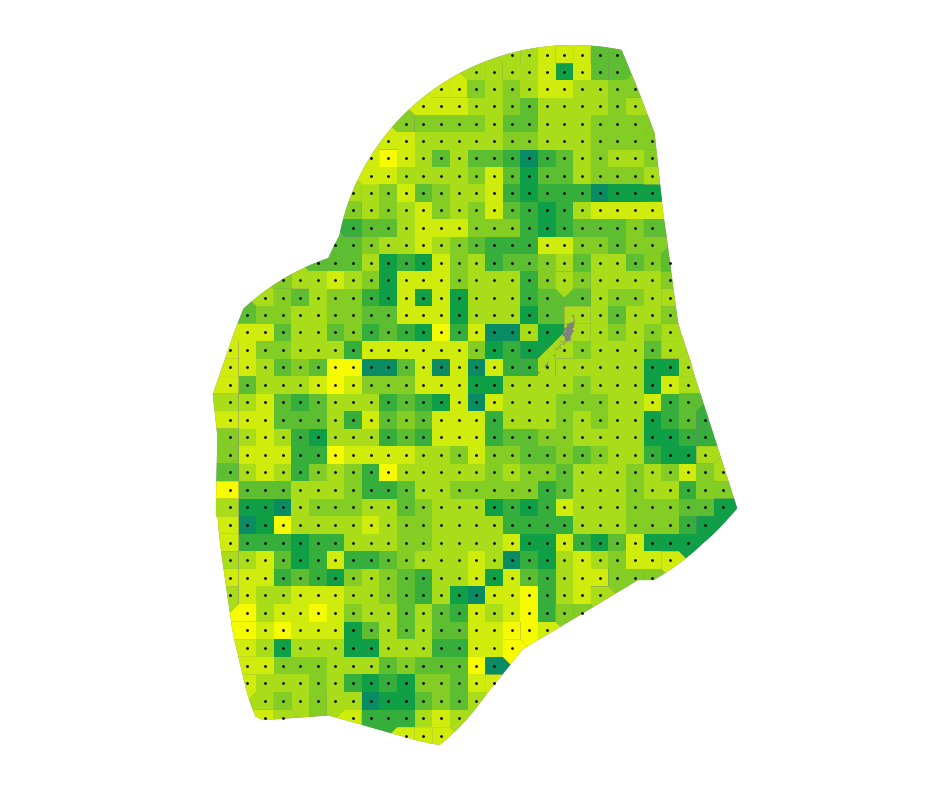

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2065_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


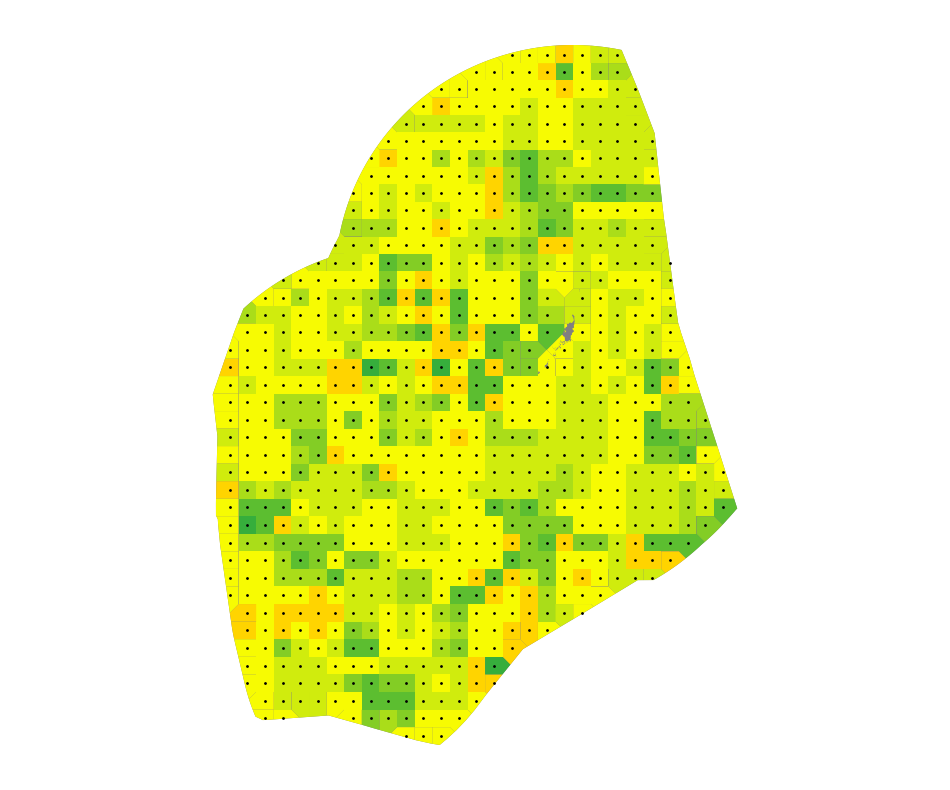

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2066_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


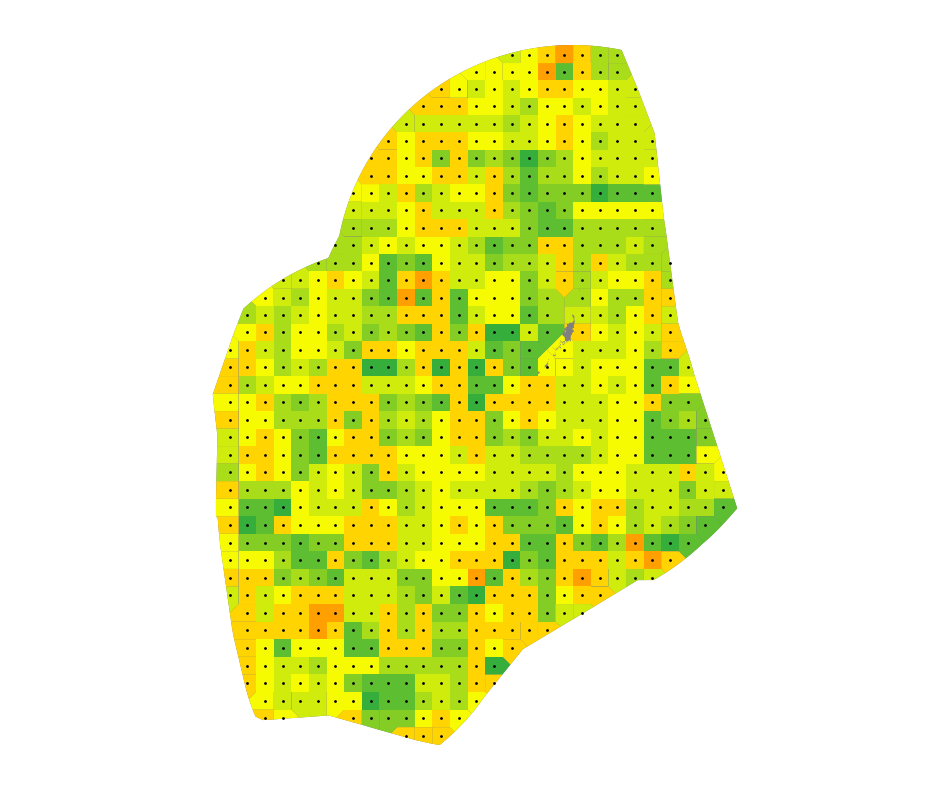

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2067_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


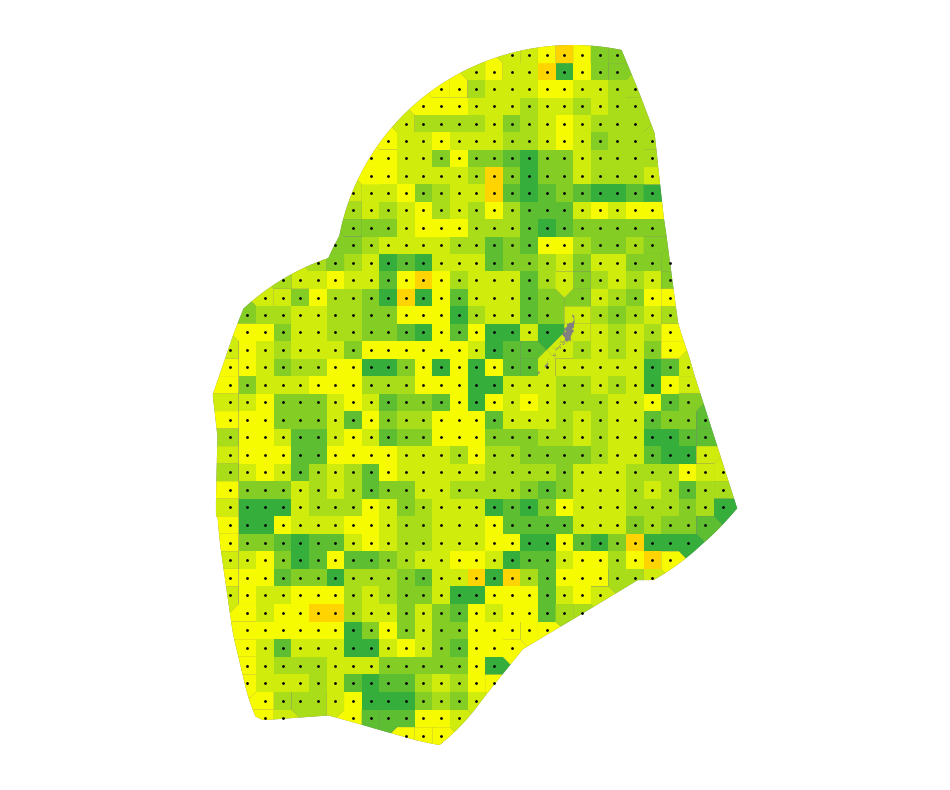

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2068_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


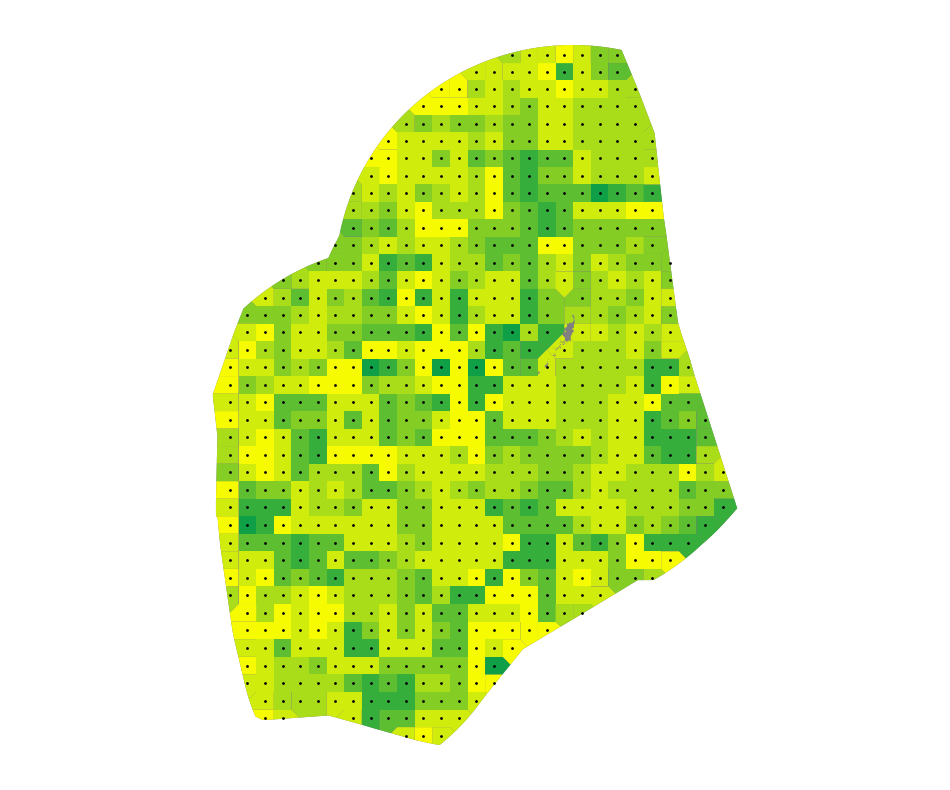

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2069_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


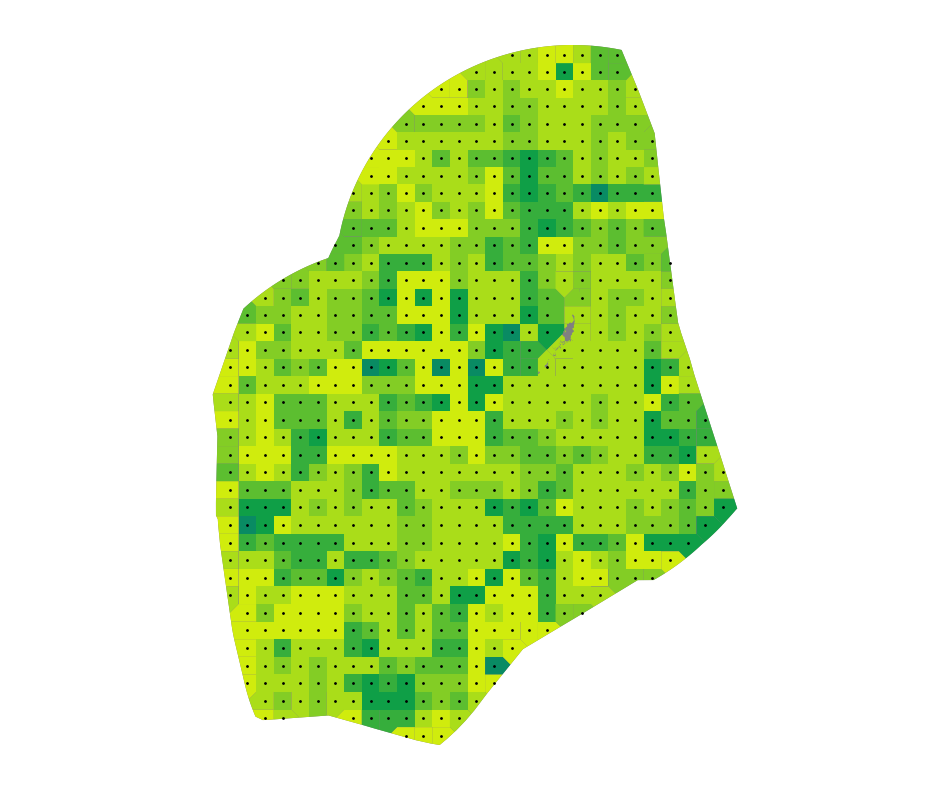

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2070_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


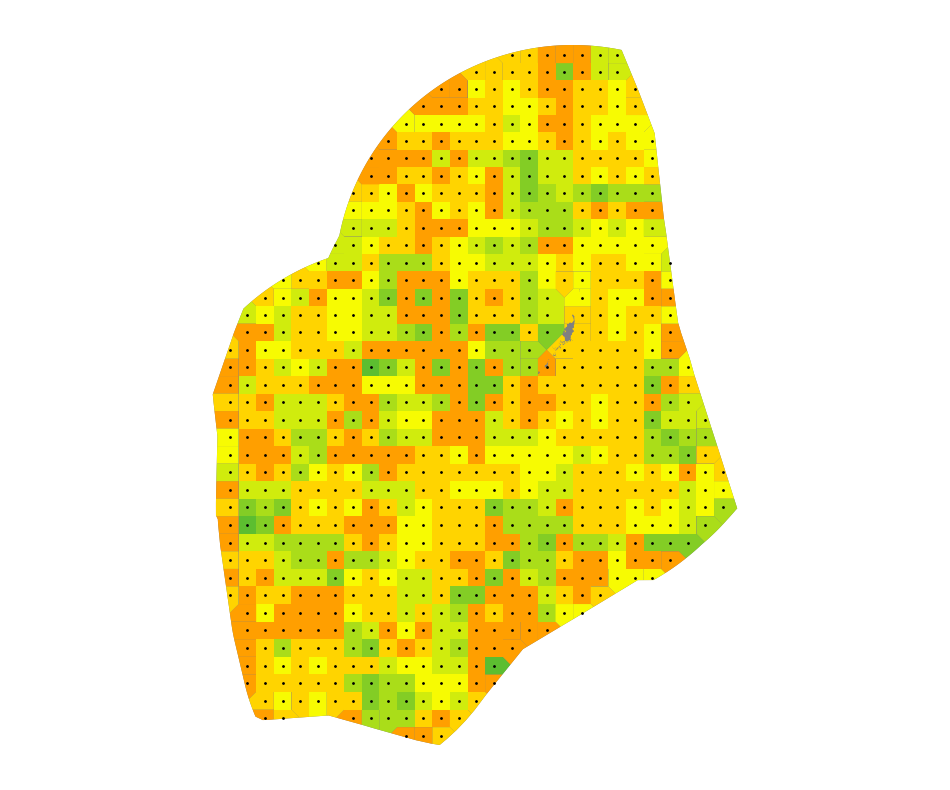

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2071_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


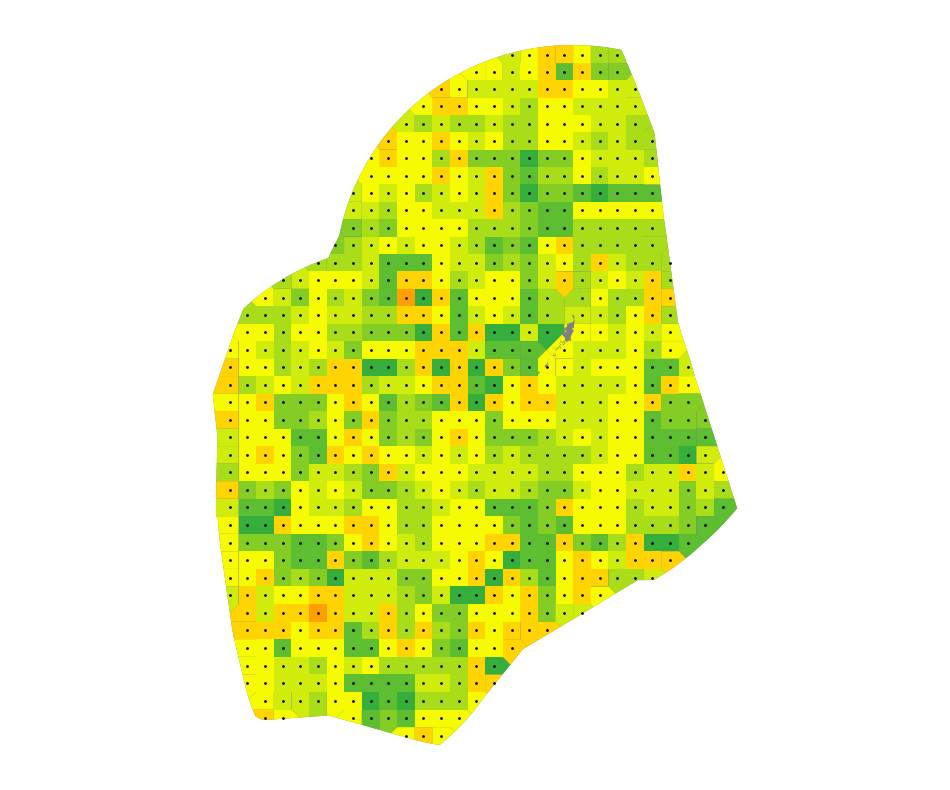

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2072_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


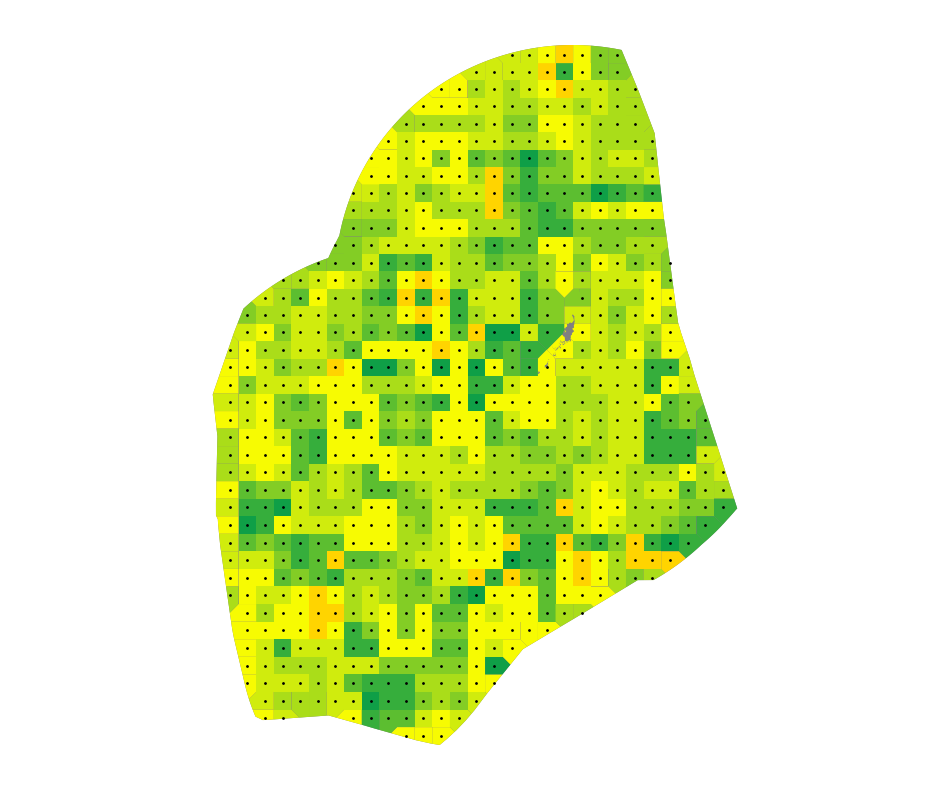

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2073_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


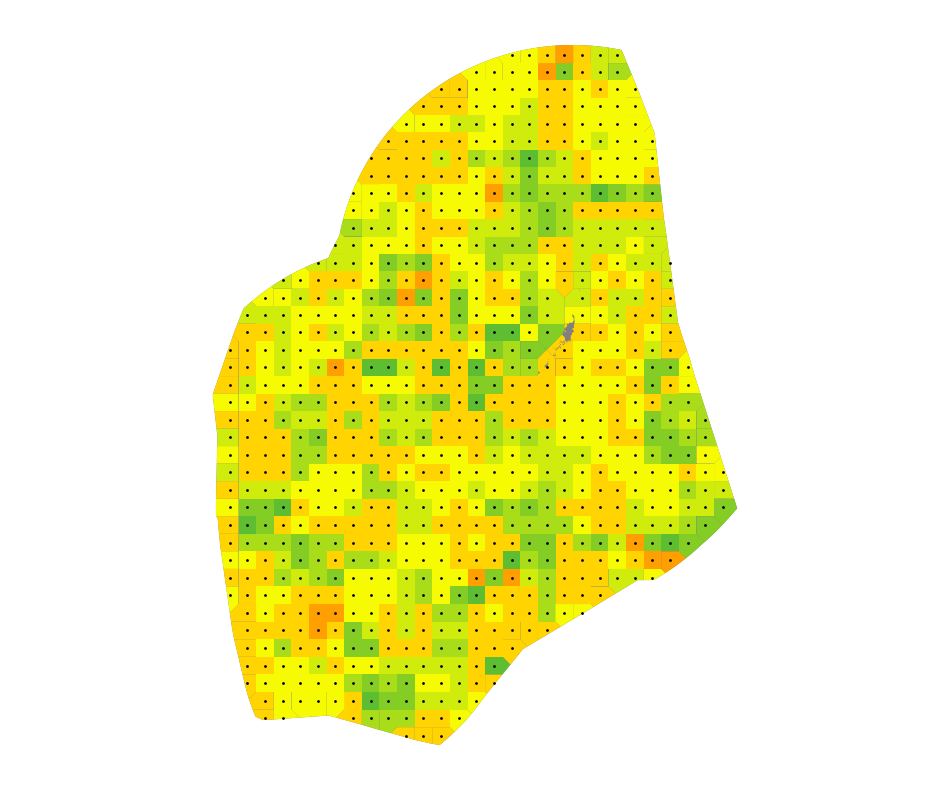

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2074_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


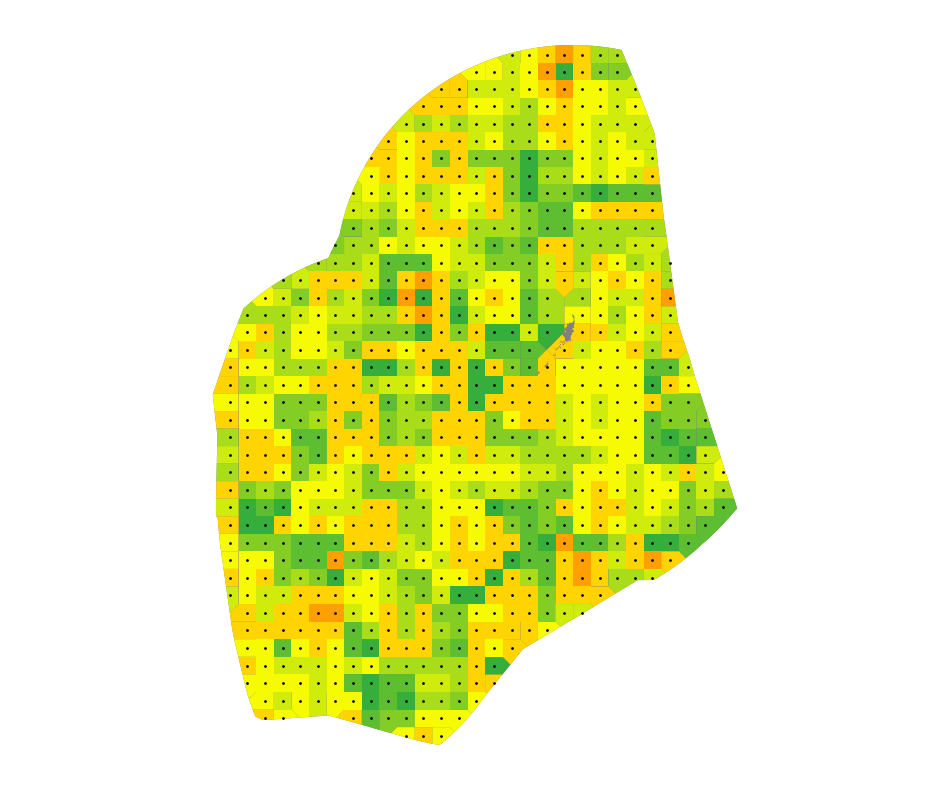

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2075_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


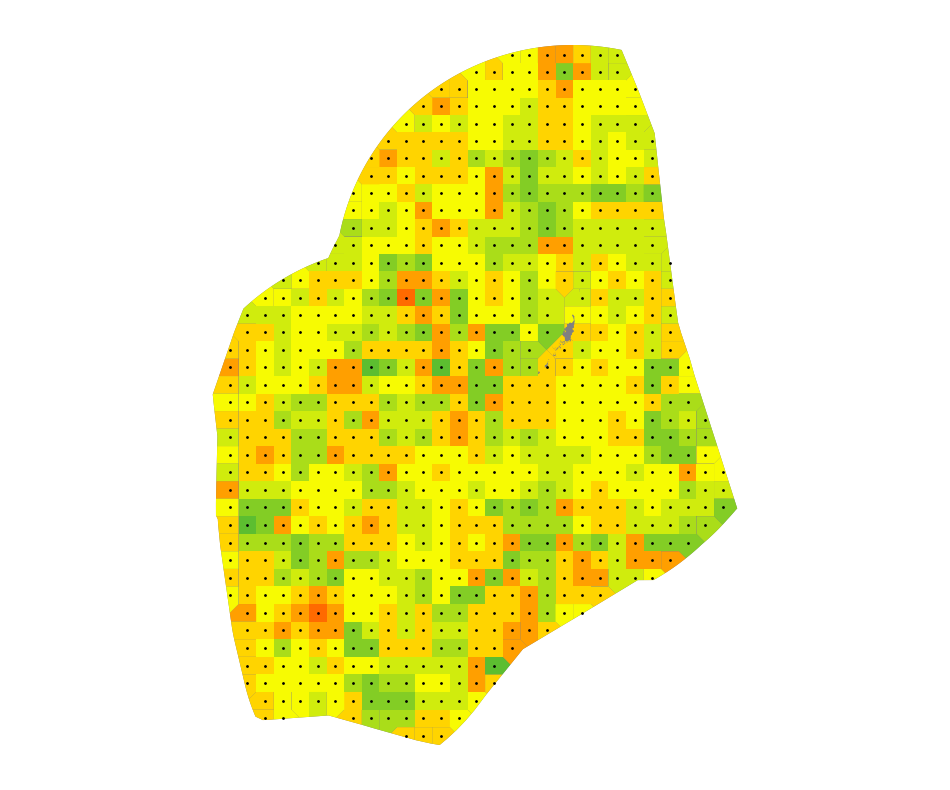

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2076_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


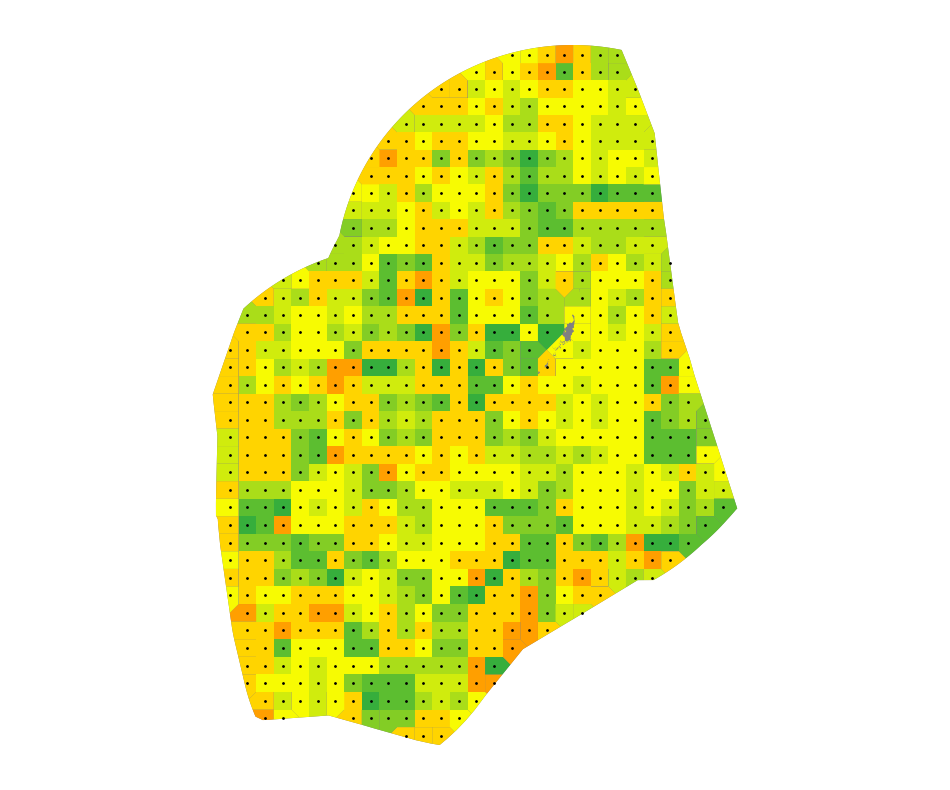

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2077_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


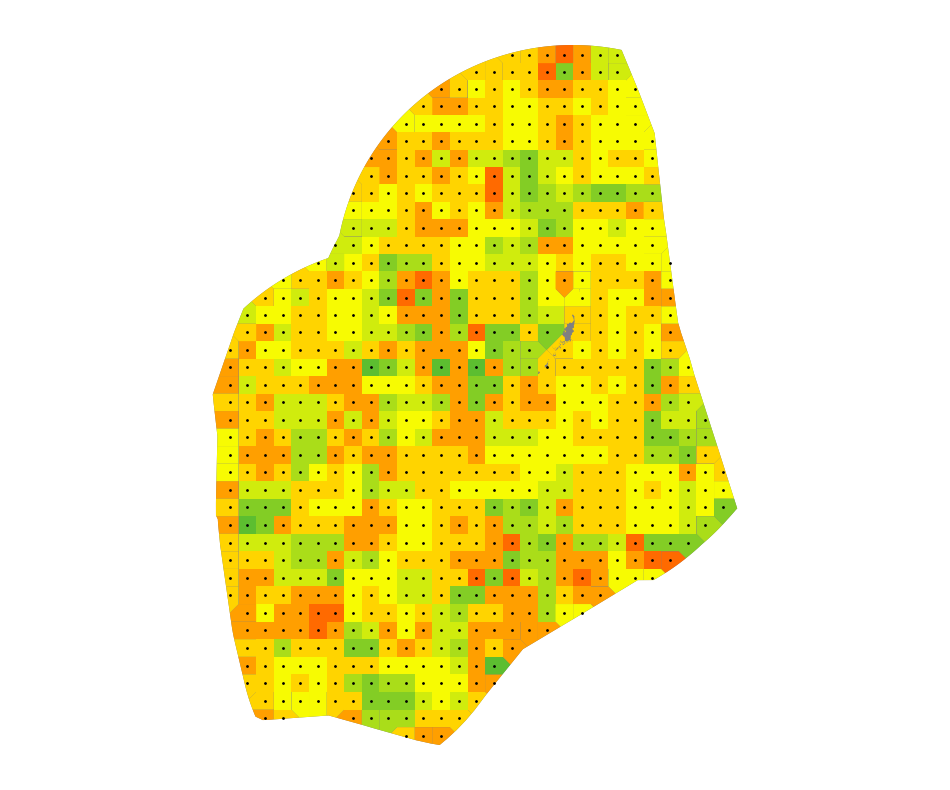

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2078_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


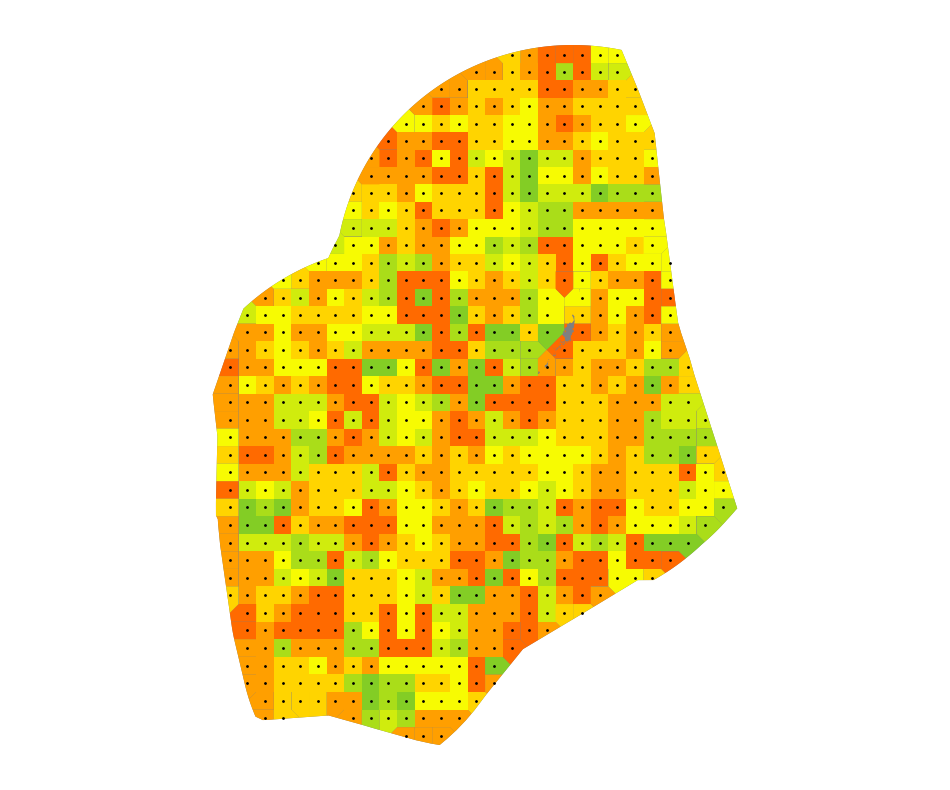

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2079_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


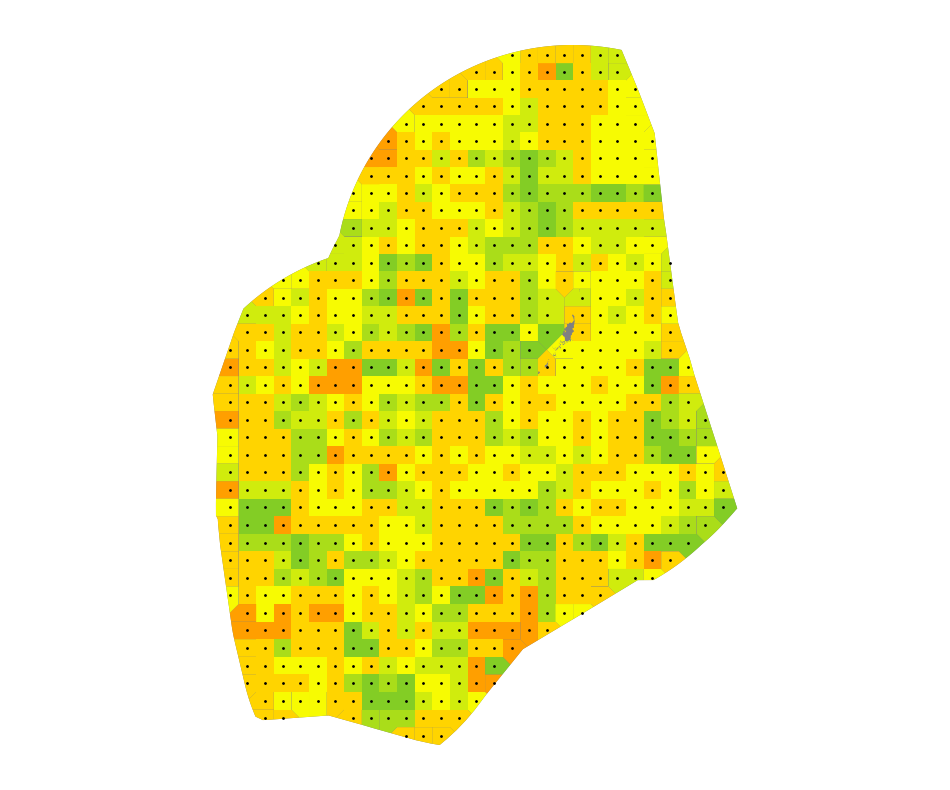

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2080_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


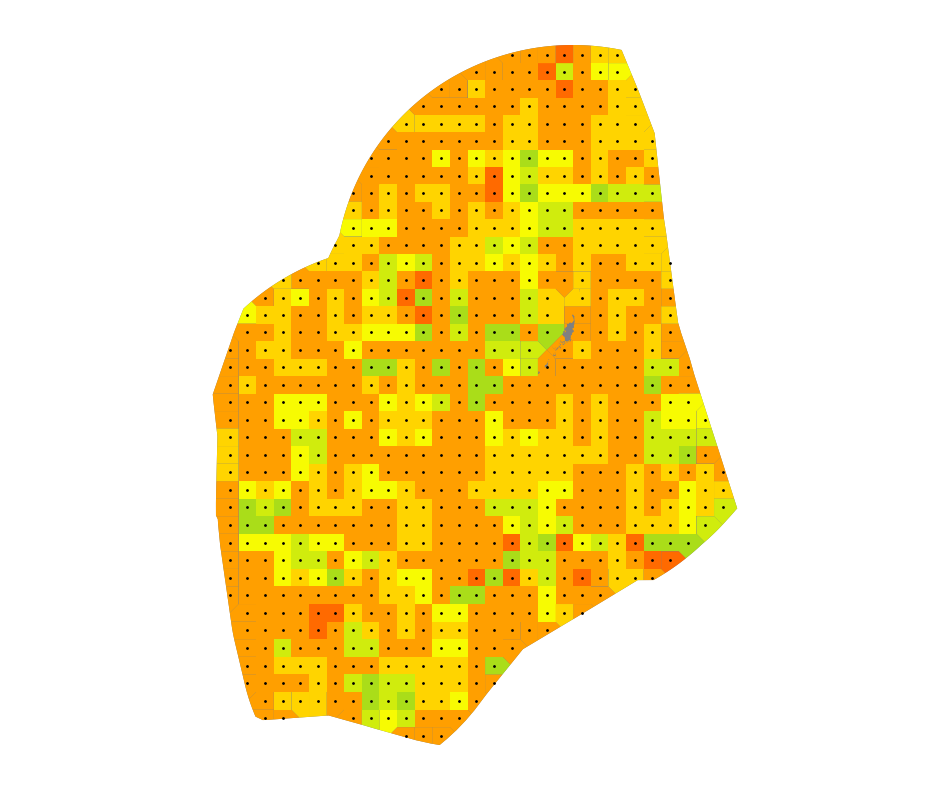

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2081_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


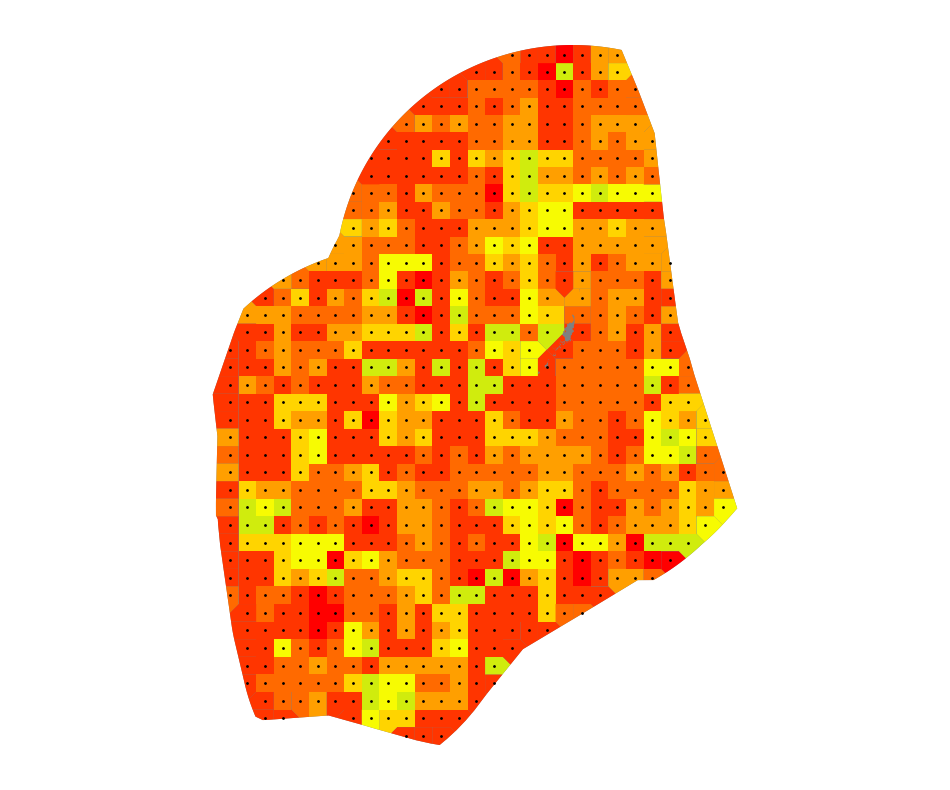

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2082_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


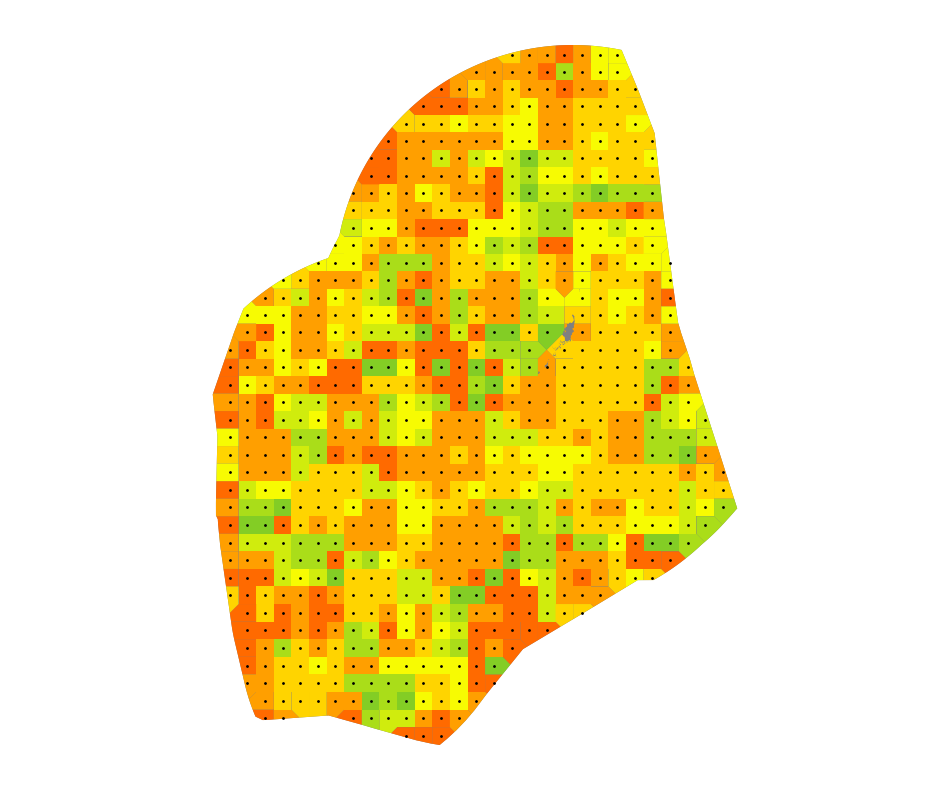

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2083_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


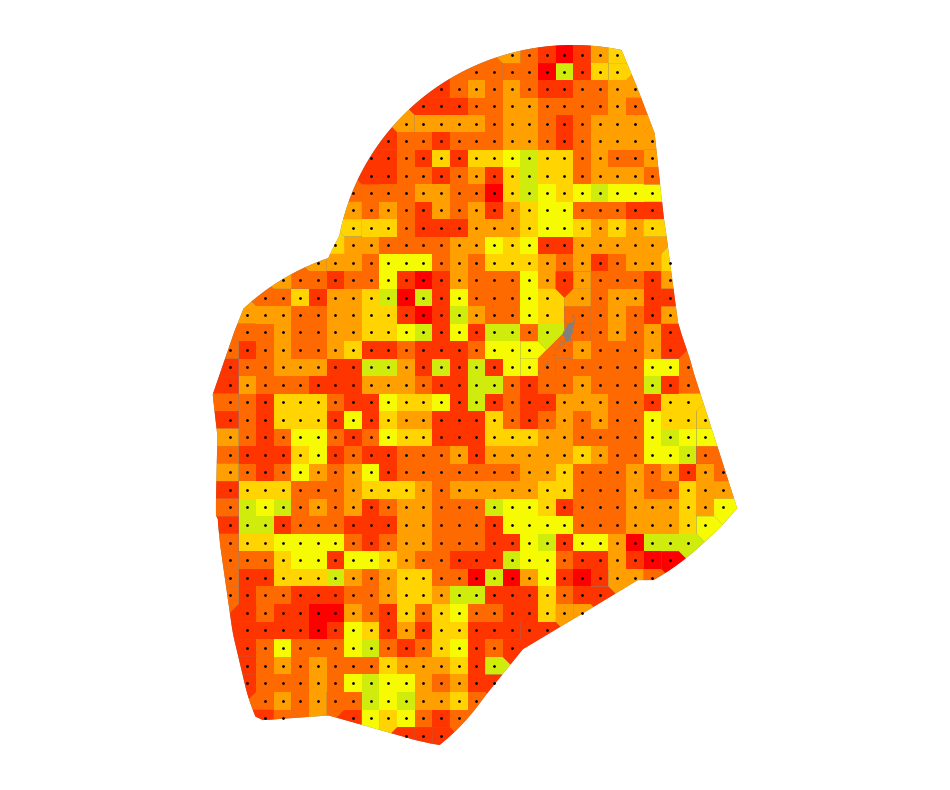

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2084_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


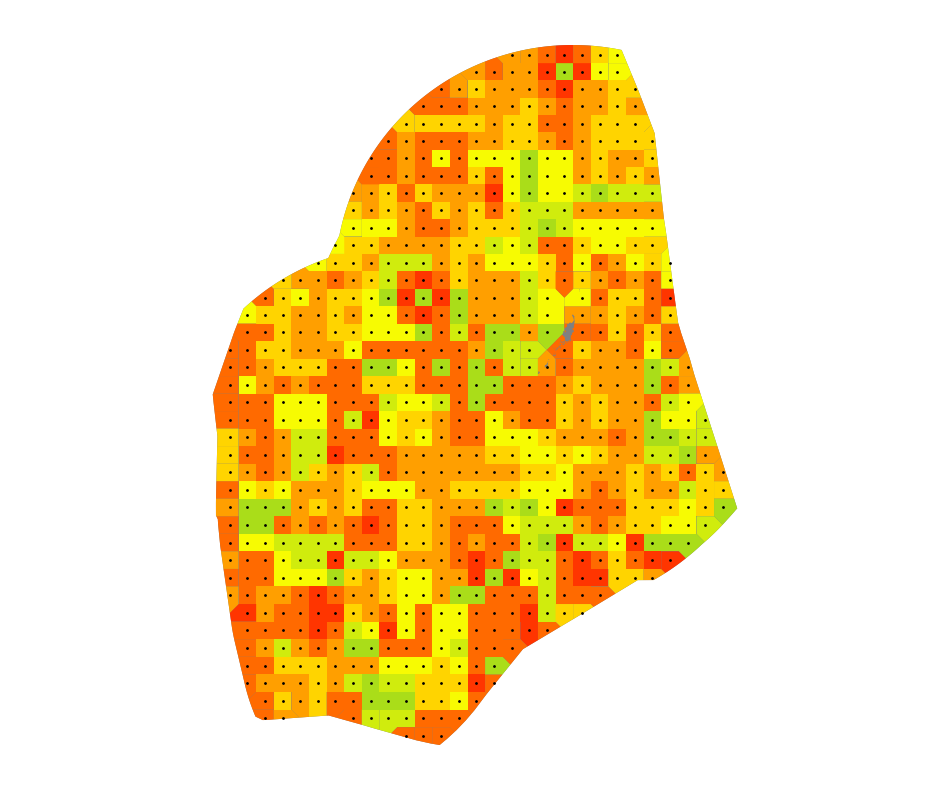

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2085_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


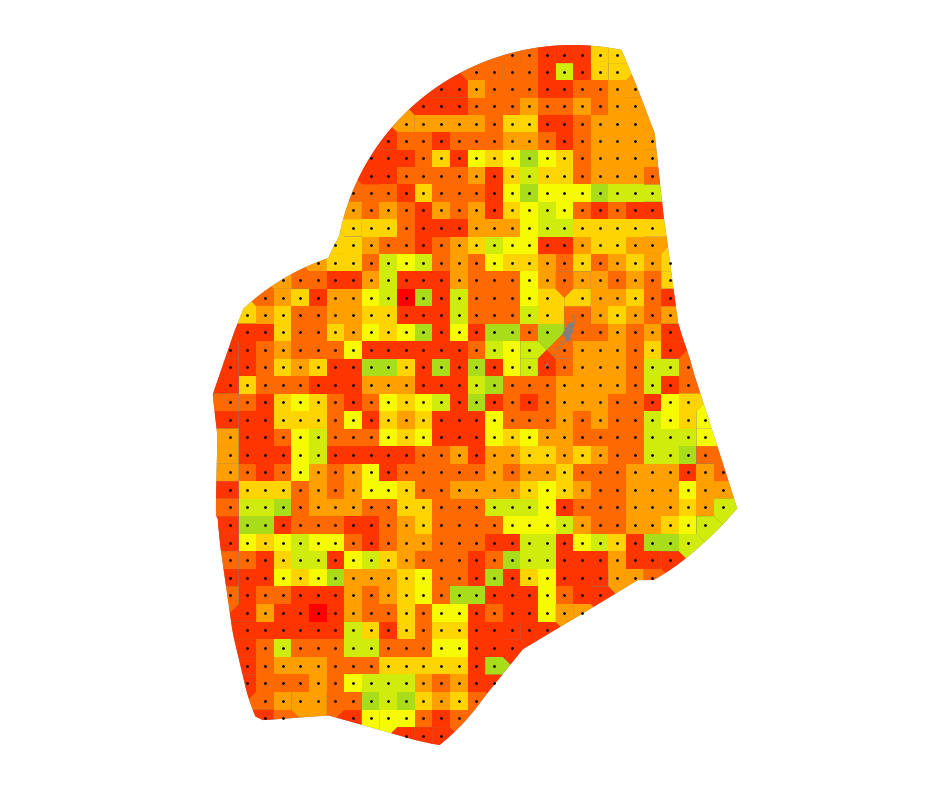

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2086_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


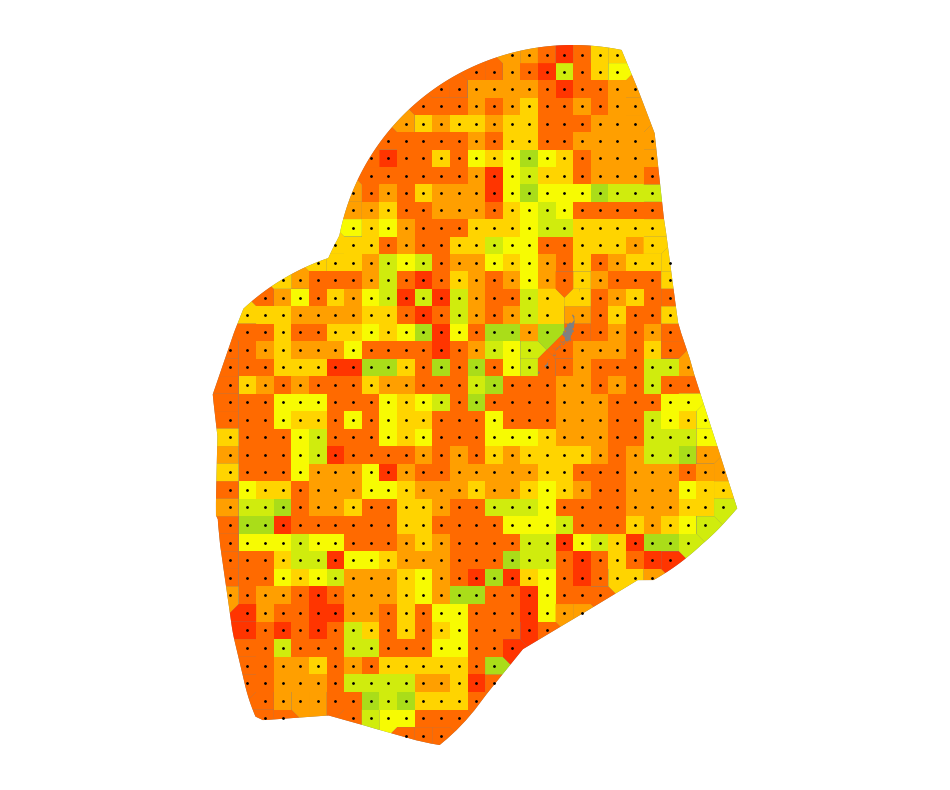

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2087_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


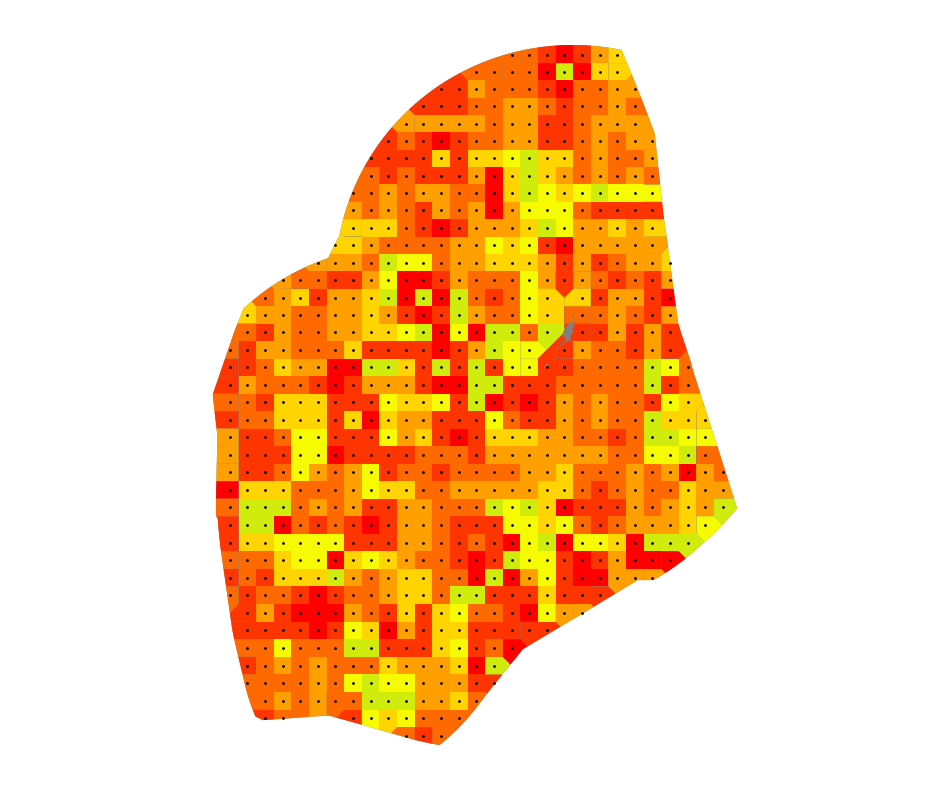

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2088_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


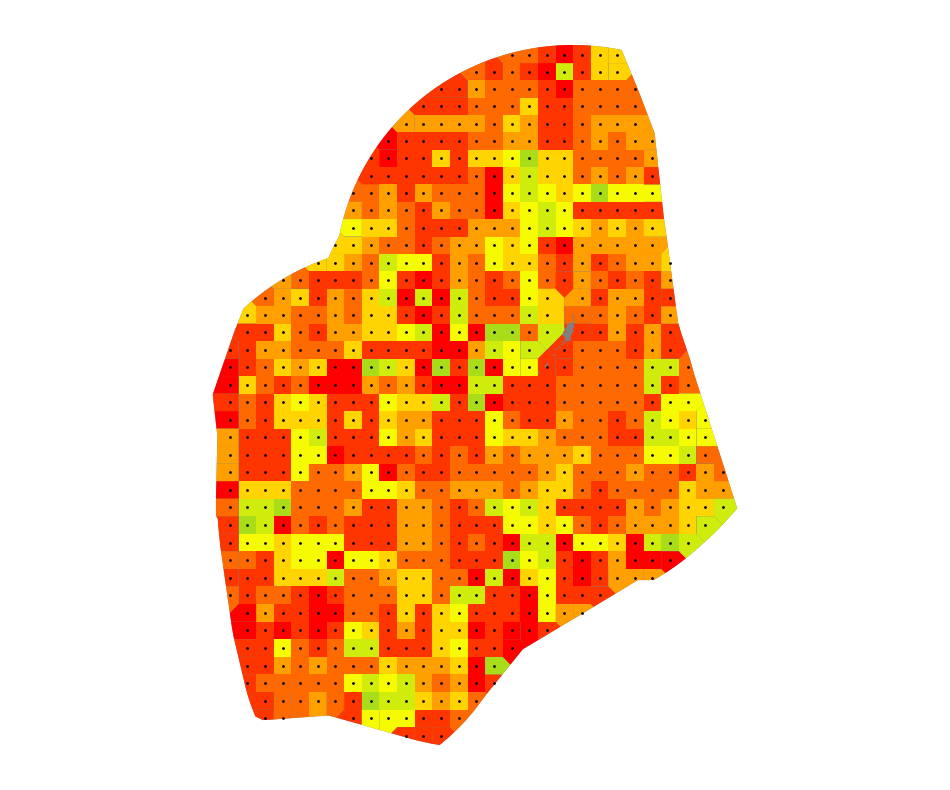

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2089_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


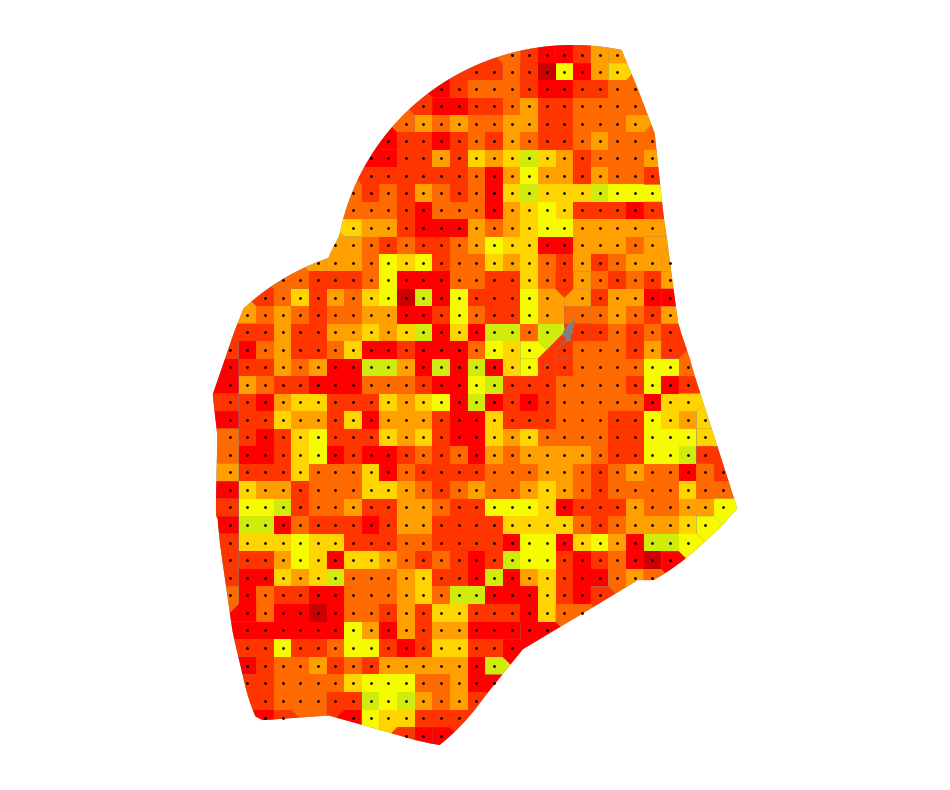

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2090_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


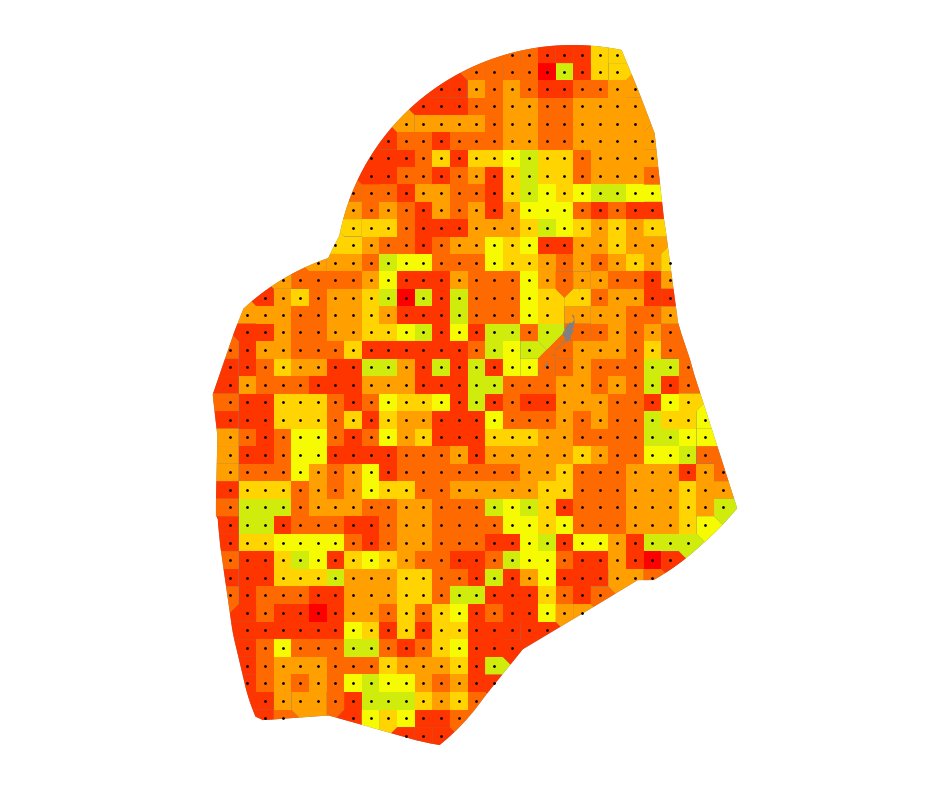

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2091_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


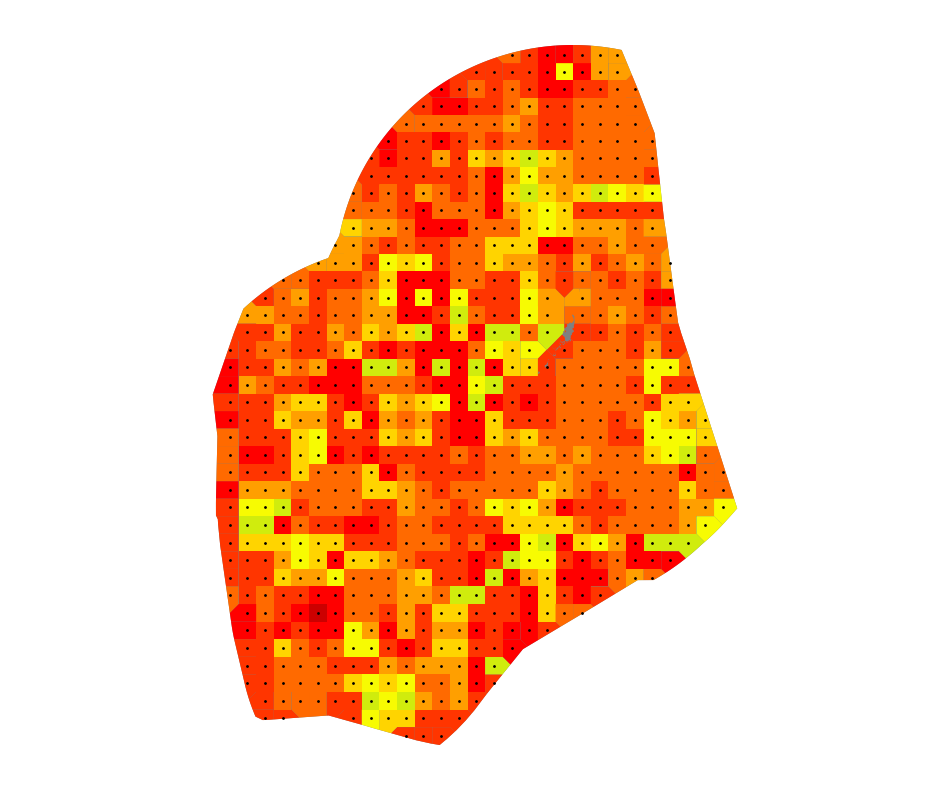

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2092_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


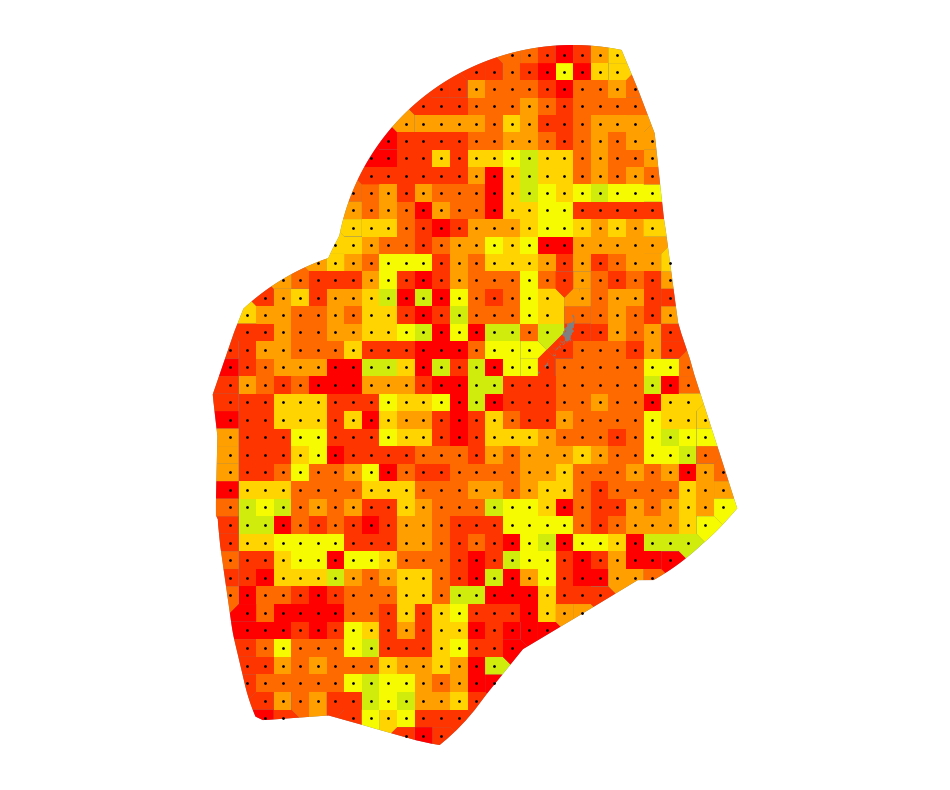

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2093_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


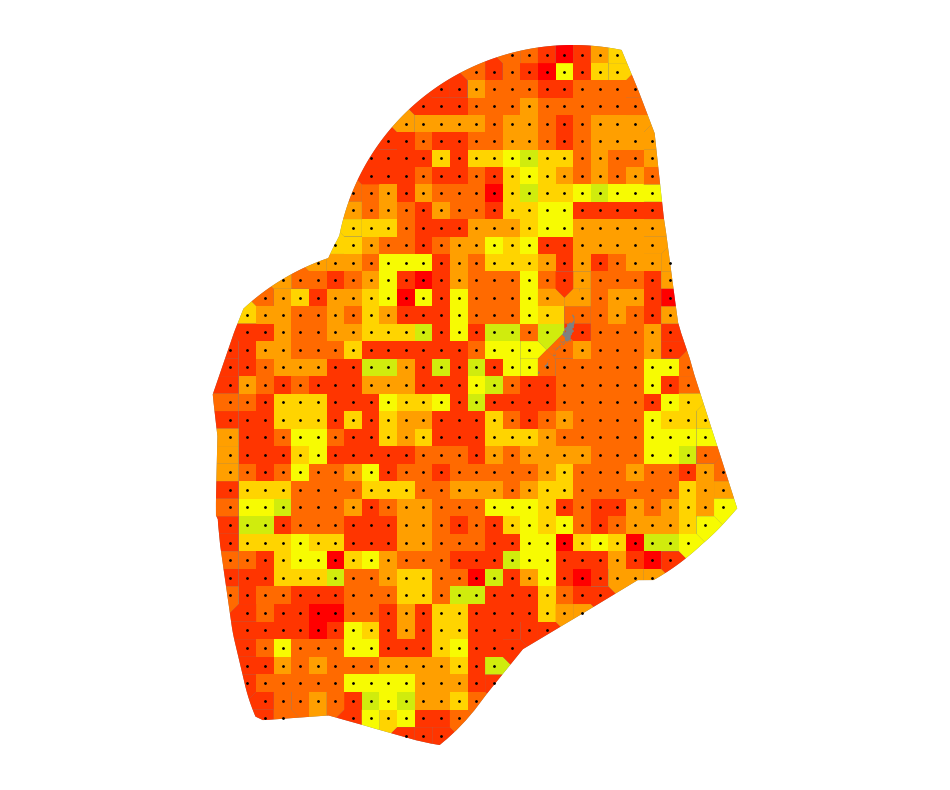

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2094_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


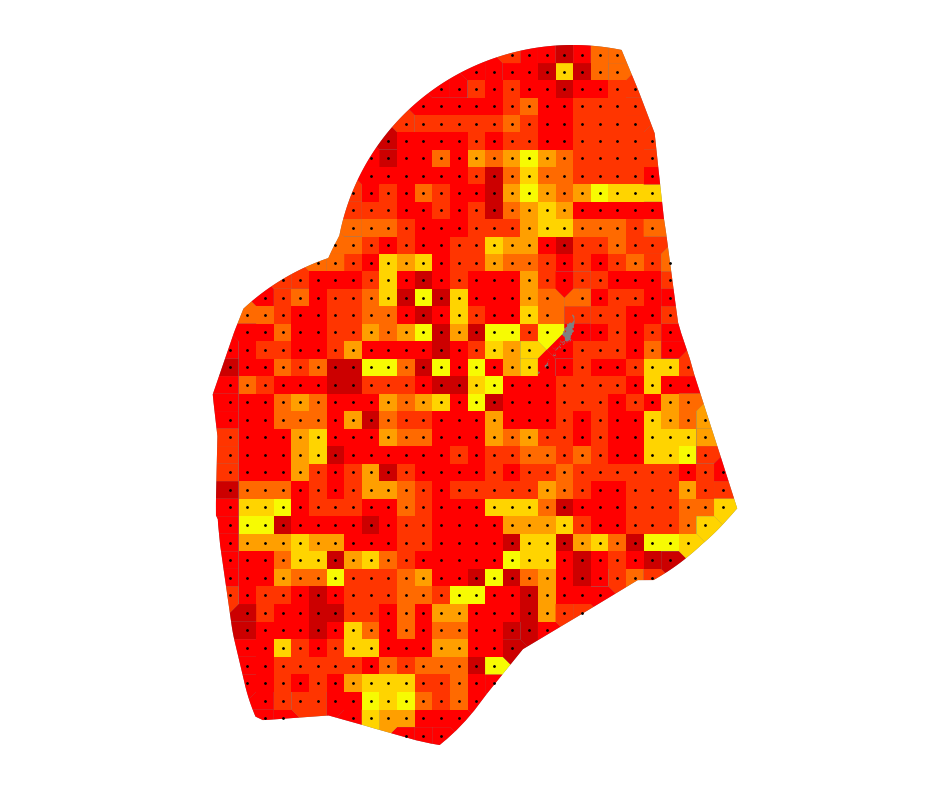

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2095_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


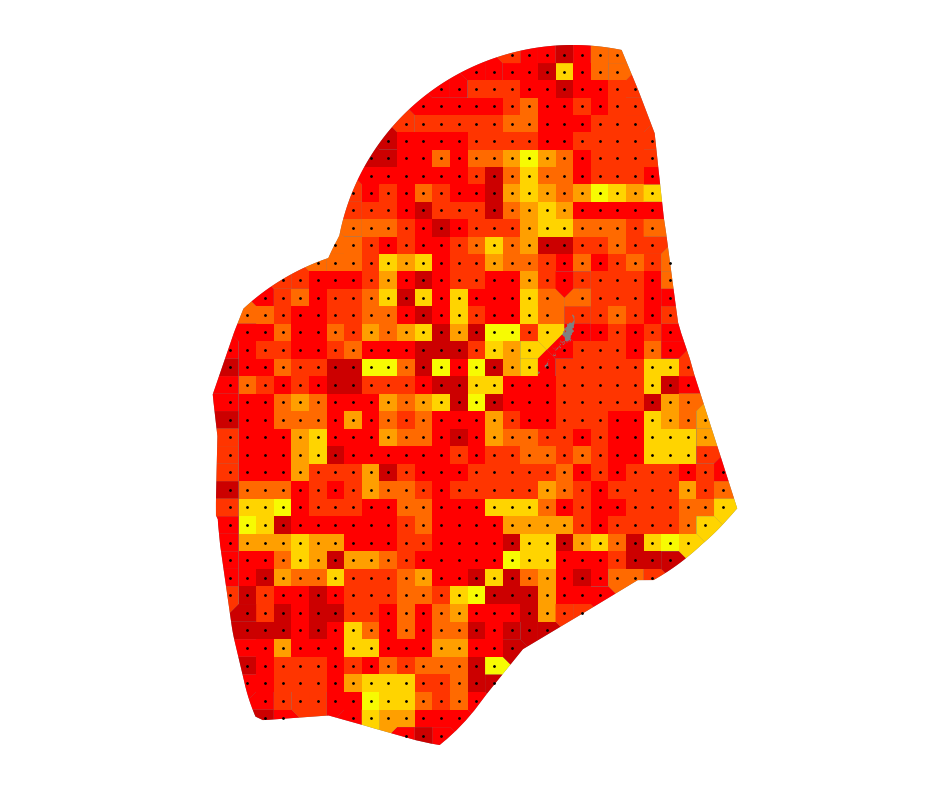

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2096_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


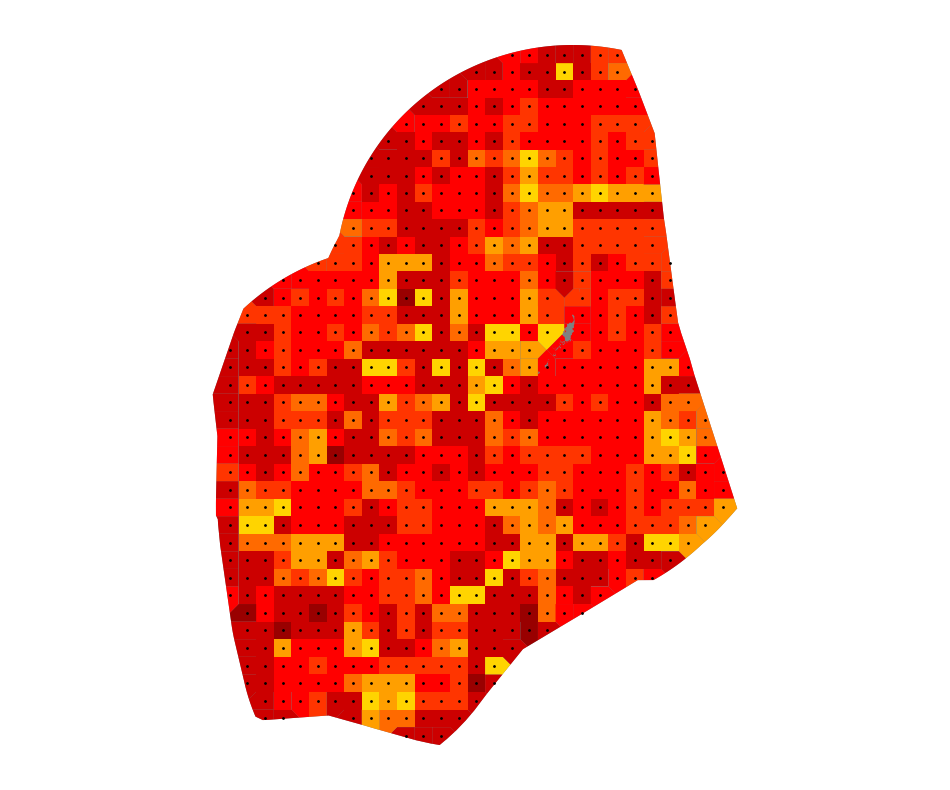

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2097_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


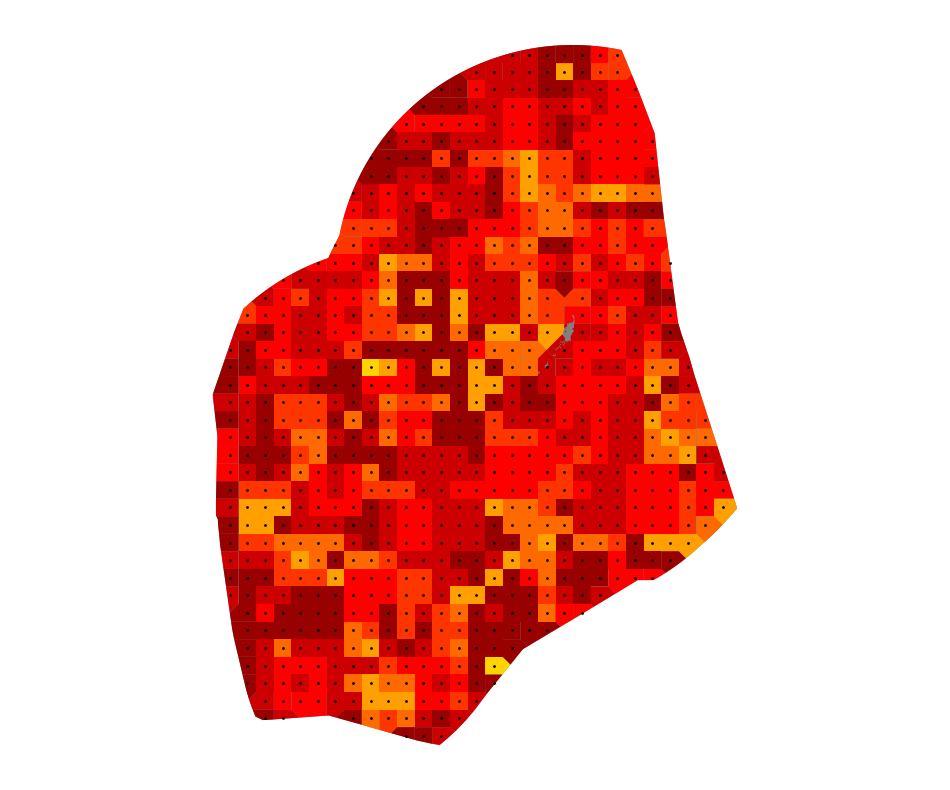

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2098_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


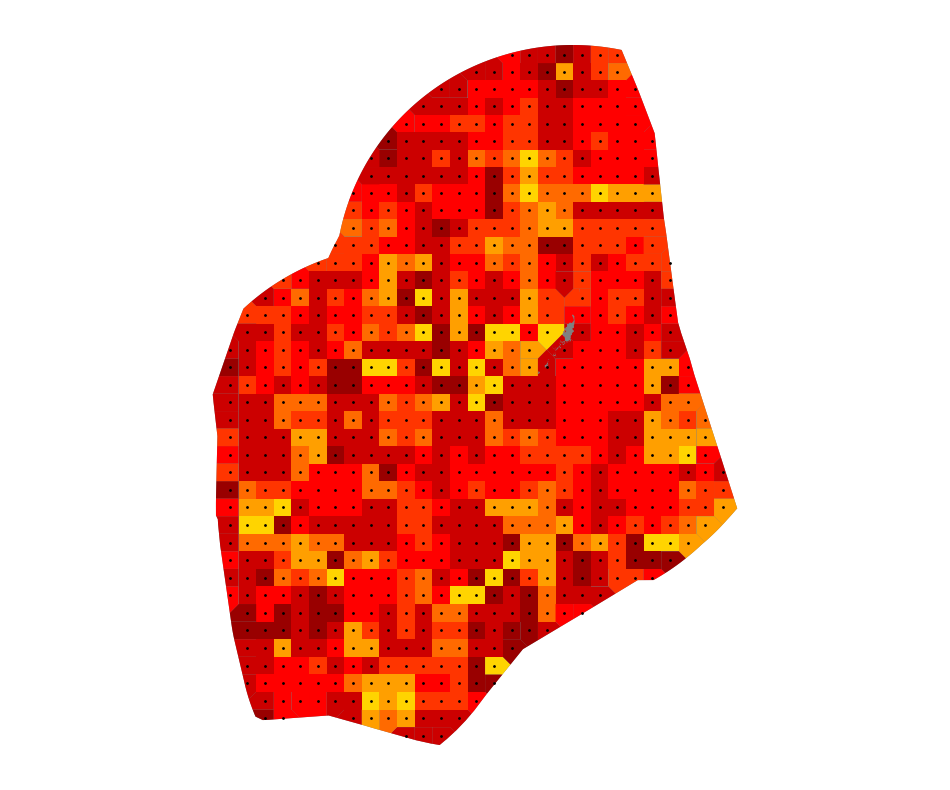

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2099_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


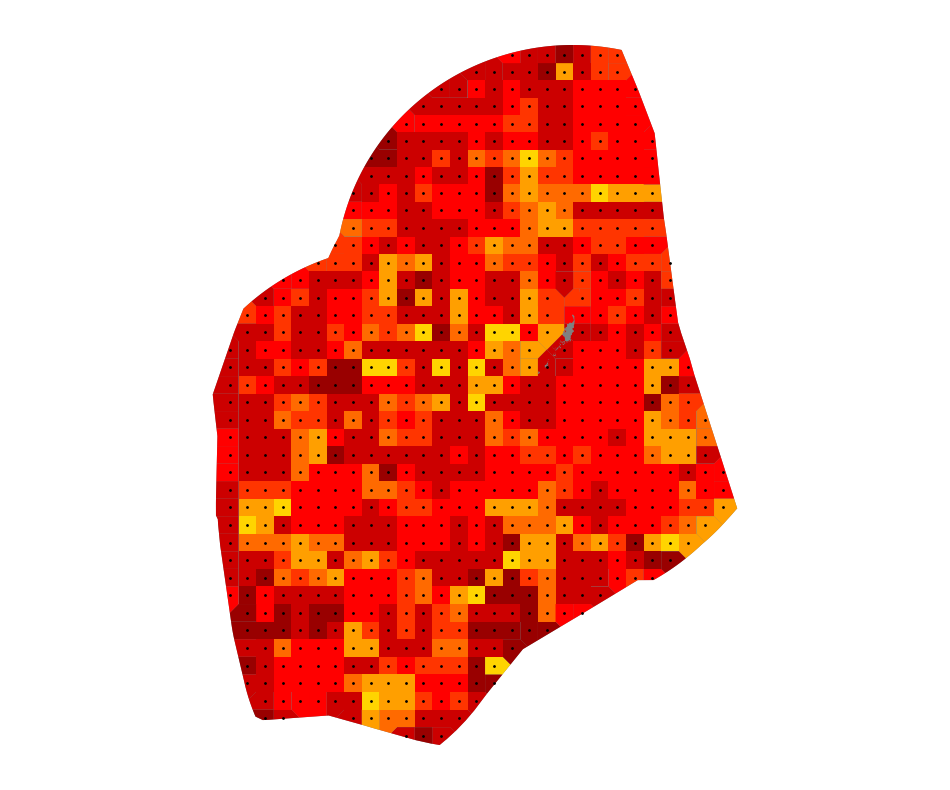

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3/2100_tos_Omon_HadGEM3-GC31-MM_ssp585_r3i1p1f3.json
HadGEM3-GC31-MM historical
latlon_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3_.pkl
Created: 1850-2014_colorbar_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.png


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


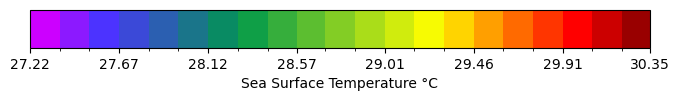

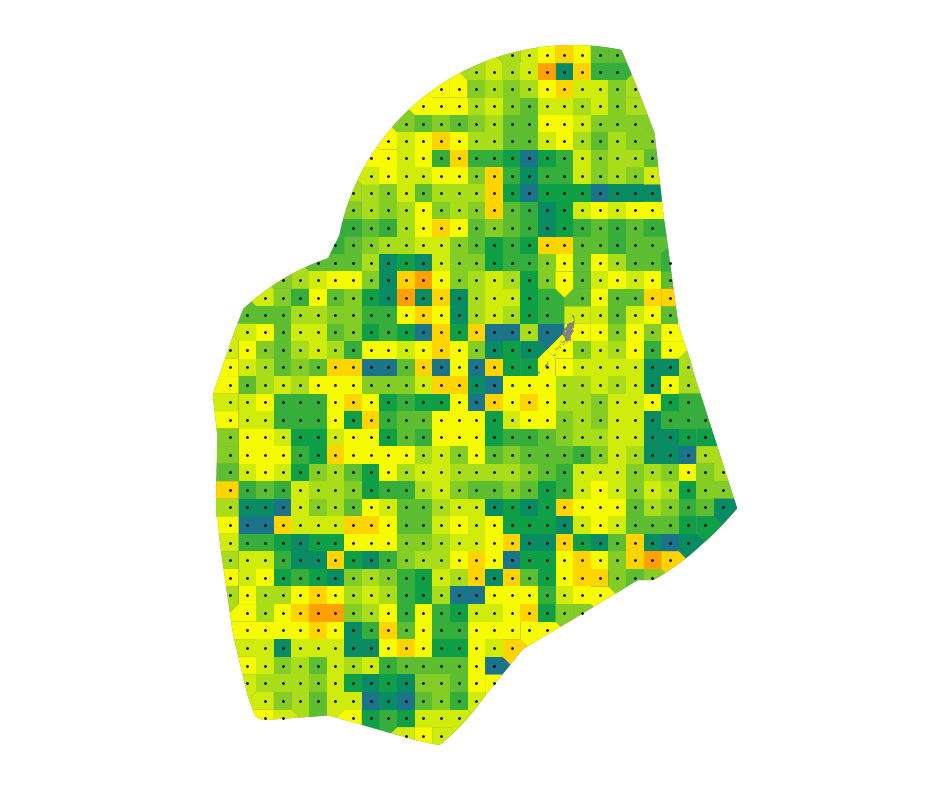

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1850_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


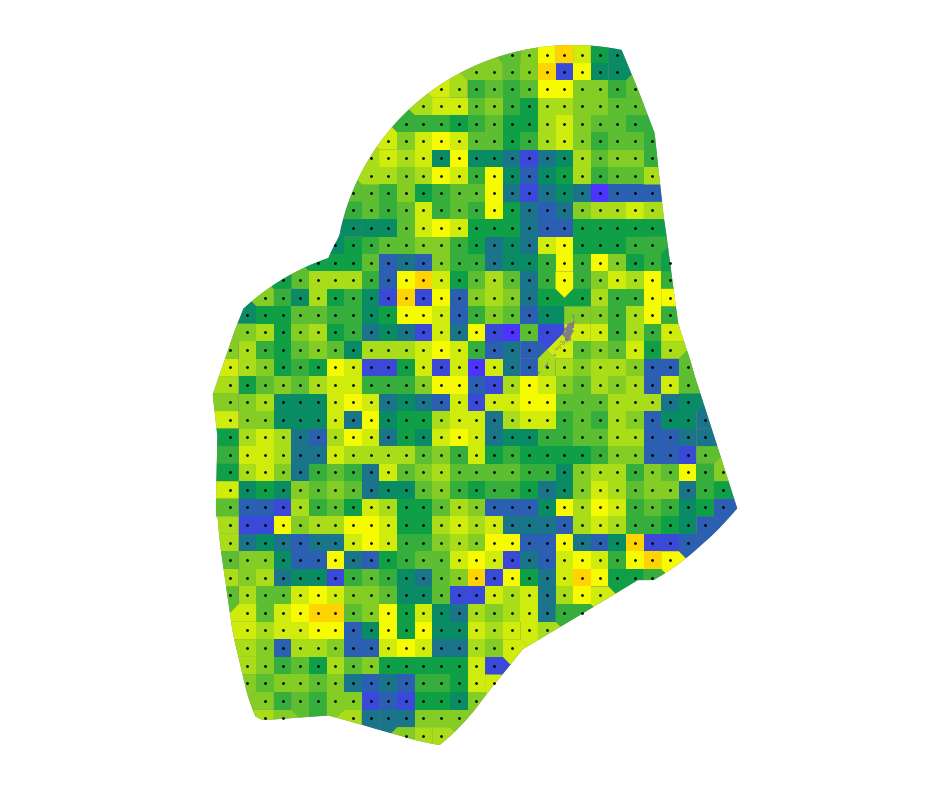

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1851_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


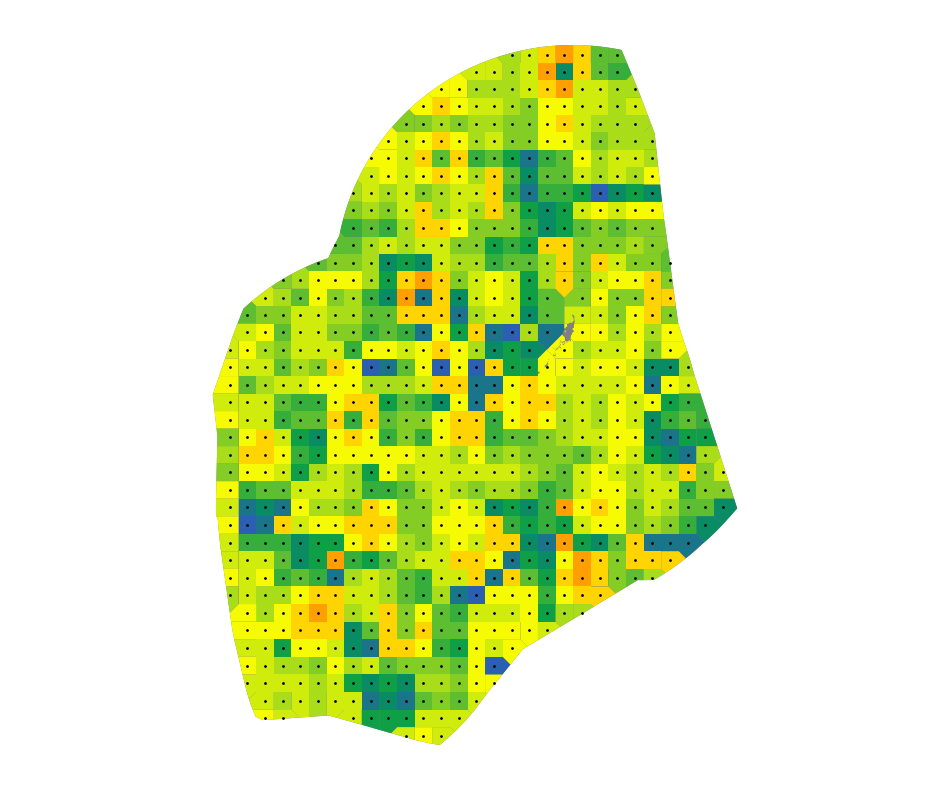

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1852_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


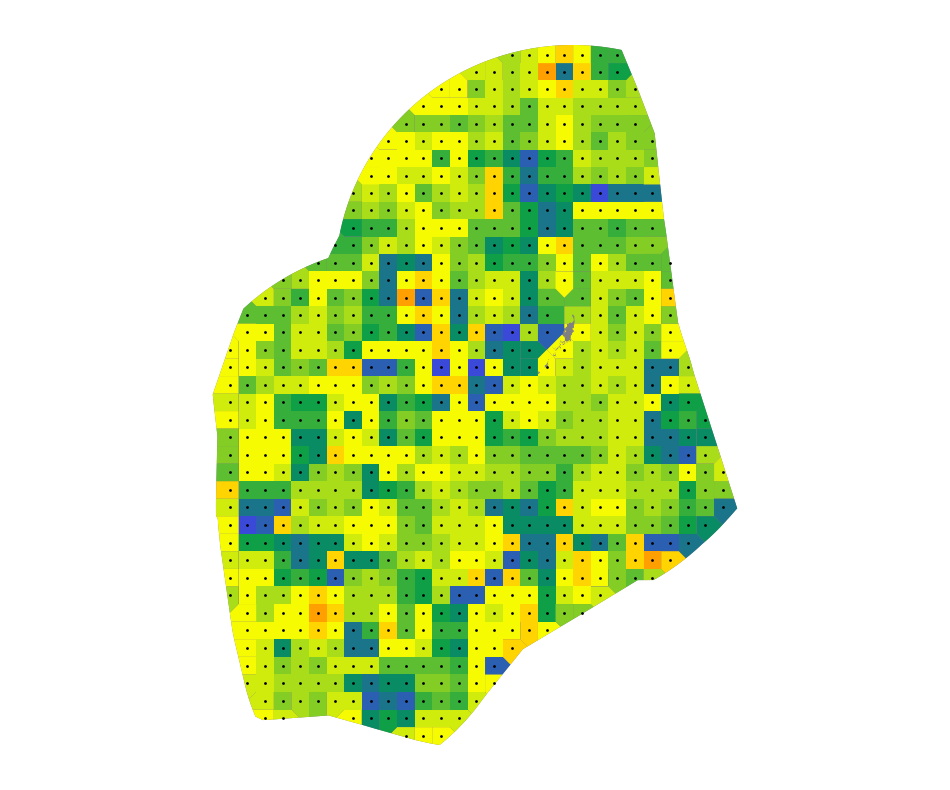

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1853_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


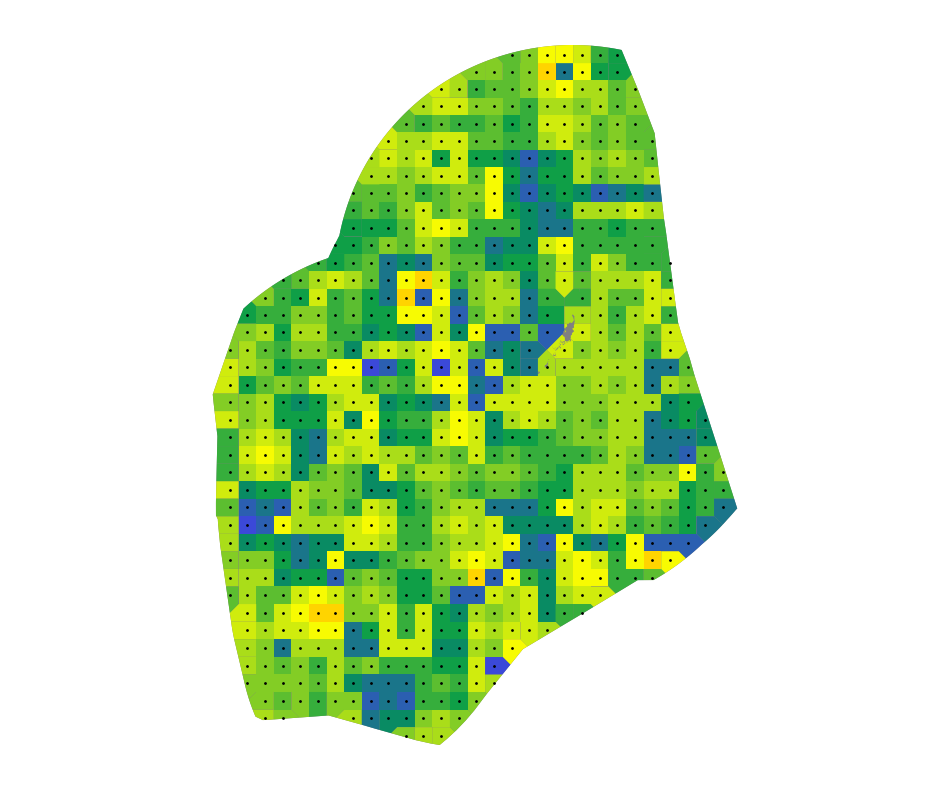

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1854_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


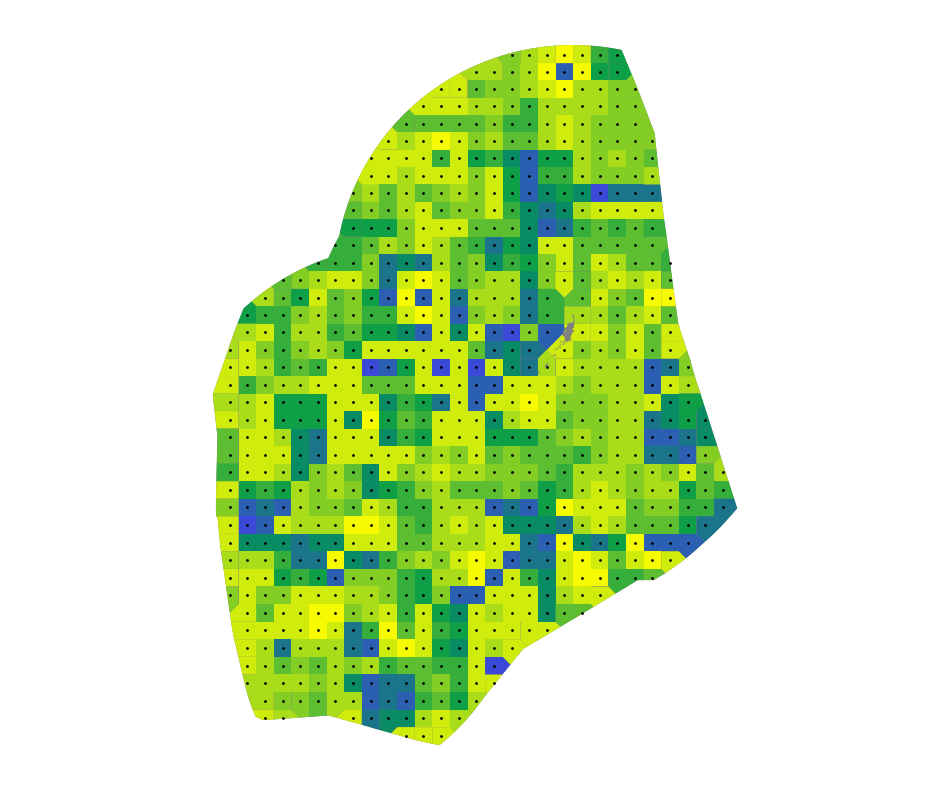

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1855_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


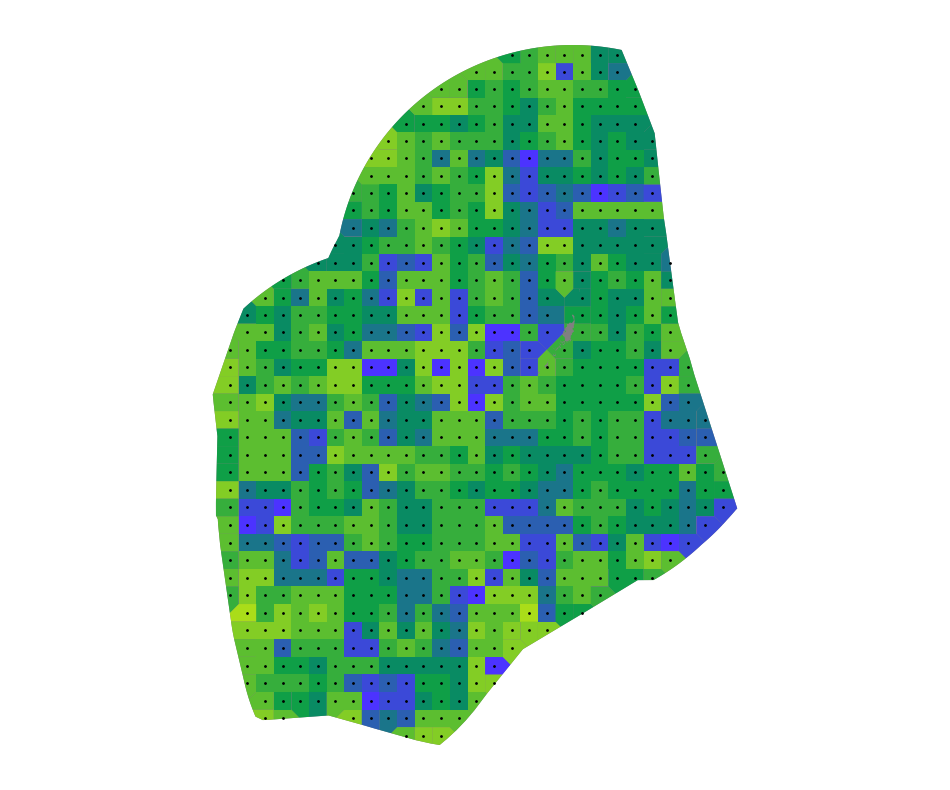

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1856_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


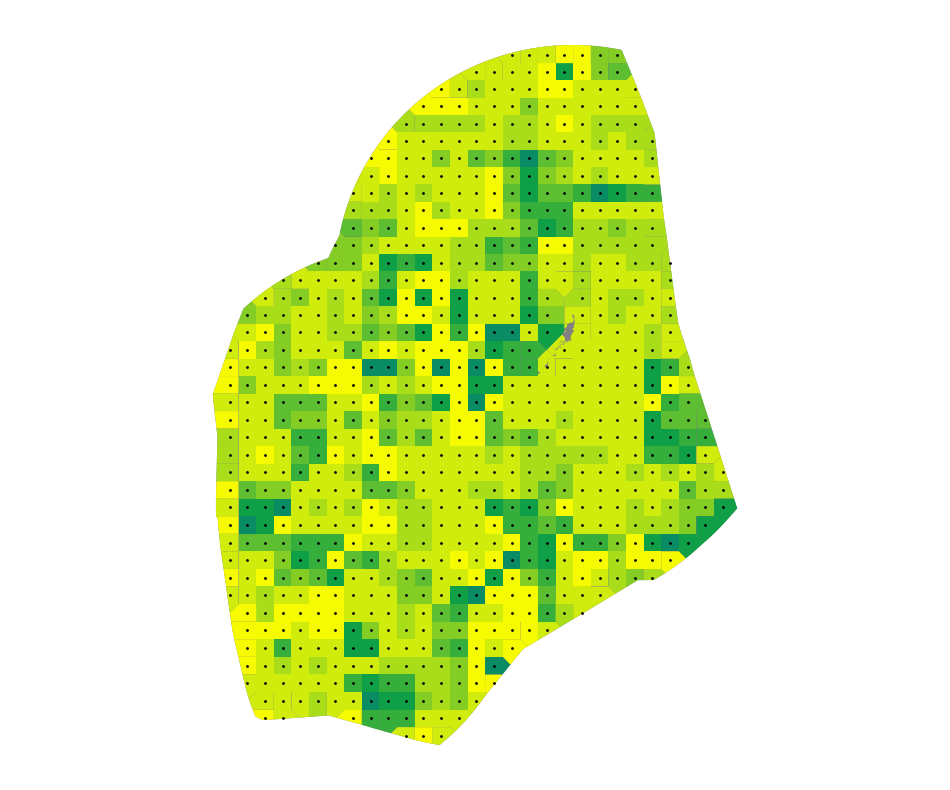

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1857_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


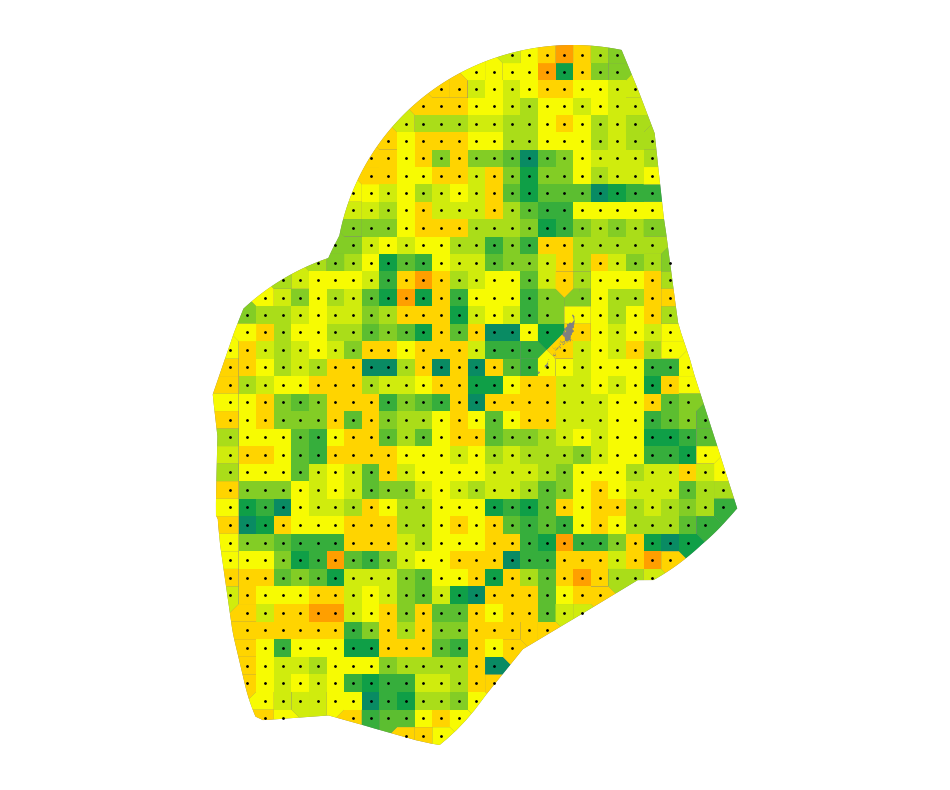

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1858_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


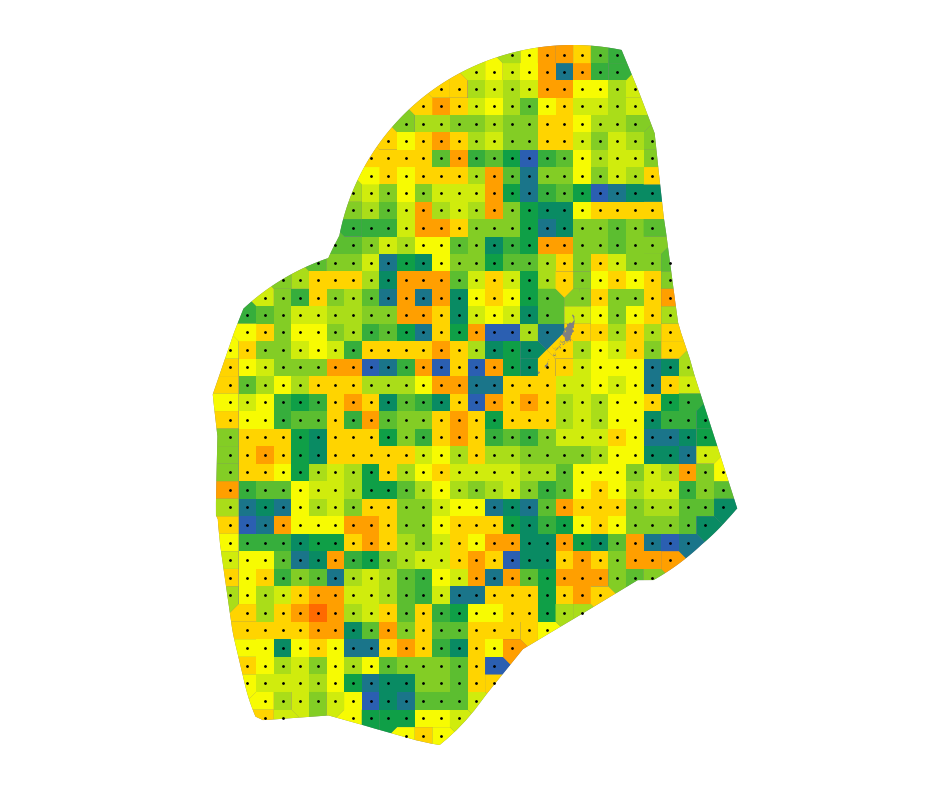

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1859_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


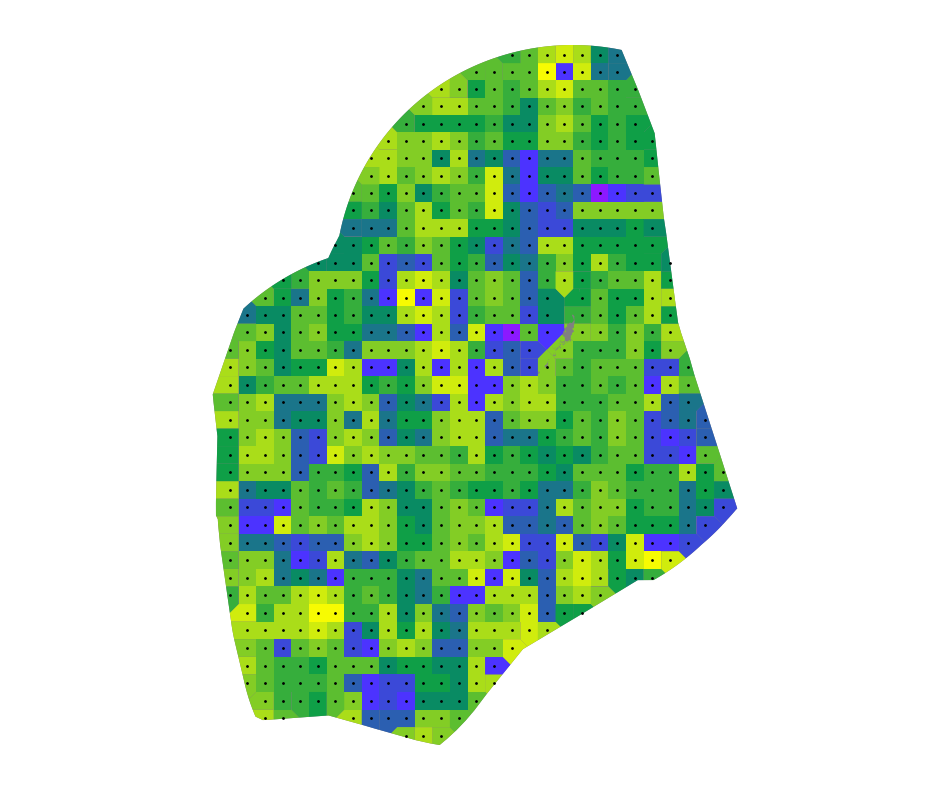

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1860_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


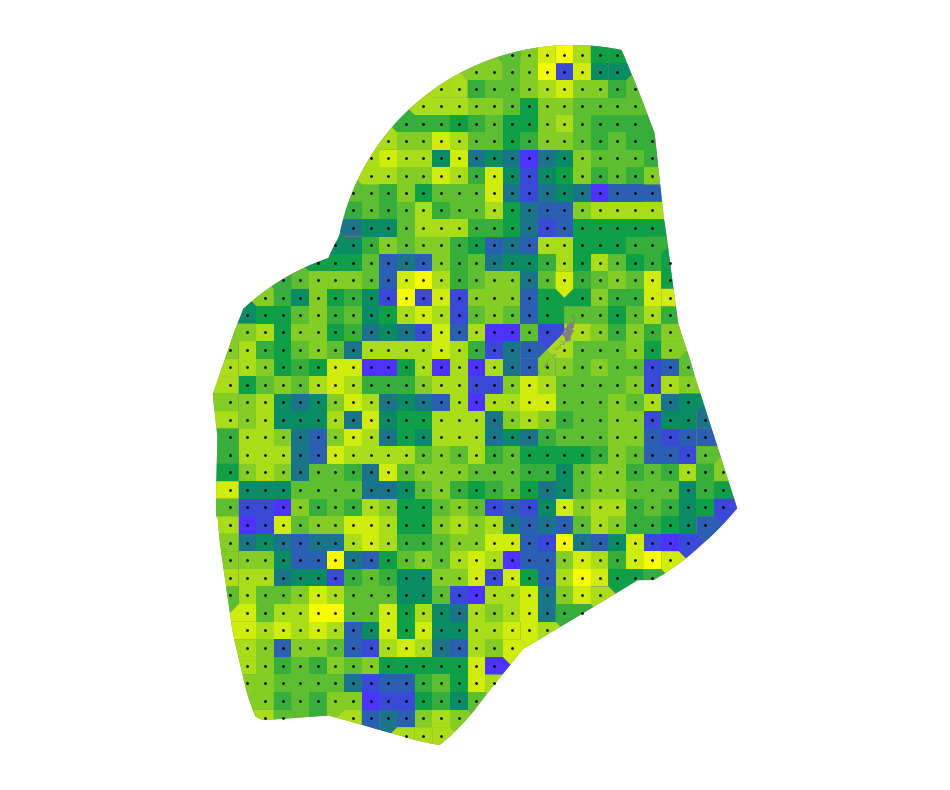

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1861_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


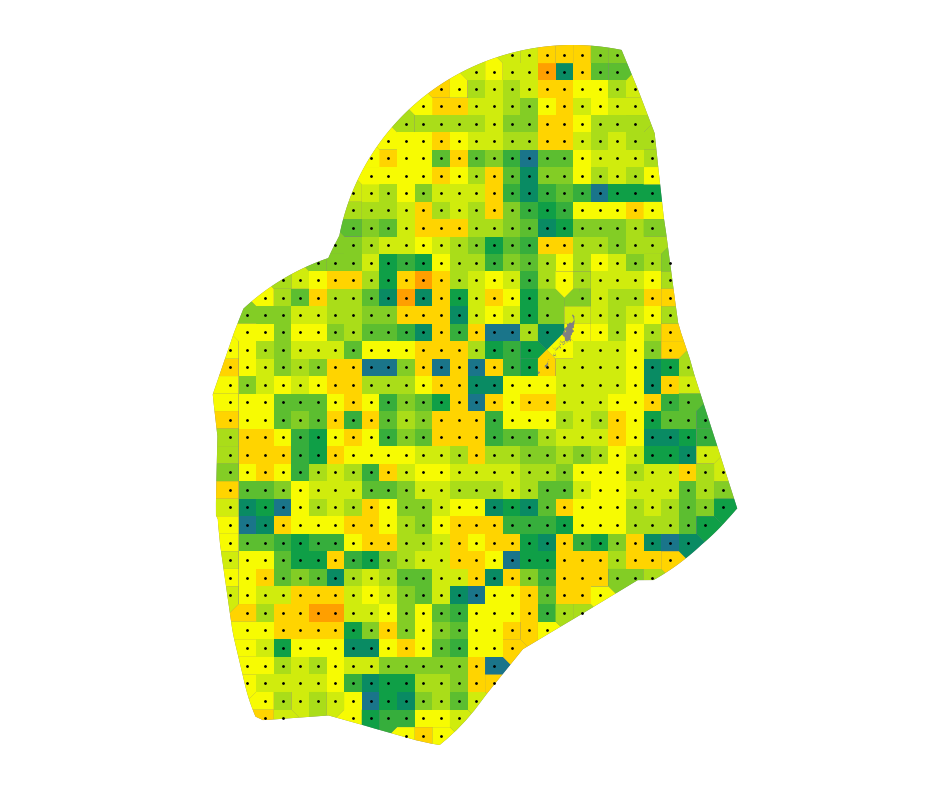

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1862_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


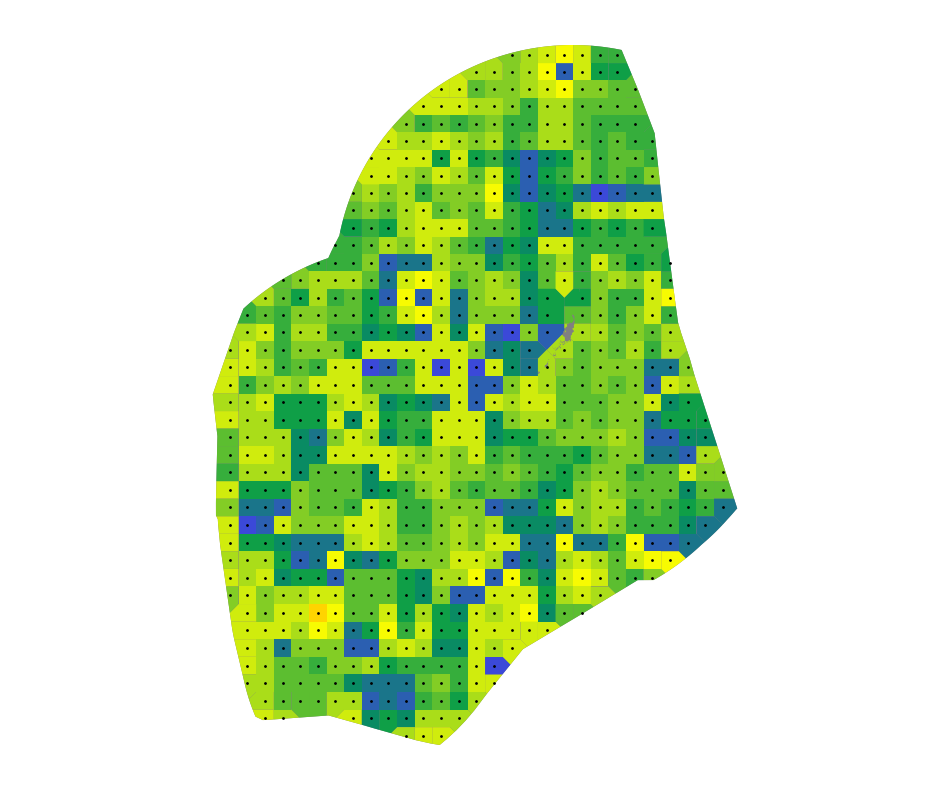

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1863_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


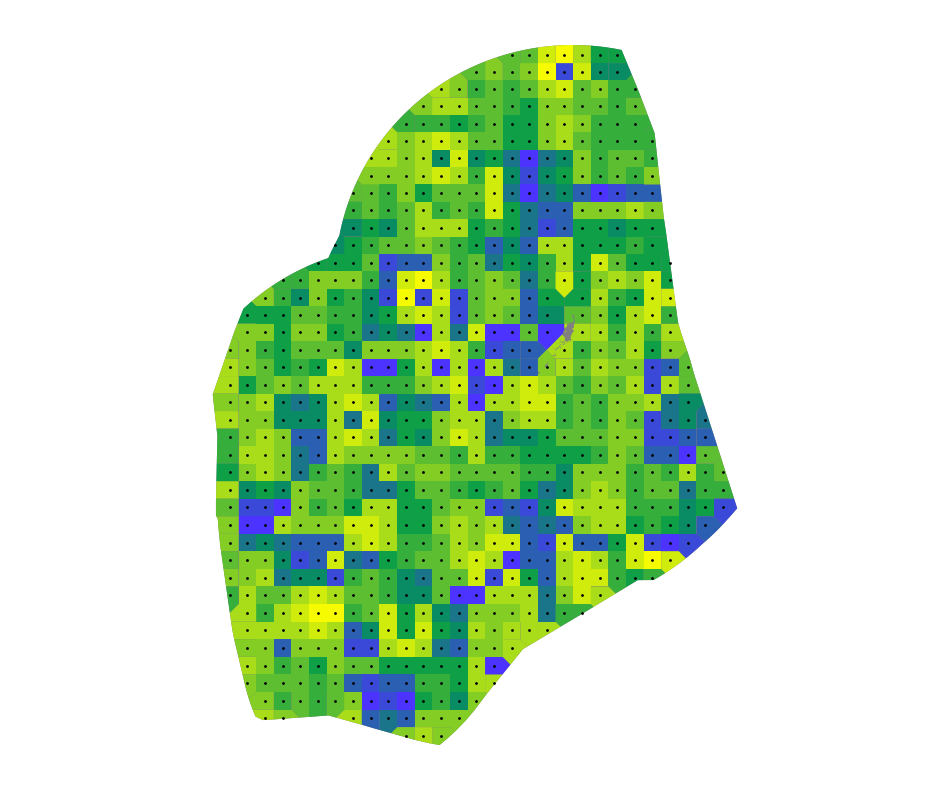

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1864_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


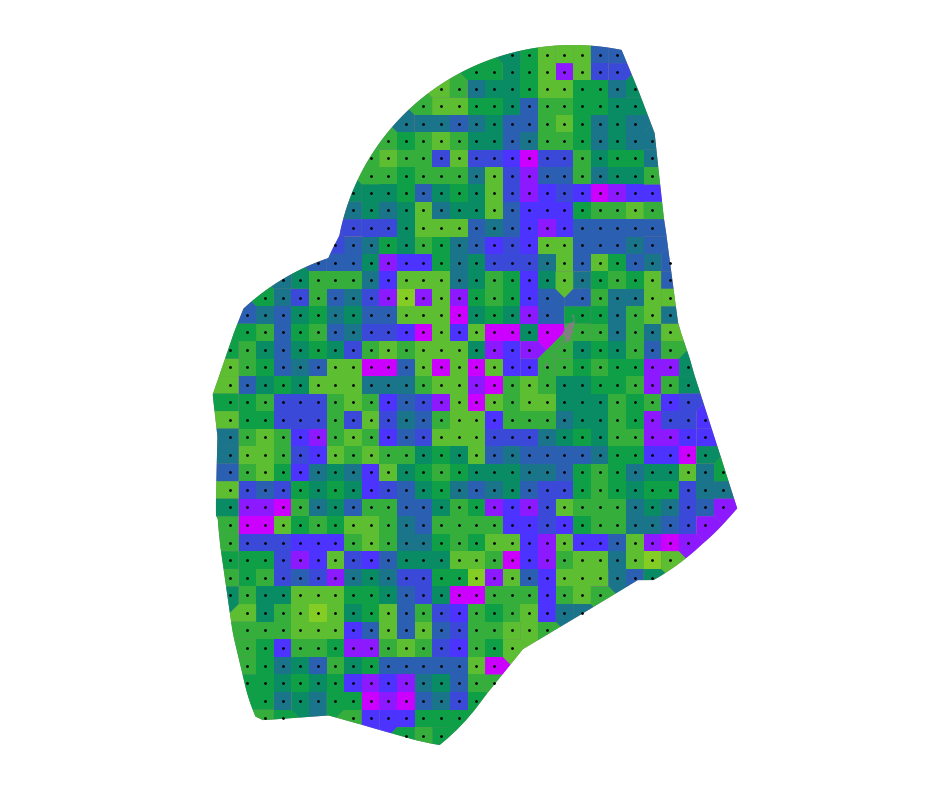

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1865_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


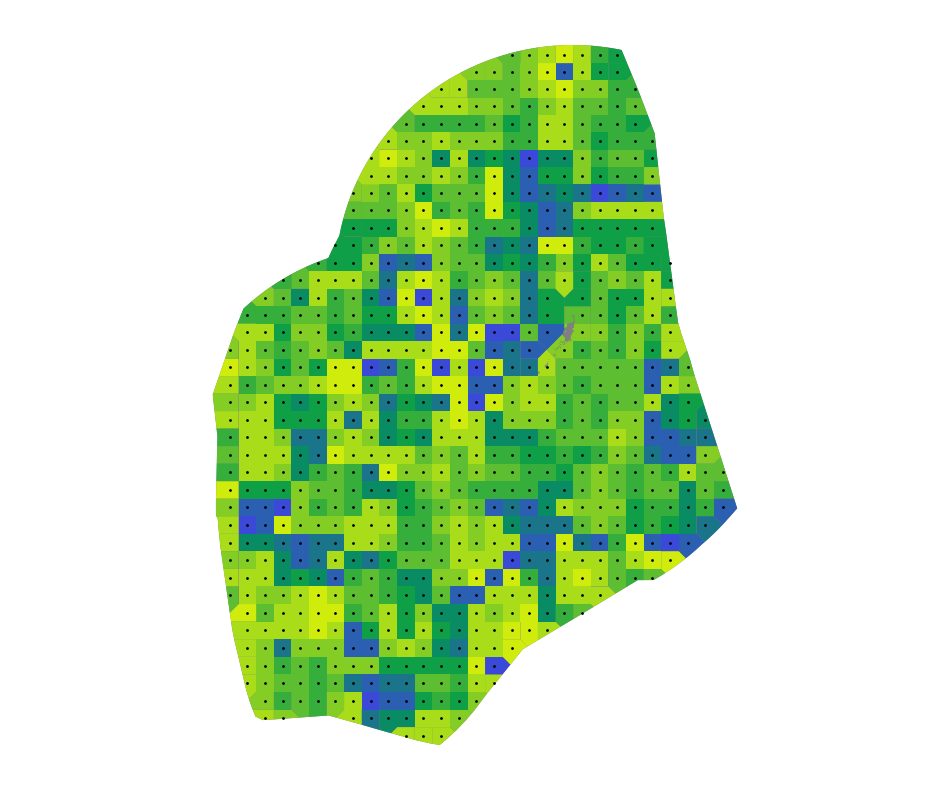

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1866_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


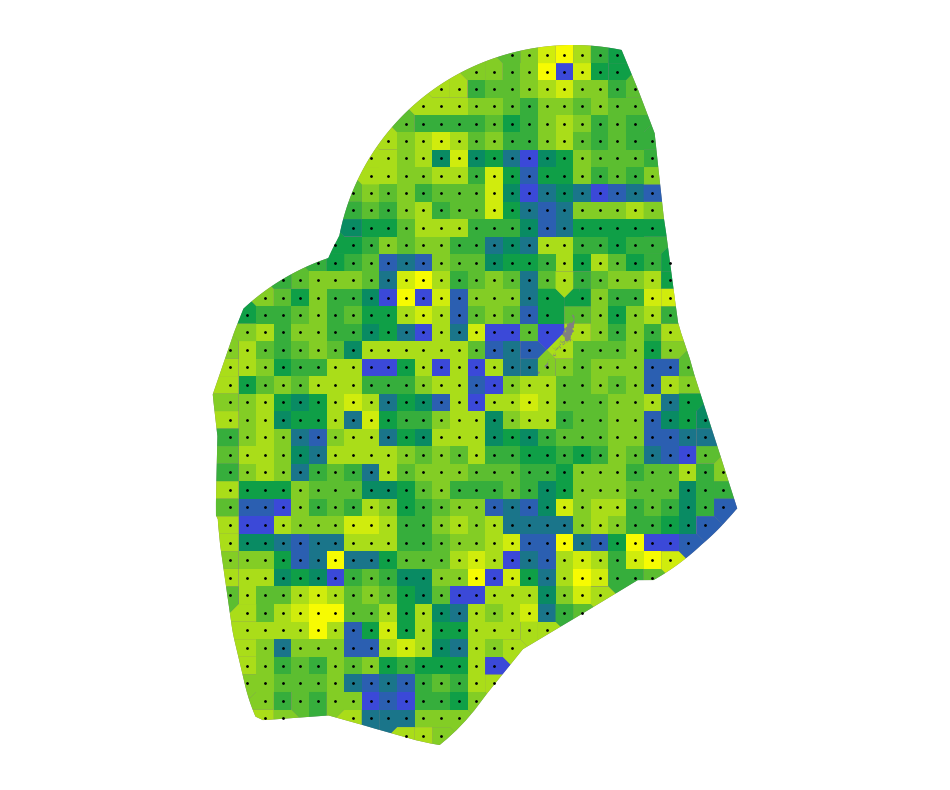

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1867_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


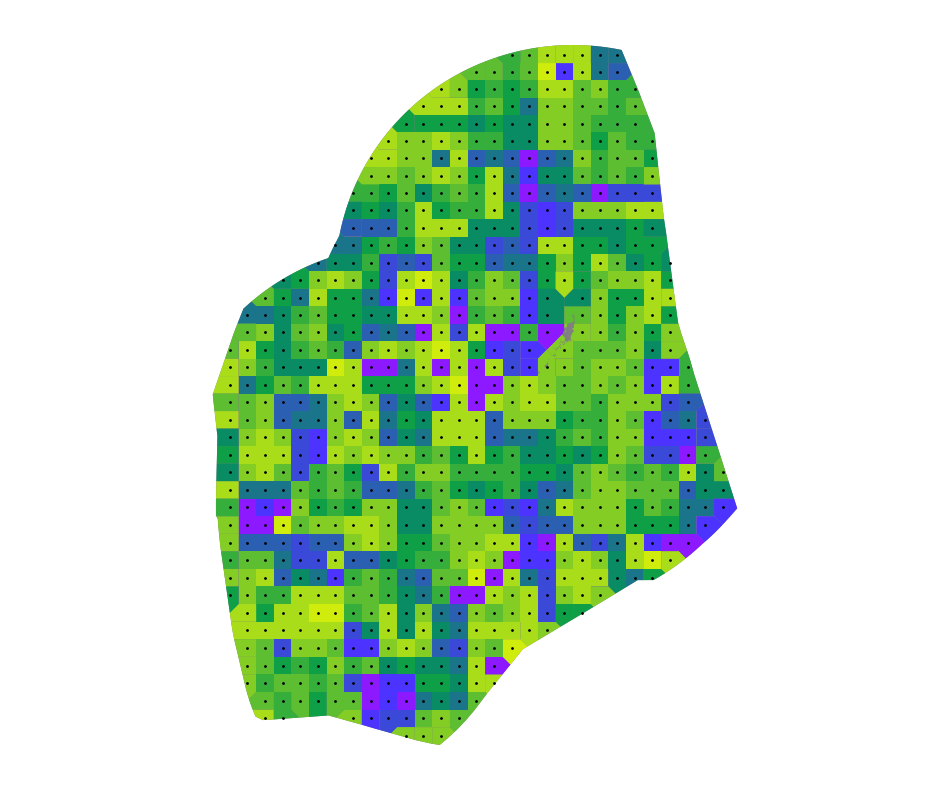

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1868_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


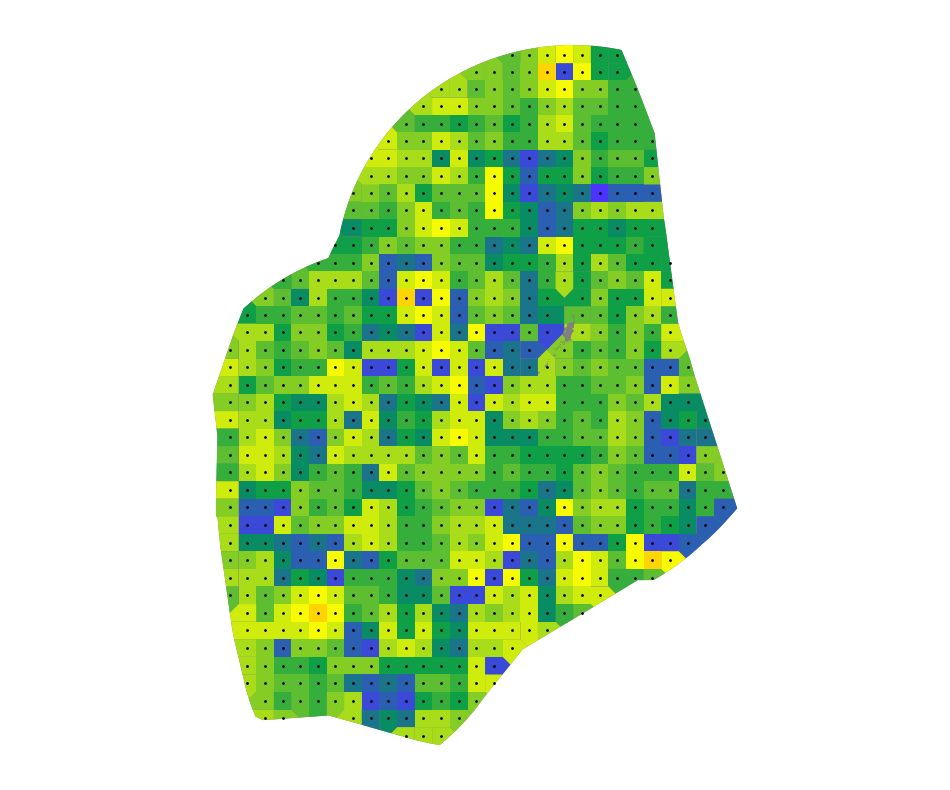

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1869_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


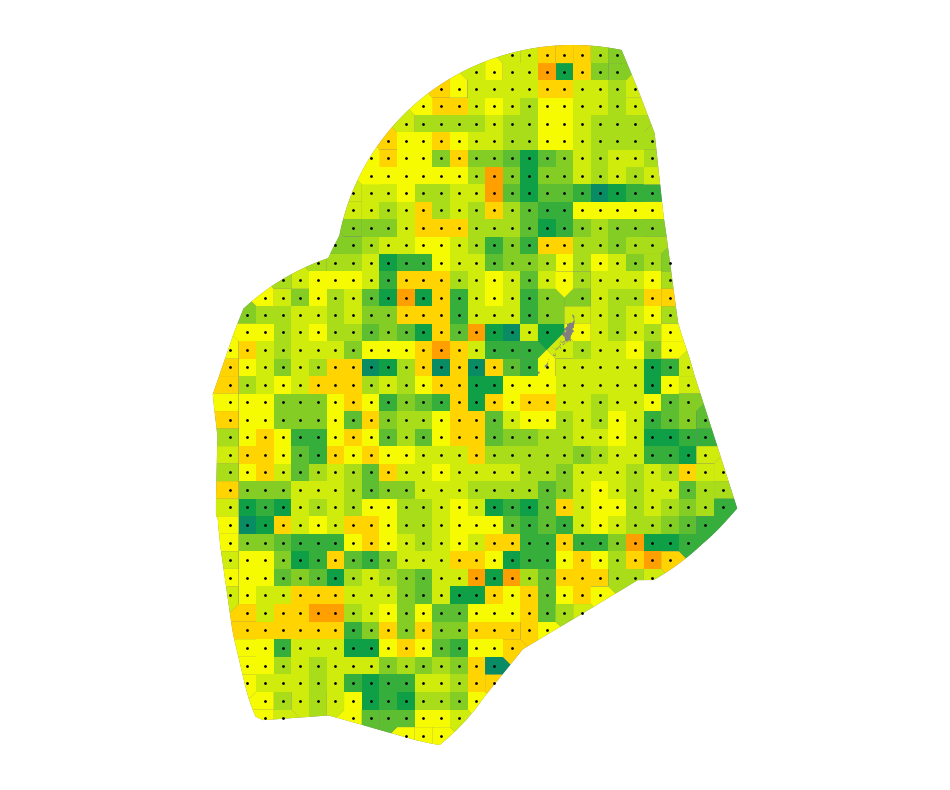

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1870_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


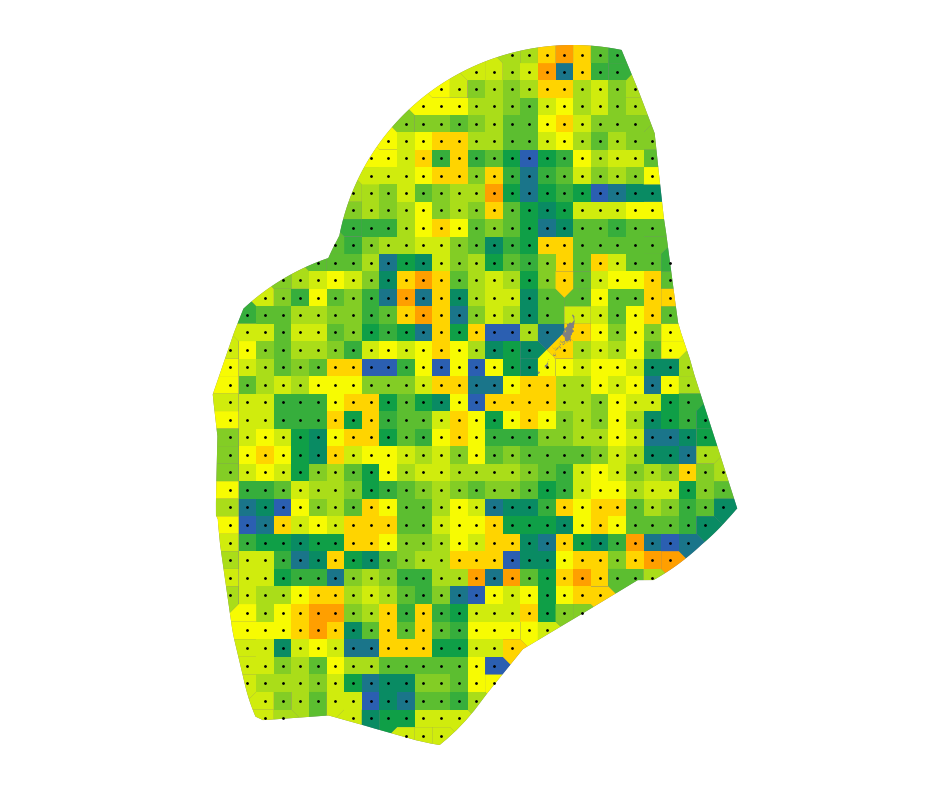

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1871_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


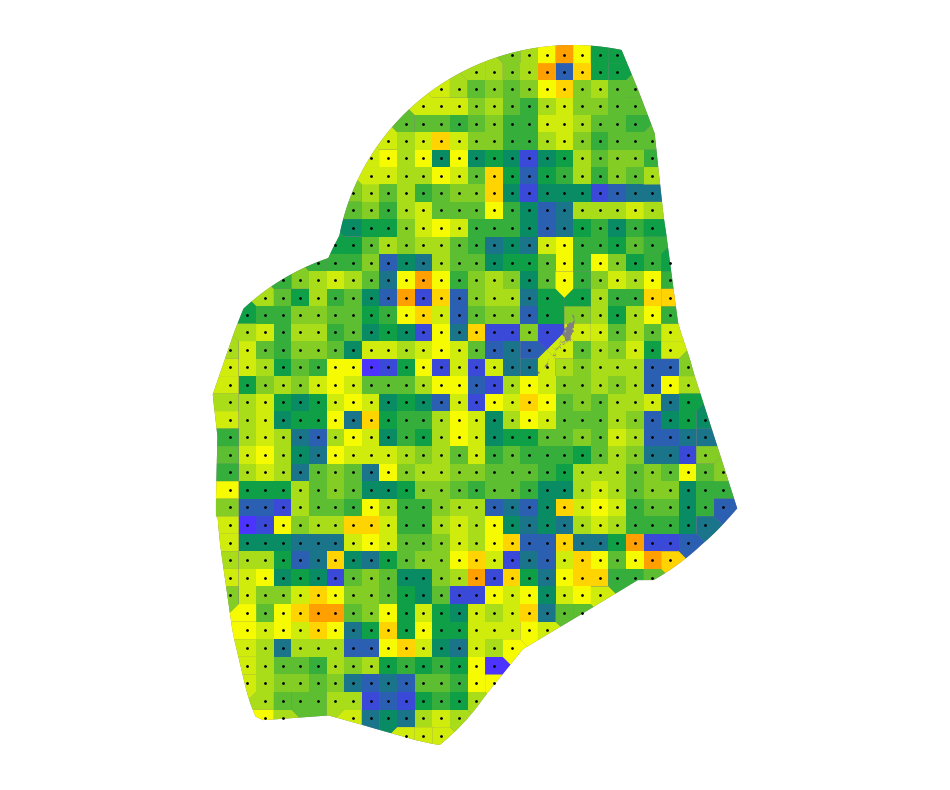

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1872_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


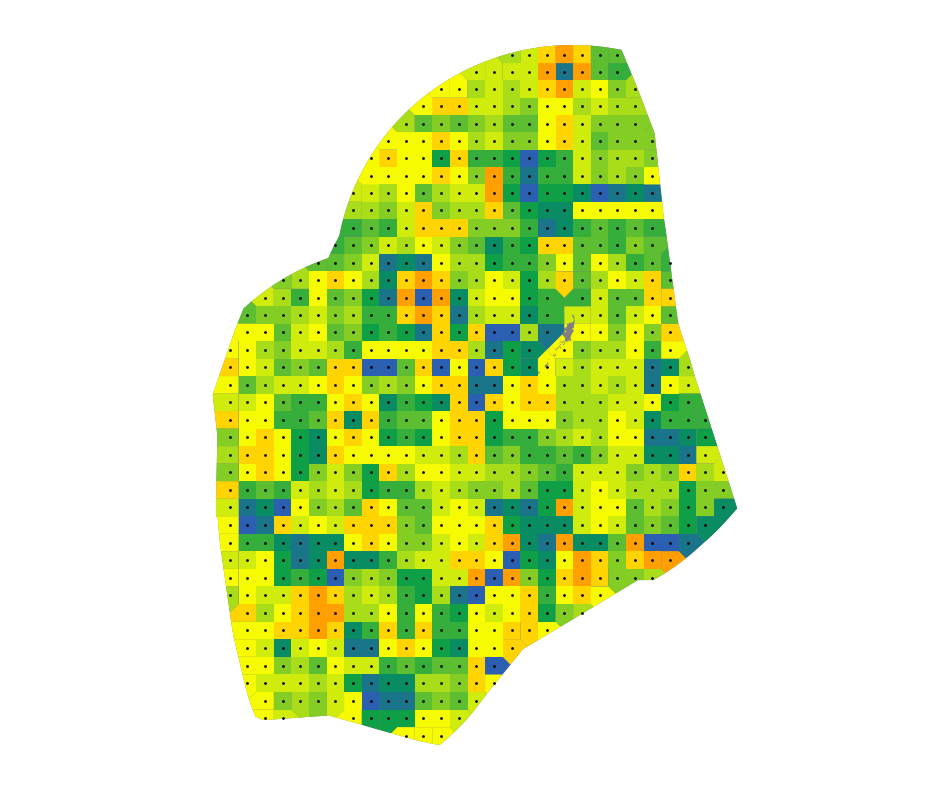

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1873_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


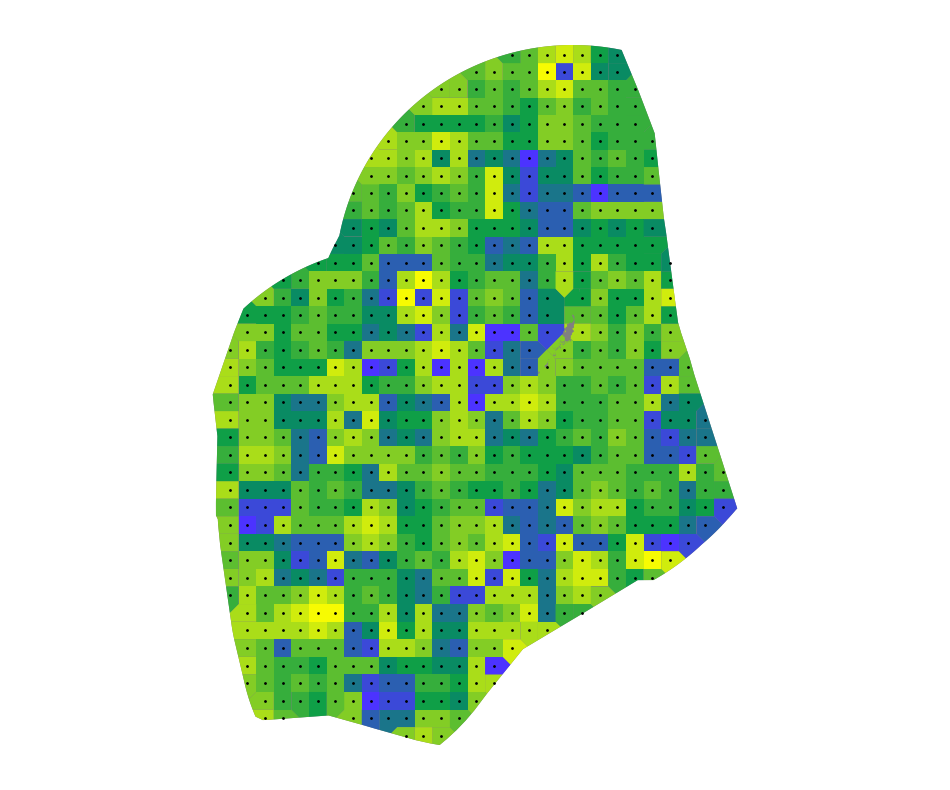

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1874_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


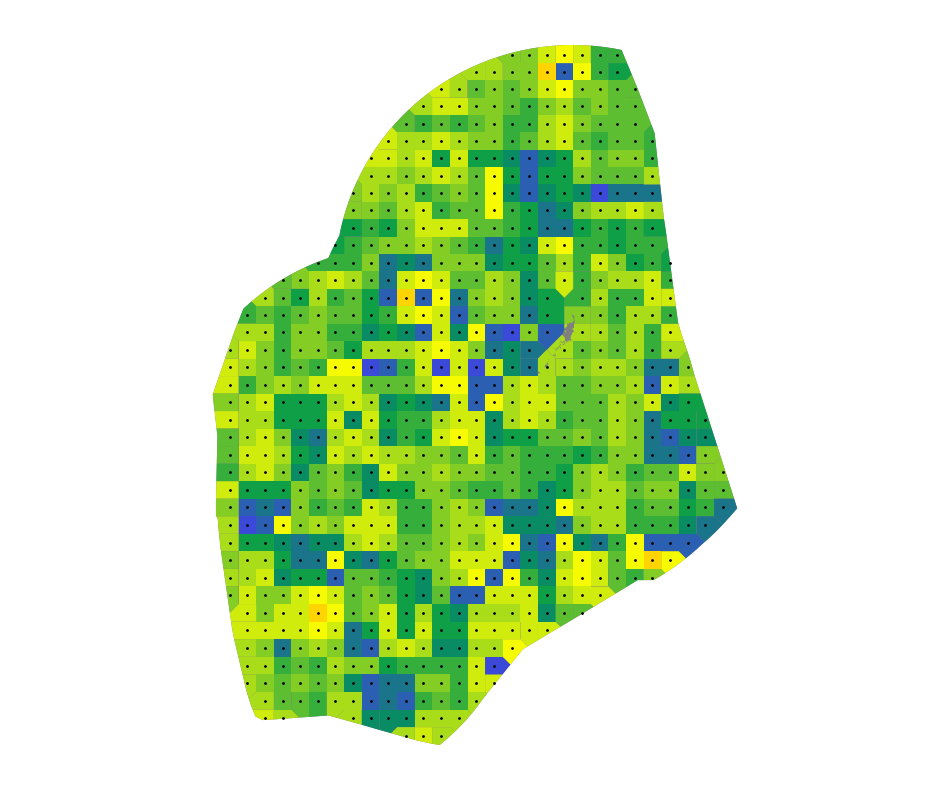

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1875_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


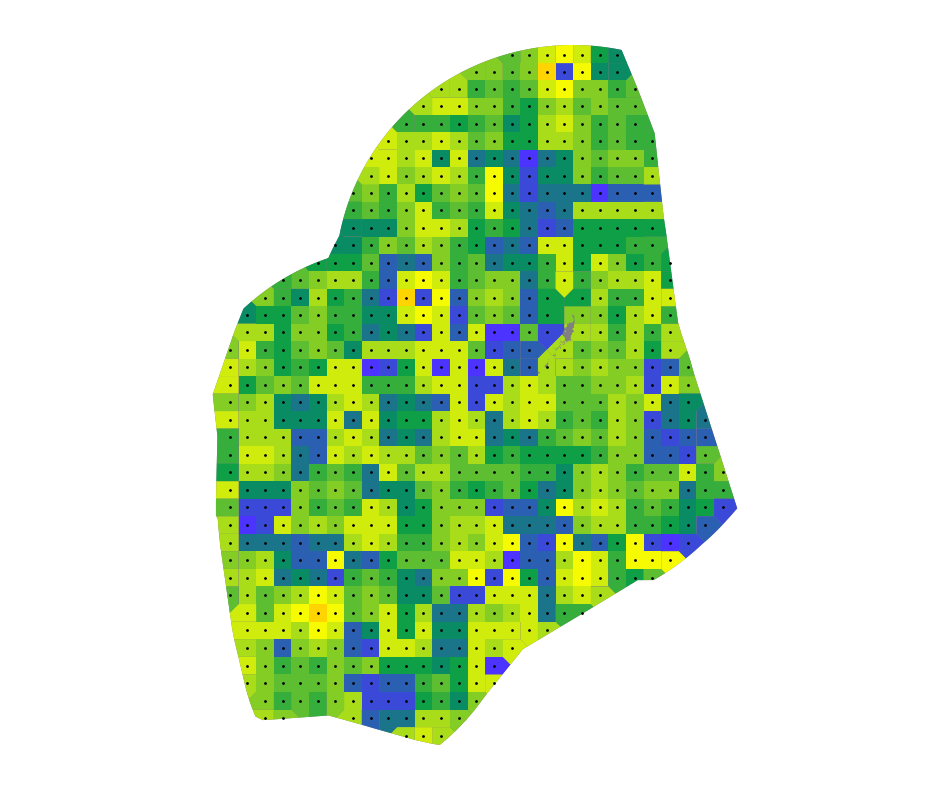

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1876_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


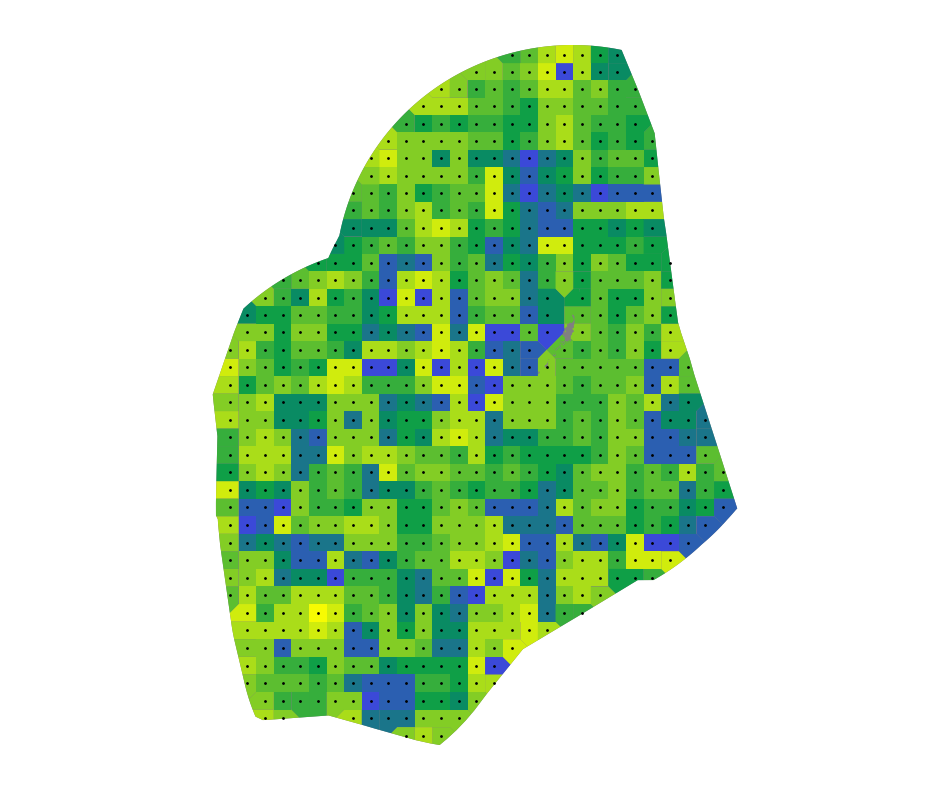

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1877_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


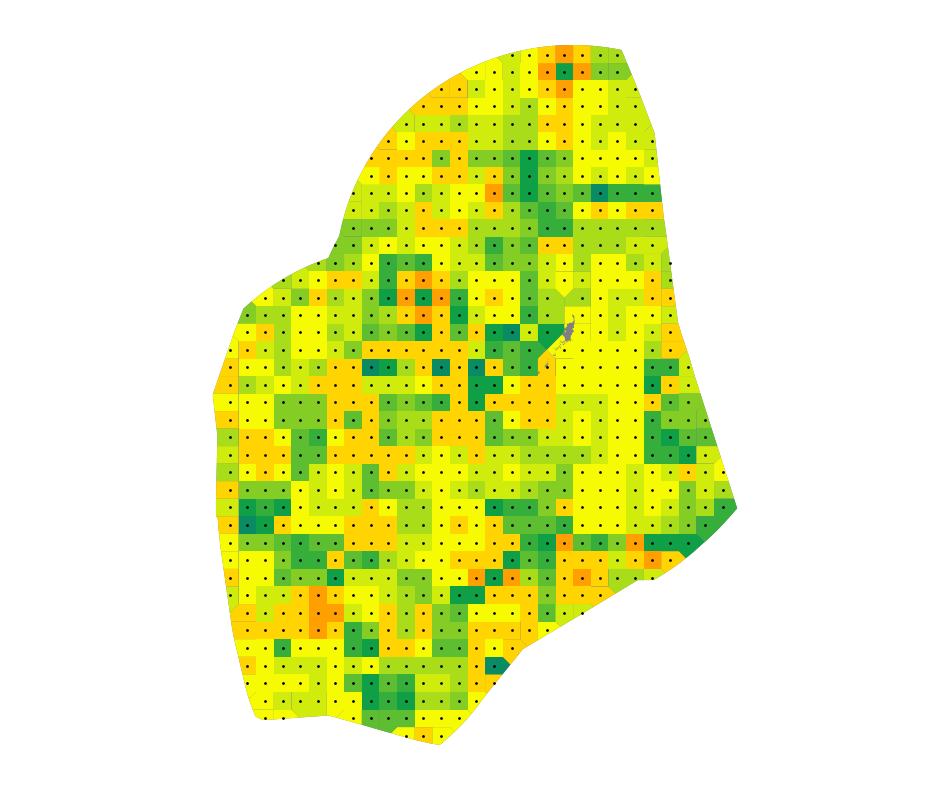

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1878_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


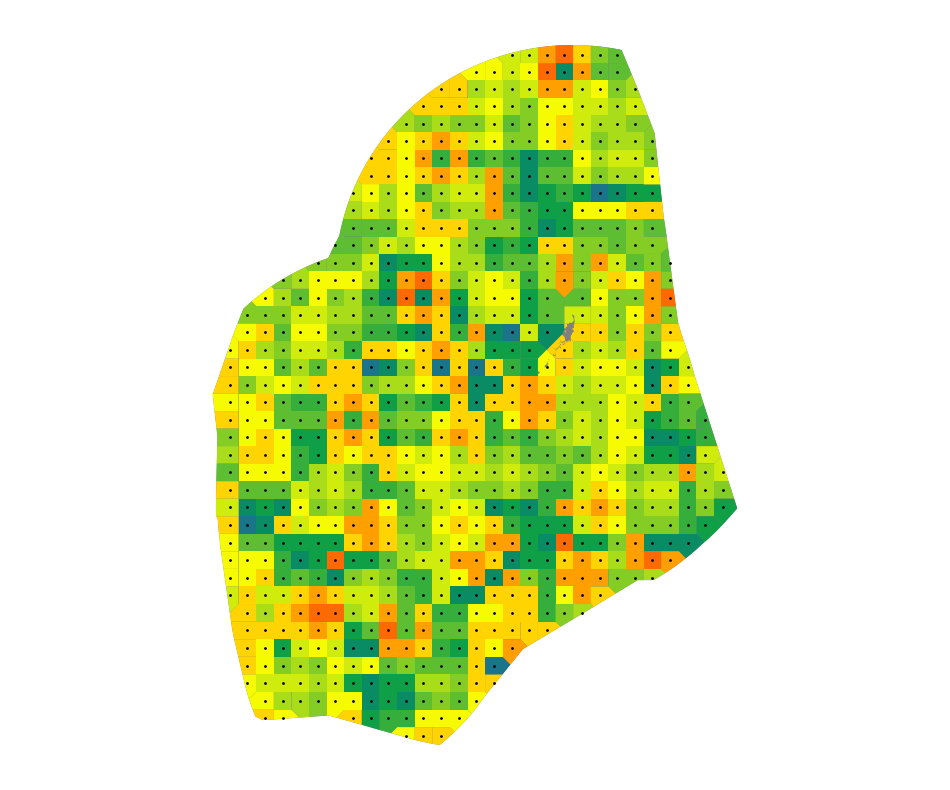

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1879_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


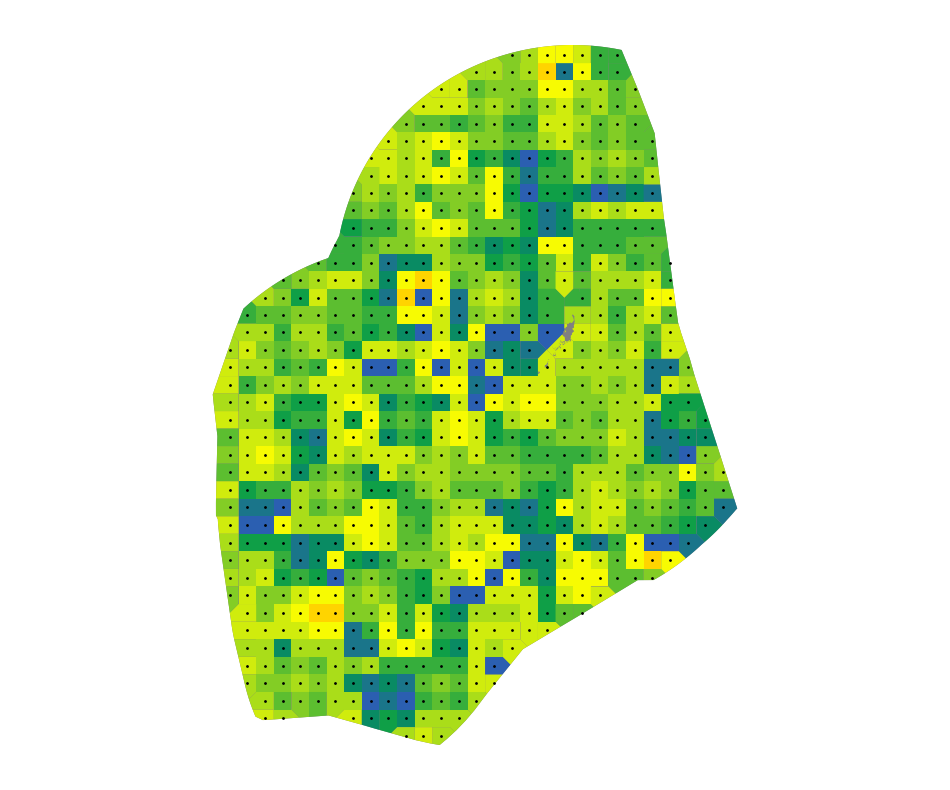

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1880_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


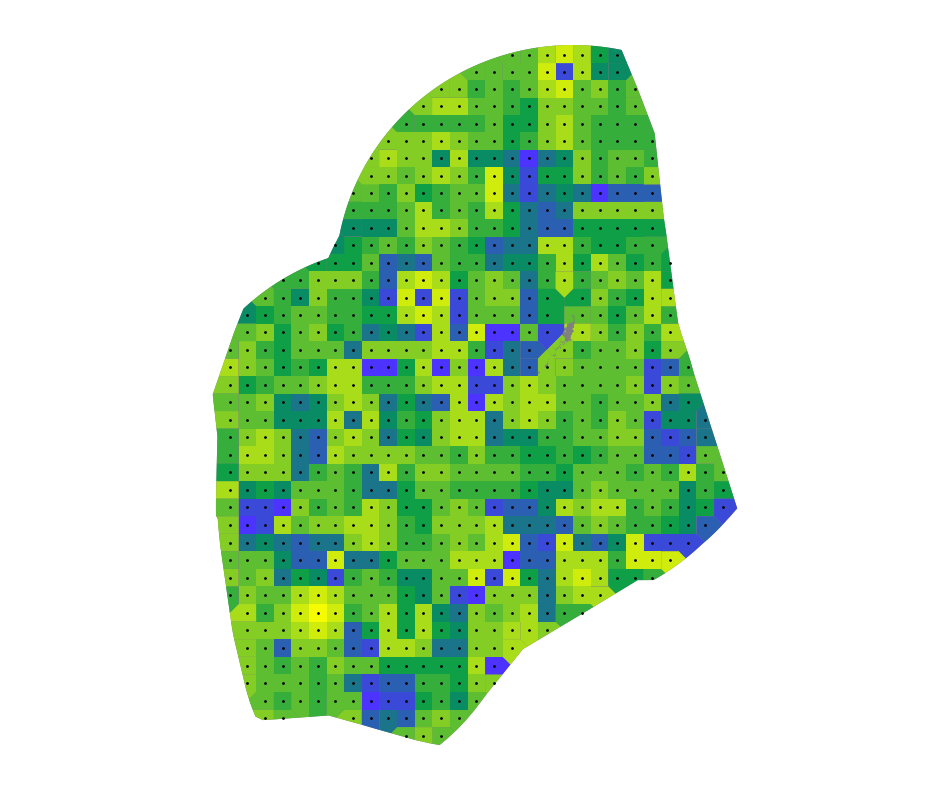

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1881_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


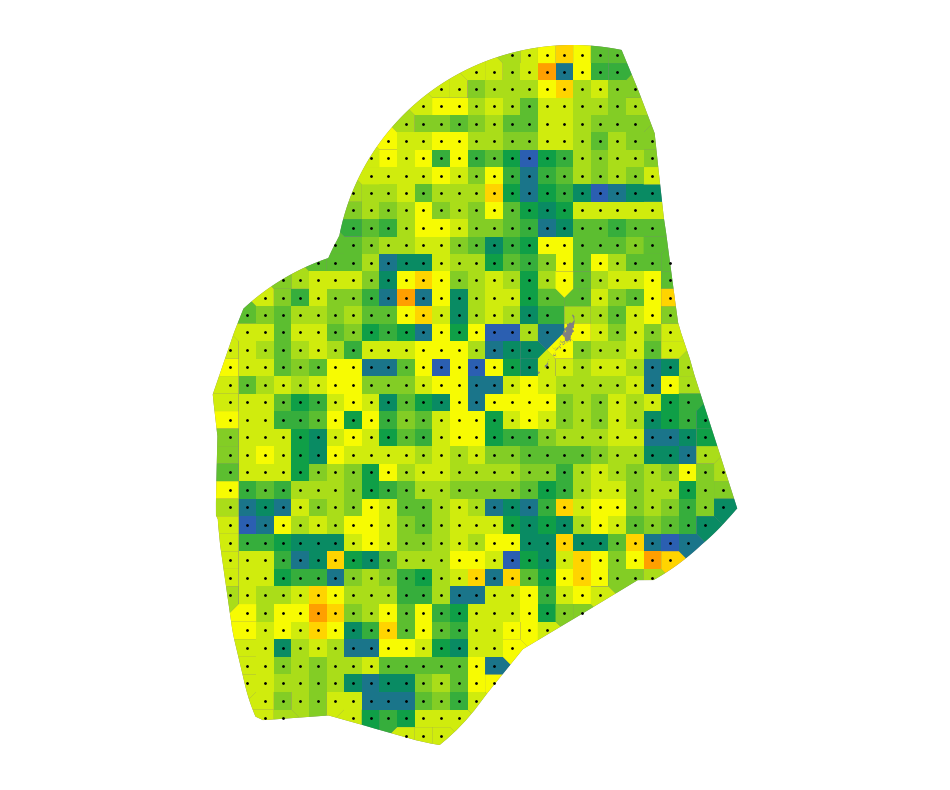

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1882_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


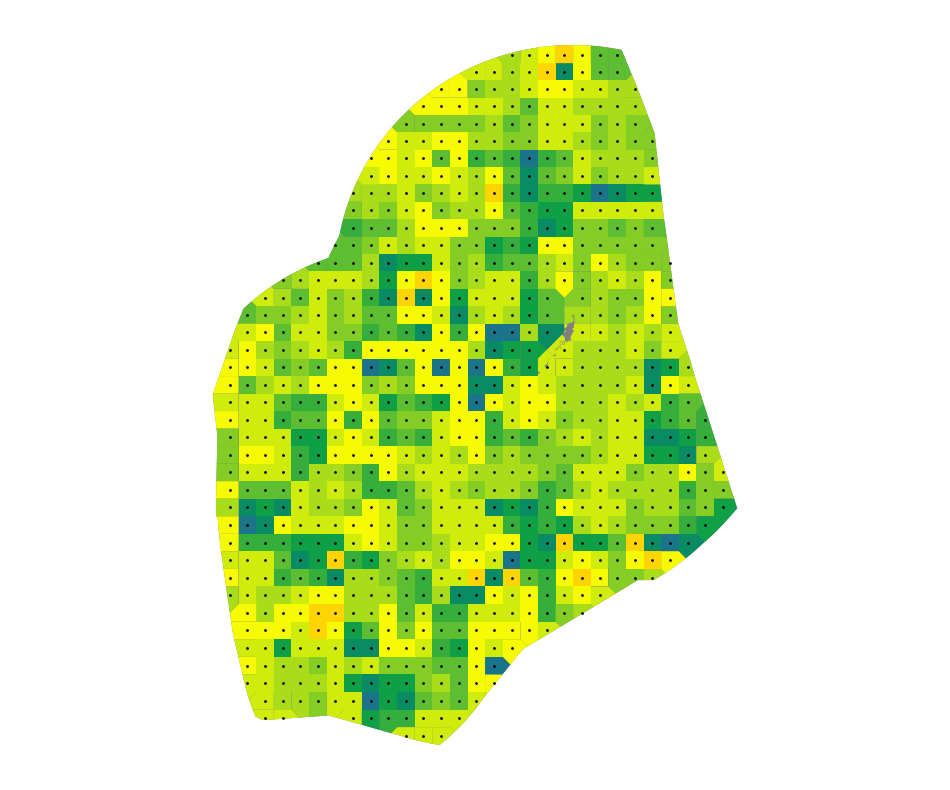

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1883_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


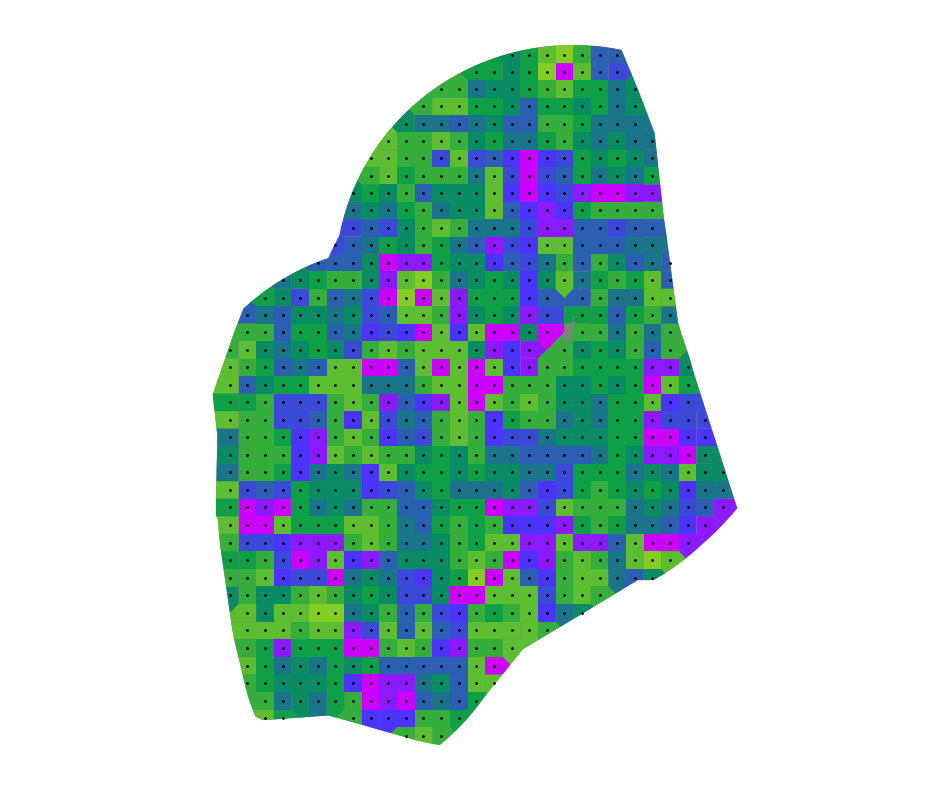

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1884_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


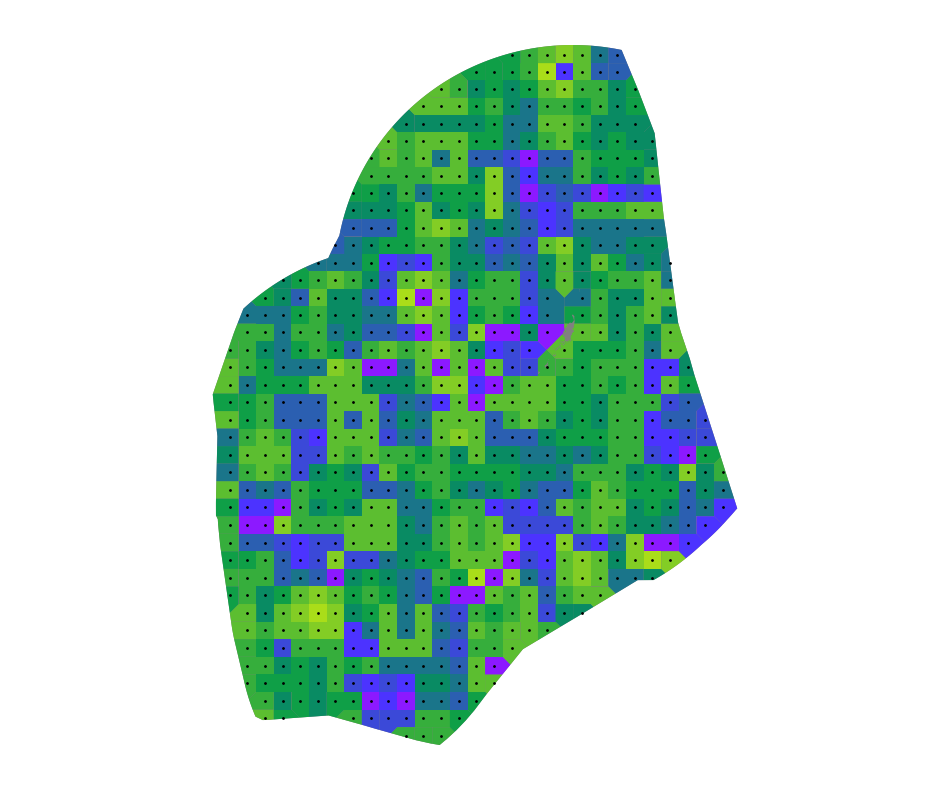

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1885_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


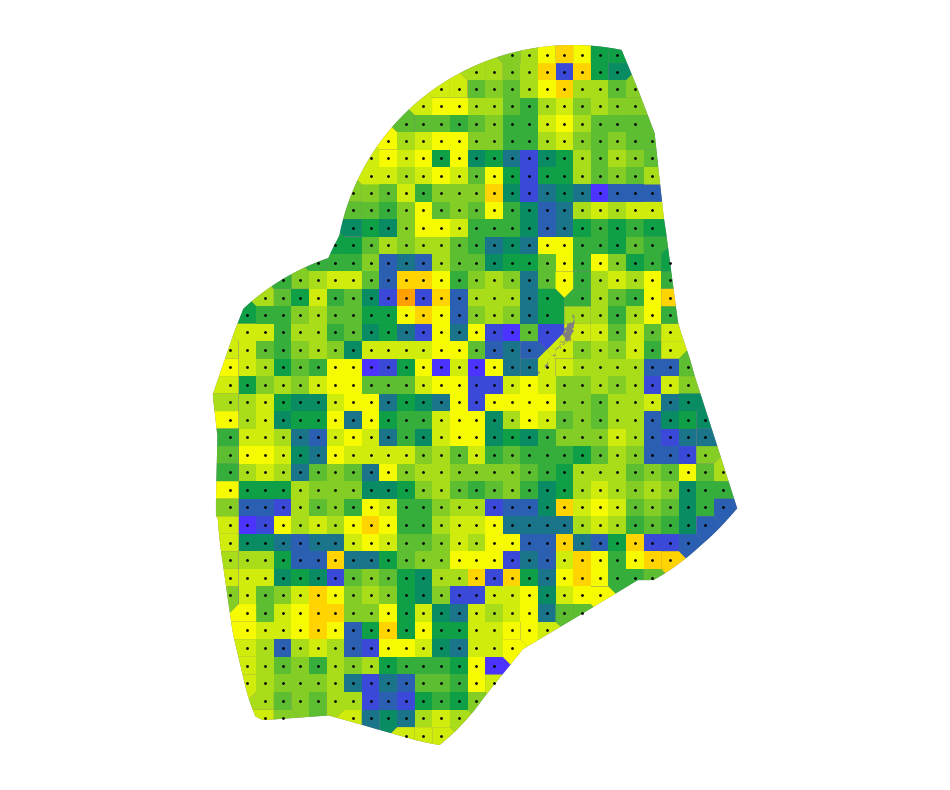

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1886_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


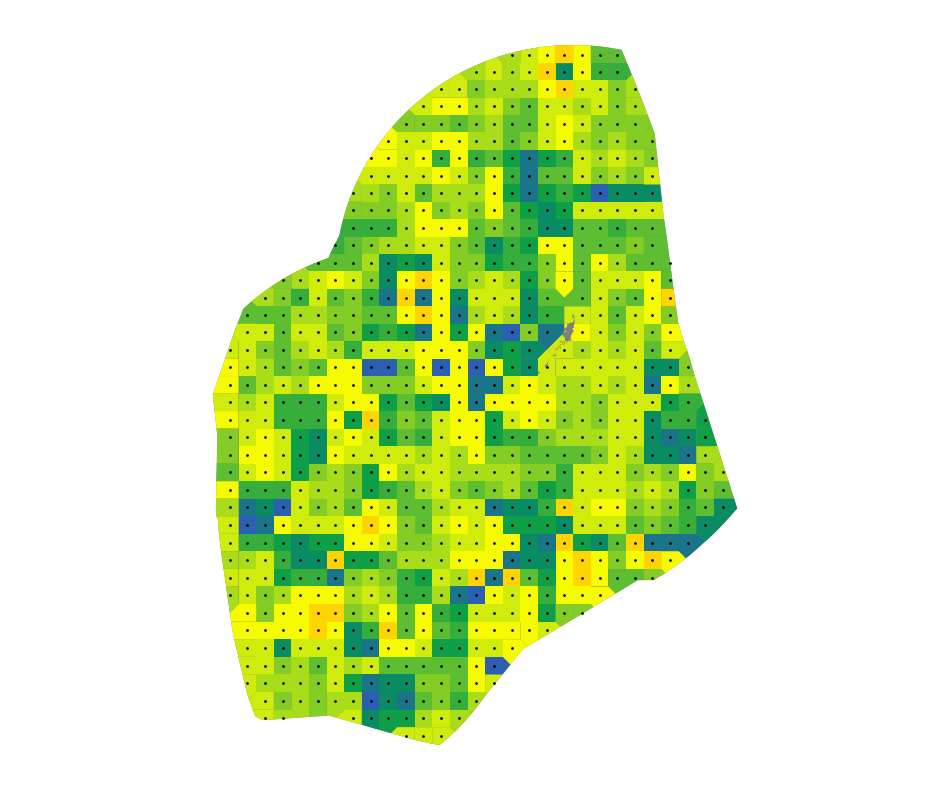

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1887_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


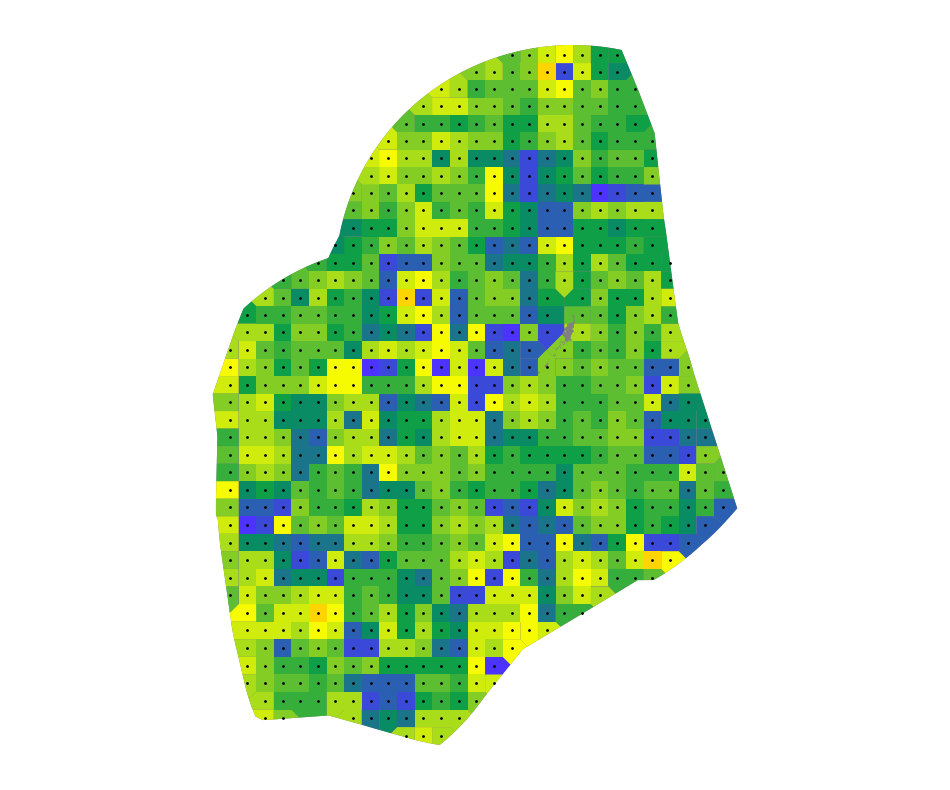

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1888_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


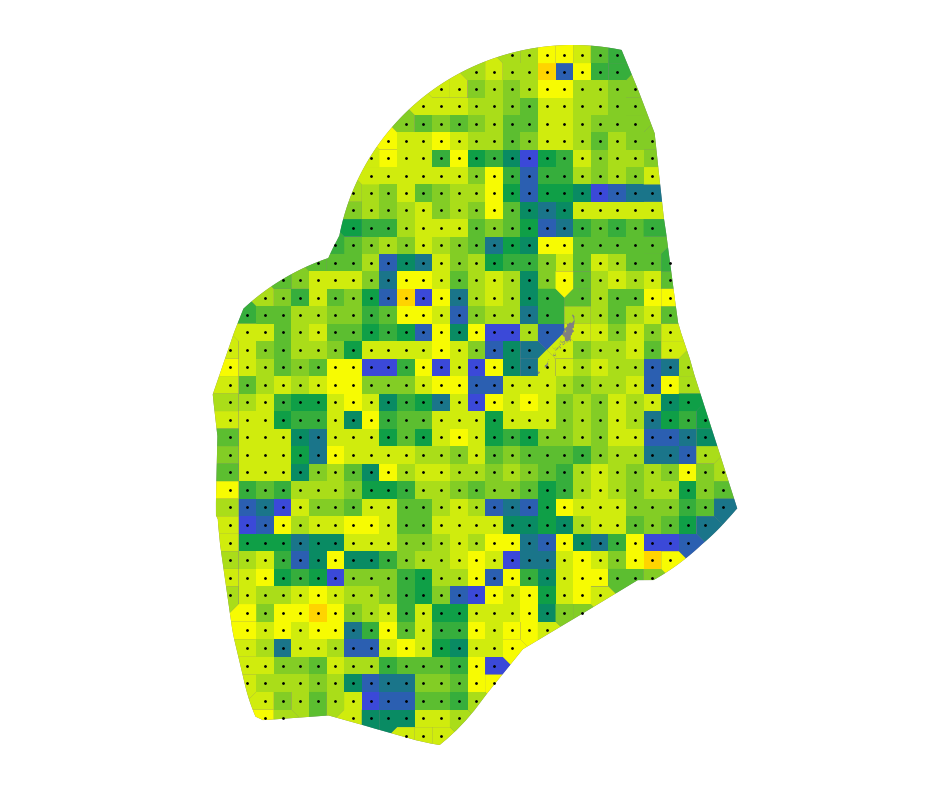

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1889_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


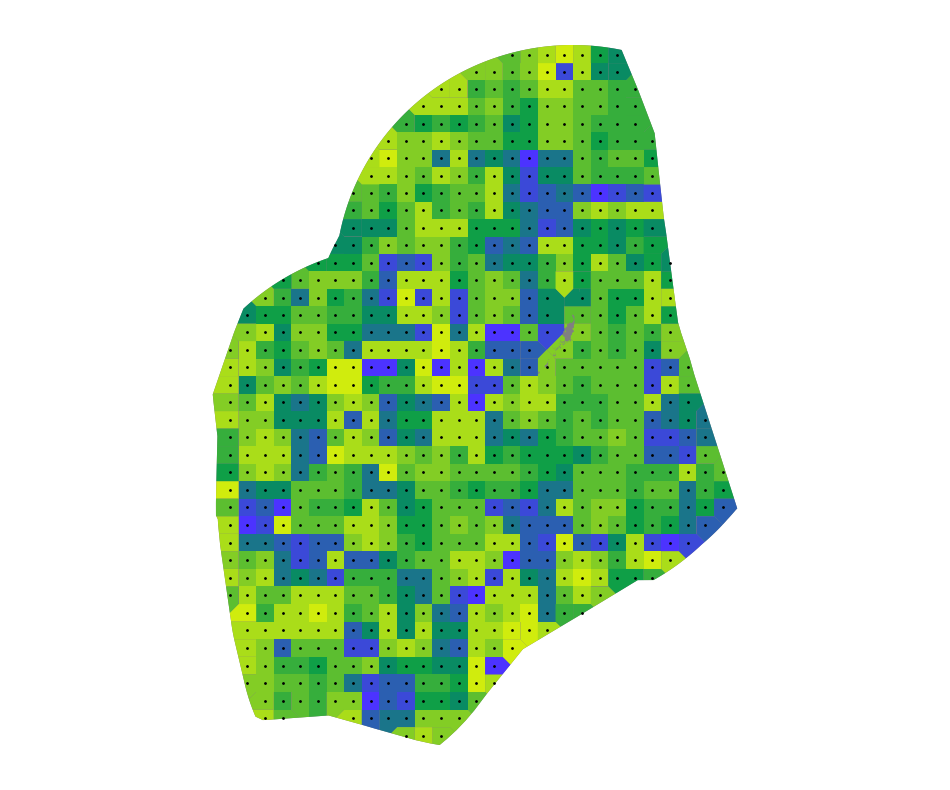

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1890_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


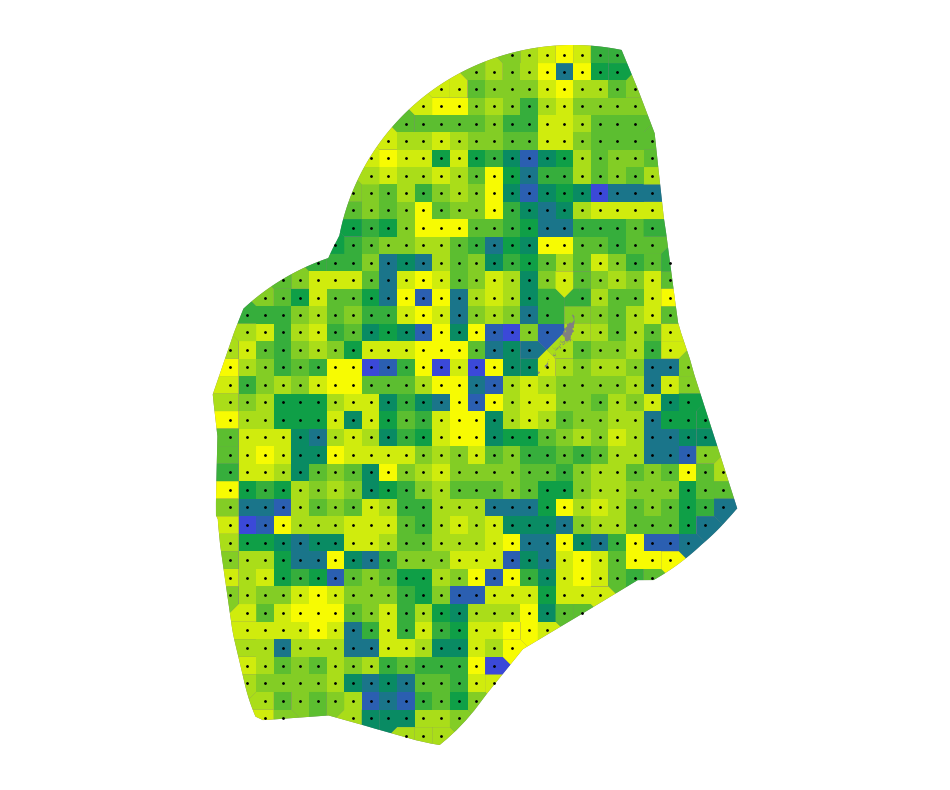

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1891_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


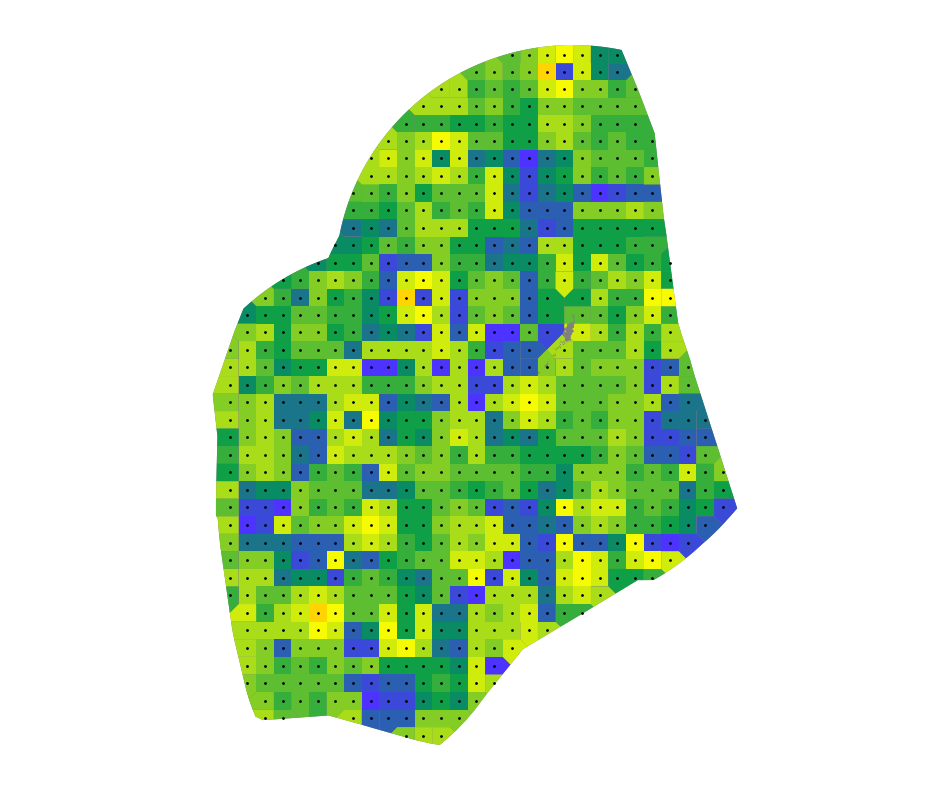

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1892_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


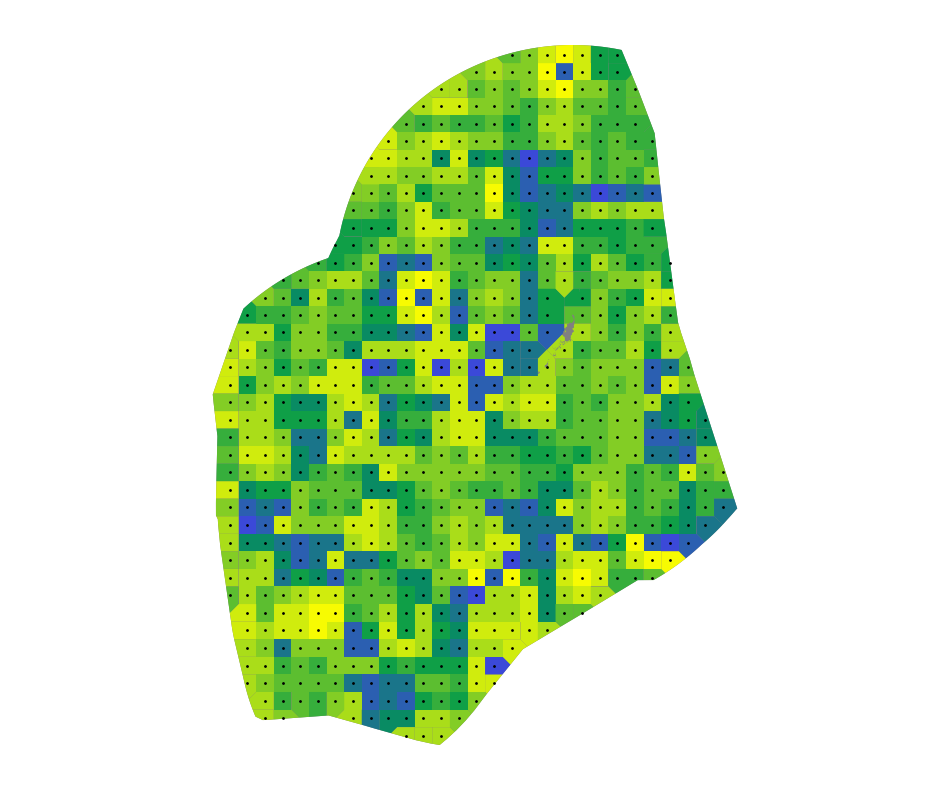

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1893_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


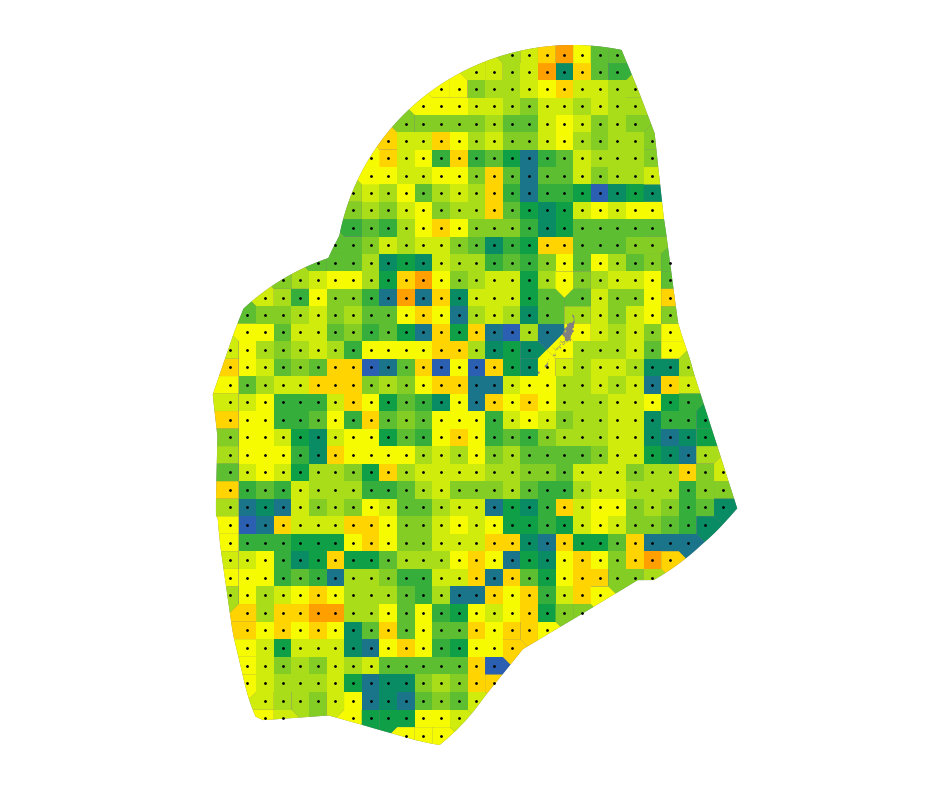

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1894_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


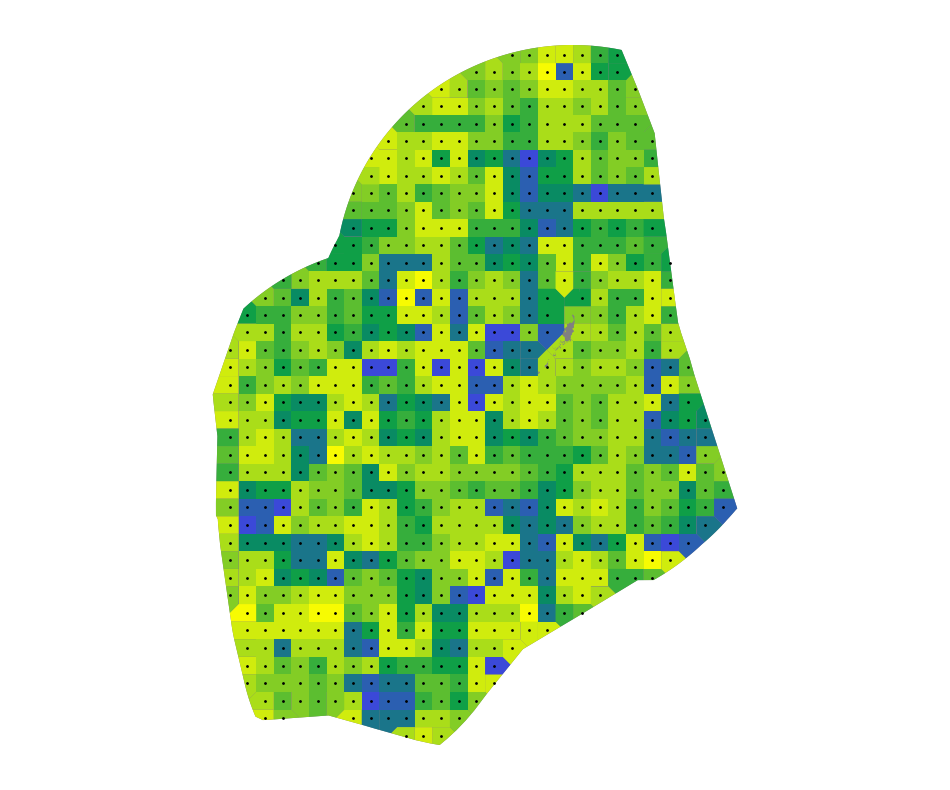

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1895_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


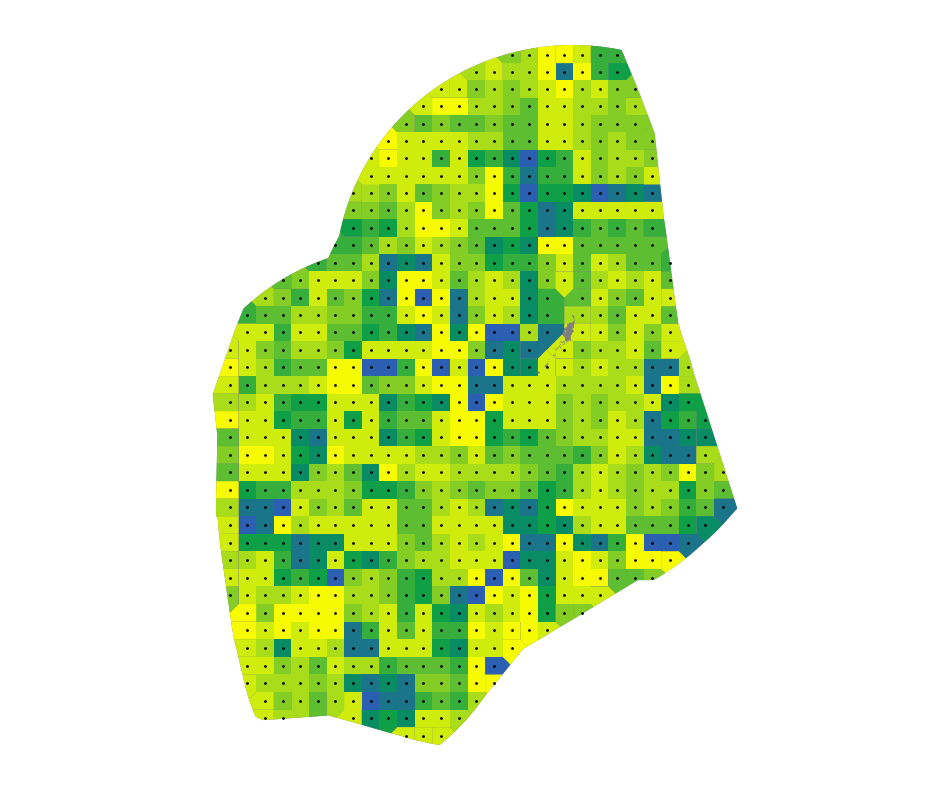

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1896_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


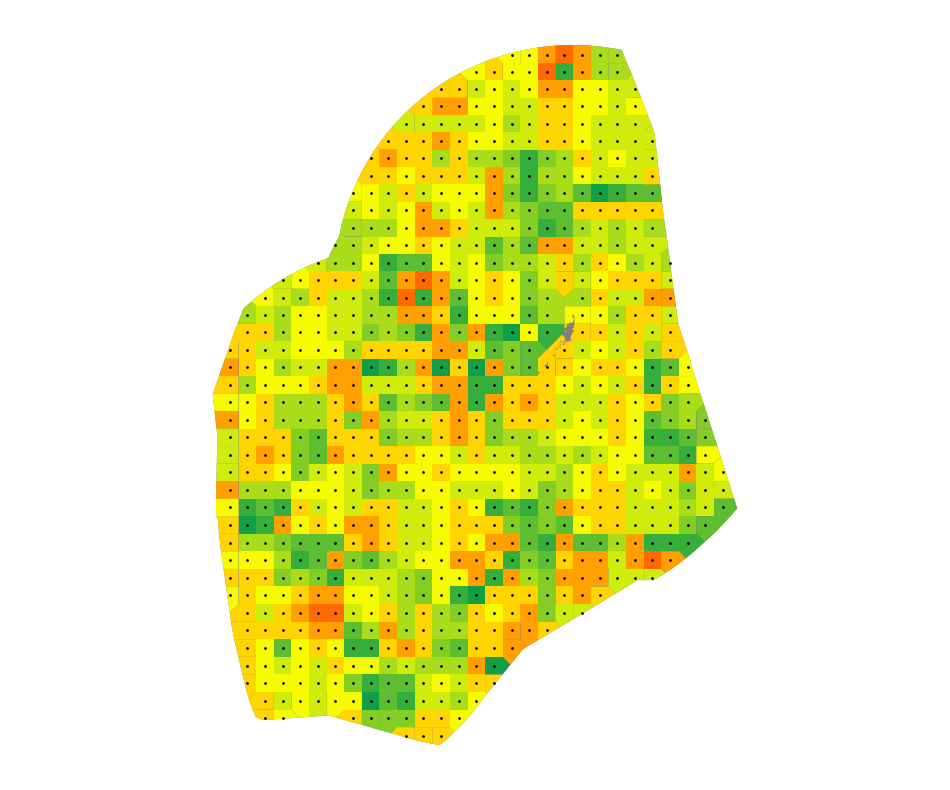

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1897_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


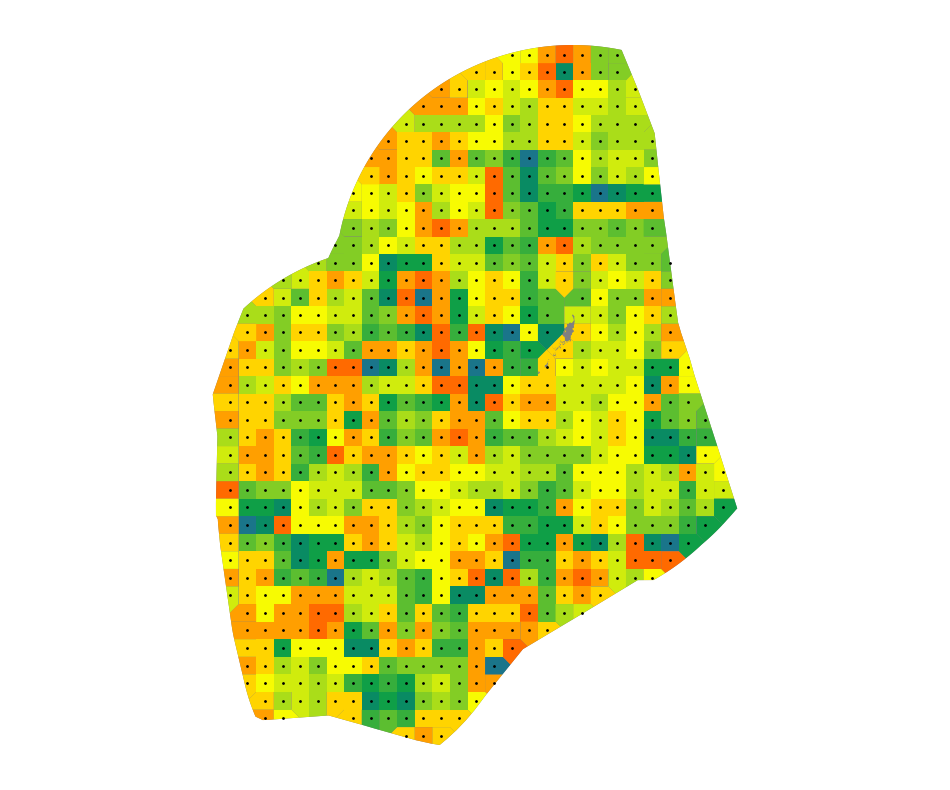

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1898_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


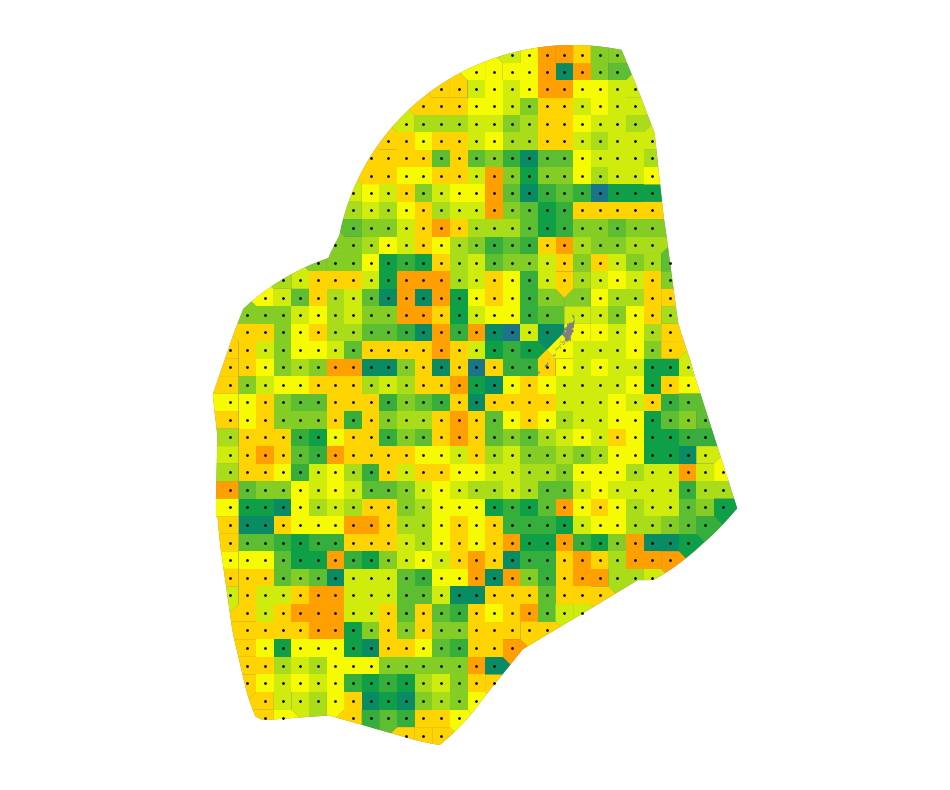

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1899_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


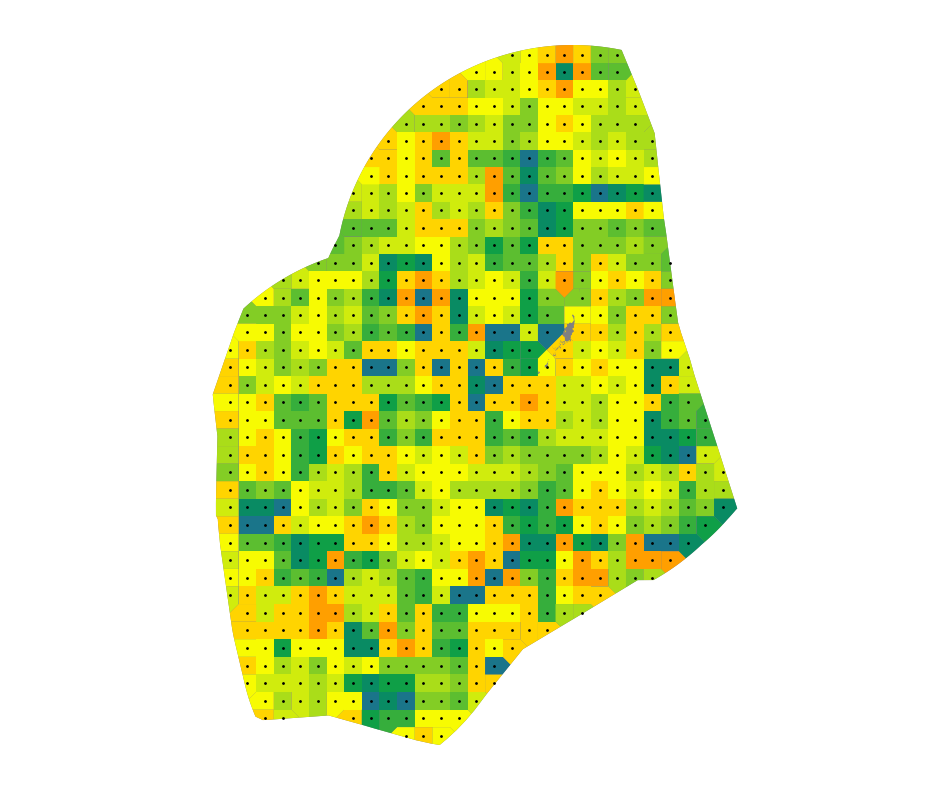

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1900_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


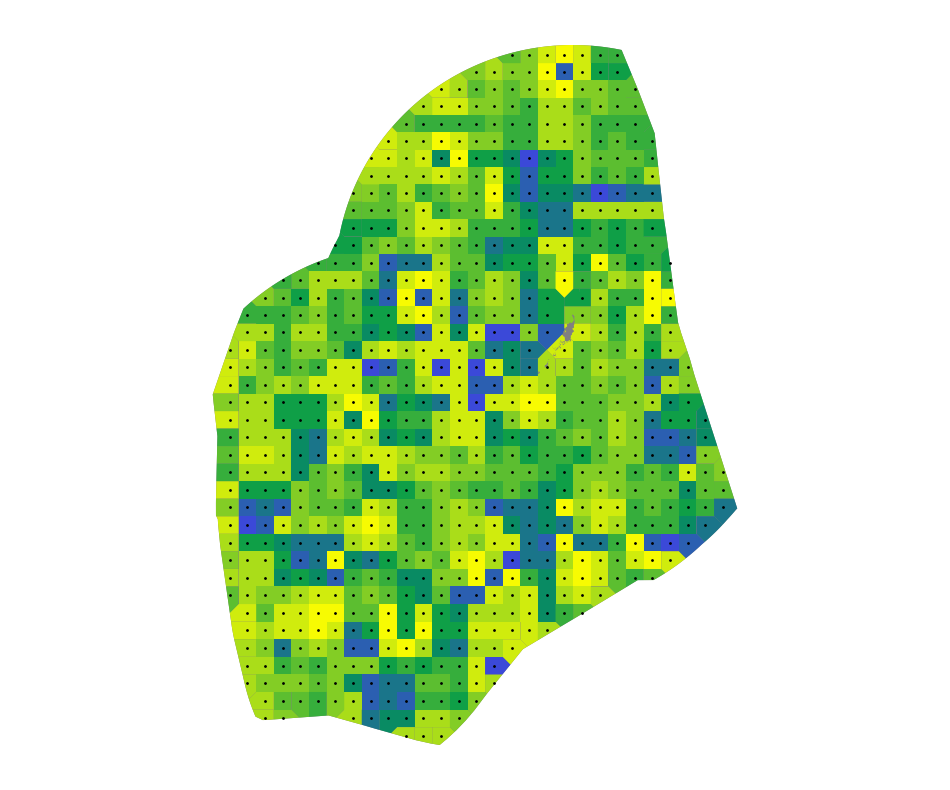

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1901_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


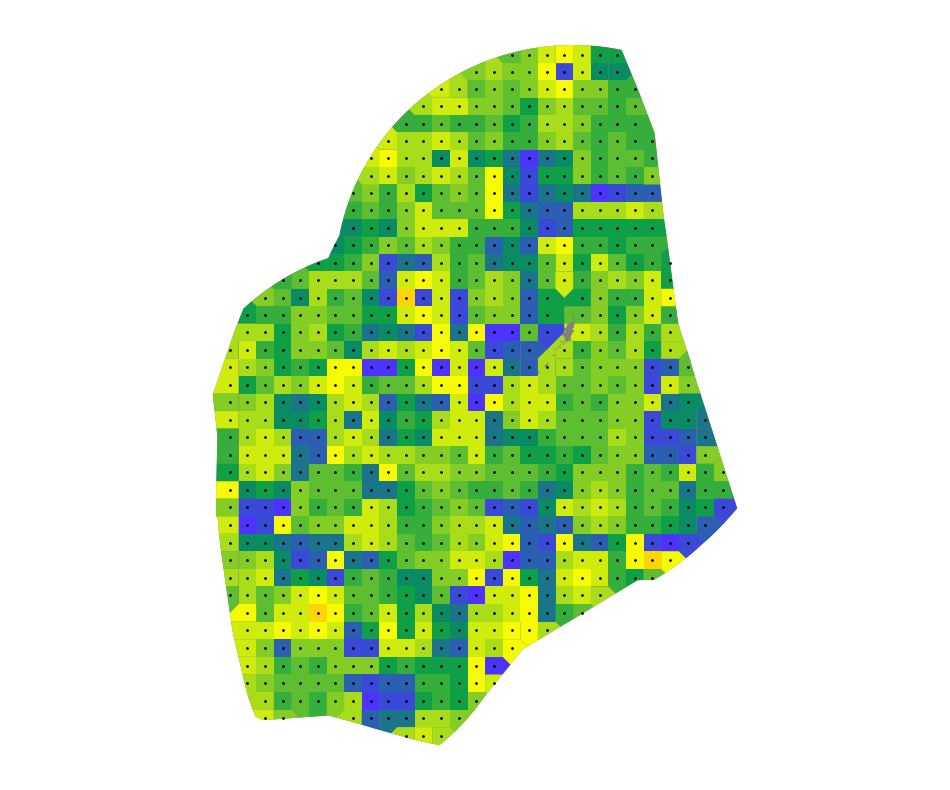

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1902_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


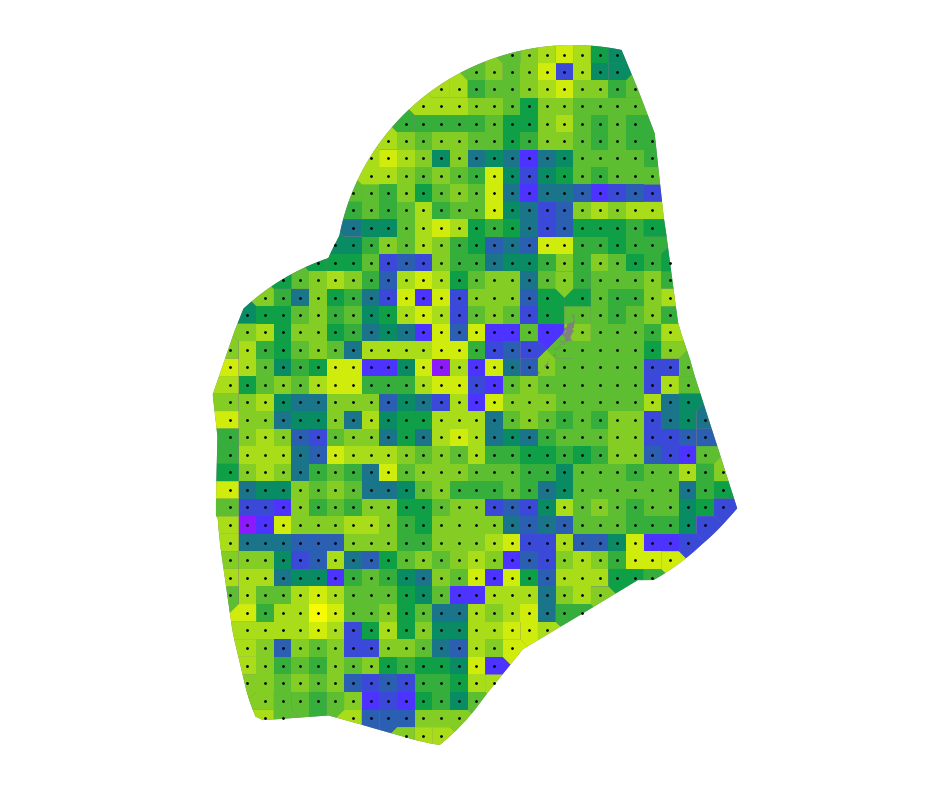

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1903_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


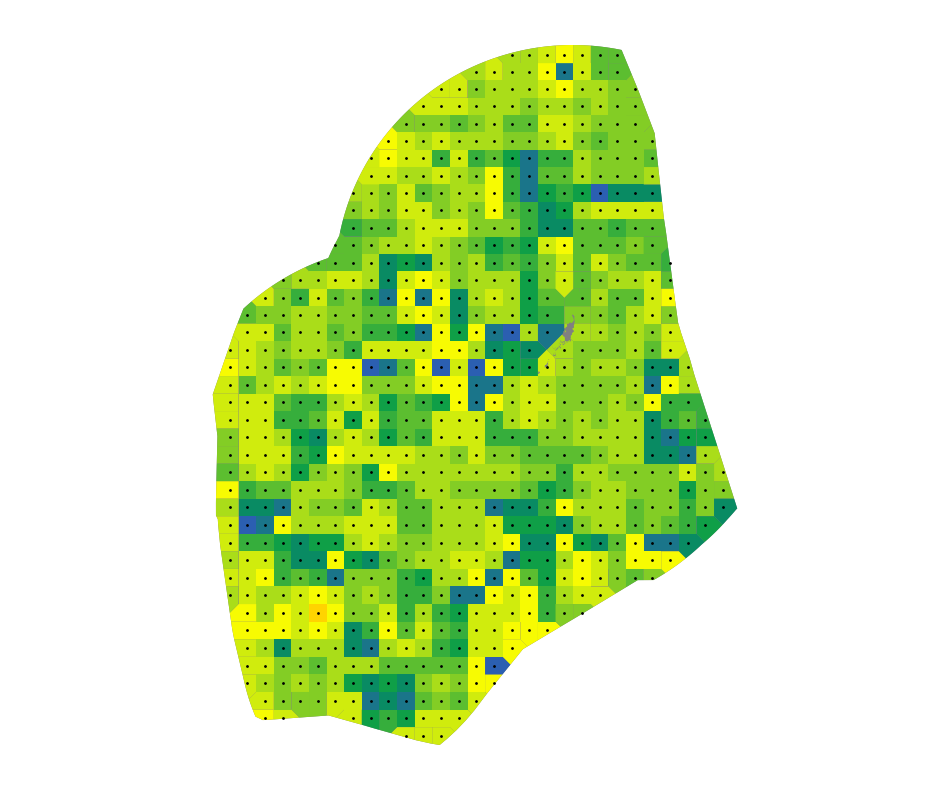

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1904_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


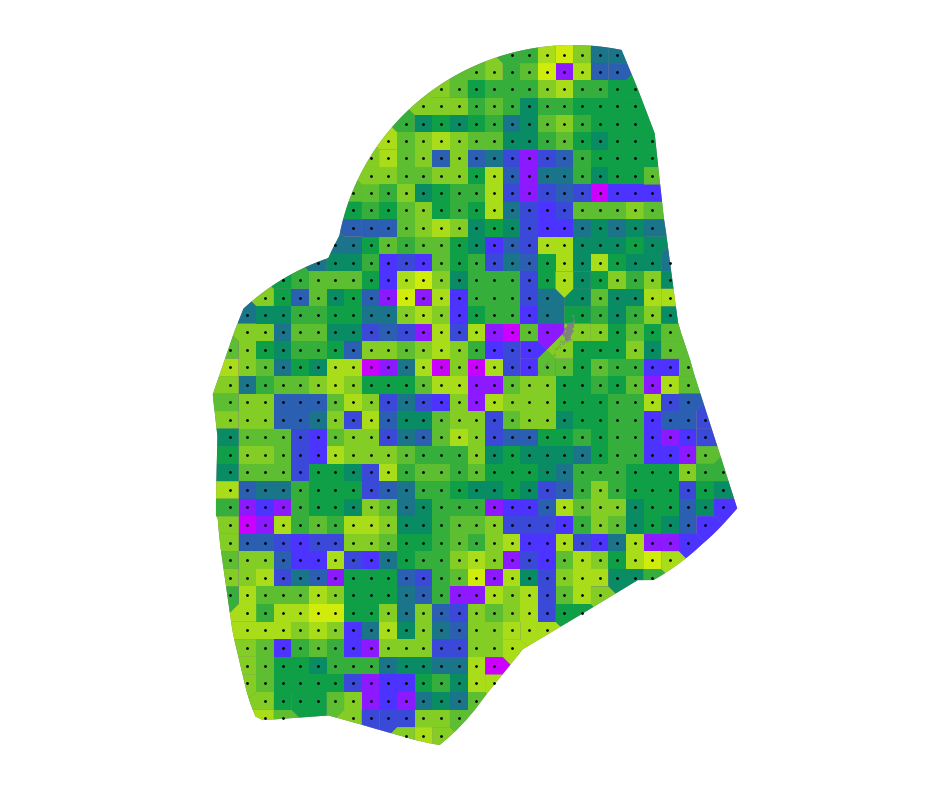

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1905_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


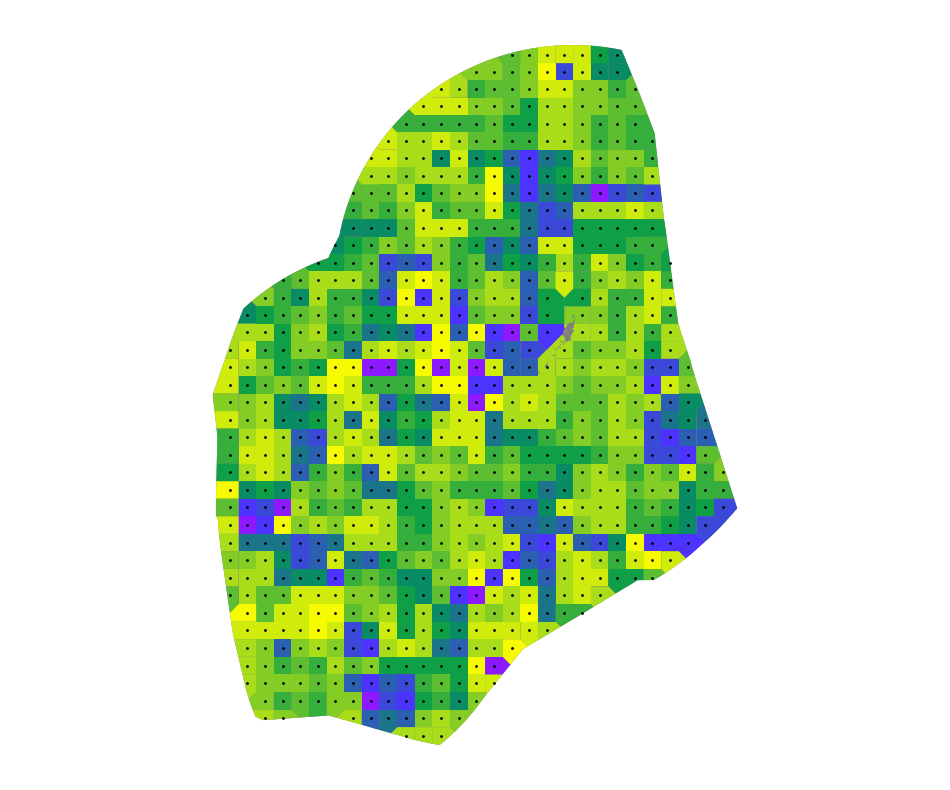

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1906_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


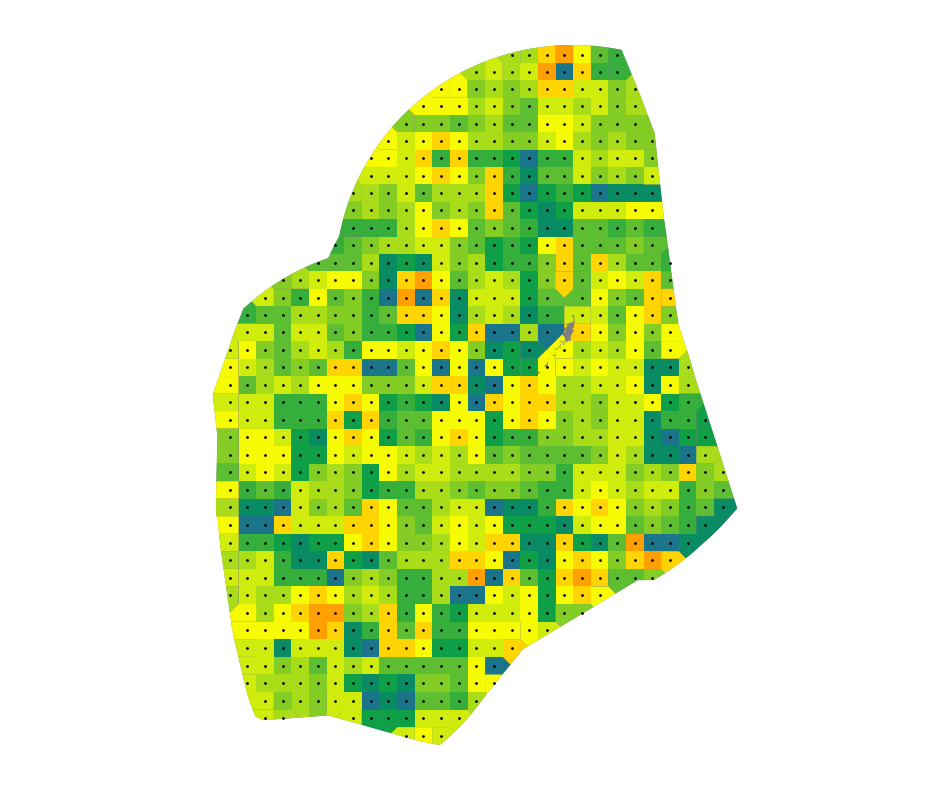

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1907_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


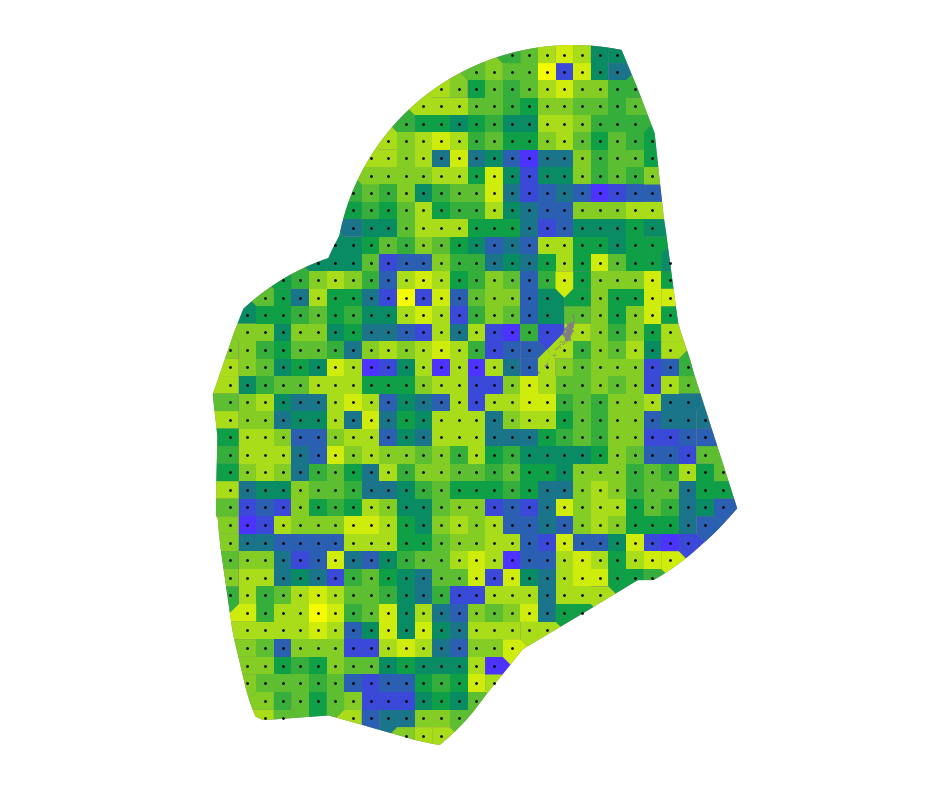

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1908_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


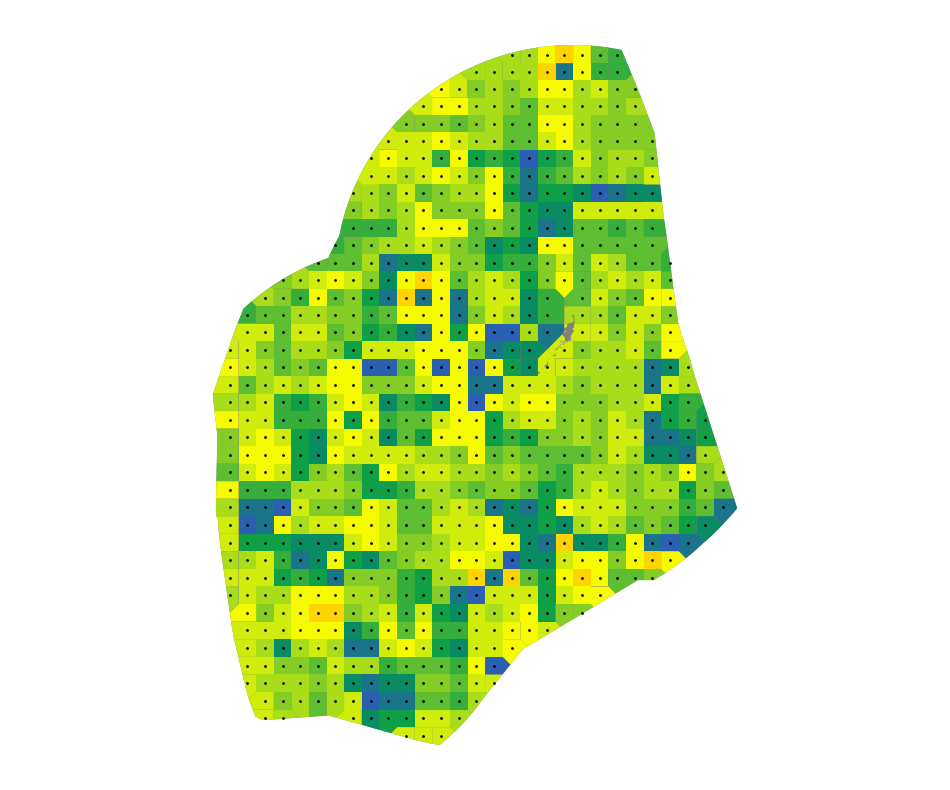

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1909_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


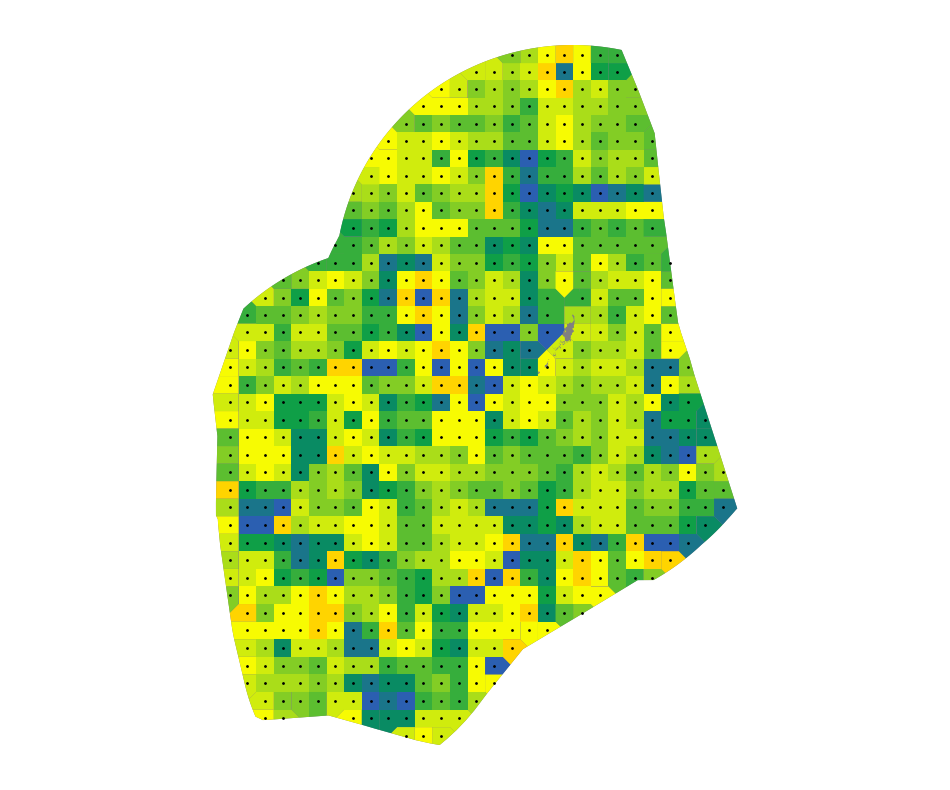

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1910_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


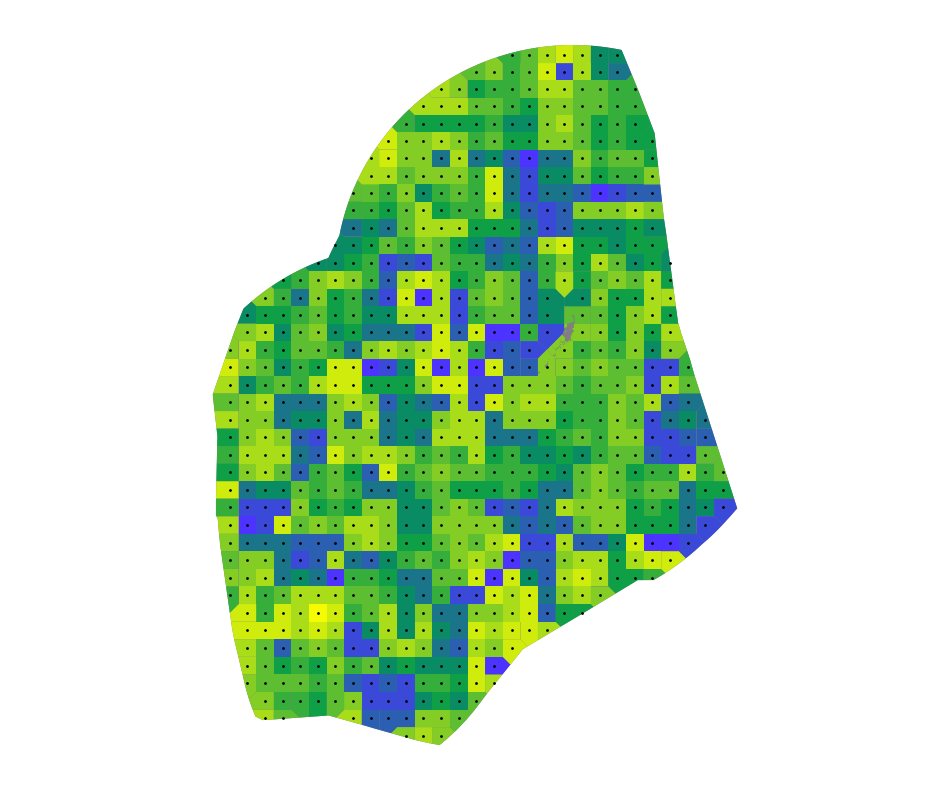

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1911_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


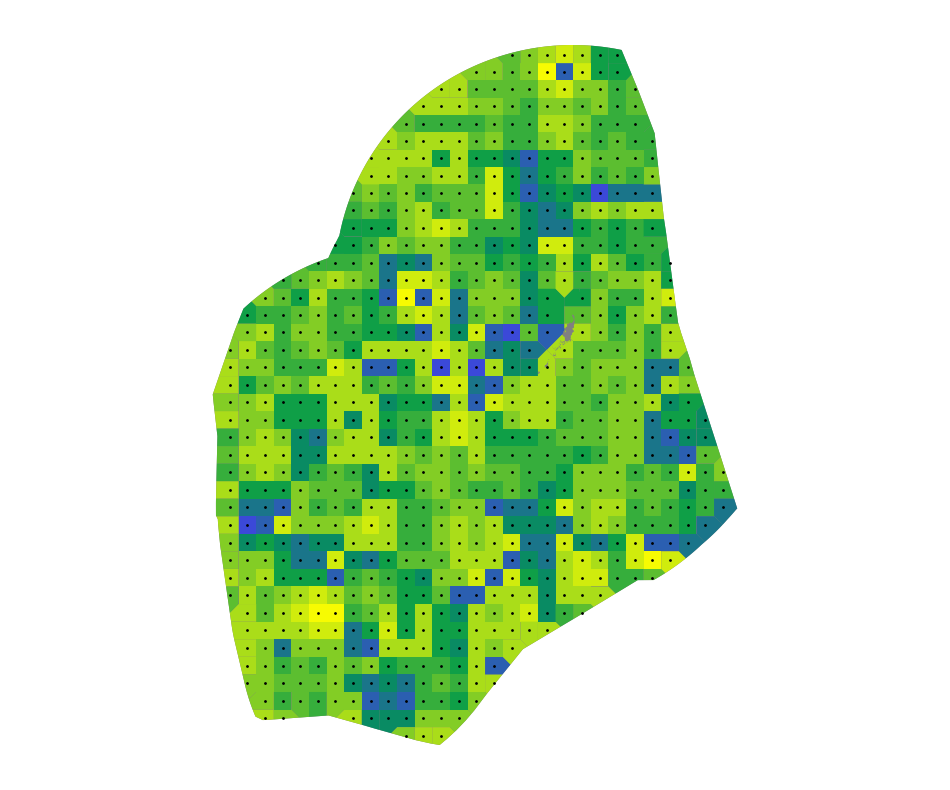

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1912_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


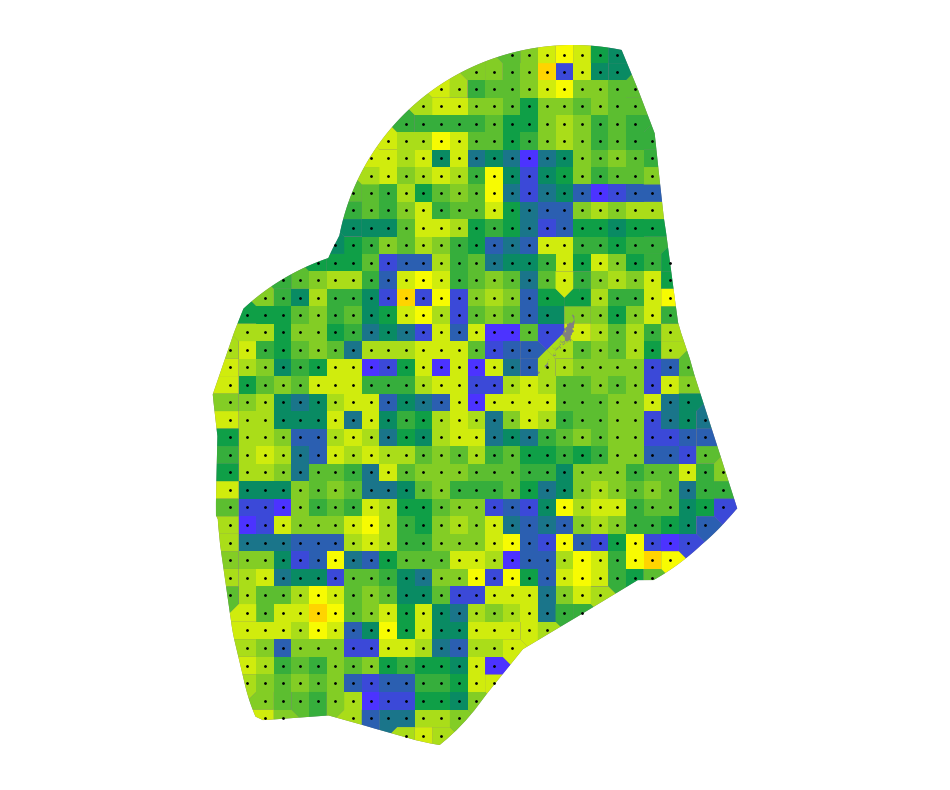

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1913_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


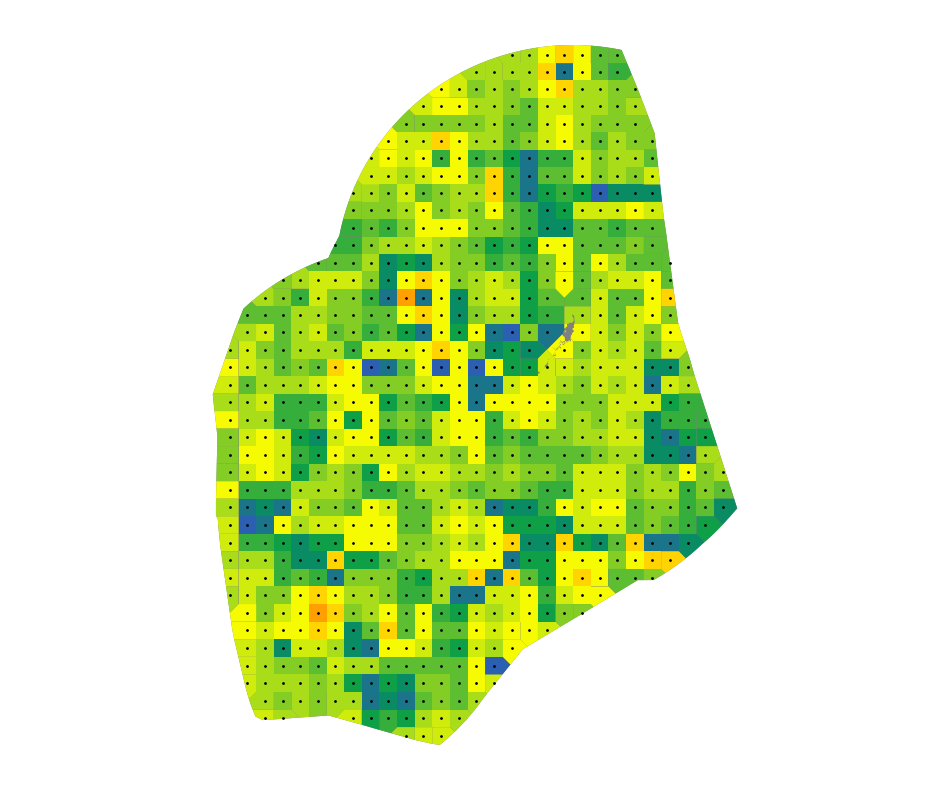

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1914_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


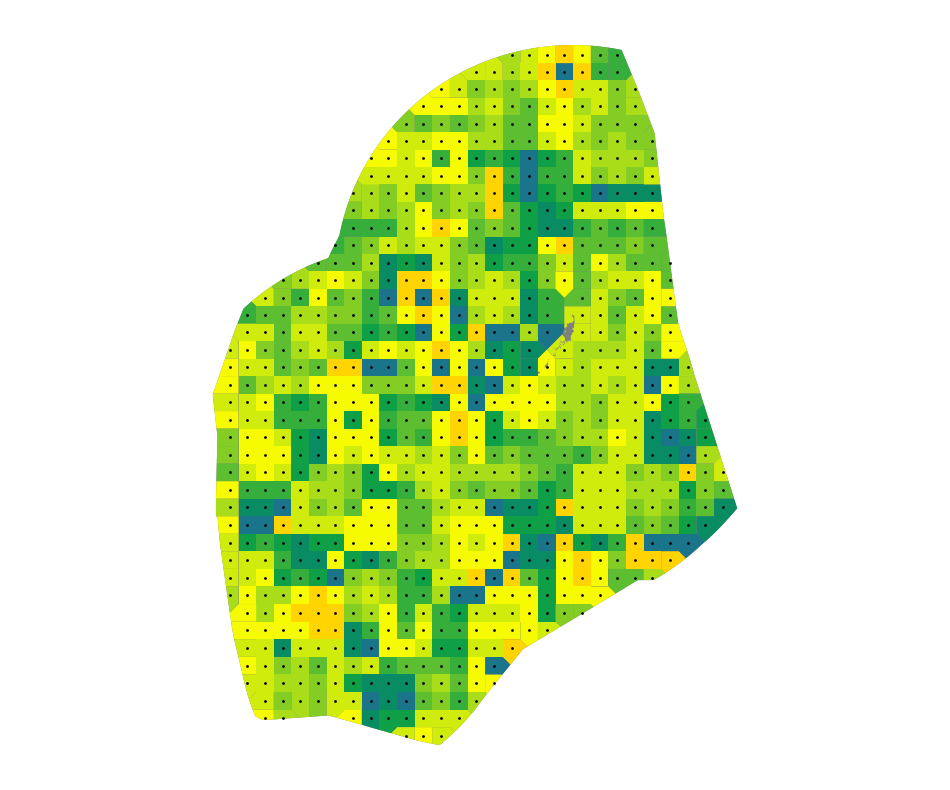

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1915_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


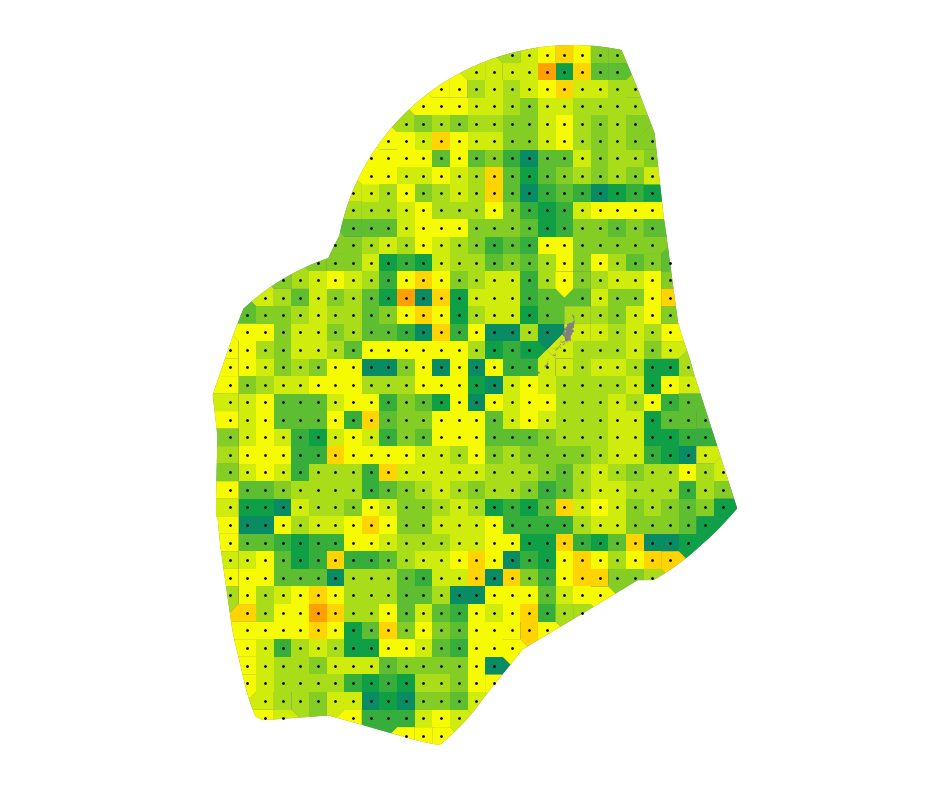

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1916_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


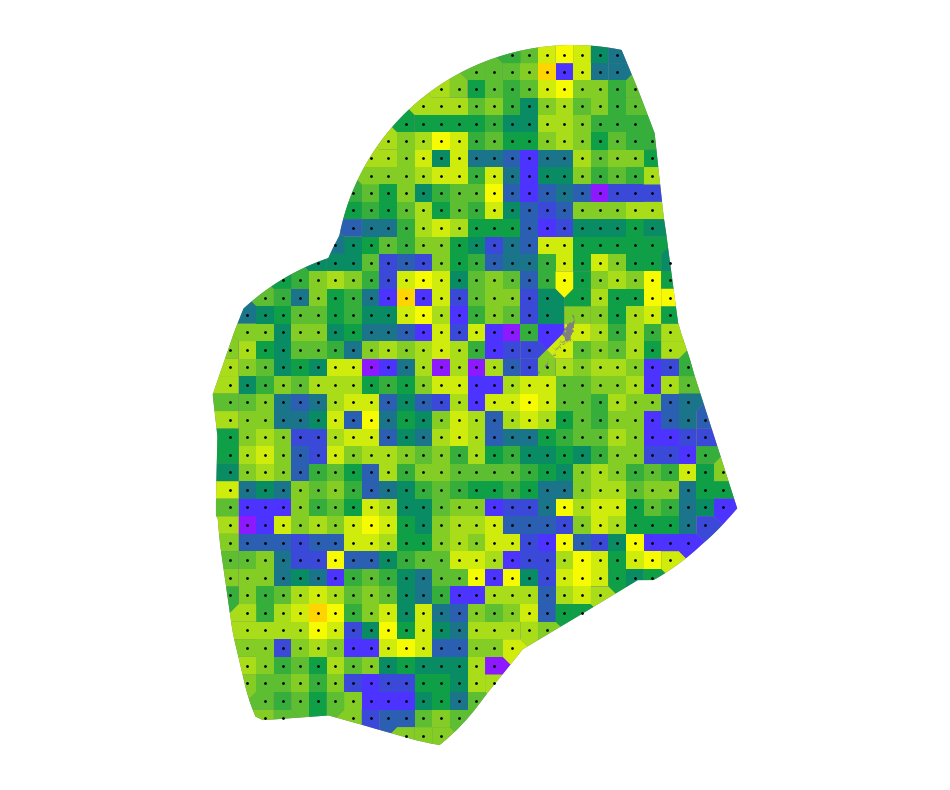

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1917_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


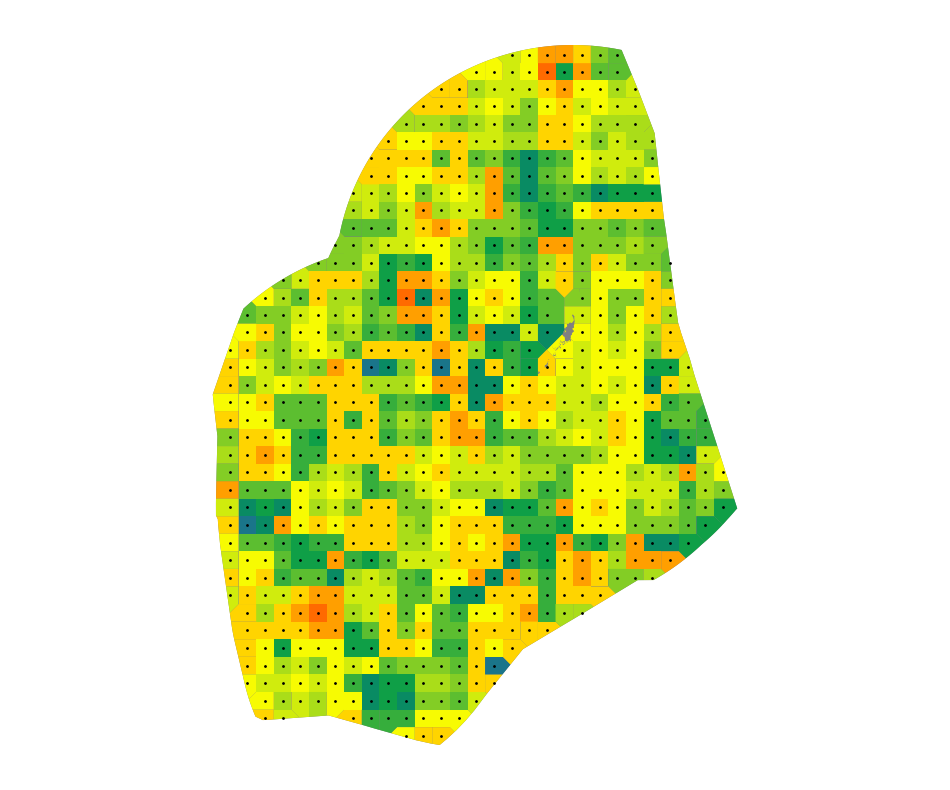

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1918_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


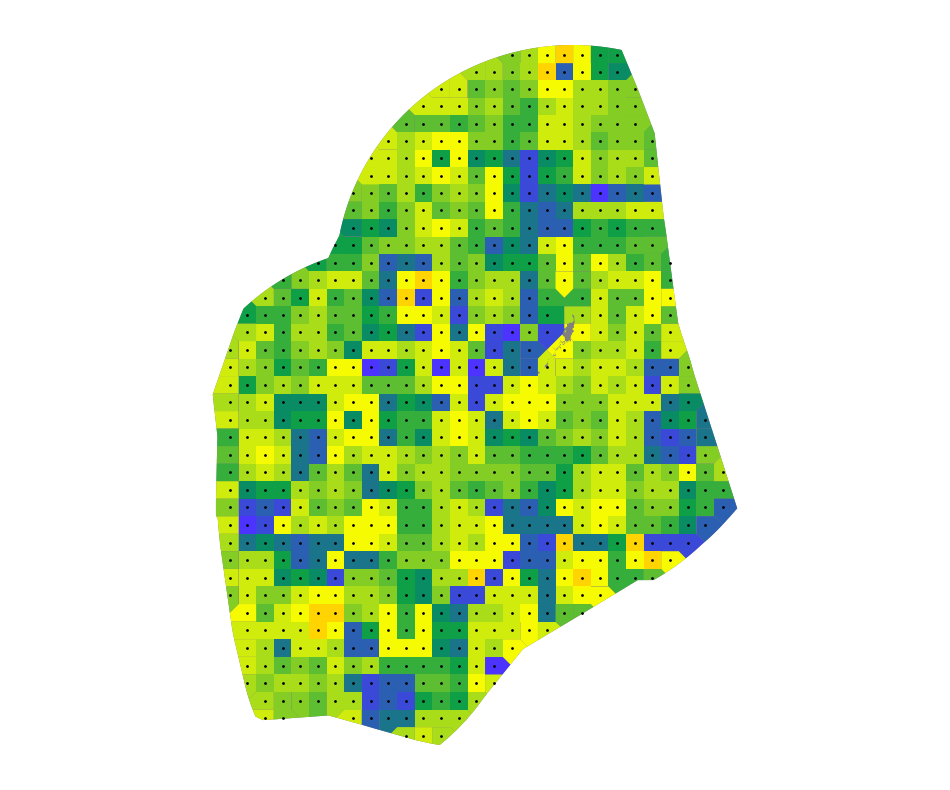

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1919_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


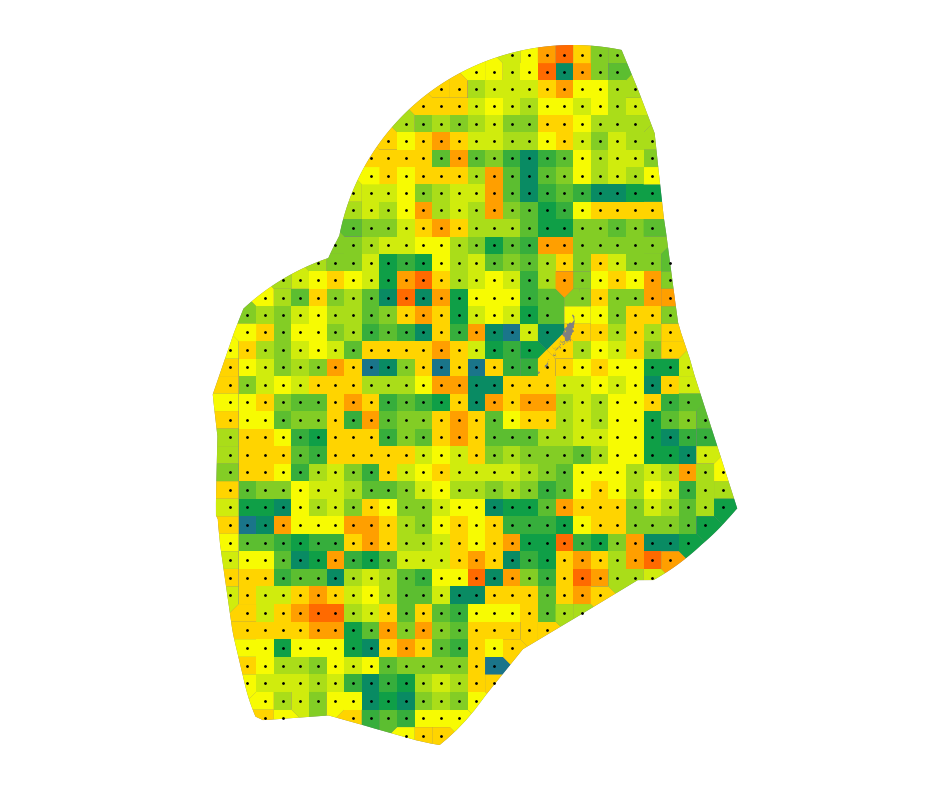

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1920_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


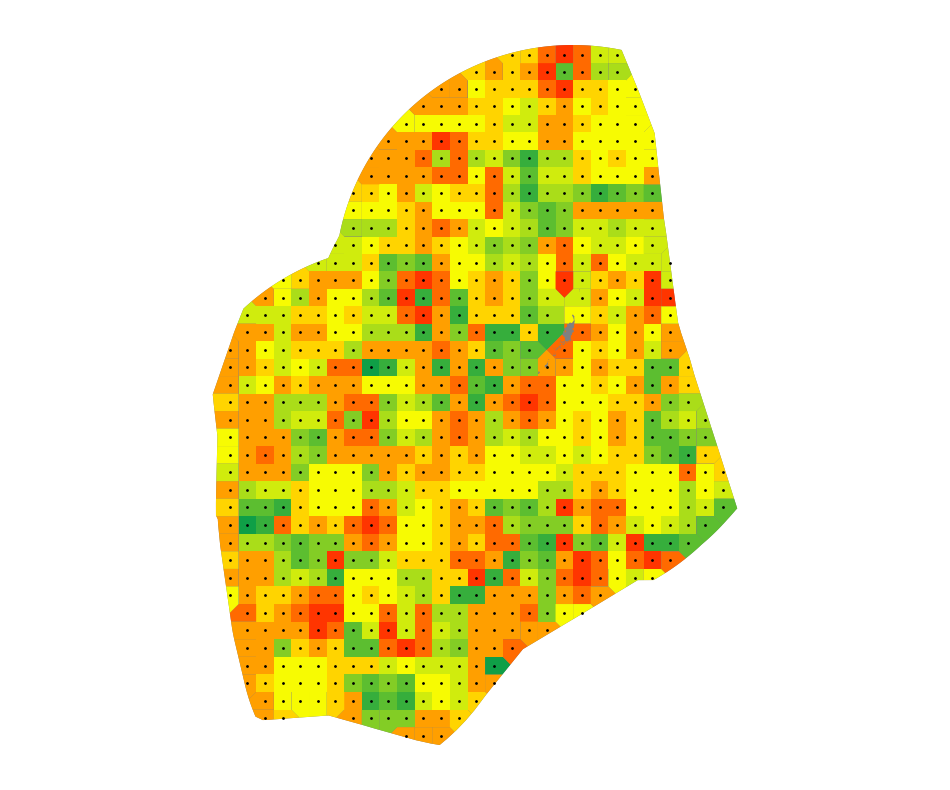

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1921_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


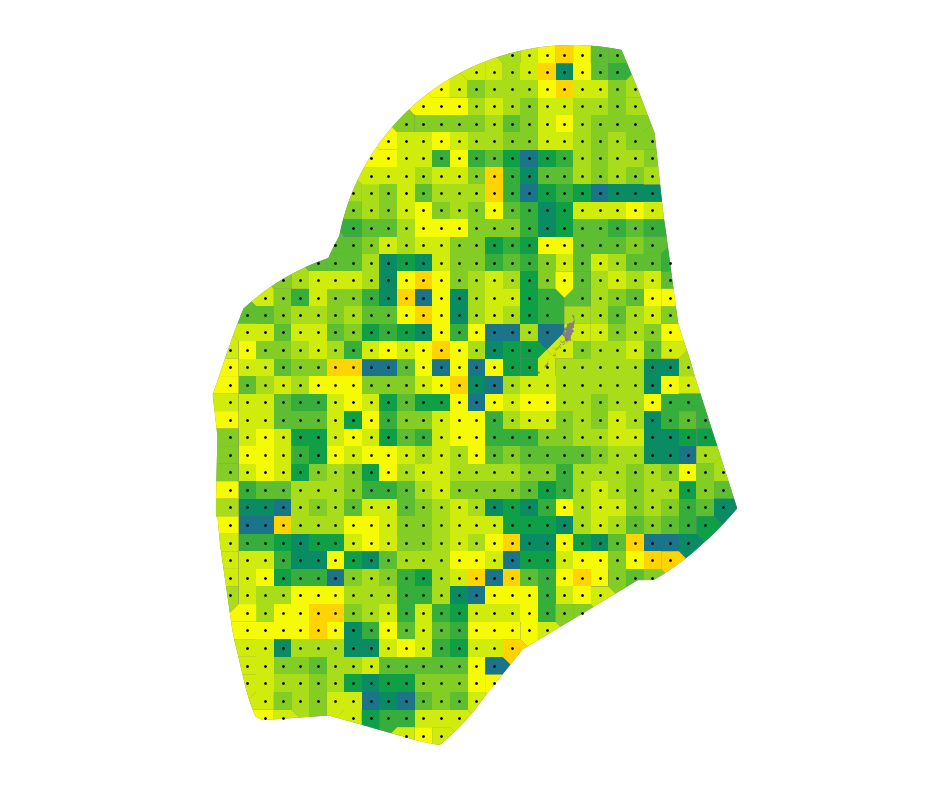

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1922_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


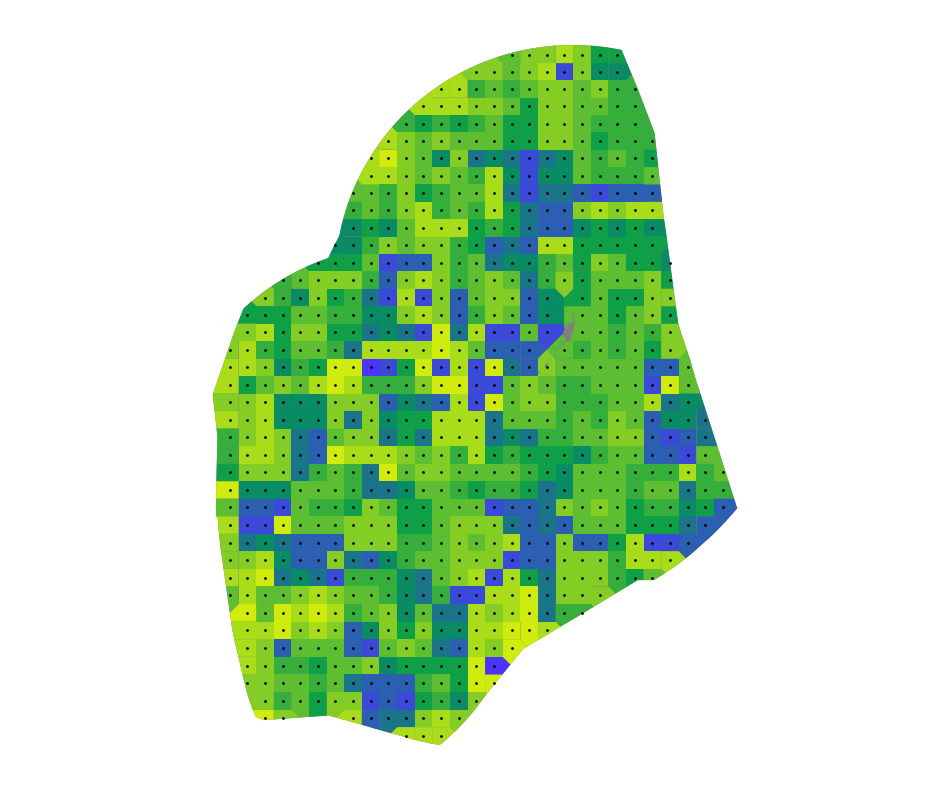

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1923_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


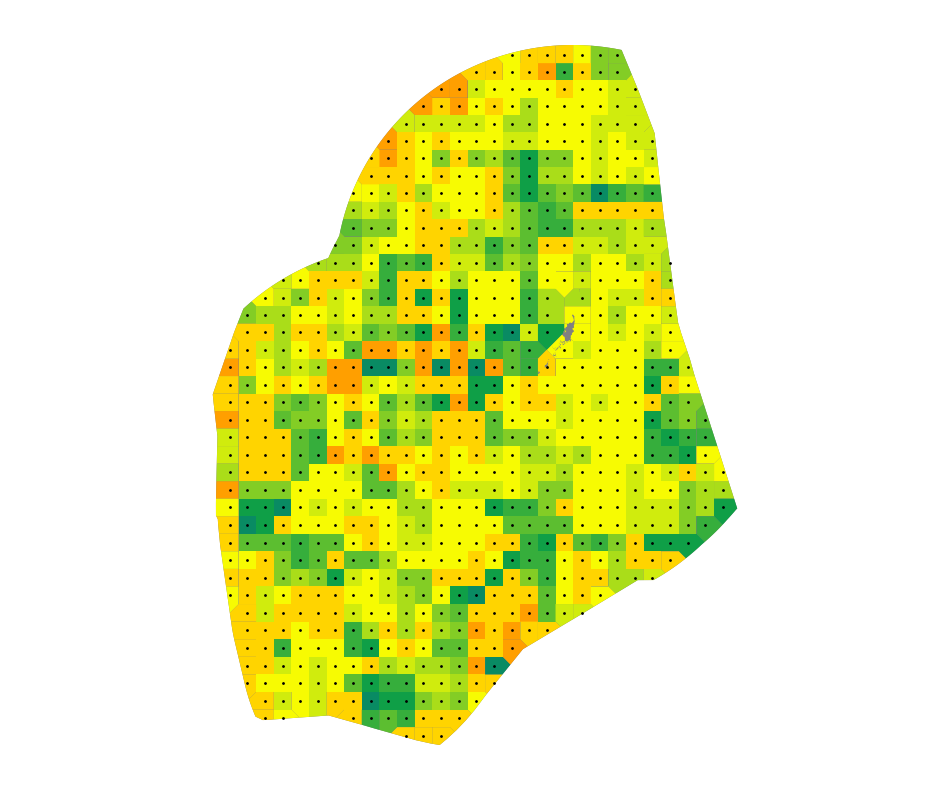

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1924_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


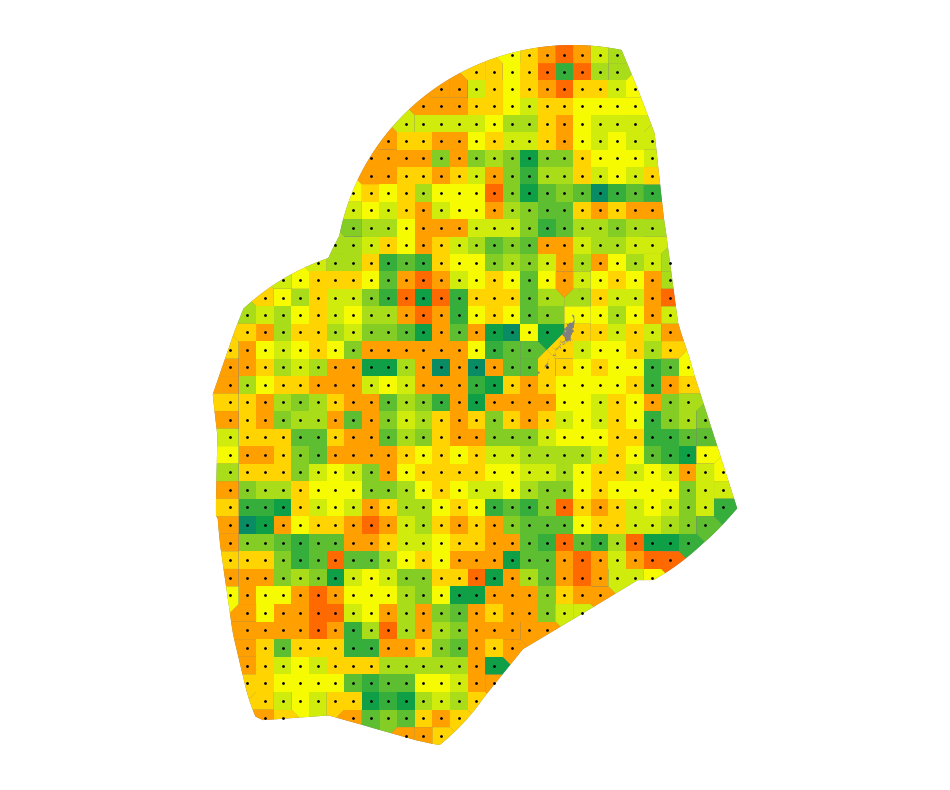

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1925_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


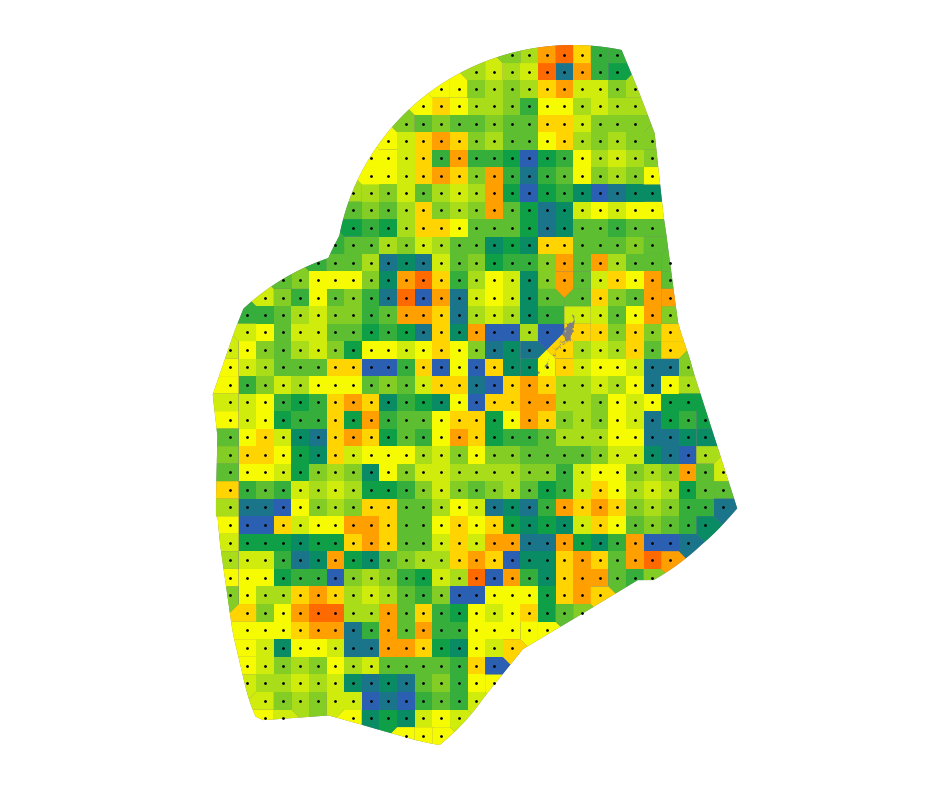

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1926_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


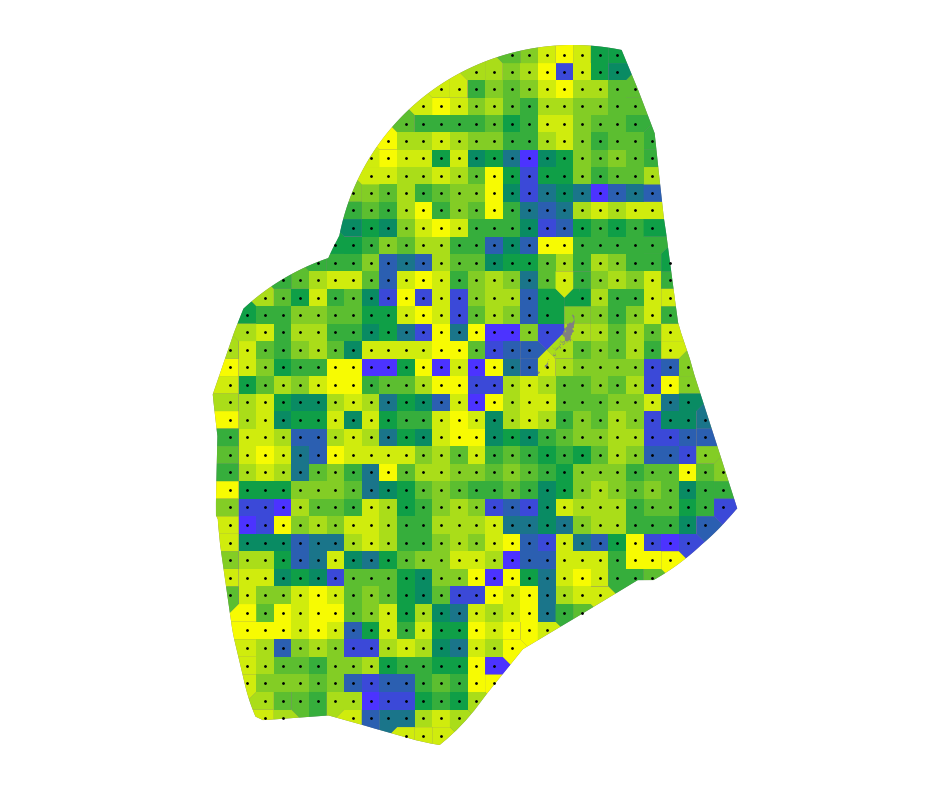

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1927_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


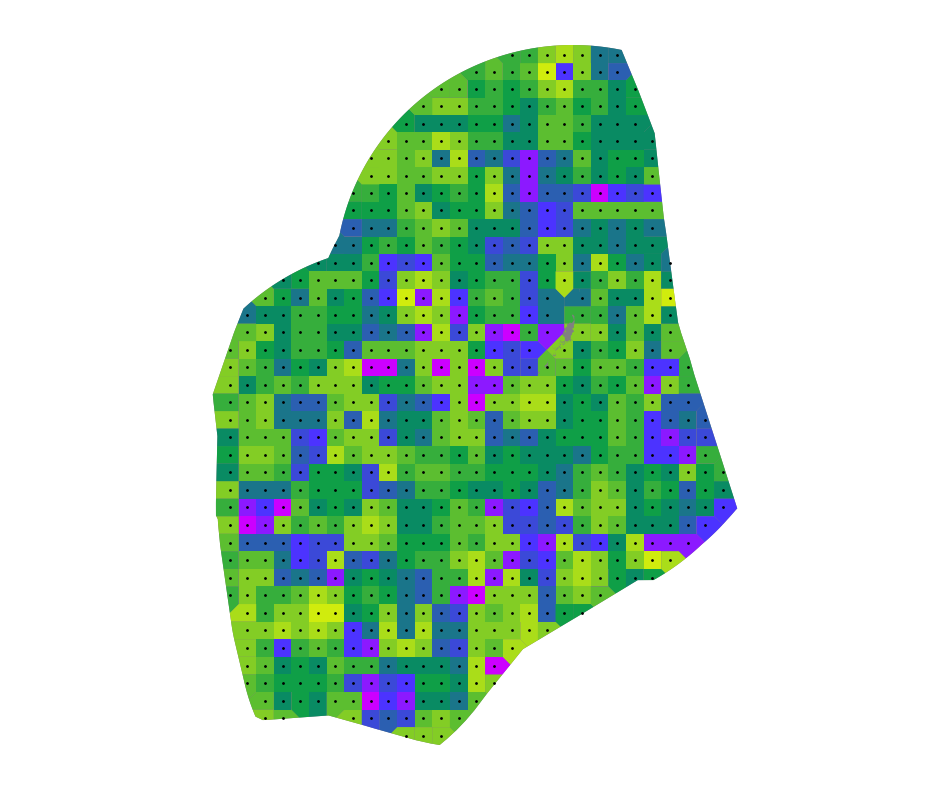

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1928_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


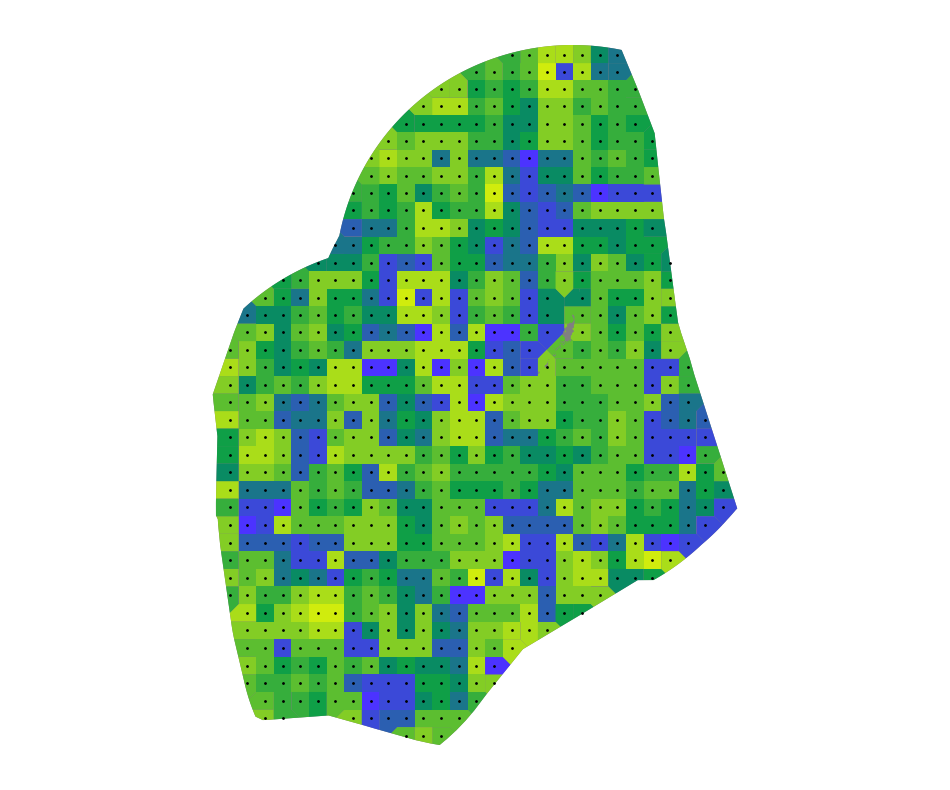

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1929_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


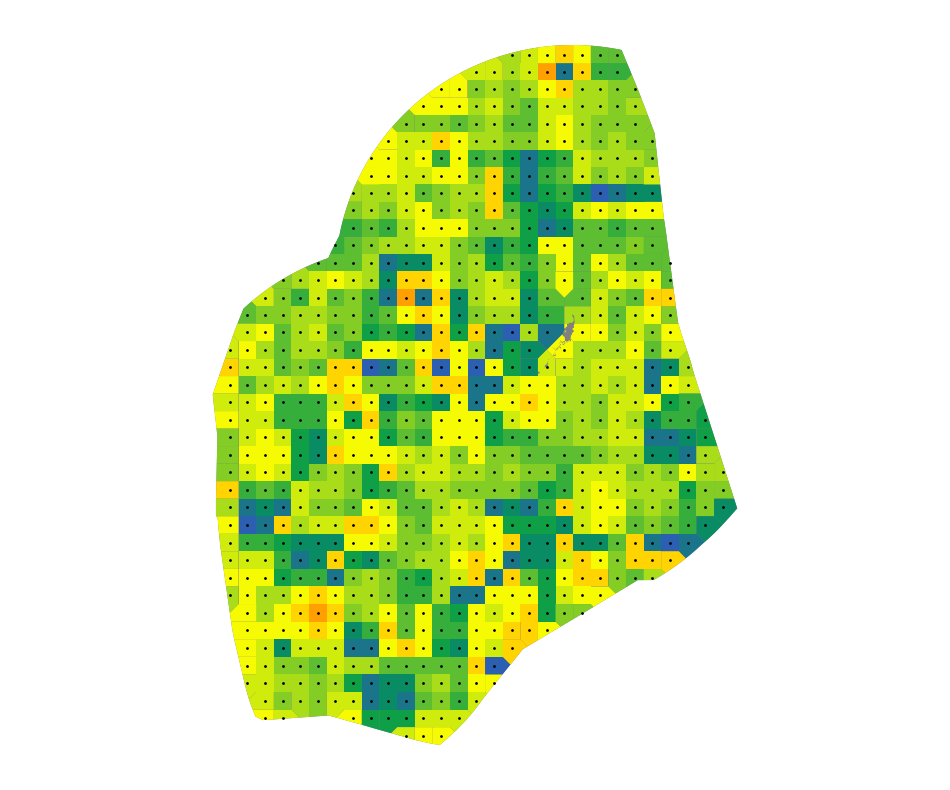

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1930_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


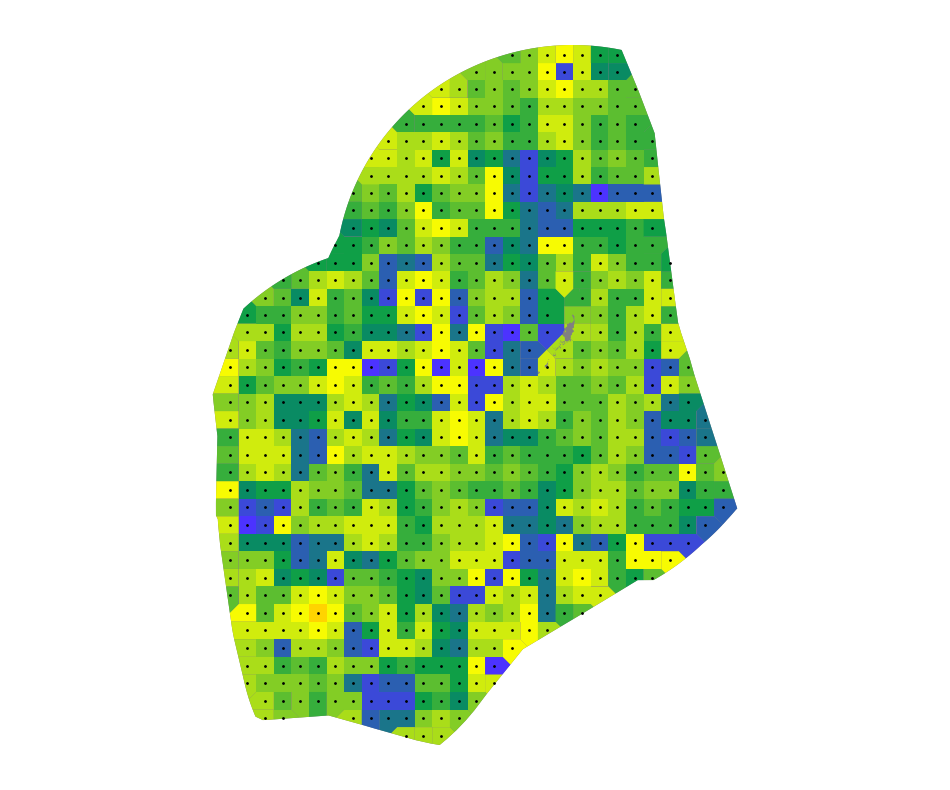

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1931_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


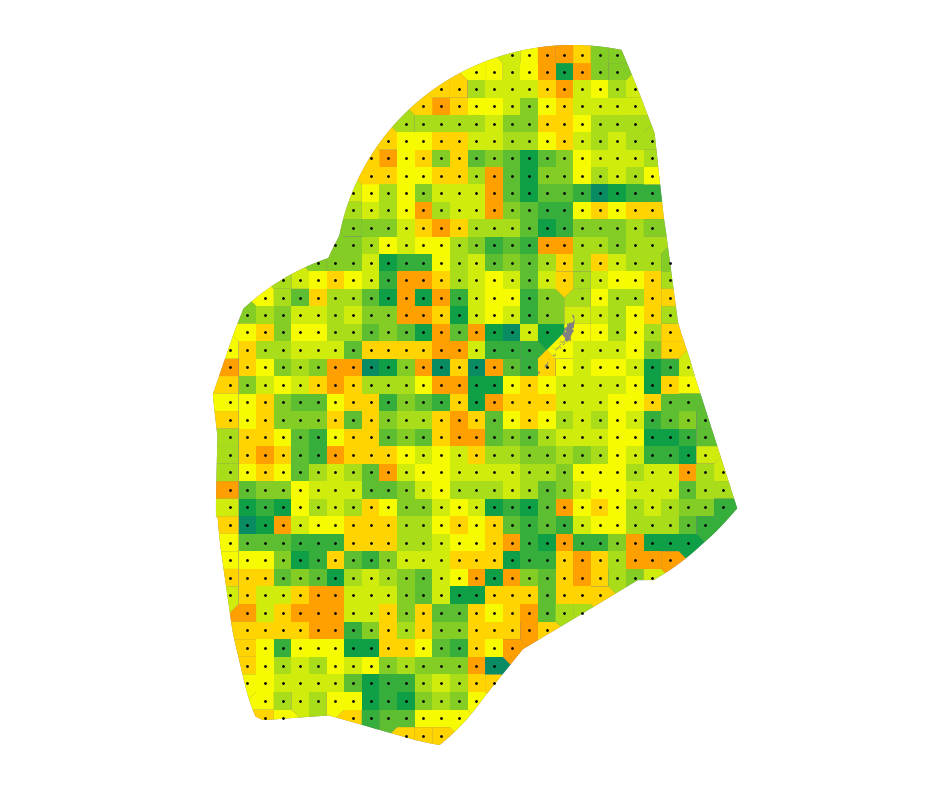

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1932_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


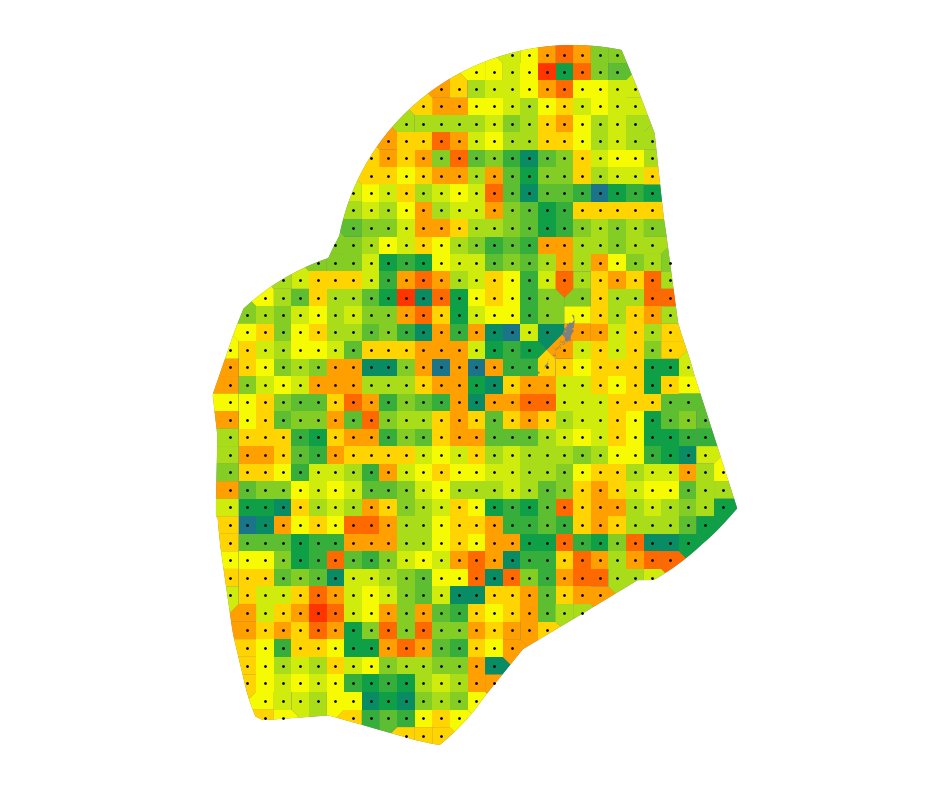

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1933_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


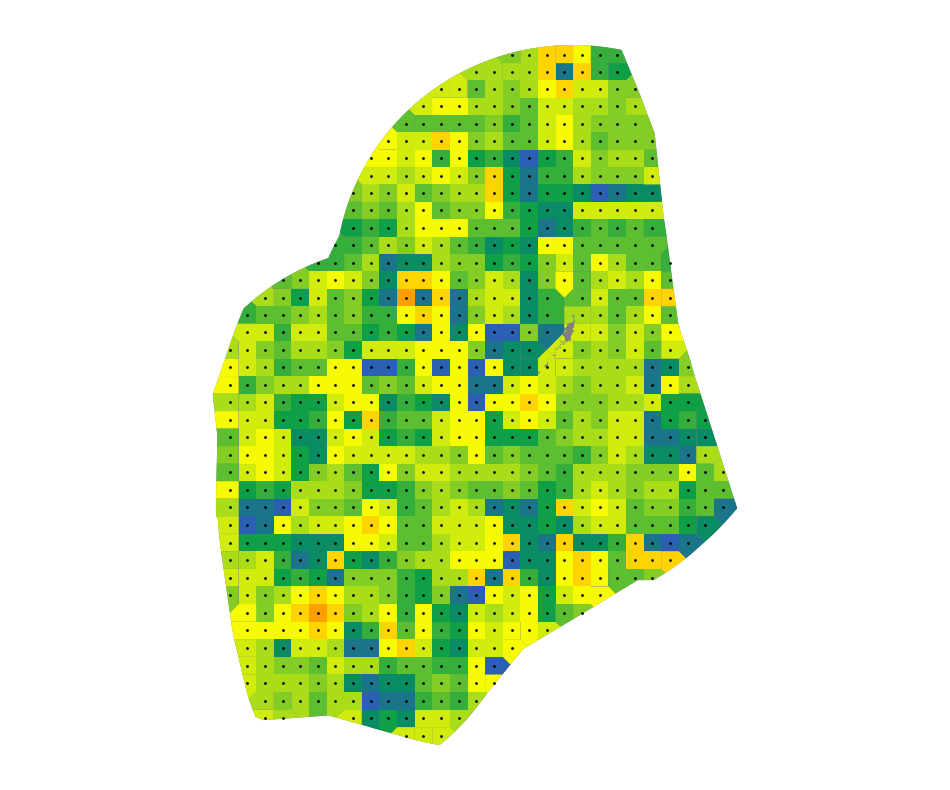

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1934_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


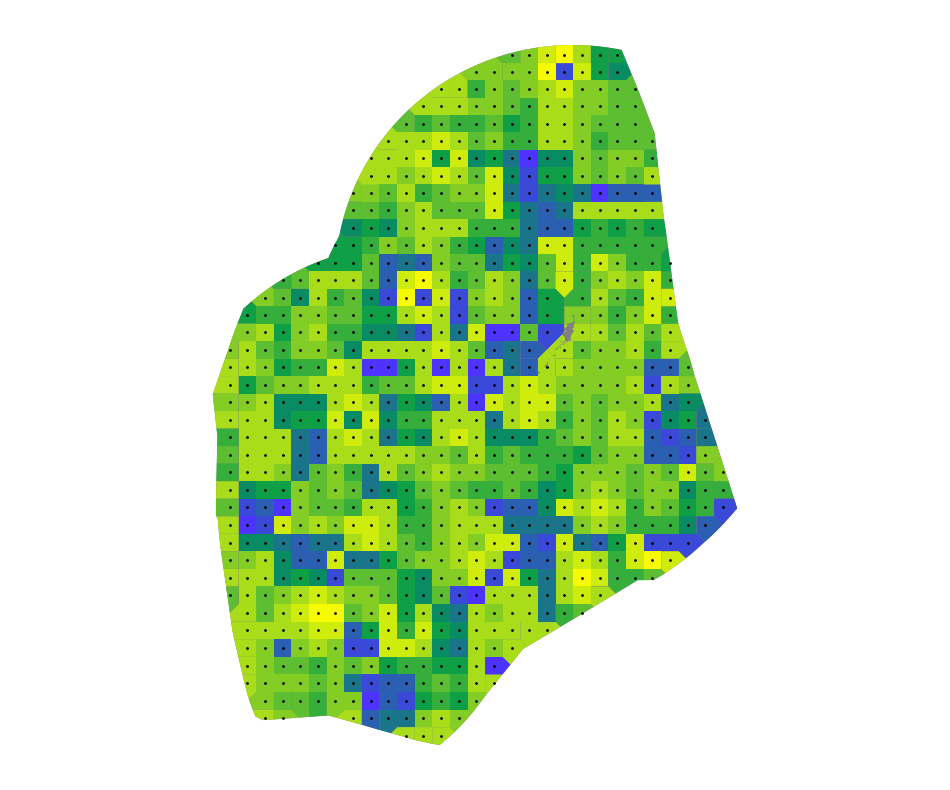

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1935_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


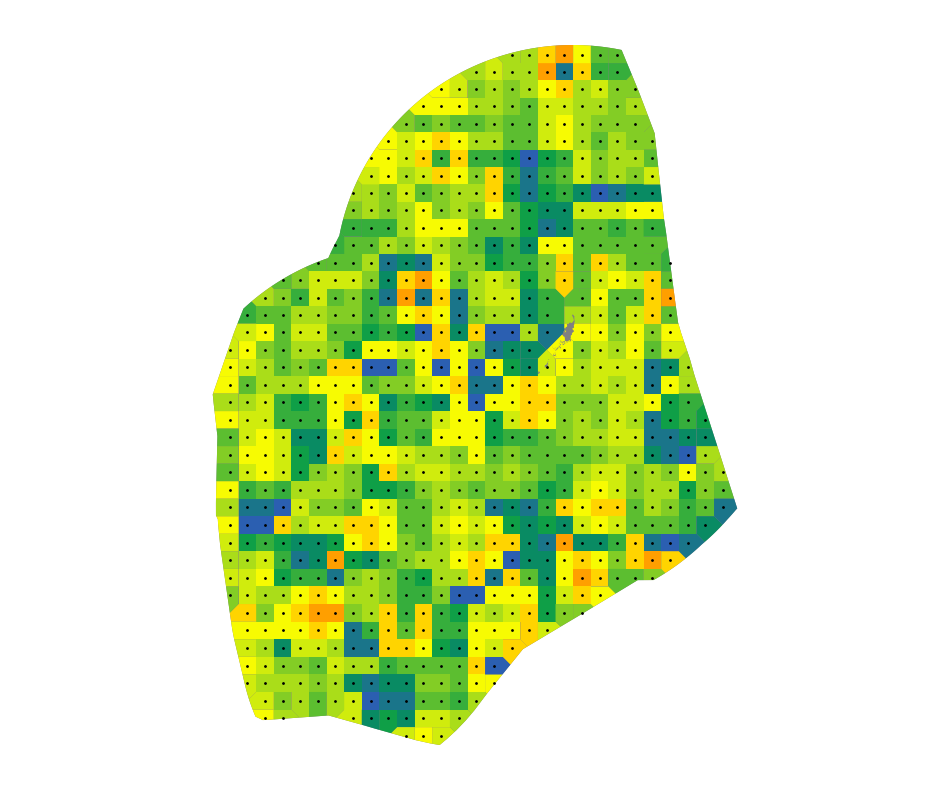

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1936_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


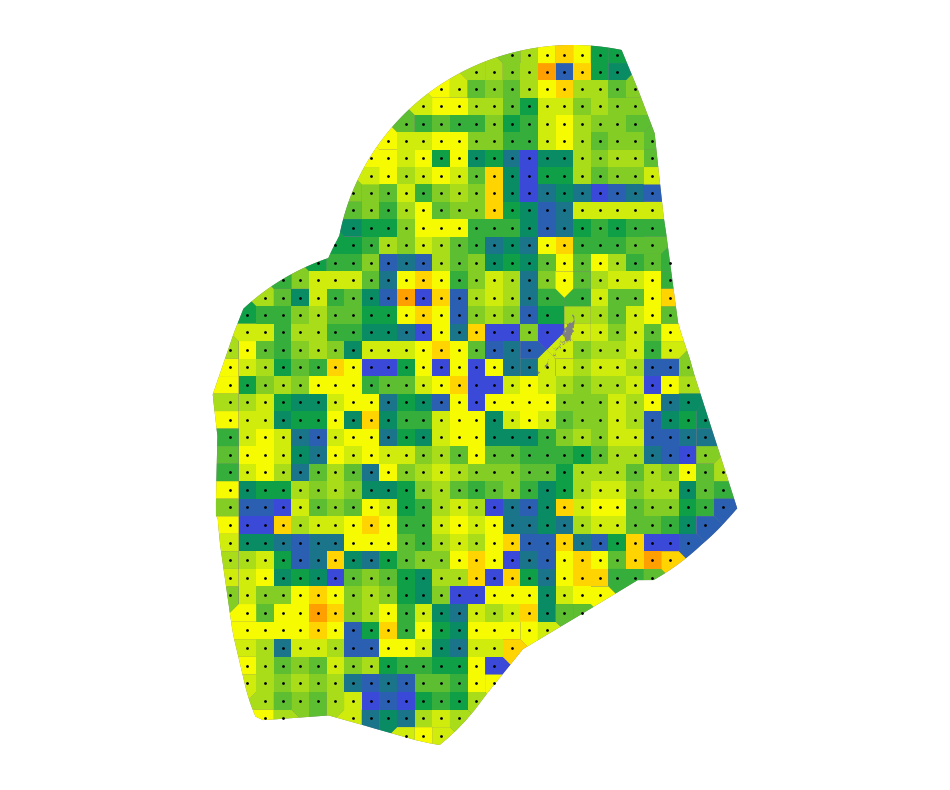

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1937_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


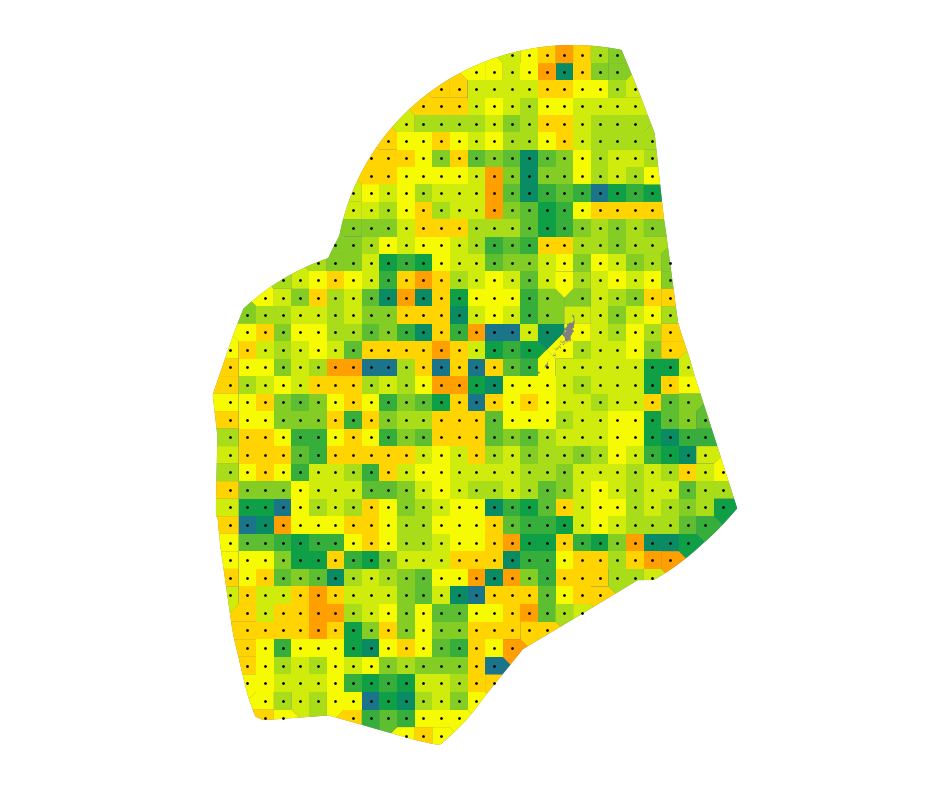

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1938_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


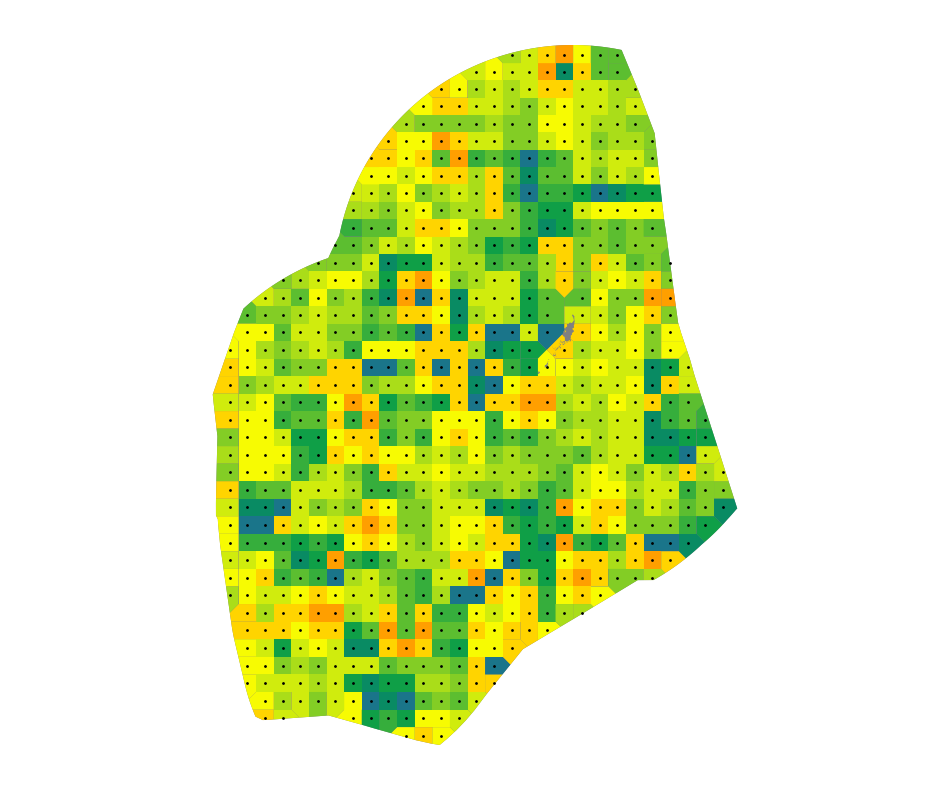

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1939_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


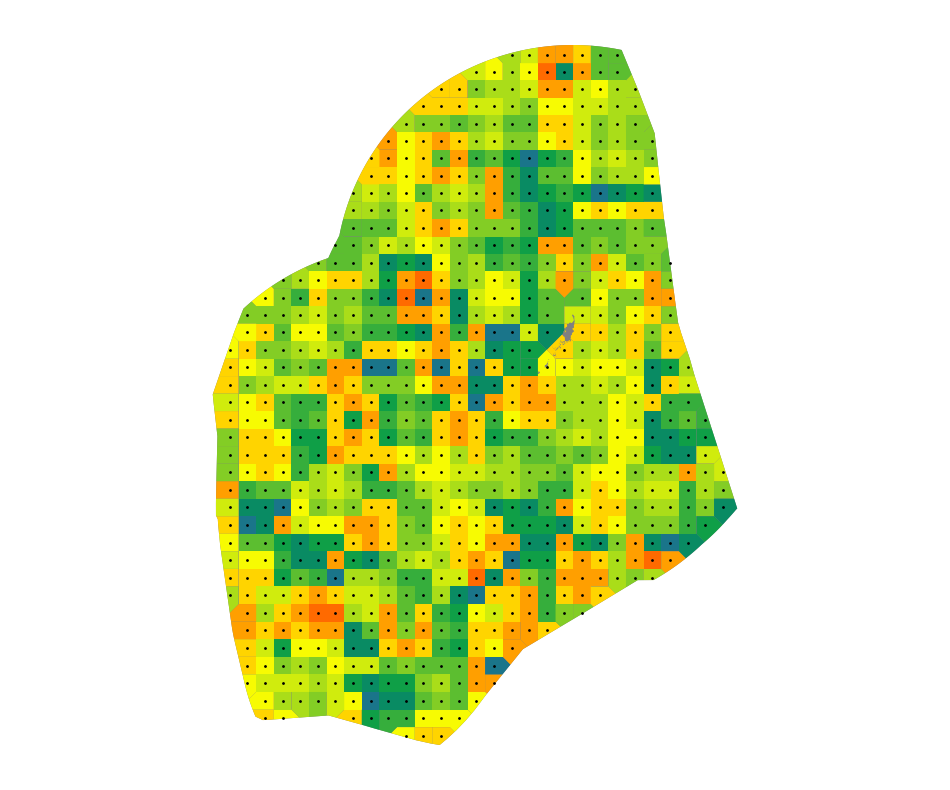

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1940_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


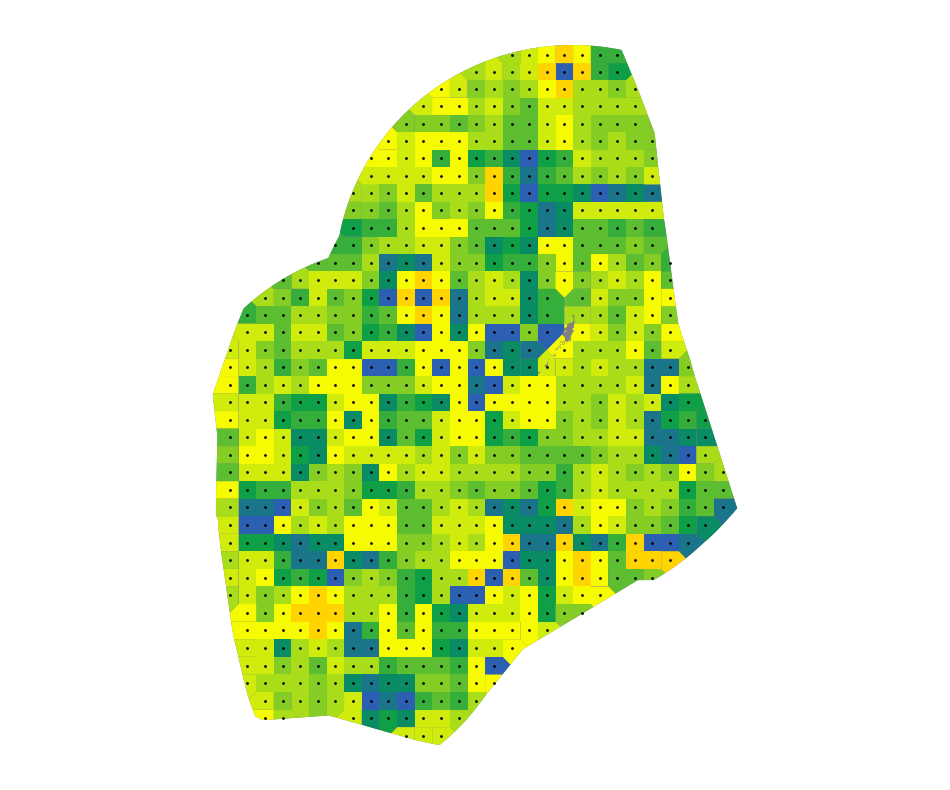

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1941_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


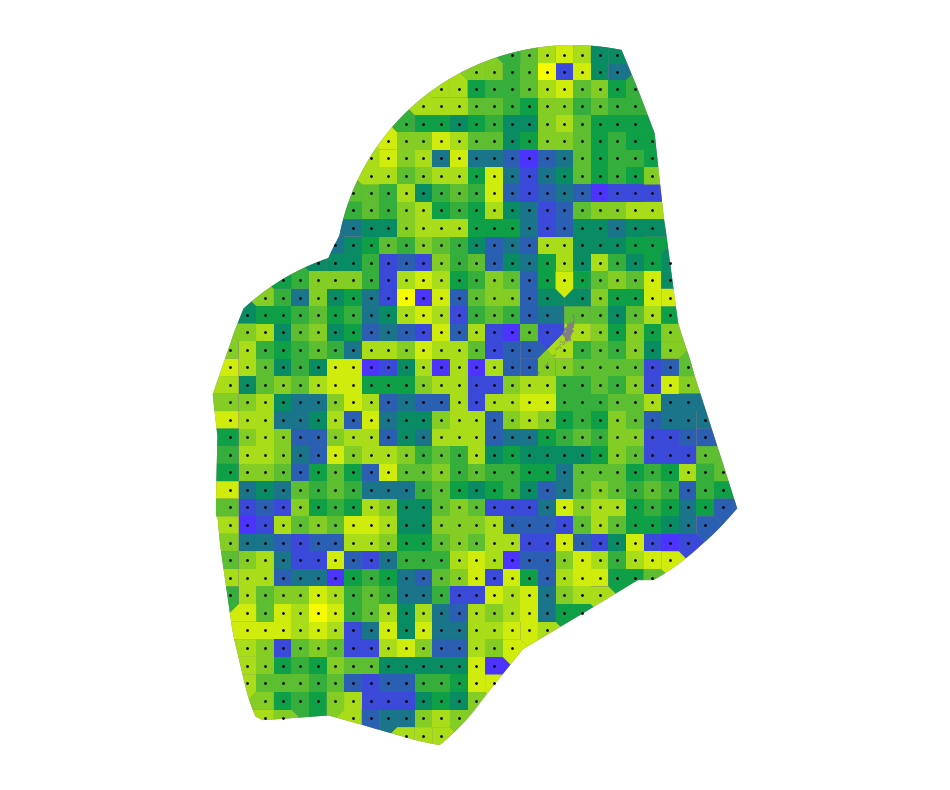

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1942_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


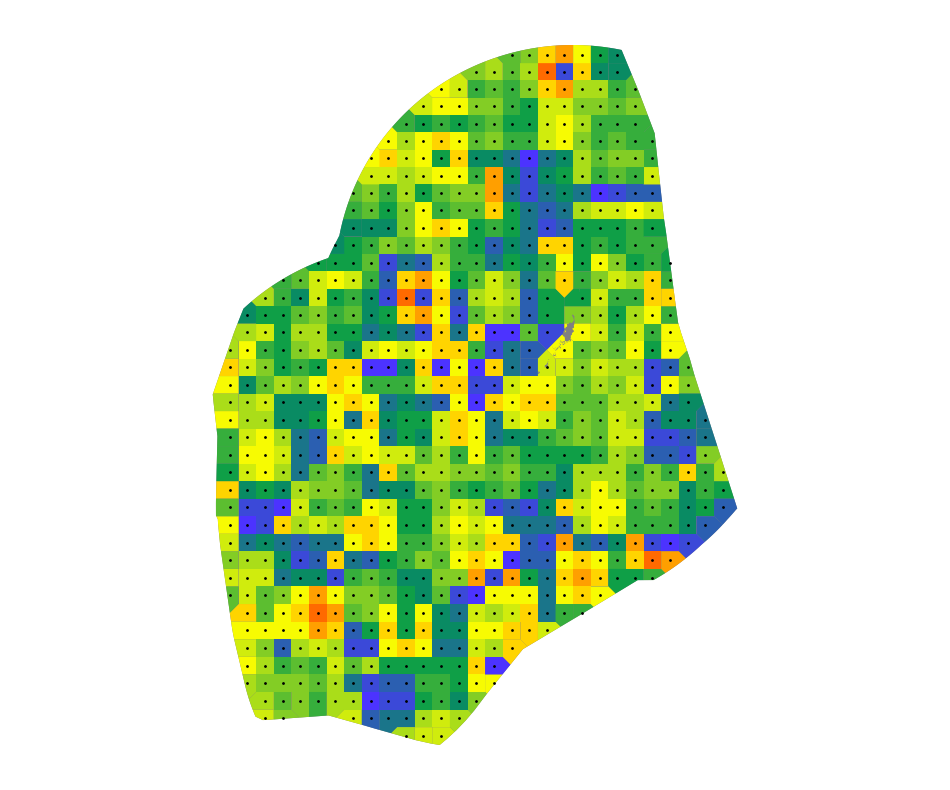

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1943_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


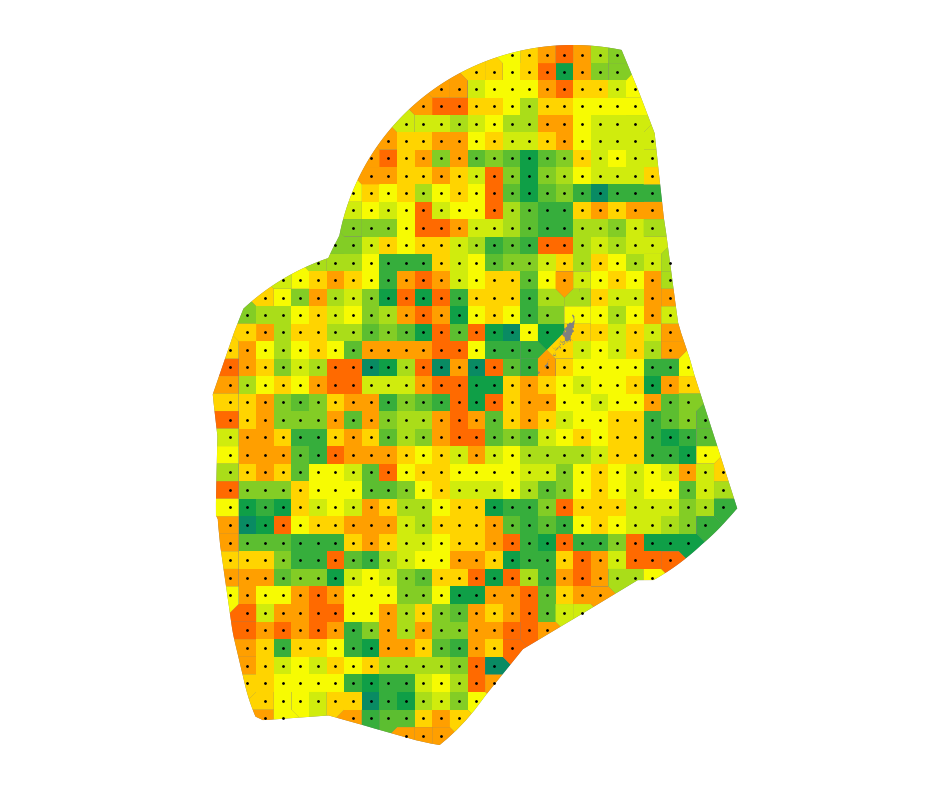

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1944_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


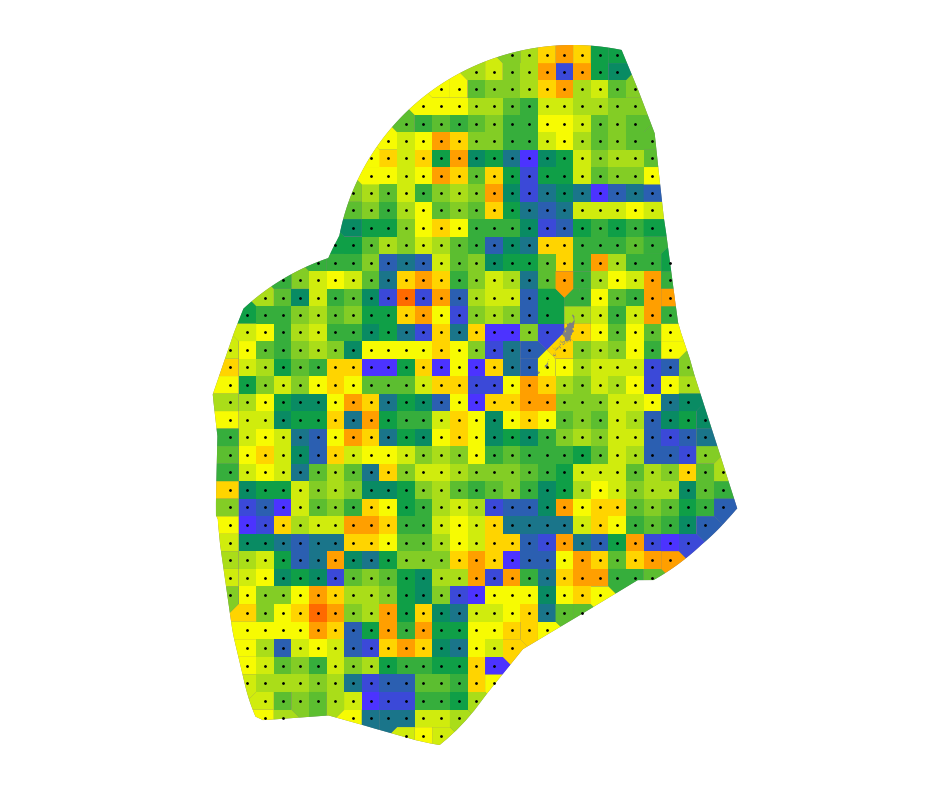

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1945_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


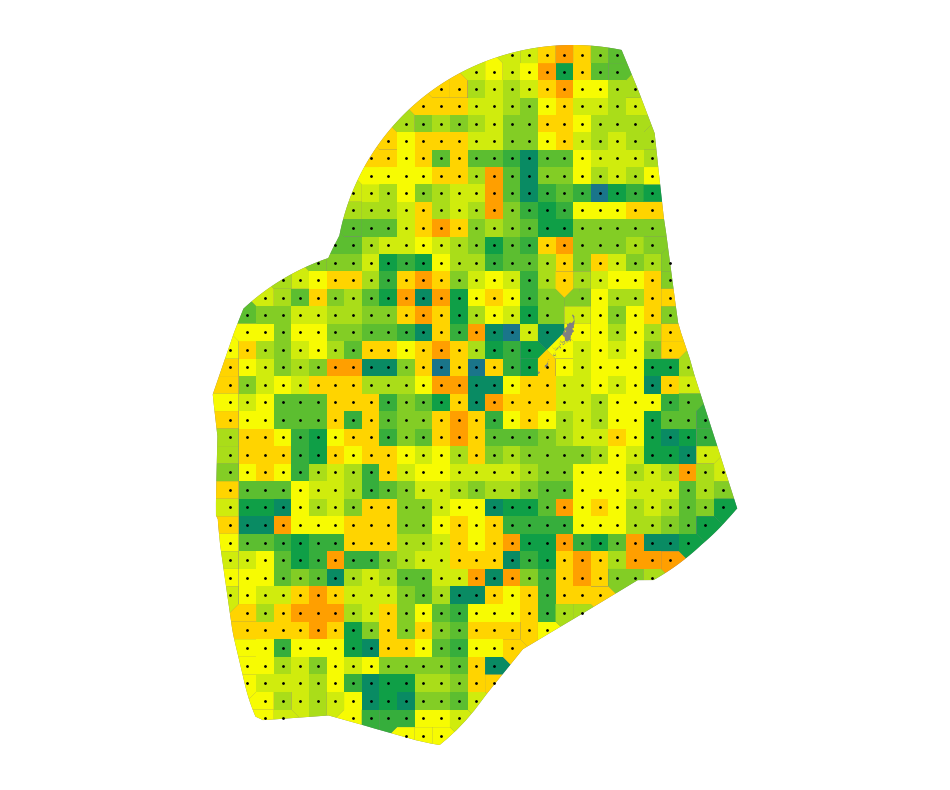

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1946_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


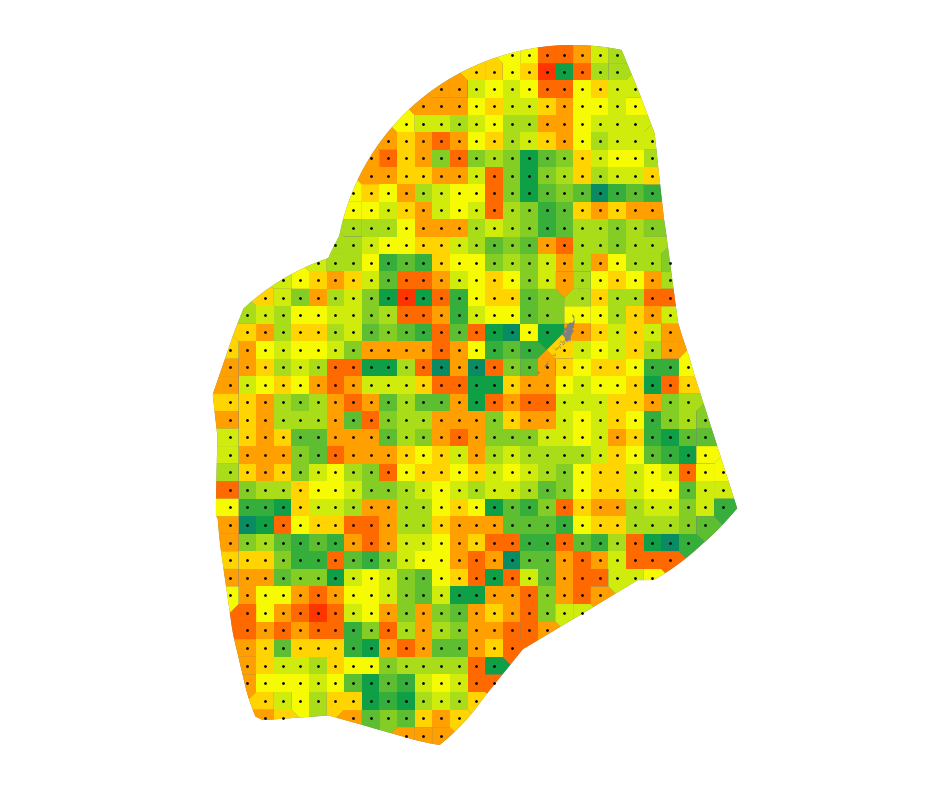

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1947_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


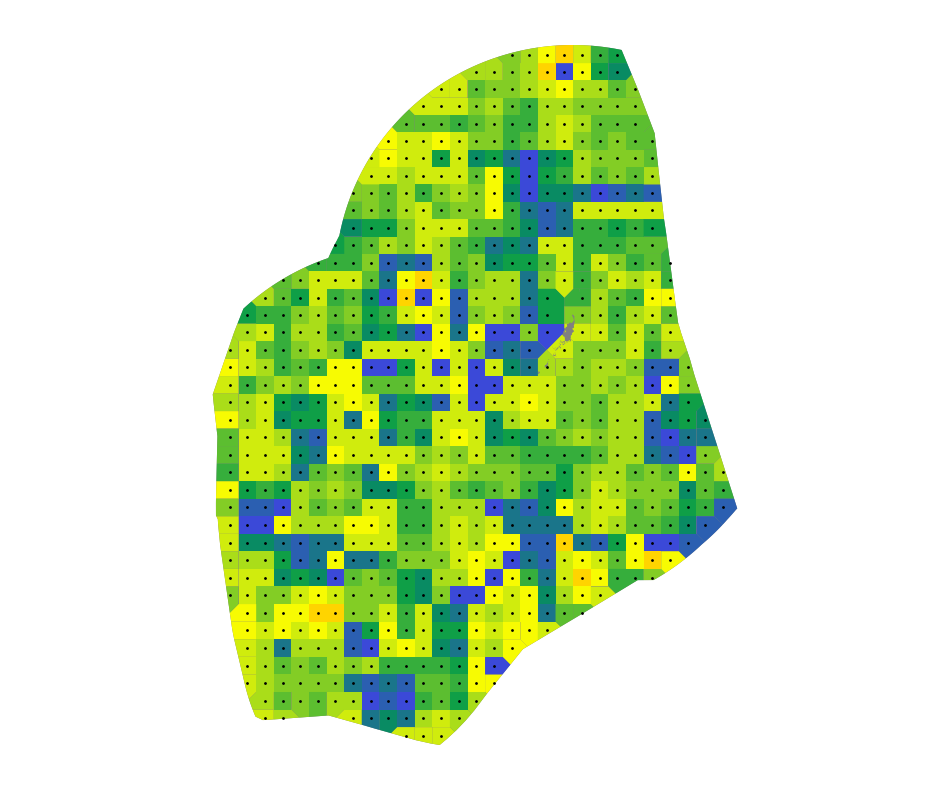

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1948_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


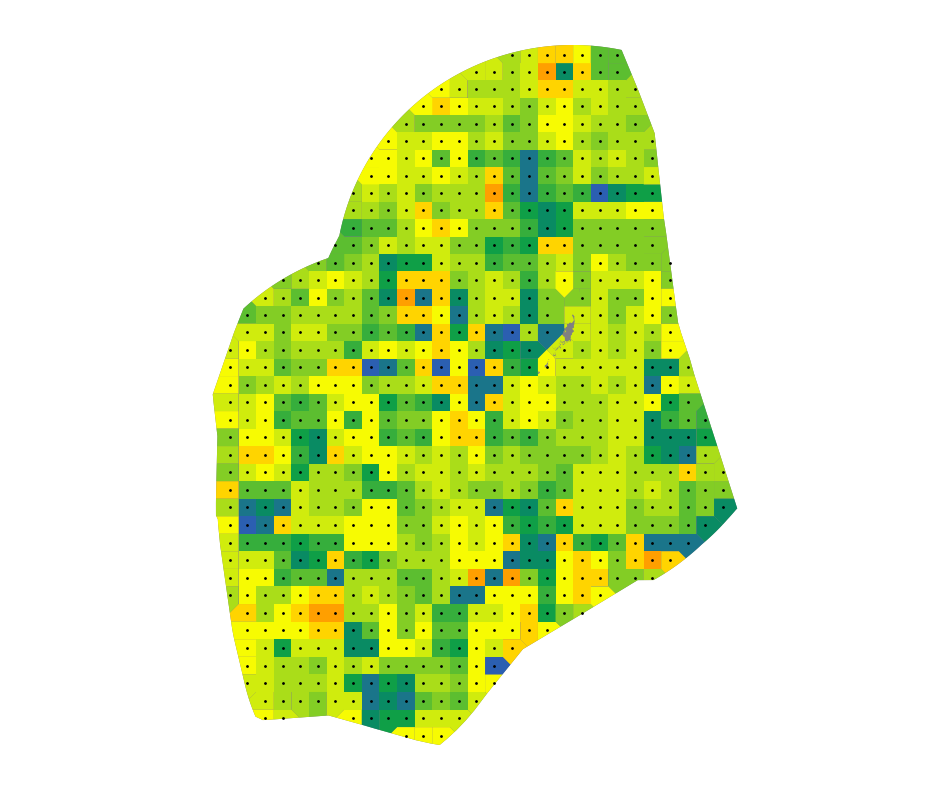

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1949_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


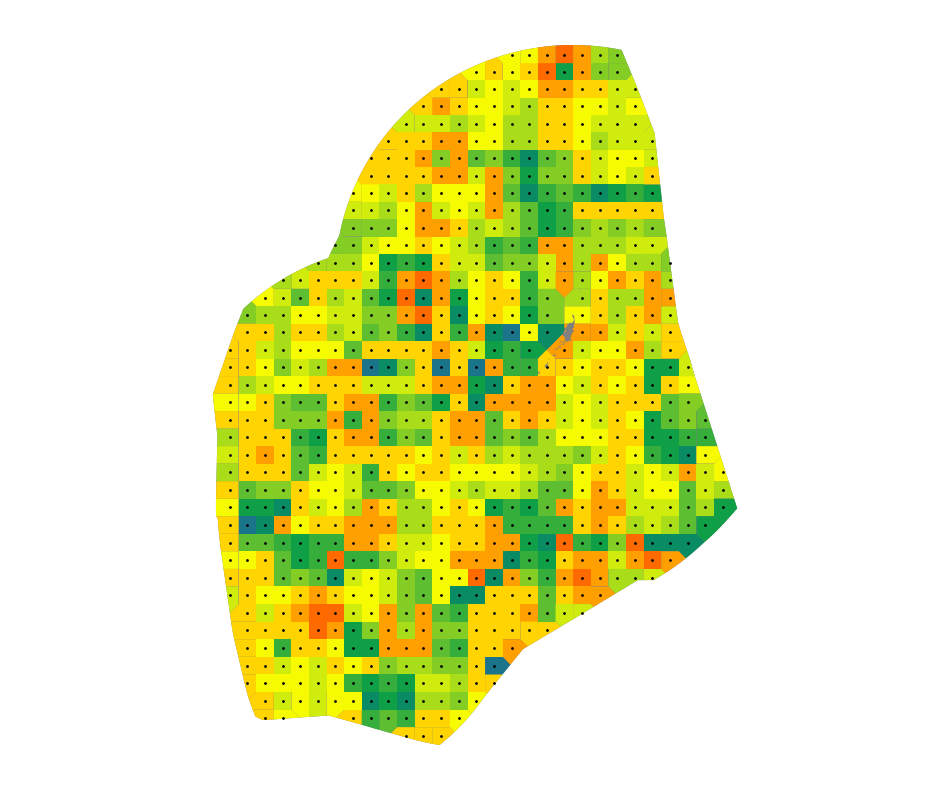

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1950_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


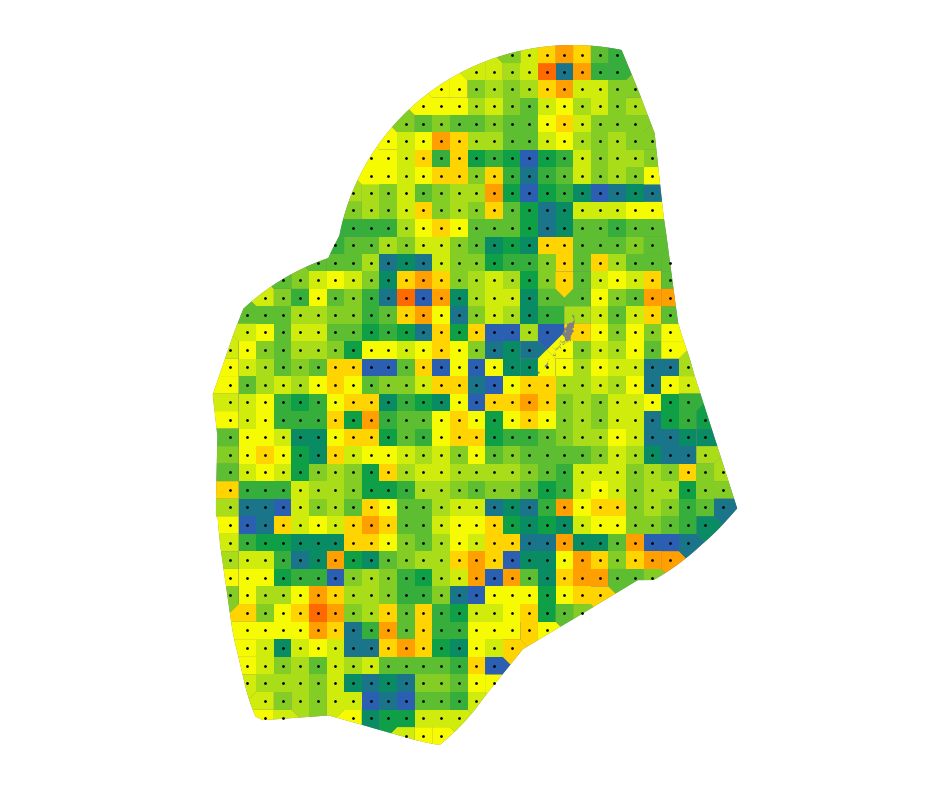

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1951_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


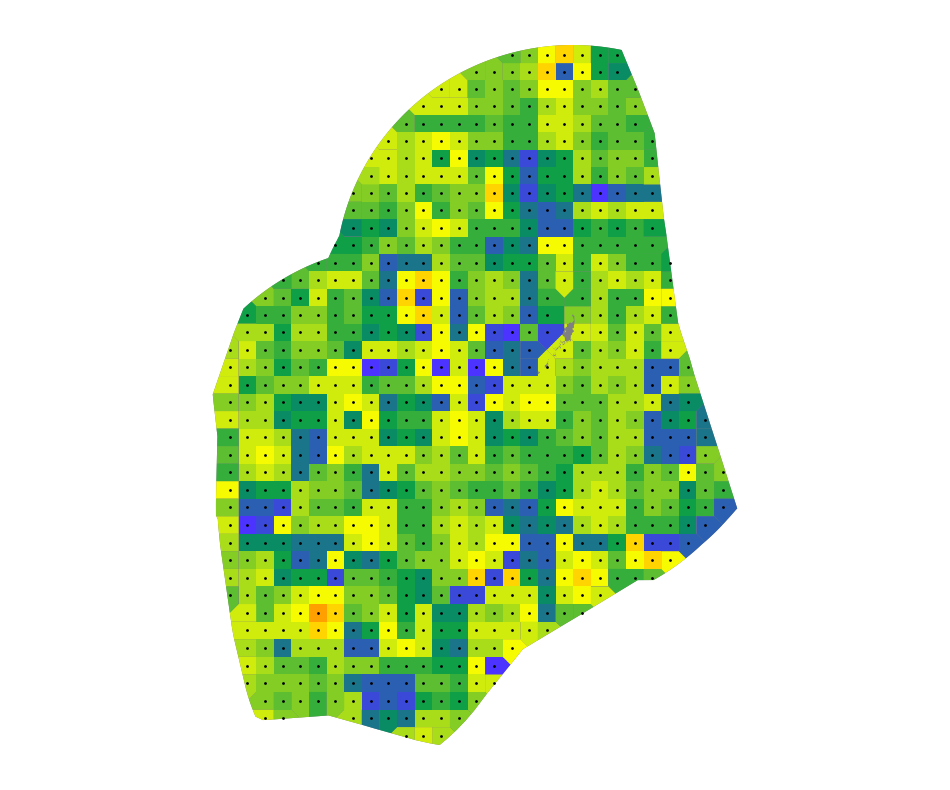

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1952_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


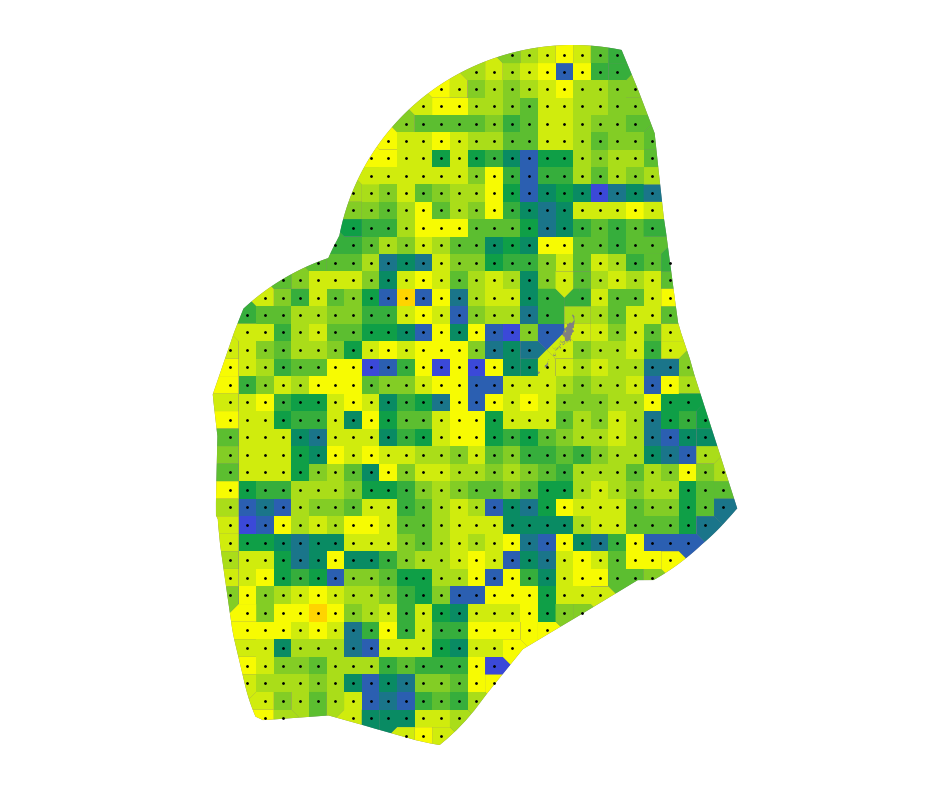

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1953_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


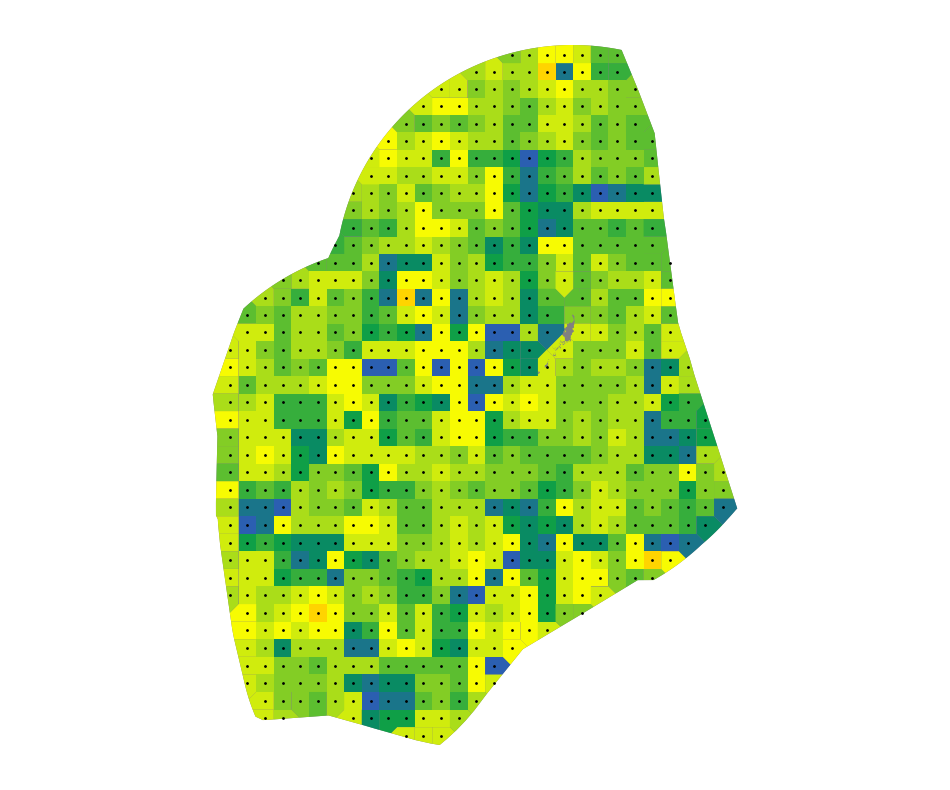

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1954_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


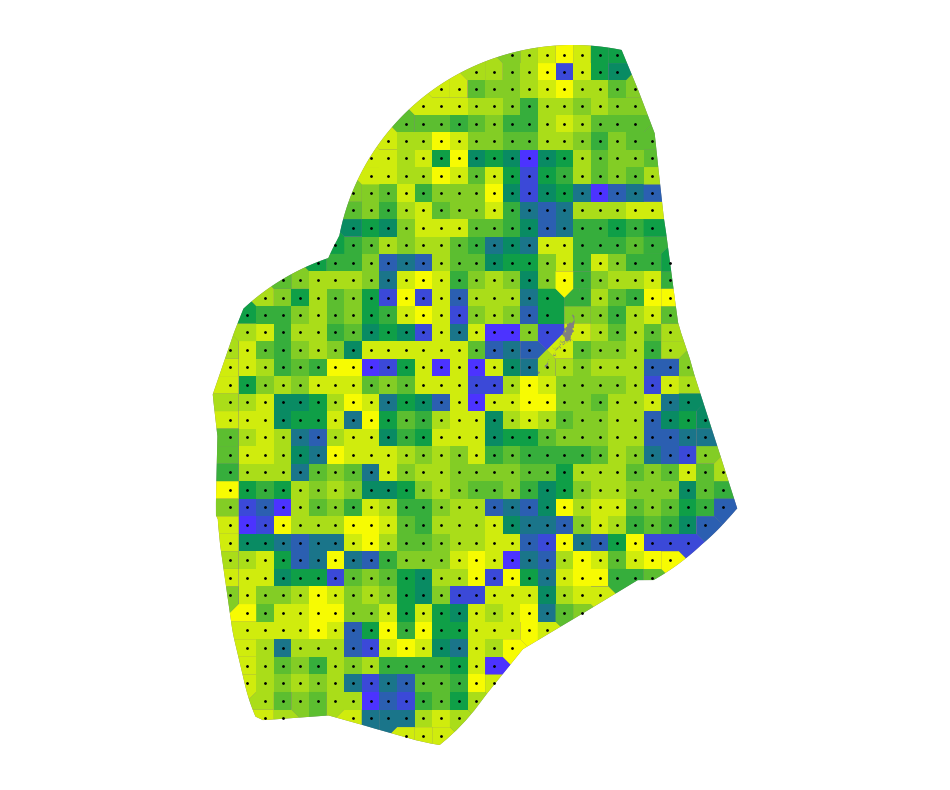

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1955_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


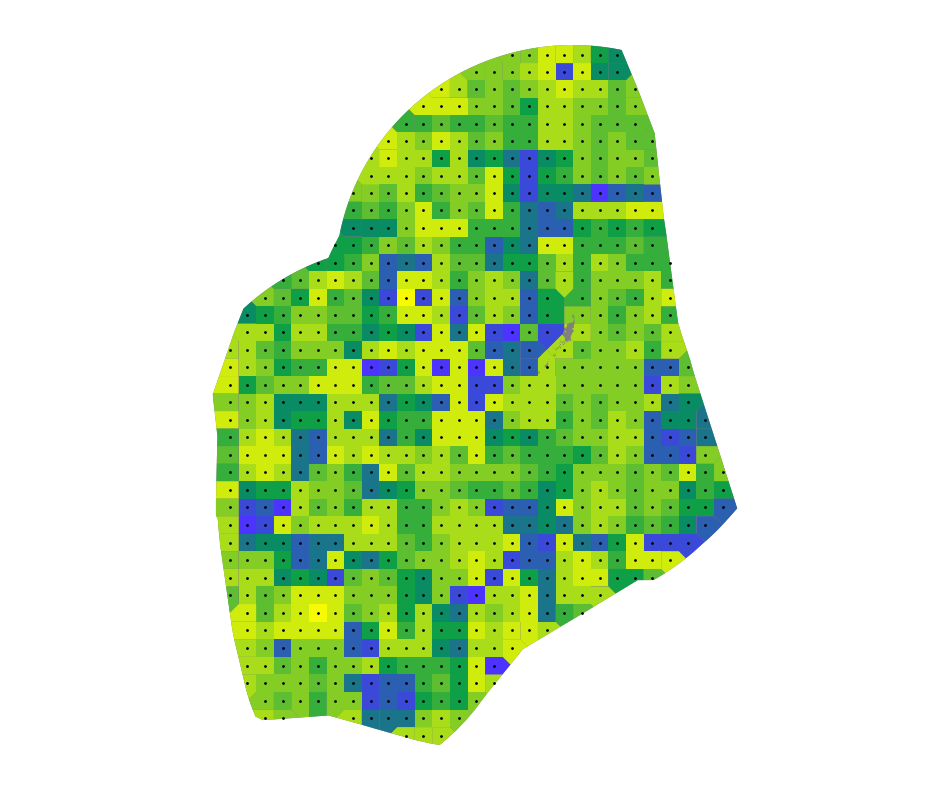

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1956_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


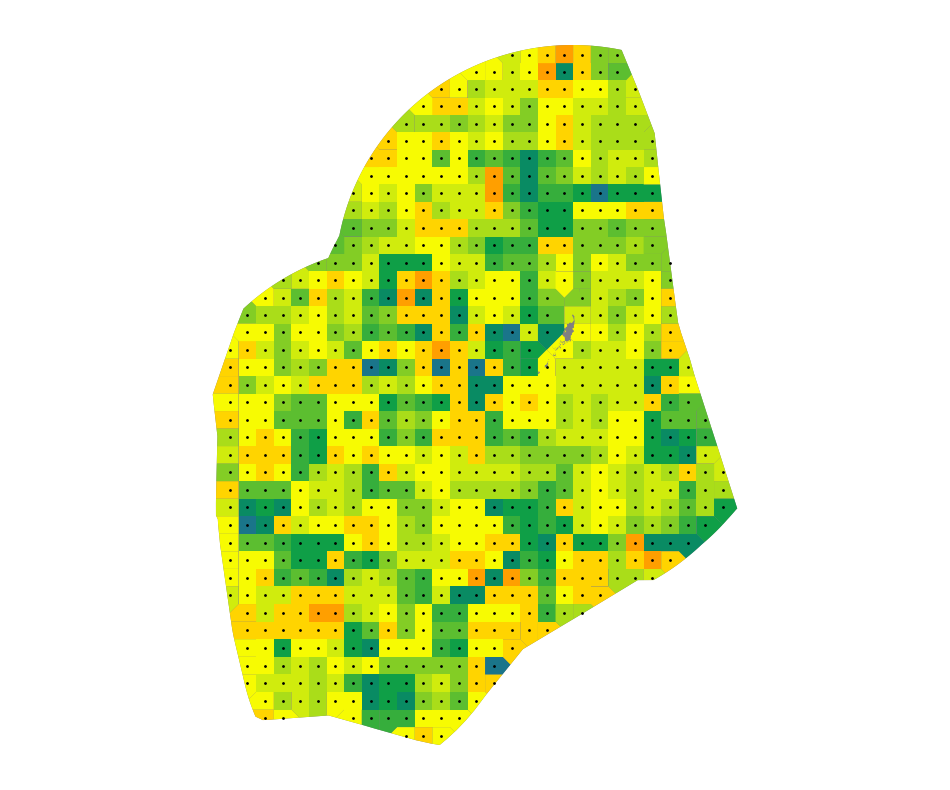

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1957_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


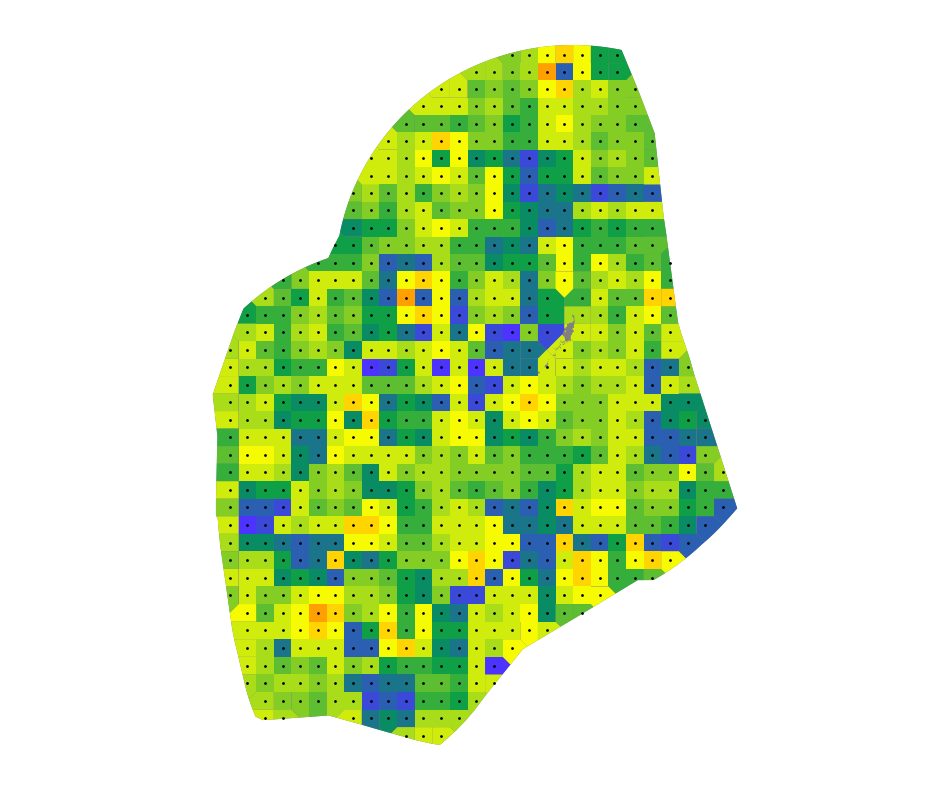

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1958_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


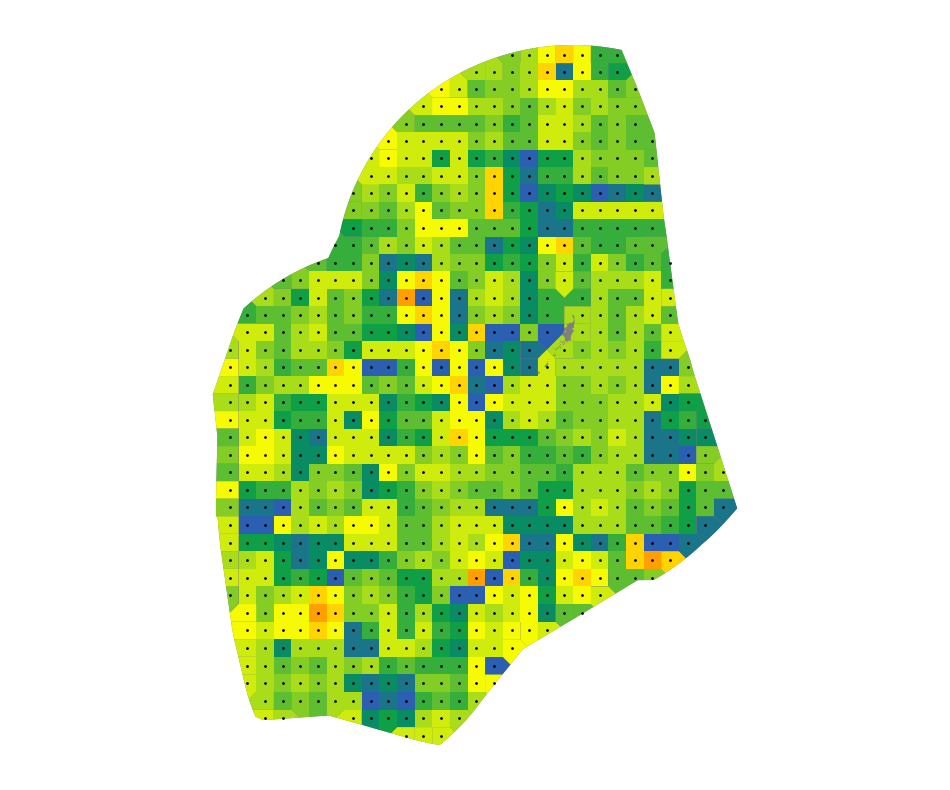

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1959_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


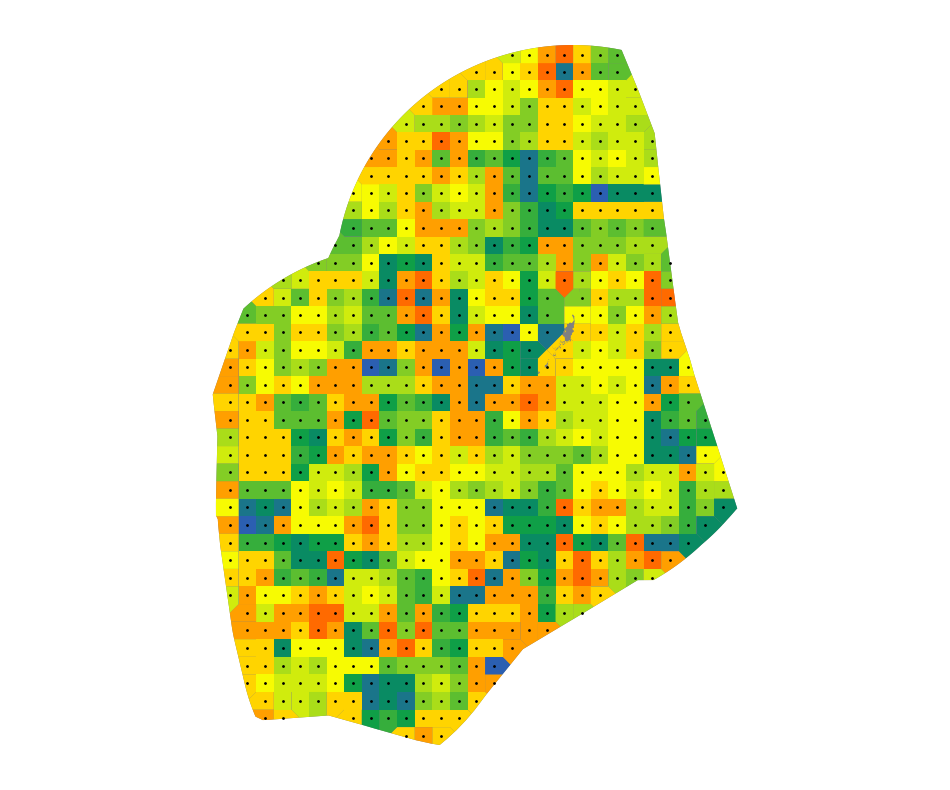

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1960_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


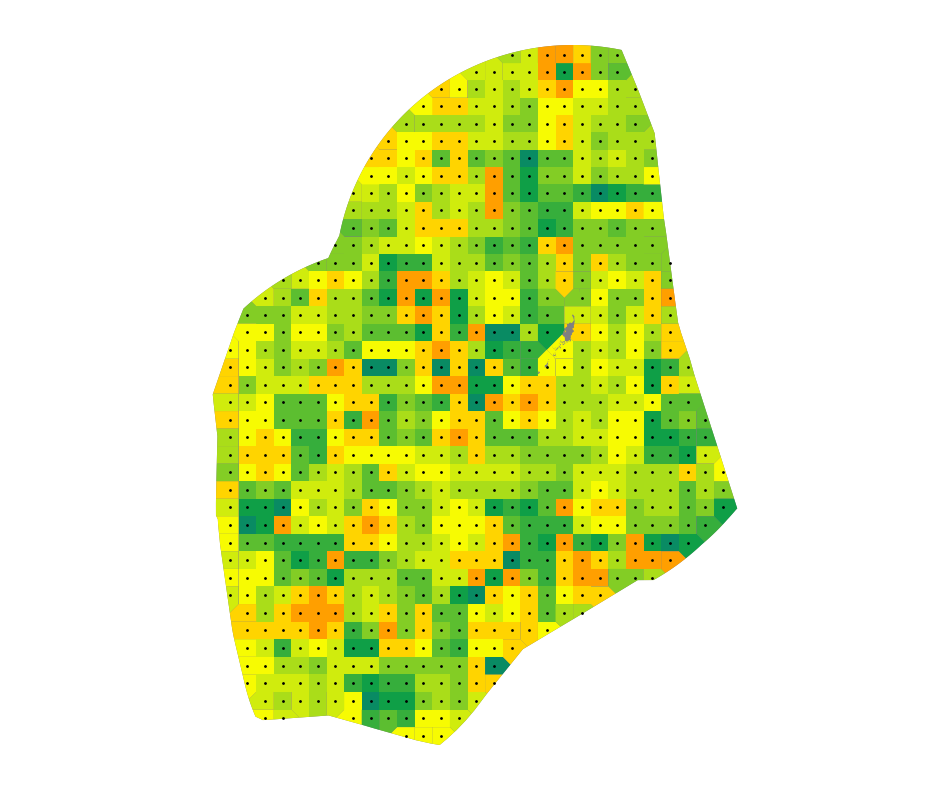

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1961_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


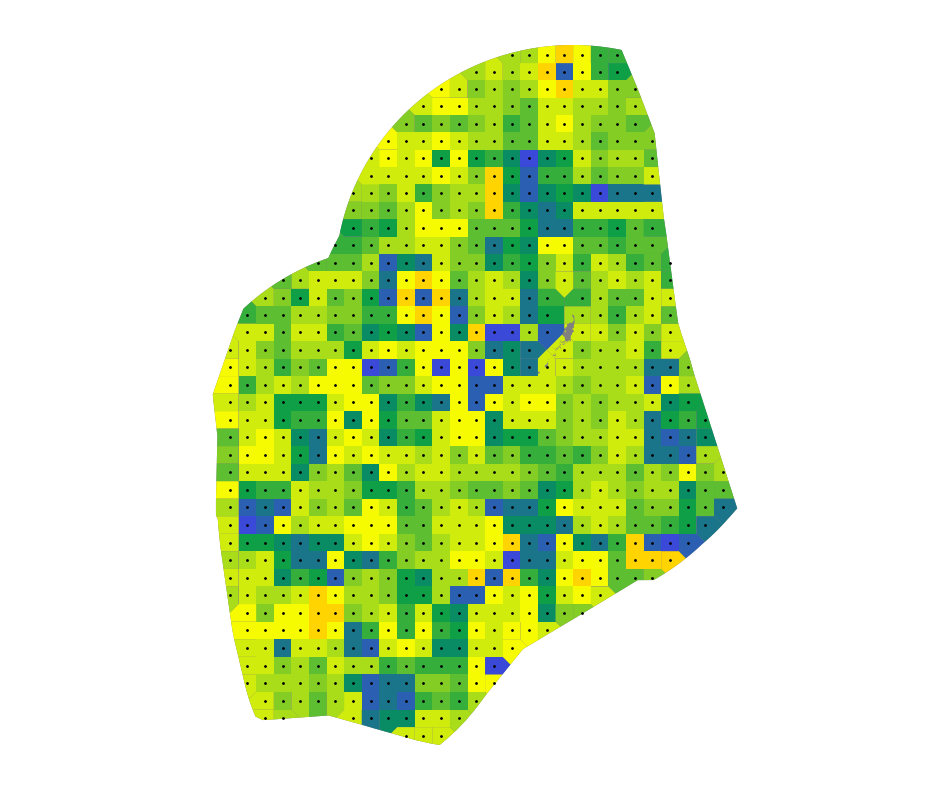

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1962_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


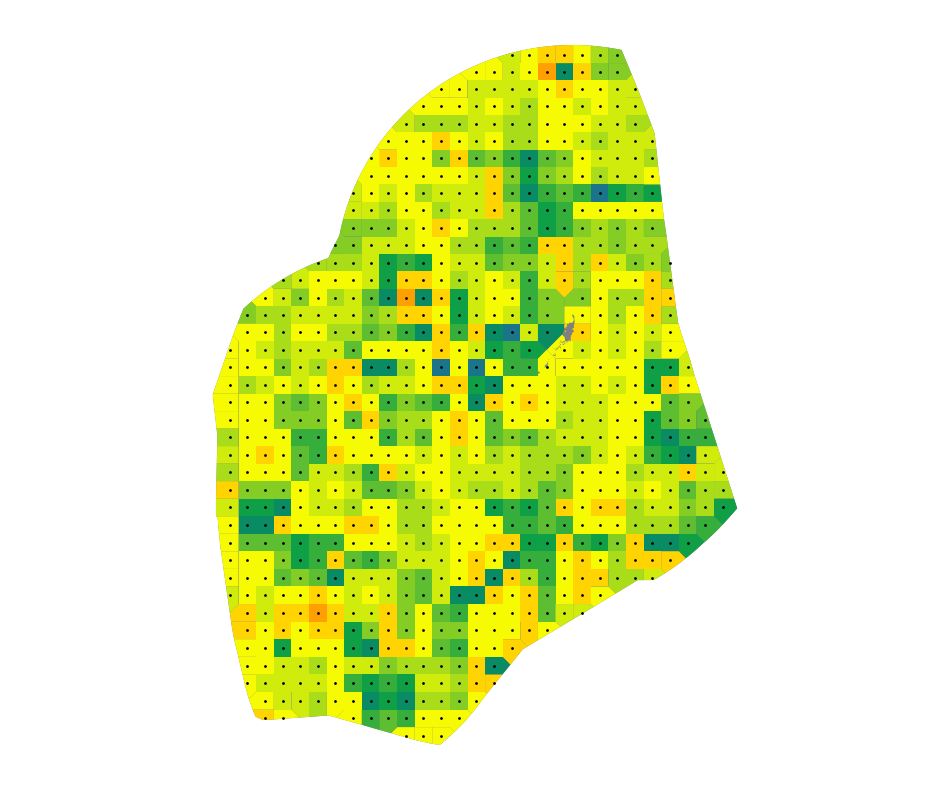

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1963_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


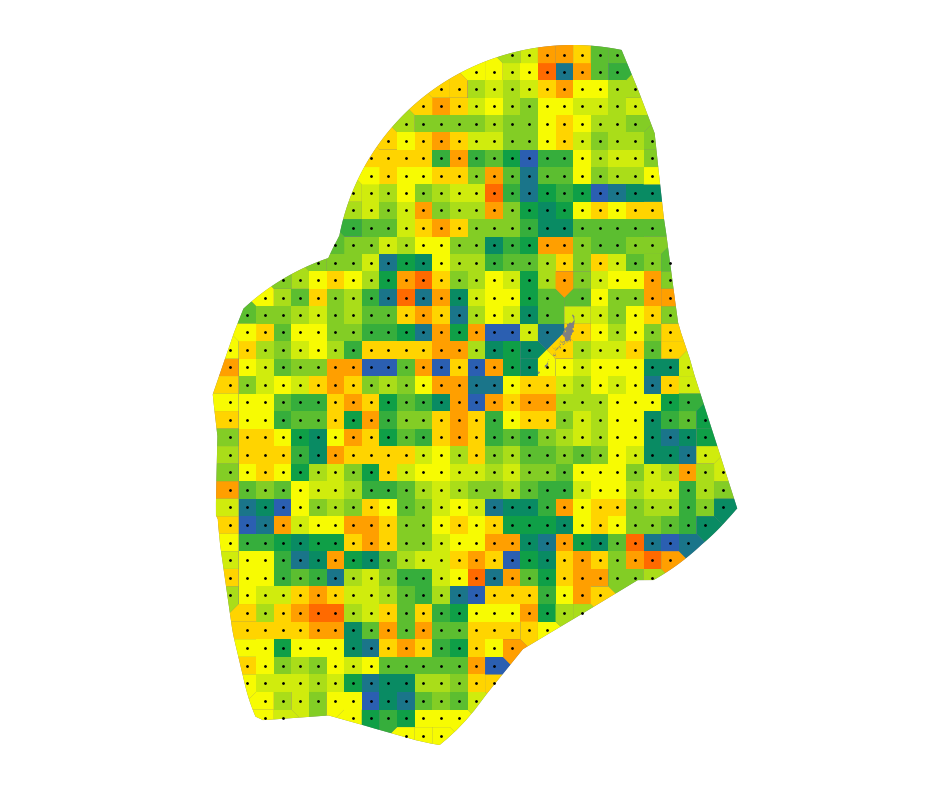

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1964_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


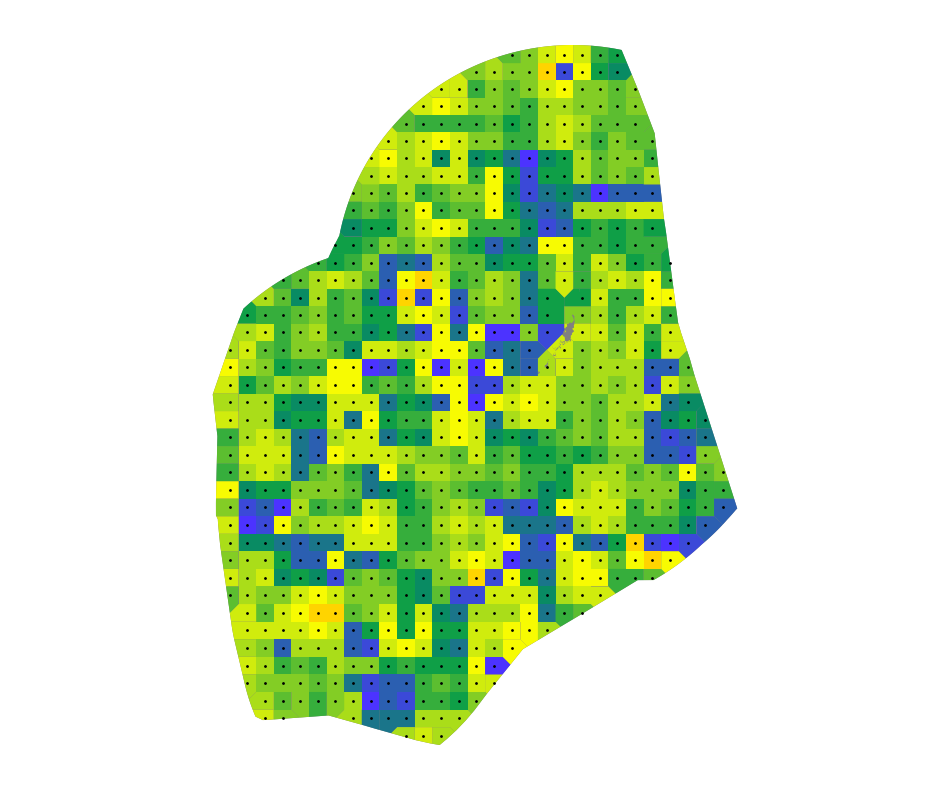

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1965_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


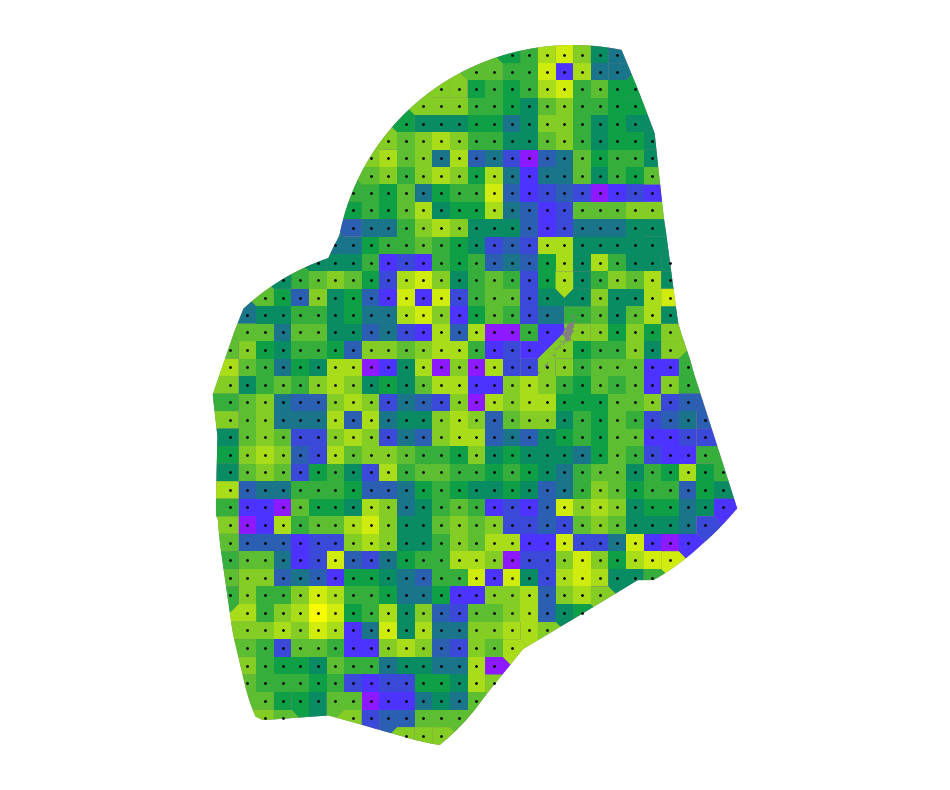

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1966_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


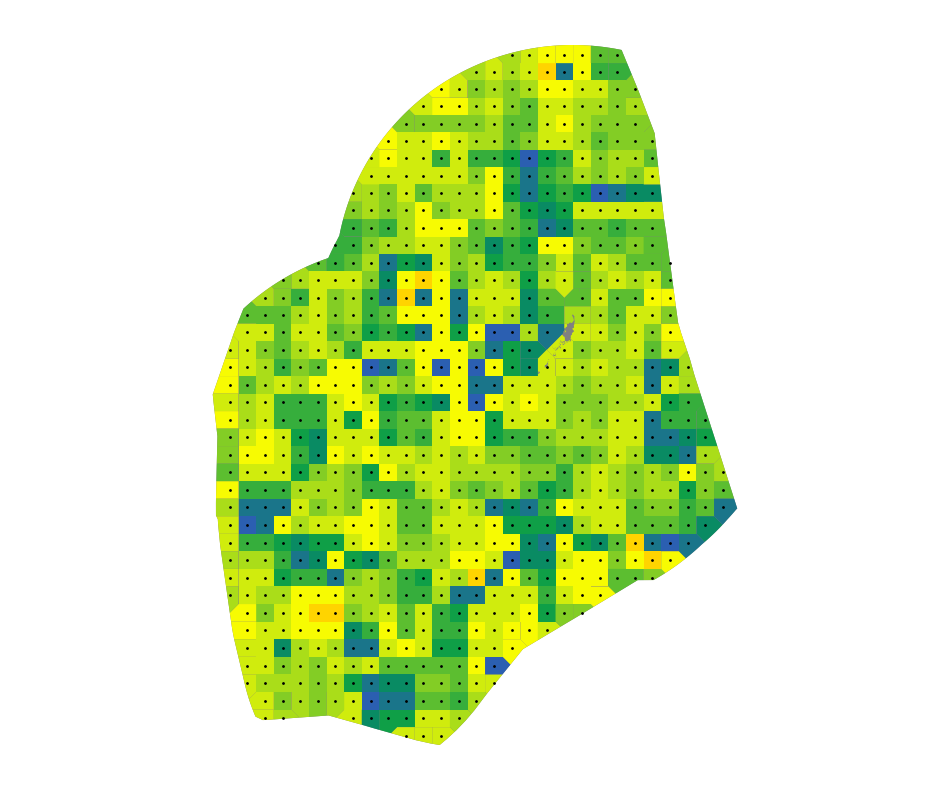

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1967_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


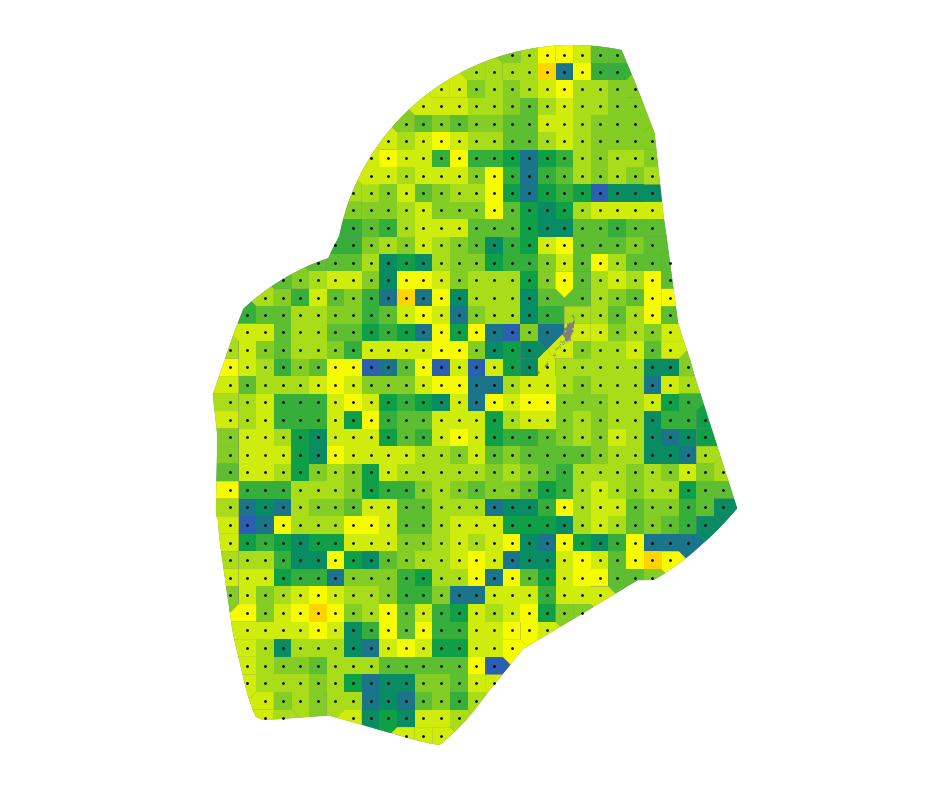

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1968_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


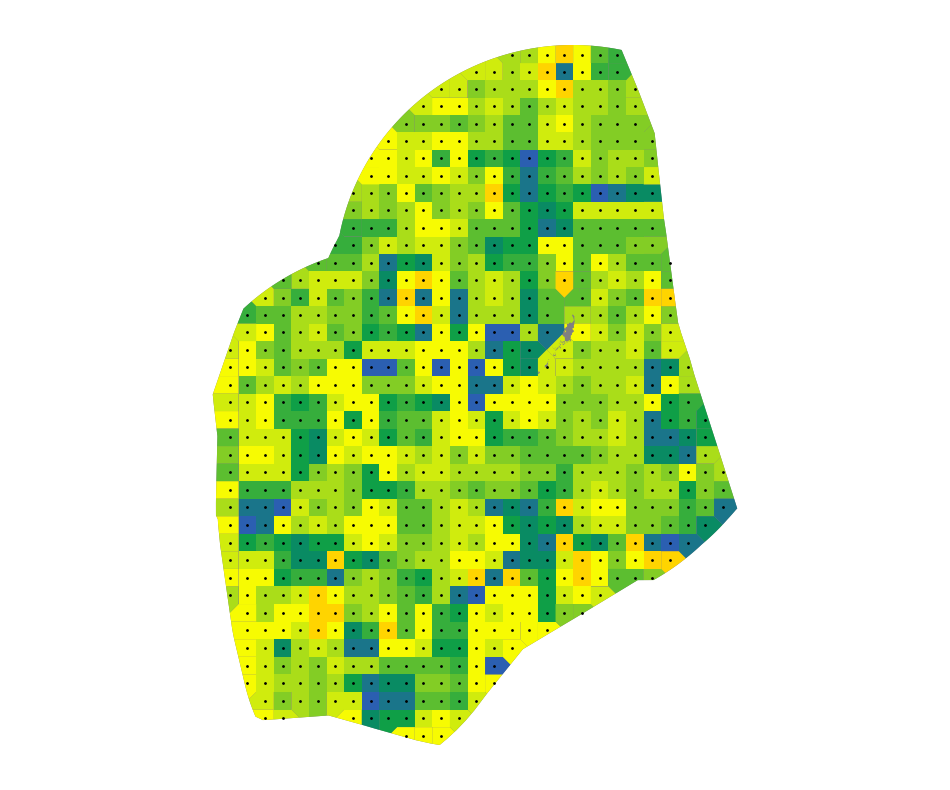

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1969_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


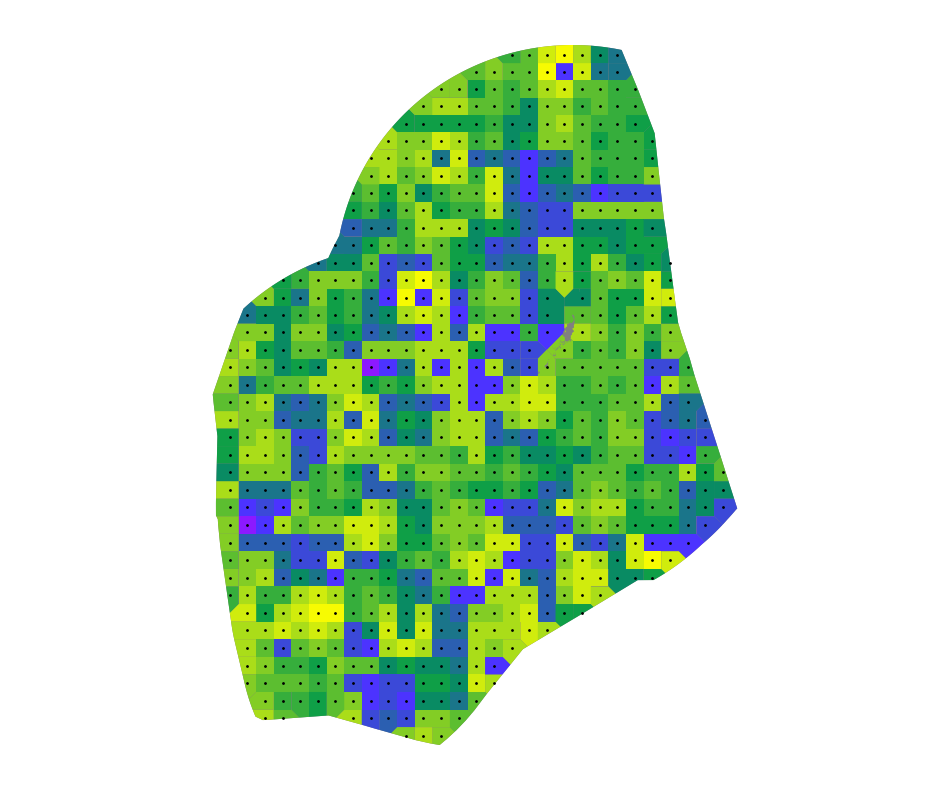

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1970_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


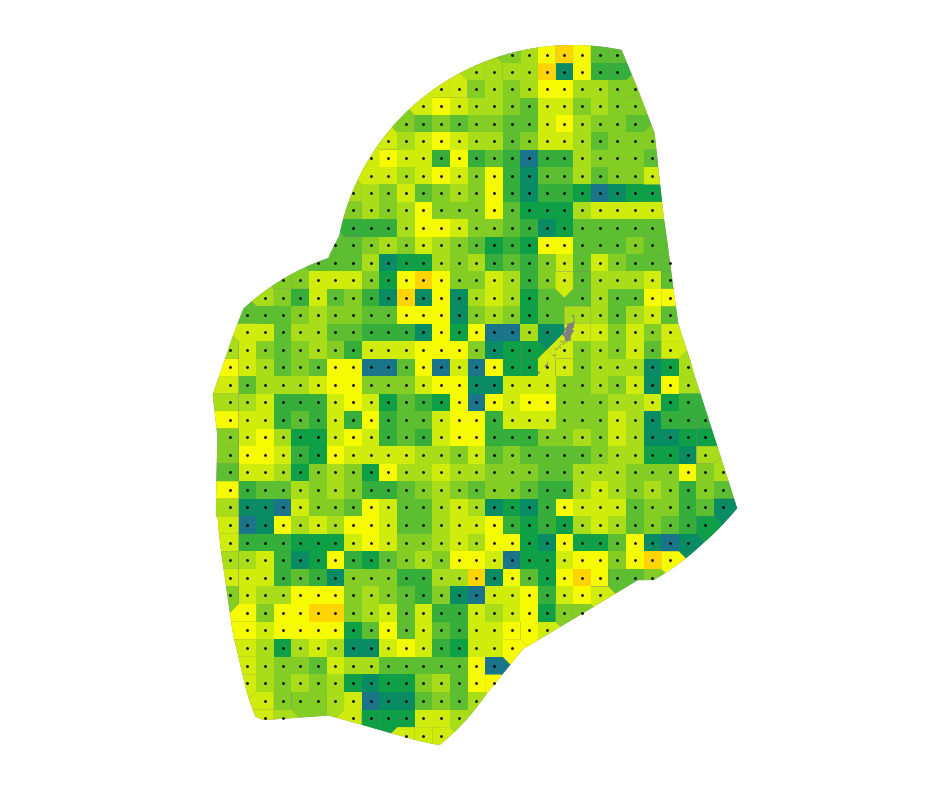

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1971_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


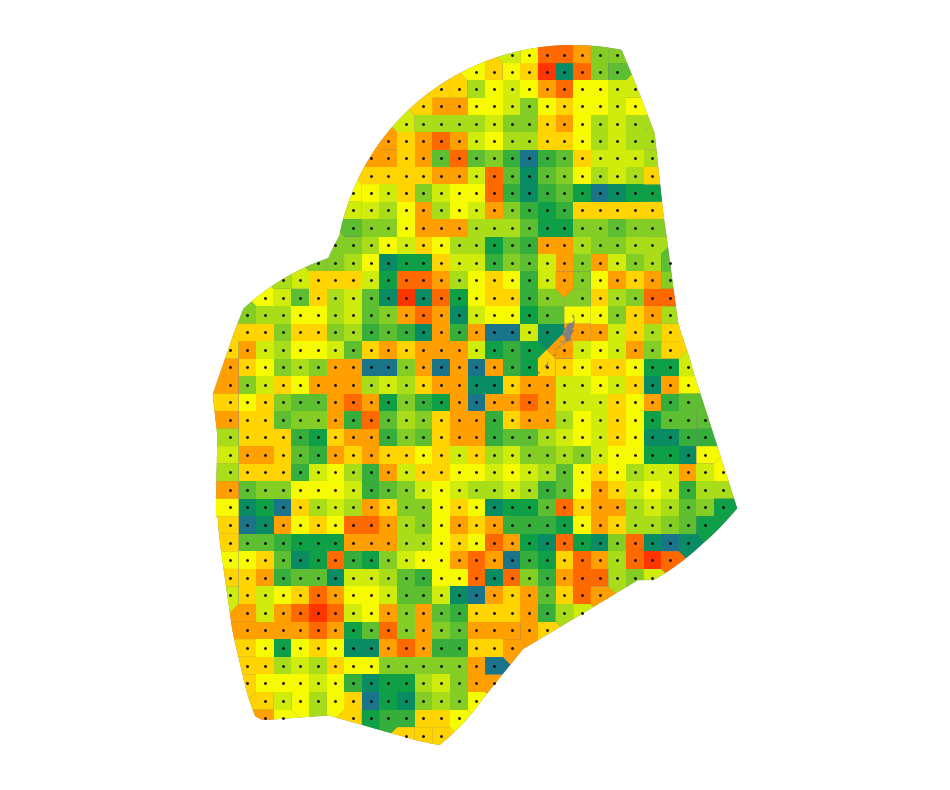

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1972_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


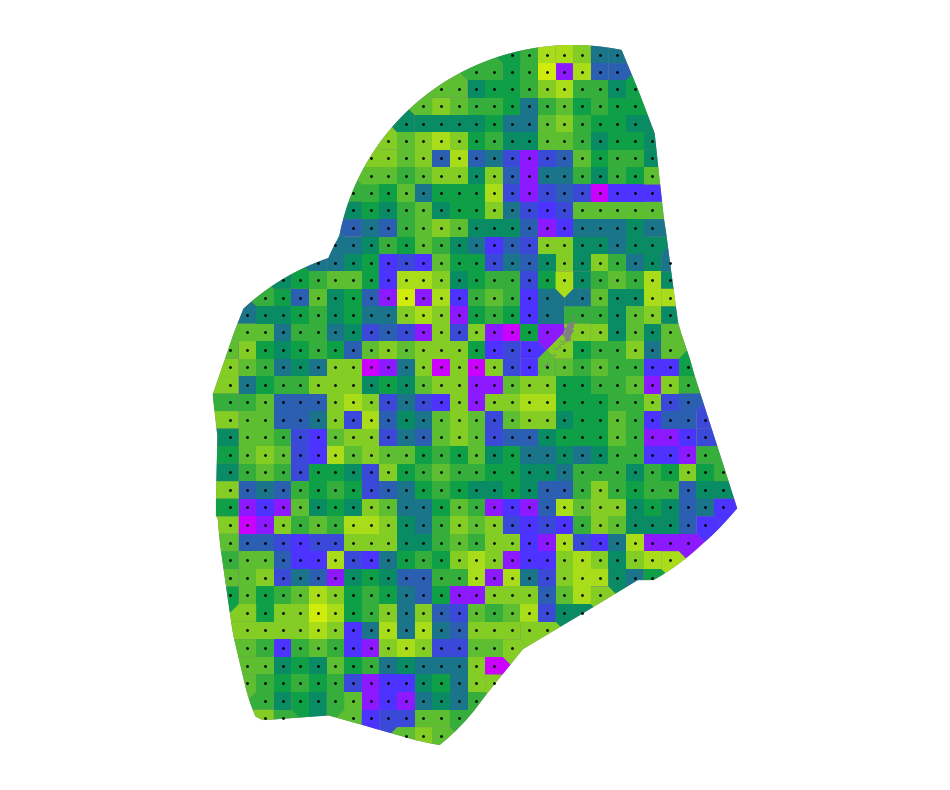

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1973_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


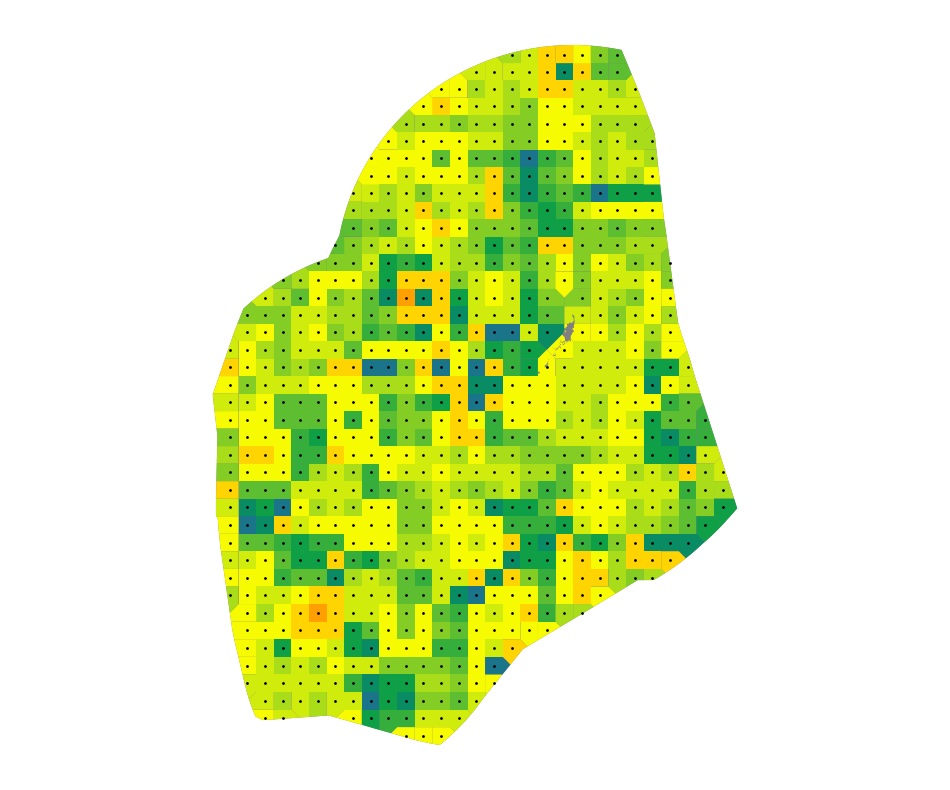

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1974_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


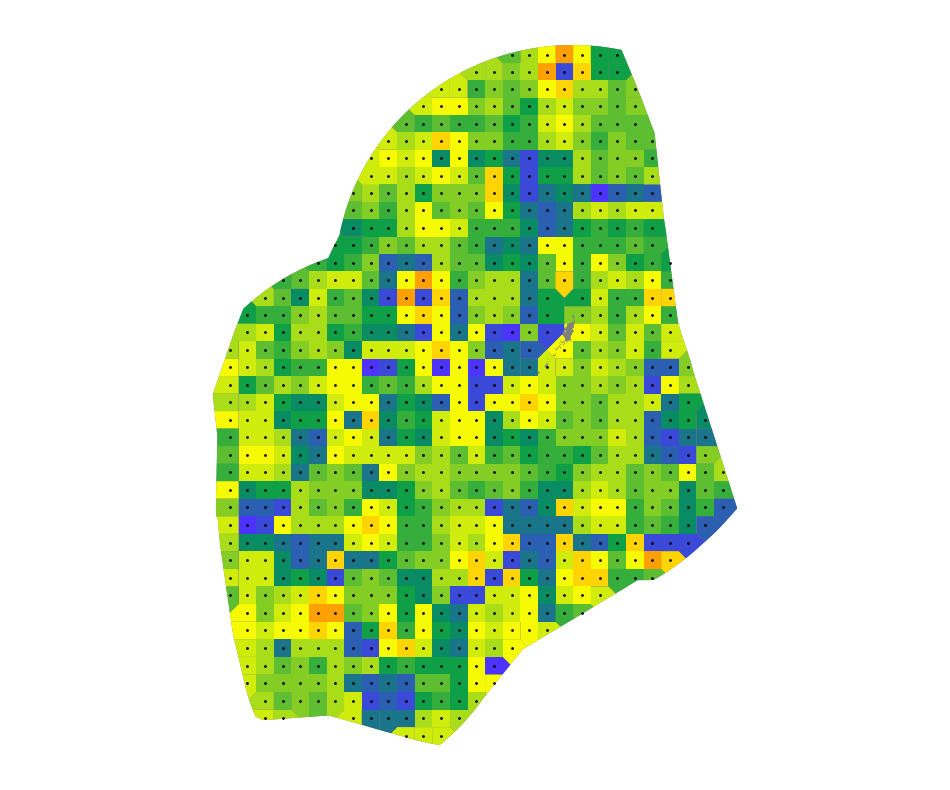

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1975_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


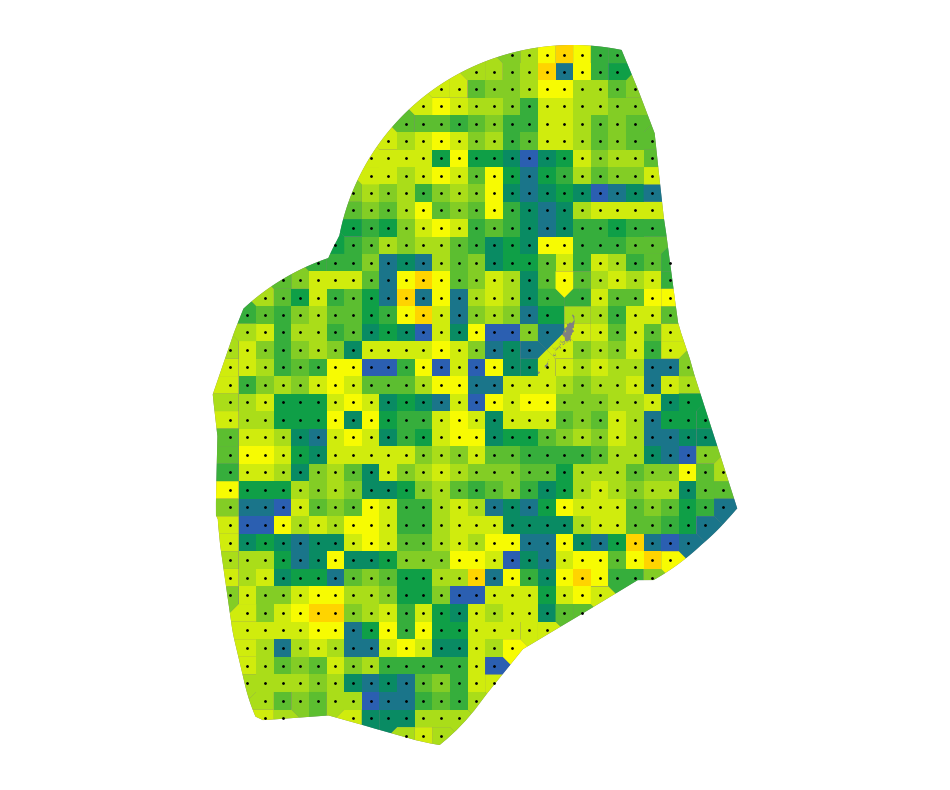

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1976_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


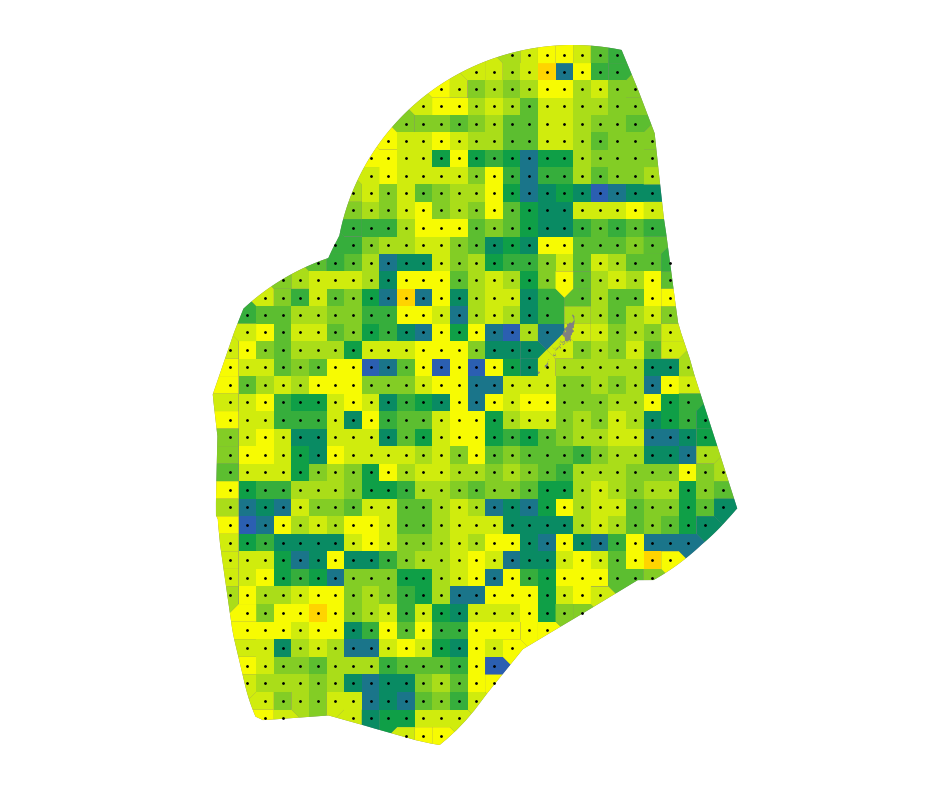

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1977_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


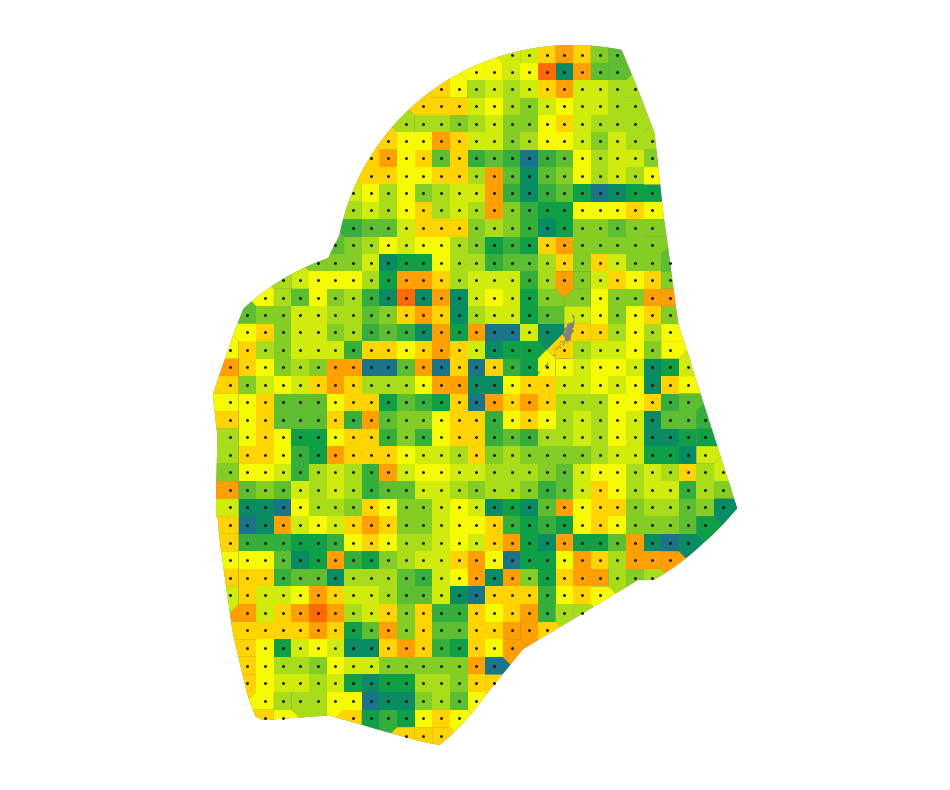

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1978_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


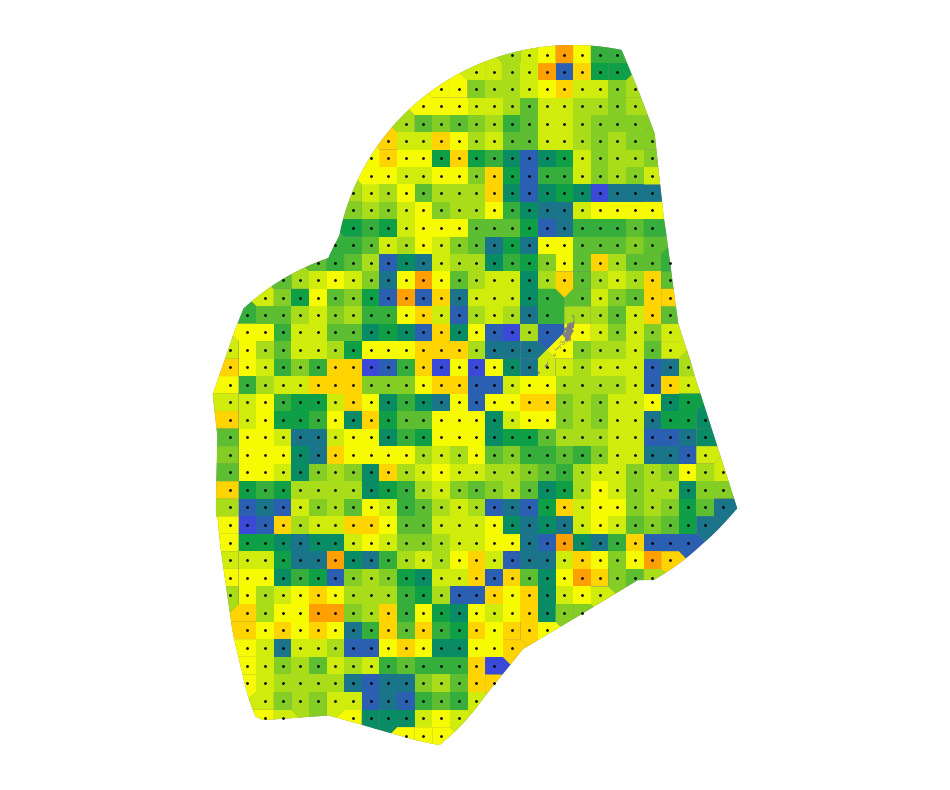

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1979_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


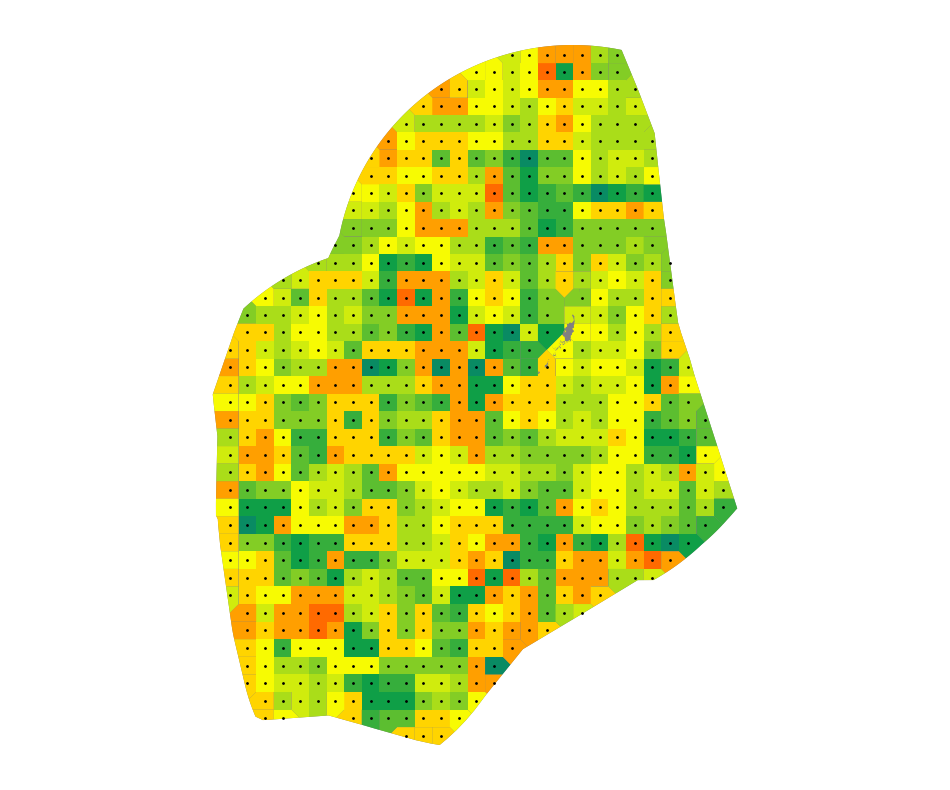

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1980_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


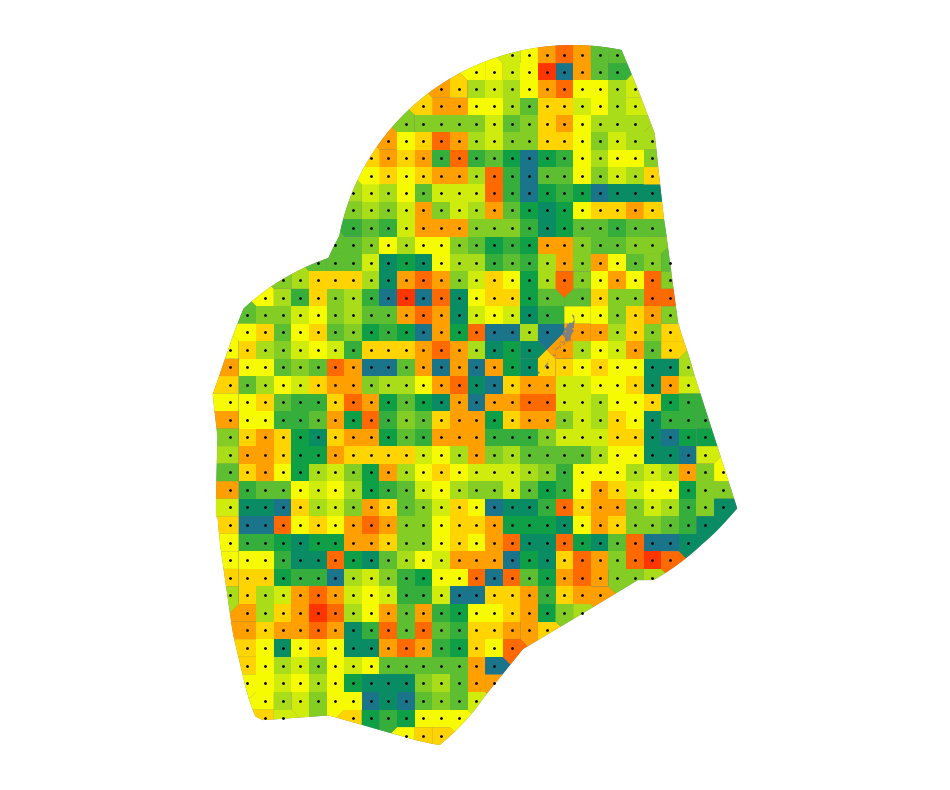

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1981_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


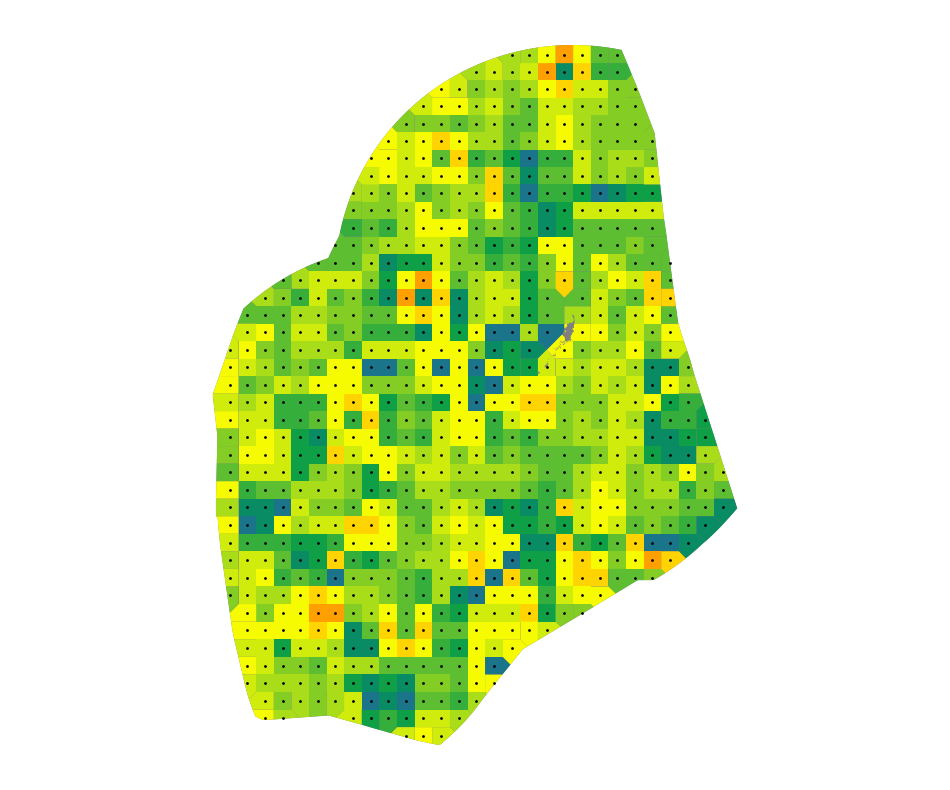

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1982_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


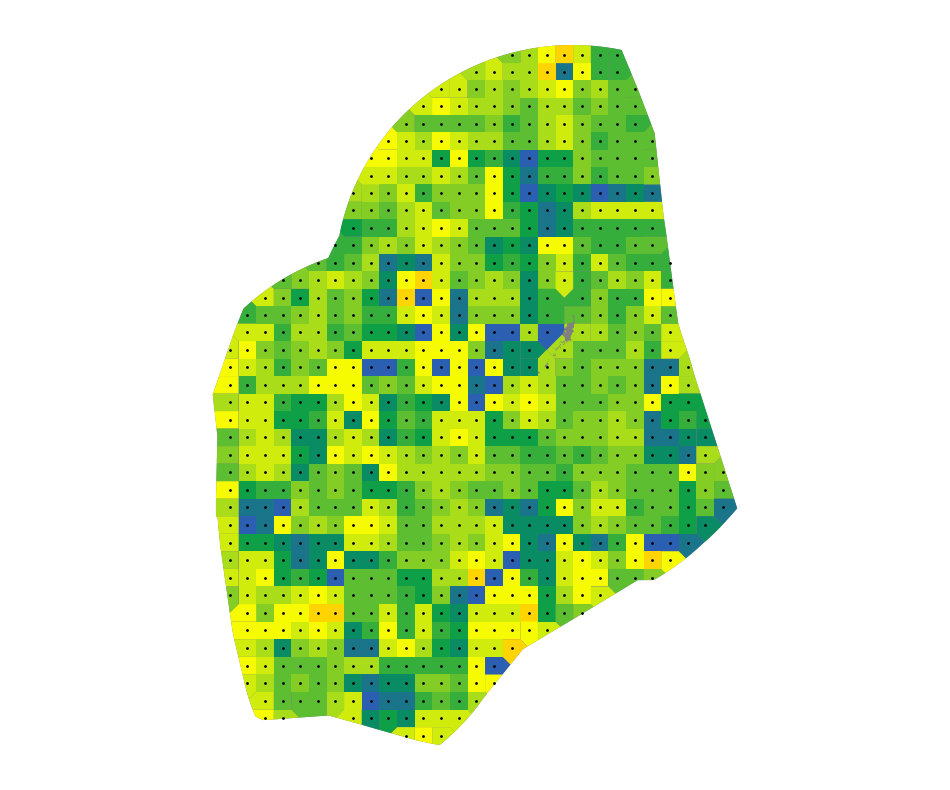

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1983_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


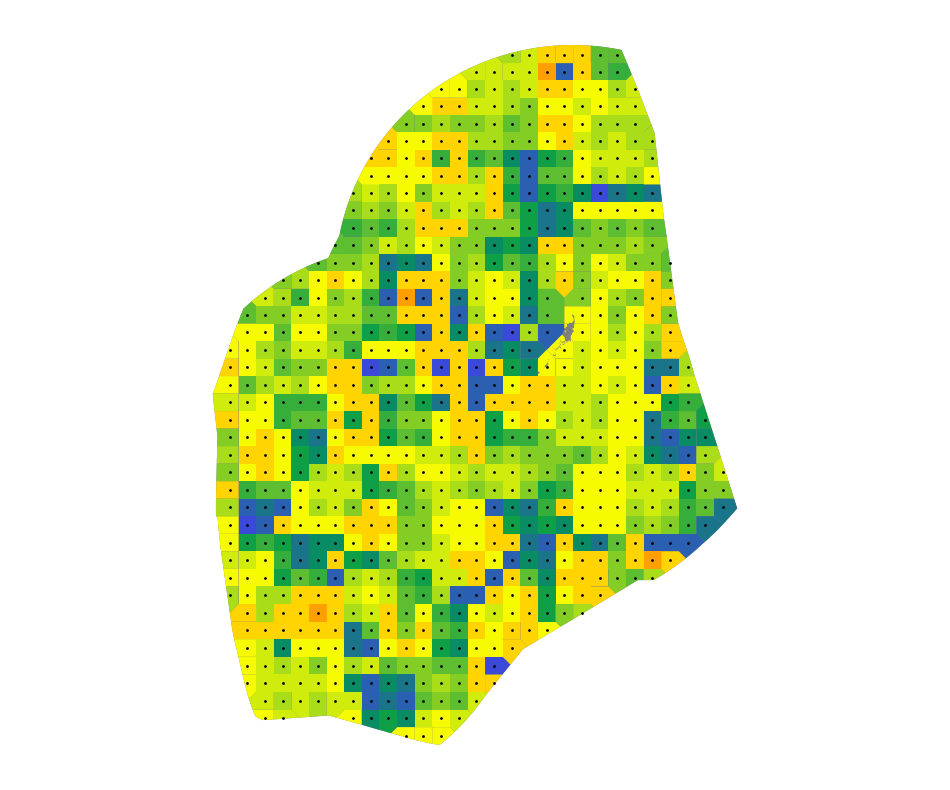

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1984_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


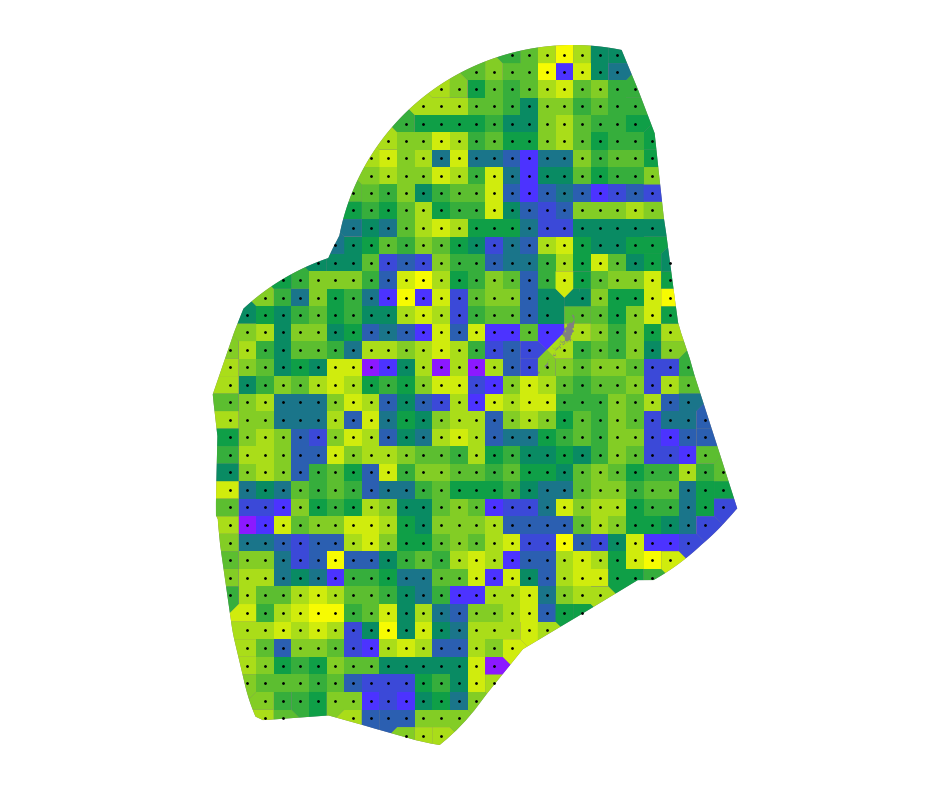

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1985_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


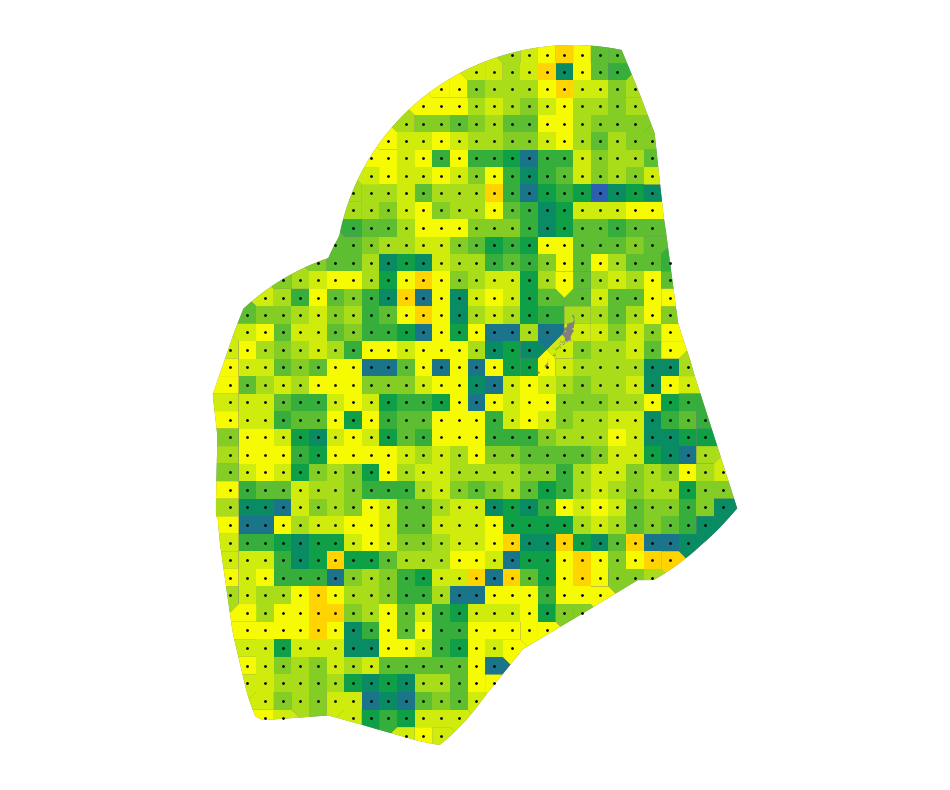

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1986_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


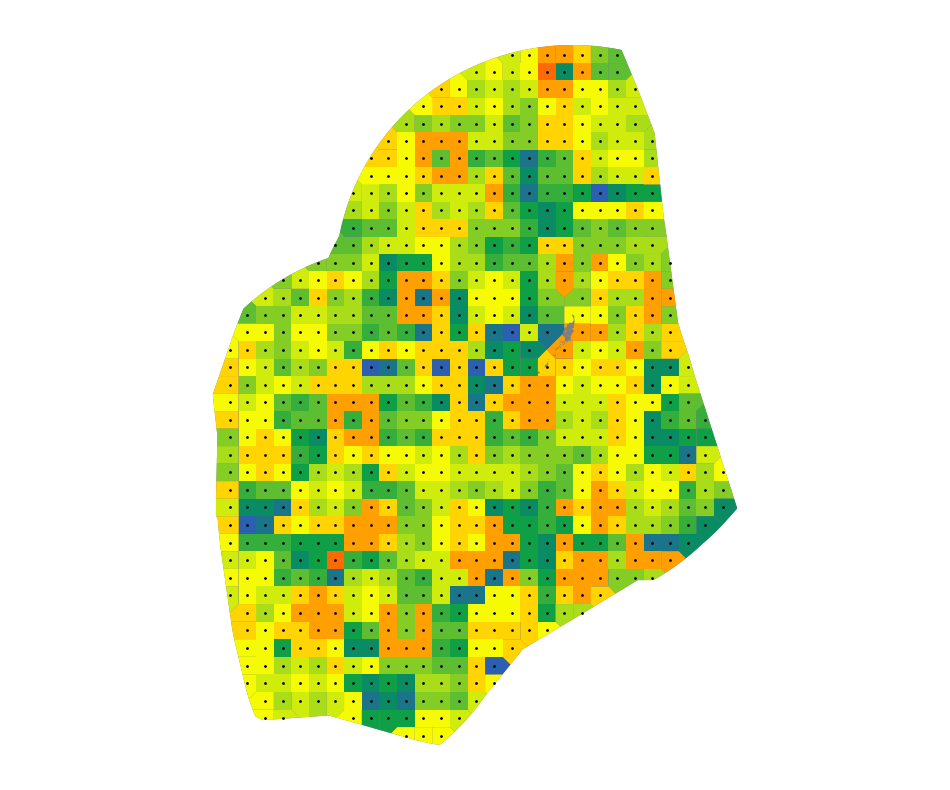

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1987_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


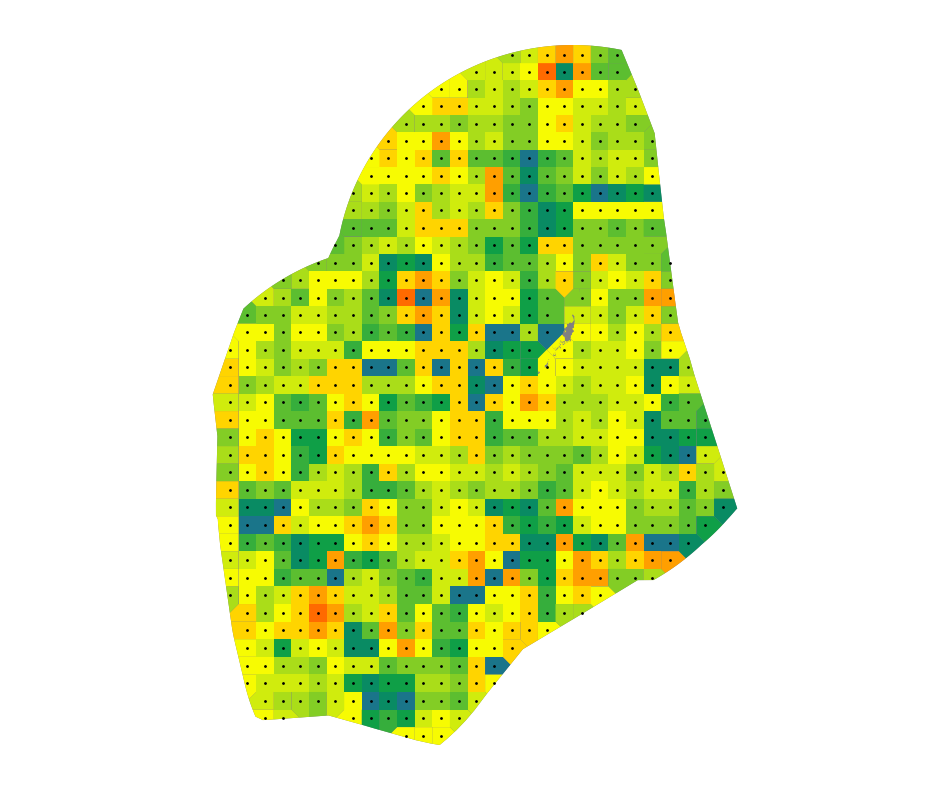

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1988_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


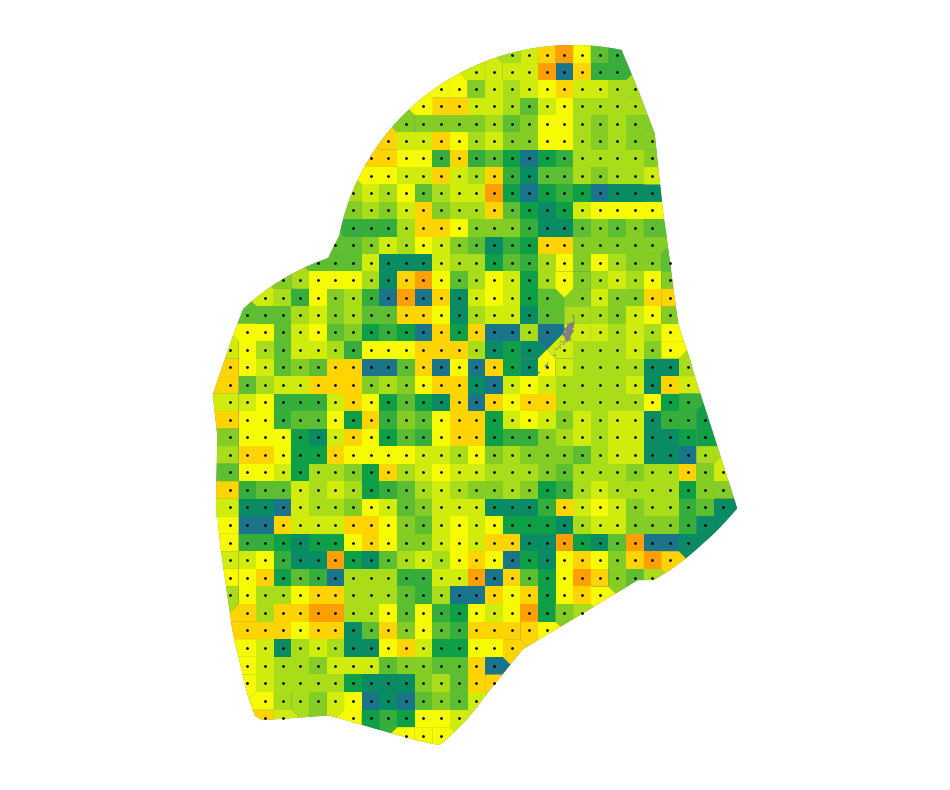

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1989_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


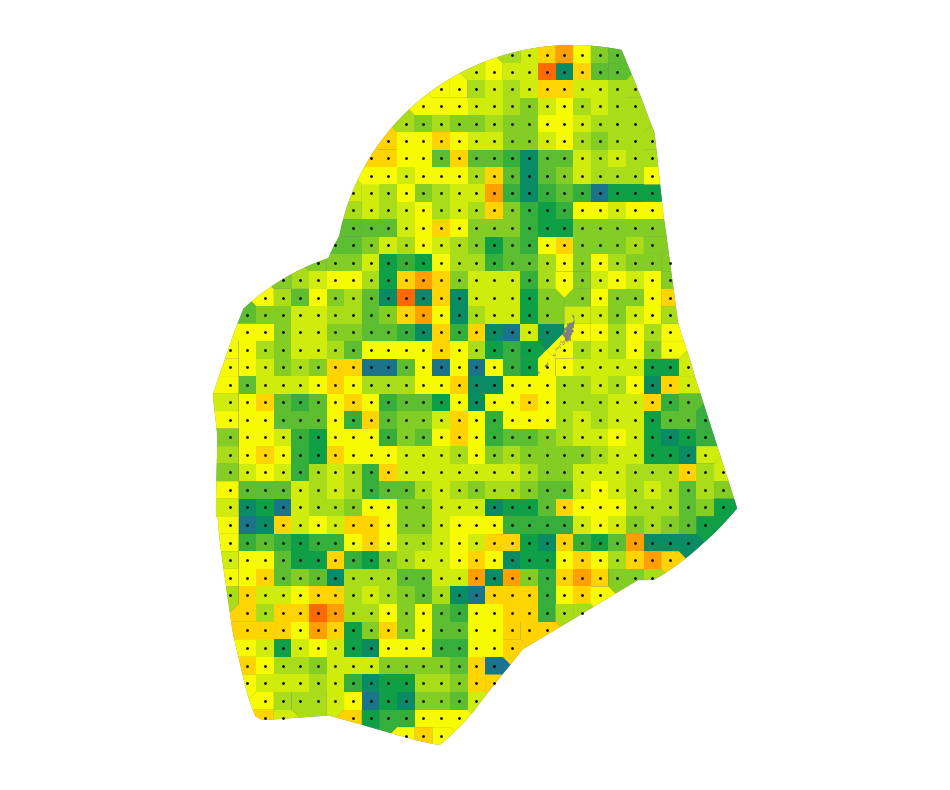

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1990_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


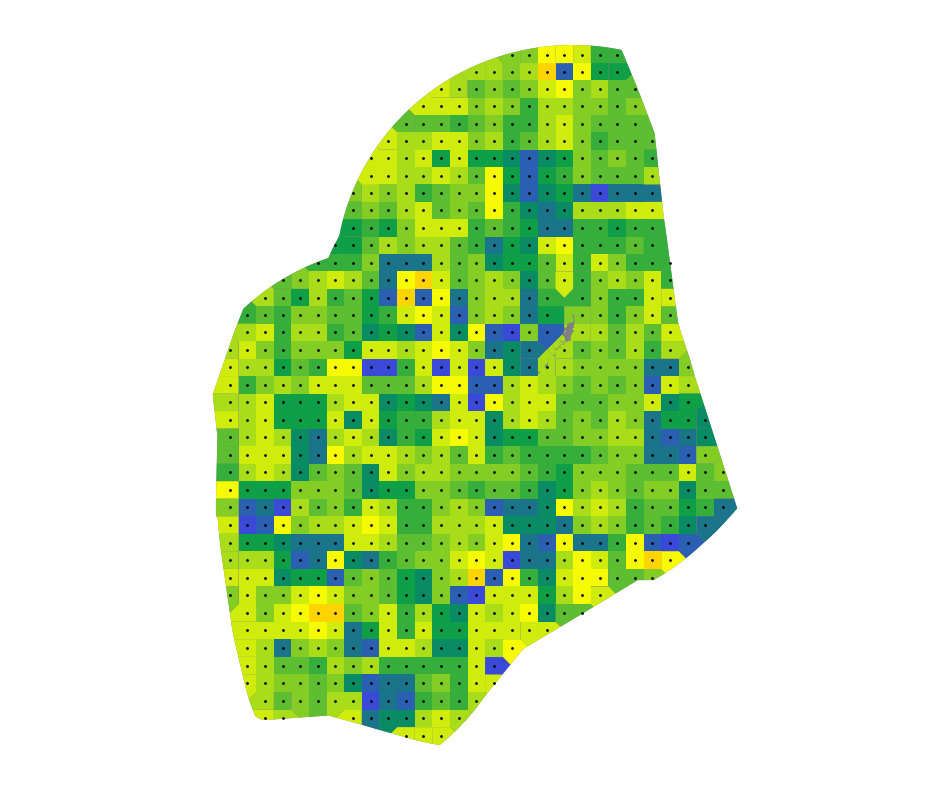

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1991_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


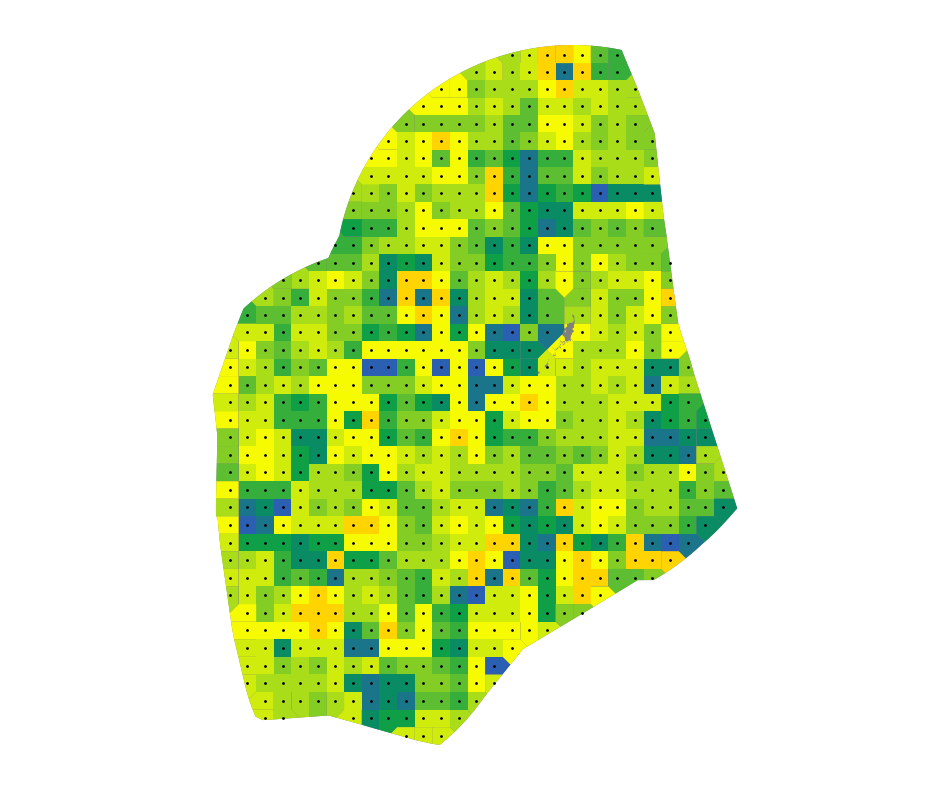

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1992_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


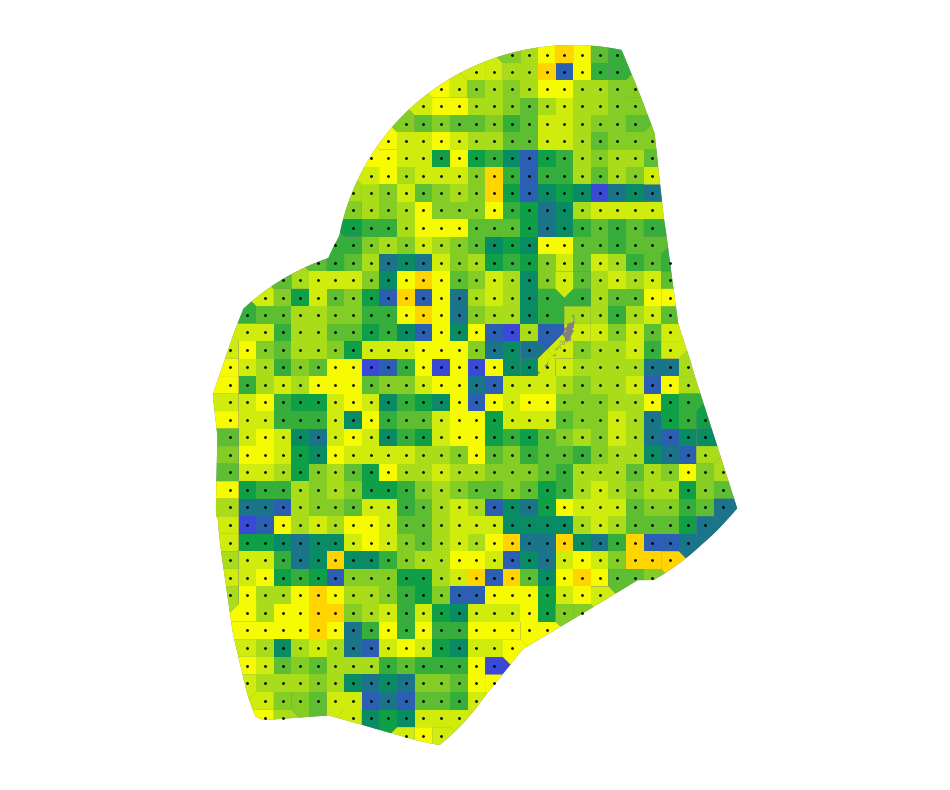

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1993_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


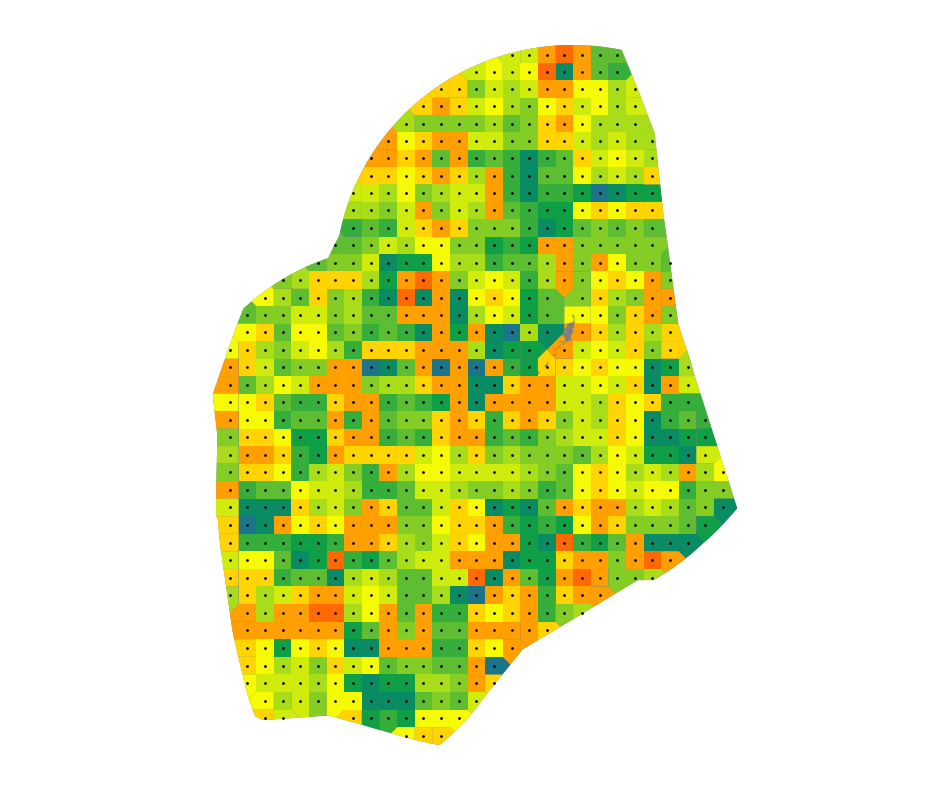

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1994_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


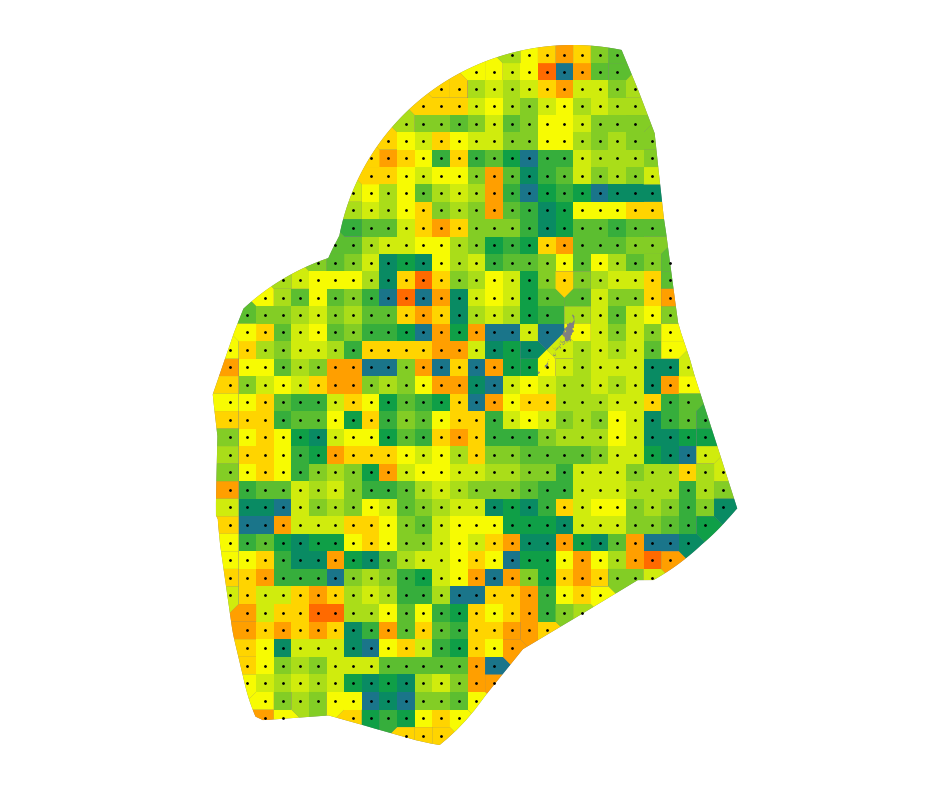

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1995_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


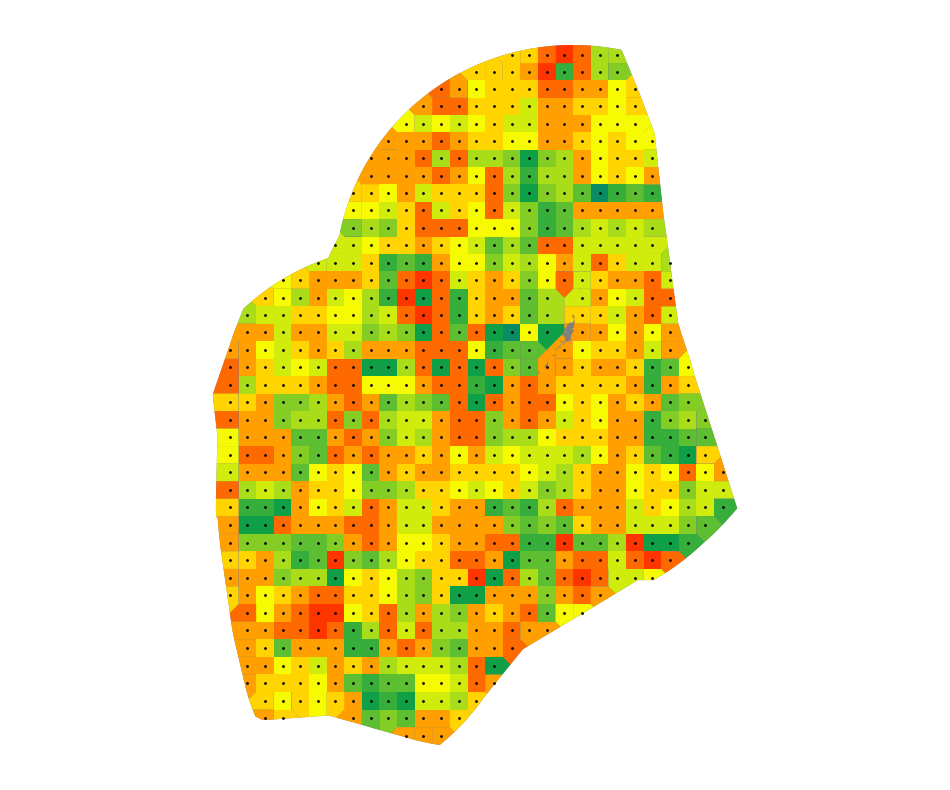

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1996_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


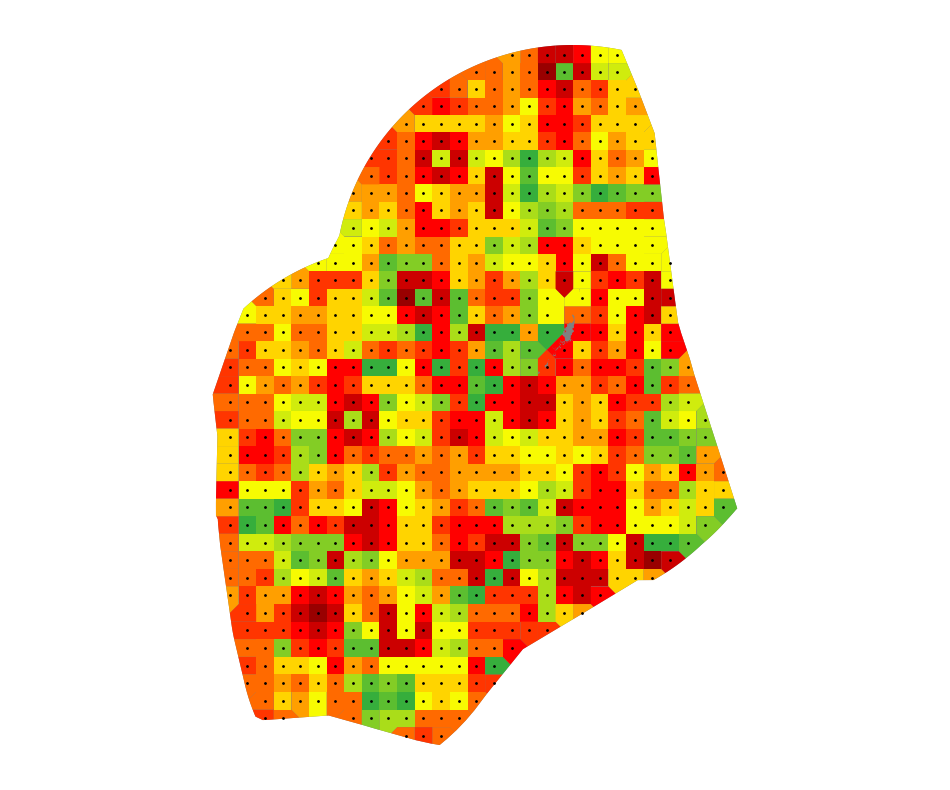

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1997_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


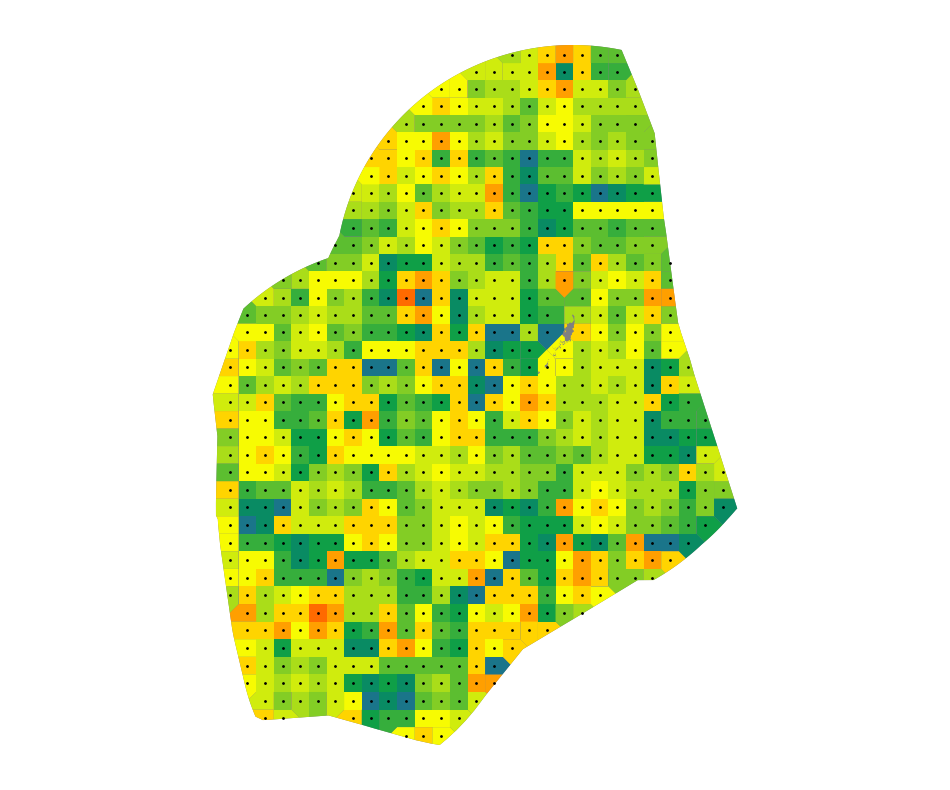

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1998_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


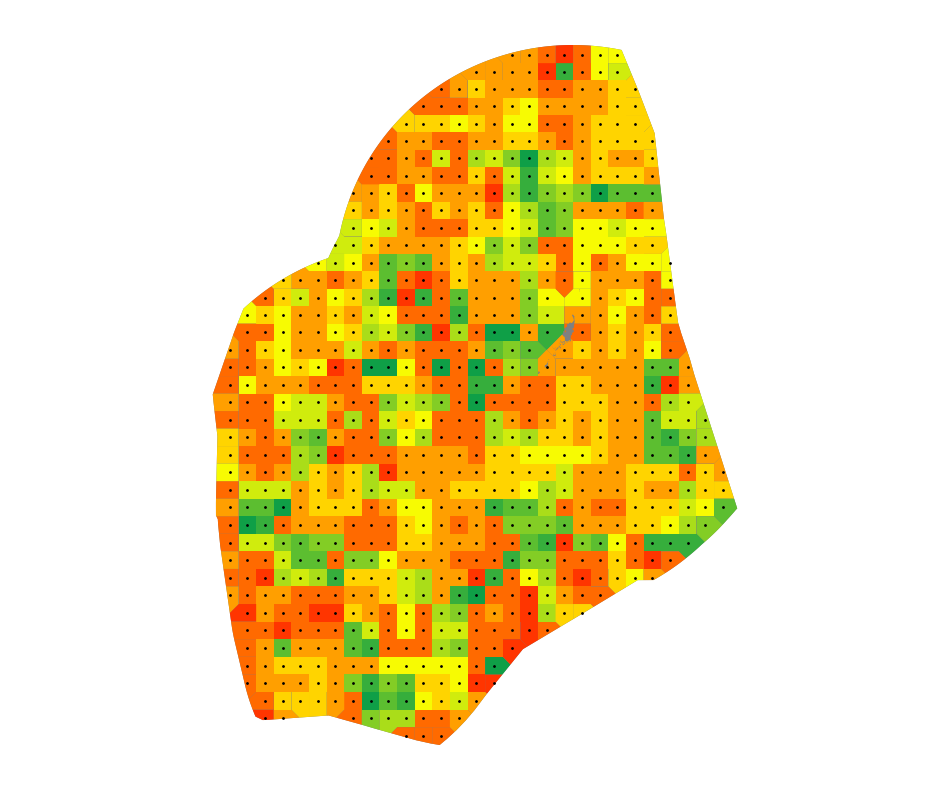

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/1999_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


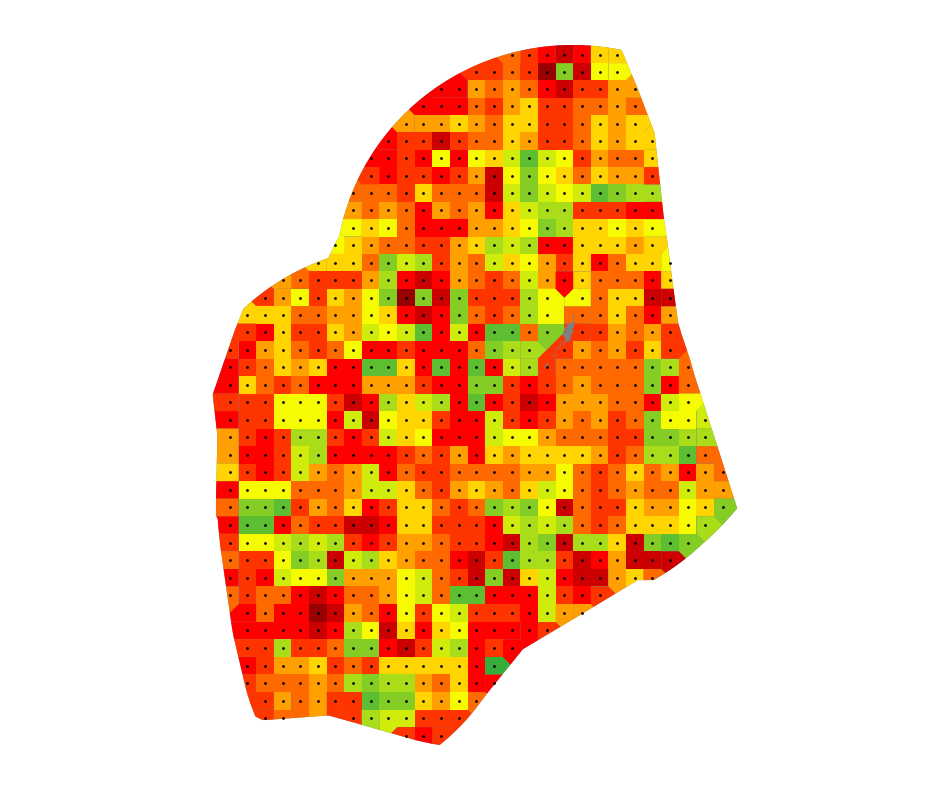

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/2000_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


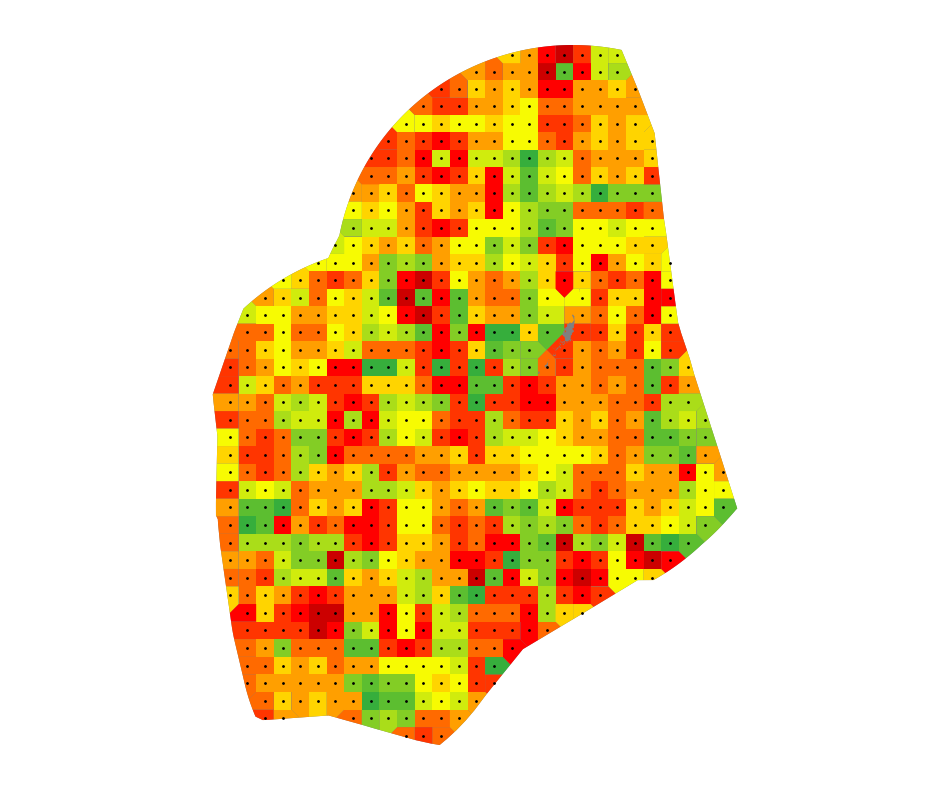

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/2001_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


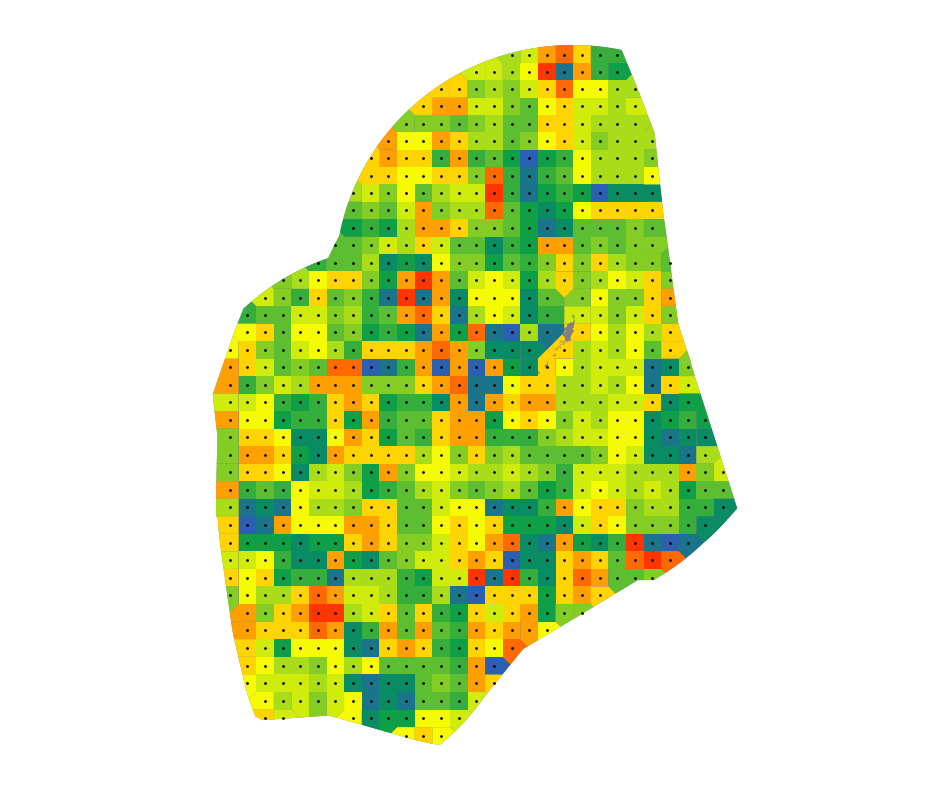

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/2002_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


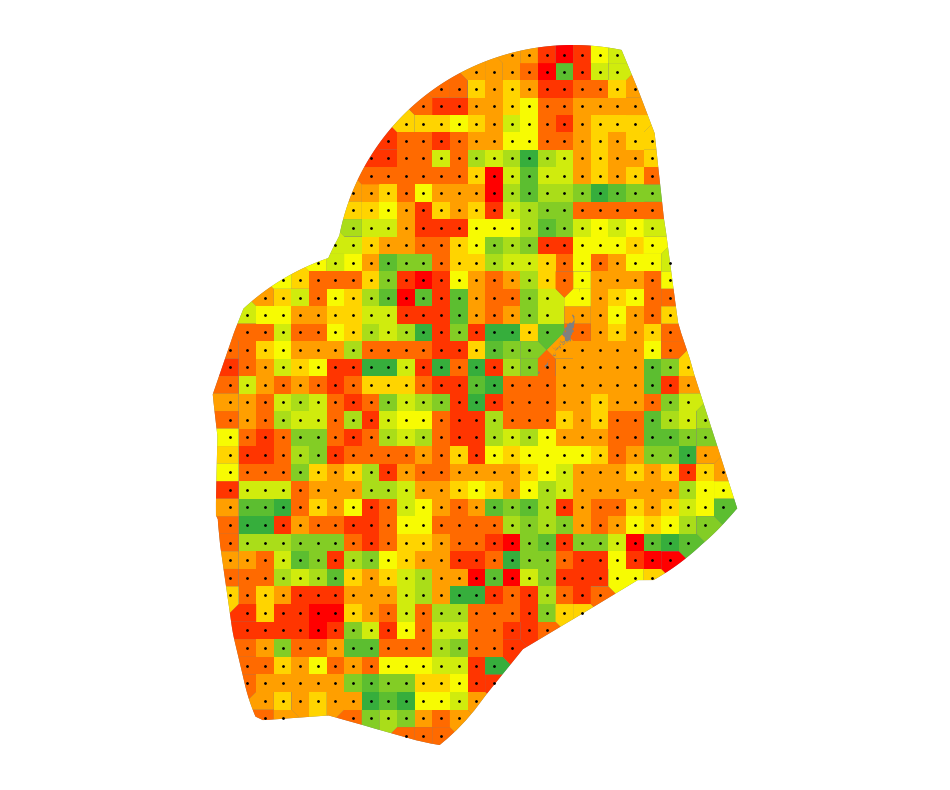

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/2003_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


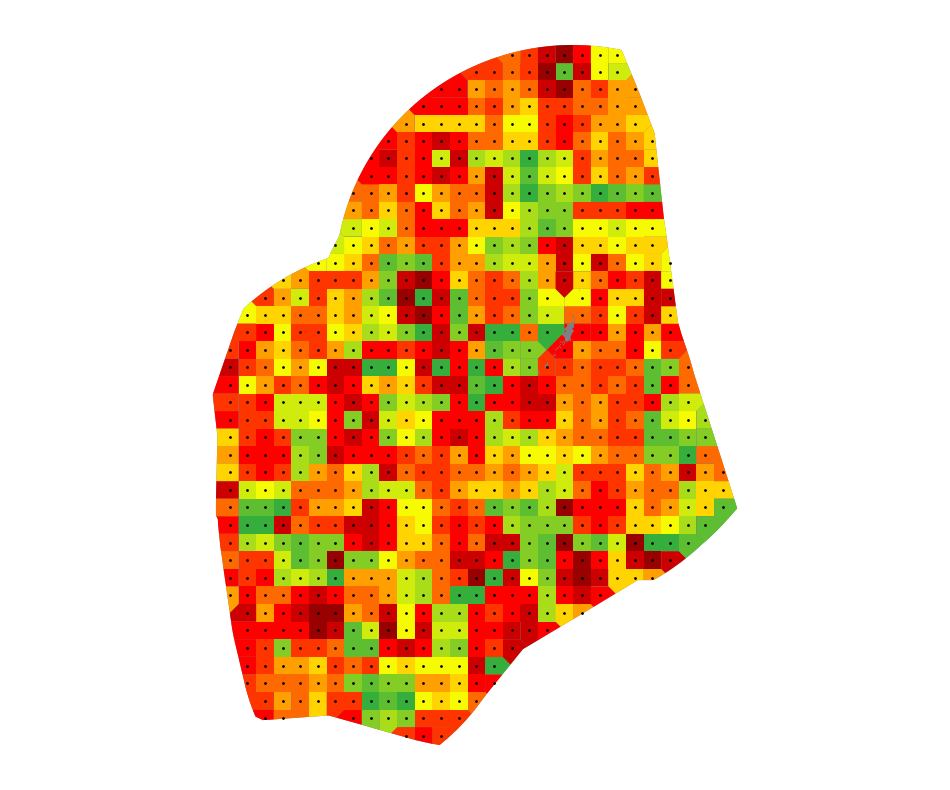

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/2004_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


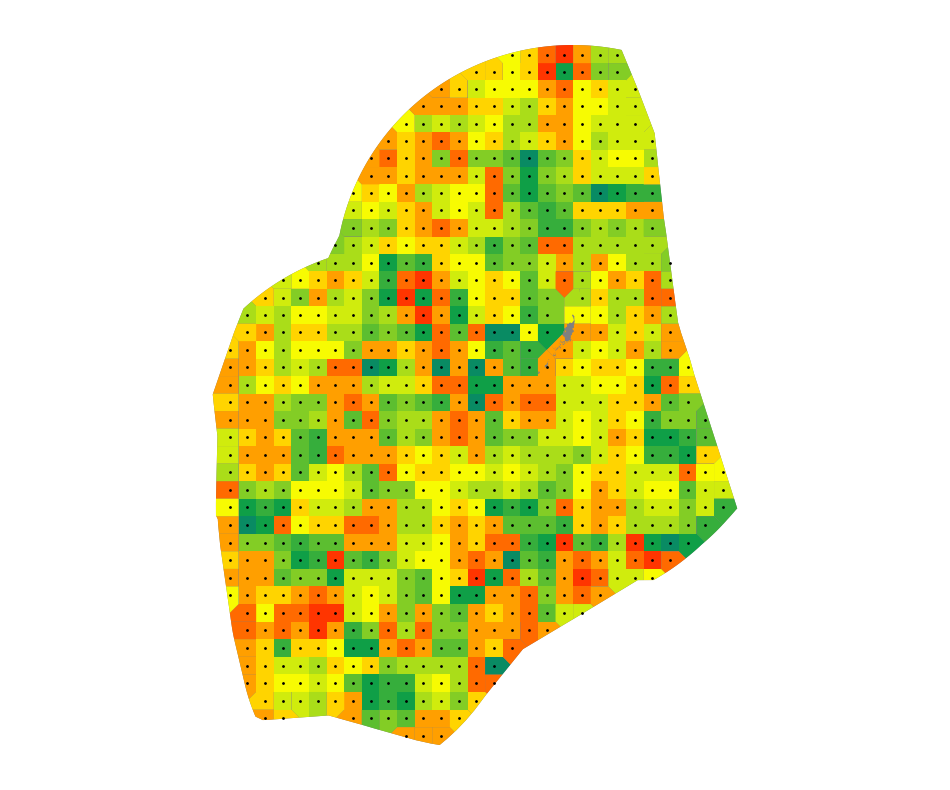

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/2005_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


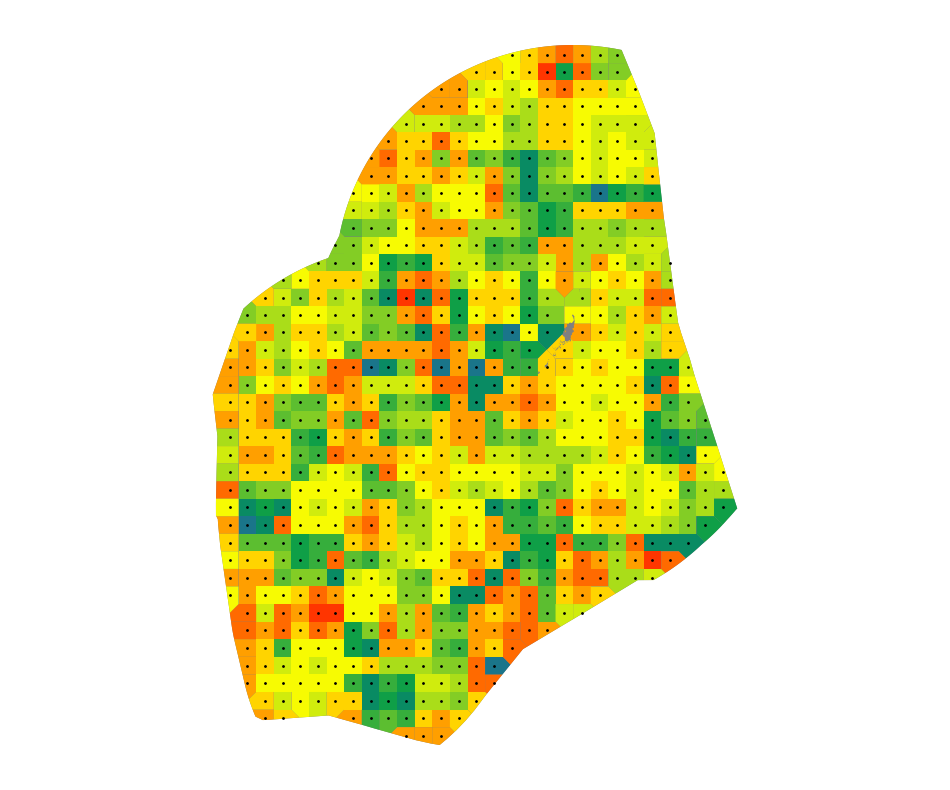

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/2006_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


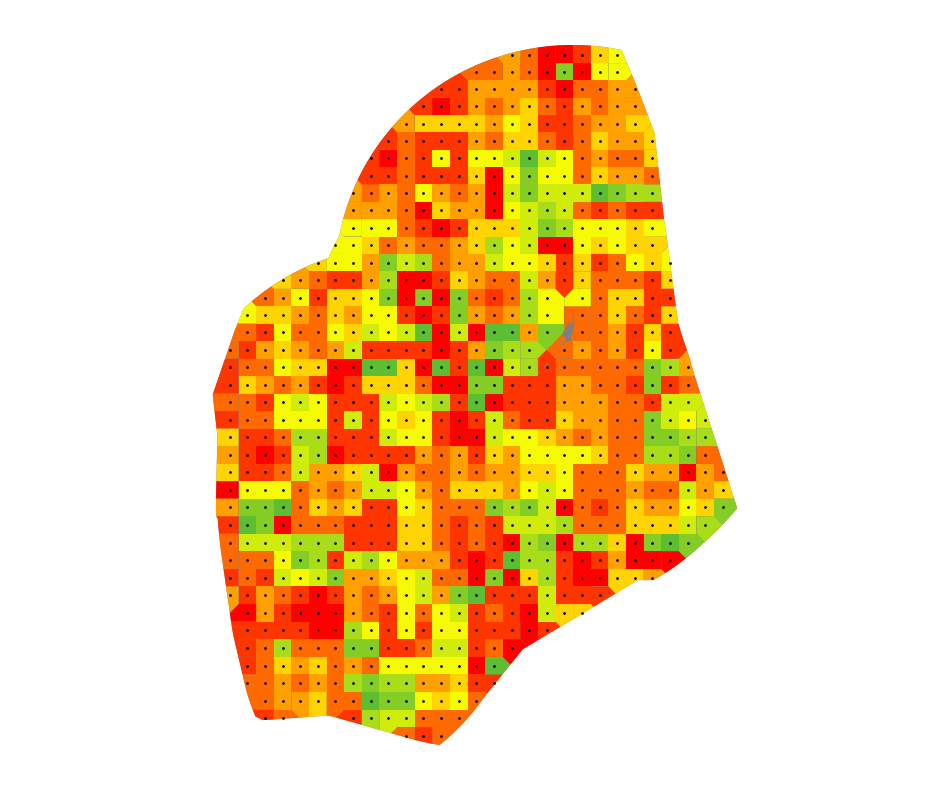

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/2007_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


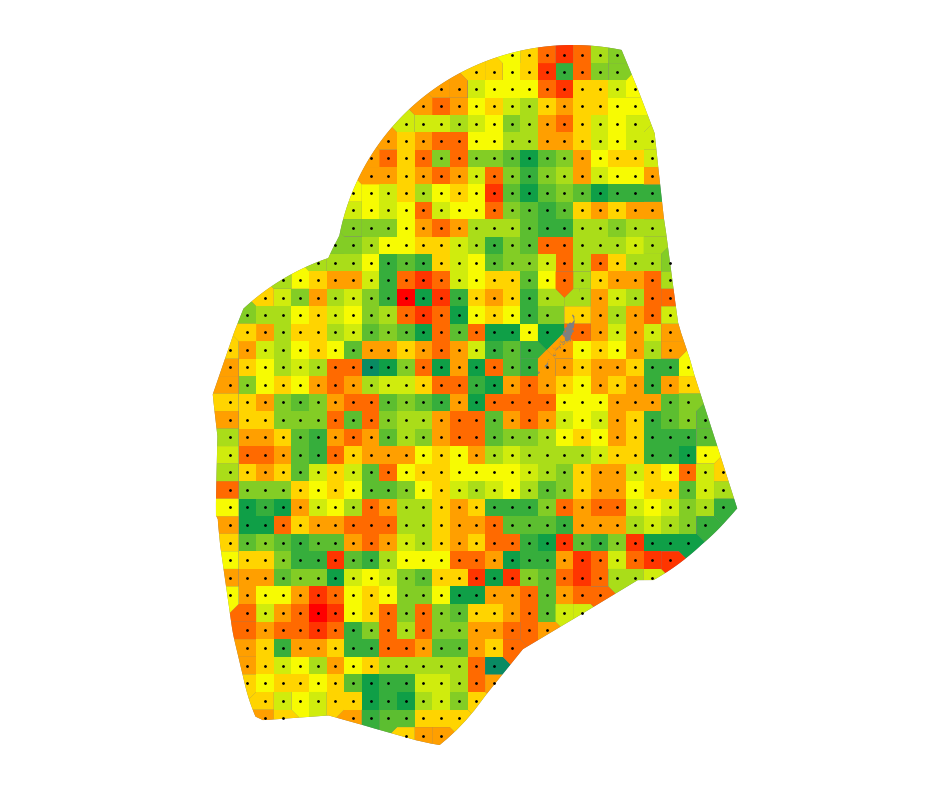

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/2008_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


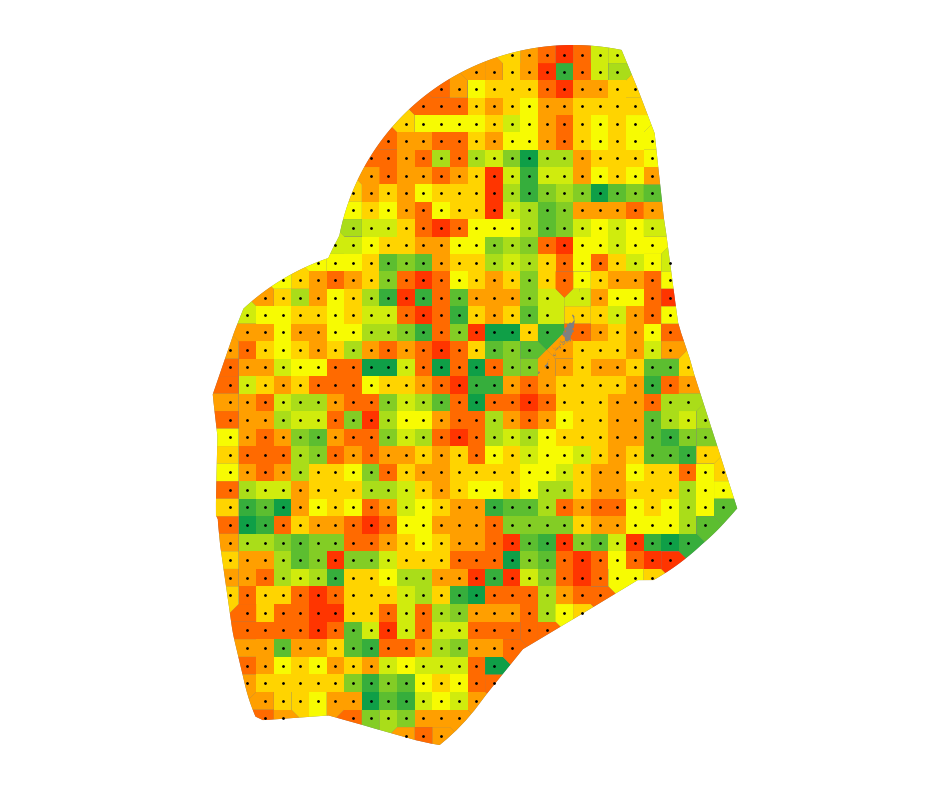

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/2009_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


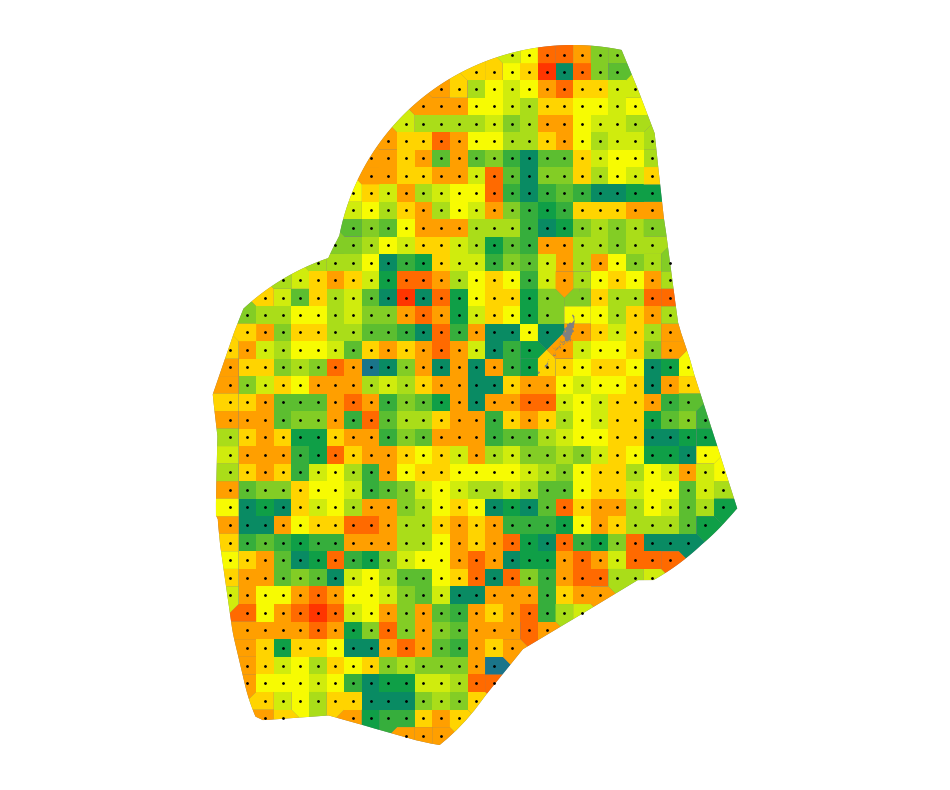

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/2010_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


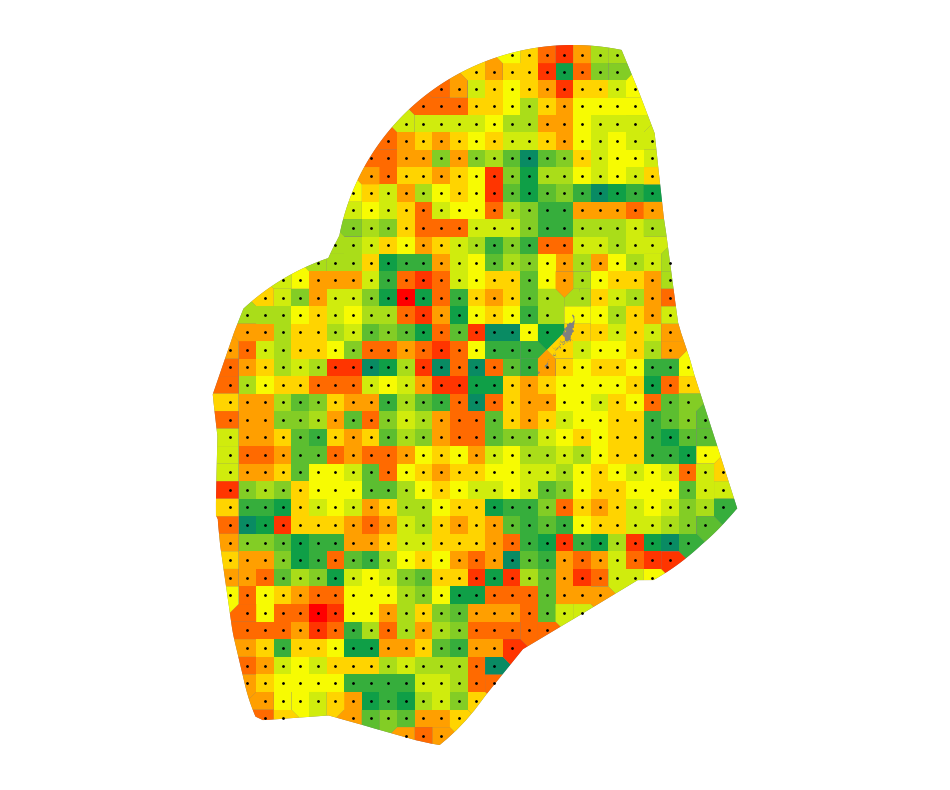

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/2011_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


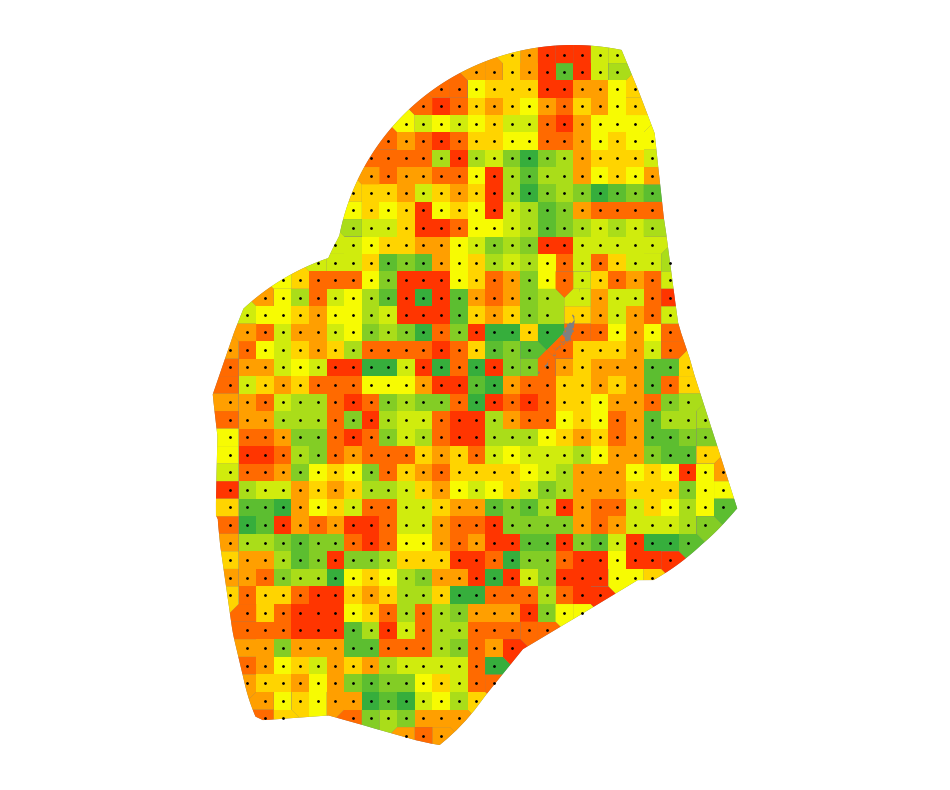

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/2012_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


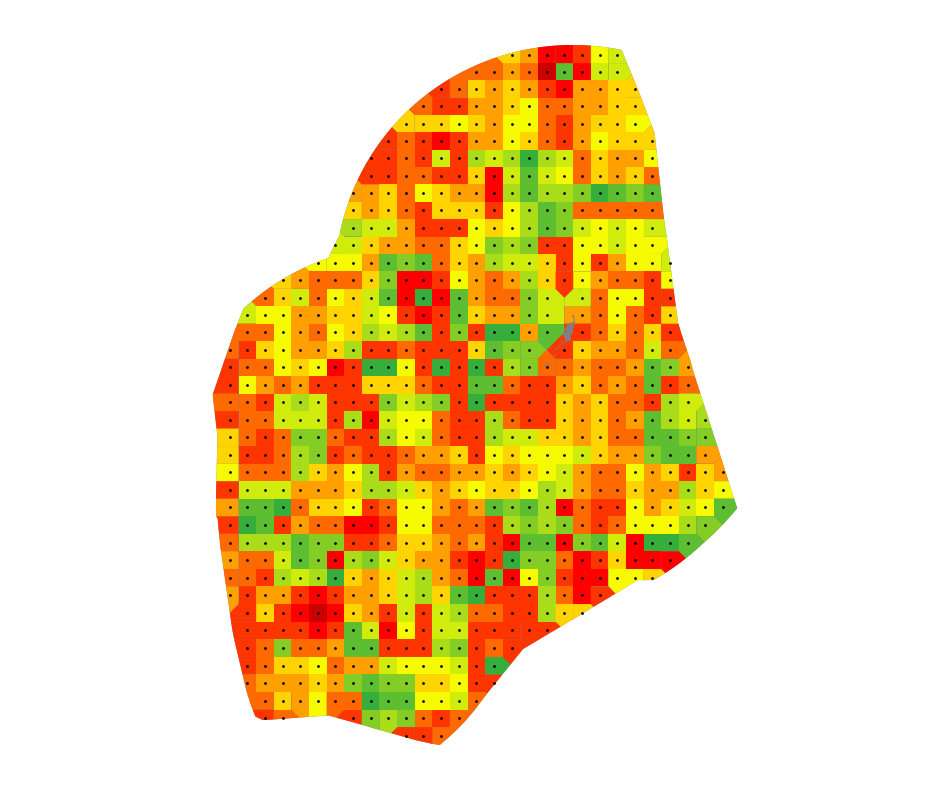

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/2013_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


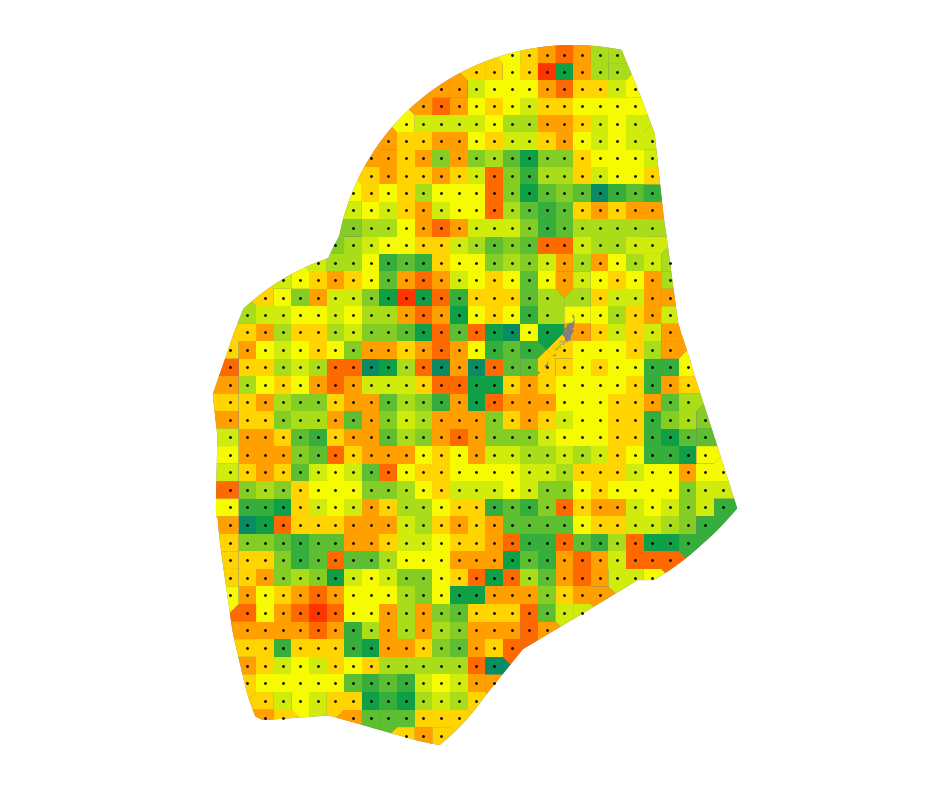

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3/2014_tos_Omon_HadGEM3-GC31-MM_historical_r2i1p1f3.json
HadGEM3-GC31-MM ssp126
latlon_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3_.pkl
Created: 2015-2100_colorbar_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.png


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


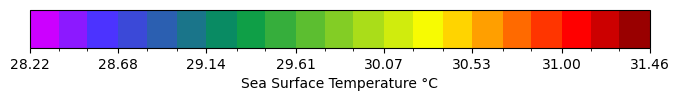

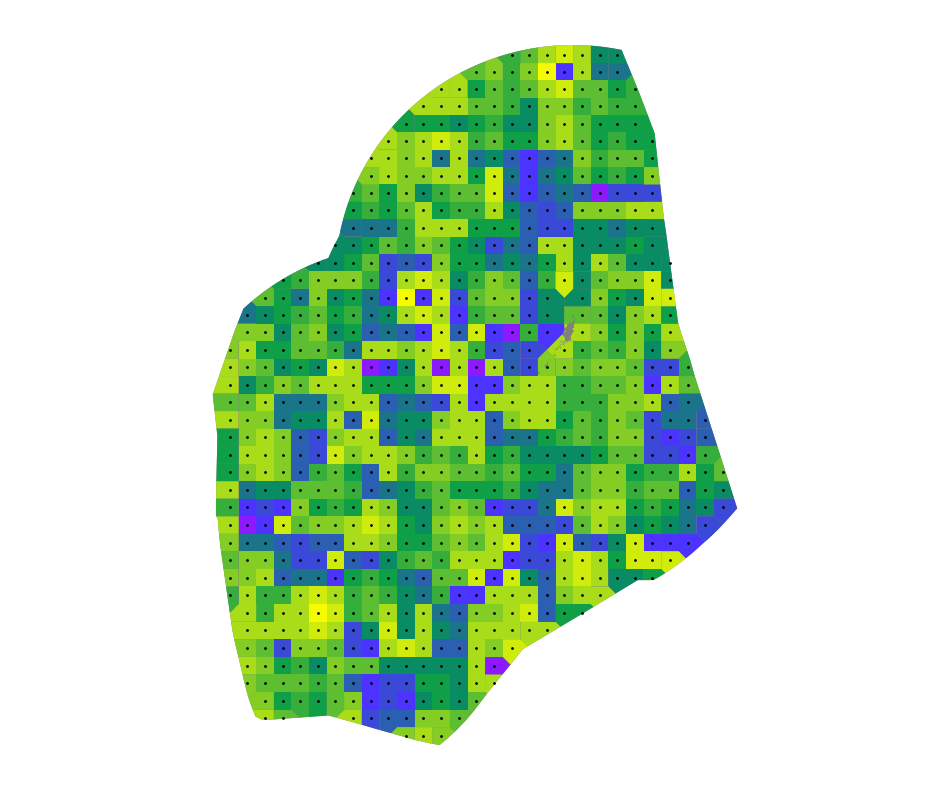

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2015_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


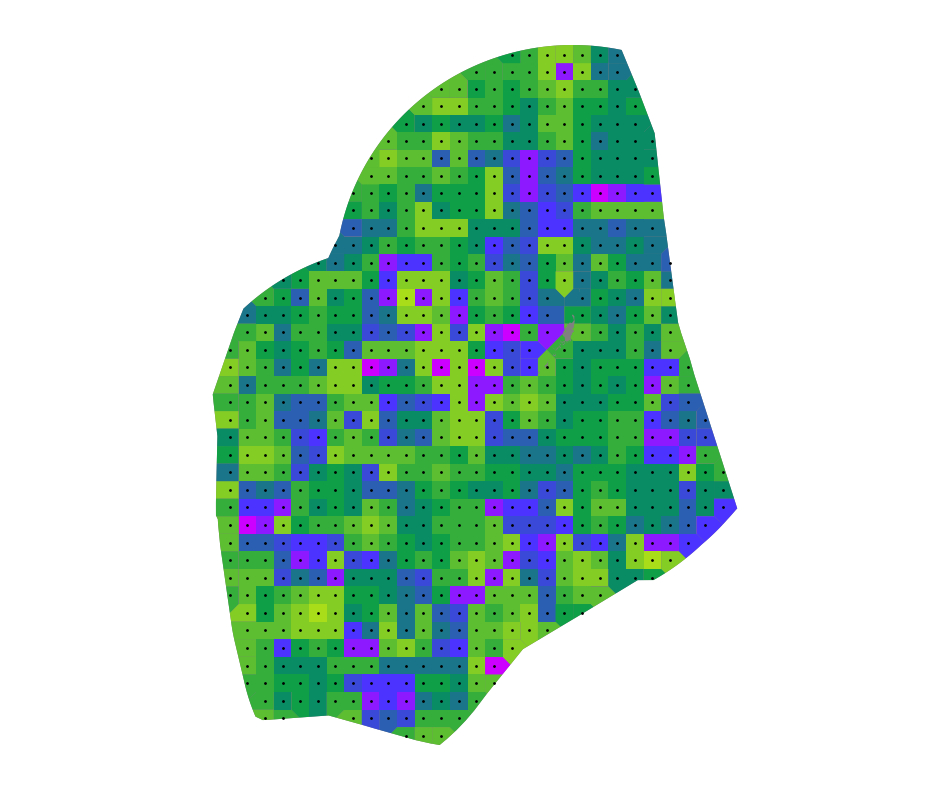

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2016_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


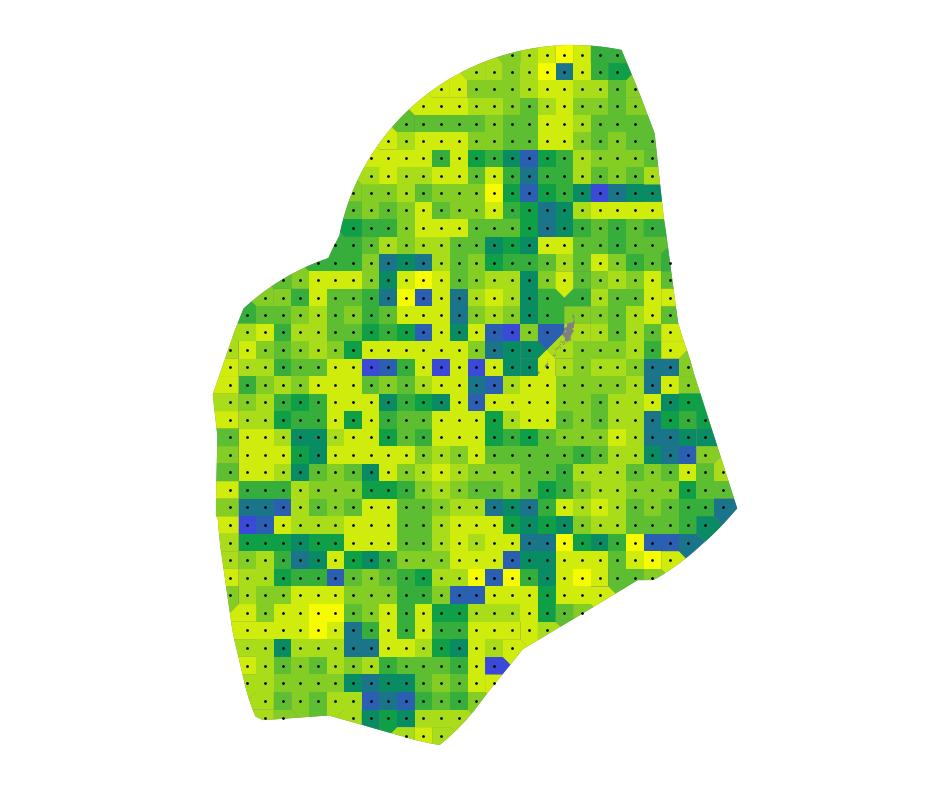

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2017_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


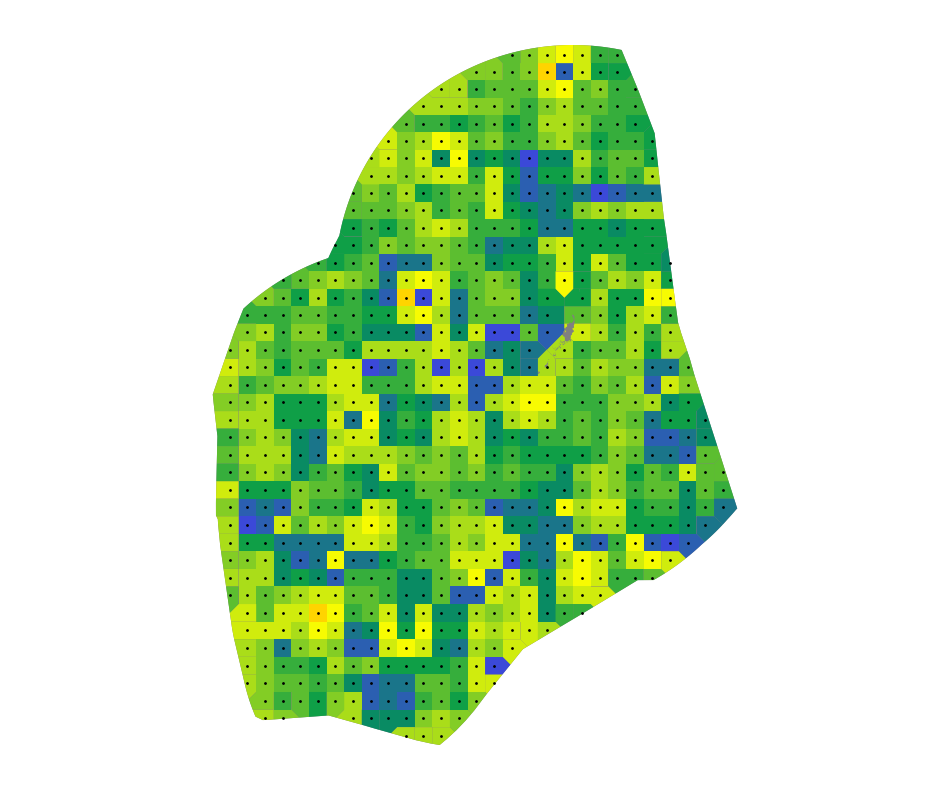

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2018_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


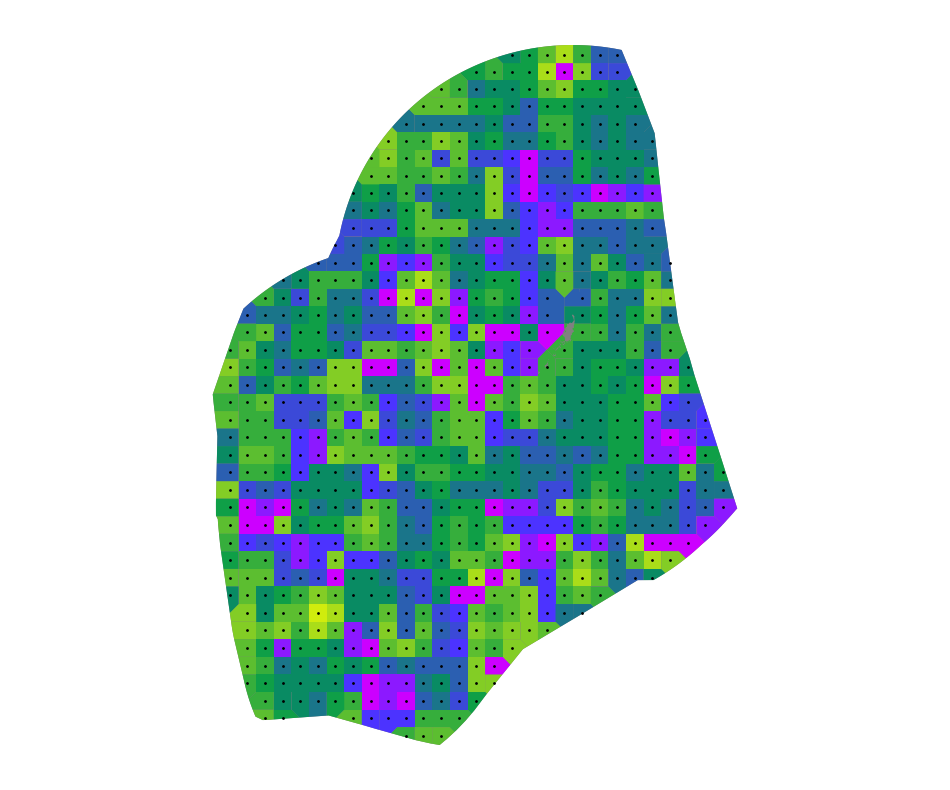

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2019_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


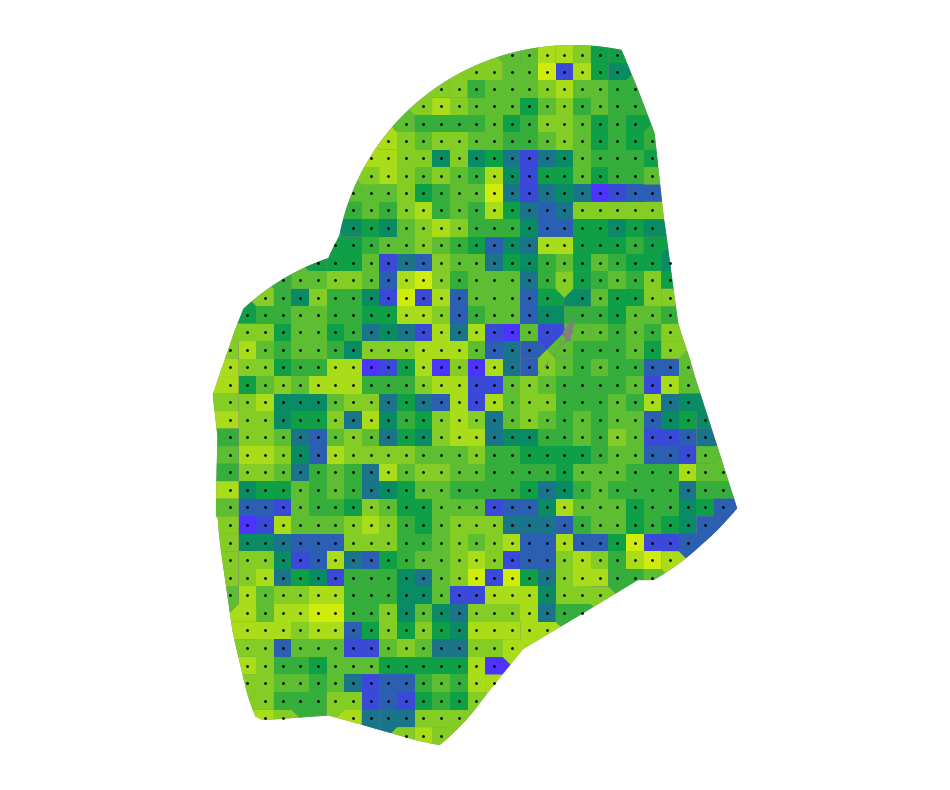

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2020_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


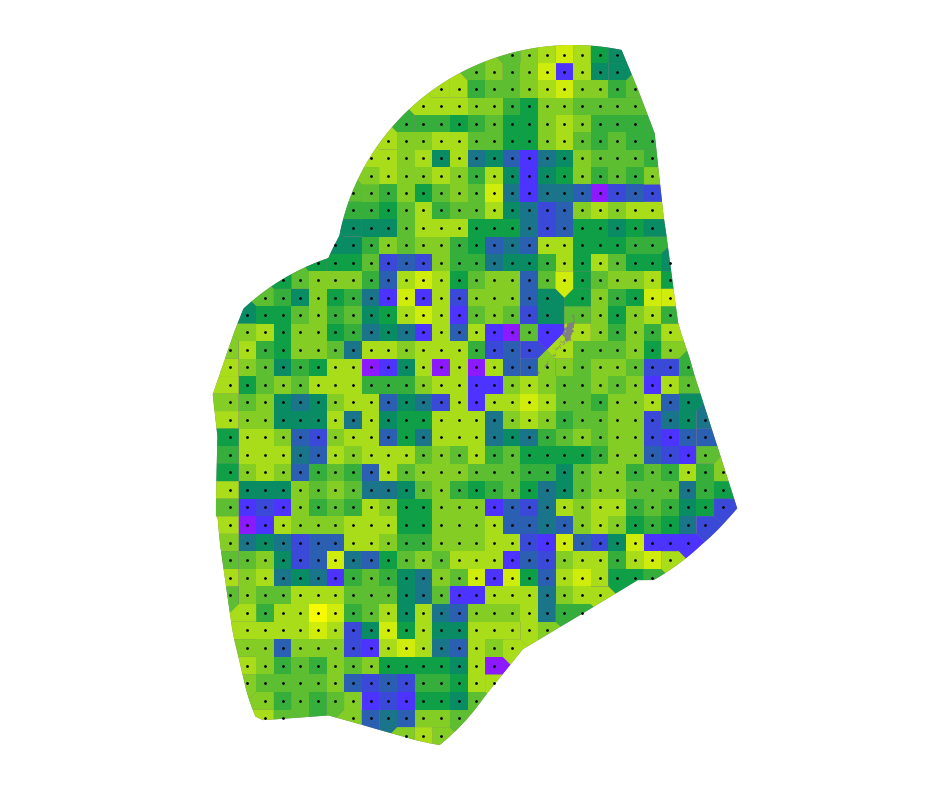

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2021_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


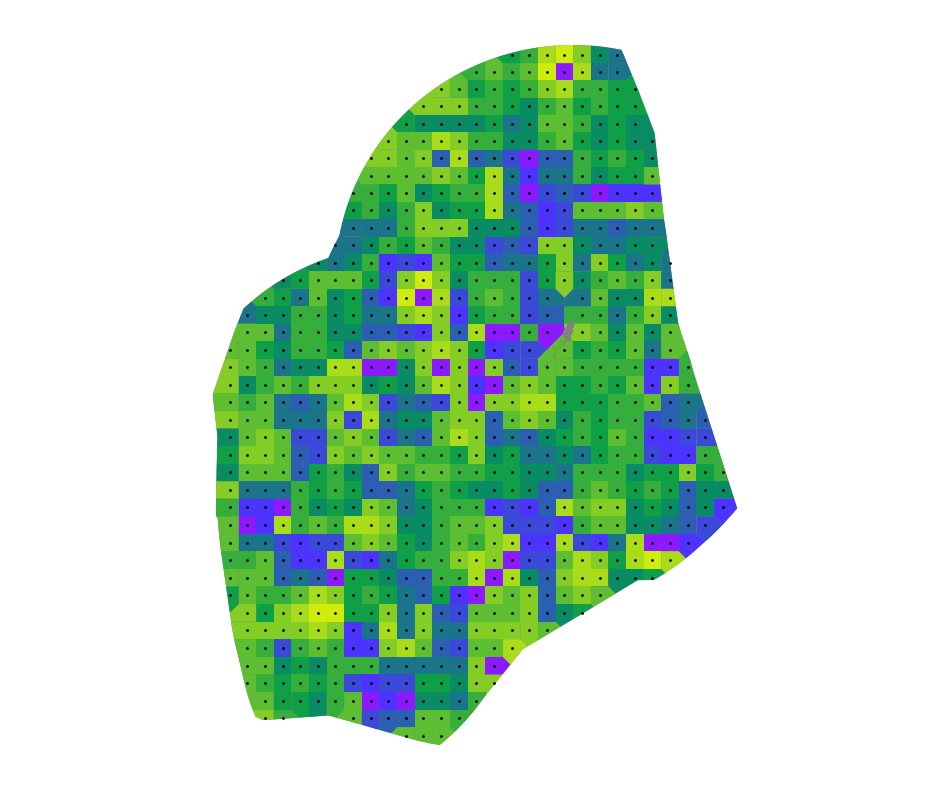

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2022_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


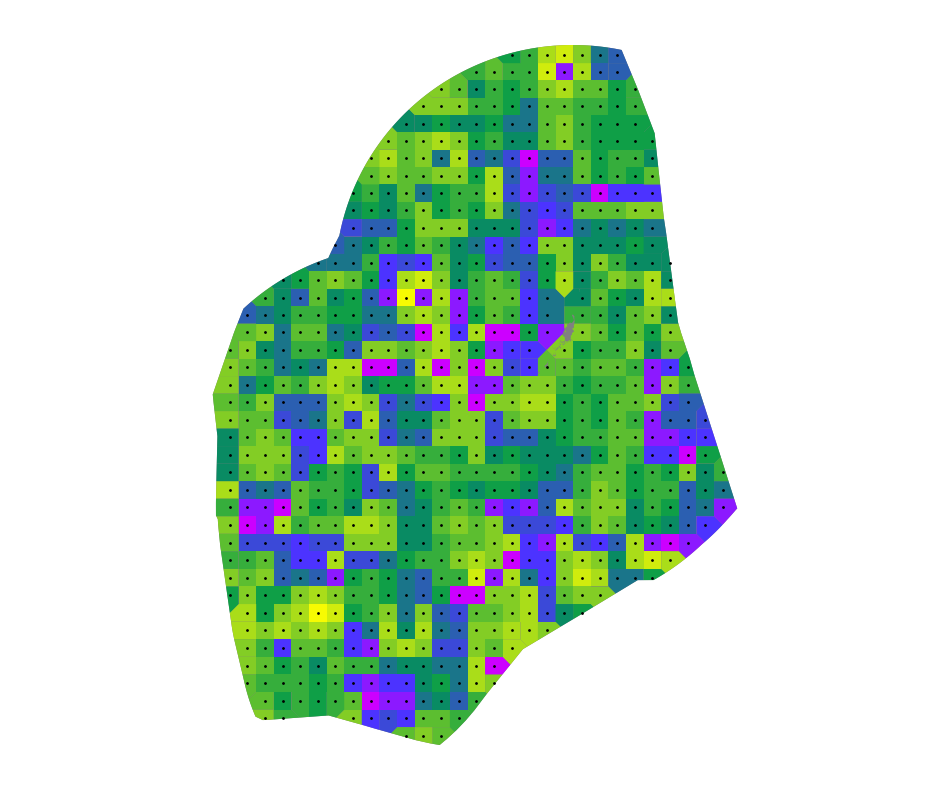

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2023_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


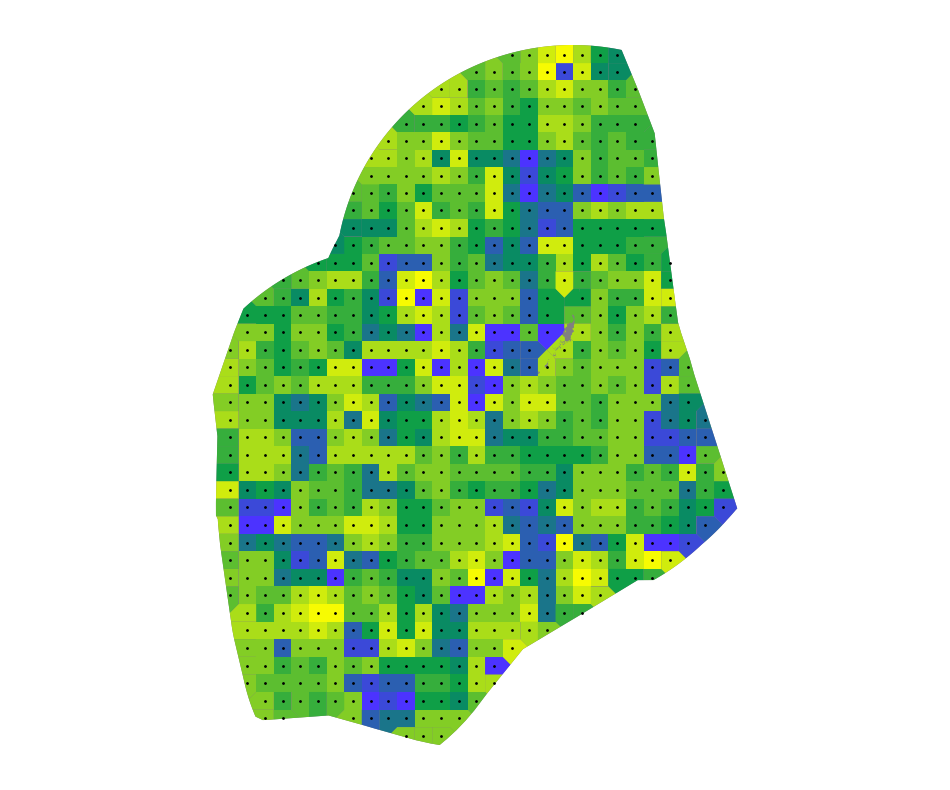

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2024_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


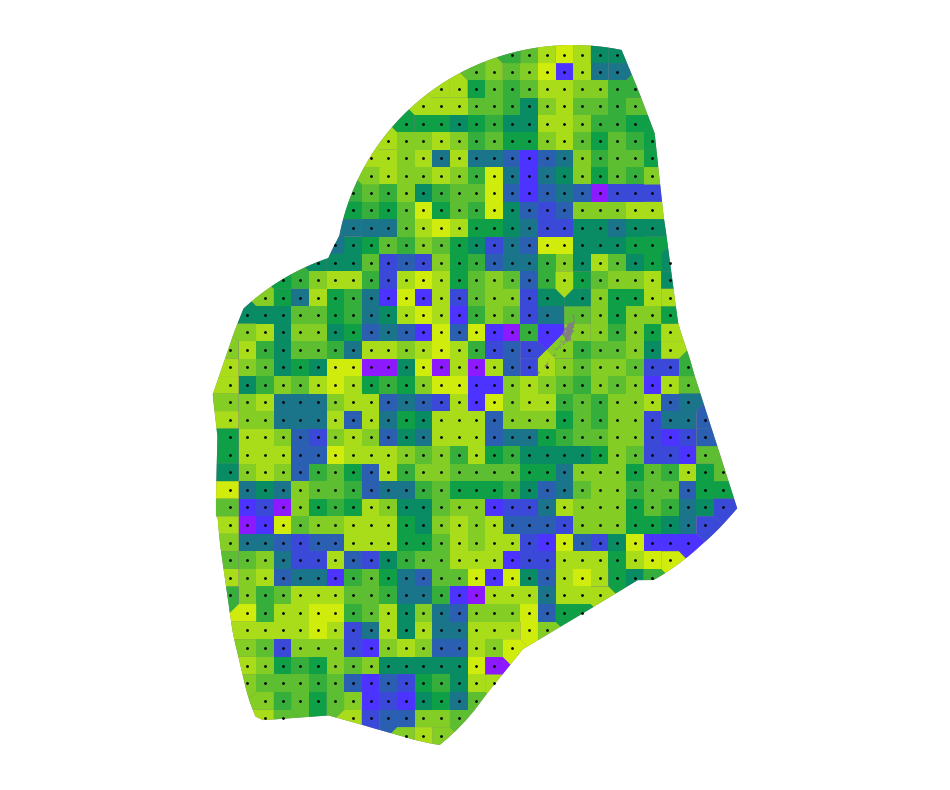

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2025_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


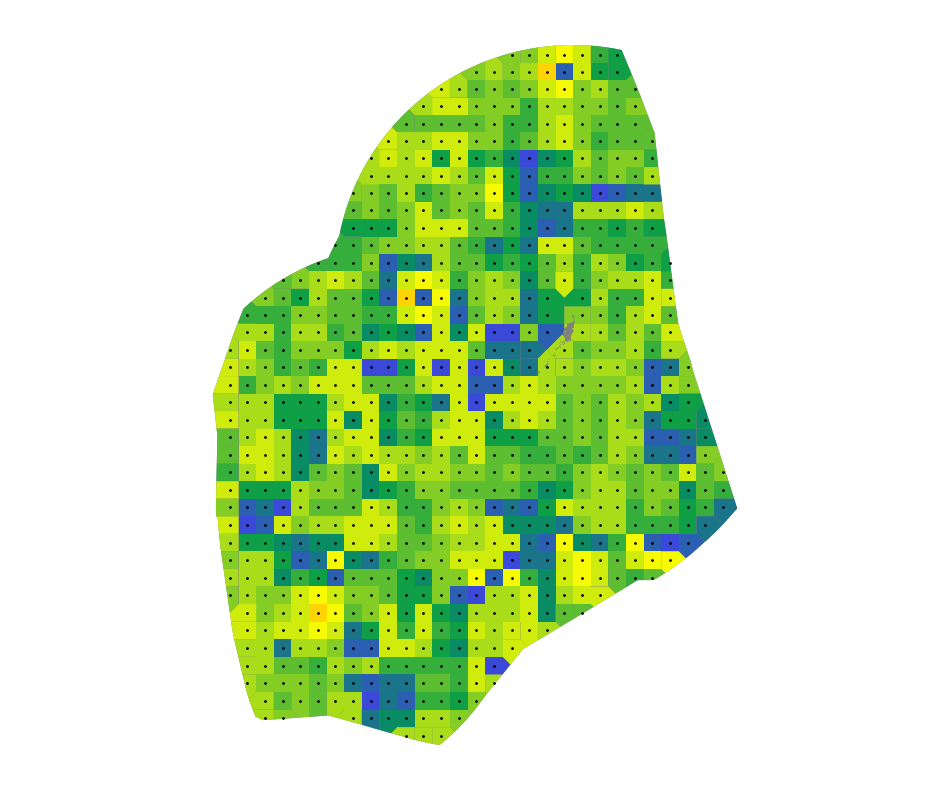

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2026_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


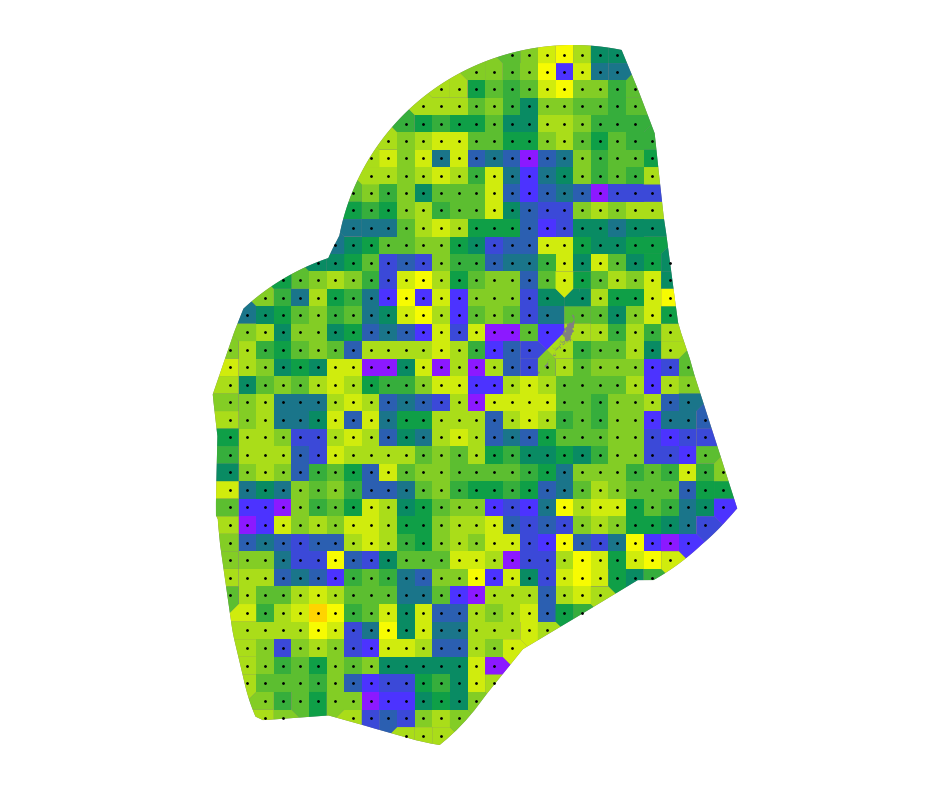

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2027_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


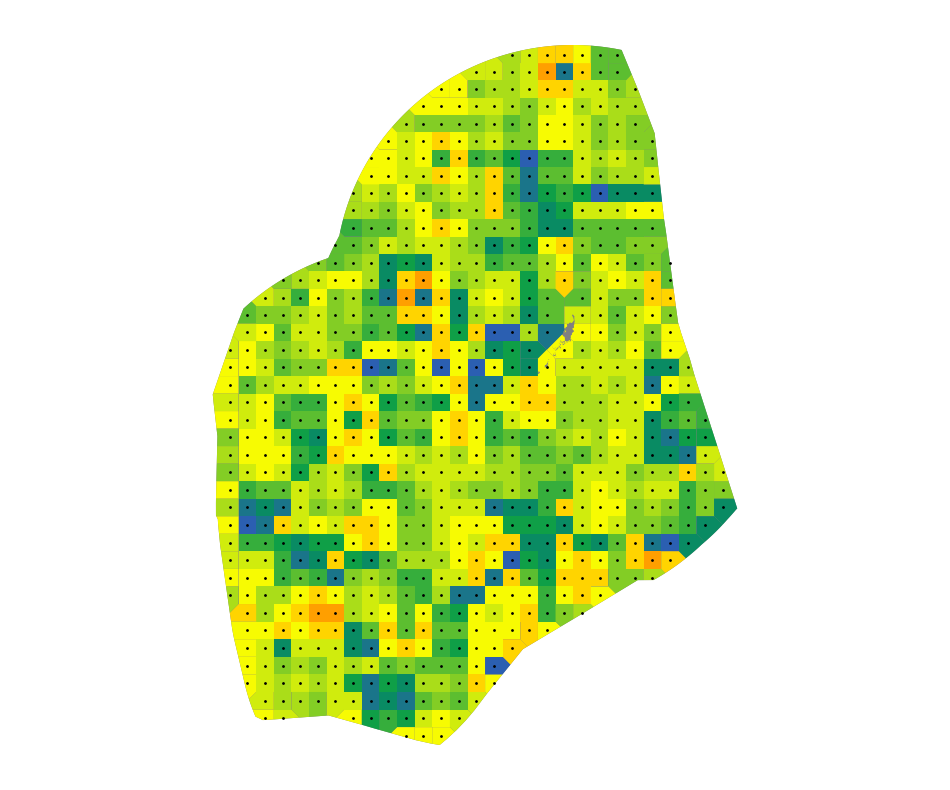

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2028_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


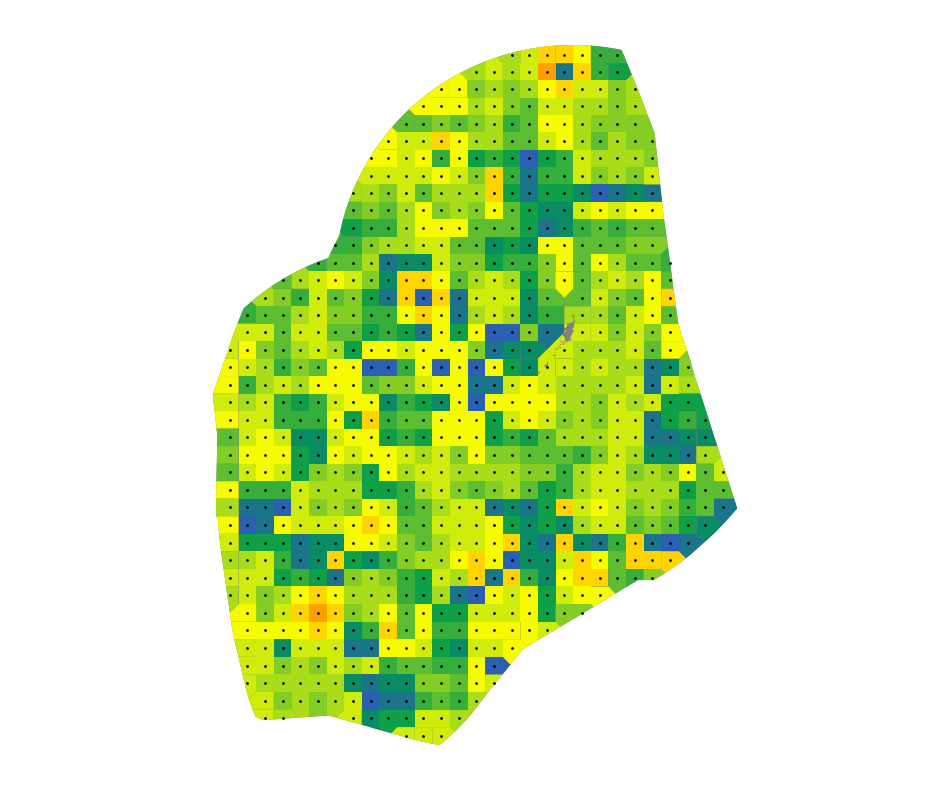

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2029_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


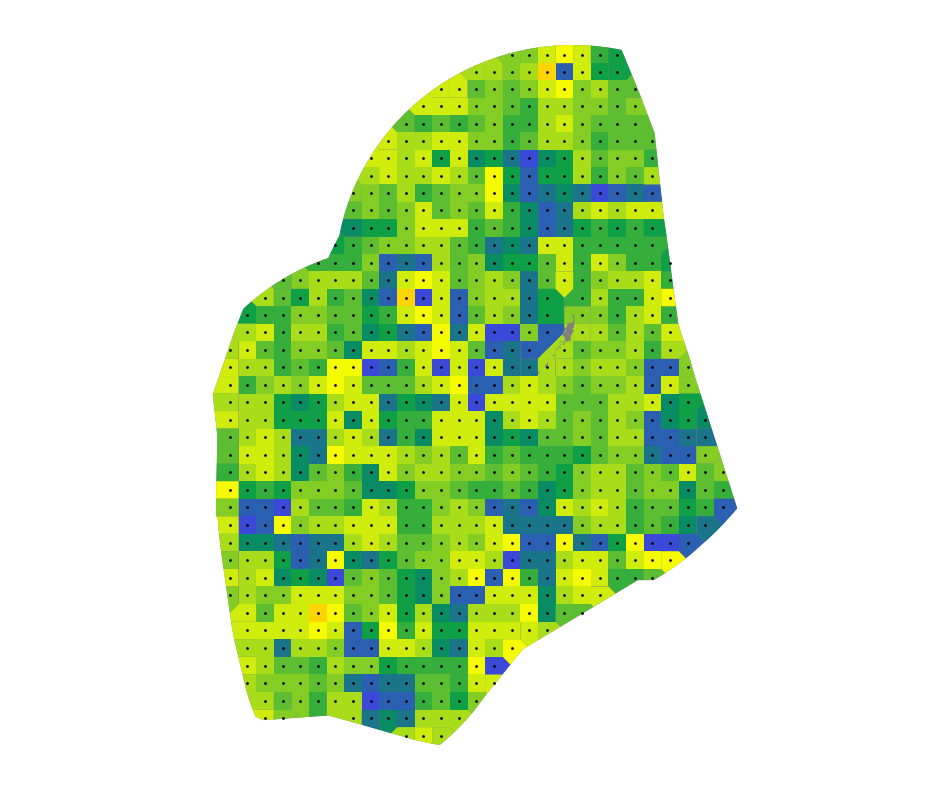

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2030_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


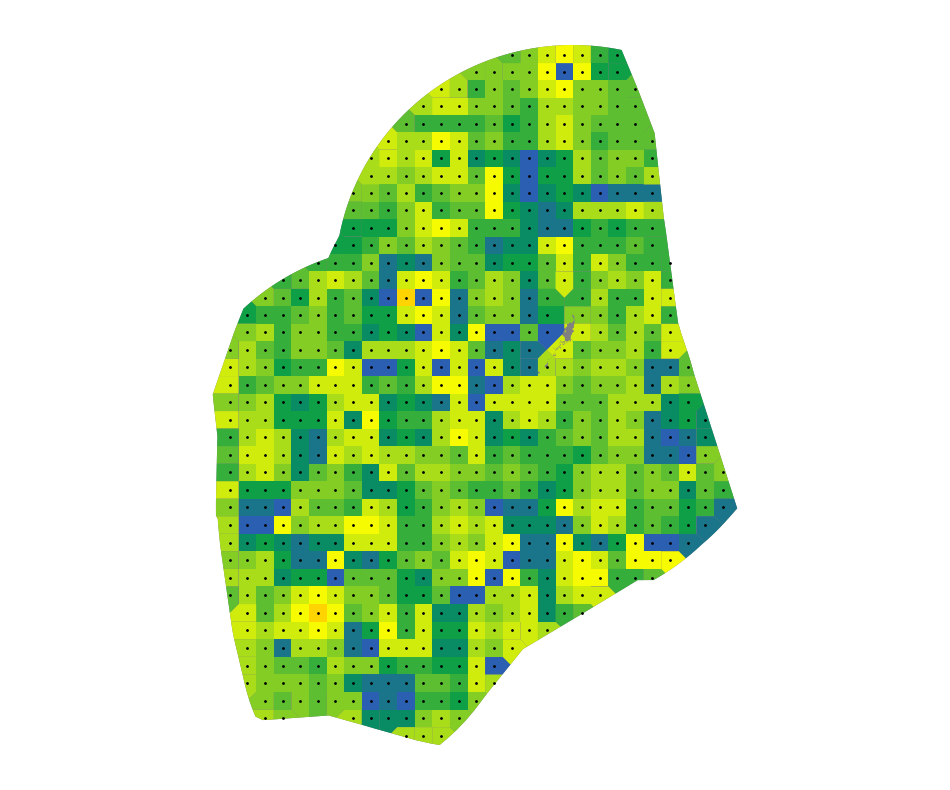

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2031_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


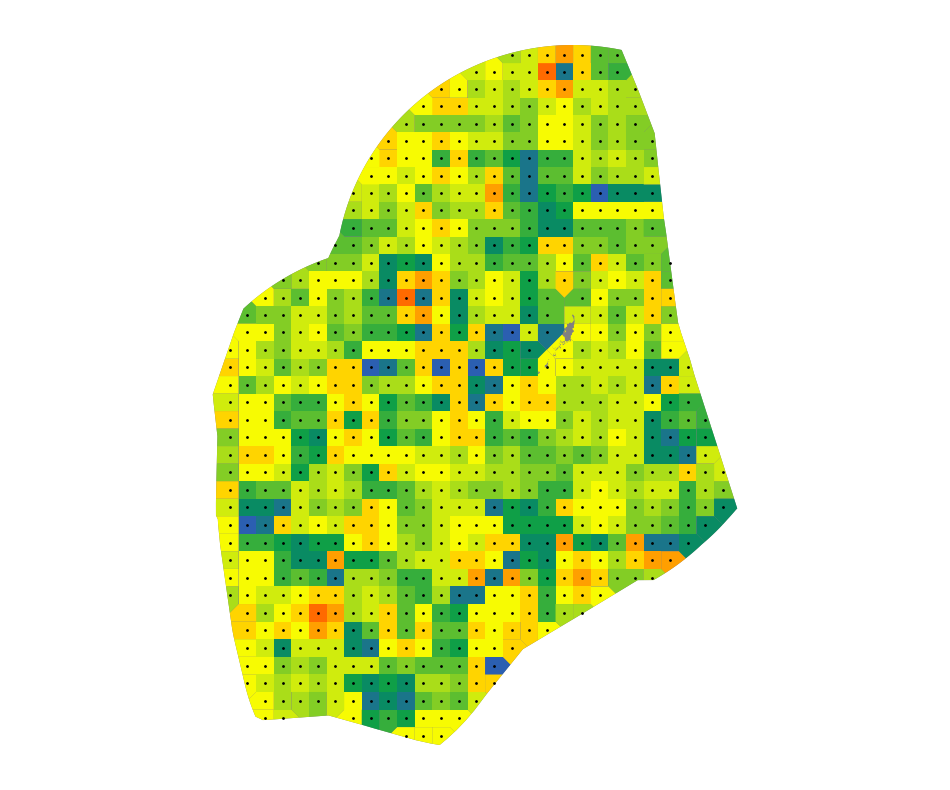

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2032_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


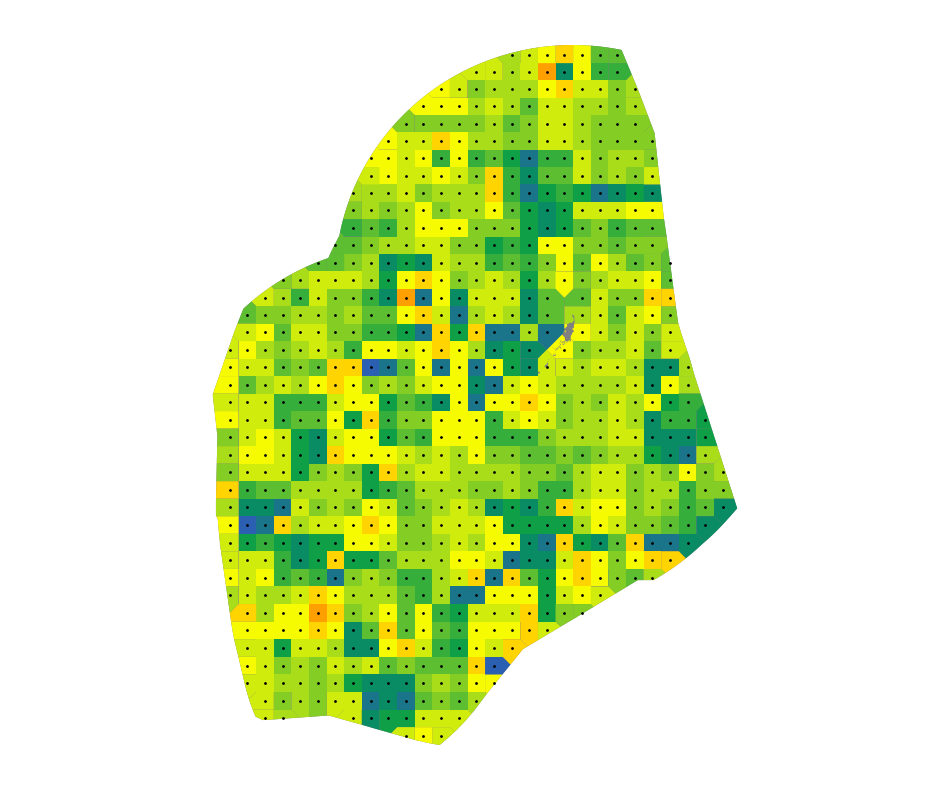

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2033_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


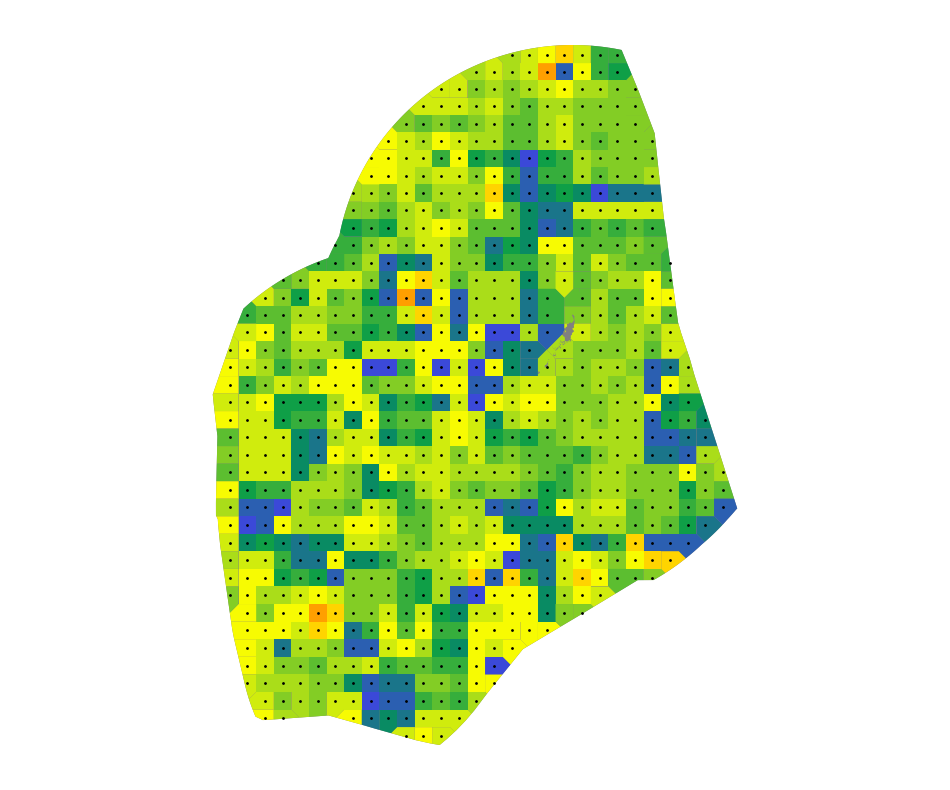

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2034_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


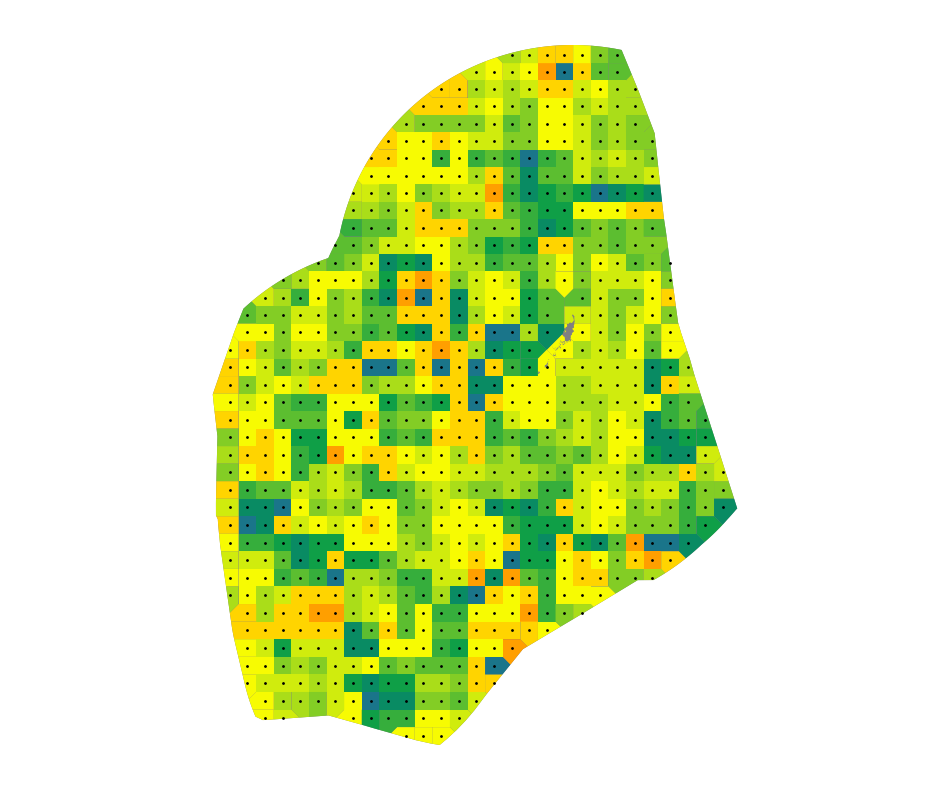

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2035_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


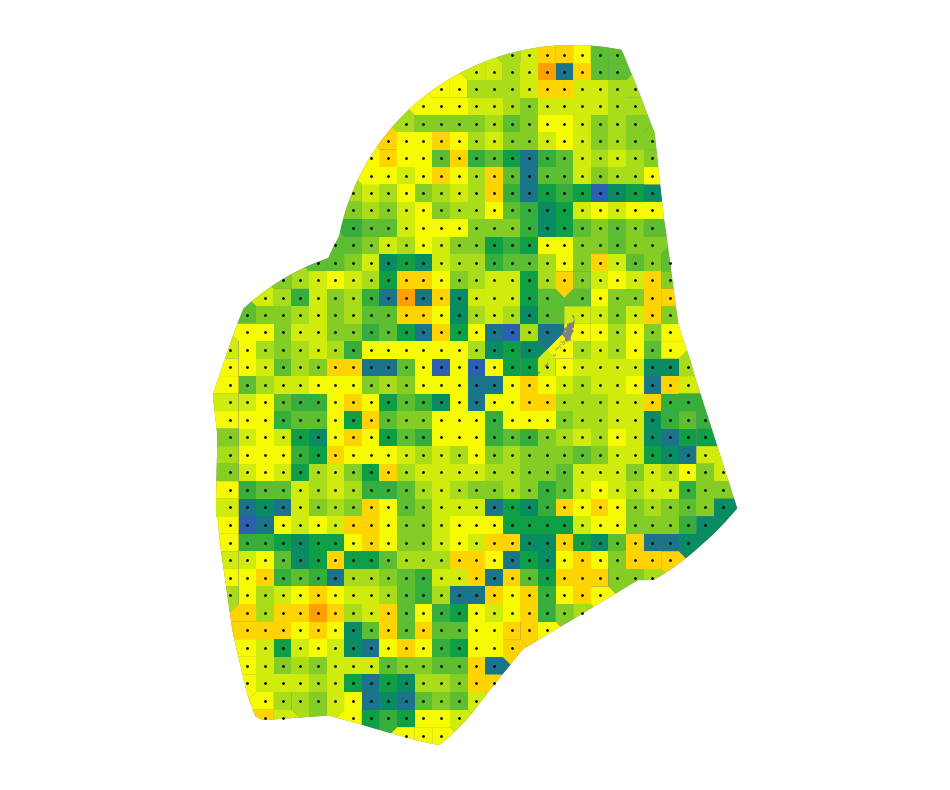

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2036_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


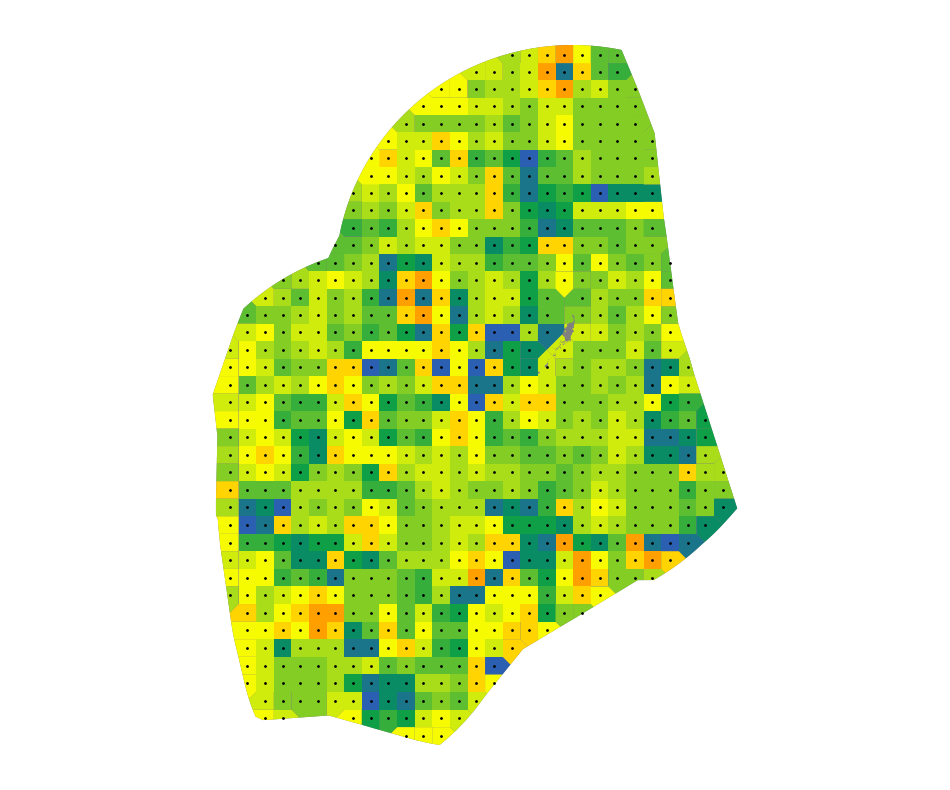

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2037_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


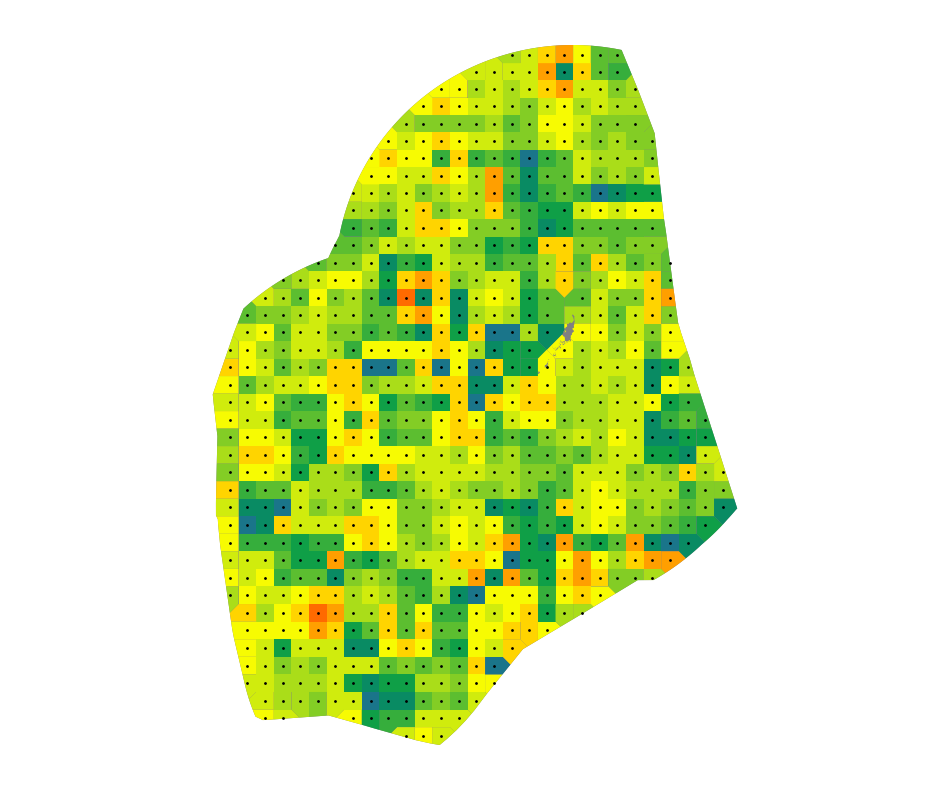

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2038_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


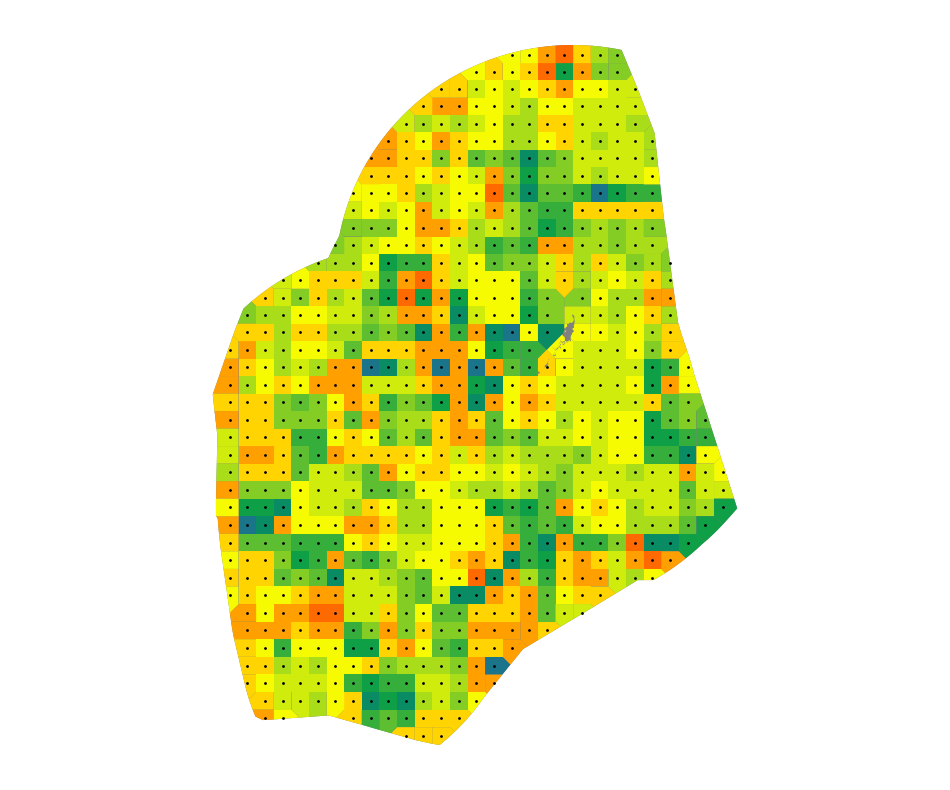

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2039_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


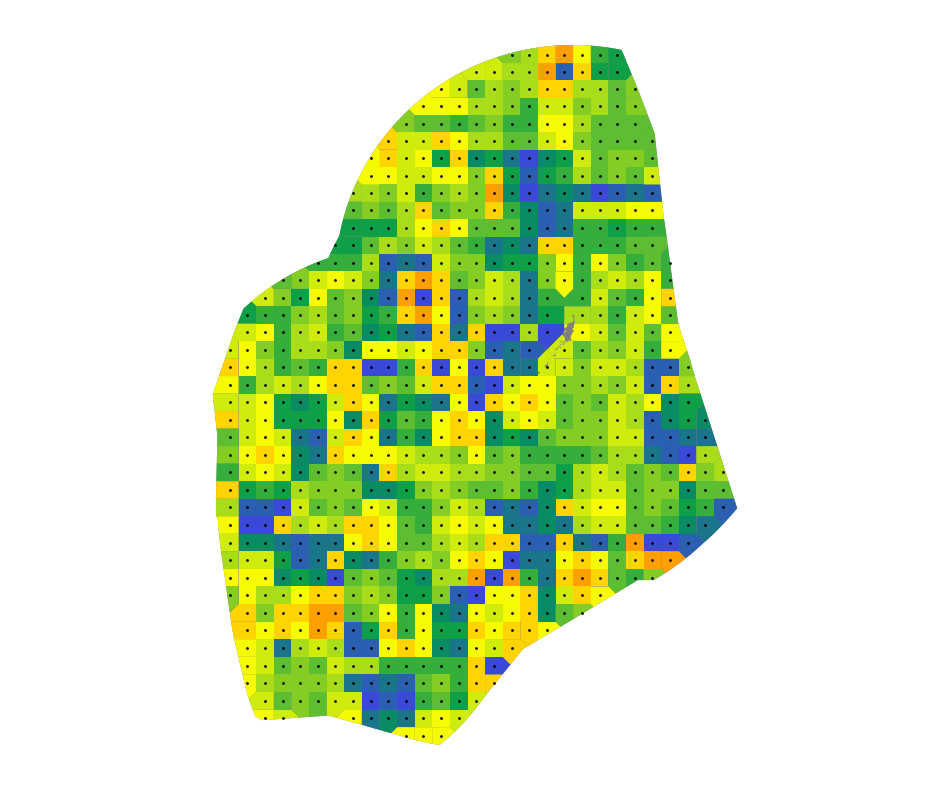

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2040_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


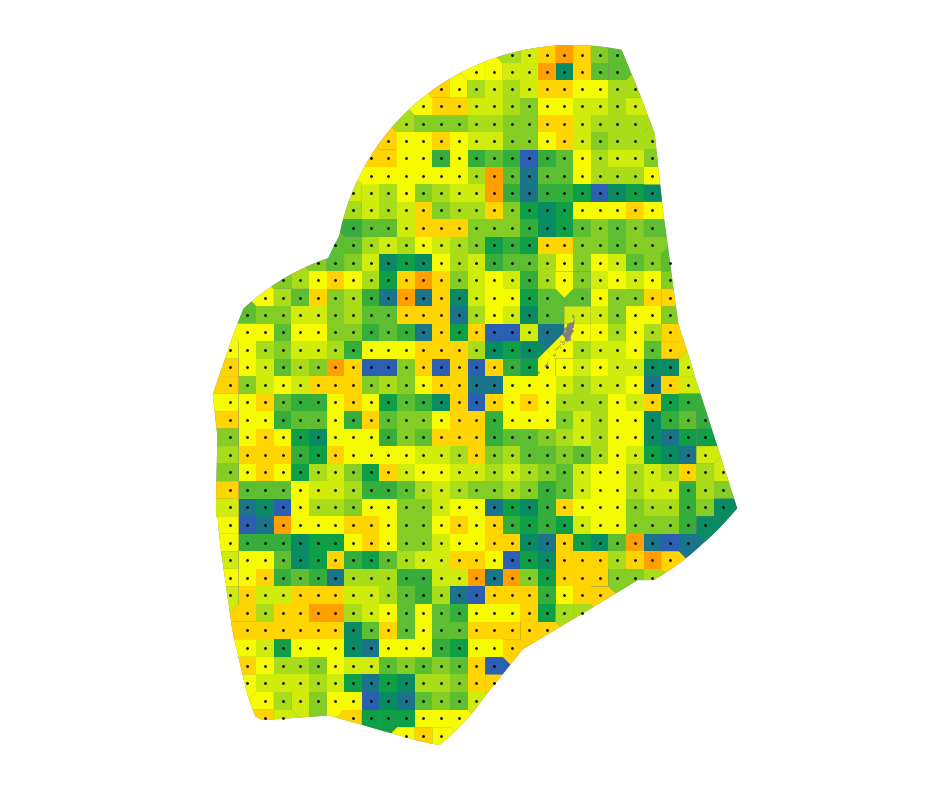

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2041_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


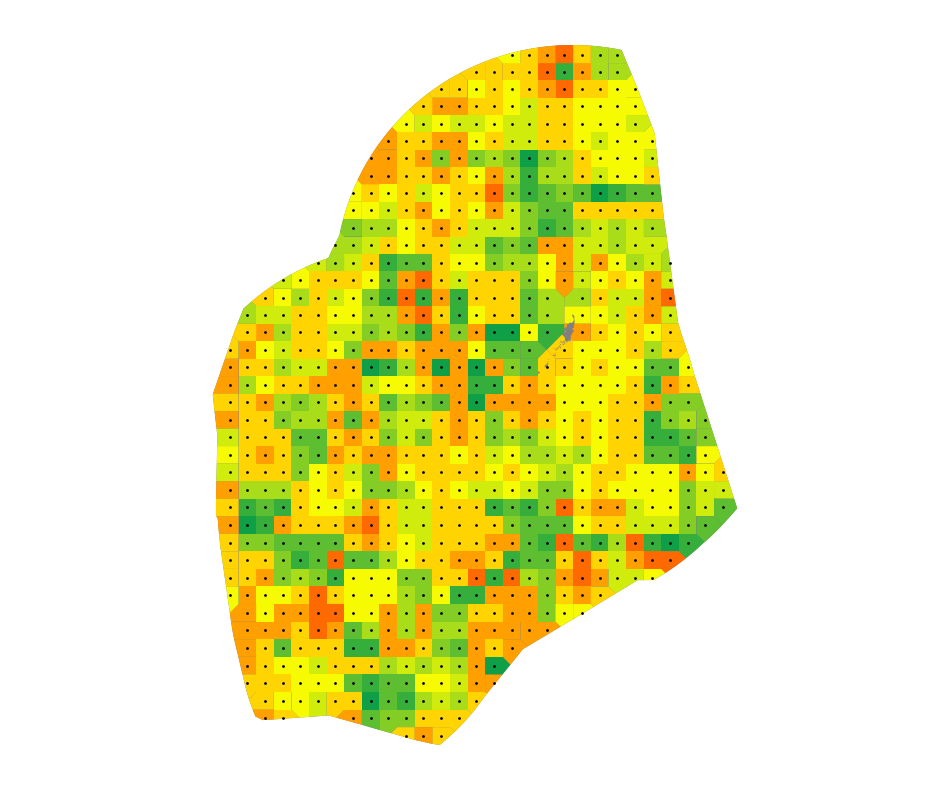

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2042_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


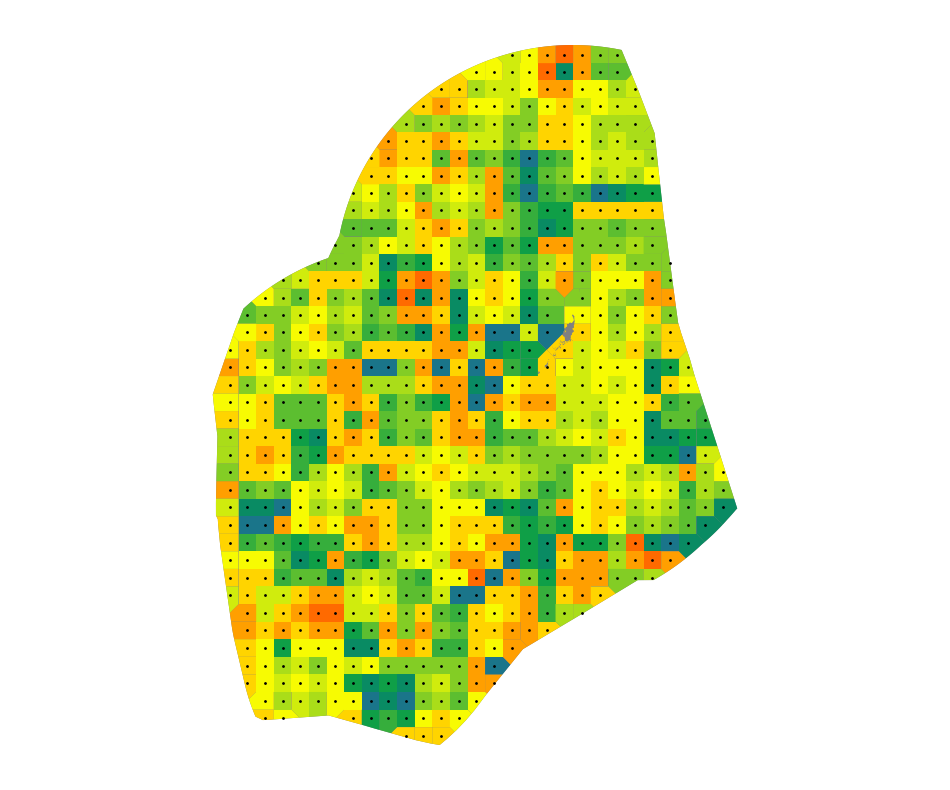

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2043_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


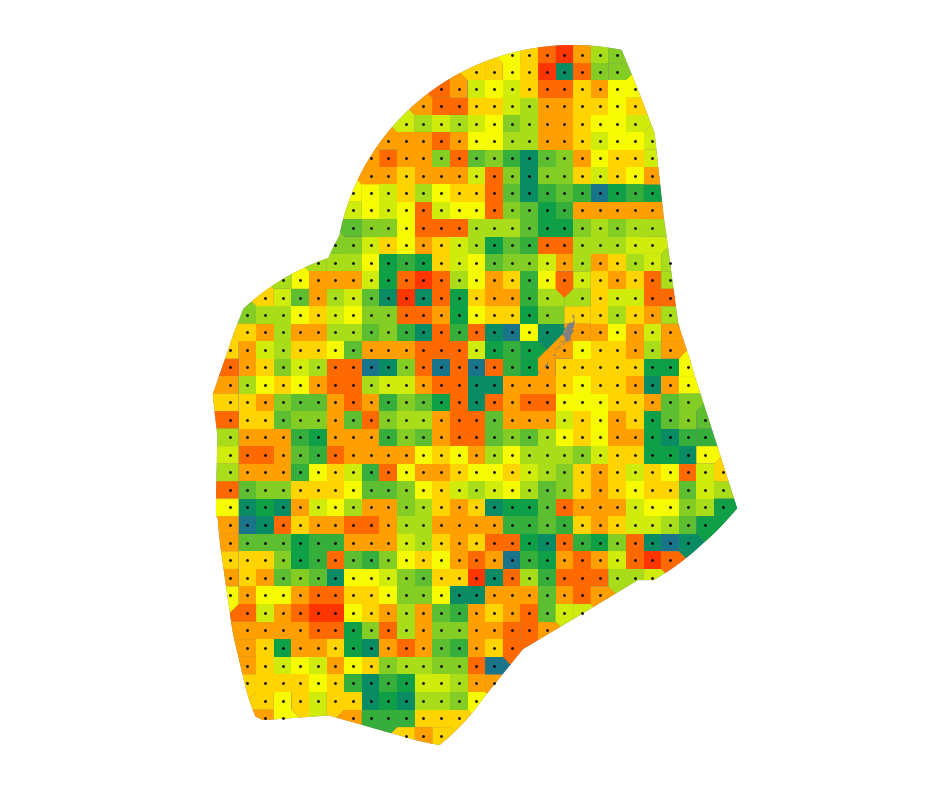

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2044_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


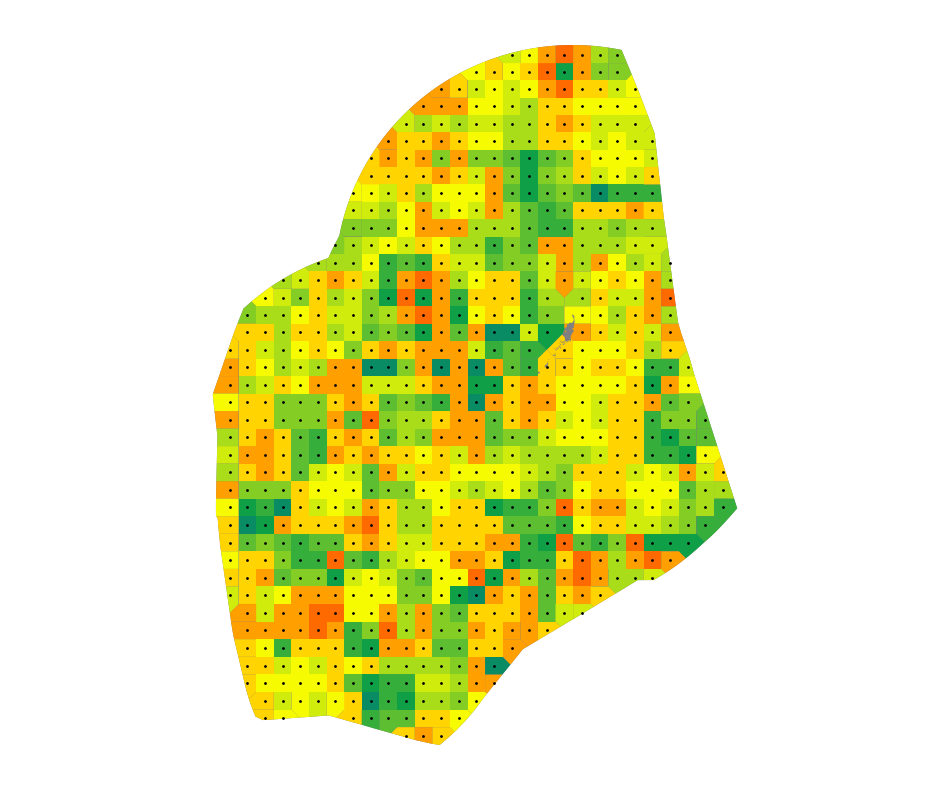

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2045_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


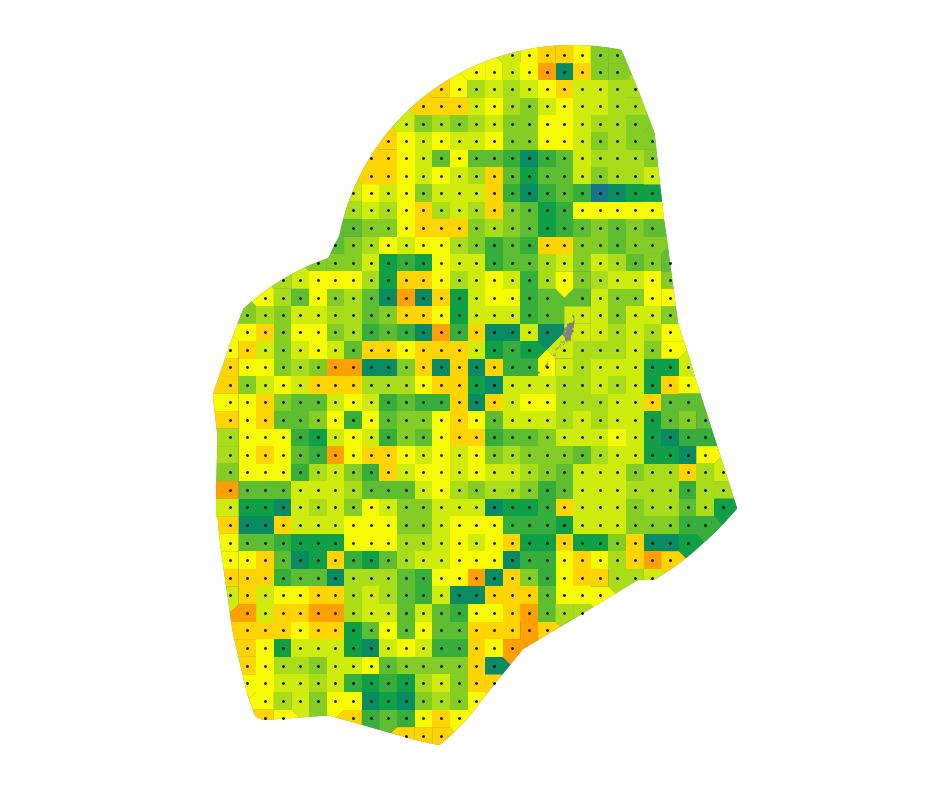

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2046_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


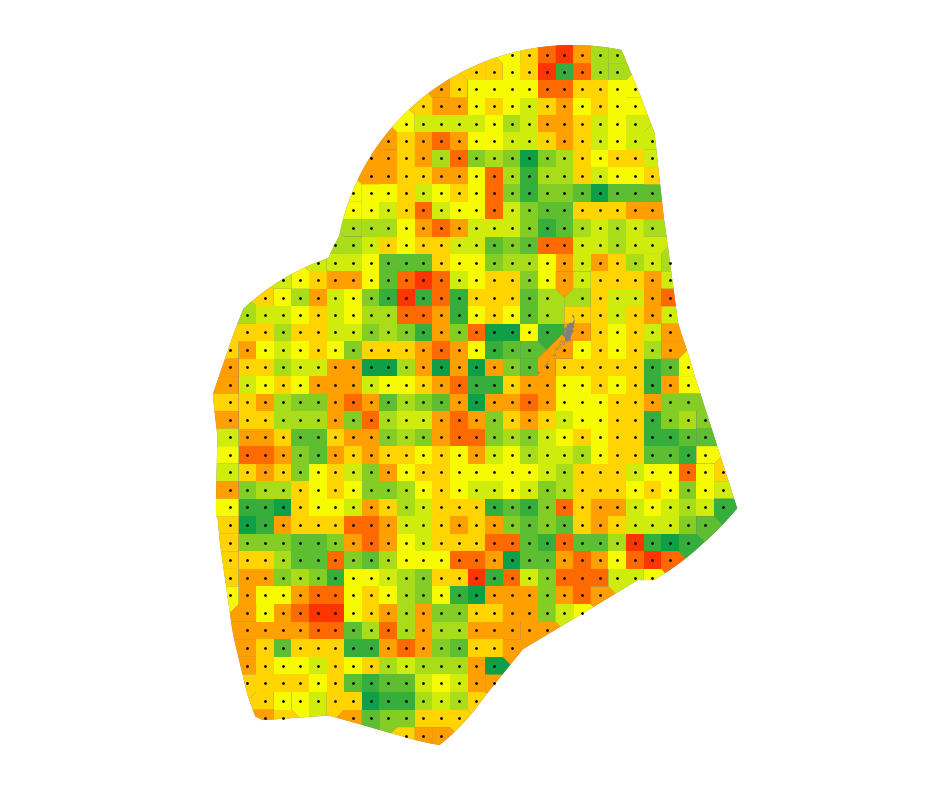

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2047_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


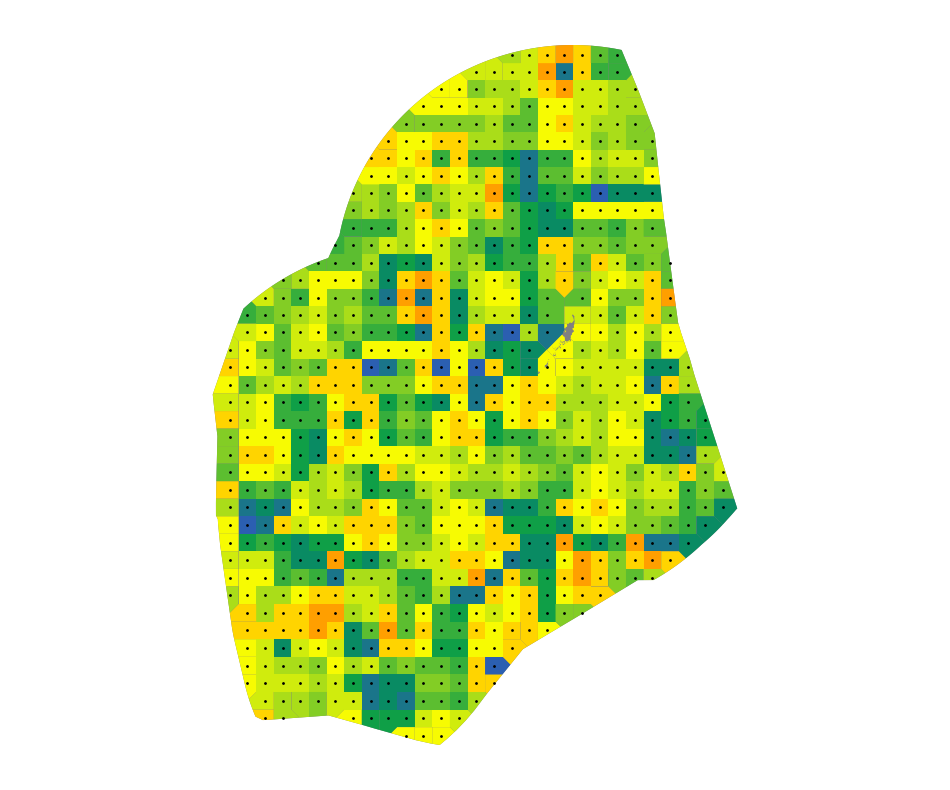

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2048_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


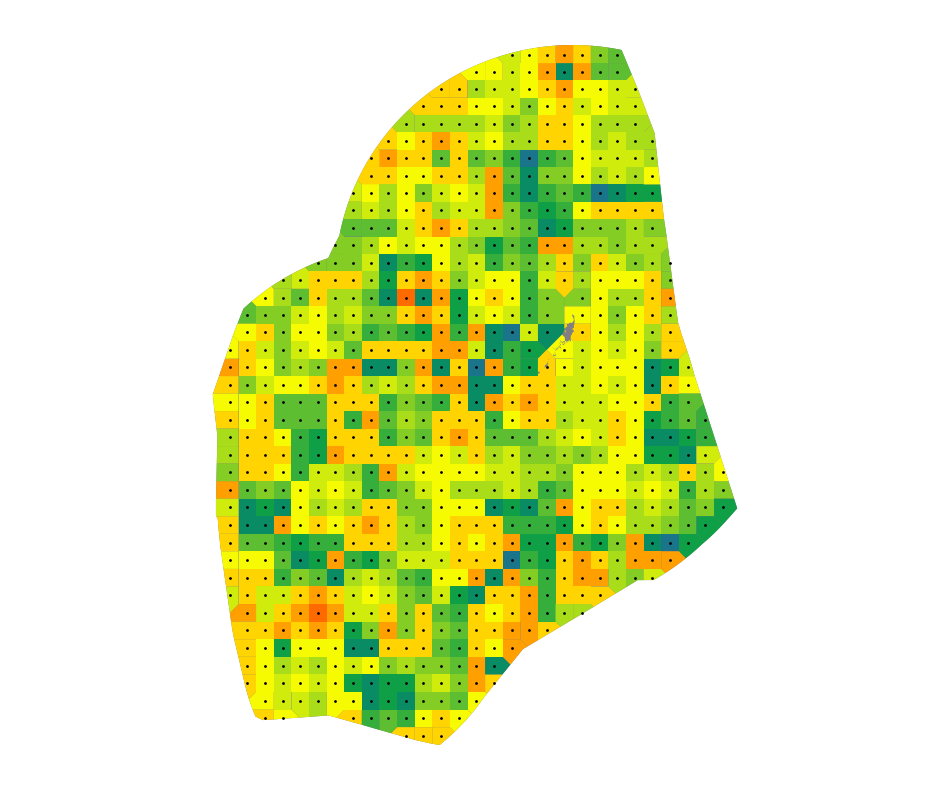

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2049_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


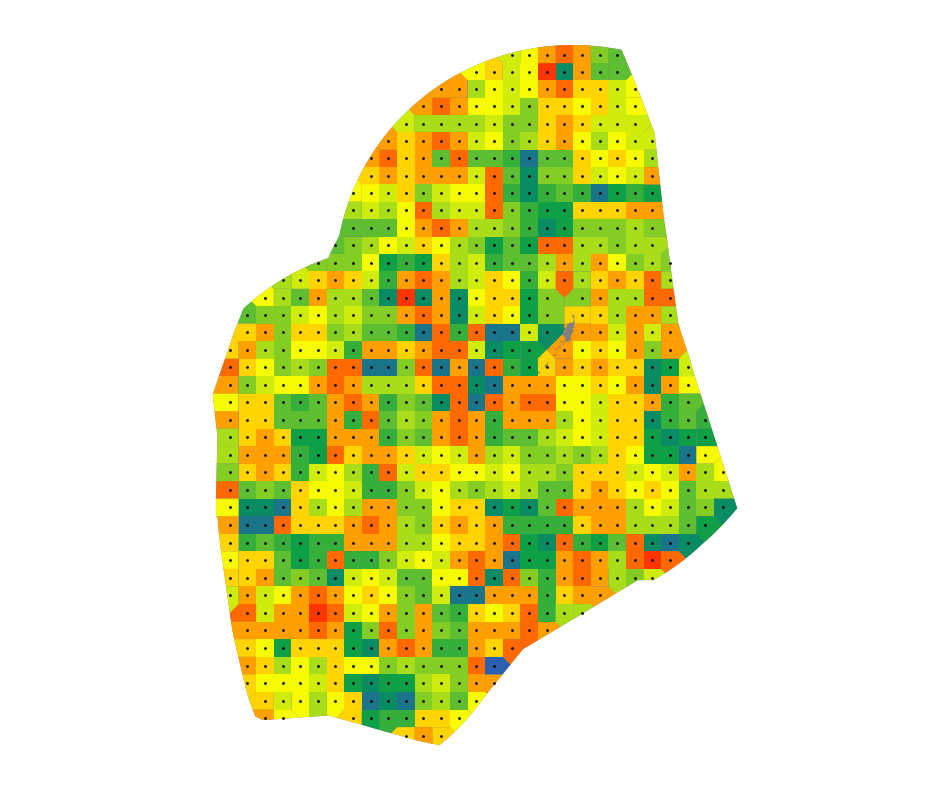

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2050_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


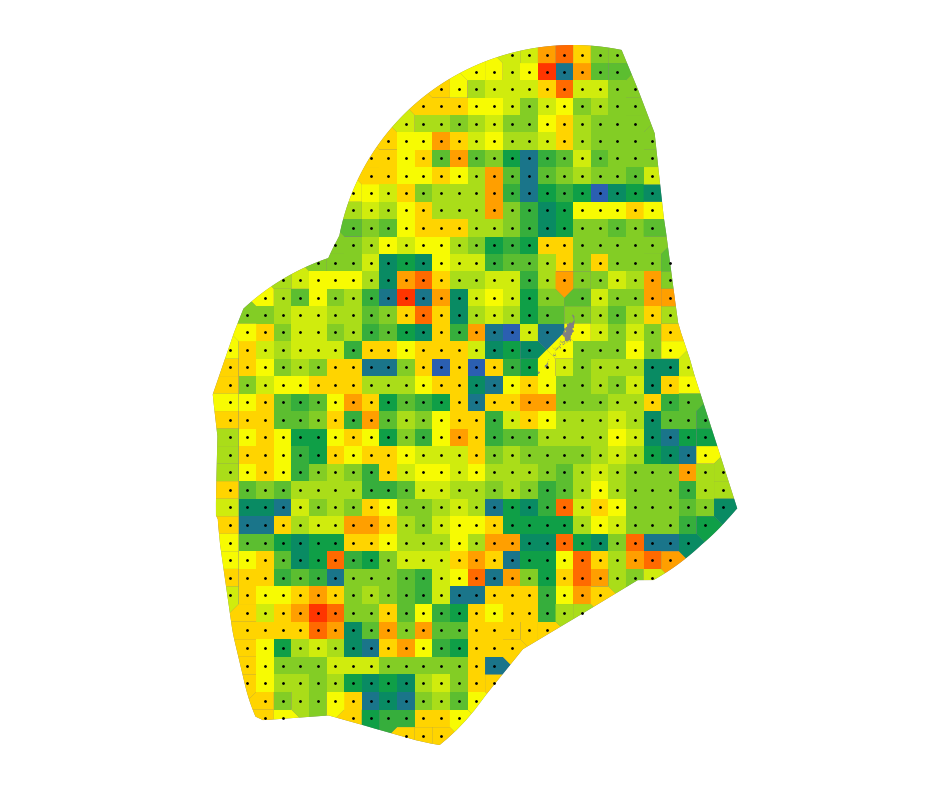

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2051_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


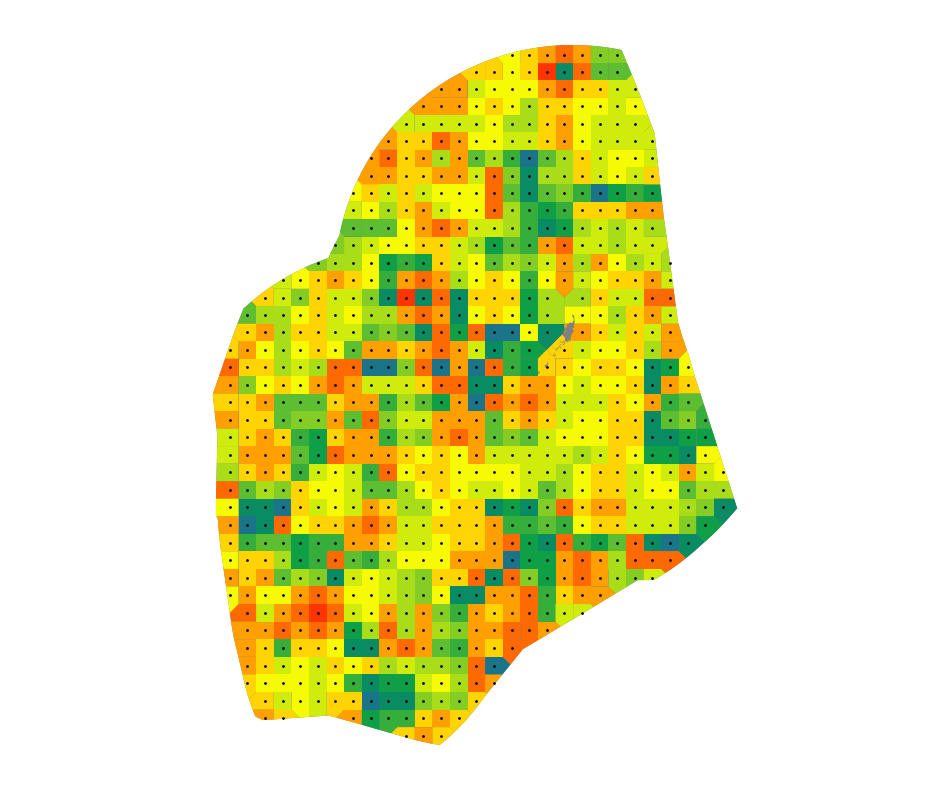

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2052_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


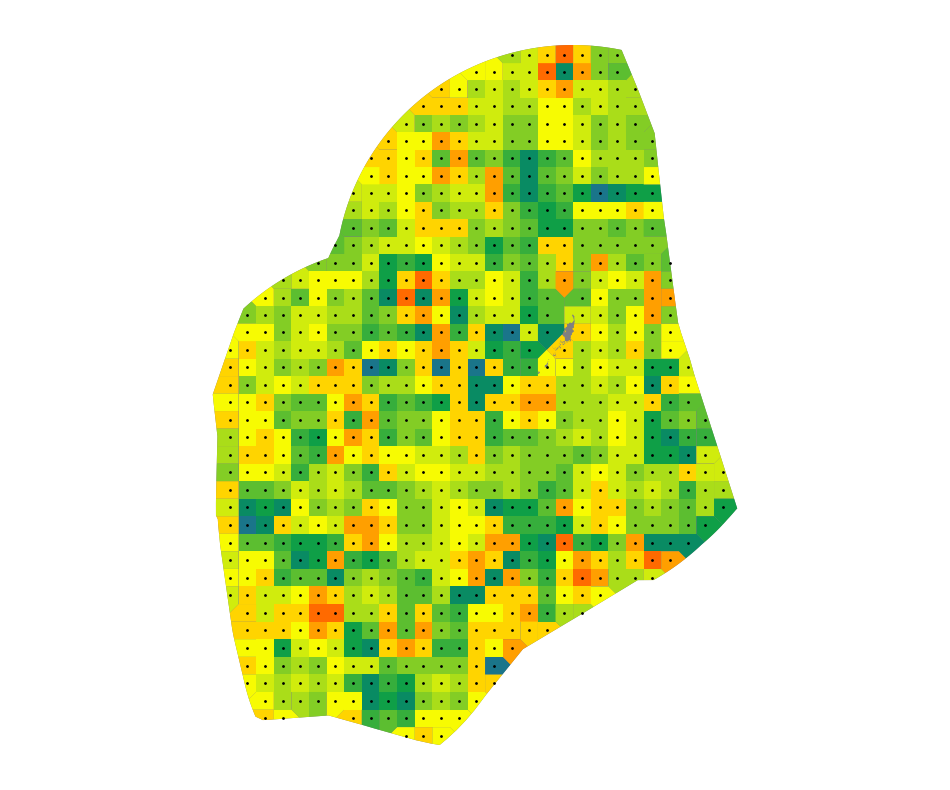

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2053_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


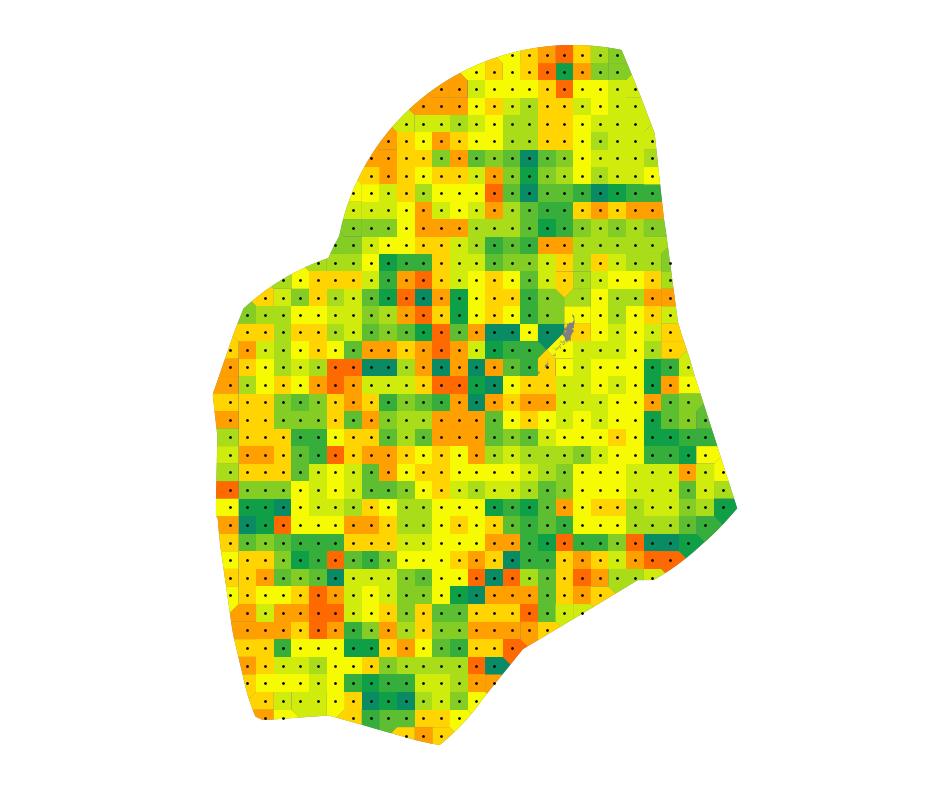

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2054_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


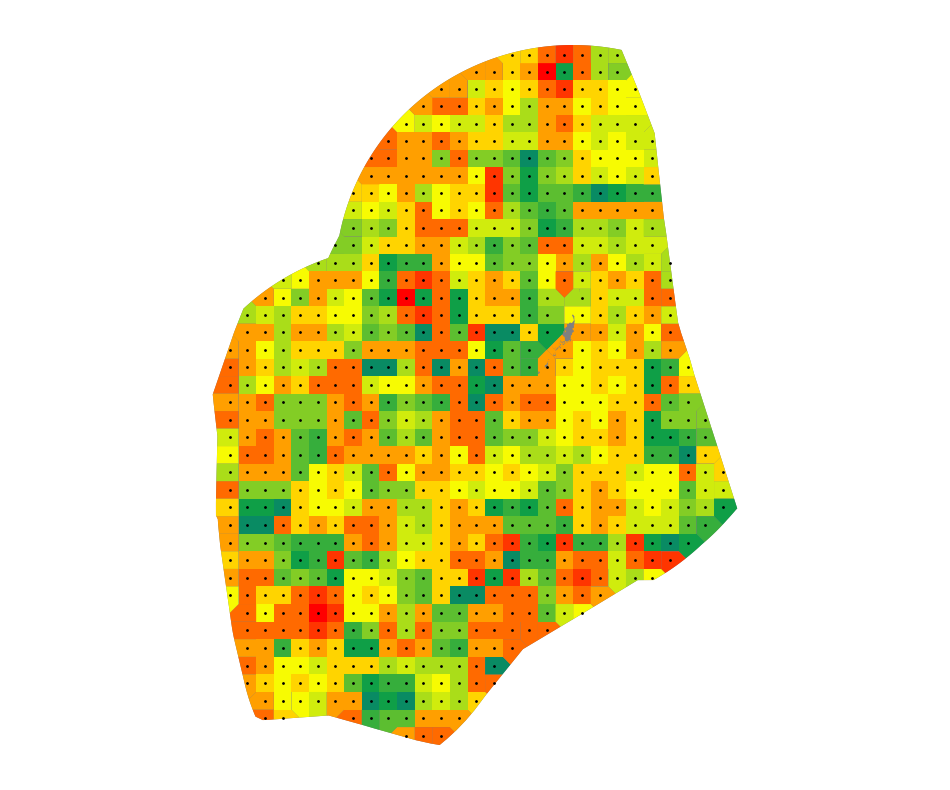

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2055_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


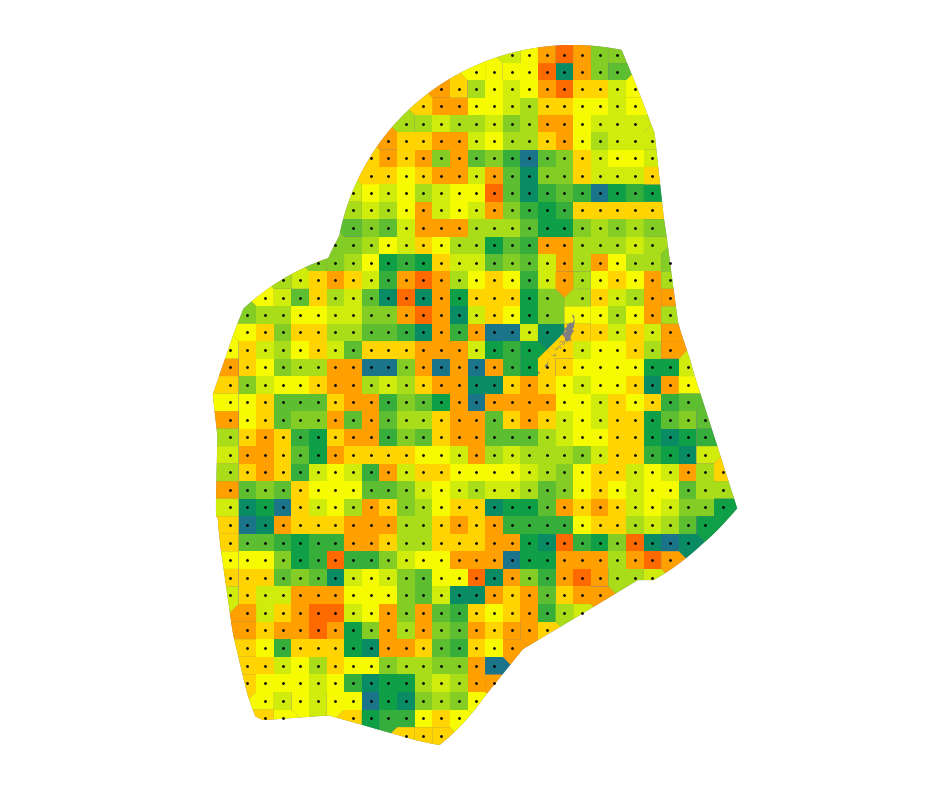

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2056_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


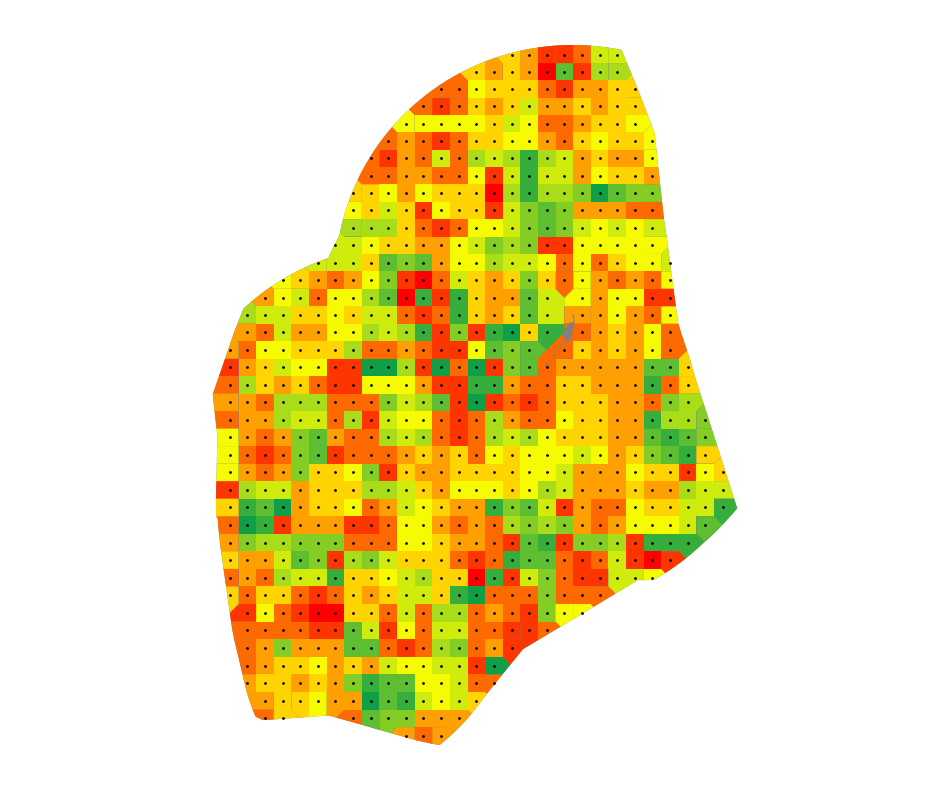

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2057_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


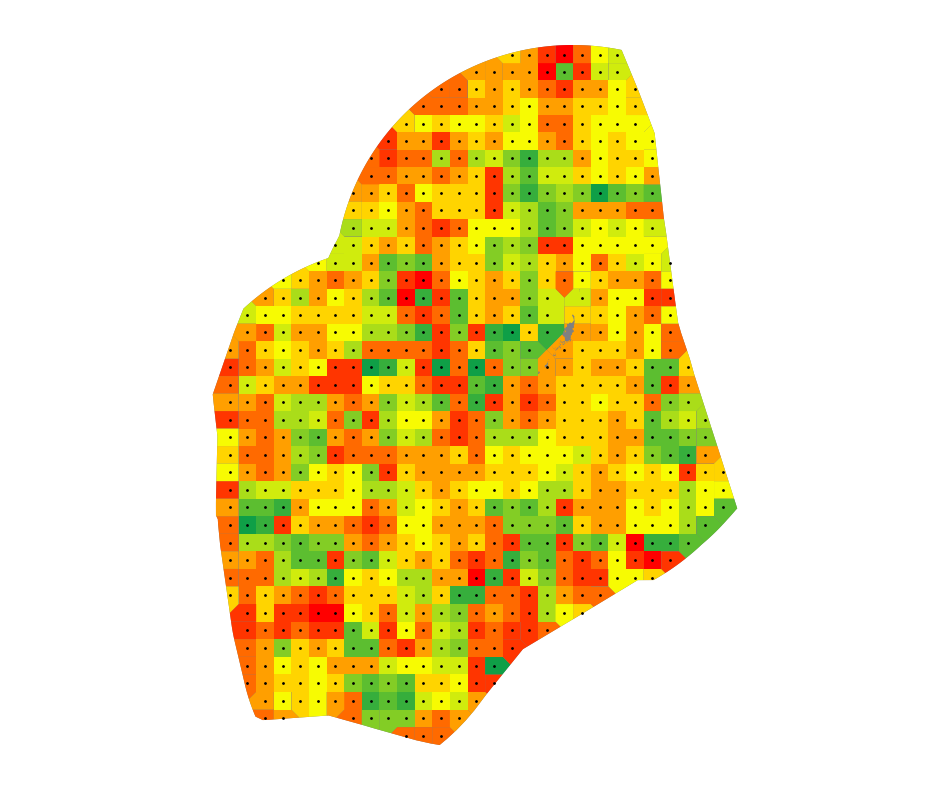

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2058_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


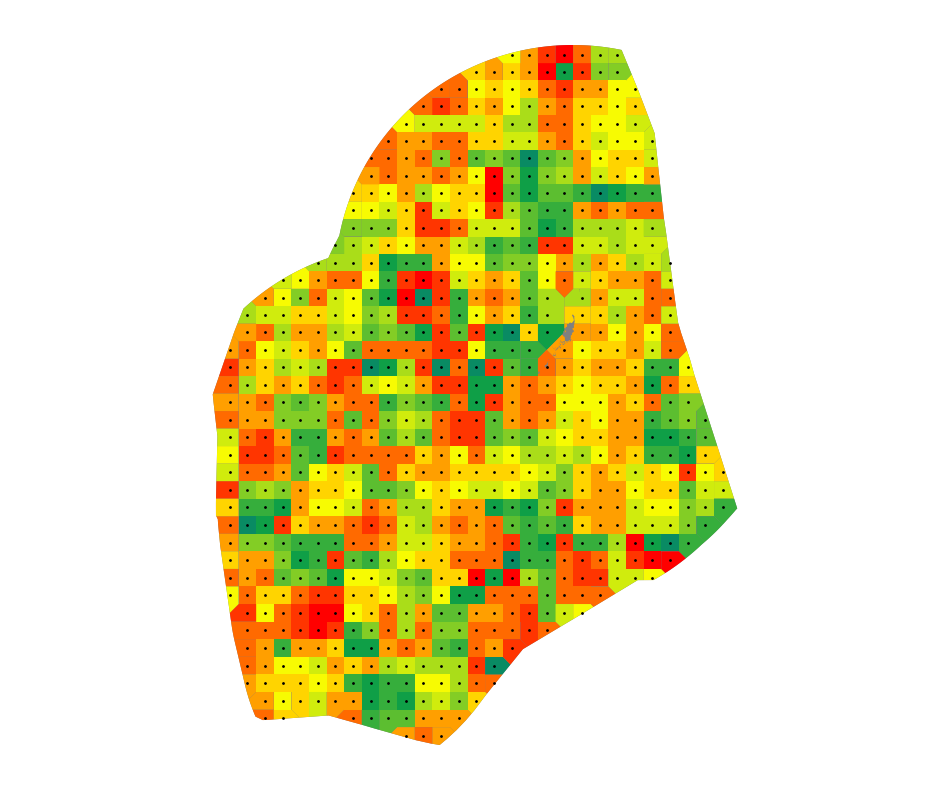

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2059_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


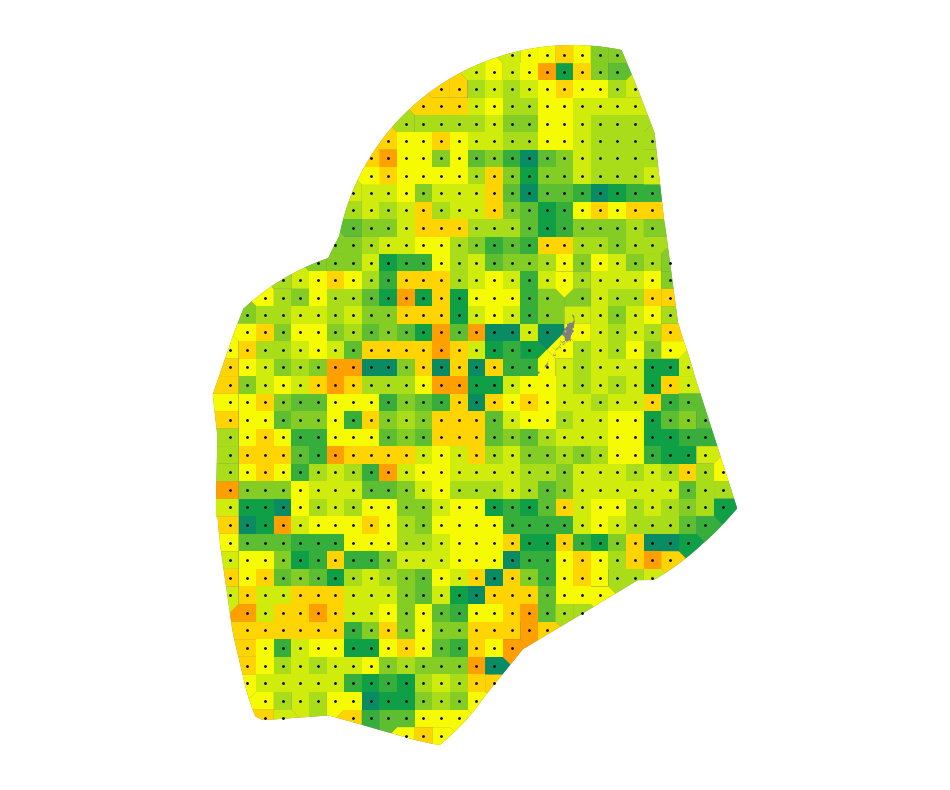

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2060_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


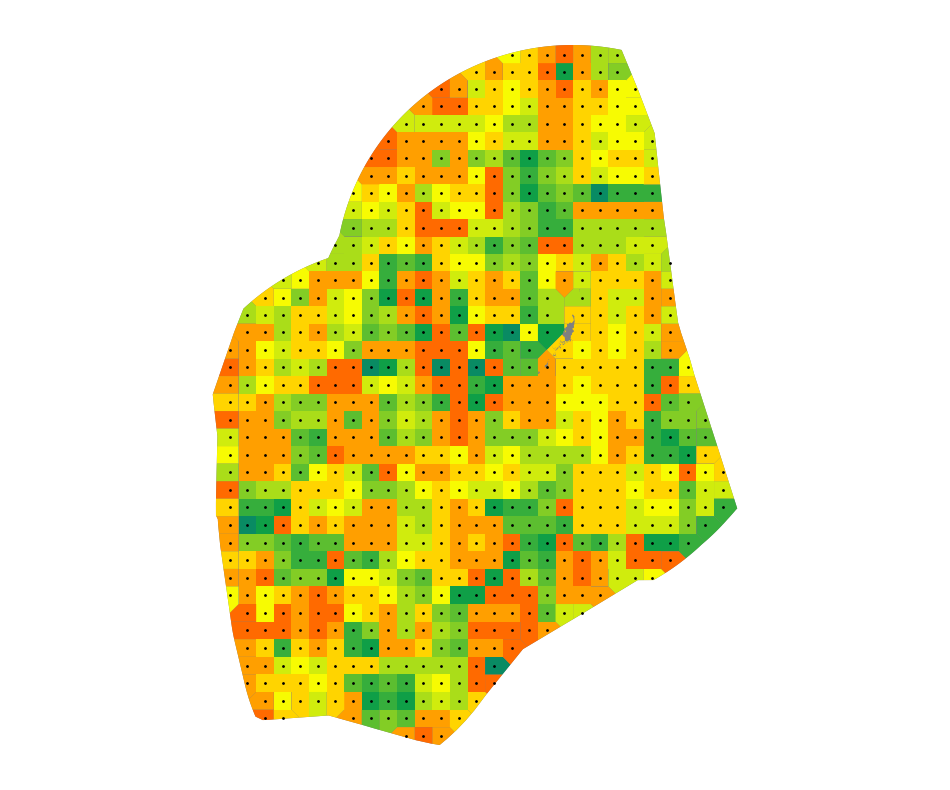

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2061_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


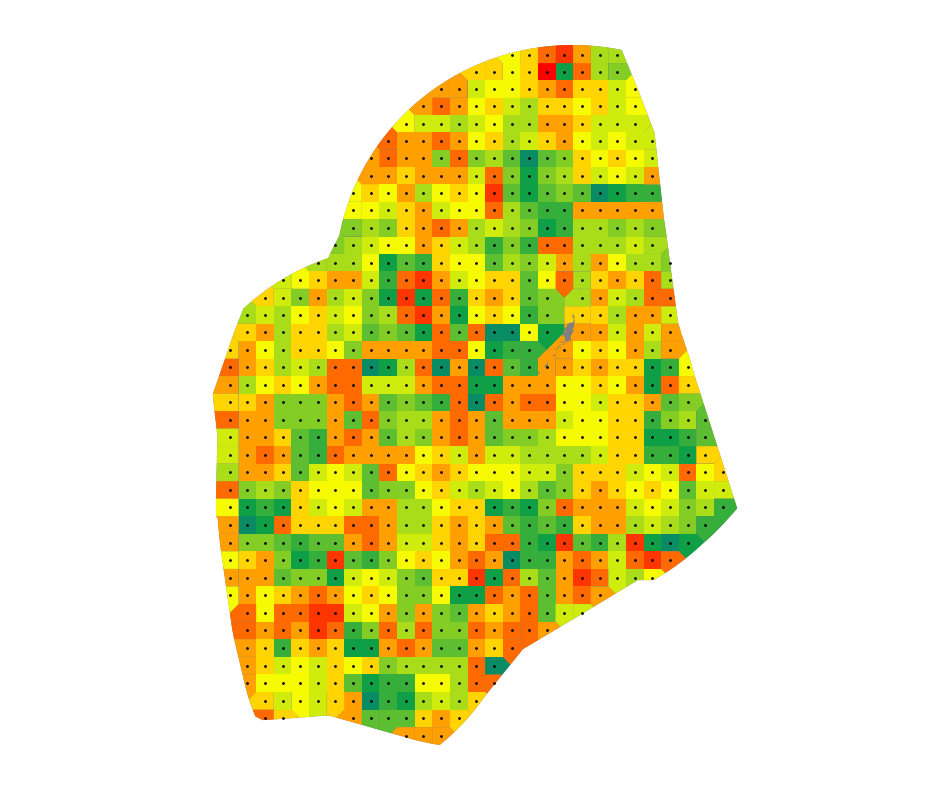

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2062_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


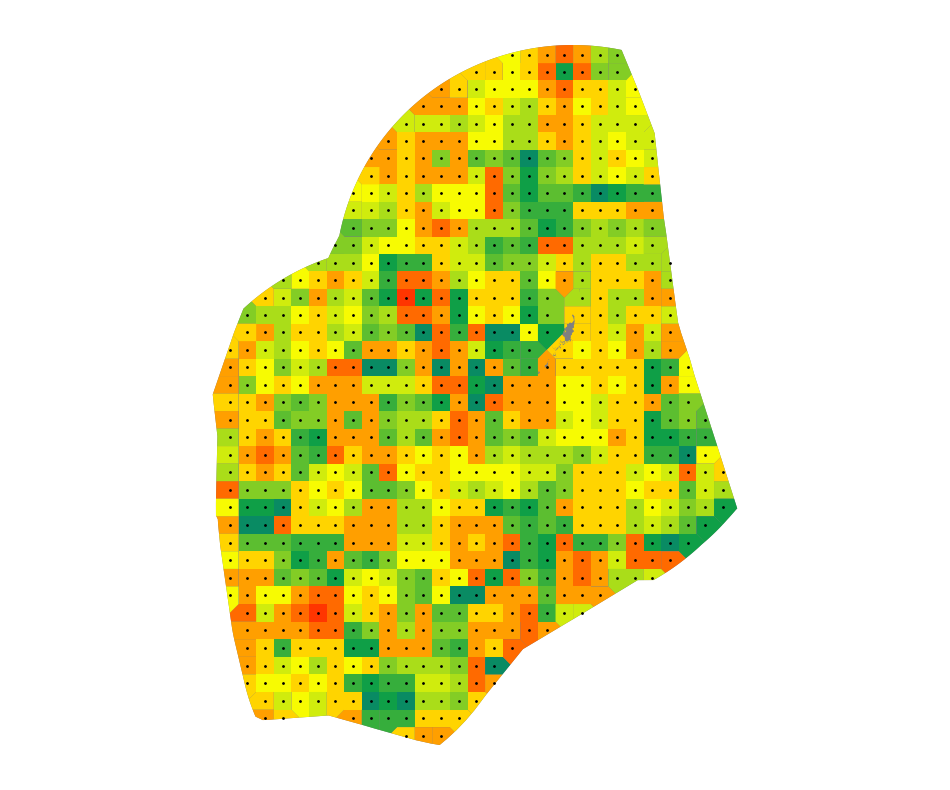

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2063_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


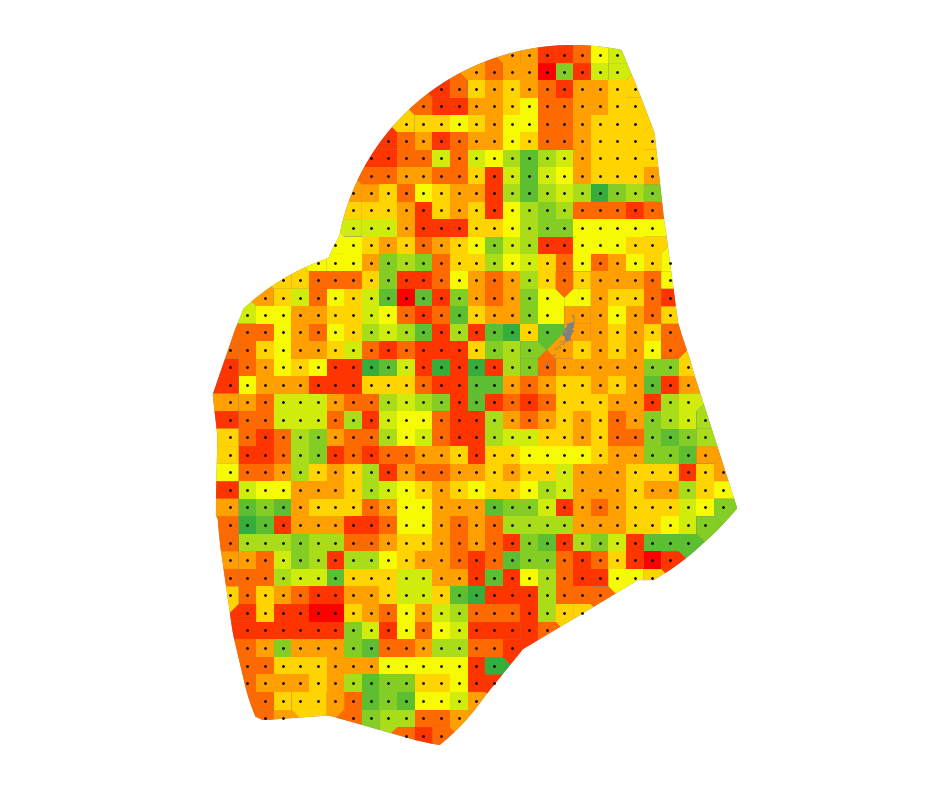

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2064_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


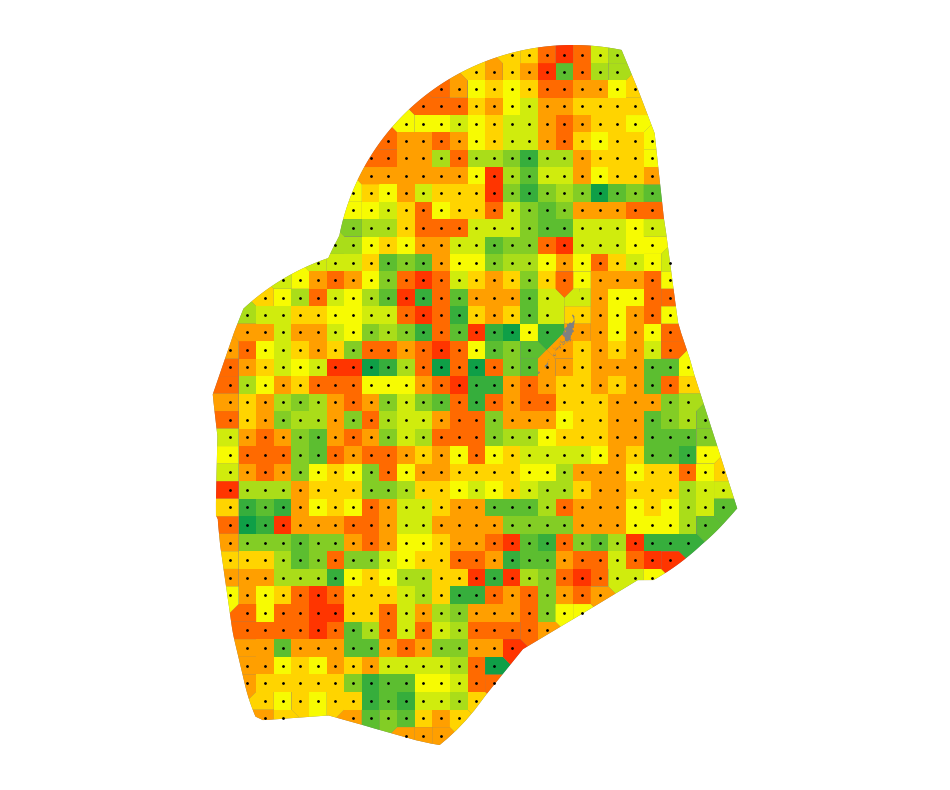

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2065_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


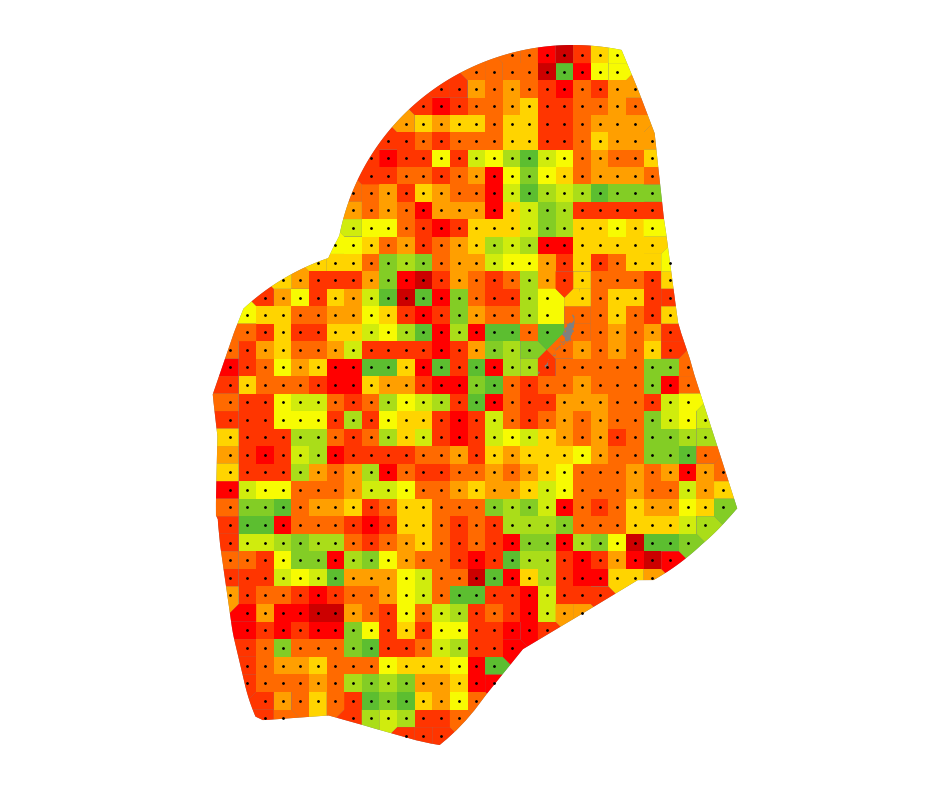

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2066_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


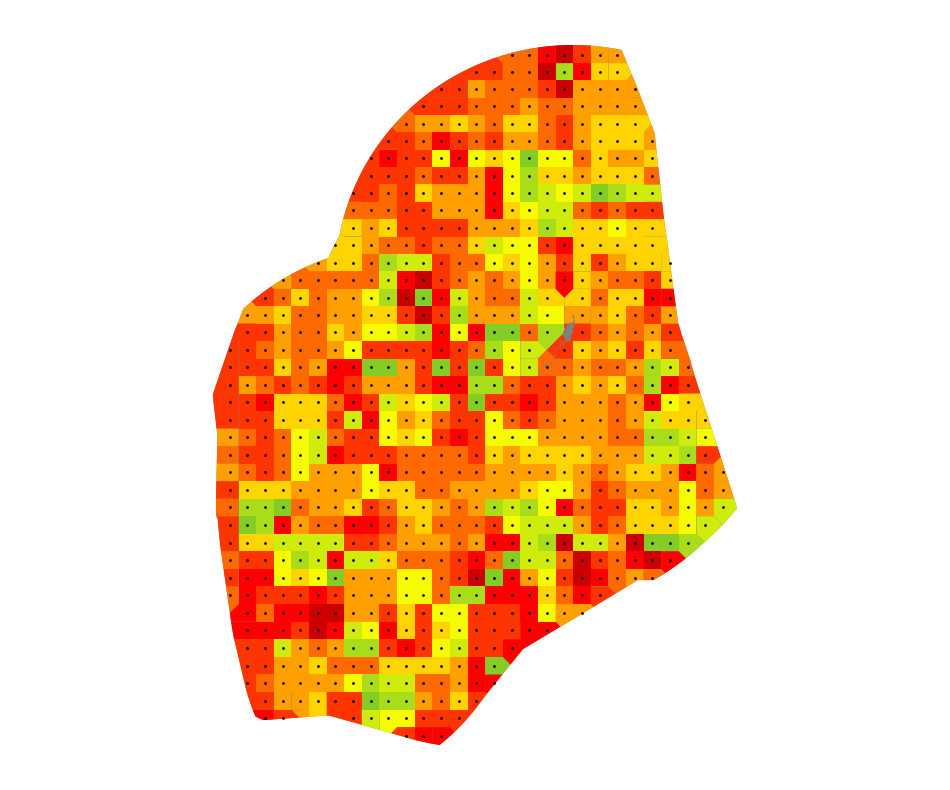

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2067_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


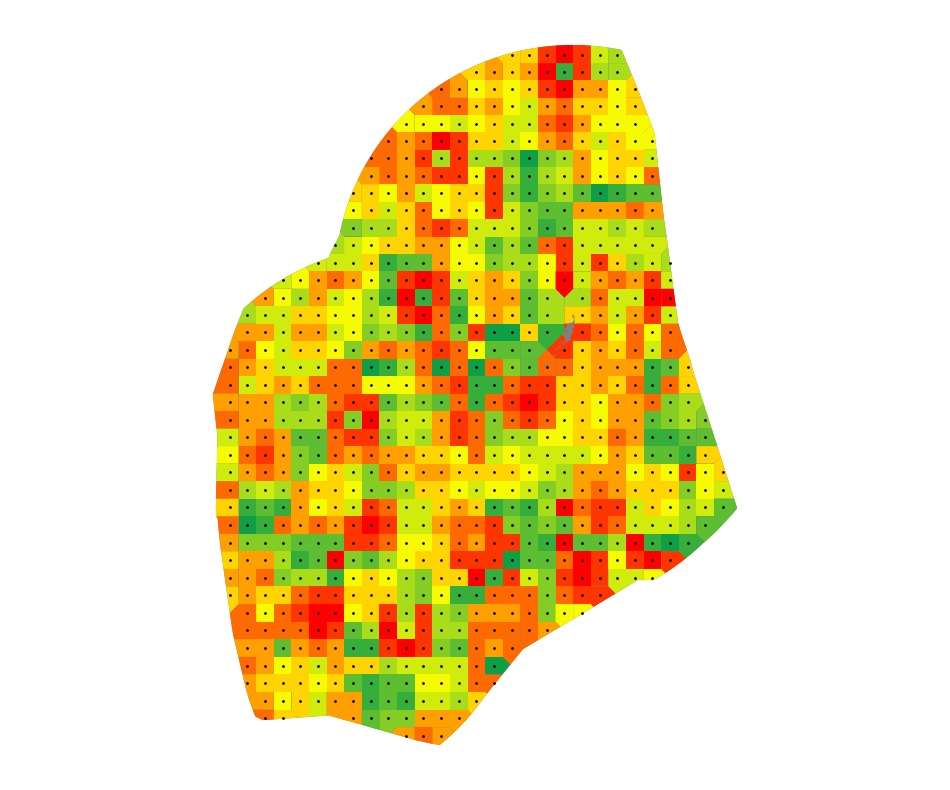

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2068_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


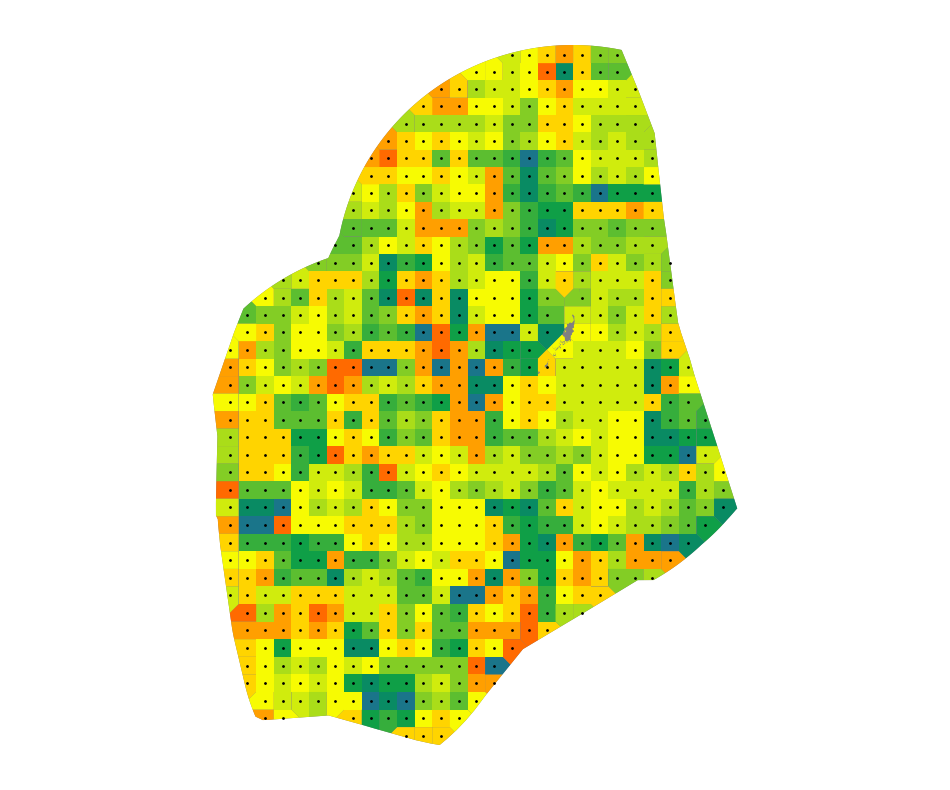

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2069_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


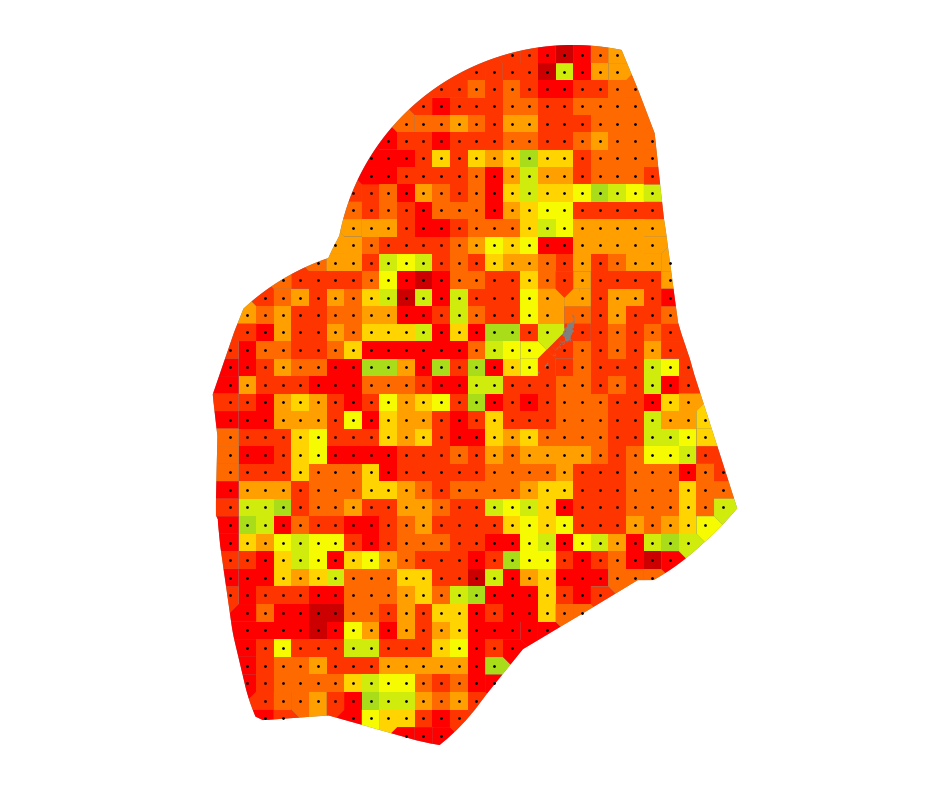

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2070_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


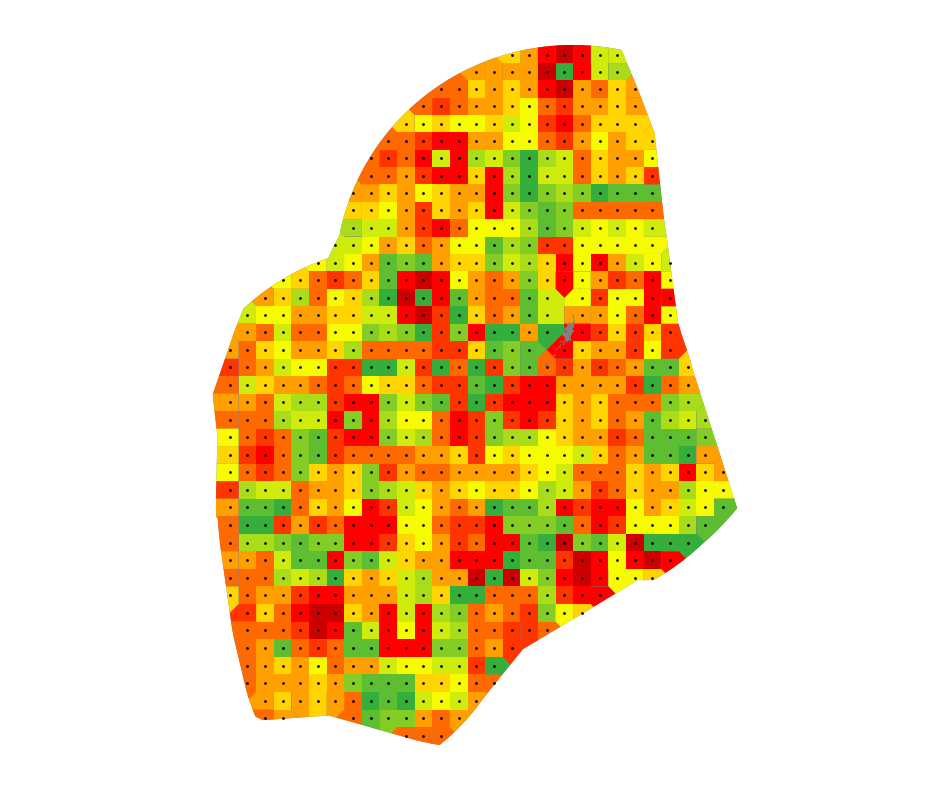

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2071_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


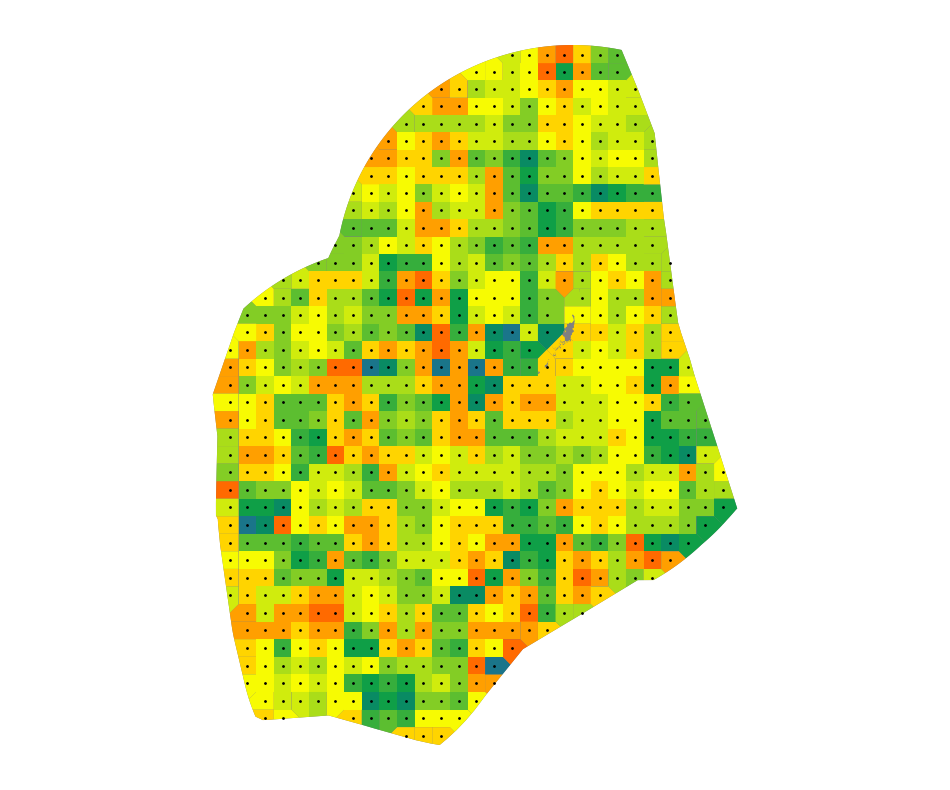

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2072_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


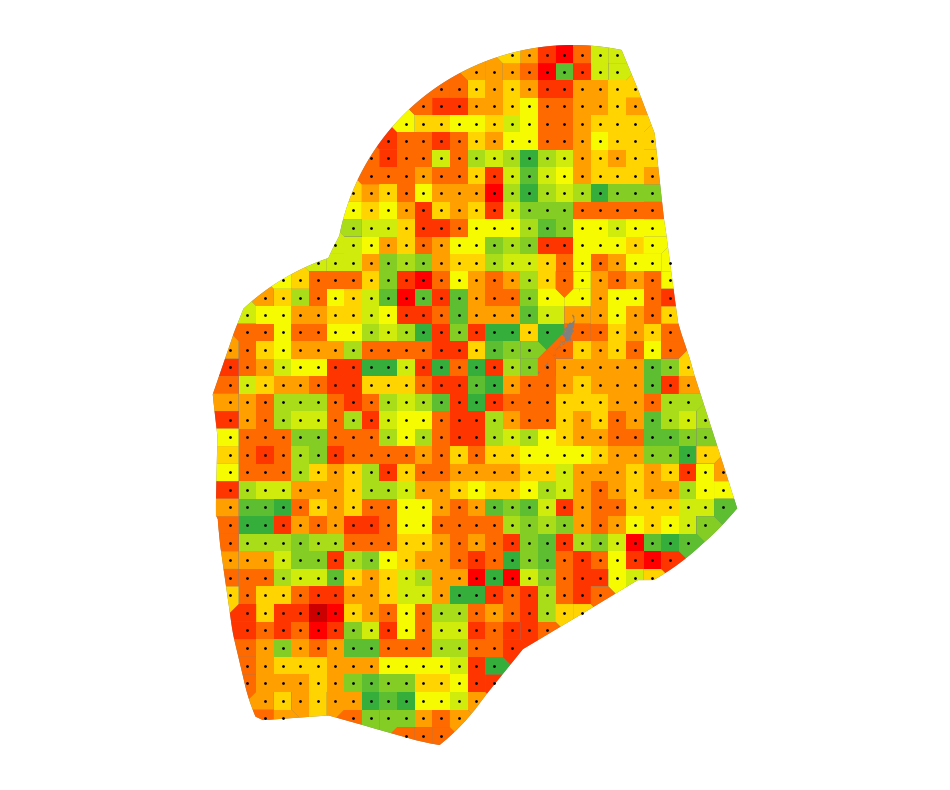

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2073_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


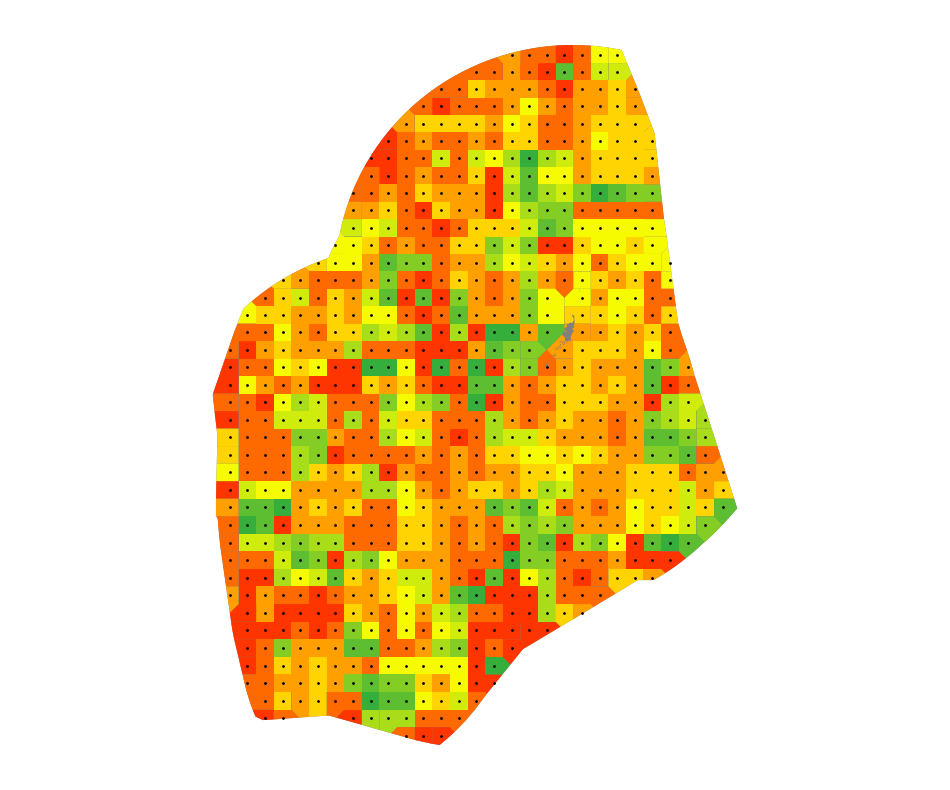

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2074_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


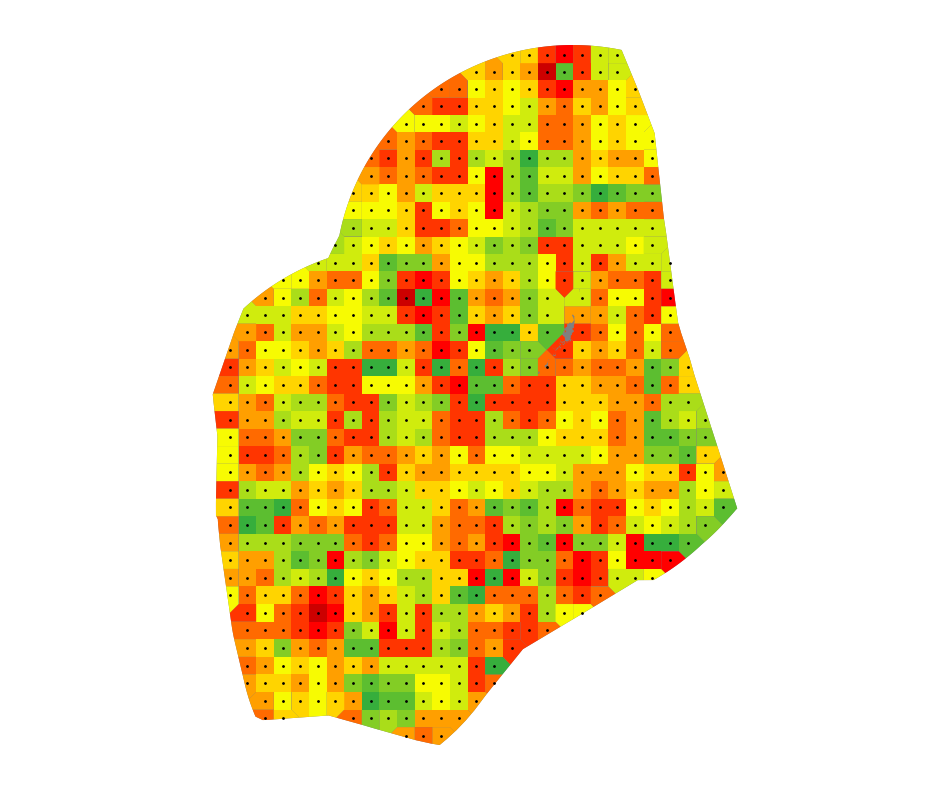

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2075_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


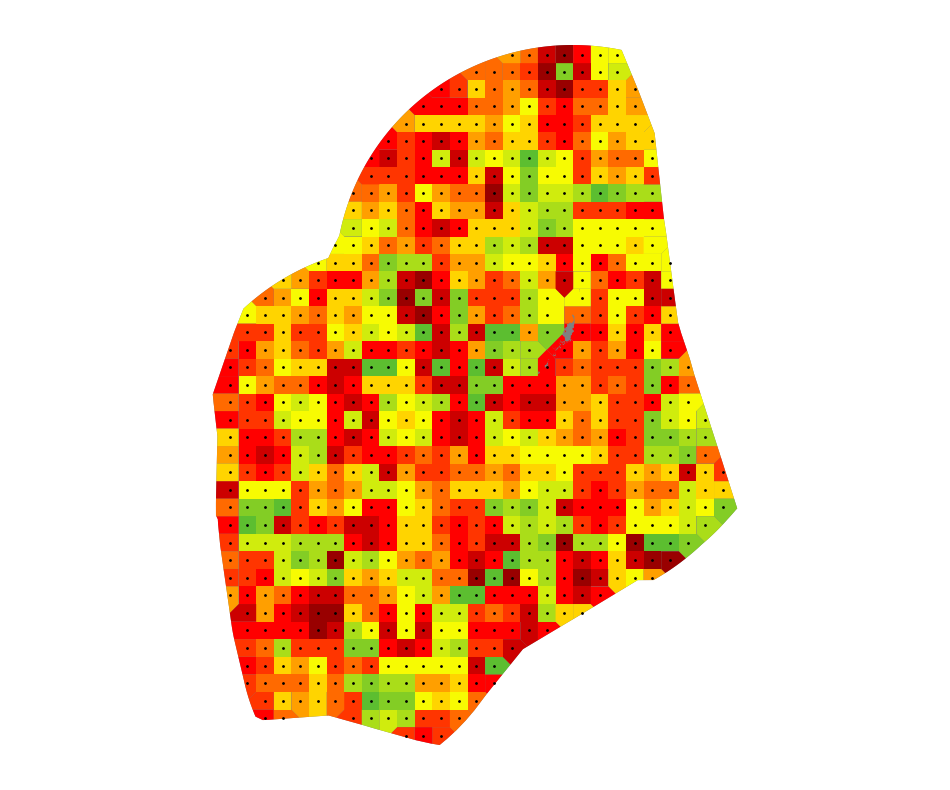

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2076_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


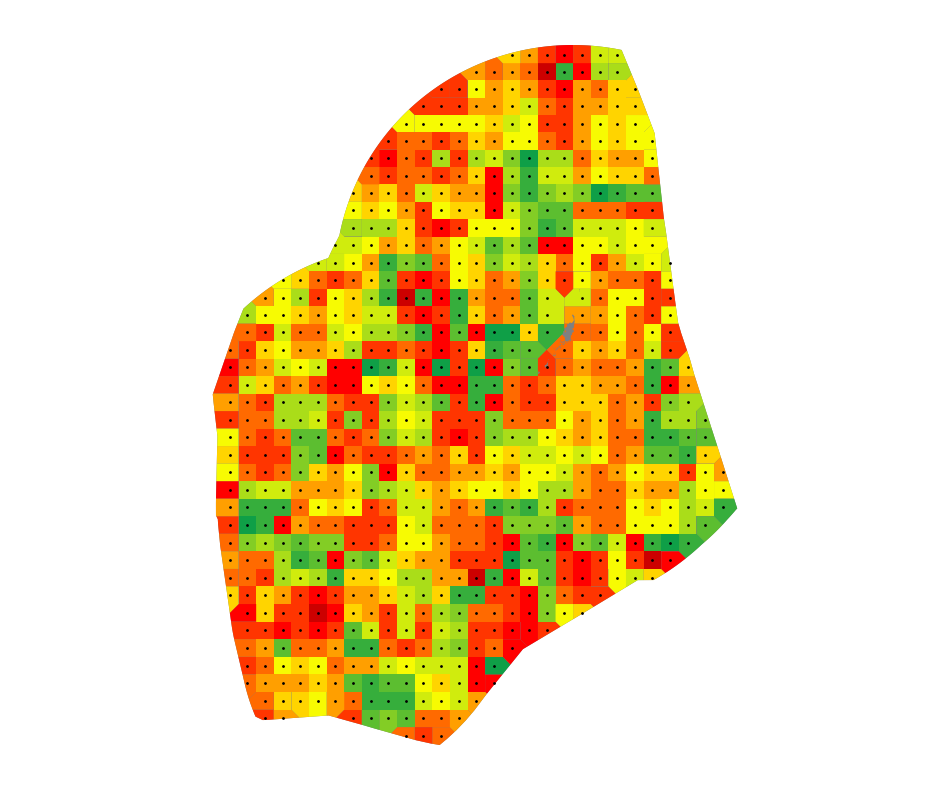

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2077_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


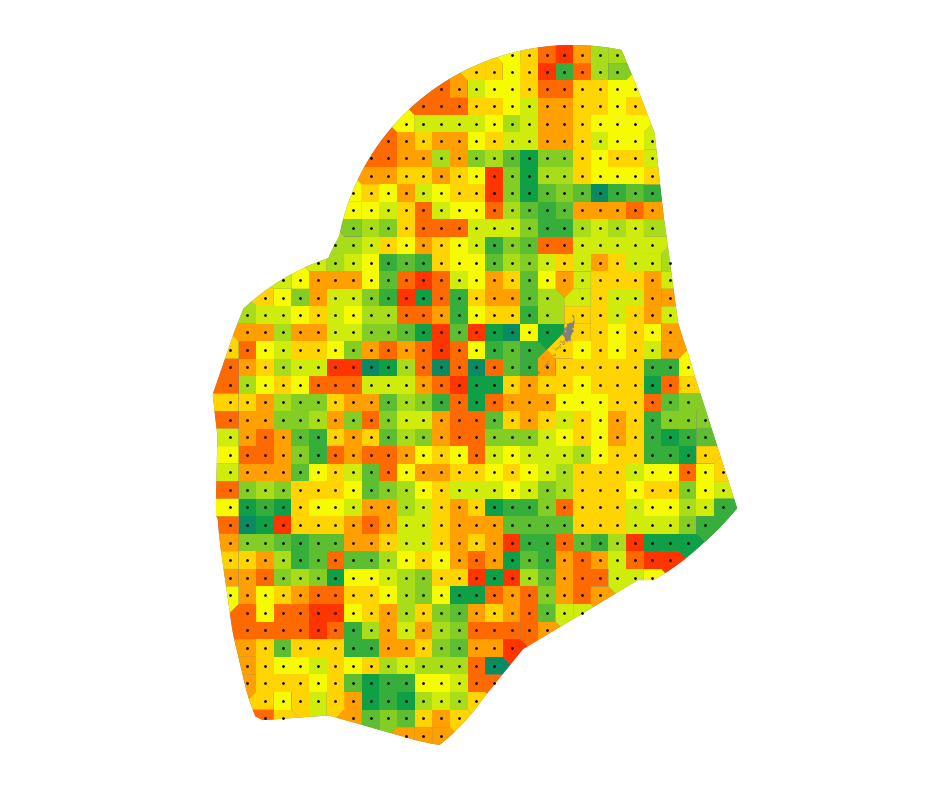

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2078_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


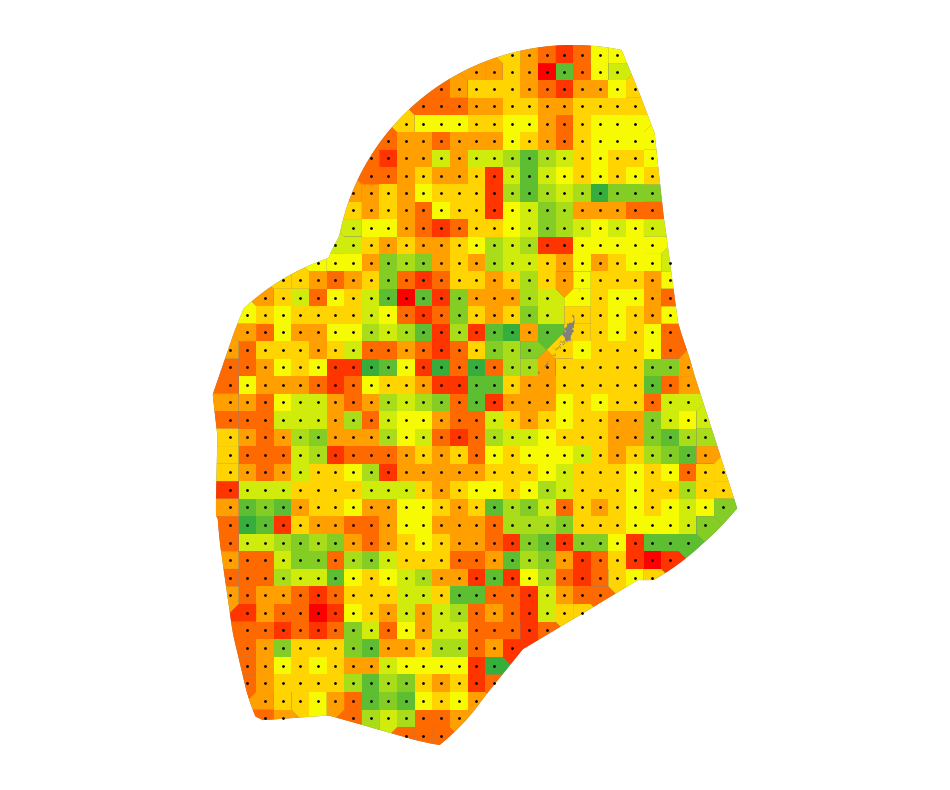

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2079_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


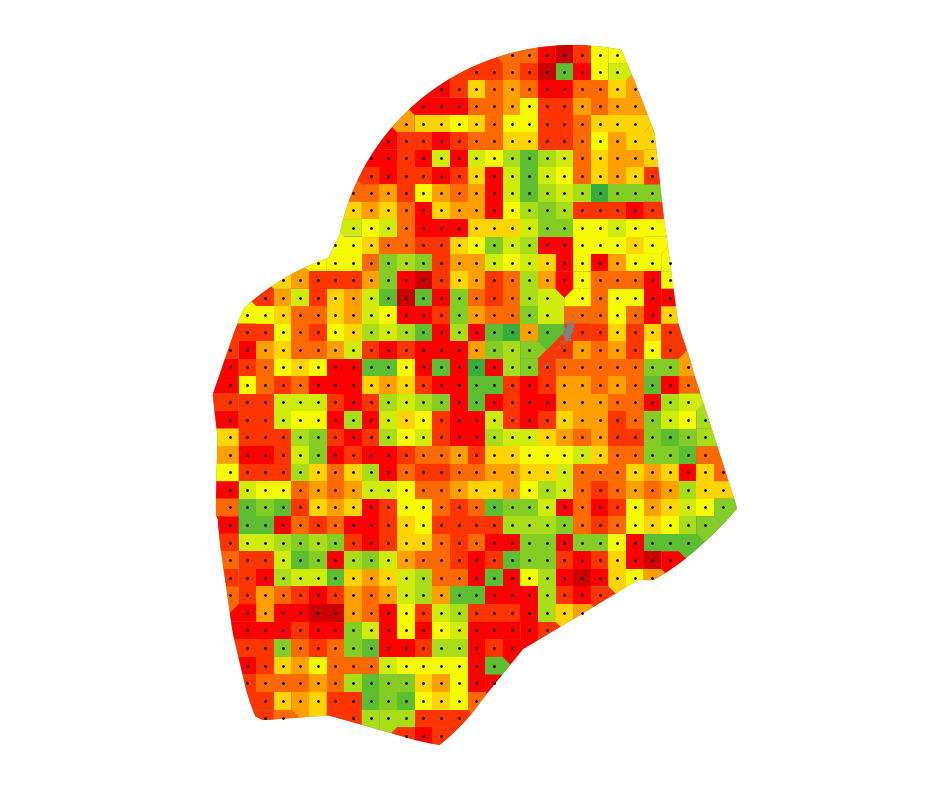

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2080_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


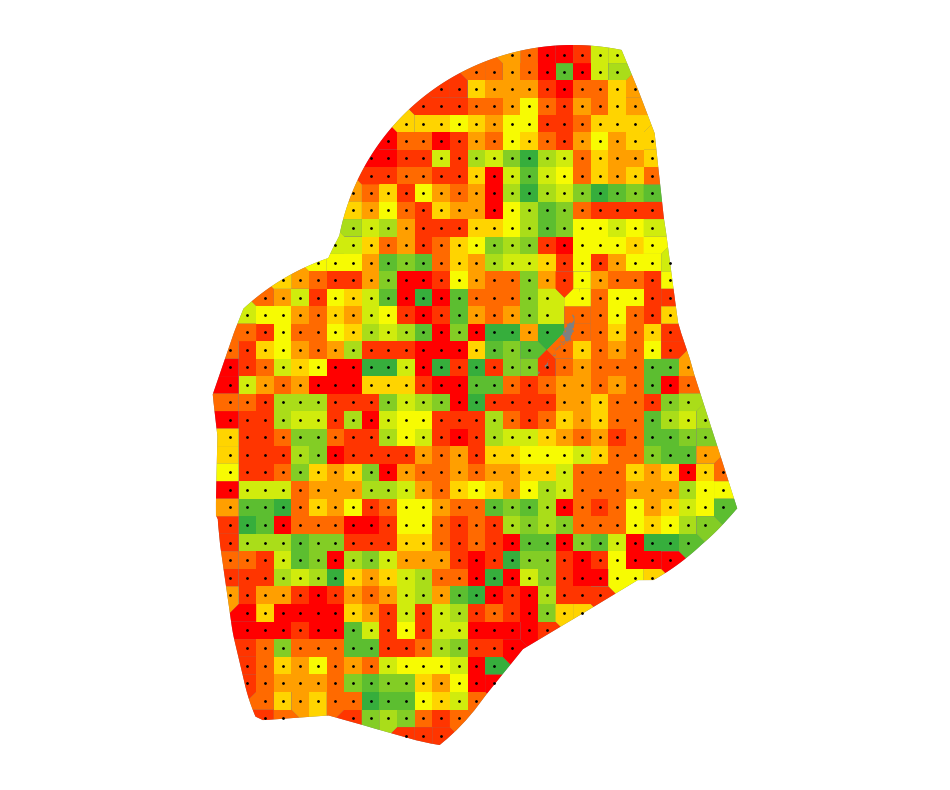

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2081_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


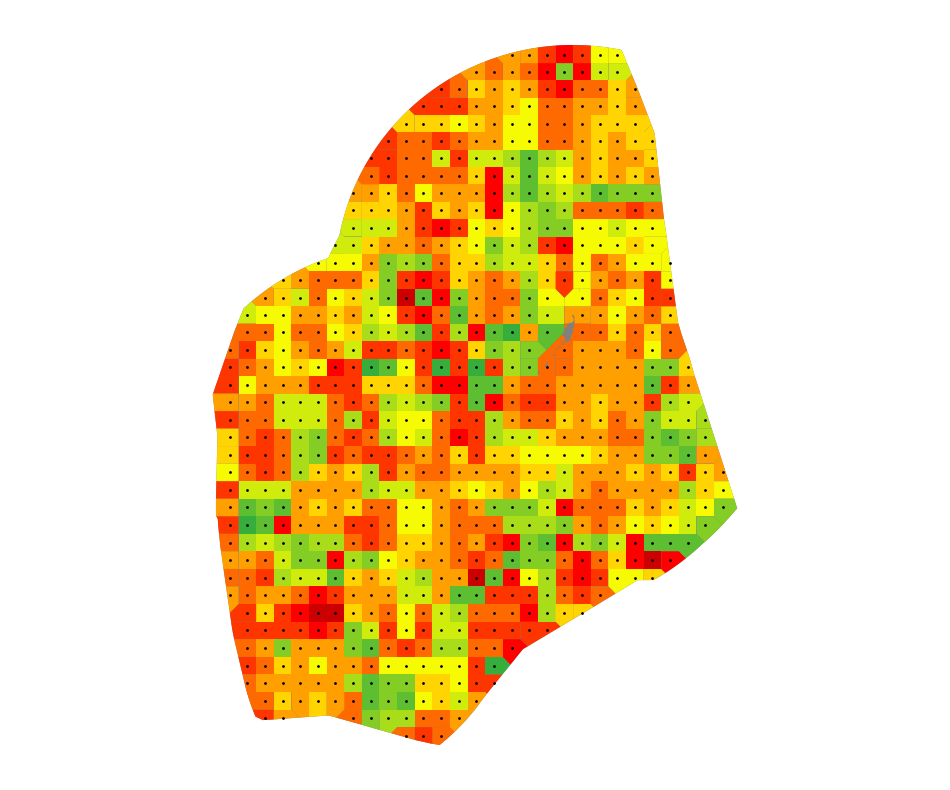

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2082_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


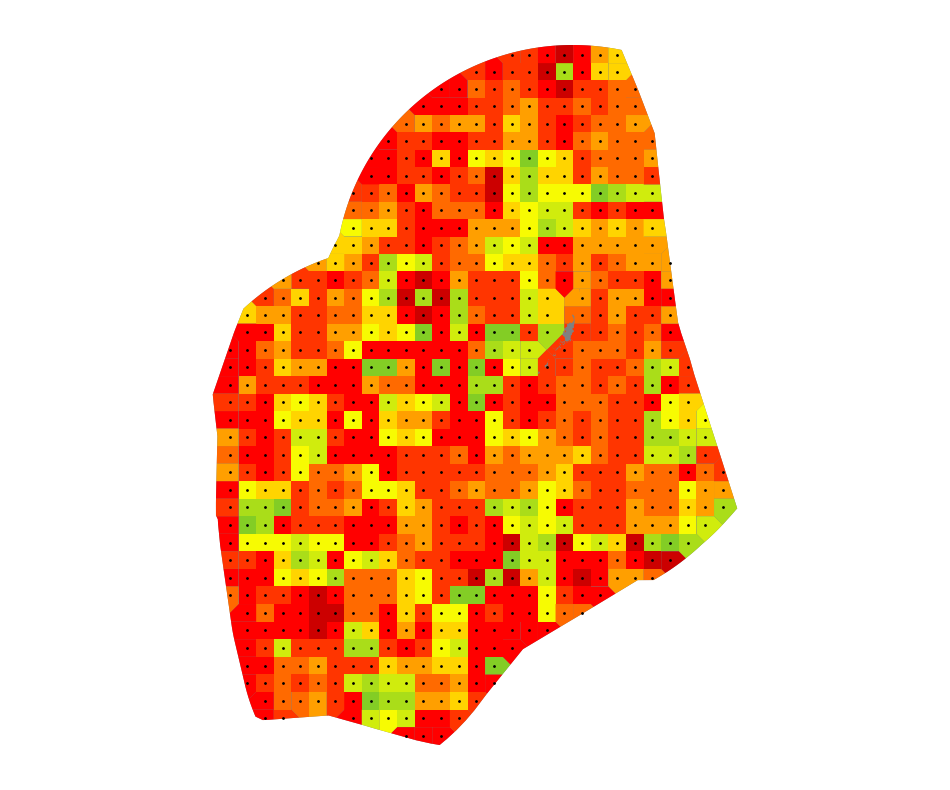

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2083_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


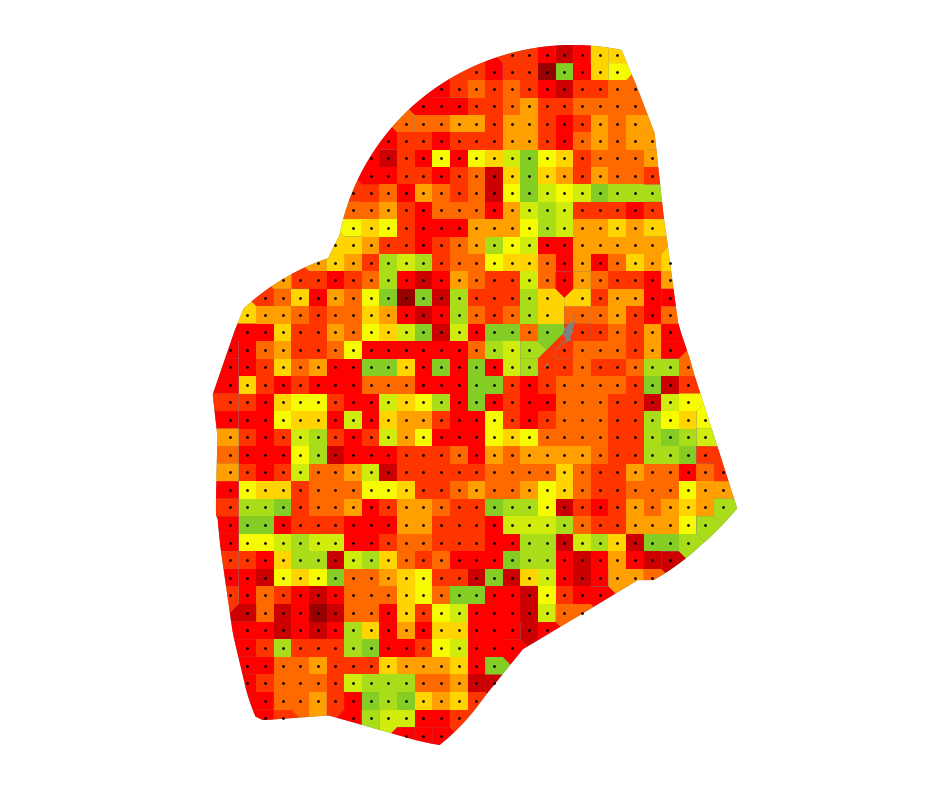

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2084_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


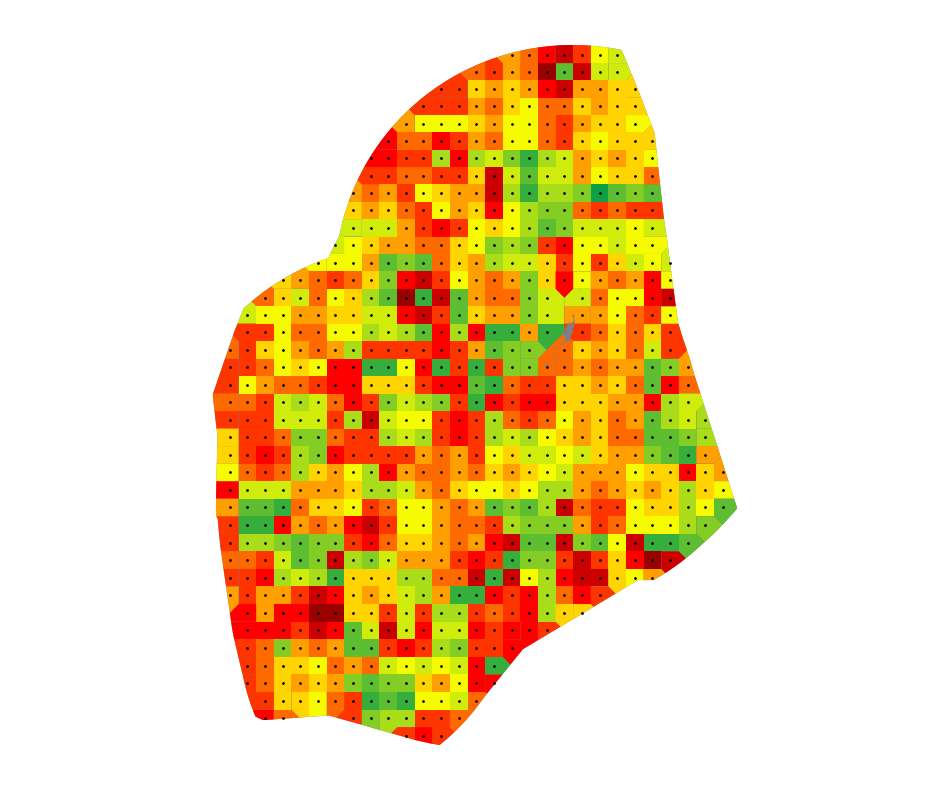

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2085_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


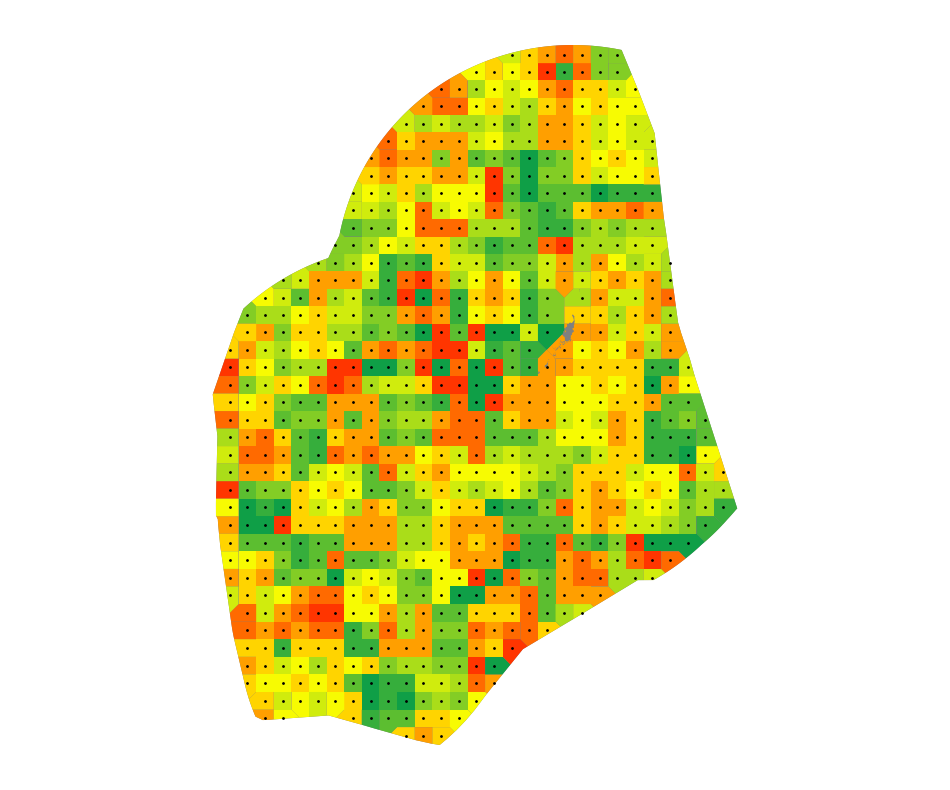

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2086_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


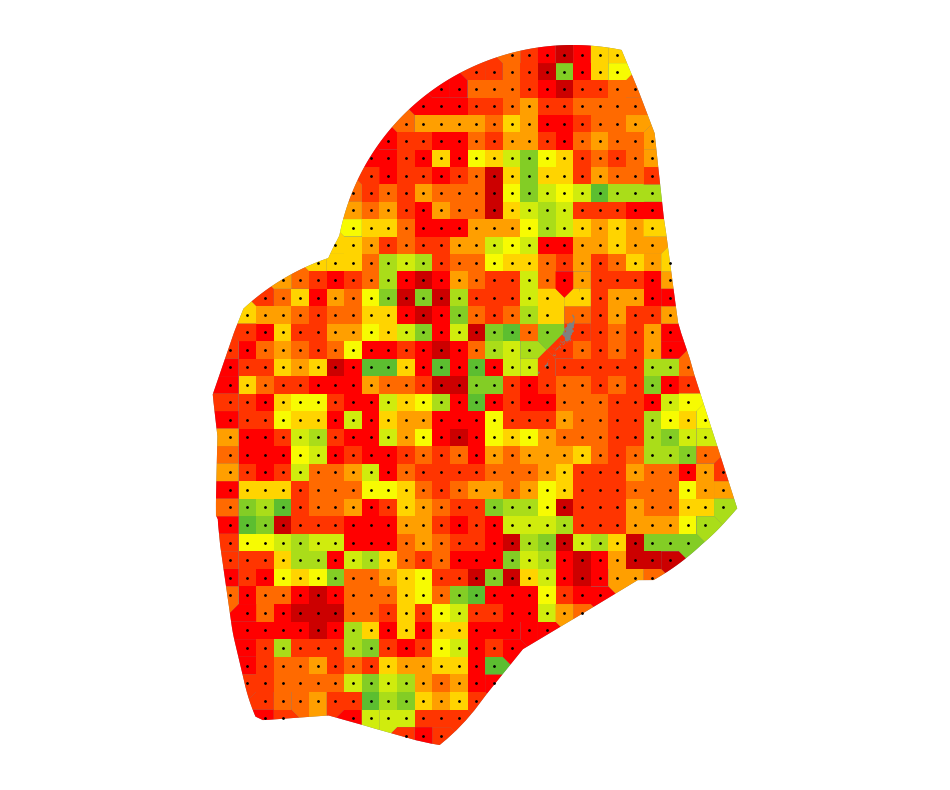

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2087_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


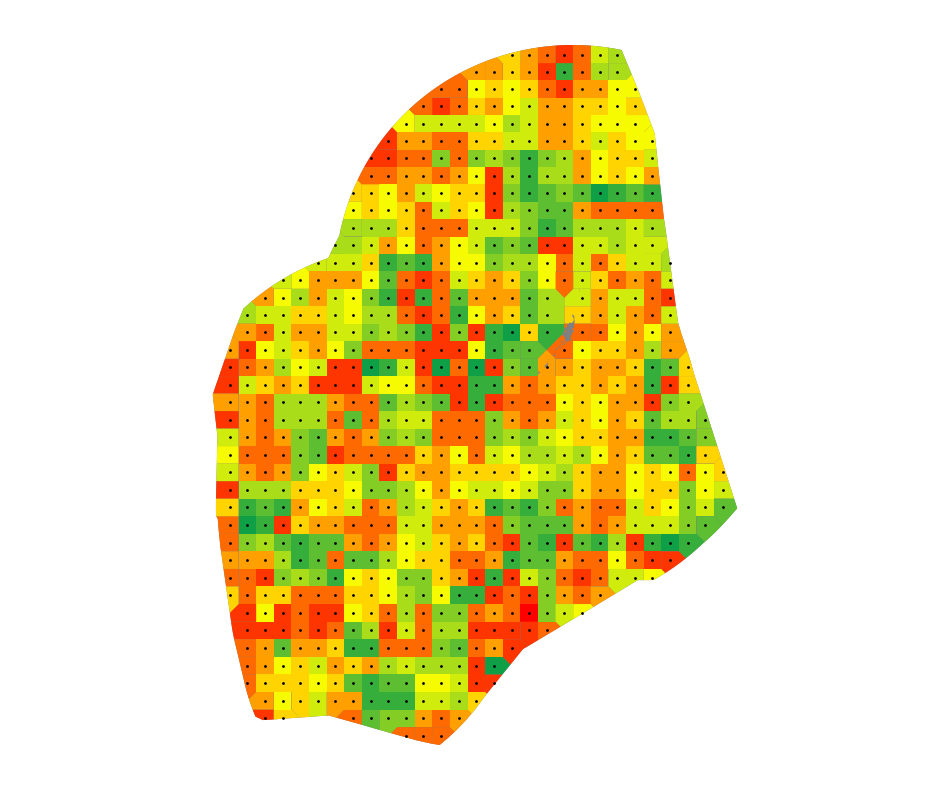

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2088_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


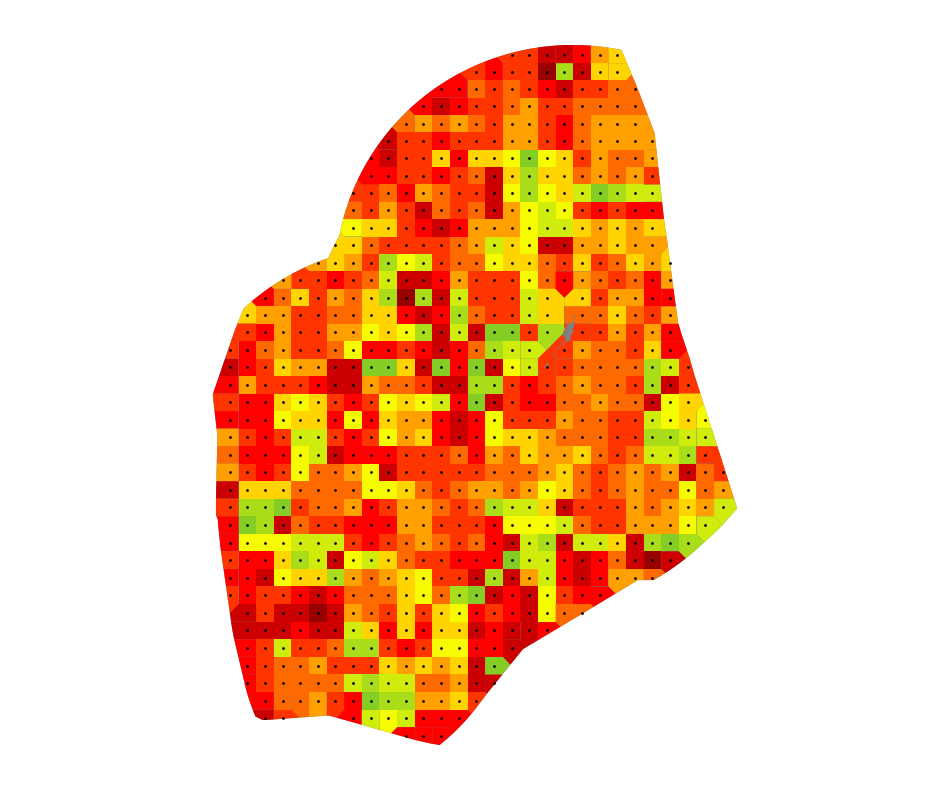

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2089_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


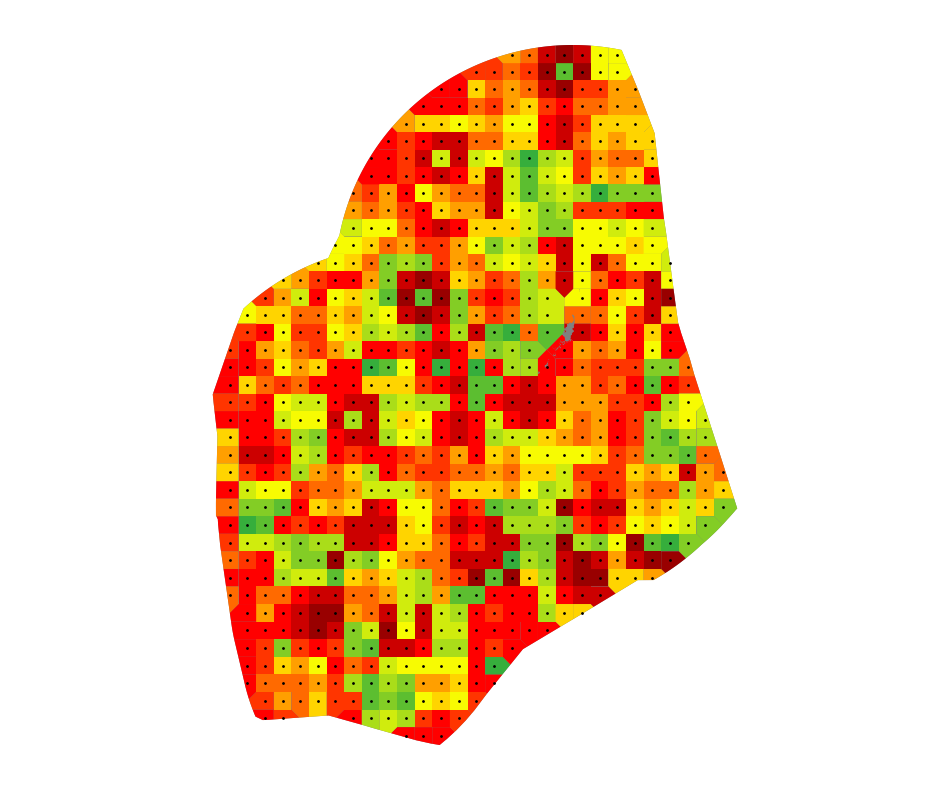

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2090_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


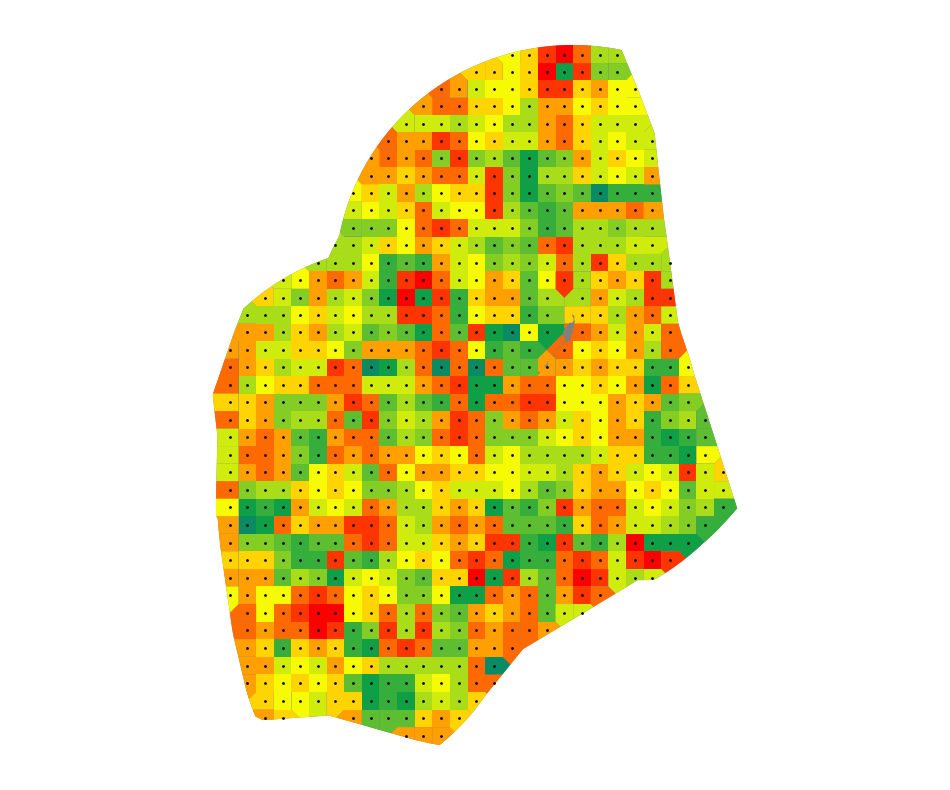

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2091_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


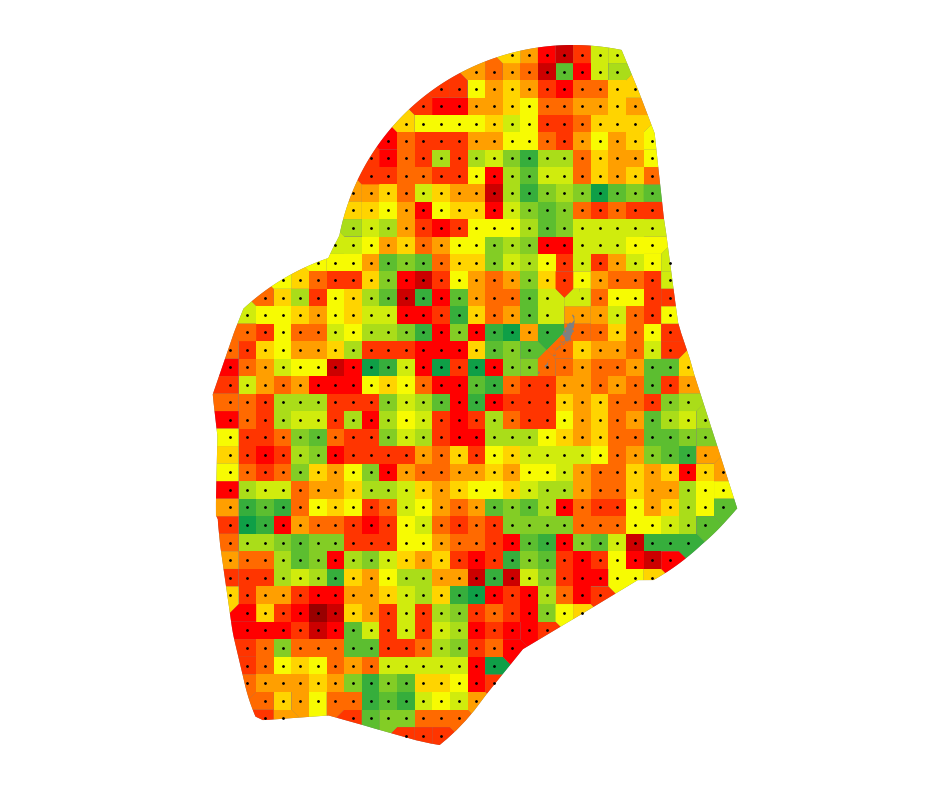

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2092_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


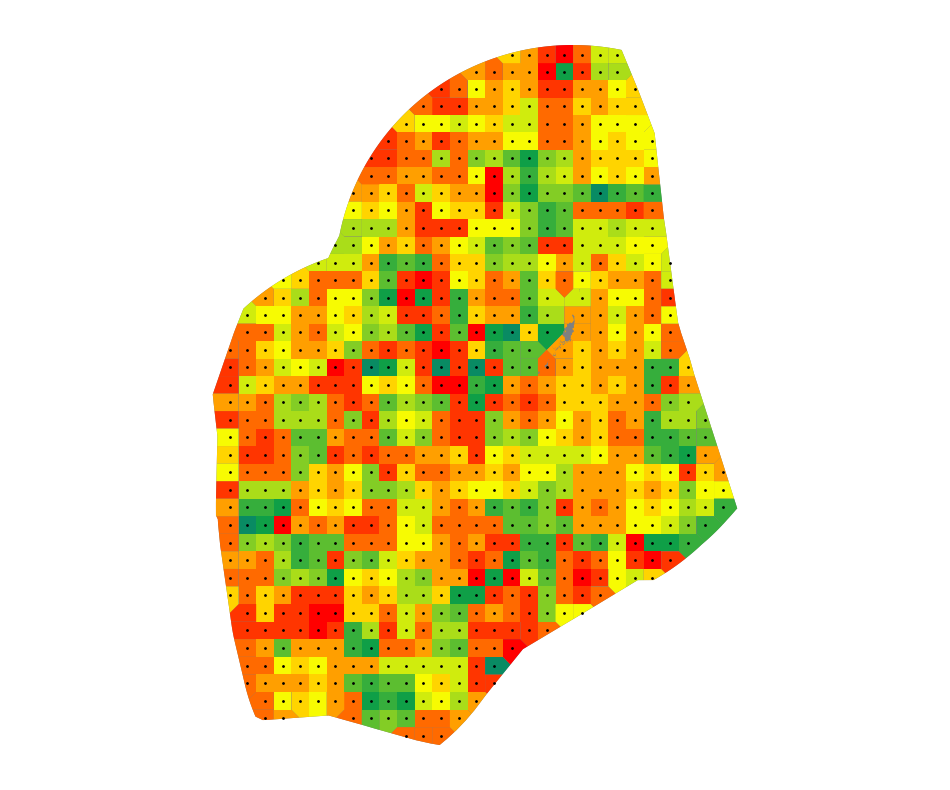

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2093_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


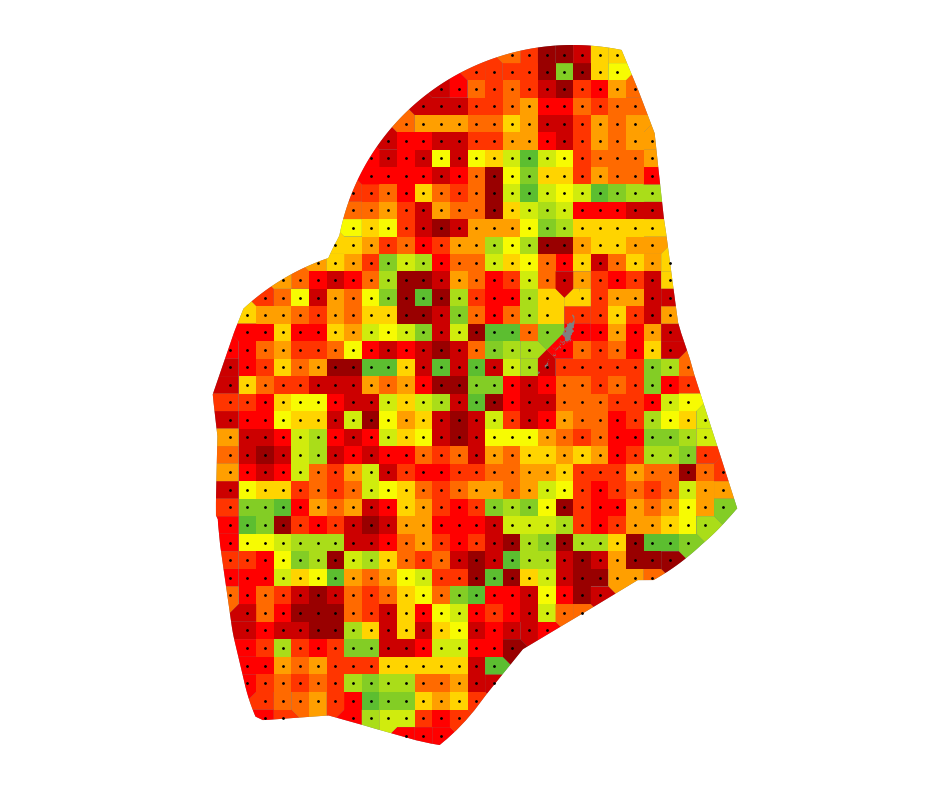

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2094_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


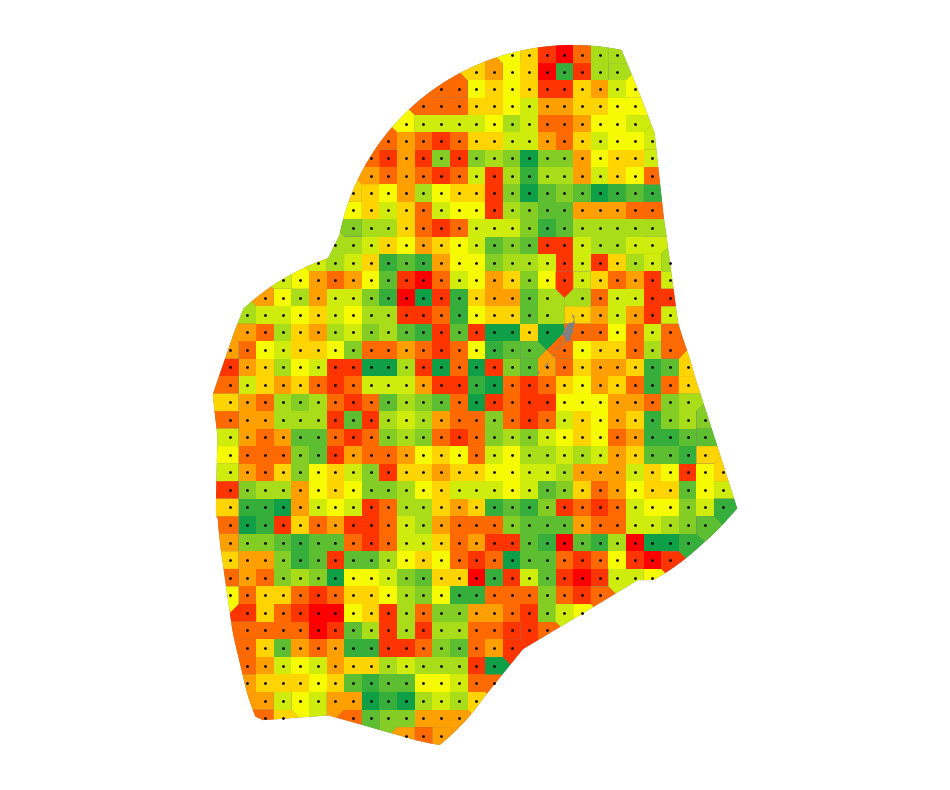

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2095_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


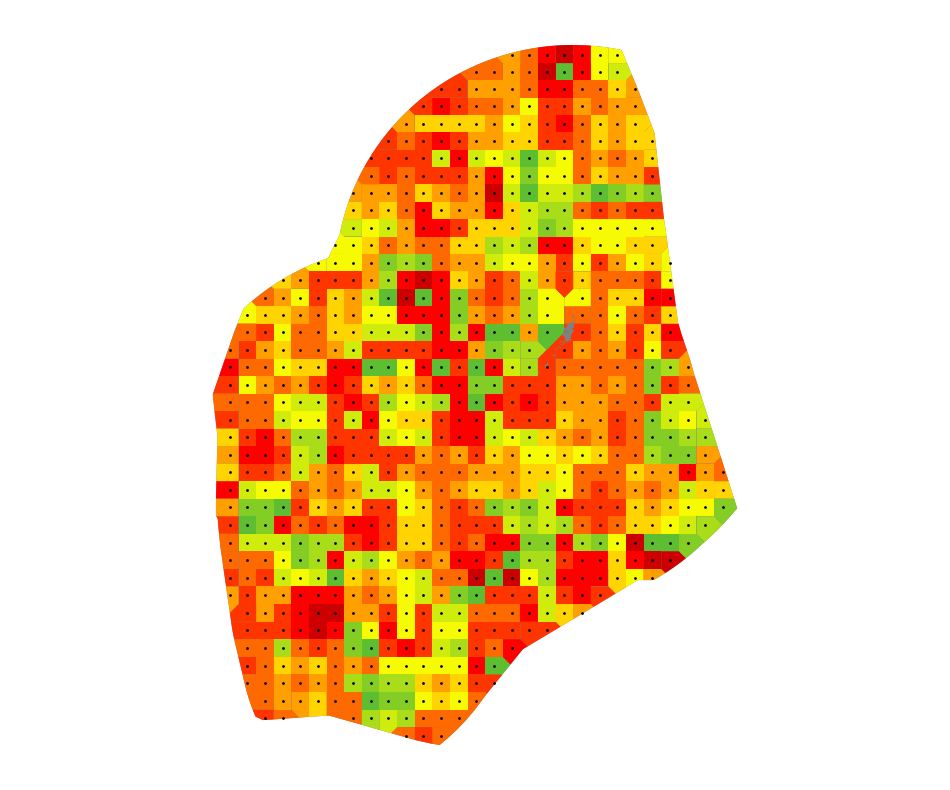

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2096_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


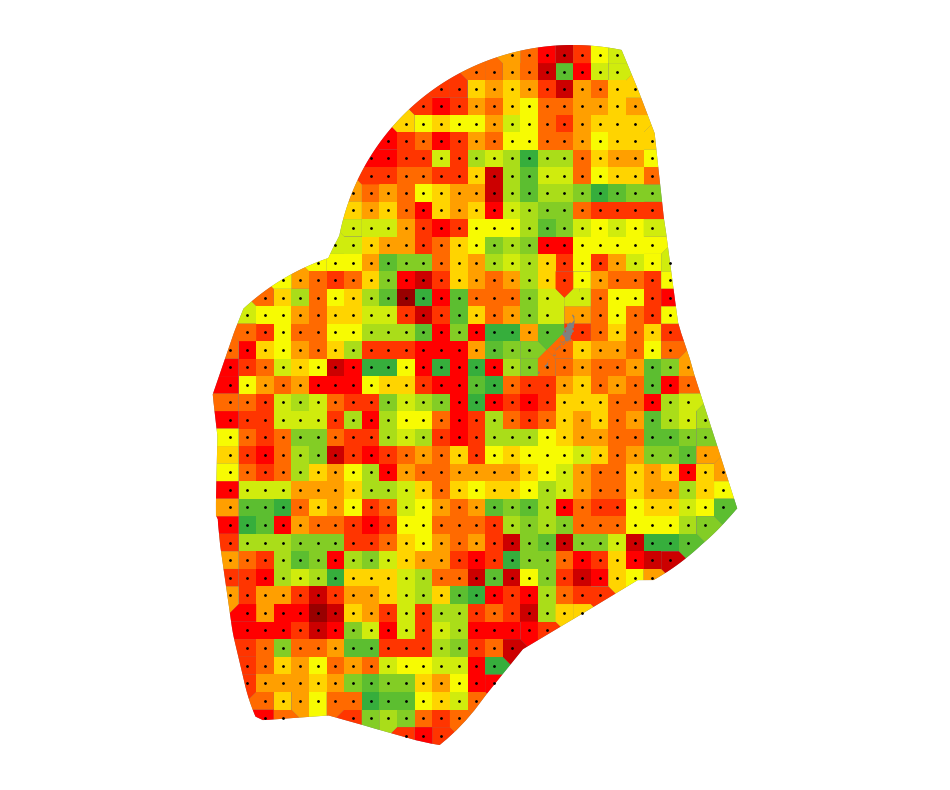

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2097_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


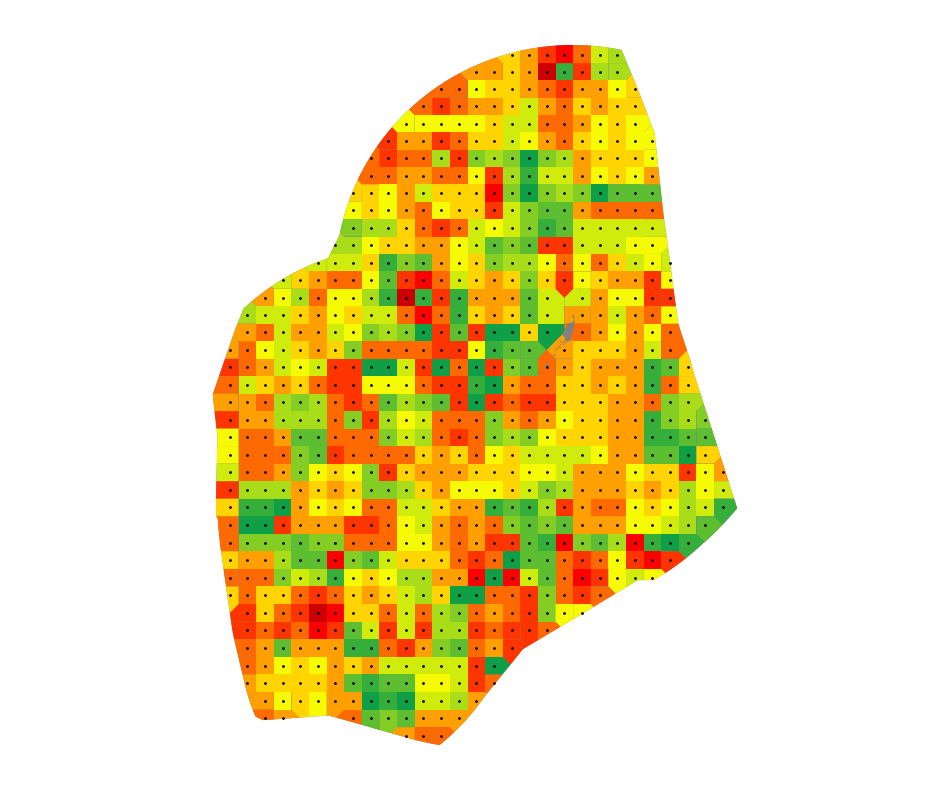

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2098_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


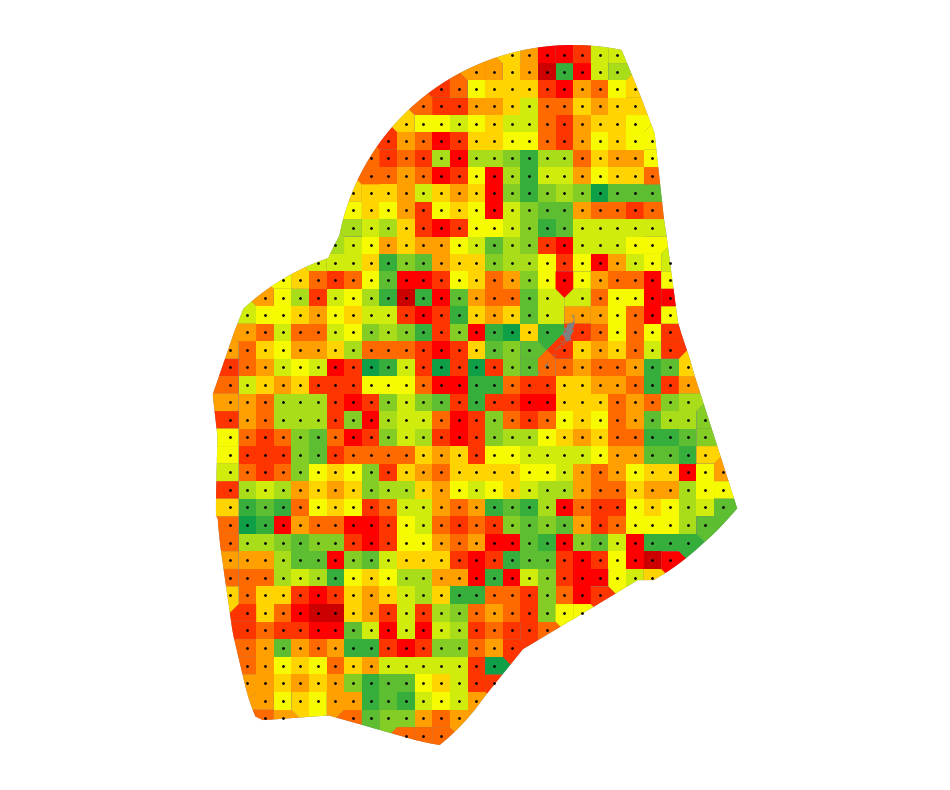

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2099_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


/var/folders/d6/w300s4cx3qj10pqdcy5859bc0000gn/T/ipykernel_95764/473759963.py:131: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3395
Right CRS: EPSG:4326

  trimmed = gpd.overlay(json_gdf,palau_land, how='difference')


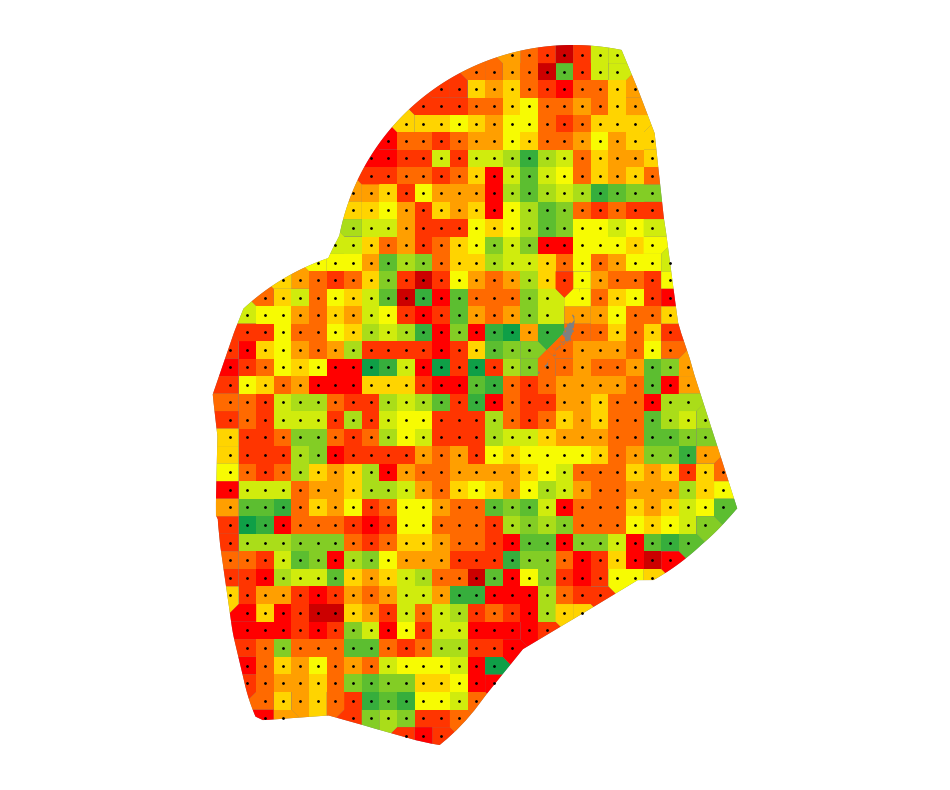

/Users/one/Documents/tosgeojson//tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3/2100_tos_Omon_HadGEM3-GC31-MM_ssp126_r1i1p1f3.json


In [239]:
folder = os.getcwd() + '/latlon/'

geojson_folder = os.getcwd() + '/tosgeojson/'
if not os.path.exists(geojson_folder):
    os.makedirs(geojson_folder)
    
colorbar_folder = os.getcwd() + '/colorbar/'
if not os.path.exists(colorbar_folder):
    os.makedirs(colorbar_folder)
    
for source in ['CanESM5','HadGEM3-GC31-MM']:
    for experiment in experiment_dict[source]:
        print(source, experiment)
        file = [x for x in sources[source] if x[0]== 'tos' and x[1] == experiment][0][2]
        print(file)
        experiment_folder = geojson_folder + "/" + file[7:-5] + "/"
        if not os.path.exists(experiment_folder):
            os.makedirs(experiment_folder)
            
        colorbar_ex_folder = colorbar_folder + "/" + file[7:-5] + "/"
        if not os.path.exists(colorbar_ex_folder):
            os.makedirs(colorbar_ex_folder)
        
        
        df = pd.read_pickle(folder + file)
        df = df.dropna()
        df = df.reset_index()
        
        df = palau_eez(df)
        
        
        

        year_range = str(min(df['year'].tolist())) + "-" + str(max(df['year'].tolist()))
        colorbar_name = year_range + "_colorbar" + "_" + file[7:-5] + ".png"
        
        colorbar_mpl(df, colorbar_ex_folder + colorbar_name)
        print("Created: " +colorbar_name)
        for year in sorted(set(df['year'].tolist())):
            currgeo = getGridGeoJSON(year,df)
            json_object = json.dumps(currgeo, indent=4)
            
            geojson_dir = experiment_folder + str(year) + "_" + file[7:-5] +".json"
            with open(geojson_dir, "w") as outfile:
                outfile.write(json_object)
                print(geojson_dir)


In [ ]:
#Below is scratch work

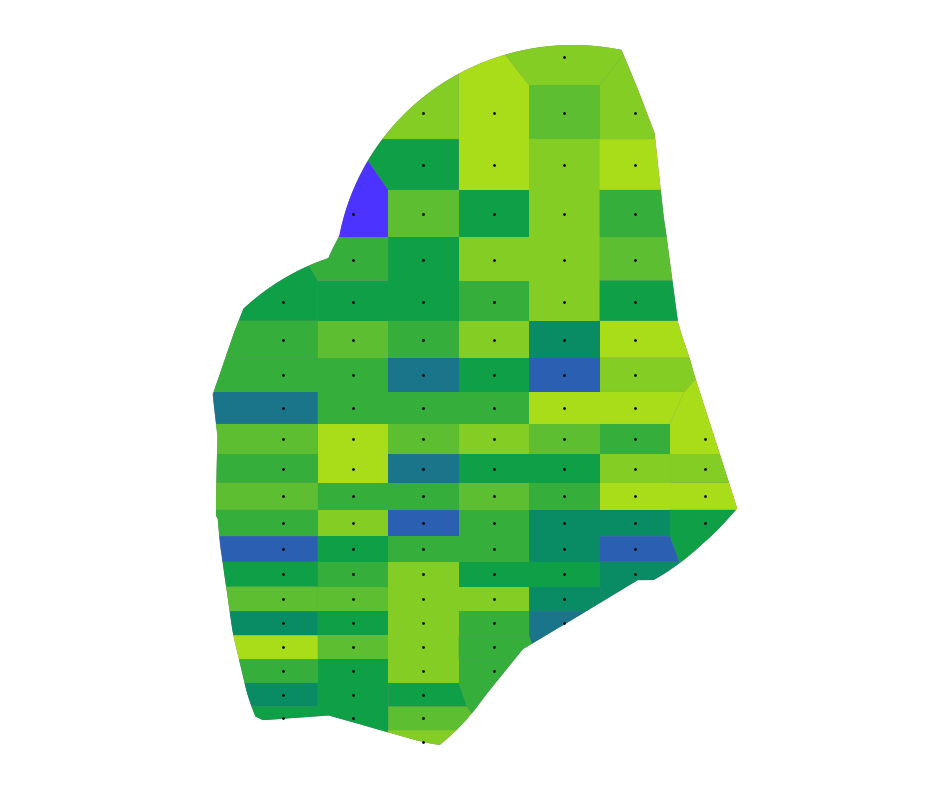

"{\"type\": \"FeatureCollection\", \"features\": [{\"id\": \"0\", \"type\": \"Feature\", \"properties\": {\"latitude\": 4.769481182098389, \"longitude\": 136.5, \"year\": 2040, \"tos\": 31.335214999689352, \"fill\": \"#83cd25\", \"R\": 131, \"G\": 205, \"B\": 37}, \"geometry\": {\"type\": \"Polygon\", \"coordinates\": [[[135.0, 10.222108840942383], [135.0, 10.989970684051514], [135.34037618065258, 11.420645703332927], [135.5507591751962, 10.912052330850543], [135.55209937009053, 10.908634746996228], [135.5945257968285, 10.797880850221247], [135.61517942549054, 10.743849510646669], [135.64947294482093, 10.653853046780938], [135.6497859538591, 10.653031206725018], [135.6501024612601, 10.652199893210806], [135.6504124962403, 10.651385294495924], [135.72691382161602, 10.450245598455737], [135.7279190595177, 10.447598390953118], [135.75766963194823, 10.369143924252782], [135.78178170516176, 10.305486046344171], [135.7907445968515, 10.222108840942383], [135.0, 10.222108840942383]]]}}, {\"id\

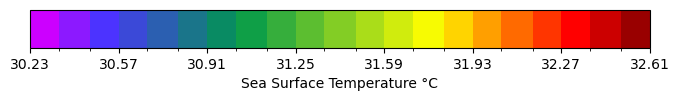

In [168]:
folder = os.getcwd() + '/latlon/'
for source in ['CanESM5','HadGEM3-GC31-MM']:
    for experiment in experiment_dict[source]:
        file = [x for x in sources[source] if x[0]== 'tos' and x[1] == experiment][0][2]
        df = pd.read_pickle(folder + file)
        df = df.dropna()
        df = df.reset_index()
        
        currgeo = getGridGeoJSON(2040,df)
        json_object = json.dumps(currgeo.to_json(), indent=4)
        print(json_object)
        break
    break

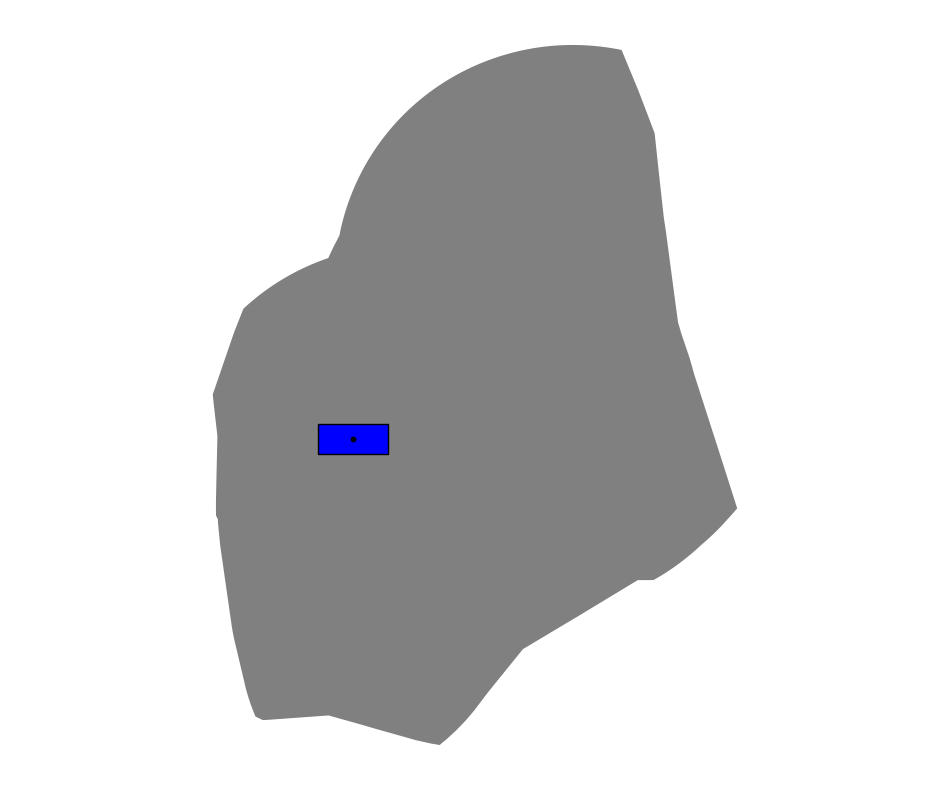

None


In [60]:
folder = os.getcwd() + '/latlon/'
for source in ['CanESM5','HadGEM3-GC31-MM']:
    for experiment in experiment_dict[source]:
        file = [x for x in sources[source] if x[0]== 'tos' and x[1] == experiment][0][2]
        df = pd.read_pickle(folder + file)
        df = df.dropna()
        df = df.reset_index()
        print(getGridGeoJSON(2040,df))
        break
    break

In [31]:
folder = os.getcwd() + '/latlon/'
for source in ['CanESM5','HadGEM3-GC31-MM']:
    for experiment in experiment_dict[source]:
        file = [x for x in sources[source] if x[0]== 'tos' and x[1] == experiment][0][2]
        df = pd.read_pickle(folder + file)
        df = df.dropna()
        df = df.reset_index()
        getGridGeoJSON(2040,df)
        break
    break

                                              geometry
0    POLYGON ((135.000 10.222, 135.000 10.990, 135....
1    POLYGON ((131.000 6.179, 132.000 6.179, 132.00...
2    POLYGON ((134.000 10.990, 134.000 10.222, 133....
3    POLYGON ((133.000 11.151, 133.000 10.222, 131....
4    POLYGON ((134.000 10.990, 134.000 10.222, 135....
..                                                 ...
103  POLYGON ((132.000 3.869, 131.000 3.869, 131.00...
104  POLYGON ((134.000 3.522, 134.000 3.179, 133.00...
105  POLYGON ((133.000 3.869, 133.000 4.223, 134.00...
106  POLYGON ((132.000 3.179, 132.000 3.522, 131.00...
107  POLYGON ((132.000 3.869, 132.000 4.223, 131.00...

[108 rows x 1 columns] {0: [106], 1: [59], 2: [104], 3: [103], 4: [105], 5: [107], 6: [0], 7: [50], 8: [82], 9: [76], 10: [44], 11: [51], 12: [37], 13: [45], 14: [25], 15: [15], 16: [65], 17: [31], 18: [71], 19: [58], 20: [20], 21: [38], 22: [52], 23: [49], 24: [61], 25: [60], 26: [67], 27: [72], 28: [66], 29: [68], 30: [74], 31: [81], 3